In [2]:
import pandas as pd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#pip install seaborn

### Data Pre-processing

In [5]:
# Loading the datasets
train_data = pd.read_csv("Google_Stock_Price_Train.csv")
test_data = pd.read_csv("Google_Stock_Price_Test.csv")

# Displaying the first few rows of both training and test datasets
print("Training Data:")
print(train_data.head(), "\n")

print("Testing Data:")
print(test_data.head(), "\n")

Training Data:
       Date    Open    High     Low   Close      Volume
0  1/3/2012  325.25  332.83  324.97  663.59   7,380,500
1  1/4/2012  331.27  333.87  329.08  666.45   5,749,400
2  1/5/2012  329.83  330.75  326.89  657.21   6,590,300
3  1/6/2012  328.34  328.77  323.68  648.24   5,405,900
4  1/9/2012  322.04  322.29  309.46  620.76  11,688,800 

Testing Data:
       Date    Open    High     Low   Close     Volume
0  1/3/2017  778.81  789.63  775.80  786.14  1,657,300
1  1/4/2017  788.36  791.34  783.16  786.90  1,073,000
2  1/5/2017  786.08  794.48  785.02  794.02  1,335,200
3  1/6/2017  795.26  807.90  792.20  806.15  1,640,200
4  1/9/2017  806.40  809.97  802.83  806.65  1,272,400 



In [6]:
# Display datasets info
print("Training Data Info:")
print(train_data.info(), "\n")

print("Testing Data Info:")
print(test_data.info(), "\n")

Training Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1258 entries, 0 to 1257
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    1258 non-null   object 
 1   Open    1258 non-null   float64
 2   High    1258 non-null   float64
 3   Low     1258 non-null   float64
 4   Close   1258 non-null   object 
 5   Volume  1258 non-null   object 
dtypes: float64(3), object(3)
memory usage: 59.1+ KB
None 

Testing Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    20 non-null     object 
 1   Open    20 non-null     float64
 2   High    20 non-null     float64
 3   Low     20 non-null     float64
 4   Close   20 non-null     float64
 5   Volume  20 non-null     object 
dtypes: float64(4), object(2)
memory usage: 1.1+ KB
None 



In [11]:
# Checking for missing values
print("Missing Values in Training Data:")
print(train_data.isnull().sum(), "\n")

print("Missing Values in Testing Data:")
print(test_data.isnull().sum(), "\n")

Missing Values in Training Data:
Date      0
Open      0
High      0
Low       0
Close     0
Volume    0
dtype: int64 

Missing Values in Testing Data:
Date      0
Open      0
High      0
Low       0
Close     0
Volume    0
dtype: int64 



In [13]:
# Convert the Date column to datetime format
train_data['Date'] = pd.to_datetime(train_data['Date'])
test_data['Date'] = pd.to_datetime(test_data['Date'])

print(train_data['Date'].head())
print(test_data['Date'].head())

0   2012-01-03
1   2012-01-04
2   2012-01-05
3   2012-01-06
4   2012-01-09
Name: Date, dtype: datetime64[ns]
0   2017-01-03
1   2017-01-04
2   2017-01-05
3   2017-01-06
4   2017-01-09
Name: Date, dtype: datetime64[ns]


In [15]:
# Convert 'Close' column to numeric type
train_data['Close'] = train_data['Close'].replace(',', '',regex=True).astype(float)
test_data['Close'] = test_data['Close'].replace(',', '',regex=True).astype(float)

# Convert 'Volume' column to numeric type (removing commas if necessary)
train_data['Volume'] = train_data['Volume'].str.replace(',', '',regex=True).astype(float)
test_data['Volume'] = test_data['Volume'].str.replace(',', '',regex=True).astype(float)

In [17]:
# y={}
# y['a'] = '1,008.64'
# print(float(y['a'].replace(",","")))

In [19]:
print(train_data)

           Date    Open    High     Low   Close      Volume
0    2012-01-03  325.25  332.83  324.97  663.59   7380500.0
1    2012-01-04  331.27  333.87  329.08  666.45   5749400.0
2    2012-01-05  329.83  330.75  326.89  657.21   6590300.0
3    2012-01-06  328.34  328.77  323.68  648.24   5405900.0
4    2012-01-09  322.04  322.29  309.46  620.76  11688800.0
...         ...     ...     ...     ...     ...         ...
1253 2016-12-23  790.90  792.74  787.28  789.91    623400.0
1254 2016-12-27  790.68  797.86  787.66  791.55    789100.0
1255 2016-12-28  793.70  794.23  783.20  785.05   1153800.0
1256 2016-12-29  783.33  785.93  778.92  782.79    744300.0
1257 2016-12-30  782.75  782.78  770.41  771.82   1770000.0

[1258 rows x 6 columns]


In [21]:
#pip install scipy
print(train_data.isnull().sum(), "\n")

Date      0
Open      0
High      0
Low       0
Close     0
Volume    0
dtype: int64 



### Visualisations

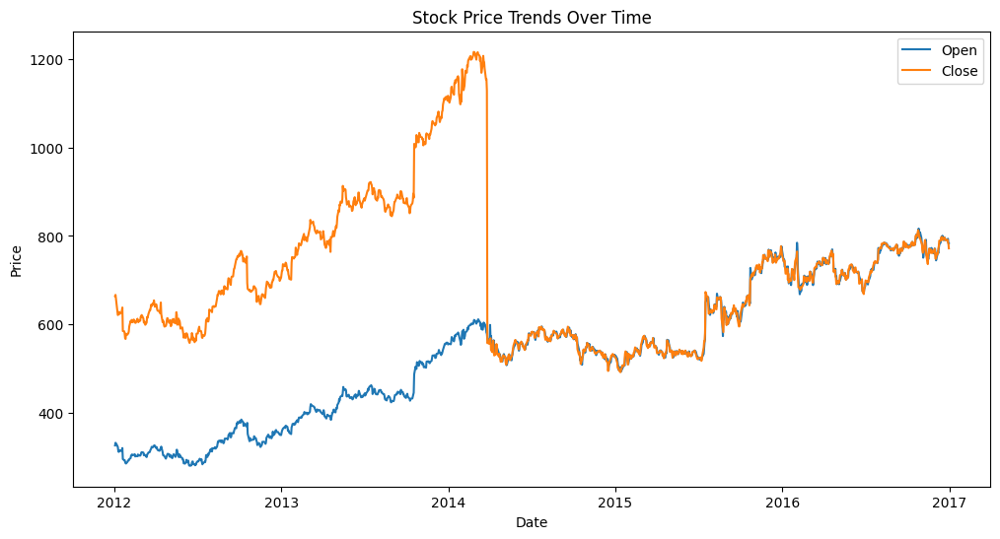

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plotting line plot to visualize trends over time for 'Open', 'High', 'Low', 'Close'
plt.figure(figsize=(12, 6))
for col in ['Open','Close']:
    plt.plot(train_data['Date'], train_data[col], label=col)
plt.title('Stock Price Trends Over Time')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

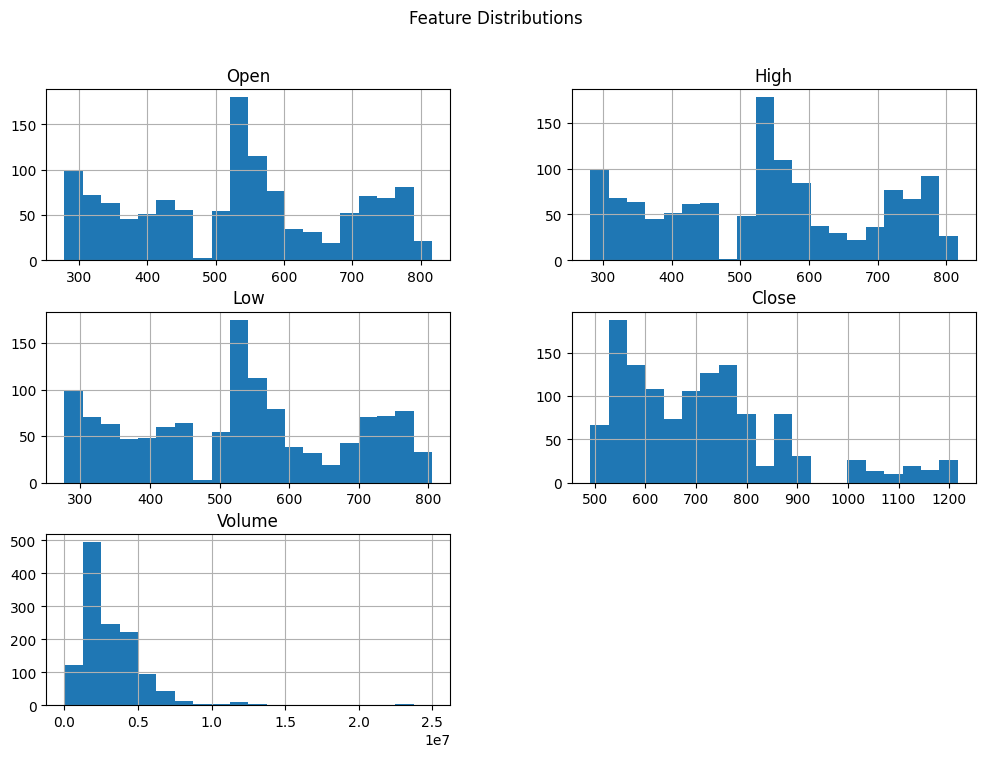

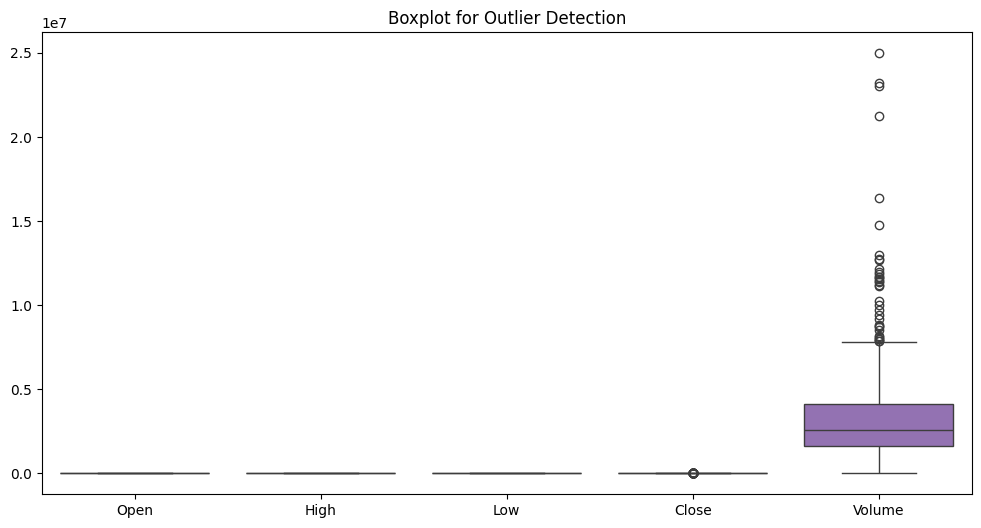

In [26]:

# Plotting histograms for feature distributions
train_data[['Open', 'High', 'Low', 'Close', 'Volume']].hist(figsize=(12, 8), bins=20)
plt.suptitle('Feature Distributions')
plt.show()

# Plotting boxplots for outlier detection
plt.figure(figsize=(12, 6))
sns.boxplot(data=train_data[['Open', 'High', 'Low', 'Close', 'Volume']])
plt.title('Boxplot for Outlier Detection')
plt.show()

### Outlier Detection

### Scaling

In [53]:
from sklearn.preprocessing import MinMaxScaler

In [55]:
#pip install scikit-learn

In [57]:
# Define the scaler
scaler = MinMaxScaler(feature_range=(0, 1))

# Columns to scale
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']

# Fit the scaler on training data and transform both training and testing datasets
train_data_scaled = train_data.copy()
test_data_scaled = test_data.copy()

train_data_scaled[scale_columns] = scaler.fit_transform(train_data[scale_columns])
test_data_scaled[scale_columns] = scaler.transform(test_data[scale_columns])

import joblib
joblib.dump(scaler, 'scaler.pkl')

# Display the first few rows of the scaled training data
print("Scaled Training Data:")
print(train_data_scaled.head())

Scaled Training Data:
        Date      Open      High       Low     Close    Volume
0 2012-01-03  0.085814  0.096401  0.090449  0.237573  0.295258
1 2012-01-04  0.097012  0.098344  0.098235  0.241514  0.229936
2 2012-01-05  0.094334  0.092517  0.094086  0.228781  0.263612
3 2012-01-06  0.091562  0.088819  0.088006  0.216419  0.216179
4 2012-01-09  0.079842  0.076718  0.061070  0.178548  0.467797


### Splitting to validation

In [60]:
# Split the scaled training data into training and validation sets
train_size = int(len(train_data_scaled) * 0.8)  # 80% for training

train_set = train_data_scaled[:train_size]
validation_set = train_data_scaled[train_size:]
test_set = test_data_scaled.copy()

### Creating Sequence

In [304]:
# Function to create input-output sequences

def create_sequences(data, N, M, scale_columns=['Open', 'High', 'Low', 'Close', 'Volume']):
    X, y = [], []
    for i in range(len(data) - N - M + 1):
        # Input sequence: past N days
        X.append(data.iloc[i:i+N][['Open', 'High', 'Low', 'Close', 'Volume']].values)
        # Output sequence: next M days
        y.append(data.iloc[i+N:i+N+M][scale_columns].values)
    return np.array(X), np.array(y)

def get_feature_and_target(train_set,validation_set,test_set, N, M,scale_columns):   
    # Create input-output sequences for training, validation, and testing
    X_train, y_train = create_sequences(train_set, N, M,scale_columns)
    X_val, y_val = create_sequences(validation_set, N, M,scale_columns)
    X_test, y_test = create_sequences(test_set, N, M,scale_columns)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Vanilla RNN

In [65]:
import torch
import torch.nn as nn
import torch.optim as optim

# Define the RNN model
class StockPriceRNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=1):
        super(StockPriceRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.rnn = nn.RNN(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        # Initialize hidden state
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        # Pass through RNN
        out, _ = self.rnn(x, h0)
        # Take the output from the last time step
        out = self.fc(out[:, -1, :])
        return out

In [66]:
# Training function
def train(model, criterion, optimizer, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor):
    train_losses = []
    val_losses = []
    best_val_loss = float('inf')
    patience_counter = 0

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        outputs = model(X_train_tensor)
        loss = criterion(outputs, y_train_tensor)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())

        # Validation phase
        model.eval()
        with torch.no_grad():
            val_outputs = model(X_val_tensor)
            val_loss = criterion(val_outputs, y_val_tensor)
            val_losses.append(val_loss.item())

        # Early stopping check
        if val_loss.item() < best_val_loss:
            best_val_loss = val_loss.item()
            patience_counter = 0  # Reset patience counter
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered at epoch {epoch + 1}")
                break

        # Print progress
        print(f"Epoch [{epoch + 1}/{num_epochs}], Training Loss: {loss.item():.4f}, Validation Loss: {val_loss.item():.4f}")

    # Plot loss curves
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curves')
    plt.legend()
    plt.show()

    return train_losses, val_losses

# Hyperparameter optimization function
def optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor):
    best_config = None
    best_val_loss = float('inf')

    for hidden_size in hidden_sizes:
        for learning_rate in learning_rates:
            print(f"\nTesting Configuration: Hidden Size={hidden_size}, Learning Rate={learning_rate}")
            
            # Define model and move to device
            model = StockPriceRNN(input_size, hidden_size, output_size, num_layers)

            # Define optimizer and loss function
            criterion = nn.MSELoss()
            optimizer = optim.Adam(model.parameters(), lr=learning_rate)

            # Train the model
            train_losses, val_losses = train(model, criterion, optimizer, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)

            # Track best configuration
            if min(val_losses) < best_val_loss:
                best_val_loss = min(val_losses)
                best_config = {"hidden_size": hidden_size, "learning_rate": learning_rate}
                best_model = model

    print(f"\nBest Configuration: {best_config}, Validation Loss: {best_val_loss:.4f}")
    return best_config, best_model

## Pedicting only "Close"

In [71]:
N, M = 7, 1  # Define sequence lengths
X_train, y_train, X_val, y_val, X_test, y_test = get_feature_and_target(train_set, validation_set, test_set, N, M,["Close"])

In [73]:
y_train.shape

(999, 1, 1)

In [75]:
scale_columns = ["Open", "High", "Low", "Close", "Volume"]  # Input features
target_column = "Close"  # Target feature

# Dynamically determine input and output sizes
input_size = 5
output_size = 1
hidden_size = 32  # Number of hidden units
num_layers = 2 # 5-layer RNN

# Instantiate the model
model = StockPriceRNN(input_size, hidden_size, output_size, num_layers)

# Print model summary
print(model)

StockPriceRNN(
  (rnn): RNN(5, 32, num_layers=2, batch_first=True)
  (fc): Linear(in_features=32, out_features=1, bias=True)
)



Testing Configuration: Hidden Size=16, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.2785, Validation Loss: 0.2236
Epoch [2/1000], Training Loss: 0.2434, Validation Loss: 0.1865
Epoch [3/1000], Training Loss: 0.2118, Validation Loss: 0.1534
Epoch [4/1000], Training Loss: 0.1836, Validation Loss: 0.1243
Epoch [5/1000], Training Loss: 0.1588, Validation Loss: 0.0990
Epoch [6/1000], Training Loss: 0.1371, Validation Loss: 0.0771
Epoch [7/1000], Training Loss: 0.1183, Validation Loss: 0.0585
Epoch [8/1000], Training Loss: 0.1024, Validation Loss: 0.0430
Epoch [9/1000], Training Loss: 0.0890, Validation Loss: 0.0303
Epoch [10/1000], Training Loss: 0.0781, Validation Loss: 0.0202
Epoch [11/1000], Training Loss: 0.0696, Validation Loss: 0.0127
Epoch [12/1000], Training Loss: 0.0631, Validation Loss: 0.0073
Epoch [13/1000], Training Loss: 0.0586, Validation Loss: 0.0039
Epoch [14/1000], Training Loss: 0.0558, Validation Loss: 0.0023
Epoch [15/1000], Training Loss: 0.0545, Validation Lo

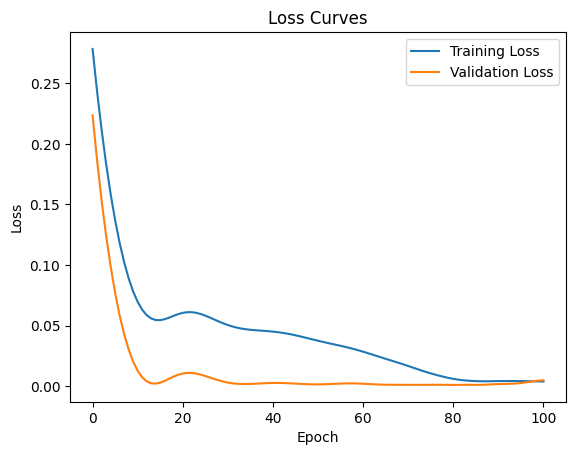


Testing Configuration: Hidden Size=16, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1505, Validation Loss: 0.1300
Epoch [2/1000], Training Loss: 0.1489, Validation Loss: 0.1279
Epoch [3/1000], Training Loss: 0.1474, Validation Loss: 0.1258
Epoch [4/1000], Training Loss: 0.1458, Validation Loss: 0.1238
Epoch [5/1000], Training Loss: 0.1443, Validation Loss: 0.1217
Epoch [6/1000], Training Loss: 0.1428, Validation Loss: 0.1197
Epoch [7/1000], Training Loss: 0.1413, Validation Loss: 0.1177
Epoch [8/1000], Training Loss: 0.1398, Validation Loss: 0.1157
Epoch [9/1000], Training Loss: 0.1383, Validation Loss: 0.1137
Epoch [10/1000], Training Loss: 0.1368, Validation Loss: 0.1117
Epoch [11/1000], Training Loss: 0.1354, Validation Loss: 0.1098
Epoch [12/1000], Training Loss: 0.1339, Validation Loss: 0.1078
Epoch [13/1000], Training Loss: 0.1325, Validation Loss: 0.1059
Epoch [14/1000], Training Loss: 0.1310, Validation Loss: 0.1039
Epoch [15/1000], Training Loss: 0.1296, Validation L

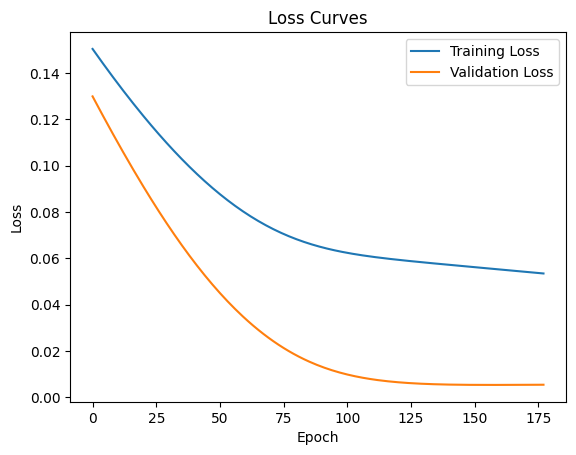


Testing Configuration: Hidden Size=32, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.0738, Validation Loss: 0.0184
Epoch [2/1000], Training Loss: 0.0615, Validation Loss: 0.0055
Epoch [3/1000], Training Loss: 0.0582, Validation Loss: 0.0025
Epoch [4/1000], Training Loss: 0.0594, Validation Loss: 0.0023
Epoch [5/1000], Training Loss: 0.0587, Validation Loss: 0.0024
Epoch [6/1000], Training Loss: 0.0555, Validation Loss: 0.0037
Epoch [7/1000], Training Loss: 0.0516, Validation Loss: 0.0070
Epoch [8/1000], Training Loss: 0.0487, Validation Loss: 0.0120
Epoch [9/1000], Training Loss: 0.0471, Validation Loss: 0.0168
Epoch [10/1000], Training Loss: 0.0462, Validation Loss: 0.0194
Epoch [11/1000], Training Loss: 0.0448, Validation Loss: 0.0189
Epoch [12/1000], Training Loss: 0.0424, Validation Loss: 0.0158
Epoch [13/1000], Training Loss: 0.0393, Validation Loss: 0.0114
Epoch [14/1000], Training Loss: 0.0361, Validation Loss: 0.0074
Epoch [15/1000], Training Loss: 0.0334, Validation Lo

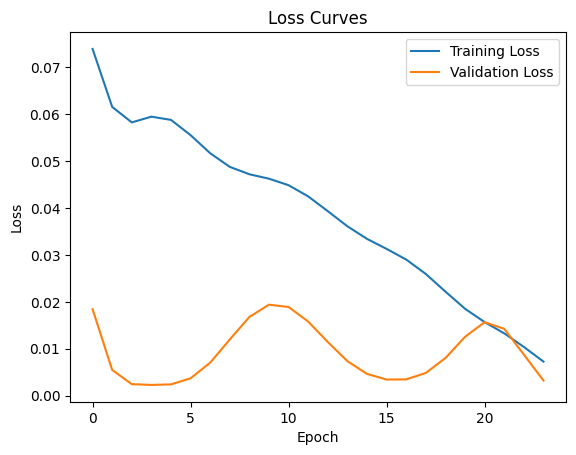


Testing Configuration: Hidden Size=32, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1578, Validation Loss: 0.1015
Epoch [2/1000], Training Loss: 0.1551, Validation Loss: 0.0985
Epoch [3/1000], Training Loss: 0.1524, Validation Loss: 0.0956
Epoch [4/1000], Training Loss: 0.1497, Validation Loss: 0.0927
Epoch [5/1000], Training Loss: 0.1471, Validation Loss: 0.0899
Epoch [6/1000], Training Loss: 0.1446, Validation Loss: 0.0871
Epoch [7/1000], Training Loss: 0.1421, Validation Loss: 0.0844
Epoch [8/1000], Training Loss: 0.1397, Validation Loss: 0.0818
Epoch [9/1000], Training Loss: 0.1373, Validation Loss: 0.0792
Epoch [10/1000], Training Loss: 0.1350, Validation Loss: 0.0767
Epoch [11/1000], Training Loss: 0.1327, Validation Loss: 0.0742
Epoch [12/1000], Training Loss: 0.1305, Validation Loss: 0.0718
Epoch [13/1000], Training Loss: 0.1283, Validation Loss: 0.0695
Epoch [14/1000], Training Loss: 0.1262, Validation Loss: 0.0672
Epoch [15/1000], Training Loss: 0.1241, Validation L

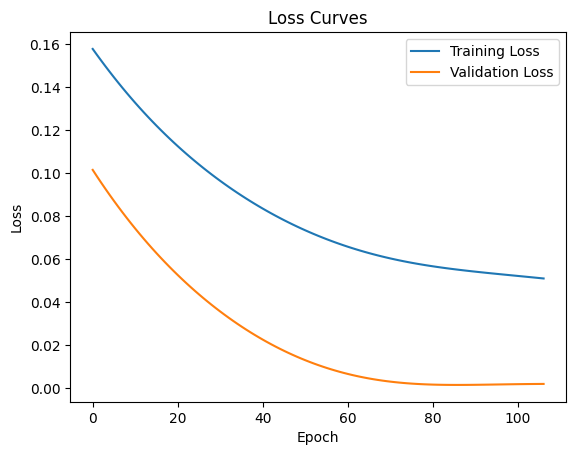


Testing Configuration: Hidden Size=64, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1372, Validation Loss: 0.0277
Epoch [2/1000], Training Loss: 0.0902, Validation Loss: 0.0024
Epoch [3/1000], Training Loss: 0.0668, Validation Loss: 0.0097
Epoch [4/1000], Training Loss: 0.0652, Validation Loss: 0.0267
Epoch [5/1000], Training Loss: 0.0717, Validation Loss: 0.0292
Epoch [6/1000], Training Loss: 0.0706, Validation Loss: 0.0200
Epoch [7/1000], Training Loss: 0.0628, Validation Loss: 0.0090
Epoch [8/1000], Training Loss: 0.0539, Validation Loss: 0.0024
Epoch [9/1000], Training Loss: 0.0476, Validation Loss: 0.0015
Epoch [10/1000], Training Loss: 0.0445, Validation Loss: 0.0045
Epoch [11/1000], Training Loss: 0.0435, Validation Loss: 0.0082
Epoch [12/1000], Training Loss: 0.0426, Validation Loss: 0.0098
Epoch [13/1000], Training Loss: 0.0400, Validation Loss: 0.0084
Epoch [14/1000], Training Loss: 0.0353, Validation Loss: 0.0048
Epoch [15/1000], Training Loss: 0.0293, Validation Lo

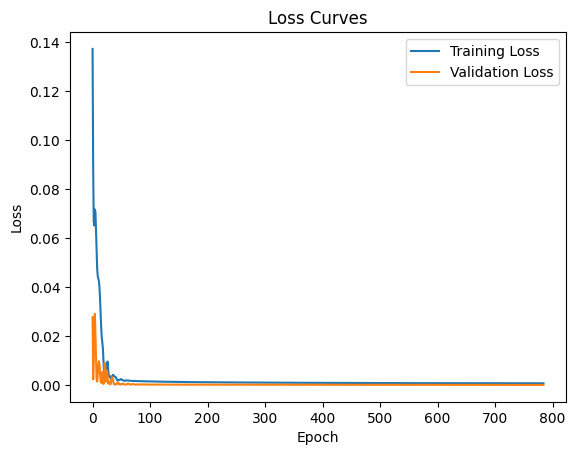


Testing Configuration: Hidden Size=64, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1193, Validation Loss: 0.0748
Epoch [2/1000], Training Loss: 0.1128, Validation Loss: 0.0675
Epoch [3/1000], Training Loss: 0.1067, Validation Loss: 0.0606
Epoch [4/1000], Training Loss: 0.1009, Validation Loss: 0.0541
Epoch [5/1000], Training Loss: 0.0955, Validation Loss: 0.0480
Epoch [6/1000], Training Loss: 0.0904, Validation Loss: 0.0423
Epoch [7/1000], Training Loss: 0.0857, Validation Loss: 0.0370
Epoch [8/1000], Training Loss: 0.0814, Validation Loss: 0.0321
Epoch [9/1000], Training Loss: 0.0774, Validation Loss: 0.0277
Epoch [10/1000], Training Loss: 0.0737, Validation Loss: 0.0236
Epoch [11/1000], Training Loss: 0.0704, Validation Loss: 0.0199
Epoch [12/1000], Training Loss: 0.0674, Validation Loss: 0.0166
Epoch [13/1000], Training Loss: 0.0647, Validation Loss: 0.0136
Epoch [14/1000], Training Loss: 0.0624, Validation Loss: 0.0111
Epoch [15/1000], Training Loss: 0.0603, Validation L

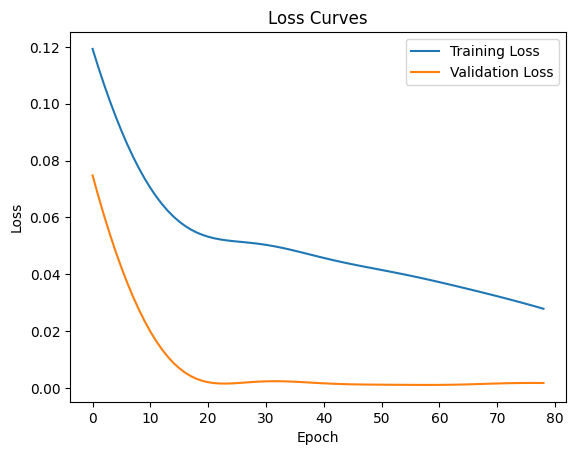


Best Configuration: {'hidden_size': 64, 'learning_rate': 0.001}, Validation Loss: 0.0002


In [77]:
# Define hyperparameter ranges
hidden_sizes = [16, 32, 64]
learning_rates = [0.001,0.0001]
num_epochs = 1000
patience = 20

# Define the loss function and optimizer
criterion = nn.MSELoss()

# Convert data to tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train[:, 0, :], dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val[:, 0, :], dtype=torch.float32)

# Optimize hyperparameters
best_config = optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)


Testing Configuration: Hidden Size=64, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.0605, Validation Loss: 0.0055
Epoch [2/1000], Training Loss: 0.0634, Validation Loss: 0.0020
Epoch [3/1000], Training Loss: 0.0535, Validation Loss: 0.0106
Epoch [4/1000], Training Loss: 0.0504, Validation Loss: 0.0183
Epoch [5/1000], Training Loss: 0.0489, Validation Loss: 0.0143
Epoch [6/1000], Training Loss: 0.0428, Validation Loss: 0.0062
Epoch [7/1000], Training Loss: 0.0369, Validation Loss: 0.0022
Epoch [8/1000], Training Loss: 0.0342, Validation Loss: 0.0019
Epoch [9/1000], Training Loss: 0.0301, Validation Loss: 0.0050
Epoch [10/1000], Training Loss: 0.0229, Validation Loss: 0.0166
Epoch [11/1000], Training Loss: 0.0178, Validation Loss: 0.0269
Epoch [12/1000], Training Loss: 0.0149, Validation Loss: 0.0183
Epoch [13/1000], Training Loss: 0.0089, Validation Loss: 0.0041
Epoch [14/1000], Training Loss: 0.0064, Validation Loss: 0.0010
Epoch [15/1000], Training Loss: 0.0061, Validation Lo

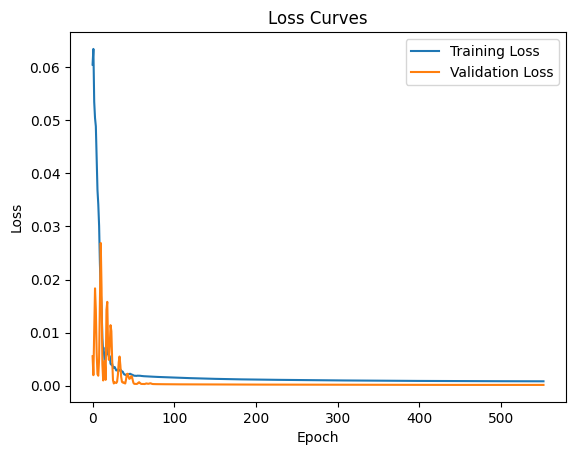


Best Configuration: {'hidden_size': 64, 'learning_rate': 0.001}, Validation Loss: 0.0002


In [78]:
# Define hyperparameter ranges
hidden_sizes = [64]
learning_rates = [0.001]
num_epochs = 1000
patience = 20

# Define the loss function and optimizer
criterion = nn.MSELoss()

# Convert data to tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train[:, 0, :], dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val[:, 0, :], dtype=torch.float32)

# Optimize hyperparameters
best_config,model = optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)

In [101]:
def test(model, X_test, y_test, scaler):
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():
        # Predict on test data
        y_pred = model(torch.tensor(X_test, dtype=torch.float32))
        y_pred = y_pred.cpu().numpy()  # Move predictions to CPU for further processing

    # Rescale predictions and actual values for only the "Close" column
    close_index = scale_columns.index("Close")  # Get index for "Close"
    
    # Prepare dummy arrays for inverse transformation
    y_pred_full = np.zeros((y_pred.shape[0], len(scale_columns)))  # Full array with all columns
    y_actual_full = np.zeros((y_test.shape[0], len(scale_columns)))

    # Fill only the "Close" column with predicted and actual values
    y_pred_full[:, close_index] = y_pred.flatten()
    y_actual_full[:, close_index] = y_test.flatten()

    # Perform inverse transformation
    y_pred_rescaled = scaler.inverse_transform(y_pred_full)[:, close_index]
    y_actual_rescaled = scaler.inverse_transform(y_actual_full)[:, close_index]

    # Calculate metrics
    mse = mean_squared_error(y_actual_rescaled, y_pred_rescaled)
    mae = mean_absolute_error(y_actual_rescaled, y_pred_rescaled)

    # Plot predictions vs actual values
    plt.figure(figsize=(12, 6))
    plt.plot(y_actual_rescaled, label='Actual Close Prices', color='blue')
    plt.plot(y_pred_rescaled, label='Predicted Close Prices', color='orange')
    plt.title('Predicted vs Actual Close Prices')
    plt.xlabel('Time')
    plt.ylabel('Close Price')
    plt.legend()
    plt.show()

    print(f"Mean Squared Error (MSE): {mse:.4f}")
    print(f"Mean Absolute Error (MAE): {mae:.4f}")

    return mse, mae

In [103]:
#print(y_test)

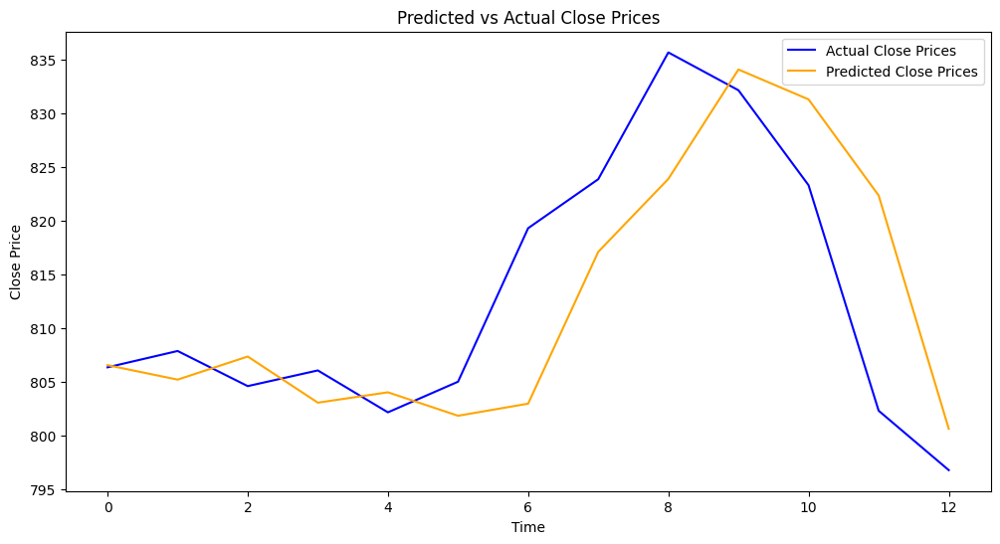

Mean Squared Error (MSE): 74.7807
Mean Absolute Error (MAE): 6.3327


In [105]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Load the saved scaler
scaler = joblib.load('scaler.pkl')

# Call the evaluation function
mse, mae = test(model, X_test, y_test, scaler)

## Predicting all columns

StockPriceRNN(
  (rnn): RNN(5, 32, num_layers=2, batch_first=True)
  (fc): Linear(in_features=32, out_features=5, bias=True)
)

Testing Configuration: Hidden Size=16, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1754, Validation Loss: 0.4759
Epoch [2/1000], Training Loss: 0.1628, Validation Loss: 0.4516
Epoch [3/1000], Training Loss: 0.1511, Validation Loss: 0.4286
Epoch [4/1000], Training Loss: 0.1403, Validation Loss: 0.4066
Epoch [5/1000], Training Loss: 0.1303, Validation Loss: 0.3857
Epoch [6/1000], Training Loss: 0.1210, Validation Loss: 0.3656
Epoch [7/1000], Training Loss: 0.1124, Validation Loss: 0.3463
Epoch [8/1000], Training Loss: 0.1044, Validation Loss: 0.3277
Epoch [9/1000], Training Loss: 0.0969, Validation Loss: 0.3097
Epoch [10/1000], Training Loss: 0.0899, Validation Loss: 0.2923
Epoch [11/1000], Training Loss: 0.0833, Validation Loss: 0.2755
Epoch [12/1000], Training Loss: 0.0773, Validation Loss: 0.2593
Epoch [13/1000], Training Loss: 0.0716, Validation Los

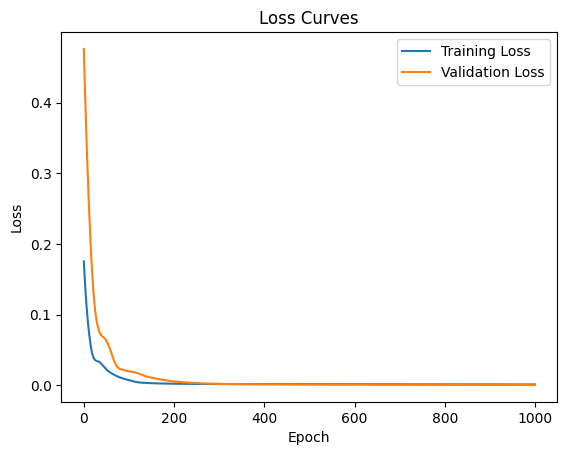


Testing Configuration: Hidden Size=16, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.2868, Validation Loss: 0.7018
Epoch [2/1000], Training Loss: 0.2852, Validation Loss: 0.6991
Epoch [3/1000], Training Loss: 0.2837, Validation Loss: 0.6963
Epoch [4/1000], Training Loss: 0.2822, Validation Loss: 0.6936
Epoch [5/1000], Training Loss: 0.2807, Validation Loss: 0.6909
Epoch [6/1000], Training Loss: 0.2791, Validation Loss: 0.6882
Epoch [7/1000], Training Loss: 0.2776, Validation Loss: 0.6855
Epoch [8/1000], Training Loss: 0.2762, Validation Loss: 0.6828
Epoch [9/1000], Training Loss: 0.2747, Validation Loss: 0.6801
Epoch [10/1000], Training Loss: 0.2732, Validation Loss: 0.6774
Epoch [11/1000], Training Loss: 0.2717, Validation Loss: 0.6747
Epoch [12/1000], Training Loss: 0.2703, Validation Loss: 0.6720
Epoch [13/1000], Training Loss: 0.2688, Validation Loss: 0.6694
Epoch [14/1000], Training Loss: 0.2674, Validation Loss: 0.6668
Epoch [15/1000], Training Loss: 0.2660, Validation L

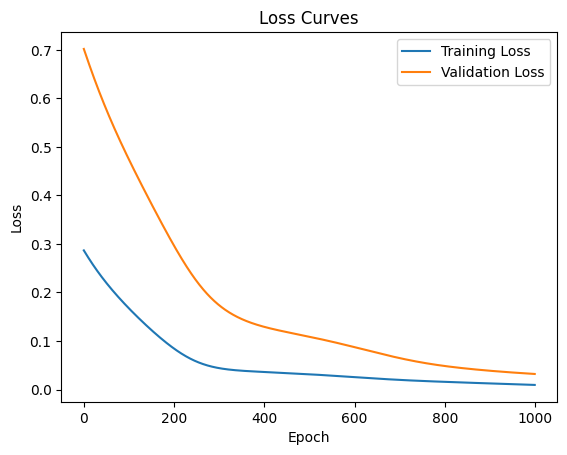


Testing Configuration: Hidden Size=32, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.2042, Validation Loss: 0.5769
Epoch [2/1000], Training Loss: 0.1793, Validation Loss: 0.5215
Epoch [3/1000], Training Loss: 0.1564, Validation Loss: 0.4683
Epoch [4/1000], Training Loss: 0.1353, Validation Loss: 0.4173
Epoch [5/1000], Training Loss: 0.1159, Validation Loss: 0.3688
Epoch [6/1000], Training Loss: 0.0985, Validation Loss: 0.3231
Epoch [7/1000], Training Loss: 0.0831, Validation Loss: 0.2803
Epoch [8/1000], Training Loss: 0.0698, Validation Loss: 0.2408
Epoch [9/1000], Training Loss: 0.0587, Validation Loss: 0.2049
Epoch [10/1000], Training Loss: 0.0500, Validation Loss: 0.1731
Epoch [11/1000], Training Loss: 0.0437, Validation Loss: 0.1455
Epoch [12/1000], Training Loss: 0.0397, Validation Loss: 0.1224
Epoch [13/1000], Training Loss: 0.0378, Validation Loss: 0.1036
Epoch [14/1000], Training Loss: 0.0373, Validation Loss: 0.0889
Epoch [15/1000], Training Loss: 0.0377, Validation Lo

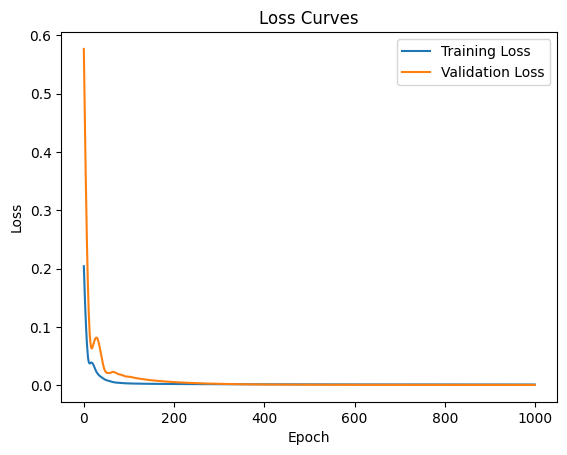


Testing Configuration: Hidden Size=32, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.2263, Validation Loss: 0.6322
Epoch [2/1000], Training Loss: 0.2236, Validation Loss: 0.6269
Epoch [3/1000], Training Loss: 0.2210, Validation Loss: 0.6216
Epoch [4/1000], Training Loss: 0.2184, Validation Loss: 0.6163
Epoch [5/1000], Training Loss: 0.2158, Validation Loss: 0.6110
Epoch [6/1000], Training Loss: 0.2132, Validation Loss: 0.6057
Epoch [7/1000], Training Loss: 0.2107, Validation Loss: 0.6005
Epoch [8/1000], Training Loss: 0.2082, Validation Loss: 0.5954
Epoch [9/1000], Training Loss: 0.2057, Validation Loss: 0.5902
Epoch [10/1000], Training Loss: 0.2032, Validation Loss: 0.5851
Epoch [11/1000], Training Loss: 0.2007, Validation Loss: 0.5800
Epoch [12/1000], Training Loss: 0.1983, Validation Loss: 0.5749
Epoch [13/1000], Training Loss: 0.1959, Validation Loss: 0.5699
Epoch [14/1000], Training Loss: 0.1935, Validation Loss: 0.5649
Epoch [15/1000], Training Loss: 0.1911, Validation L

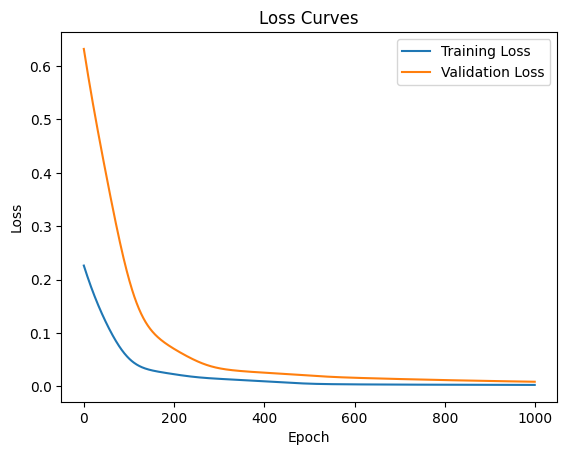


Testing Configuration: Hidden Size=64, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1208, Validation Loss: 0.3074
Epoch [2/1000], Training Loss: 0.0854, Validation Loss: 0.2205
Epoch [3/1000], Training Loss: 0.0592, Validation Loss: 0.1459
Epoch [4/1000], Training Loss: 0.0438, Validation Loss: 0.0899
Epoch [5/1000], Training Loss: 0.0402, Validation Loss: 0.0596
Epoch [6/1000], Training Loss: 0.0443, Validation Loss: 0.0512
Epoch [7/1000], Training Loss: 0.0471, Validation Loss: 0.0542
Epoch [8/1000], Training Loss: 0.0446, Validation Loss: 0.0630
Epoch [9/1000], Training Loss: 0.0393, Validation Loss: 0.0748
Epoch [10/1000], Training Loss: 0.0344, Validation Loss: 0.0866
Epoch [11/1000], Training Loss: 0.0312, Validation Loss: 0.0955
Epoch [12/1000], Training Loss: 0.0298, Validation Loss: 0.0989
Epoch [13/1000], Training Loss: 0.0289, Validation Loss: 0.0960
Epoch [14/1000], Training Loss: 0.0278, Validation Loss: 0.0871
Epoch [15/1000], Training Loss: 0.0260, Validation Lo

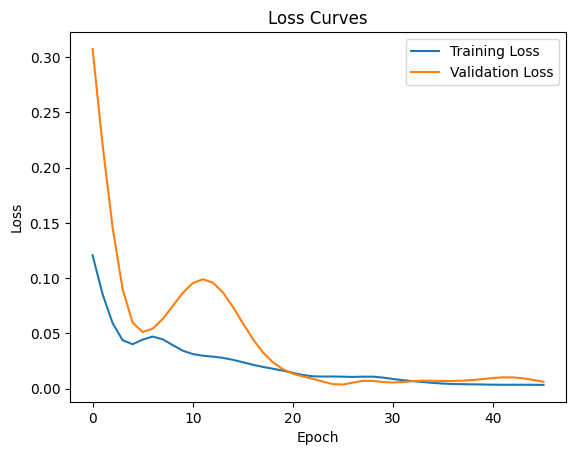


Testing Configuration: Hidden Size=64, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1907, Validation Loss: 0.5364
Epoch [2/1000], Training Loss: 0.1872, Validation Loss: 0.5289
Epoch [3/1000], Training Loss: 0.1837, Validation Loss: 0.5214
Epoch [4/1000], Training Loss: 0.1803, Validation Loss: 0.5141
Epoch [5/1000], Training Loss: 0.1769, Validation Loss: 0.5068
Epoch [6/1000], Training Loss: 0.1736, Validation Loss: 0.4996
Epoch [7/1000], Training Loss: 0.1703, Validation Loss: 0.4924
Epoch [8/1000], Training Loss: 0.1671, Validation Loss: 0.4852
Epoch [9/1000], Training Loss: 0.1639, Validation Loss: 0.4781
Epoch [10/1000], Training Loss: 0.1607, Validation Loss: 0.4710
Epoch [11/1000], Training Loss: 0.1576, Validation Loss: 0.4640
Epoch [12/1000], Training Loss: 0.1545, Validation Loss: 0.4569
Epoch [13/1000], Training Loss: 0.1514, Validation Loss: 0.4499
Epoch [14/1000], Training Loss: 0.1483, Validation Loss: 0.4429
Epoch [15/1000], Training Loss: 0.1453, Validation L

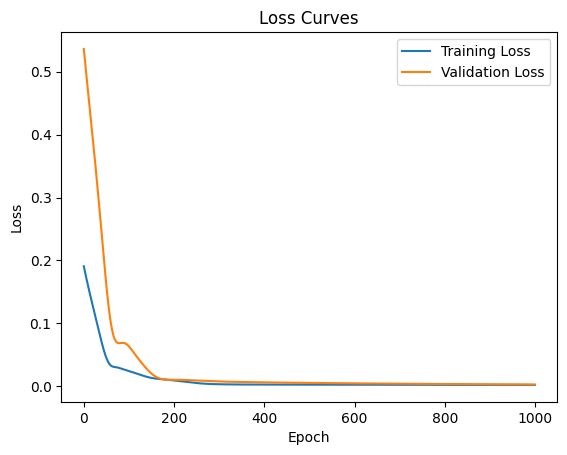


Best Configuration: {'hidden_size': 32, 'learning_rate': 0.001}, Validation Loss: 0.0005


In [119]:
N, M = 7, 1  # Define sequence lengths
X_train, y_train, X_val, y_val, X_test, y_test = get_feature_and_target(train_set, validation_set, test_set, N, M,scale_columns)

scale_columns = ["Open", "High", "Low", "Close", "Volume"]  # Input features
target_column = "Close"  # Target feature

# Dynamically determine input and output sizes
input_size = 5
output_size = 5
hidden_size = 32  # Number of hidden units
num_layers = 2 # 5-layer RNN

# Instantiate the model
model = StockPriceRNN(input_size, hidden_size, output_size, num_layers)

# Print model summary
print(model)

# Define hyperparameter ranges
hidden_sizes = [16, 32, 64]
learning_rates = [0.001,0.0001]
num_epochs = 1000
patience = 20

# Define the loss function and optimizer
criterion = nn.MSELoss()

# Convert data to tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train[:, 0, :], dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val[:, 0, :], dtype=torch.float32)

# Optimize hyperparameters
best_config = optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)

In [284]:
def test_all_features(model, X_test, y_test, scaler):
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():
        # Predict on test data
        y_pred = model(torch.tensor(X_test, dtype=torch.float32))
        #y_pred = y_pred.cpu().numpy()  # Move predictions to CPU for further processing

    y_pred = y_pred.unsqueeze(1)

    # Reshape 3D arrays to 2D for inverse scaling
    y_pred_reshaped = y_pred.reshape(-1, y_pred.shape[-1])  # Flatten along batch and time
    y_test_reshaped = y_test.reshape(-1, y_test.shape[-1])  # Flatten actual values

    # Perform inverse transformation
    #y_pred_rescaled = scaler.inverse_transform(y_pred_reshaped)
    #y_actual_rescaled = scaler.inverse_transform(y_test_reshaped)

    # Reshape back to original 3D shape for proper indexing
    y_pred_rescaled = y_pred_reshaped.reshape(y_pred.shape[0], y_pred.shape[1], -1)
    y_actual_rescaled = y_test_reshaped.reshape(y_test.shape[0], y_test.shape[1], -1)
    

    # Calculate metrics for all features
    mse = mean_squared_error(y_actual_rescaled.flatten(), y_pred_rescaled.flatten())
    mae = mean_absolute_error(y_actual_rescaled.flatten(), y_pred_rescaled.flatten())

    # Generate individual plots for each feature
    for i, feature in enumerate(scale_columns):
        plt.figure(figsize=(12, 6))
        plt.plot(y_actual_rescaled[:, :, i].flatten(), label=f'Actual {feature}', color='blue')
        plt.plot(y_pred_rescaled[:, :, i].flatten(), label=f'Predicted {feature}', color='orange')
        plt.title(f'Predicted vs Actual {feature}')
        plt.xlabel('Time')
        plt.ylabel(f'{feature} Value')
        plt.legend()
        plt.show()

    print(f"Mean Squared Error (MSE): {mse:.4f}")
    print(f"Mean Absolute Error (MAE): {mae:.4f}")

    return mse, mae


Shape of y_actual: (13, 1, 5)
Shape of y_pred: torch.Size([13, 1, 5])
[[[8.0714e+02 8.0739e+02 7.9917e+02 8.0636e+02 1.3531e+06]]

 [[8.0748e+02 8.1122e+02 8.0669e+02 8.0788e+02 1.0992e+06]]

 [[8.0708e+02 8.0714e+02 8.0037e+02 8.0461e+02 1.3621e+06]]

 [[8.0581e+02 8.0621e+02 8.0099e+02 8.0607e+02 1.2944e+06]]

 [[8.0512e+02 8.0948e+02 8.0180e+02 8.0217e+02 9.1930e+05]]

 [[8.0691e+02 8.0691e+02 8.0169e+02 8.0502e+02 1.6700e+06]]

 [[8.0725e+02 8.2087e+02 8.0374e+02 8.1931e+02 1.9636e+06]]

 [[8.2230e+02 8.2590e+02 8.1782e+02 8.2387e+02 1.4740e+06]]

 [[8.2962e+02 8.3577e+02 8.2506e+02 8.3567e+02 1.4945e+06]]

 [[8.3781e+02 8.3800e+02 8.2701e+02 8.3215e+02 2.9739e+06]]

 [[8.3471e+02 8.4195e+02 8.2044e+02 8.2331e+02 2.9658e+06]]

 [[8.1466e+02 8.1584e+02 7.9980e+02 8.0232e+02 3.2466e+06]]

 [[7.9686e+02 8.0125e+02 7.9052e+02 7.9679e+02 2.1606e+06]]]
[[[2.79765776e+02 4.24911596e+02 1.31159409e+02 6.74310764e+02
   2.15753932e+05]]

 [[2.79353055e+02 4.24606298e+02 1.31265797e+02 6.741

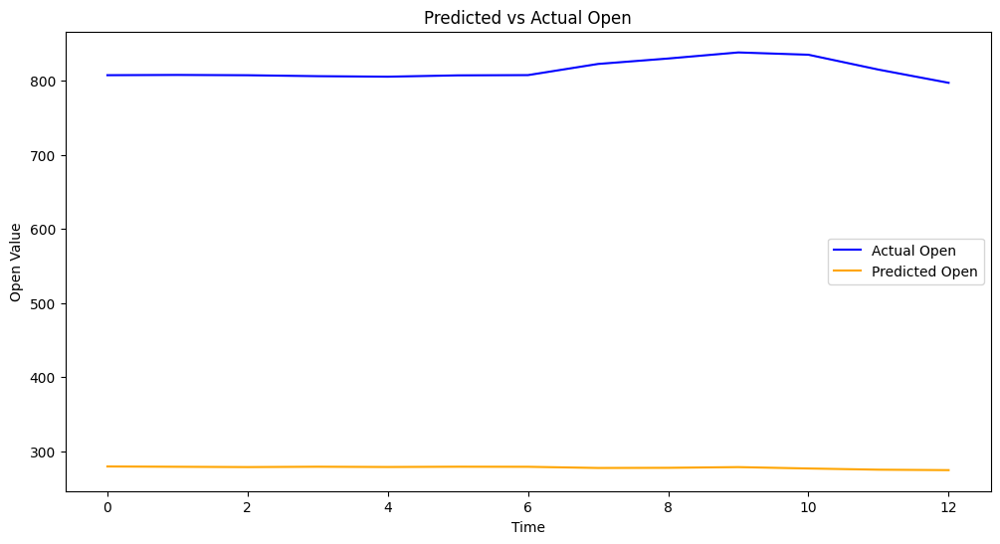

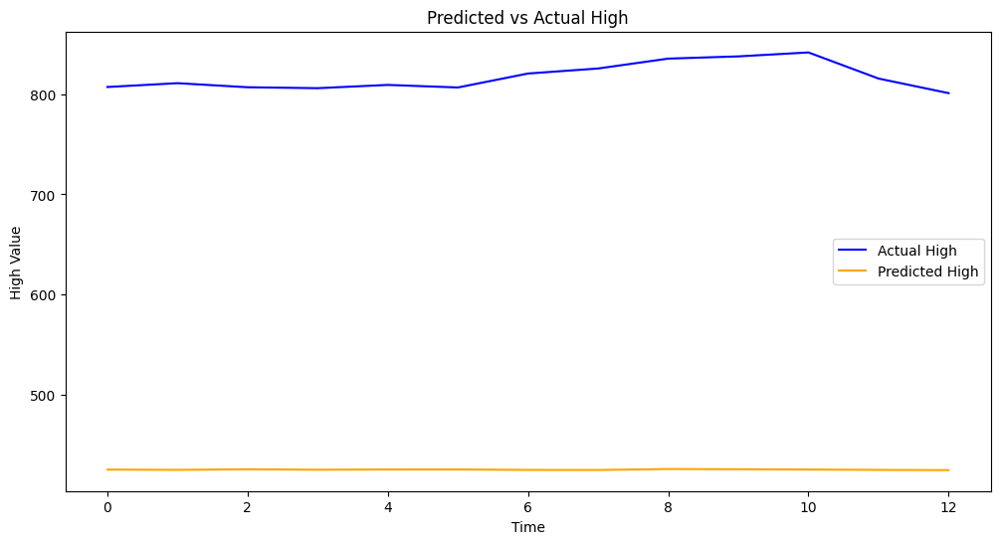

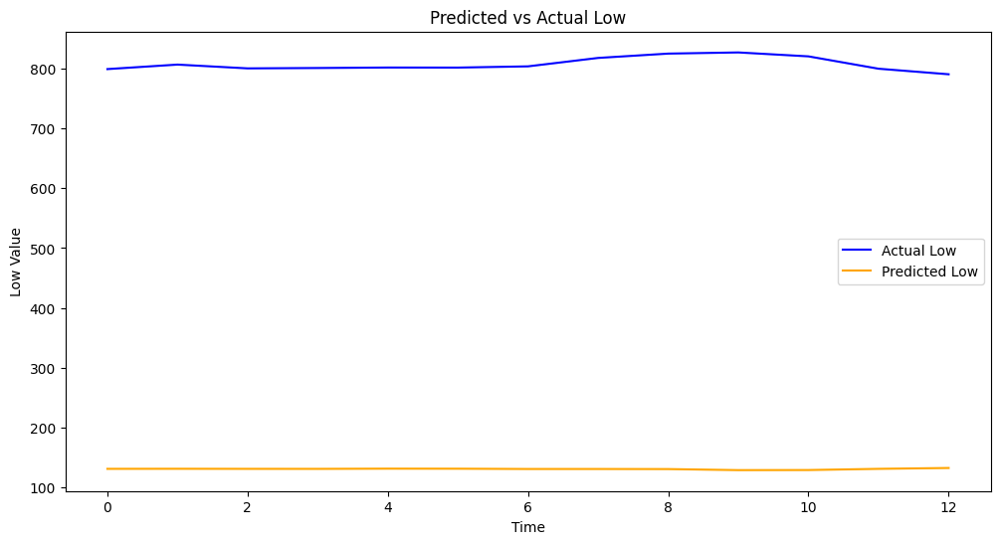

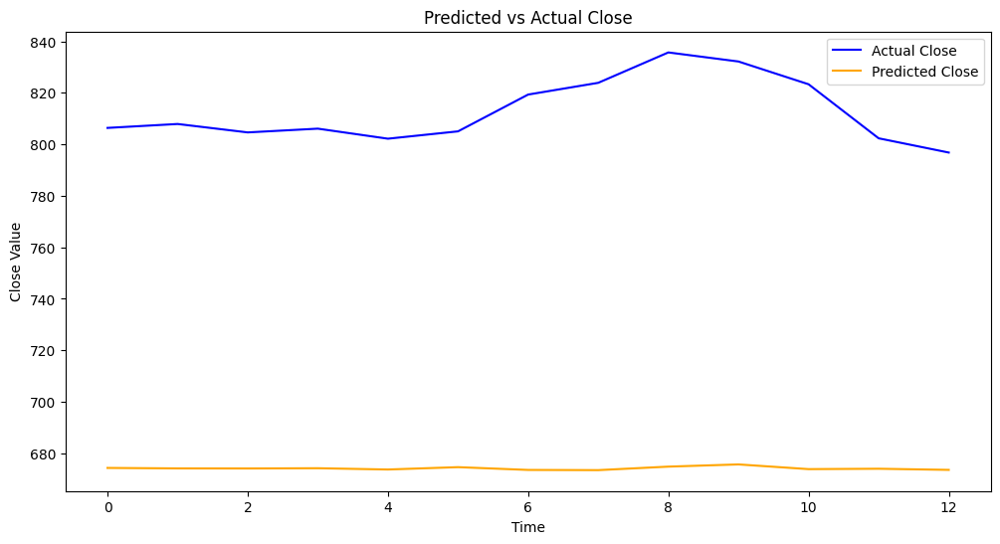

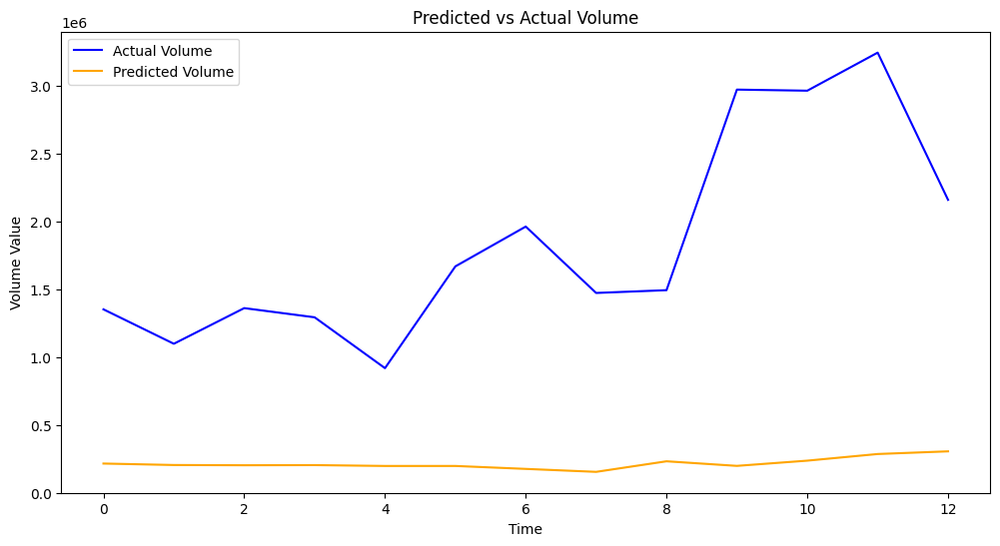

Mean Squared Error (MSE): 633771431798.9448
Mean Absolute Error (MAE): 325929.2321


In [276]:
# Call the evaluation function
mse, mae = test_all_features(model, X_test, y_test, scaler)

StockPriceRNN(
  (rnn): RNN(5, 32, num_layers=7, batch_first=True)
  (fc): Linear(in_features=32, out_features=5, bias=True)
)

Testing Configuration: Hidden Size=16, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.3960, Validation Loss: 0.8953
Epoch [2/1000], Training Loss: 0.3729, Validation Loss: 0.8592
Epoch [3/1000], Training Loss: 0.3508, Validation Loss: 0.8242
Epoch [4/1000], Training Loss: 0.3297, Validation Loss: 0.7902
Epoch [5/1000], Training Loss: 0.3096, Validation Loss: 0.7574
Epoch [6/1000], Training Loss: 0.2905, Validation Loss: 0.7256
Epoch [7/1000], Training Loss: 0.2724, Validation Loss: 0.6949
Epoch [8/1000], Training Loss: 0.2551, Validation Loss: 0.6651
Epoch [9/1000], Training Loss: 0.2388, Validation Loss: 0.6363
Epoch [10/1000], Training Loss: 0.2232, Validation Loss: 0.6083
Epoch [11/1000], Training Loss: 0.2084, Validation Loss: 0.5810
Epoch [12/1000], Training Loss: 0.1942, Validation Loss: 0.5544
Epoch [13/1000], Training Loss: 0.1808, Validation Los

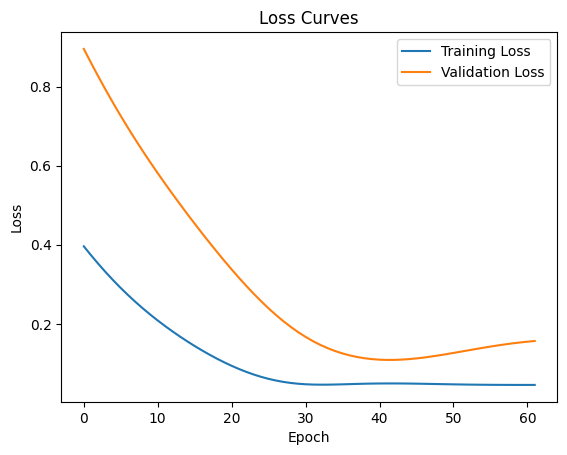


Testing Configuration: Hidden Size=16, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1171, Validation Loss: 0.4155
Epoch [2/1000], Training Loss: 0.1158, Validation Loss: 0.4126
Epoch [3/1000], Training Loss: 0.1146, Validation Loss: 0.4096
Epoch [4/1000], Training Loss: 0.1133, Validation Loss: 0.4067
Epoch [5/1000], Training Loss: 0.1121, Validation Loss: 0.4037
Epoch [6/1000], Training Loss: 0.1109, Validation Loss: 0.4008
Epoch [7/1000], Training Loss: 0.1097, Validation Loss: 0.3979
Epoch [8/1000], Training Loss: 0.1086, Validation Loss: 0.3951
Epoch [9/1000], Training Loss: 0.1074, Validation Loss: 0.3922
Epoch [10/1000], Training Loss: 0.1062, Validation Loss: 0.3893
Epoch [11/1000], Training Loss: 0.1051, Validation Loss: 0.3865
Epoch [12/1000], Training Loss: 0.1040, Validation Loss: 0.3837
Epoch [13/1000], Training Loss: 0.1028, Validation Loss: 0.3809
Epoch [14/1000], Training Loss: 0.1017, Validation Loss: 0.3781
Epoch [15/1000], Training Loss: 0.1006, Validation L

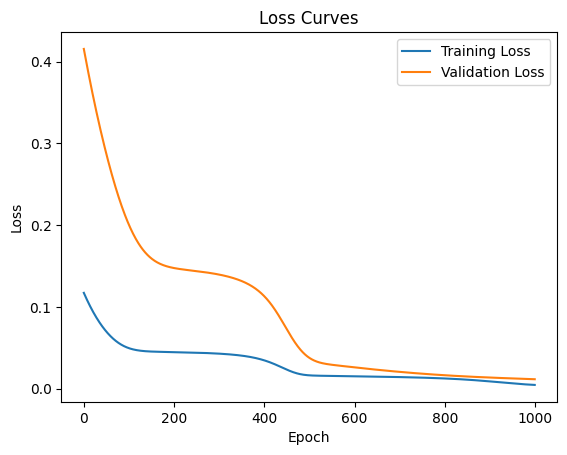


Testing Configuration: Hidden Size=32, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1238, Validation Loss: 0.3522
Epoch [2/1000], Training Loss: 0.1045, Validation Loss: 0.3107
Epoch [3/1000], Training Loss: 0.0881, Validation Loss: 0.2720
Epoch [4/1000], Training Loss: 0.0745, Validation Loss: 0.2361
Epoch [5/1000], Training Loss: 0.0638, Validation Loss: 0.2035
Epoch [6/1000], Training Loss: 0.0559, Validation Loss: 0.1747
Epoch [7/1000], Training Loss: 0.0508, Validation Loss: 0.1505
Epoch [8/1000], Training Loss: 0.0481, Validation Loss: 0.1317
Epoch [9/1000], Training Loss: 0.0471, Validation Loss: 0.1187
Epoch [10/1000], Training Loss: 0.0472, Validation Loss: 0.1113
Epoch [11/1000], Training Loss: 0.0477, Validation Loss: 0.1091
Epoch [12/1000], Training Loss: 0.0483, Validation Loss: 0.1112
Epoch [13/1000], Training Loss: 0.0487, Validation Loss: 0.1165
Epoch [14/1000], Training Loss: 0.0490, Validation Loss: 0.1236
Epoch [15/1000], Training Loss: 0.0491, Validation Lo

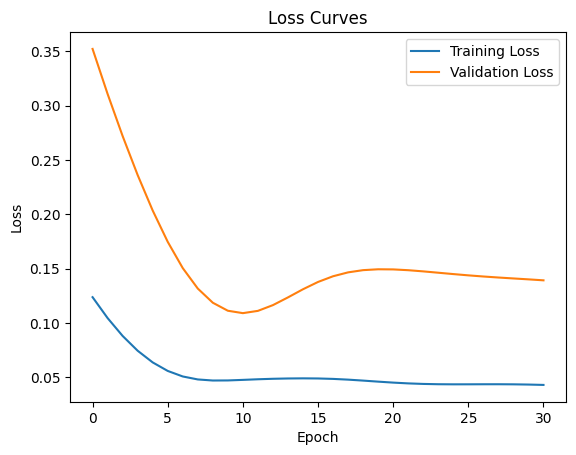


Testing Configuration: Hidden Size=32, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1428, Validation Loss: 0.4625
Epoch [2/1000], Training Loss: 0.1399, Validation Loss: 0.4564
Epoch [3/1000], Training Loss: 0.1372, Validation Loss: 0.4503
Epoch [4/1000], Training Loss: 0.1344, Validation Loss: 0.4443
Epoch [5/1000], Training Loss: 0.1317, Validation Loss: 0.4383
Epoch [6/1000], Training Loss: 0.1291, Validation Loss: 0.4323
Epoch [7/1000], Training Loss: 0.1265, Validation Loss: 0.4264
Epoch [8/1000], Training Loss: 0.1239, Validation Loss: 0.4206
Epoch [9/1000], Training Loss: 0.1214, Validation Loss: 0.4147
Epoch [10/1000], Training Loss: 0.1189, Validation Loss: 0.4090
Epoch [11/1000], Training Loss: 0.1165, Validation Loss: 0.4032
Epoch [12/1000], Training Loss: 0.1141, Validation Loss: 0.3975
Epoch [13/1000], Training Loss: 0.1118, Validation Loss: 0.3919
Epoch [14/1000], Training Loss: 0.1095, Validation Loss: 0.3863
Epoch [15/1000], Training Loss: 0.1072, Validation L

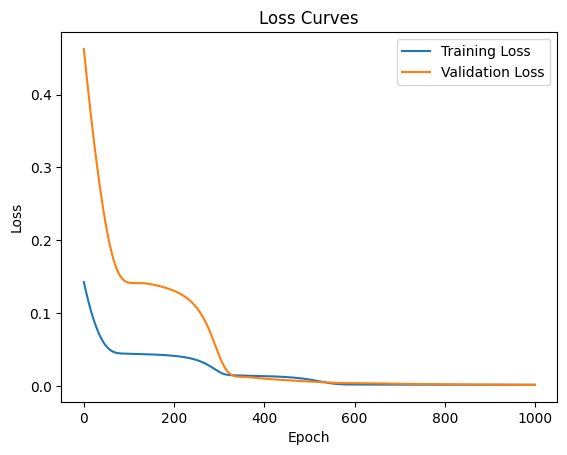


Testing Configuration: Hidden Size=64, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1682, Validation Loss: 0.4444
Epoch [2/1000], Training Loss: 0.1294, Validation Loss: 0.3722
Epoch [3/1000], Training Loss: 0.0981, Validation Loss: 0.3034
Epoch [4/1000], Training Loss: 0.0735, Validation Loss: 0.2377
Epoch [5/1000], Training Loss: 0.0564, Validation Loss: 0.1775
Epoch [6/1000], Training Loss: 0.0477, Validation Loss: 0.1272
Epoch [7/1000], Training Loss: 0.0475, Validation Loss: 0.0924
Epoch [8/1000], Training Loss: 0.0524, Validation Loss: 0.0753
Epoch [9/1000], Training Loss: 0.0571, Validation Loss: 0.0725
Epoch [10/1000], Training Loss: 0.0580, Validation Loss: 0.0793
Epoch [11/1000], Training Loss: 0.0555, Validation Loss: 0.0924
Epoch [12/1000], Training Loss: 0.0514, Validation Loss: 0.1096
Epoch [13/1000], Training Loss: 0.0477, Validation Loss: 0.1285
Epoch [14/1000], Training Loss: 0.0453, Validation Loss: 0.1472
Epoch [15/1000], Training Loss: 0.0444, Validation Lo

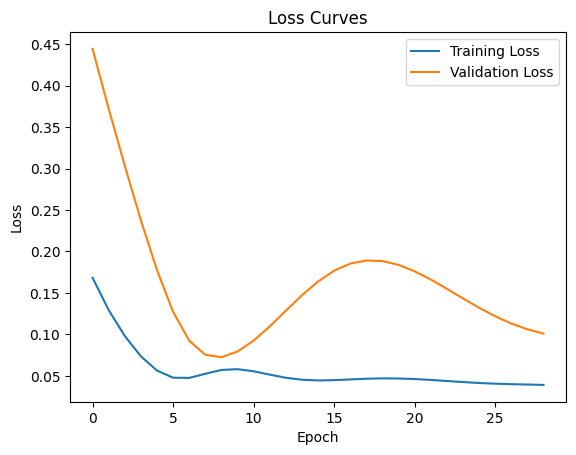


Testing Configuration: Hidden Size=64, Learning Rate=0.0001
Epoch [1/1000], Training Loss: 0.1626, Validation Loss: 0.4605
Epoch [2/1000], Training Loss: 0.1568, Validation Loss: 0.4491
Epoch [3/1000], Training Loss: 0.1512, Validation Loss: 0.4378
Epoch [4/1000], Training Loss: 0.1457, Validation Loss: 0.4268
Epoch [5/1000], Training Loss: 0.1405, Validation Loss: 0.4160
Epoch [6/1000], Training Loss: 0.1353, Validation Loss: 0.4053
Epoch [7/1000], Training Loss: 0.1304, Validation Loss: 0.3948
Epoch [8/1000], Training Loss: 0.1256, Validation Loss: 0.3845
Epoch [9/1000], Training Loss: 0.1209, Validation Loss: 0.3744
Epoch [10/1000], Training Loss: 0.1164, Validation Loss: 0.3644
Epoch [11/1000], Training Loss: 0.1120, Validation Loss: 0.3546
Epoch [12/1000], Training Loss: 0.1078, Validation Loss: 0.3449
Epoch [13/1000], Training Loss: 0.1037, Validation Loss: 0.3354
Epoch [14/1000], Training Loss: 0.0997, Validation Loss: 0.3260
Epoch [15/1000], Training Loss: 0.0959, Validation L

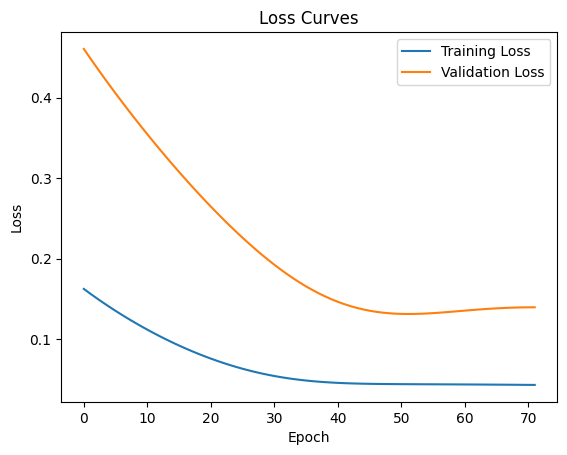


Best Configuration: {'hidden_size': 32, 'learning_rate': 0.0001}, Validation Loss: 0.0016


In [314]:
N, M = 7, 1  # Define sequence lengths
scale_columns = ["Open", "High", "Low", "Close", "Volume"]  # Input features
X_train, y_train, X_val, y_val, X_test, y_test = get_feature_and_target(train_set, validation_set, test_set, N, M,scale_columns)

# Dynamically determine input and output sizes
input_size = 5
output_size = 5
hidden_size = 32  # Number of hidden units
num_layers = 7 # 5-layer RNN

# Instantiate the model
model = StockPriceRNN(input_size, hidden_size, output_size, num_layers)

# Print model summary
print(model)

# Define hyperparameter ranges
hidden_sizes = [16, 32, 64]
learning_rates = [0.001,0.0001]
num_epochs = 1000
patience = 20

# Define the loss function and optimizer
criterion = nn.MSELoss()

# Convert data to tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train[:, 0, :], dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val[:, 0, :], dtype=torch.float32)

# Optimize hyperparameters
best_config = optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)


Testing Configuration: Hidden Size=64, Learning Rate=0.001
Epoch [1/1000], Training Loss: 0.1964, Validation Loss: 0.4301
Epoch [2/1000], Training Loss: 0.1305, Validation Loss: 0.3404
Epoch [3/1000], Training Loss: 0.0886, Validation Loss: 0.2581
Epoch [4/1000], Training Loss: 0.0623, Validation Loss: 0.1843
Epoch [5/1000], Training Loss: 0.0516, Validation Loss: 0.1274
Epoch [6/1000], Training Loss: 0.0511, Validation Loss: 0.0949
Epoch [7/1000], Training Loss: 0.0535, Validation Loss: 0.0878
Epoch [8/1000], Training Loss: 0.0543, Validation Loss: 0.1020
Epoch [9/1000], Training Loss: 0.0537, Validation Loss: 0.1269
Epoch [10/1000], Training Loss: 0.0526, Validation Loss: 0.1484
Epoch [11/1000], Training Loss: 0.0509, Validation Loss: 0.1590
Epoch [12/1000], Training Loss: 0.0482, Validation Loss: 0.1615
Epoch [13/1000], Training Loss: 0.0460, Validation Loss: 0.1613
Epoch [14/1000], Training Loss: 0.0455, Validation Loss: 0.1612
Epoch [15/1000], Training Loss: 0.0464, Validation Lo

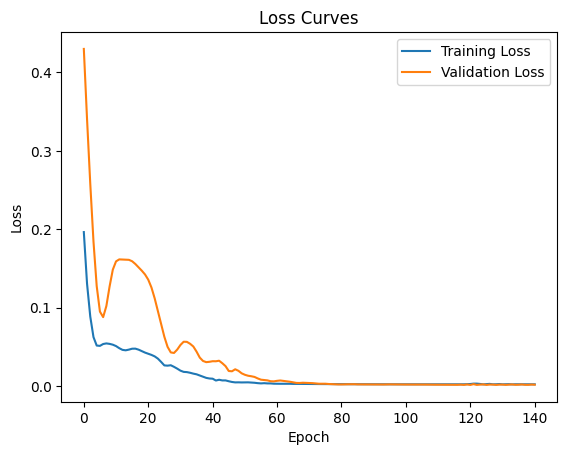


Best Configuration: {'hidden_size': 64, 'learning_rate': 0.001}, Validation Loss: 0.0013


In [310]:
# Define hyperparameter ranges
hidden_sizes = [64]
learning_rates = [0.001]
num_epochs = 1000
patience = 20

# Define the loss function and optimizer
criterion = nn.MSELoss()

# Convert data to tensors
X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
y_train_tensor = torch.tensor(y_train[:, 0, :], dtype=torch.float32)
X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
y_val_tensor = torch.tensor(y_val[:, 0, :], dtype=torch.float32)

# Optimize hyperparameters
best_config = optimize_rnn(hidden_sizes, learning_rates, num_epochs, patience, X_train_tensor, y_train_tensor, X_val_tensor, y_val_tensor)

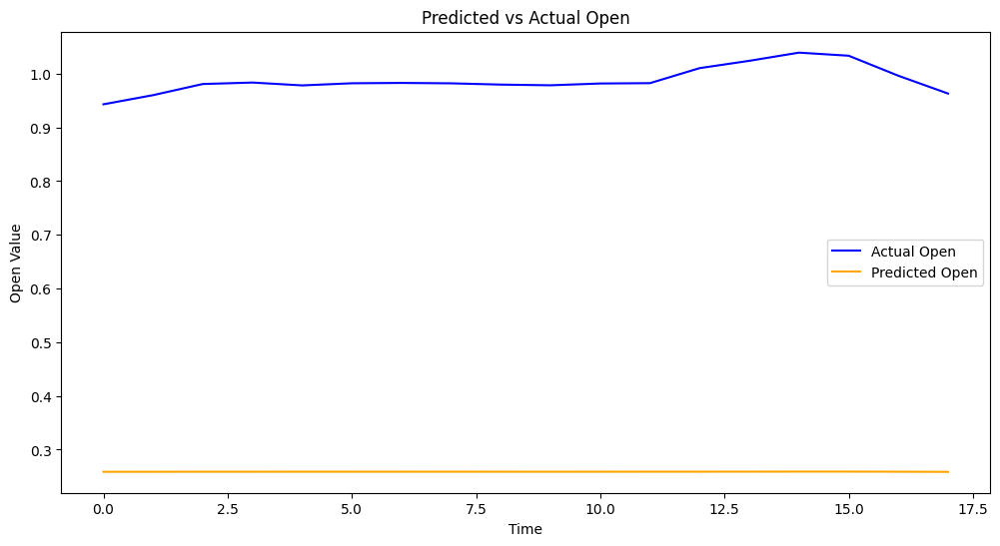

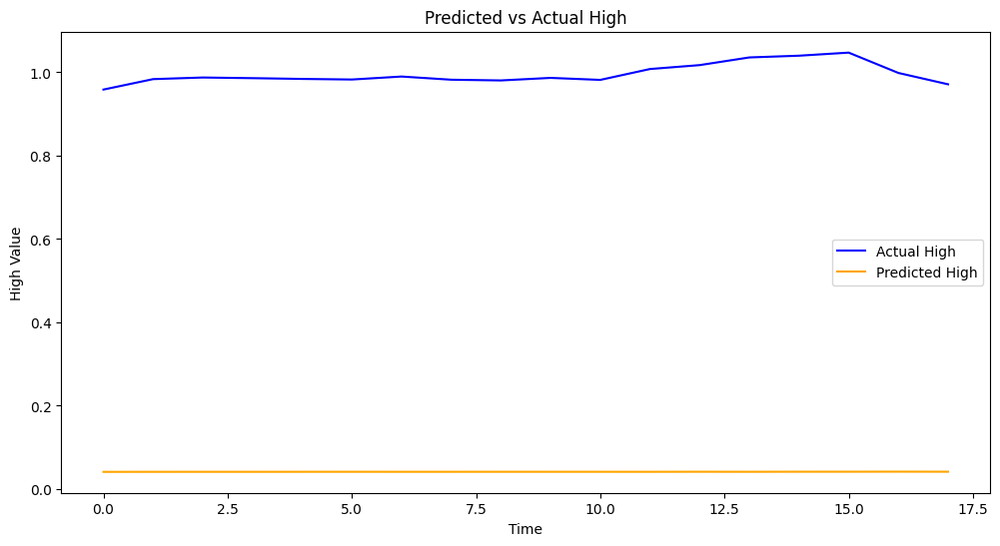

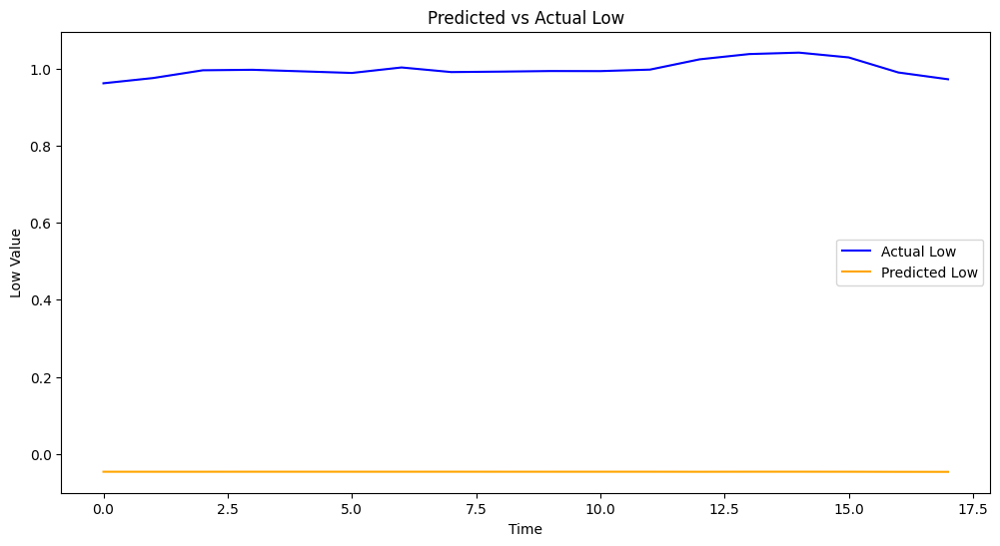

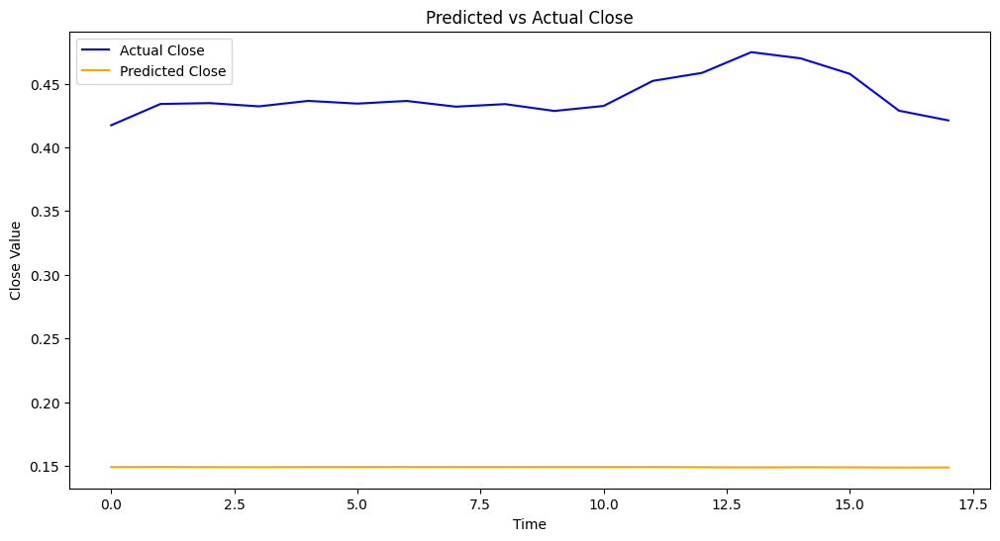

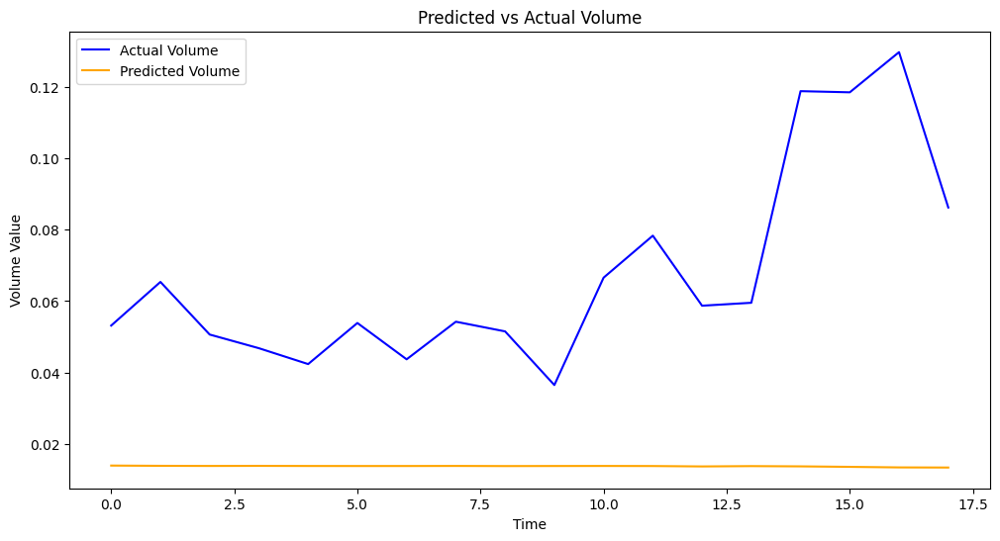

Mean Squared Error (MSE): 0.5248
Mean Absolute Error (MAE): 0.6146


In [316]:
# Call the evaluation function
mse, mae = test_all_features(model, X_test, y_test, scaler)

Sample predictions before training:
tensor([[ 0.2539,  0.0393, -0.0480,  0.1498,  0.0160]],
       grad_fn=<AddmmBackward0>)
Sample predictions after training:
tensor([[ 0.2539,  0.0393, -0.0480,  0.1498,  0.0160]],
       grad_fn=<AddmmBackward0>)


# LSTM

In [378]:
train_data = pd.read_csv("Google_Stock_Price_Train.csv")
test_data = pd.read_csv("Google_Stock_Price_Test.csv")

train_data['Date'] = pd.to_datetime(train_data['Date'])
test_data['Date'] = pd.to_datetime(test_data['Date'])

# Display dataset info
print(train_data.info())
print(train_data.head())

print(test_data.info())
print(test_data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1258 entries, 0 to 1257
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    1258 non-null   datetime64[ns]
 1   Open    1258 non-null   float64       
 2   High    1258 non-null   float64       
 3   Low     1258 non-null   float64       
 4   Close   1258 non-null   object        
 5   Volume  1258 non-null   object        
dtypes: datetime64[ns](1), float64(3), object(2)
memory usage: 59.1+ KB
None
        Date    Open    High     Low   Close      Volume
0 2012-01-03  325.25  332.83  324.97  663.59   7,380,500
1 2012-01-04  331.27  333.87  329.08  666.45   5,749,400
2 2012-01-05  329.83  330.75  326.89  657.21   6,590,300
3 2012-01-06  328.34  328.77  323.68  648.24   5,405,900
4 2012-01-09  322.04  322.29  309.46  620.76  11,688,800
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 6 columns):
 #   Column  Non-Null

In [380]:
# Convert 'Close' and 'Volume' columns to numeric
train_data['Close'] = train_data['Close'].str.replace(',', '').astype(float)
train_data['Volume'] = train_data['Volume'].str.replace(',', '').astype(float)

test_data['Volume'] = test_data['Volume'].str.replace(',', '').astype(float)

# Ensure all columns are now numeric
print("Training Data Types After Conversion:")
print(train_data.dtypes)

print("\nTesting Data Types After Conversion:")
print(test_data.dtypes)

Training Data Types After Conversion:
Date      datetime64[ns]
Open             float64
High             float64
Low              float64
Close            float64
Volume           float64
dtype: object

Testing Data Types After Conversion:
Date      datetime64[ns]
Open             float64
High             float64
Low              float64
Close            float64
Volume           float64
dtype: object


In [384]:
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']

scaler = MinMaxScaler()

train_data[scale_columns] = scaler.fit_transform(train_data[scale_columns])
test_data[scale_columns] = scaler.transform(test_data[scale_columns])

print(train_data.head())

print(test_data.head())

        Date      Open      High       Low     Close    Volume
0 2012-01-03  0.085814  0.096401  0.090449  0.237573  0.295258
1 2012-01-04  0.097012  0.098344  0.098235  0.241514  0.229936
2 2012-01-05  0.094334  0.092517  0.094086  0.228781  0.263612
3 2012-01-06  0.091562  0.088819  0.088006  0.216419  0.216179
4 2012-01-09  0.079842  0.076718  0.061070  0.178548  0.467797
        Date      Open      High       Low     Close    Volume
0 2017-01-03  0.929552  0.949484  0.944423  0.406461  0.066055
1 2017-01-04  0.947318  0.952677  0.958365  0.407508  0.042655
2 2017-01-05  0.943076  0.958541  0.961888  0.417320  0.053156
3 2017-01-06  0.960153  0.983603  0.975489  0.434037  0.065370
4 2017-01-09  0.980877  0.987469  0.995624  0.434726  0.050641


In [388]:
from sklearn.model_selection import train_test_split

# Split training data into train and validation sets
train_set, validation_set = train_test_split(train_data, test_size=0.2, shuffle=False)

# Display the sizes of each split
print(f"Training set size: {len(train_set)}")
print(f"Validation set size: {len(validation_set)}")

Training set size: 1006
Validation set size: 252


In [422]:
# Function to create input-output sequences
def create_sequences(data, target_column, sequence_length, prediction_length):
    X, y = [], []
    for i in range(len(data) - sequence_length - prediction_length + 1):
        # Input sequence: N days
        X.append(data[i:i + sequence_length].values)
        # Output sequence: M days
        y.append(data[i + sequence_length:i + sequence_length + prediction_length][target_column].values)
    return np.array(X), np.array(y)

In [392]:
class StockPriceLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=1, dropout=0.2):
        super(StockPriceLSTM, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])
        return out

In [522]:
def train_model(model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val):
    train_losses, val_losses = [], []
    best_train_loss = float('inf')
    patience_counter = 0

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        optimizer.zero_grad()
        outputs = model(torch.tensor(X_train, dtype=torch.float32).to(device))
        loss = criterion(outputs, torch.tensor(y_train, dtype=torch.float32).to(device))
        loss.backward()
        optimizer.step()
        train_losses.append(loss.item())

        # Validation phase
        model.eval()
        with torch.no_grad():
            val_outputs = model(torch.tensor(X_val, dtype=torch.float32).to(device))
            val_loss = criterion(val_outputs, torch.tensor(y_val, dtype=torch.float32).to(device))
            val_losses.append(val_loss.item())

        #Check for early stopping
        if loss.item() < best_train_loss:
            best_train_loss = loss.item()
            patience_counter = 0  # Reset patience counter
            best_model = model.state_dict()  # Save the best model
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping at epoch {epoch + 1}")
                break

        # Print loss info
        print(f"Epoch [{epoch + 1}/{num_epochs}], Train Loss: {loss.item():.4f}, Val Loss: {val_loss.item():.4f}")


        # Plot the training and validation loss curves
    import matplotlib.pyplot as plt
    
    plt.figure(figsize=(12, 6))
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()

    # Load the best model weights
    #model.load_state_dict(best_model)
    return model, train_losses, val_losses


In [424]:

# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)

# Display shapes of the sequences
print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

X_train shape: (999, 7, 5), y_train shape: (999, 1)
X_val shape: (245, 7, 5), y_val shape: (245, 1)
X_test shape: (13, 7, 5), y_test shape: (13, 1)


Epoch [1/50], Train Loss: 0.1044, Val Loss: 0.0565
Epoch [2/50], Train Loss: 0.0947, Val Loss: 0.0436
Epoch [3/50], Train Loss: 0.0860, Val Loss: 0.0324
Epoch [4/50], Train Loss: 0.0786, Val Loss: 0.0228
Epoch [5/50], Train Loss: 0.0724, Val Loss: 0.0148
Epoch [6/50], Train Loss: 0.0674, Val Loss: 0.0085
Epoch [7/50], Train Loss: 0.0636, Val Loss: 0.0042
Epoch [8/50], Train Loss: 0.0612, Val Loss: 0.0021
Epoch [9/50], Train Loss: 0.0599, Val Loss: 0.0021
Epoch [10/50], Train Loss: 0.0600, Val Loss: 0.0036
Epoch [11/50], Train Loss: 0.0611, Val Loss: 0.0055
Epoch [12/50], Train Loss: 0.0617, Val Loss: 0.0066
Epoch [13/50], Train Loss: 0.0623, Val Loss: 0.0066
Early stopping at epoch 14


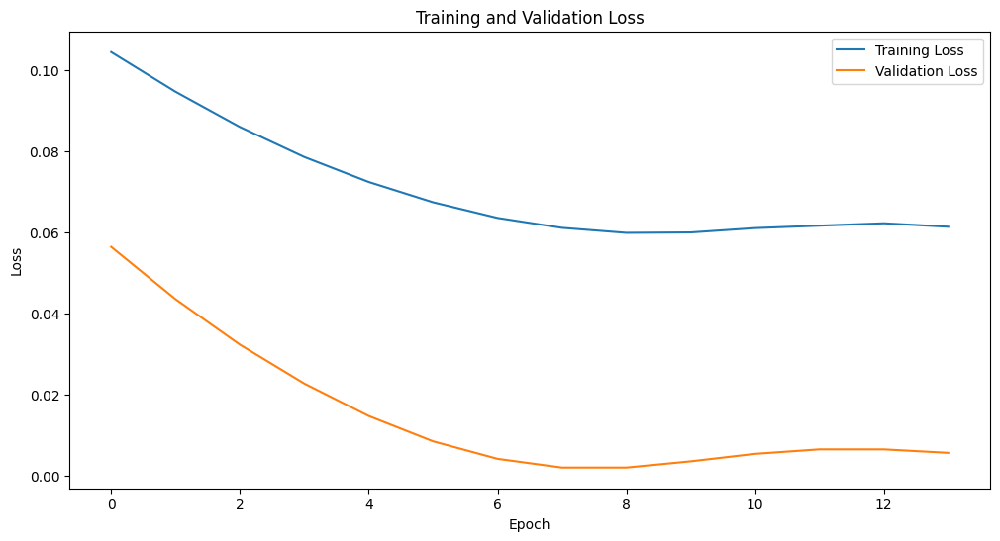

In [434]:
# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 2  # Number of LSTM layers
dropout = 0.2  # Dropout rate
learning_rate = 0.001
num_epochs = 50
patience = 5
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.MSELoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


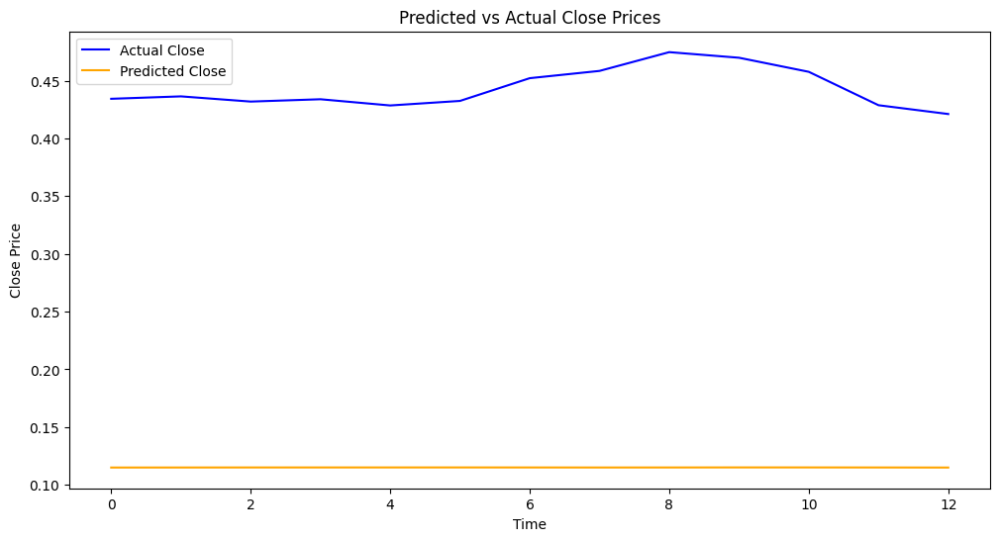

Mean Squared Error (MSE): 0.1079
Mean Absolute Error (MAE): 0.3281


In [408]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error

def evaluate_model(model, X_test, y_test, scaler, device):
    model.eval()
    with torch.no_grad():
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
        y_pred = model(X_test_tensor).cpu().numpy()

    y_pred_reshaped = y_pred.reshape(-1, 1)
    y_actual_reshaped = y_test.reshape(-1, 1)

    # Inverse transform to original scale
    y_pred_rescaled = scaler.inverse_transform(np.hstack((np.zeros_like(y_pred_reshaped), np.zeros_like(y_pred_reshaped), np.zeros_like(y_pred_reshaped), y_pred_reshaped, np.zeros_like(y_pred_reshaped))))[:, 3]
    y_actual_rescaled = scaler.inverse_transform(np.hstack((np.zeros_like(y_actual_reshaped), np.zeros_like(y_actual_reshaped), np.zeros_like(y_actual_reshaped), y_actual_reshaped, np.zeros_like(y_actual_reshaped))))[:, 3]

    plt.figure(figsize=(12, 6))
    plt.plot(y_actual_rescaled, label="Actual Close", color="blue")
    plt.plot(y_pred_rescaled, label="Predicted Close", color="orange")
    plt.title("Predicted vs Actual Close Prices")
    plt.xlabel("Time")
    plt.ylabel("Close Price")
    plt.legend()
    plt.show()

    # Calculate evaluation metrics
    mse = mean_squared_error(y_actual_rescaled, y_pred_rescaled)
    mae = mean_absolute_error(y_actual_rescaled, y_pred_rescaled)
    print(f"Mean Squared Error (MSE): {mse:.4f}")
    print(f"Mean Absolute Error (MAE): {mae:.4f}")

    return mse, mae

# Evaluate the model
mse, mae = evaluate_model(model, X_test, y_test, scaler, device)


### Hyper parameter tuning on LSTM

Epoch [1/5000], Train Loss: 0.0375, Val Loss: 0.0126
Epoch [2/5000], Train Loss: 0.0366, Val Loss: 0.0114
Epoch [3/5000], Train Loss: 0.0359, Val Loss: 0.0102
Epoch [4/5000], Train Loss: 0.0352, Val Loss: 0.0091
Epoch [5/5000], Train Loss: 0.0344, Val Loss: 0.0081
Epoch [6/5000], Train Loss: 0.0339, Val Loss: 0.0071
Epoch [7/5000], Train Loss: 0.0334, Val Loss: 0.0062
Epoch [8/5000], Train Loss: 0.0329, Val Loss: 0.0054
Epoch [9/5000], Train Loss: 0.0325, Val Loss: 0.0047
Epoch [10/5000], Train Loss: 0.0323, Val Loss: 0.0040
Epoch [11/5000], Train Loss: 0.0320, Val Loss: 0.0034
Epoch [12/5000], Train Loss: 0.0319, Val Loss: 0.0029
Epoch [13/5000], Train Loss: 0.0316, Val Loss: 0.0025
Epoch [14/5000], Train Loss: 0.0315, Val Loss: 0.0022
Epoch [15/5000], Train Loss: 0.0316, Val Loss: 0.0019
Epoch [16/5000], Train Loss: 0.0317, Val Loss: 0.0017
Epoch [17/5000], Train Loss: 0.0318, Val Loss: 0.0016
Epoch [18/5000], Train Loss: 0.0319, Val Loss: 0.0015
Epoch [19/5000], Train Loss: 0.0318, 

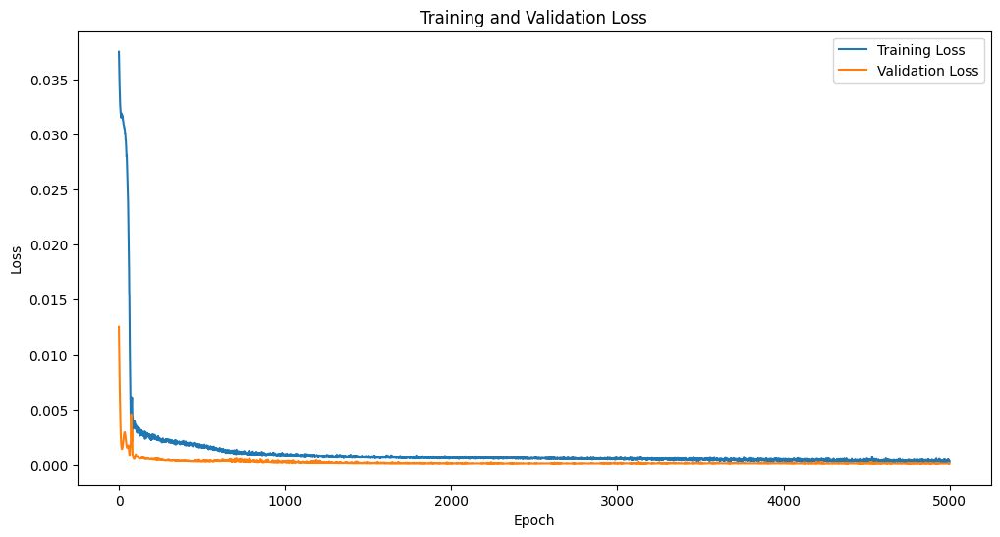

Epoch [1/5000], Train Loss: 0.0665, Val Loss: 0.0471
Epoch [2/5000], Train Loss: 0.0641, Val Loss: 0.0443
Epoch [3/5000], Train Loss: 0.0619, Val Loss: 0.0416
Epoch [4/5000], Train Loss: 0.0597, Val Loss: 0.0391
Epoch [5/5000], Train Loss: 0.0576, Val Loss: 0.0366
Epoch [6/5000], Train Loss: 0.0557, Val Loss: 0.0341
Epoch [7/5000], Train Loss: 0.0538, Val Loss: 0.0318
Epoch [8/5000], Train Loss: 0.0519, Val Loss: 0.0295
Epoch [9/5000], Train Loss: 0.0501, Val Loss: 0.0273
Epoch [10/5000], Train Loss: 0.0484, Val Loss: 0.0252
Epoch [11/5000], Train Loss: 0.0467, Val Loss: 0.0231
Epoch [12/5000], Train Loss: 0.0452, Val Loss: 0.0211
Epoch [13/5000], Train Loss: 0.0437, Val Loss: 0.0192
Epoch [14/5000], Train Loss: 0.0423, Val Loss: 0.0173
Epoch [15/5000], Train Loss: 0.0410, Val Loss: 0.0156
Epoch [16/5000], Train Loss: 0.0397, Val Loss: 0.0139
Epoch [17/5000], Train Loss: 0.0385, Val Loss: 0.0122
Epoch [18/5000], Train Loss: 0.0373, Val Loss: 0.0107
Epoch [19/5000], Train Loss: 0.0364, 

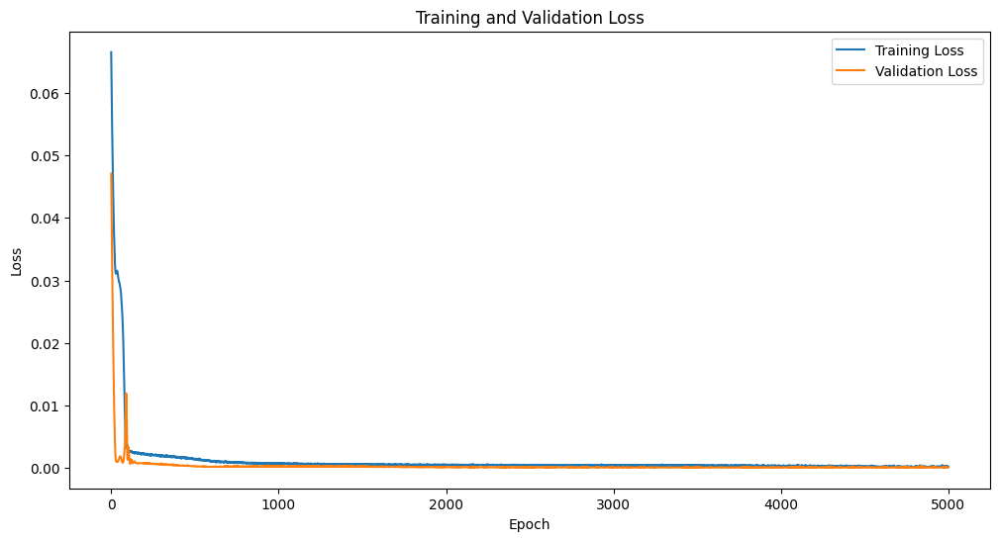

Epoch [1/5000], Train Loss: 0.0388, Val Loss: 0.0139
Epoch [2/5000], Train Loss: 0.0379, Val Loss: 0.0127
Epoch [3/5000], Train Loss: 0.0371, Val Loss: 0.0115
Epoch [4/5000], Train Loss: 0.0363, Val Loss: 0.0104
Epoch [5/5000], Train Loss: 0.0355, Val Loss: 0.0093
Epoch [6/5000], Train Loss: 0.0349, Val Loss: 0.0083
Epoch [7/5000], Train Loss: 0.0343, Val Loss: 0.0073
Epoch [8/5000], Train Loss: 0.0338, Val Loss: 0.0064
Epoch [9/5000], Train Loss: 0.0330, Val Loss: 0.0055
Epoch [10/5000], Train Loss: 0.0327, Val Loss: 0.0047
Epoch [11/5000], Train Loss: 0.0323, Val Loss: 0.0040
Epoch [12/5000], Train Loss: 0.0322, Val Loss: 0.0034
Epoch [13/5000], Train Loss: 0.0318, Val Loss: 0.0029
Epoch [14/5000], Train Loss: 0.0317, Val Loss: 0.0024
Epoch [15/5000], Train Loss: 0.0315, Val Loss: 0.0020
Epoch [16/5000], Train Loss: 0.0317, Val Loss: 0.0018
Epoch [17/5000], Train Loss: 0.0314, Val Loss: 0.0016
Epoch [18/5000], Train Loss: 0.0316, Val Loss: 0.0014
Epoch [19/5000], Train Loss: 0.0316, 

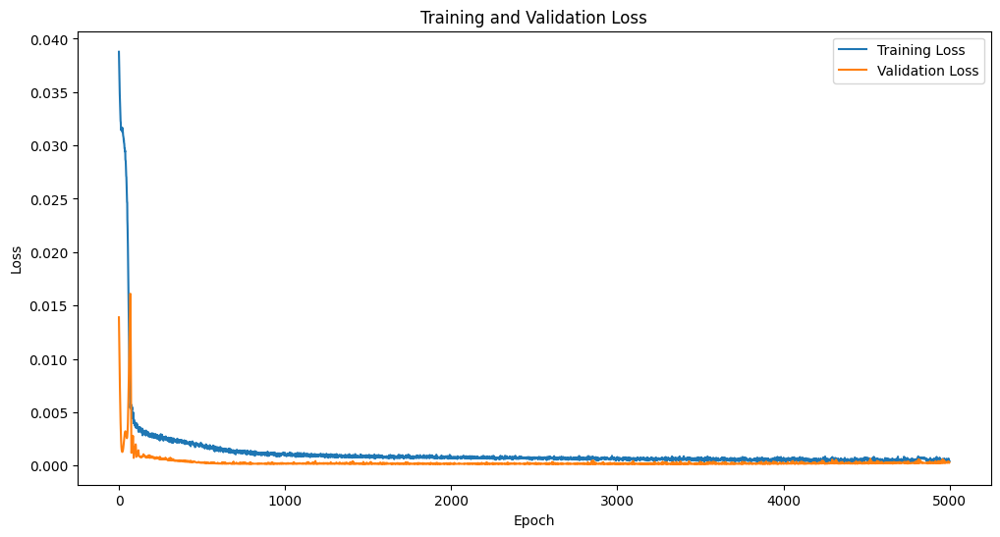

Epoch [1/5000], Train Loss: 0.0858, Val Loss: 0.0709
Epoch [2/5000], Train Loss: 0.0832, Val Loss: 0.0680
Epoch [3/5000], Train Loss: 0.0807, Val Loss: 0.0651
Epoch [4/5000], Train Loss: 0.0783, Val Loss: 0.0622
Epoch [5/5000], Train Loss: 0.0758, Val Loss: 0.0594
Epoch [6/5000], Train Loss: 0.0732, Val Loss: 0.0566
Epoch [7/5000], Train Loss: 0.0710, Val Loss: 0.0538
Epoch [8/5000], Train Loss: 0.0686, Val Loss: 0.0510
Epoch [9/5000], Train Loss: 0.0664, Val Loss: 0.0482
Epoch [10/5000], Train Loss: 0.0641, Val Loss: 0.0455
Epoch [11/5000], Train Loss: 0.0619, Val Loss: 0.0428
Epoch [12/5000], Train Loss: 0.0597, Val Loss: 0.0401
Epoch [13/5000], Train Loss: 0.0575, Val Loss: 0.0374
Epoch [14/5000], Train Loss: 0.0554, Val Loss: 0.0347
Epoch [15/5000], Train Loss: 0.0533, Val Loss: 0.0321
Epoch [16/5000], Train Loss: 0.0512, Val Loss: 0.0295
Epoch [17/5000], Train Loss: 0.0489, Val Loss: 0.0269
Epoch [18/5000], Train Loss: 0.0469, Val Loss: 0.0243
Epoch [19/5000], Train Loss: 0.0450, 

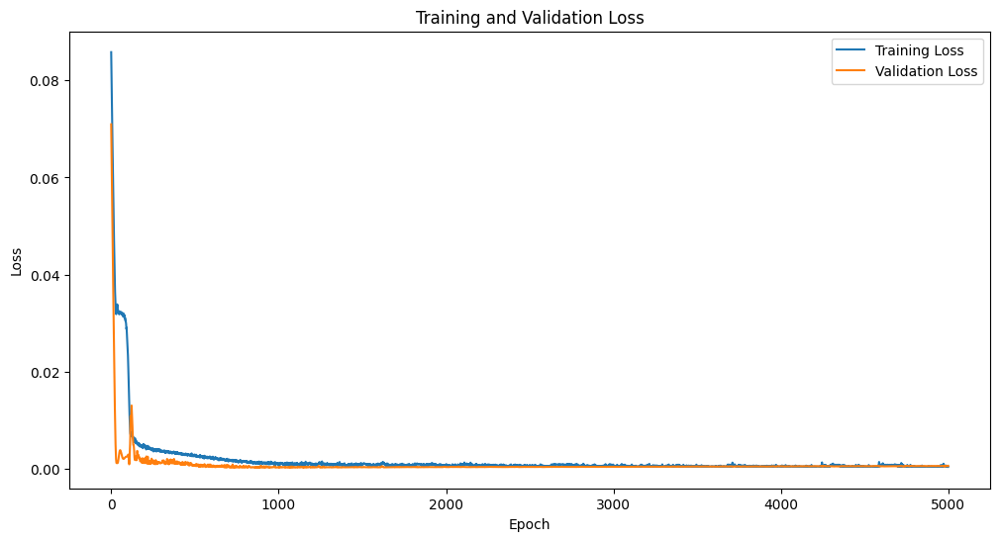

Epoch [1/5000], Train Loss: 0.1300, Val Loss: 0.1204
Epoch [2/5000], Train Loss: 0.1263, Val Loss: 0.1164
Epoch [3/5000], Train Loss: 0.1229, Val Loss: 0.1125
Epoch [4/5000], Train Loss: 0.1194, Val Loss: 0.1087
Epoch [5/5000], Train Loss: 0.1161, Val Loss: 0.1049
Epoch [6/5000], Train Loss: 0.1128, Val Loss: 0.1012
Epoch [7/5000], Train Loss: 0.1095, Val Loss: 0.0975
Epoch [8/5000], Train Loss: 0.1063, Val Loss: 0.0939
Epoch [9/5000], Train Loss: 0.1031, Val Loss: 0.0904
Epoch [10/5000], Train Loss: 0.1000, Val Loss: 0.0868
Epoch [11/5000], Train Loss: 0.0970, Val Loss: 0.0833
Epoch [12/5000], Train Loss: 0.0940, Val Loss: 0.0799
Epoch [13/5000], Train Loss: 0.0909, Val Loss: 0.0764
Epoch [14/5000], Train Loss: 0.0879, Val Loss: 0.0730
Epoch [15/5000], Train Loss: 0.0850, Val Loss: 0.0695
Epoch [16/5000], Train Loss: 0.0821, Val Loss: 0.0661
Epoch [17/5000], Train Loss: 0.0792, Val Loss: 0.0627
Epoch [18/5000], Train Loss: 0.0763, Val Loss: 0.0593
Epoch [19/5000], Train Loss: 0.0733, 

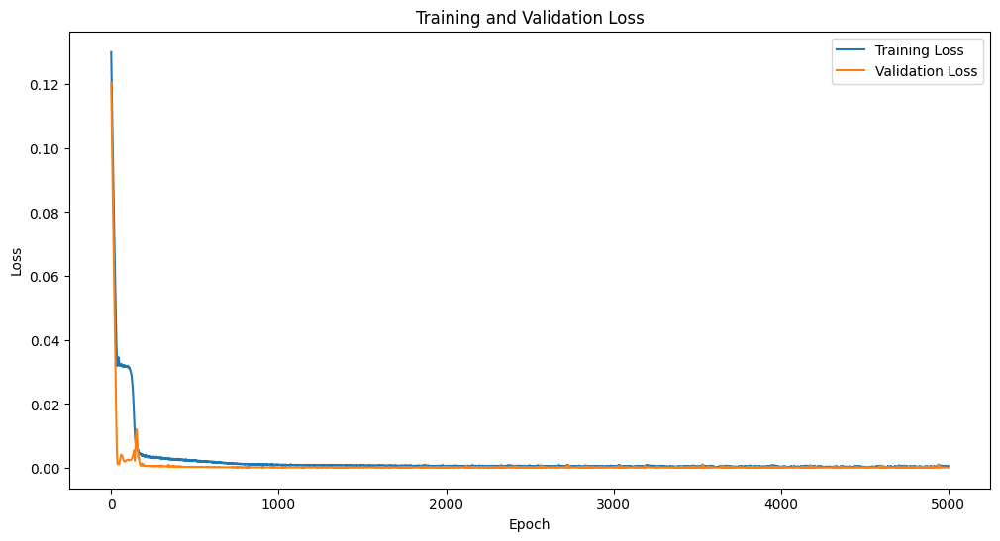

Epoch [1/5000], Train Loss: 0.1309, Val Loss: 0.1213
Epoch [2/5000], Train Loss: 0.1272, Val Loss: 0.1170
Epoch [3/5000], Train Loss: 0.1235, Val Loss: 0.1129
Epoch [4/5000], Train Loss: 0.1198, Val Loss: 0.1087
Epoch [5/5000], Train Loss: 0.1161, Val Loss: 0.1047
Epoch [6/5000], Train Loss: 0.1127, Val Loss: 0.1007
Epoch [7/5000], Train Loss: 0.1091, Val Loss: 0.0967
Epoch [8/5000], Train Loss: 0.1057, Val Loss: 0.0927
Epoch [9/5000], Train Loss: 0.1021, Val Loss: 0.0888
Epoch [10/5000], Train Loss: 0.0990, Val Loss: 0.0849
Epoch [11/5000], Train Loss: 0.0955, Val Loss: 0.0810
Epoch [12/5000], Train Loss: 0.0921, Val Loss: 0.0771
Epoch [13/5000], Train Loss: 0.0890, Val Loss: 0.0733
Epoch [14/5000], Train Loss: 0.0856, Val Loss: 0.0694
Epoch [15/5000], Train Loss: 0.0822, Val Loss: 0.0655
Epoch [16/5000], Train Loss: 0.0792, Val Loss: 0.0617
Epoch [17/5000], Train Loss: 0.0756, Val Loss: 0.0578
Epoch [18/5000], Train Loss: 0.0727, Val Loss: 0.0540
Epoch [19/5000], Train Loss: 0.0693, 

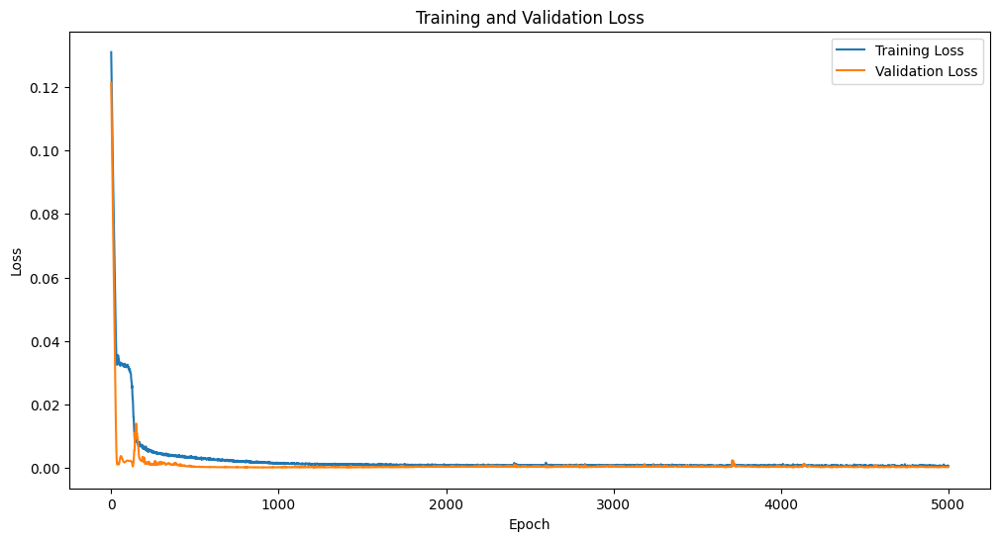

Epoch [1/5000], Train Loss: 0.1232, Val Loss: 0.1121
Epoch [2/5000], Train Loss: 0.1191, Val Loss: 0.1077
Epoch [3/5000], Train Loss: 0.1151, Val Loss: 0.1033
Epoch [4/5000], Train Loss: 0.1113, Val Loss: 0.0992
Epoch [5/5000], Train Loss: 0.1077, Val Loss: 0.0951
Epoch [6/5000], Train Loss: 0.1043, Val Loss: 0.0912
Epoch [7/5000], Train Loss: 0.1010, Val Loss: 0.0874
Epoch [8/5000], Train Loss: 0.0976, Val Loss: 0.0837
Epoch [9/5000], Train Loss: 0.0942, Val Loss: 0.0801
Epoch [10/5000], Train Loss: 0.0912, Val Loss: 0.0766
Epoch [11/5000], Train Loss: 0.0879, Val Loss: 0.0731
Epoch [12/5000], Train Loss: 0.0850, Val Loss: 0.0697
Epoch [13/5000], Train Loss: 0.0824, Val Loss: 0.0664
Epoch [14/5000], Train Loss: 0.0794, Val Loss: 0.0631
Epoch [15/5000], Train Loss: 0.0766, Val Loss: 0.0599
Epoch [16/5000], Train Loss: 0.0739, Val Loss: 0.0567
Epoch [17/5000], Train Loss: 0.0714, Val Loss: 0.0535
Epoch [18/5000], Train Loss: 0.0686, Val Loss: 0.0504
Epoch [19/5000], Train Loss: 0.0660, 

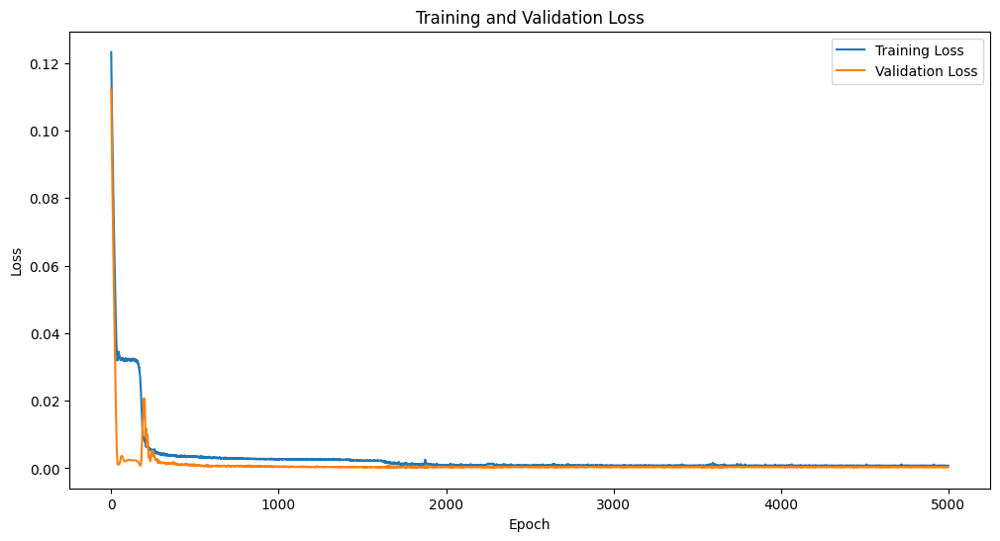

Epoch [1/5000], Train Loss: 0.1373, Val Loss: 0.1280
Epoch [2/5000], Train Loss: 0.1331, Val Loss: 0.1235
Epoch [3/5000], Train Loss: 0.1291, Val Loss: 0.1190
Epoch [4/5000], Train Loss: 0.1253, Val Loss: 0.1147
Epoch [5/5000], Train Loss: 0.1213, Val Loss: 0.1104
Epoch [6/5000], Train Loss: 0.1175, Val Loss: 0.1061
Epoch [7/5000], Train Loss: 0.1138, Val Loss: 0.1020
Epoch [8/5000], Train Loss: 0.1101, Val Loss: 0.0979
Epoch [9/5000], Train Loss: 0.1066, Val Loss: 0.0938
Epoch [10/5000], Train Loss: 0.1031, Val Loss: 0.0899
Epoch [11/5000], Train Loss: 0.0997, Val Loss: 0.0860
Epoch [12/5000], Train Loss: 0.0962, Val Loss: 0.0821
Epoch [13/5000], Train Loss: 0.0928, Val Loss: 0.0783
Epoch [14/5000], Train Loss: 0.0896, Val Loss: 0.0745
Epoch [15/5000], Train Loss: 0.0862, Val Loss: 0.0707
Epoch [16/5000], Train Loss: 0.0831, Val Loss: 0.0670
Epoch [17/5000], Train Loss: 0.0799, Val Loss: 0.0634
Epoch [18/5000], Train Loss: 0.0768, Val Loss: 0.0597
Epoch [19/5000], Train Loss: 0.0738, 

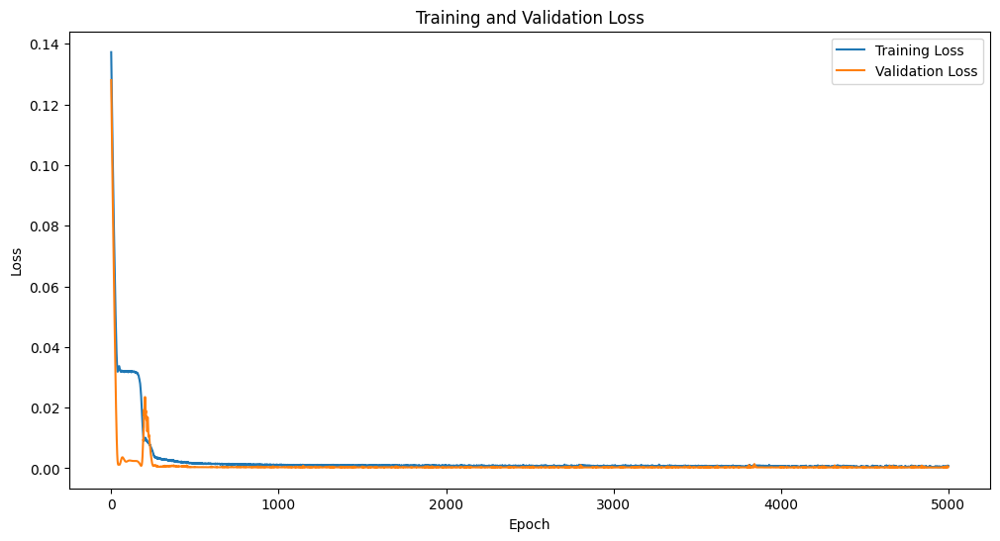

Epoch [1/5000], Train Loss: 0.0437, Val Loss: 0.0204
Epoch [2/5000], Train Loss: 0.0421, Val Loss: 0.0187
Epoch [3/5000], Train Loss: 0.0410, Val Loss: 0.0169
Epoch [4/5000], Train Loss: 0.0396, Val Loss: 0.0153
Epoch [5/5000], Train Loss: 0.0386, Val Loss: 0.0137
Epoch [6/5000], Train Loss: 0.0375, Val Loss: 0.0122
Epoch [7/5000], Train Loss: 0.0366, Val Loss: 0.0108
Epoch [8/5000], Train Loss: 0.0354, Val Loss: 0.0095
Epoch [9/5000], Train Loss: 0.0349, Val Loss: 0.0083
Epoch [10/5000], Train Loss: 0.0341, Val Loss: 0.0071
Epoch [11/5000], Train Loss: 0.0335, Val Loss: 0.0061
Epoch [12/5000], Train Loss: 0.0331, Val Loss: 0.0051
Epoch [13/5000], Train Loss: 0.0326, Val Loss: 0.0043
Epoch [14/5000], Train Loss: 0.0322, Val Loss: 0.0036
Epoch [15/5000], Train Loss: 0.0319, Val Loss: 0.0030
Epoch [16/5000], Train Loss: 0.0320, Val Loss: 0.0025
Epoch [17/5000], Train Loss: 0.0320, Val Loss: 0.0021
Epoch [18/5000], Train Loss: 0.0320, Val Loss: 0.0018
Epoch [19/5000], Train Loss: 0.0321, 

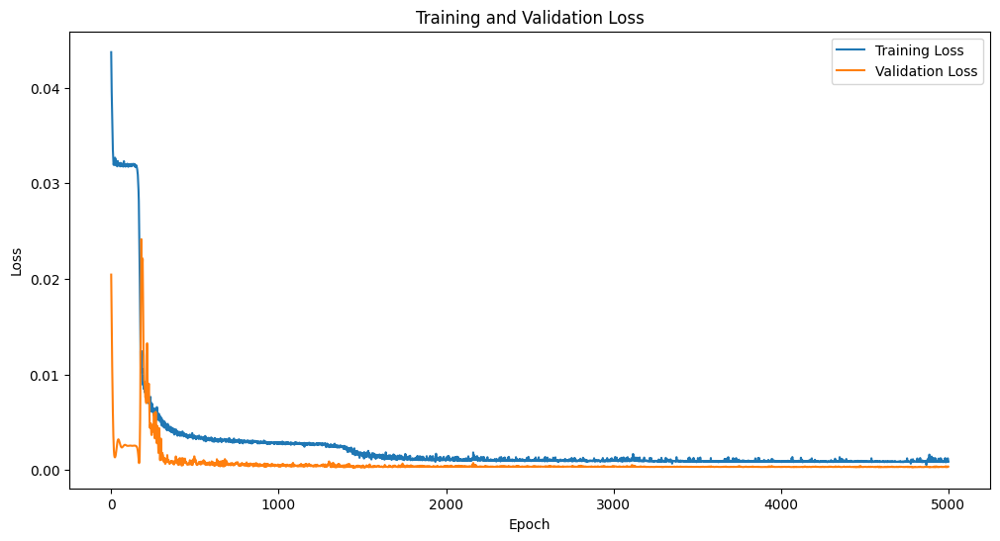

Epoch [1/5000], Train Loss: 0.1941, Val Loss: 0.1920
Epoch [2/5000], Train Loss: 0.1901, Val Loss: 0.1875
Epoch [3/5000], Train Loss: 0.1859, Val Loss: 0.1830
Epoch [4/5000], Train Loss: 0.1819, Val Loss: 0.1786
Epoch [5/5000], Train Loss: 0.1780, Val Loss: 0.1743
Epoch [6/5000], Train Loss: 0.1742, Val Loss: 0.1701
Epoch [7/5000], Train Loss: 0.1704, Val Loss: 0.1659
Epoch [8/5000], Train Loss: 0.1668, Val Loss: 0.1617
Epoch [9/5000], Train Loss: 0.1630, Val Loss: 0.1575
Epoch [10/5000], Train Loss: 0.1593, Val Loss: 0.1534
Epoch [11/5000], Train Loss: 0.1557, Val Loss: 0.1492
Epoch [12/5000], Train Loss: 0.1520, Val Loss: 0.1451
Epoch [13/5000], Train Loss: 0.1483, Val Loss: 0.1409
Epoch [14/5000], Train Loss: 0.1446, Val Loss: 0.1367
Epoch [15/5000], Train Loss: 0.1409, Val Loss: 0.1325
Epoch [16/5000], Train Loss: 0.1372, Val Loss: 0.1282
Epoch [17/5000], Train Loss: 0.1333, Val Loss: 0.1239
Epoch [18/5000], Train Loss: 0.1295, Val Loss: 0.1195
Epoch [19/5000], Train Loss: 0.1259, 

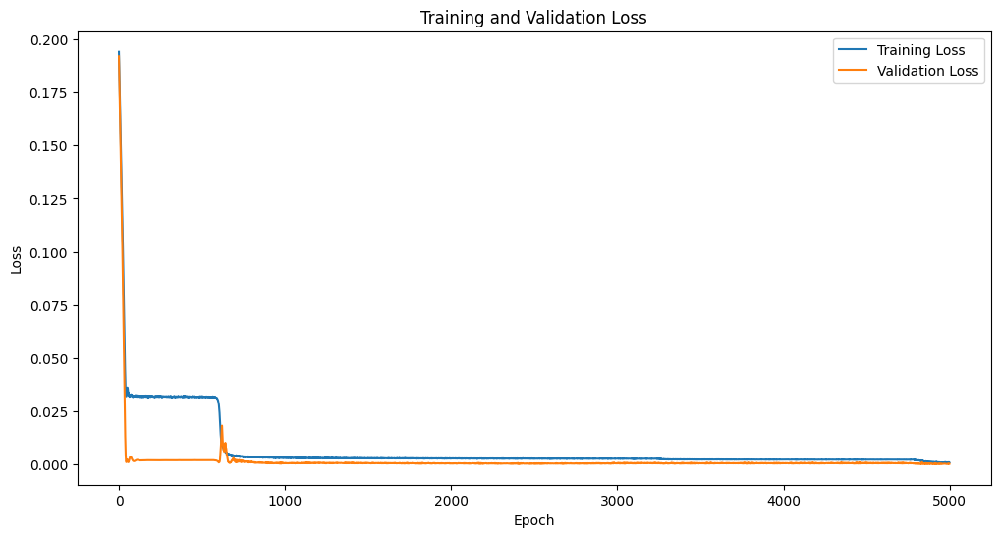

Epoch [1/5000], Train Loss: 0.1634, Val Loss: 0.1563
Epoch [2/5000], Train Loss: 0.1581, Val Loss: 0.1506
Epoch [3/5000], Train Loss: 0.1532, Val Loss: 0.1451
Epoch [4/5000], Train Loss: 0.1482, Val Loss: 0.1397
Epoch [5/5000], Train Loss: 0.1434, Val Loss: 0.1345
Epoch [6/5000], Train Loss: 0.1389, Val Loss: 0.1294
Epoch [7/5000], Train Loss: 0.1344, Val Loss: 0.1244
Epoch [8/5000], Train Loss: 0.1299, Val Loss: 0.1195
Epoch [9/5000], Train Loss: 0.1257, Val Loss: 0.1147
Epoch [10/5000], Train Loss: 0.1214, Val Loss: 0.1100
Epoch [11/5000], Train Loss: 0.1173, Val Loss: 0.1053
Epoch [12/5000], Train Loss: 0.1133, Val Loss: 0.1007
Epoch [13/5000], Train Loss: 0.1091, Val Loss: 0.0962
Epoch [14/5000], Train Loss: 0.1052, Val Loss: 0.0917
Epoch [15/5000], Train Loss: 0.1011, Val Loss: 0.0872
Epoch [16/5000], Train Loss: 0.0974, Val Loss: 0.0828
Epoch [17/5000], Train Loss: 0.0935, Val Loss: 0.0784
Epoch [18/5000], Train Loss: 0.0896, Val Loss: 0.0740
Epoch [19/5000], Train Loss: 0.0860, 

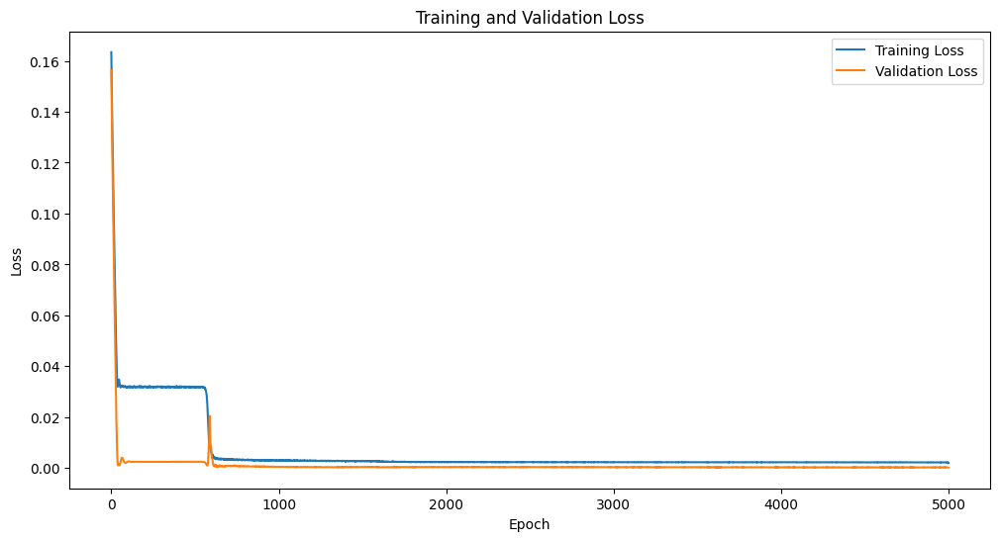

Epoch [1/5000], Train Loss: 0.0567, Val Loss: 0.0371
Epoch [2/5000], Train Loss: 0.0550, Val Loss: 0.0350
Epoch [3/5000], Train Loss: 0.0534, Val Loss: 0.0330
Epoch [4/5000], Train Loss: 0.0519, Val Loss: 0.0310
Epoch [5/5000], Train Loss: 0.0503, Val Loss: 0.0290
Epoch [6/5000], Train Loss: 0.0487, Val Loss: 0.0270
Epoch [7/5000], Train Loss: 0.0471, Val Loss: 0.0250
Epoch [8/5000], Train Loss: 0.0458, Val Loss: 0.0230
Epoch [9/5000], Train Loss: 0.0442, Val Loss: 0.0211
Epoch [10/5000], Train Loss: 0.0428, Val Loss: 0.0192
Epoch [11/5000], Train Loss: 0.0414, Val Loss: 0.0173
Epoch [12/5000], Train Loss: 0.0402, Val Loss: 0.0154
Epoch [13/5000], Train Loss: 0.0389, Val Loss: 0.0136
Epoch [14/5000], Train Loss: 0.0376, Val Loss: 0.0119
Epoch [15/5000], Train Loss: 0.0365, Val Loss: 0.0103
Epoch [16/5000], Train Loss: 0.0355, Val Loss: 0.0087
Epoch [17/5000], Train Loss: 0.0344, Val Loss: 0.0072
Epoch [18/5000], Train Loss: 0.0338, Val Loss: 0.0059
Epoch [19/5000], Train Loss: 0.0331, 

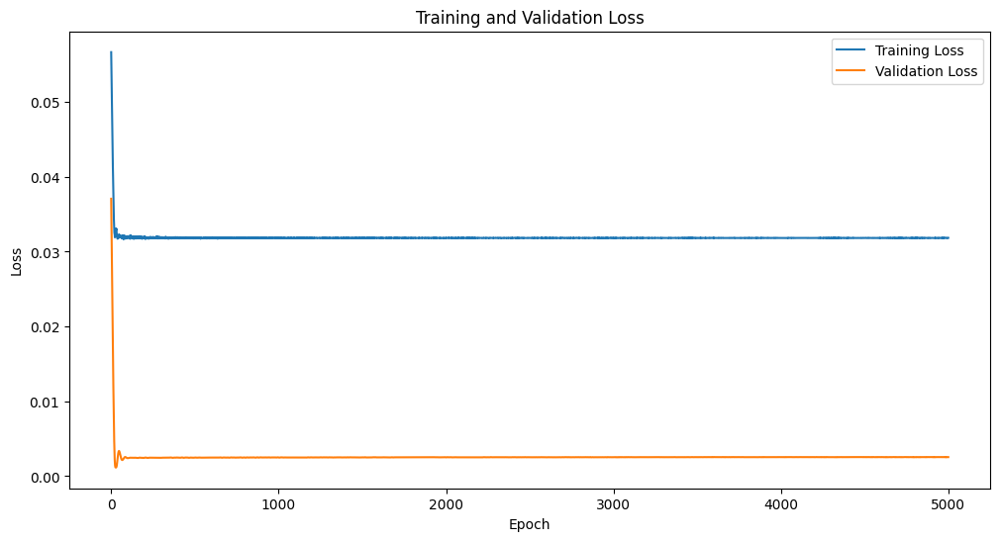

Epoch [1/5000], Train Loss: 0.0388, Val Loss: 0.0122
Epoch [2/5000], Train Loss: 0.0368, Val Loss: 0.0093
Epoch [3/5000], Train Loss: 0.0348, Val Loss: 0.0068
Epoch [4/5000], Train Loss: 0.0335, Val Loss: 0.0047
Epoch [5/5000], Train Loss: 0.0325, Val Loss: 0.0031
Epoch [6/5000], Train Loss: 0.0317, Val Loss: 0.0020
Epoch [7/5000], Train Loss: 0.0316, Val Loss: 0.0014
Epoch [8/5000], Train Loss: 0.0317, Val Loss: 0.0011
Epoch [9/5000], Train Loss: 0.0321, Val Loss: 0.0011
Epoch [10/5000], Train Loss: 0.0322, Val Loss: 0.0011
Epoch [11/5000], Train Loss: 0.0322, Val Loss: 0.0011
Epoch [12/5000], Train Loss: 0.0320, Val Loss: 0.0011
Epoch [13/5000], Train Loss: 0.0317, Val Loss: 0.0012
Epoch [14/5000], Train Loss: 0.0313, Val Loss: 0.0013
Epoch [15/5000], Train Loss: 0.0309, Val Loss: 0.0015
Epoch [16/5000], Train Loss: 0.0307, Val Loss: 0.0018
Epoch [17/5000], Train Loss: 0.0303, Val Loss: 0.0022
Epoch [18/5000], Train Loss: 0.0302, Val Loss: 0.0025
Epoch [19/5000], Train Loss: 0.0302, 

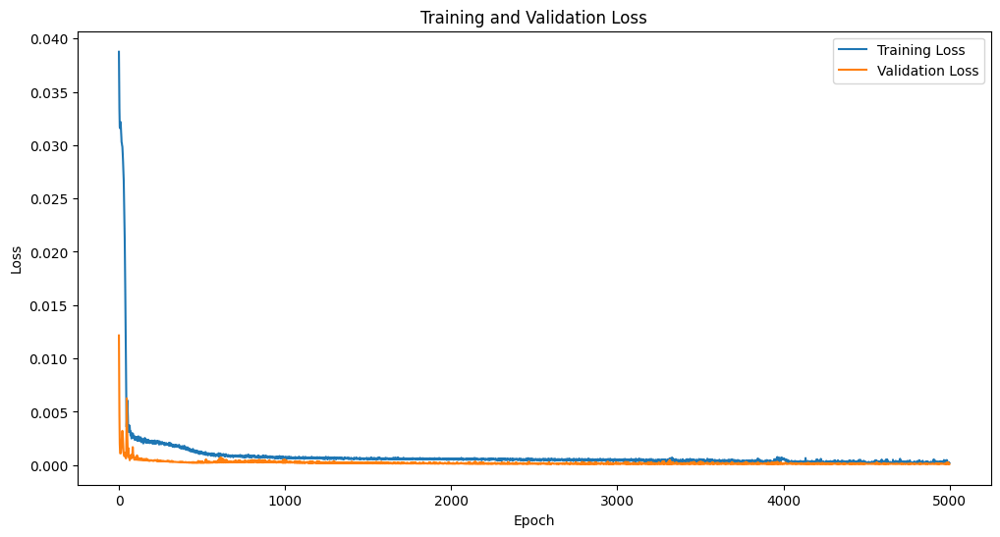

Epoch [1/5000], Train Loss: 0.0964, Val Loss: 0.0805
Epoch [2/5000], Train Loss: 0.0919, Val Loss: 0.0756
Epoch [3/5000], Train Loss: 0.0877, Val Loss: 0.0708
Epoch [4/5000], Train Loss: 0.0834, Val Loss: 0.0660
Epoch [5/5000], Train Loss: 0.0794, Val Loss: 0.0613
Epoch [6/5000], Train Loss: 0.0753, Val Loss: 0.0566
Epoch [7/5000], Train Loss: 0.0714, Val Loss: 0.0518
Epoch [8/5000], Train Loss: 0.0674, Val Loss: 0.0470
Epoch [9/5000], Train Loss: 0.0633, Val Loss: 0.0422
Epoch [10/5000], Train Loss: 0.0595, Val Loss: 0.0374
Epoch [11/5000], Train Loss: 0.0556, Val Loss: 0.0325
Epoch [12/5000], Train Loss: 0.0517, Val Loss: 0.0276
Epoch [13/5000], Train Loss: 0.0478, Val Loss: 0.0228
Epoch [14/5000], Train Loss: 0.0441, Val Loss: 0.0181
Epoch [15/5000], Train Loss: 0.0404, Val Loss: 0.0136
Epoch [16/5000], Train Loss: 0.0371, Val Loss: 0.0094
Epoch [17/5000], Train Loss: 0.0343, Val Loss: 0.0059
Epoch [18/5000], Train Loss: 0.0320, Val Loss: 0.0031
Epoch [19/5000], Train Loss: 0.0303, 

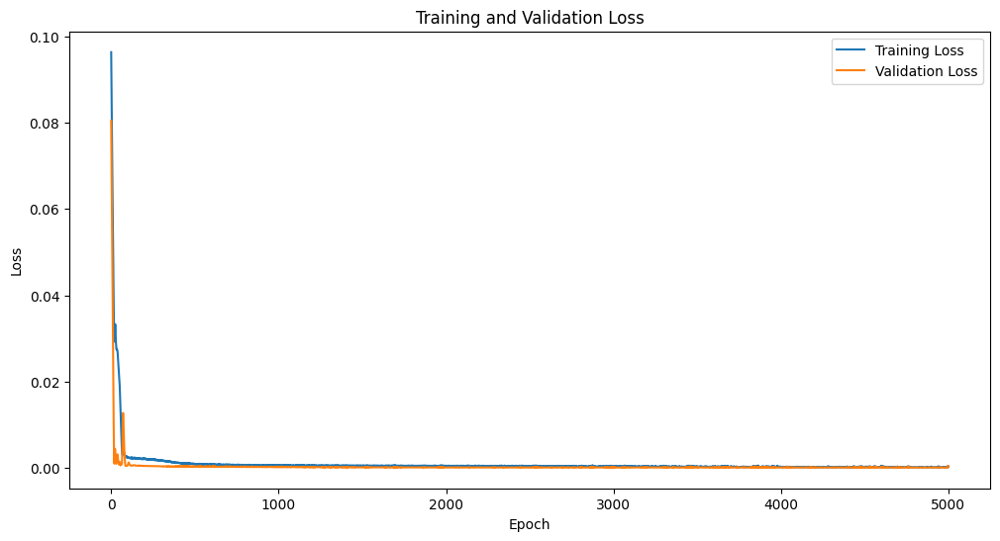

Epoch [1/5000], Train Loss: 0.0667, Val Loss: 0.0457
Epoch [2/5000], Train Loss: 0.0621, Val Loss: 0.0403
Epoch [3/5000], Train Loss: 0.0578, Val Loss: 0.0353
Epoch [4/5000], Train Loss: 0.0543, Val Loss: 0.0304
Epoch [5/5000], Train Loss: 0.0505, Val Loss: 0.0259
Epoch [6/5000], Train Loss: 0.0469, Val Loss: 0.0216
Epoch [7/5000], Train Loss: 0.0439, Val Loss: 0.0175
Epoch [8/5000], Train Loss: 0.0409, Val Loss: 0.0138
Epoch [9/5000], Train Loss: 0.0385, Val Loss: 0.0105
Epoch [10/5000], Train Loss: 0.0365, Val Loss: 0.0075
Epoch [11/5000], Train Loss: 0.0344, Val Loss: 0.0050
Epoch [12/5000], Train Loss: 0.0330, Val Loss: 0.0031
Epoch [13/5000], Train Loss: 0.0322, Val Loss: 0.0018
Epoch [14/5000], Train Loss: 0.0317, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0317, Val Loss: 0.0011
Epoch [16/5000], Train Loss: 0.0324, Val Loss: 0.0013
Epoch [17/5000], Train Loss: 0.0326, Val Loss: 0.0016
Epoch [18/5000], Train Loss: 0.0333, Val Loss: 0.0018
Epoch [19/5000], Train Loss: 0.0340, 

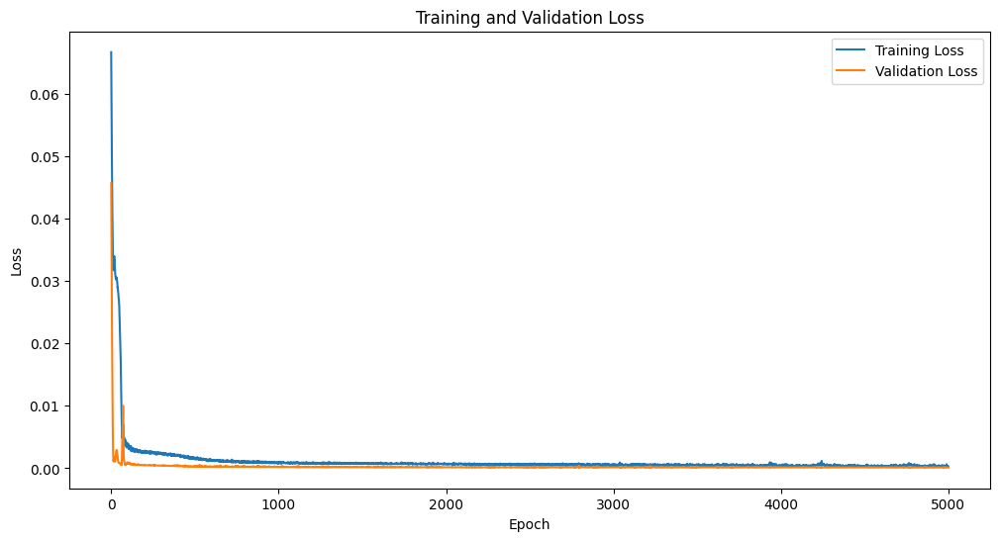

Epoch [1/5000], Train Loss: 0.0490, Val Loss: 0.0260
Epoch [2/5000], Train Loss: 0.0464, Val Loss: 0.0228
Epoch [3/5000], Train Loss: 0.0439, Val Loss: 0.0199
Epoch [4/5000], Train Loss: 0.0417, Val Loss: 0.0171
Epoch [5/5000], Train Loss: 0.0397, Val Loss: 0.0146
Epoch [6/5000], Train Loss: 0.0380, Val Loss: 0.0123
Epoch [7/5000], Train Loss: 0.0365, Val Loss: 0.0102
Epoch [8/5000], Train Loss: 0.0353, Val Loss: 0.0083
Epoch [9/5000], Train Loss: 0.0341, Val Loss: 0.0066
Epoch [10/5000], Train Loss: 0.0332, Val Loss: 0.0051
Epoch [11/5000], Train Loss: 0.0324, Val Loss: 0.0039
Epoch [12/5000], Train Loss: 0.0320, Val Loss: 0.0029
Epoch [13/5000], Train Loss: 0.0319, Val Loss: 0.0021
Epoch [14/5000], Train Loss: 0.0318, Val Loss: 0.0016
Epoch [15/5000], Train Loss: 0.0320, Val Loss: 0.0014
Epoch [16/5000], Train Loss: 0.0323, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0327, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0329, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0331, 

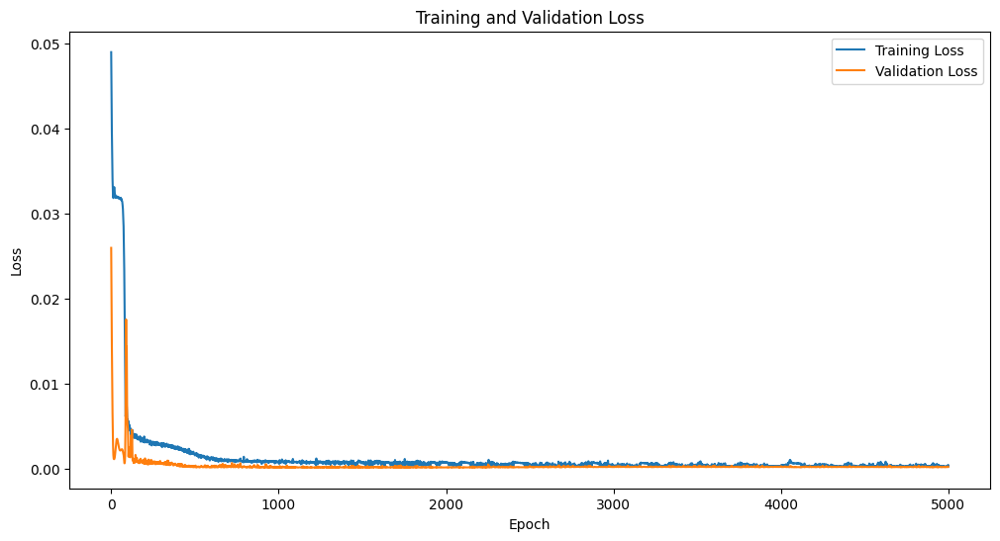

Epoch [1/5000], Train Loss: 0.1078, Val Loss: 0.0919
Epoch [2/5000], Train Loss: 0.1014, Val Loss: 0.0848
Epoch [3/5000], Train Loss: 0.0952, Val Loss: 0.0781
Epoch [4/5000], Train Loss: 0.0894, Val Loss: 0.0717
Epoch [5/5000], Train Loss: 0.0839, Val Loss: 0.0656
Epoch [6/5000], Train Loss: 0.0787, Val Loss: 0.0598
Epoch [7/5000], Train Loss: 0.0737, Val Loss: 0.0541
Epoch [8/5000], Train Loss: 0.0690, Val Loss: 0.0487
Epoch [9/5000], Train Loss: 0.0645, Val Loss: 0.0435
Epoch [10/5000], Train Loss: 0.0602, Val Loss: 0.0384
Epoch [11/5000], Train Loss: 0.0560, Val Loss: 0.0335
Epoch [12/5000], Train Loss: 0.0521, Val Loss: 0.0287
Epoch [13/5000], Train Loss: 0.0484, Val Loss: 0.0242
Epoch [14/5000], Train Loss: 0.0449, Val Loss: 0.0198
Epoch [15/5000], Train Loss: 0.0417, Val Loss: 0.0156
Epoch [16/5000], Train Loss: 0.0387, Val Loss: 0.0117
Epoch [17/5000], Train Loss: 0.0361, Val Loss: 0.0082
Epoch [18/5000], Train Loss: 0.0340, Val Loss: 0.0053
Epoch [19/5000], Train Loss: 0.0327, 

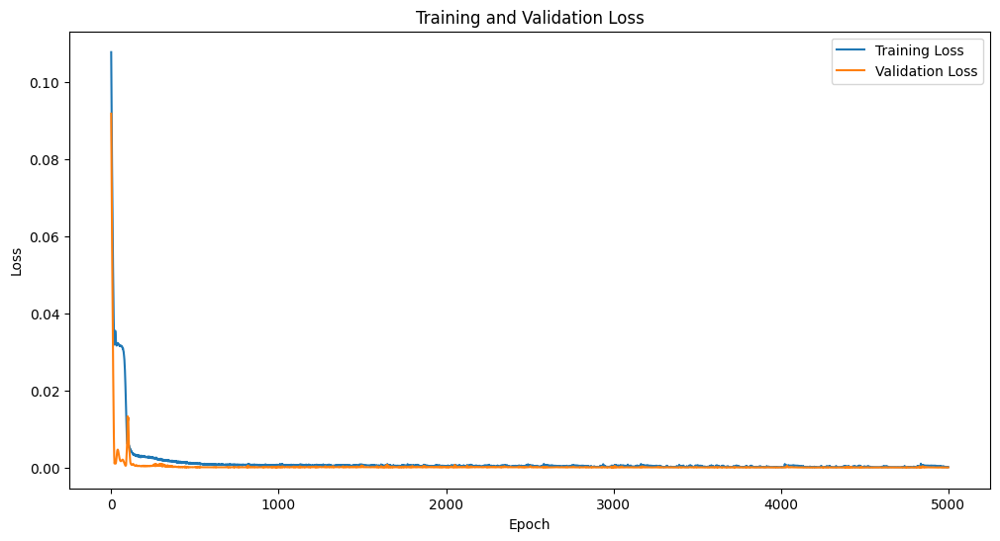

Epoch [1/5000], Train Loss: 0.0488, Val Loss: 0.0263
Epoch [2/5000], Train Loss: 0.0466, Val Loss: 0.0234
Epoch [3/5000], Train Loss: 0.0443, Val Loss: 0.0207
Epoch [4/5000], Train Loss: 0.0425, Val Loss: 0.0182
Epoch [5/5000], Train Loss: 0.0406, Val Loss: 0.0158
Epoch [6/5000], Train Loss: 0.0388, Val Loss: 0.0136
Epoch [7/5000], Train Loss: 0.0372, Val Loss: 0.0115
Epoch [8/5000], Train Loss: 0.0360, Val Loss: 0.0096
Epoch [9/5000], Train Loss: 0.0350, Val Loss: 0.0079
Epoch [10/5000], Train Loss: 0.0339, Val Loss: 0.0063
Epoch [11/5000], Train Loss: 0.0331, Val Loss: 0.0050
Epoch [12/5000], Train Loss: 0.0325, Val Loss: 0.0038
Epoch [13/5000], Train Loss: 0.0322, Val Loss: 0.0029
Epoch [14/5000], Train Loss: 0.0321, Val Loss: 0.0021
Epoch [15/5000], Train Loss: 0.0318, Val Loss: 0.0017
Epoch [16/5000], Train Loss: 0.0321, Val Loss: 0.0014
Epoch [17/5000], Train Loss: 0.0325, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0327, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0332, 

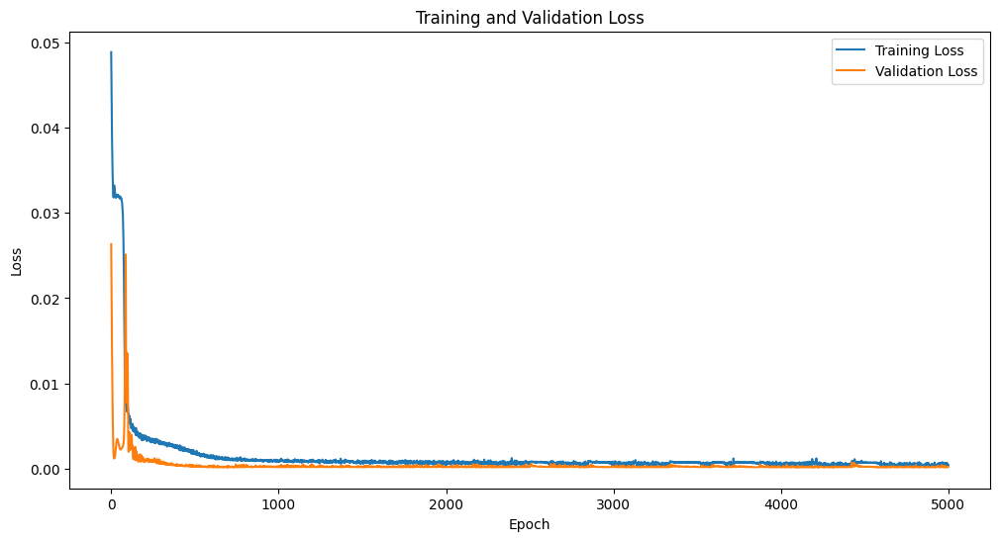

Epoch [1/5000], Train Loss: 0.0479, Val Loss: 0.0248
Epoch [2/5000], Train Loss: 0.0454, Val Loss: 0.0217
Epoch [3/5000], Train Loss: 0.0431, Val Loss: 0.0188
Epoch [4/5000], Train Loss: 0.0409, Val Loss: 0.0160
Epoch [5/5000], Train Loss: 0.0390, Val Loss: 0.0134
Epoch [6/5000], Train Loss: 0.0372, Val Loss: 0.0110
Epoch [7/5000], Train Loss: 0.0355, Val Loss: 0.0087
Epoch [8/5000], Train Loss: 0.0344, Val Loss: 0.0067
Epoch [9/5000], Train Loss: 0.0332, Val Loss: 0.0049
Epoch [10/5000], Train Loss: 0.0325, Val Loss: 0.0035
Epoch [11/5000], Train Loss: 0.0320, Val Loss: 0.0024
Epoch [12/5000], Train Loss: 0.0321, Val Loss: 0.0017
Epoch [13/5000], Train Loss: 0.0321, Val Loss: 0.0013
Epoch [14/5000], Train Loss: 0.0325, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0330, Val Loss: 0.0011
Epoch [16/5000], Train Loss: 0.0328, Val Loss: 0.0011
Epoch [17/5000], Train Loss: 0.0331, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0332, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0327, 

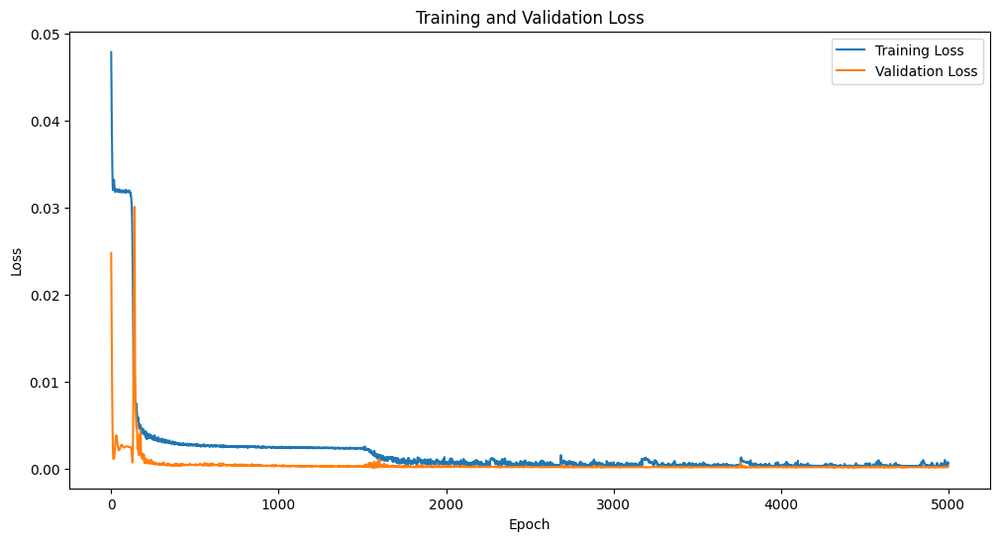

Epoch [1/5000], Train Loss: 0.0835, Val Loss: 0.0661
Epoch [2/5000], Train Loss: 0.0791, Val Loss: 0.0612
Epoch [3/5000], Train Loss: 0.0749, Val Loss: 0.0565
Epoch [4/5000], Train Loss: 0.0709, Val Loss: 0.0520
Epoch [5/5000], Train Loss: 0.0672, Val Loss: 0.0477
Epoch [6/5000], Train Loss: 0.0636, Val Loss: 0.0435
Epoch [7/5000], Train Loss: 0.0602, Val Loss: 0.0394
Epoch [8/5000], Train Loss: 0.0568, Val Loss: 0.0355
Epoch [9/5000], Train Loss: 0.0537, Val Loss: 0.0316
Epoch [10/5000], Train Loss: 0.0506, Val Loss: 0.0278
Epoch [11/5000], Train Loss: 0.0477, Val Loss: 0.0242
Epoch [12/5000], Train Loss: 0.0449, Val Loss: 0.0206
Epoch [13/5000], Train Loss: 0.0422, Val Loss: 0.0171
Epoch [14/5000], Train Loss: 0.0397, Val Loss: 0.0138
Epoch [15/5000], Train Loss: 0.0375, Val Loss: 0.0106
Epoch [16/5000], Train Loss: 0.0355, Val Loss: 0.0078
Epoch [17/5000], Train Loss: 0.0337, Val Loss: 0.0053
Epoch [18/5000], Train Loss: 0.0326, Val Loss: 0.0034
Epoch [19/5000], Train Loss: 0.0320, 

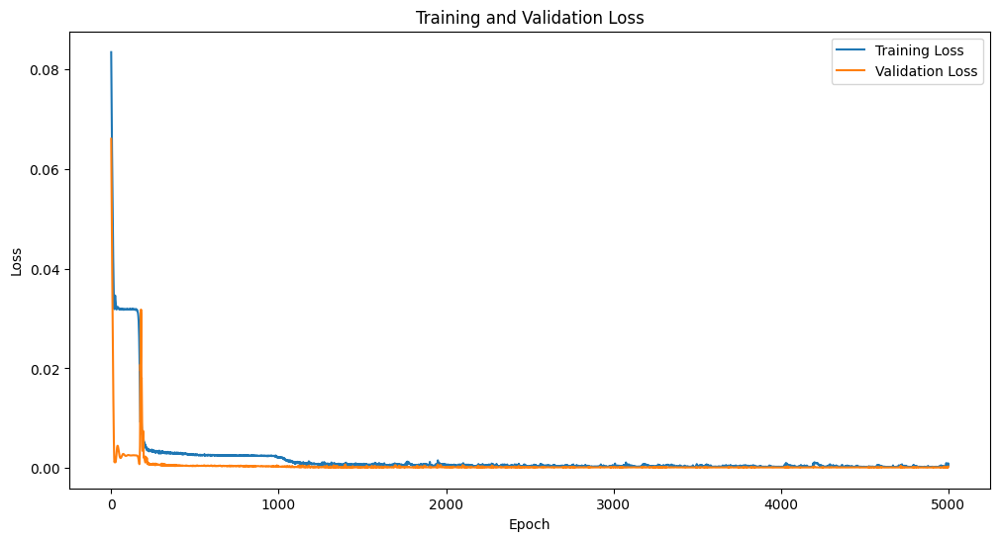

Epoch [1/5000], Train Loss: 0.0956, Val Loss: 0.0790
Epoch [2/5000], Train Loss: 0.0901, Val Loss: 0.0729
Epoch [3/5000], Train Loss: 0.0850, Val Loss: 0.0669
Epoch [4/5000], Train Loss: 0.0798, Val Loss: 0.0610
Epoch [5/5000], Train Loss: 0.0748, Val Loss: 0.0553
Epoch [6/5000], Train Loss: 0.0701, Val Loss: 0.0496
Epoch [7/5000], Train Loss: 0.0653, Val Loss: 0.0441
Epoch [8/5000], Train Loss: 0.0607, Val Loss: 0.0386
Epoch [9/5000], Train Loss: 0.0564, Val Loss: 0.0333
Epoch [10/5000], Train Loss: 0.0521, Val Loss: 0.0281
Epoch [11/5000], Train Loss: 0.0482, Val Loss: 0.0231
Epoch [12/5000], Train Loss: 0.0444, Val Loss: 0.0183
Epoch [13/5000], Train Loss: 0.0409, Val Loss: 0.0138
Epoch [14/5000], Train Loss: 0.0377, Val Loss: 0.0098
Epoch [15/5000], Train Loss: 0.0355, Val Loss: 0.0063
Epoch [16/5000], Train Loss: 0.0333, Val Loss: 0.0036
Epoch [17/5000], Train Loss: 0.0326, Val Loss: 0.0019
Epoch [18/5000], Train Loss: 0.0327, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0329, 

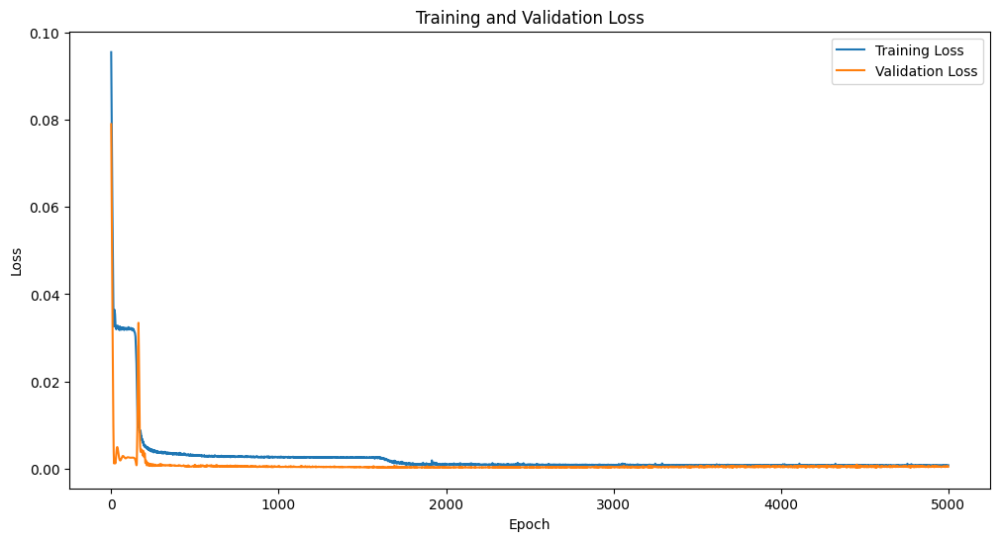

Epoch [1/5000], Train Loss: 0.0565, Val Loss: 0.0343
Epoch [2/5000], Train Loss: 0.0527, Val Loss: 0.0299
Epoch [3/5000], Train Loss: 0.0493, Val Loss: 0.0259
Epoch [4/5000], Train Loss: 0.0462, Val Loss: 0.0220
Epoch [5/5000], Train Loss: 0.0433, Val Loss: 0.0185
Epoch [6/5000], Train Loss: 0.0407, Val Loss: 0.0152
Epoch [7/5000], Train Loss: 0.0383, Val Loss: 0.0121
Epoch [8/5000], Train Loss: 0.0364, Val Loss: 0.0094
Epoch [9/5000], Train Loss: 0.0346, Val Loss: 0.0070
Epoch [10/5000], Train Loss: 0.0335, Val Loss: 0.0050
Epoch [11/5000], Train Loss: 0.0326, Val Loss: 0.0034
Epoch [12/5000], Train Loss: 0.0320, Val Loss: 0.0022
Epoch [13/5000], Train Loss: 0.0321, Val Loss: 0.0015
Epoch [14/5000], Train Loss: 0.0323, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0328, Val Loss: 0.0011
Epoch [16/5000], Train Loss: 0.0335, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0333, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0335, 

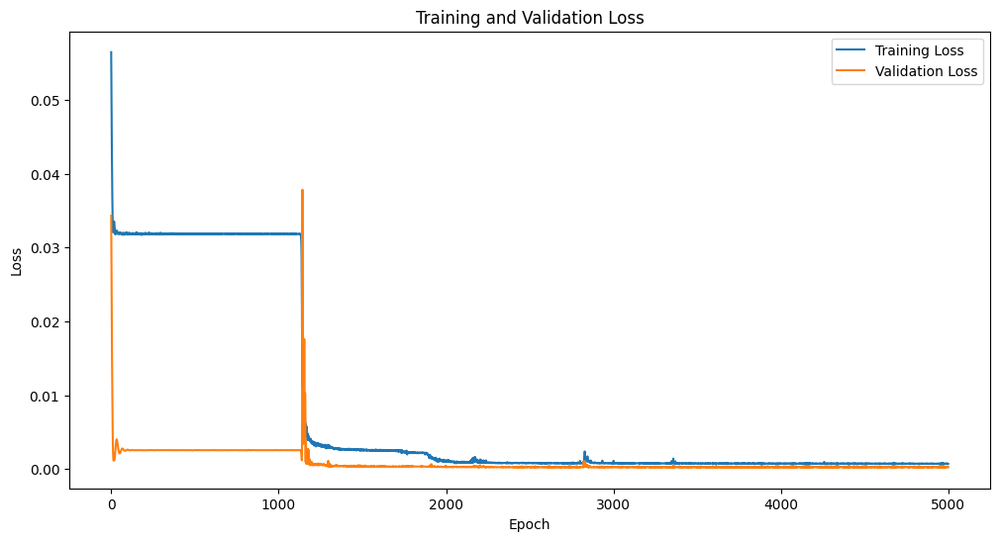

Epoch [1/5000], Train Loss: 0.1033, Val Loss: 0.0898
Epoch [2/5000], Train Loss: 0.0996, Val Loss: 0.0857
Epoch [3/5000], Train Loss: 0.0960, Val Loss: 0.0817
Epoch [4/5000], Train Loss: 0.0925, Val Loss: 0.0777
Epoch [5/5000], Train Loss: 0.0891, Val Loss: 0.0738
Epoch [6/5000], Train Loss: 0.0857, Val Loss: 0.0699
Epoch [7/5000], Train Loss: 0.0823, Val Loss: 0.0659
Epoch [8/5000], Train Loss: 0.0789, Val Loss: 0.0619
Epoch [9/5000], Train Loss: 0.0755, Val Loss: 0.0579
Epoch [10/5000], Train Loss: 0.0721, Val Loss: 0.0537
Epoch [11/5000], Train Loss: 0.0687, Val Loss: 0.0495
Epoch [12/5000], Train Loss: 0.0652, Val Loss: 0.0451
Epoch [13/5000], Train Loss: 0.0615, Val Loss: 0.0406
Epoch [14/5000], Train Loss: 0.0579, Val Loss: 0.0360
Epoch [15/5000], Train Loss: 0.0541, Val Loss: 0.0312
Epoch [16/5000], Train Loss: 0.0503, Val Loss: 0.0263
Epoch [17/5000], Train Loss: 0.0465, Val Loss: 0.0214
Epoch [18/5000], Train Loss: 0.0429, Val Loss: 0.0164
Epoch [19/5000], Train Loss: 0.0393, 

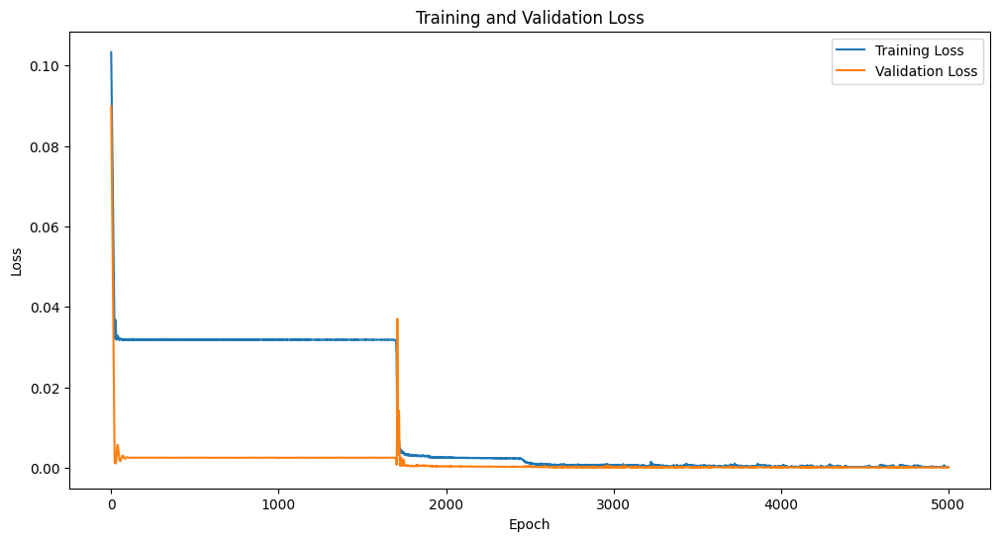

Epoch [1/5000], Train Loss: 0.0536, Val Loss: 0.0302
Epoch [2/5000], Train Loss: 0.0496, Val Loss: 0.0254
Epoch [3/5000], Train Loss: 0.0460, Val Loss: 0.0210
Epoch [4/5000], Train Loss: 0.0427, Val Loss: 0.0170
Epoch [5/5000], Train Loss: 0.0397, Val Loss: 0.0135
Epoch [6/5000], Train Loss: 0.0373, Val Loss: 0.0103
Epoch [7/5000], Train Loss: 0.0356, Val Loss: 0.0076
Epoch [8/5000], Train Loss: 0.0338, Val Loss: 0.0053
Epoch [9/5000], Train Loss: 0.0330, Val Loss: 0.0036
Epoch [10/5000], Train Loss: 0.0323, Val Loss: 0.0023
Epoch [11/5000], Train Loss: 0.0321, Val Loss: 0.0016
Epoch [12/5000], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [13/5000], Train Loss: 0.0328, Val Loss: 0.0011
Epoch [14/5000], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0335, Val Loss: 0.0012
Epoch [16/5000], Train Loss: 0.0336, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0337, Val Loss: 0.0011
Epoch [18/5000], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0331, 

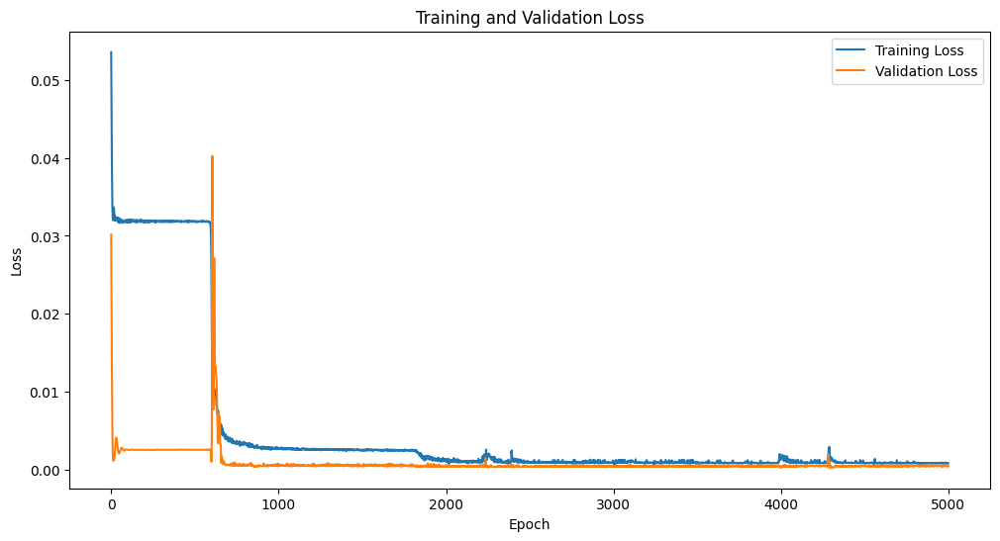

Epoch [1/5000], Train Loss: 0.0570, Val Loss: 0.0325
Epoch [2/5000], Train Loss: 0.0514, Val Loss: 0.0262
Epoch [3/5000], Train Loss: 0.0466, Val Loss: 0.0203
Epoch [4/5000], Train Loss: 0.0421, Val Loss: 0.0150
Epoch [5/5000], Train Loss: 0.0383, Val Loss: 0.0103
Epoch [6/5000], Train Loss: 0.0351, Val Loss: 0.0062
Epoch [7/5000], Train Loss: 0.0326, Val Loss: 0.0032
Epoch [8/5000], Train Loss: 0.0309, Val Loss: 0.0014
Epoch [9/5000], Train Loss: 0.0303, Val Loss: 0.0011
Epoch [10/5000], Train Loss: 0.0310, Val Loss: 0.0017
Epoch [11/5000], Train Loss: 0.0323, Val Loss: 0.0023
Epoch [12/5000], Train Loss: 0.0328, Val Loss: 0.0022
Epoch [13/5000], Train Loss: 0.0326, Val Loss: 0.0018
Epoch [14/5000], Train Loss: 0.0318, Val Loss: 0.0013
Epoch [15/5000], Train Loss: 0.0307, Val Loss: 0.0010
Epoch [16/5000], Train Loss: 0.0298, Val Loss: 0.0011
Epoch [17/5000], Train Loss: 0.0289, Val Loss: 0.0015
Epoch [18/5000], Train Loss: 0.0287, Val Loss: 0.0020
Epoch [19/5000], Train Loss: 0.0283, 

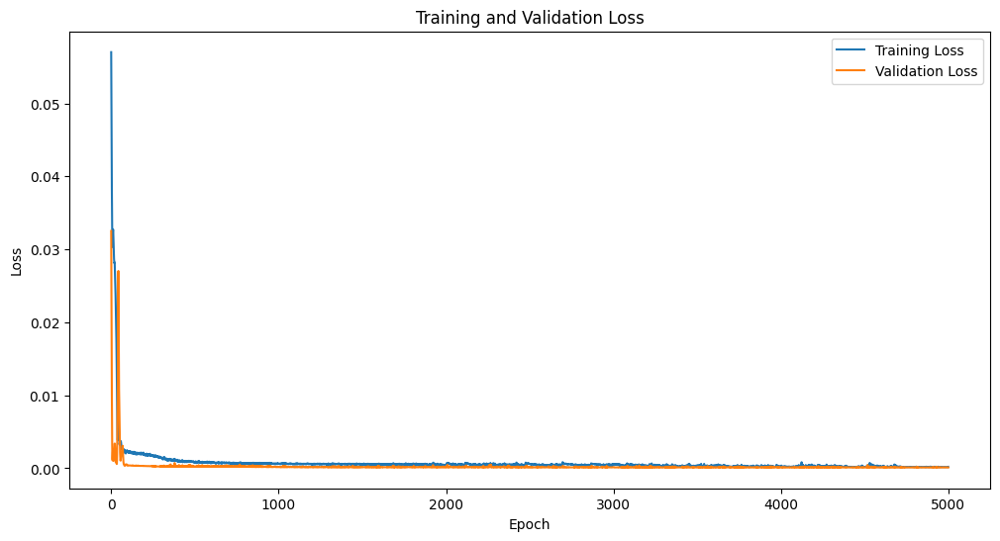

Epoch [1/5000], Train Loss: 0.0918, Val Loss: 0.0717
Epoch [2/5000], Train Loss: 0.0839, Val Loss: 0.0629
Epoch [3/5000], Train Loss: 0.0765, Val Loss: 0.0544
Epoch [4/5000], Train Loss: 0.0696, Val Loss: 0.0461
Epoch [5/5000], Train Loss: 0.0629, Val Loss: 0.0380
Epoch [6/5000], Train Loss: 0.0565, Val Loss: 0.0301
Epoch [7/5000], Train Loss: 0.0504, Val Loss: 0.0223
Epoch [8/5000], Train Loss: 0.0444, Val Loss: 0.0150
Epoch [9/5000], Train Loss: 0.0392, Val Loss: 0.0086
Epoch [10/5000], Train Loss: 0.0348, Val Loss: 0.0036
Epoch [11/5000], Train Loss: 0.0316, Val Loss: 0.0011
Epoch [12/5000], Train Loss: 0.0305, Val Loss: 0.0020
Epoch [13/5000], Train Loss: 0.0319, Val Loss: 0.0049
Epoch [14/5000], Train Loss: 0.0347, Val Loss: 0.0066
Epoch [15/5000], Train Loss: 0.0361, Val Loss: 0.0061
Epoch [16/5000], Train Loss: 0.0354, Val Loss: 0.0042
Epoch [17/5000], Train Loss: 0.0336, Val Loss: 0.0024
Epoch [18/5000], Train Loss: 0.0319, Val Loss: 0.0013
Epoch [19/5000], Train Loss: 0.0302, 

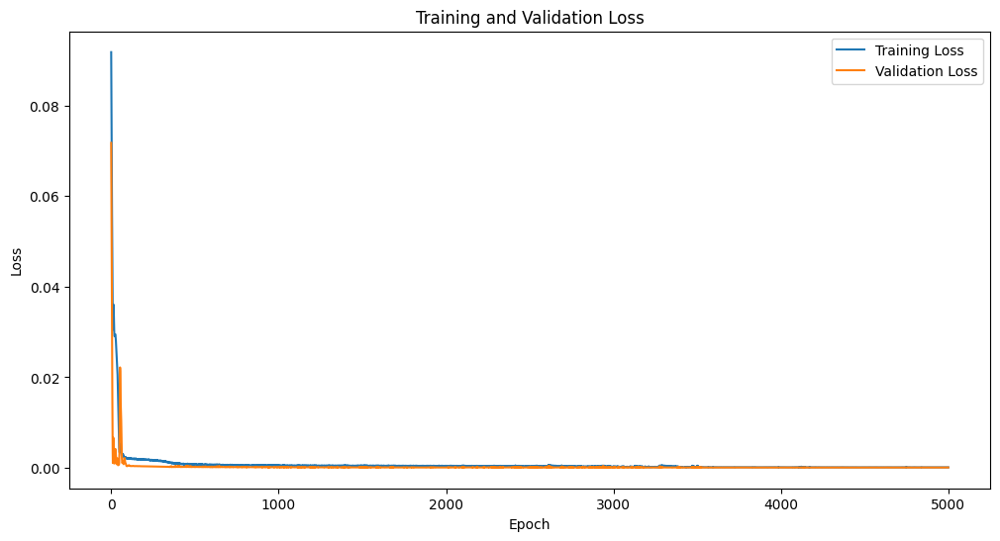

Epoch [1/5000], Train Loss: 0.0910, Val Loss: 0.0700
Epoch [2/5000], Train Loss: 0.0834, Val Loss: 0.0612
Epoch [3/5000], Train Loss: 0.0762, Val Loss: 0.0529
Epoch [4/5000], Train Loss: 0.0696, Val Loss: 0.0450
Epoch [5/5000], Train Loss: 0.0632, Val Loss: 0.0372
Epoch [6/5000], Train Loss: 0.0571, Val Loss: 0.0297
Epoch [7/5000], Train Loss: 0.0513, Val Loss: 0.0223
Epoch [8/5000], Train Loss: 0.0456, Val Loss: 0.0152
Epoch [9/5000], Train Loss: 0.0407, Val Loss: 0.0089
Epoch [10/5000], Train Loss: 0.0361, Val Loss: 0.0038
Epoch [11/5000], Train Loss: 0.0327, Val Loss: 0.0011
Epoch [12/5000], Train Loss: 0.0313, Val Loss: 0.0018
Epoch [13/5000], Train Loss: 0.0318, Val Loss: 0.0052
Epoch [14/5000], Train Loss: 0.0344, Val Loss: 0.0079
Epoch [15/5000], Train Loss: 0.0360, Val Loss: 0.0079
Epoch [16/5000], Train Loss: 0.0365, Val Loss: 0.0059
Epoch [17/5000], Train Loss: 0.0348, Val Loss: 0.0036
Epoch [18/5000], Train Loss: 0.0327, Val Loss: 0.0019
Epoch [19/5000], Train Loss: 0.0309, 

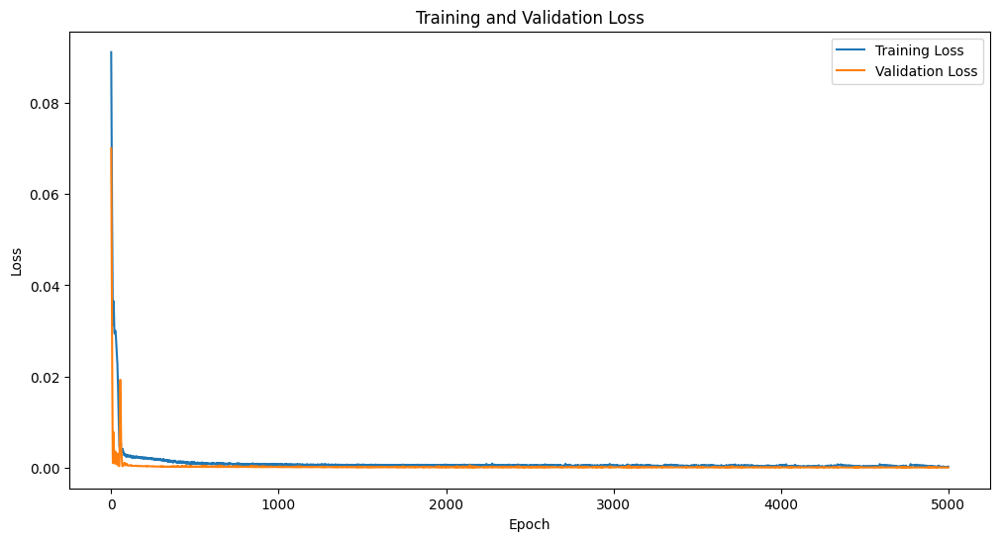

Epoch [1/5000], Train Loss: 0.0643, Val Loss: 0.0419
Epoch [2/5000], Train Loss: 0.0589, Val Loss: 0.0358
Epoch [3/5000], Train Loss: 0.0539, Val Loss: 0.0301
Epoch [4/5000], Train Loss: 0.0494, Val Loss: 0.0248
Epoch [5/5000], Train Loss: 0.0453, Val Loss: 0.0198
Epoch [6/5000], Train Loss: 0.0416, Val Loss: 0.0151
Epoch [7/5000], Train Loss: 0.0383, Val Loss: 0.0107
Epoch [8/5000], Train Loss: 0.0355, Val Loss: 0.0069
Epoch [9/5000], Train Loss: 0.0334, Val Loss: 0.0038
Epoch [10/5000], Train Loss: 0.0321, Val Loss: 0.0018
Epoch [11/5000], Train Loss: 0.0320, Val Loss: 0.0011
Epoch [12/5000], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [13/5000], Train Loss: 0.0344, Val Loss: 0.0015
Epoch [14/5000], Train Loss: 0.0348, Val Loss: 0.0013
Epoch [15/5000], Train Loss: 0.0344, Val Loss: 0.0012
Epoch [16/5000], Train Loss: 0.0336, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0329, Val Loss: 0.0014
Epoch [18/5000], Train Loss: 0.0324, Val Loss: 0.0019
Epoch [19/5000], Train Loss: 0.0320, 

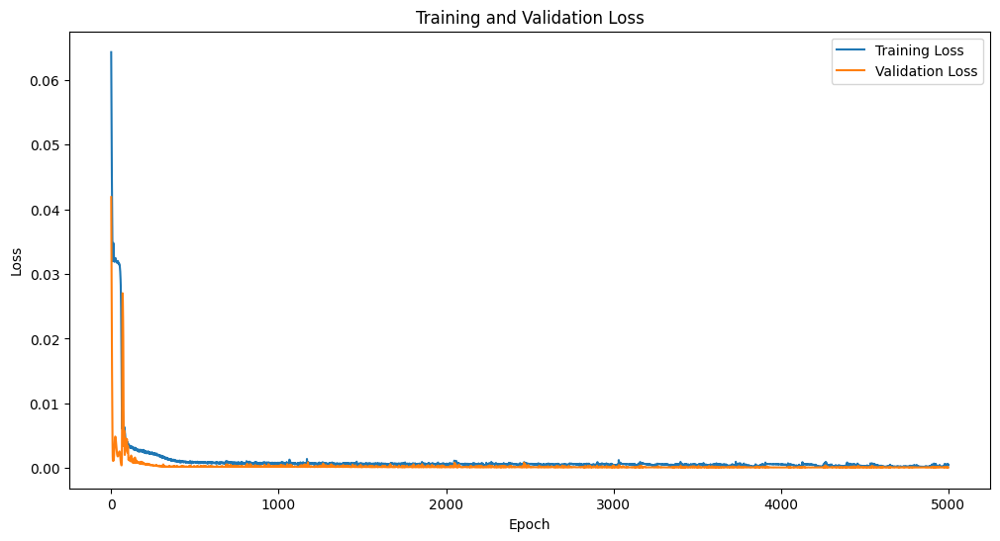

Epoch [1/5000], Train Loss: 0.0785, Val Loss: 0.0562
Epoch [2/5000], Train Loss: 0.0707, Val Loss: 0.0476
Epoch [3/5000], Train Loss: 0.0635, Val Loss: 0.0395
Epoch [4/5000], Train Loss: 0.0569, Val Loss: 0.0319
Epoch [5/5000], Train Loss: 0.0509, Val Loss: 0.0247
Epoch [6/5000], Train Loss: 0.0453, Val Loss: 0.0179
Epoch [7/5000], Train Loss: 0.0403, Val Loss: 0.0118
Epoch [8/5000], Train Loss: 0.0361, Val Loss: 0.0065
Epoch [9/5000], Train Loss: 0.0331, Val Loss: 0.0028
Epoch [10/5000], Train Loss: 0.0319, Val Loss: 0.0012
Epoch [11/5000], Train Loss: 0.0328, Val Loss: 0.0016
Epoch [12/5000], Train Loss: 0.0350, Val Loss: 0.0022
Epoch [13/5000], Train Loss: 0.0365, Val Loss: 0.0021
Epoch [14/5000], Train Loss: 0.0363, Val Loss: 0.0016
Epoch [15/5000], Train Loss: 0.0350, Val Loss: 0.0012
Epoch [16/5000], Train Loss: 0.0337, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0328, Val Loss: 0.0016
Epoch [18/5000], Train Loss: 0.0320, Val Loss: 0.0023
Epoch [19/5000], Train Loss: 0.0319, 

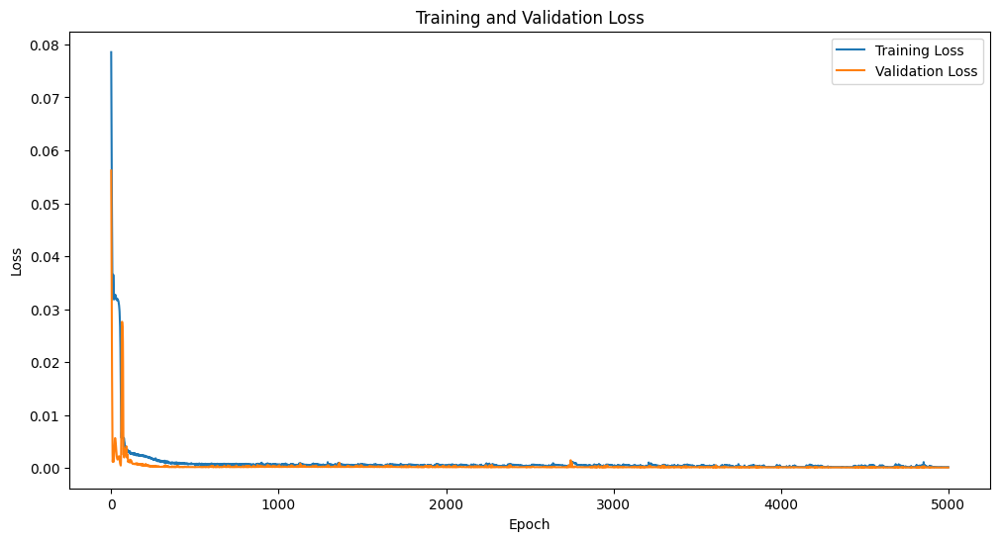

Epoch [1/5000], Train Loss: 0.0936, Val Loss: 0.0732
Epoch [2/5000], Train Loss: 0.0853, Val Loss: 0.0640
Epoch [3/5000], Train Loss: 0.0774, Val Loss: 0.0550
Epoch [4/5000], Train Loss: 0.0698, Val Loss: 0.0462
Epoch [5/5000], Train Loss: 0.0626, Val Loss: 0.0375
Epoch [6/5000], Train Loss: 0.0554, Val Loss: 0.0290
Epoch [7/5000], Train Loss: 0.0488, Val Loss: 0.0207
Epoch [8/5000], Train Loss: 0.0424, Val Loss: 0.0130
Epoch [9/5000], Train Loss: 0.0372, Val Loss: 0.0065
Epoch [10/5000], Train Loss: 0.0336, Val Loss: 0.0022
Epoch [11/5000], Train Loss: 0.0321, Val Loss: 0.0012
Epoch [12/5000], Train Loss: 0.0339, Val Loss: 0.0027
Epoch [13/5000], Train Loss: 0.0373, Val Loss: 0.0034
Epoch [14/5000], Train Loss: 0.0389, Val Loss: 0.0029
Epoch [15/5000], Train Loss: 0.0376, Val Loss: 0.0019
Epoch [16/5000], Train Loss: 0.0360, Val Loss: 0.0012
Epoch [17/5000], Train Loss: 0.0341, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0329, Val Loss: 0.0019
Epoch [19/5000], Train Loss: 0.0322, 

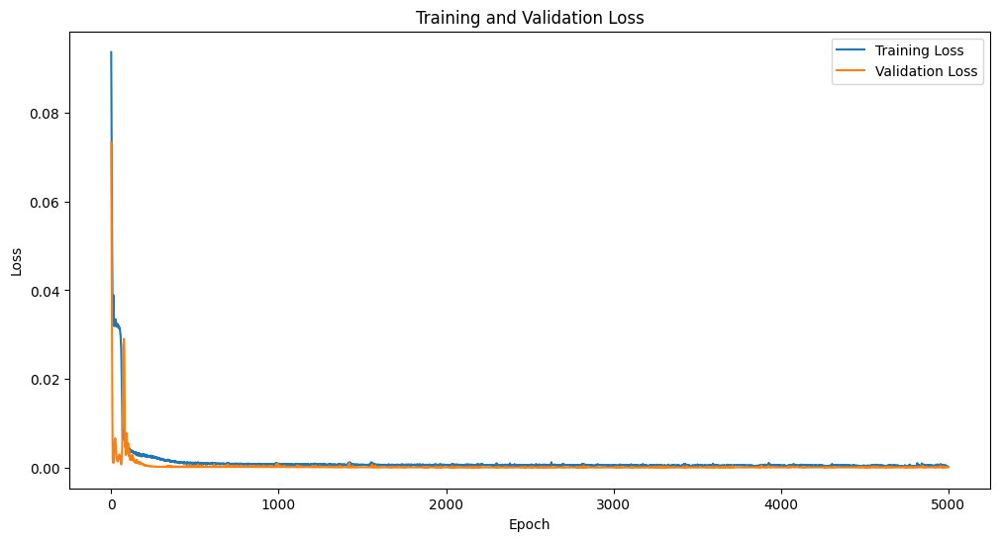

Epoch [1/5000], Train Loss: 0.0540, Val Loss: 0.0302
Epoch [2/5000], Train Loss: 0.0495, Val Loss: 0.0250
Epoch [3/5000], Train Loss: 0.0455, Val Loss: 0.0201
Epoch [4/5000], Train Loss: 0.0420, Val Loss: 0.0156
Epoch [5/5000], Train Loss: 0.0387, Val Loss: 0.0114
Epoch [6/5000], Train Loss: 0.0359, Val Loss: 0.0077
Epoch [7/5000], Train Loss: 0.0337, Val Loss: 0.0046
Epoch [8/5000], Train Loss: 0.0324, Val Loss: 0.0023
Epoch [9/5000], Train Loss: 0.0318, Val Loss: 0.0012
Epoch [10/5000], Train Loss: 0.0325, Val Loss: 0.0012
Epoch [11/5000], Train Loss: 0.0337, Val Loss: 0.0013
Epoch [12/5000], Train Loss: 0.0344, Val Loss: 0.0012
Epoch [13/5000], Train Loss: 0.0341, Val Loss: 0.0011
Epoch [14/5000], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0327, Val Loss: 0.0015
Epoch [16/5000], Train Loss: 0.0322, Val Loss: 0.0019
Epoch [17/5000], Train Loss: 0.0320, Val Loss: 0.0025
Epoch [18/5000], Train Loss: 0.0318, Val Loss: 0.0030
Epoch [19/5000], Train Loss: 0.0319, 

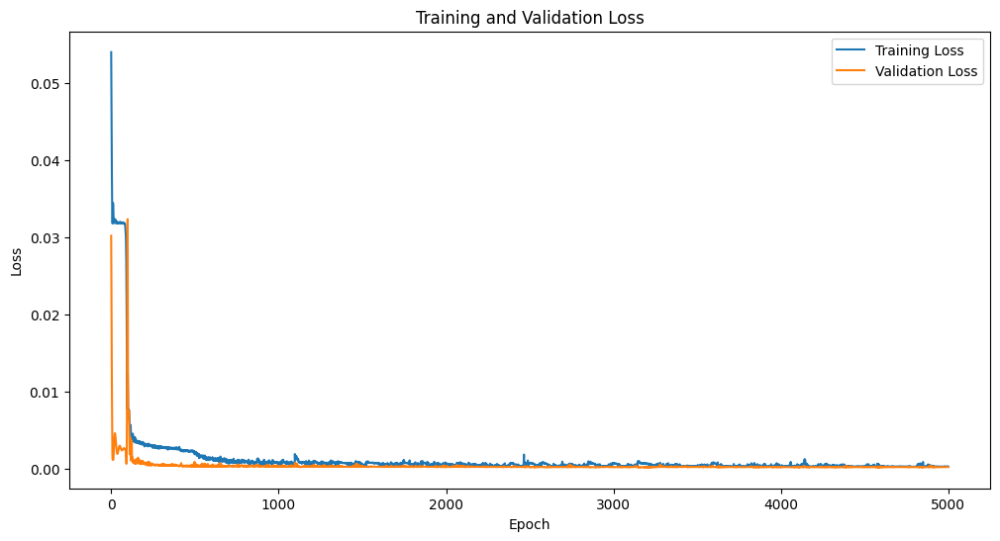

Epoch [1/5000], Train Loss: 0.0728, Val Loss: 0.0510
Epoch [2/5000], Train Loss: 0.0664, Val Loss: 0.0434
Epoch [3/5000], Train Loss: 0.0601, Val Loss: 0.0361
Epoch [4/5000], Train Loss: 0.0541, Val Loss: 0.0289
Epoch [5/5000], Train Loss: 0.0485, Val Loss: 0.0219
Epoch [6/5000], Train Loss: 0.0432, Val Loss: 0.0153
Epoch [7/5000], Train Loss: 0.0385, Val Loss: 0.0093
Epoch [8/5000], Train Loss: 0.0347, Val Loss: 0.0045
Epoch [9/5000], Train Loss: 0.0323, Val Loss: 0.0016
Epoch [10/5000], Train Loss: 0.0322, Val Loss: 0.0013
Epoch [11/5000], Train Loss: 0.0344, Val Loss: 0.0021
Epoch [12/5000], Train Loss: 0.0363, Val Loss: 0.0021
Epoch [13/5000], Train Loss: 0.0365, Val Loss: 0.0016
Epoch [14/5000], Train Loss: 0.0353, Val Loss: 0.0012
Epoch [15/5000], Train Loss: 0.0336, Val Loss: 0.0012
Epoch [16/5000], Train Loss: 0.0325, Val Loss: 0.0018
Epoch [17/5000], Train Loss: 0.0320, Val Loss: 0.0026
Epoch [18/5000], Train Loss: 0.0318, Val Loss: 0.0034
Epoch [19/5000], Train Loss: 0.0319, 

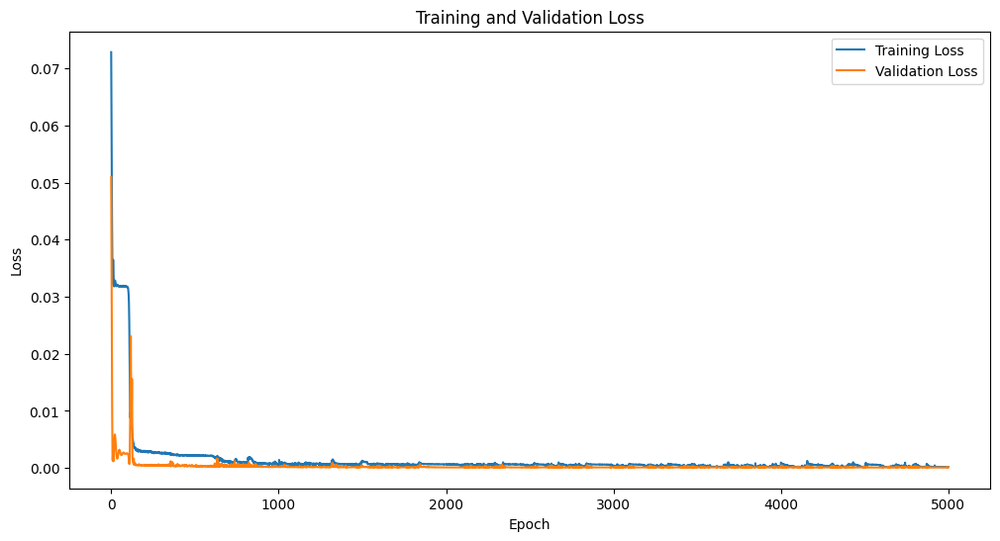

Epoch [1/5000], Train Loss: 0.1138, Val Loss: 0.0950
Epoch [2/5000], Train Loss: 0.1041, Val Loss: 0.0844
Epoch [3/5000], Train Loss: 0.0949, Val Loss: 0.0742
Epoch [4/5000], Train Loss: 0.0860, Val Loss: 0.0643
Epoch [5/5000], Train Loss: 0.0777, Val Loss: 0.0546
Epoch [6/5000], Train Loss: 0.0695, Val Loss: 0.0449
Epoch [7/5000], Train Loss: 0.0615, Val Loss: 0.0353
Epoch [8/5000], Train Loss: 0.0538, Val Loss: 0.0259
Epoch [9/5000], Train Loss: 0.0464, Val Loss: 0.0170
Epoch [10/5000], Train Loss: 0.0396, Val Loss: 0.0090
Epoch [11/5000], Train Loss: 0.0346, Val Loss: 0.0032
Epoch [12/5000], Train Loss: 0.0323, Val Loss: 0.0012
Epoch [13/5000], Train Loss: 0.0335, Val Loss: 0.0028
Epoch [14/5000], Train Loss: 0.0378, Val Loss: 0.0042
Epoch [15/5000], Train Loss: 0.0402, Val Loss: 0.0037
Epoch [16/5000], Train Loss: 0.0392, Val Loss: 0.0024
Epoch [17/5000], Train Loss: 0.0373, Val Loss: 0.0014
Epoch [18/5000], Train Loss: 0.0351, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0333, 

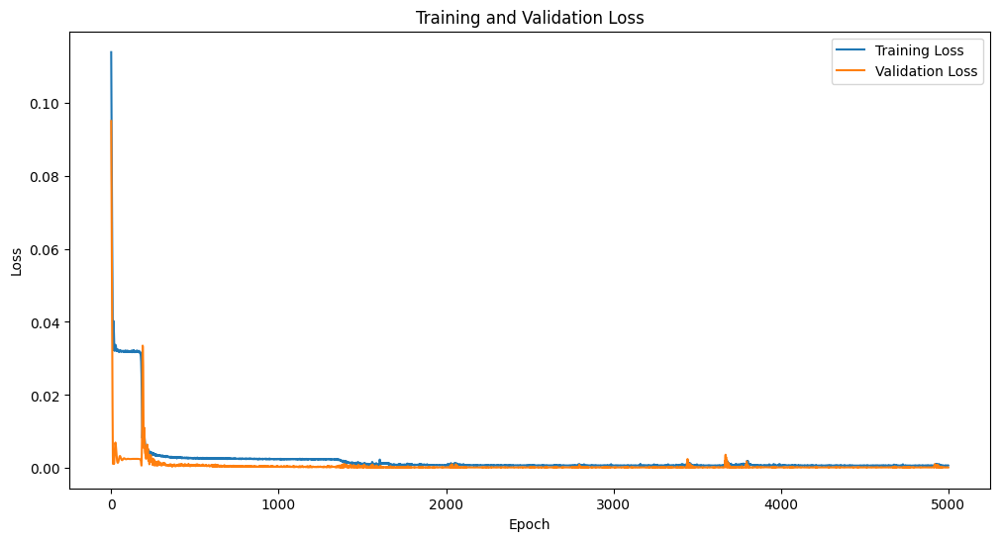

Epoch [1/5000], Train Loss: 0.1189, Val Loss: 0.1001
Epoch [2/5000], Train Loss: 0.1085, Val Loss: 0.0890
Epoch [3/5000], Train Loss: 0.0989, Val Loss: 0.0784
Epoch [4/5000], Train Loss: 0.0898, Val Loss: 0.0681
Epoch [5/5000], Train Loss: 0.0808, Val Loss: 0.0579
Epoch [6/5000], Train Loss: 0.0722, Val Loss: 0.0477
Epoch [7/5000], Train Loss: 0.0637, Val Loss: 0.0375
Epoch [8/5000], Train Loss: 0.0555, Val Loss: 0.0274
Epoch [9/5000], Train Loss: 0.0474, Val Loss: 0.0176
Epoch [10/5000], Train Loss: 0.0402, Val Loss: 0.0089
Epoch [11/5000], Train Loss: 0.0347, Val Loss: 0.0028
Epoch [12/5000], Train Loss: 0.0320, Val Loss: 0.0013
Epoch [13/5000], Train Loss: 0.0342, Val Loss: 0.0035
Epoch [14/5000], Train Loss: 0.0392, Val Loss: 0.0045
Epoch [15/5000], Train Loss: 0.0406, Val Loss: 0.0036
Epoch [16/5000], Train Loss: 0.0391, Val Loss: 0.0021
Epoch [17/5000], Train Loss: 0.0369, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0338, Val Loss: 0.0013
Epoch [19/5000], Train Loss: 0.0326, 

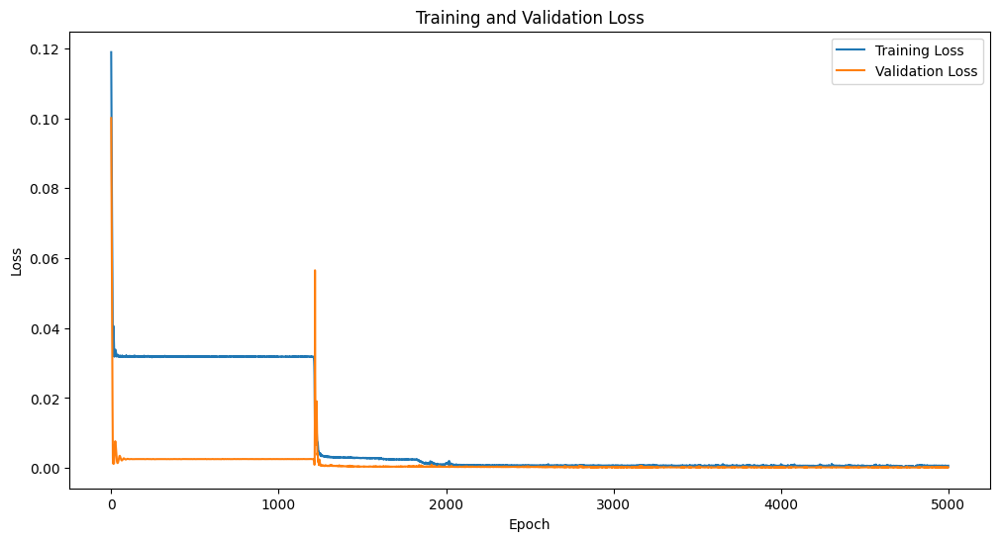

Epoch [1/5000], Train Loss: 0.0731, Val Loss: 0.0501
Epoch [2/5000], Train Loss: 0.0656, Val Loss: 0.0417
Epoch [3/5000], Train Loss: 0.0587, Val Loss: 0.0337
Epoch [4/5000], Train Loss: 0.0523, Val Loss: 0.0261
Epoch [5/5000], Train Loss: 0.0464, Val Loss: 0.0190
Epoch [6/5000], Train Loss: 0.0411, Val Loss: 0.0125
Epoch [7/5000], Train Loss: 0.0366, Val Loss: 0.0069
Epoch [8/5000], Train Loss: 0.0332, Val Loss: 0.0028
Epoch [9/5000], Train Loss: 0.0319, Val Loss: 0.0012
Epoch [10/5000], Train Loss: 0.0329, Val Loss: 0.0017
Epoch [11/5000], Train Loss: 0.0354, Val Loss: 0.0022
Epoch [12/5000], Train Loss: 0.0366, Val Loss: 0.0019
Epoch [13/5000], Train Loss: 0.0361, Val Loss: 0.0014
Epoch [14/5000], Train Loss: 0.0348, Val Loss: 0.0011
Epoch [15/5000], Train Loss: 0.0333, Val Loss: 0.0014
Epoch [16/5000], Train Loss: 0.0323, Val Loss: 0.0020
Epoch [17/5000], Train Loss: 0.0318, Val Loss: 0.0029
Epoch [18/5000], Train Loss: 0.0318, Val Loss: 0.0038
Epoch [19/5000], Train Loss: 0.0321, 

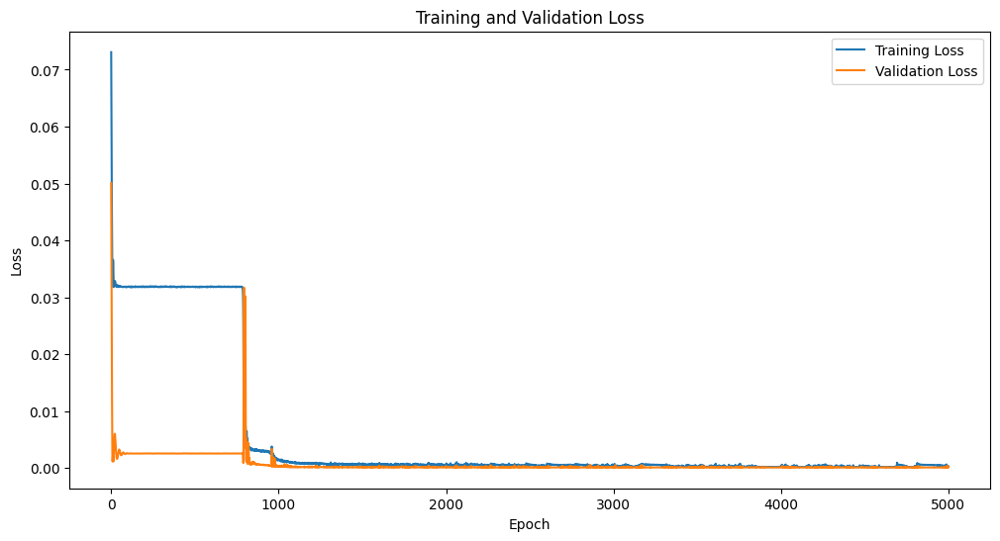

Epoch [1/5000], Train Loss: 0.0846, Val Loss: 0.0626
Epoch [2/5000], Train Loss: 0.0762, Val Loss: 0.0538
Epoch [3/5000], Train Loss: 0.0687, Val Loss: 0.0457
Epoch [4/5000], Train Loss: 0.0620, Val Loss: 0.0382
Epoch [5/5000], Train Loss: 0.0560, Val Loss: 0.0313
Epoch [6/5000], Train Loss: 0.0505, Val Loss: 0.0248
Epoch [7/5000], Train Loss: 0.0455, Val Loss: 0.0187
Epoch [8/5000], Train Loss: 0.0410, Val Loss: 0.0132
Epoch [9/5000], Train Loss: 0.0372, Val Loss: 0.0083
Epoch [10/5000], Train Loss: 0.0343, Val Loss: 0.0044
Epoch [11/5000], Train Loss: 0.0324, Val Loss: 0.0019
Epoch [12/5000], Train Loss: 0.0319, Val Loss: 0.0011
Epoch [13/5000], Train Loss: 0.0335, Val Loss: 0.0016
Epoch [14/5000], Train Loss: 0.0352, Val Loss: 0.0018
Epoch [15/5000], Train Loss: 0.0360, Val Loss: 0.0017
Epoch [16/5000], Train Loss: 0.0357, Val Loss: 0.0013
Epoch [17/5000], Train Loss: 0.0346, Val Loss: 0.0012
Epoch [18/5000], Train Loss: 0.0335, Val Loss: 0.0012
Epoch [19/5000], Train Loss: 0.0325, 

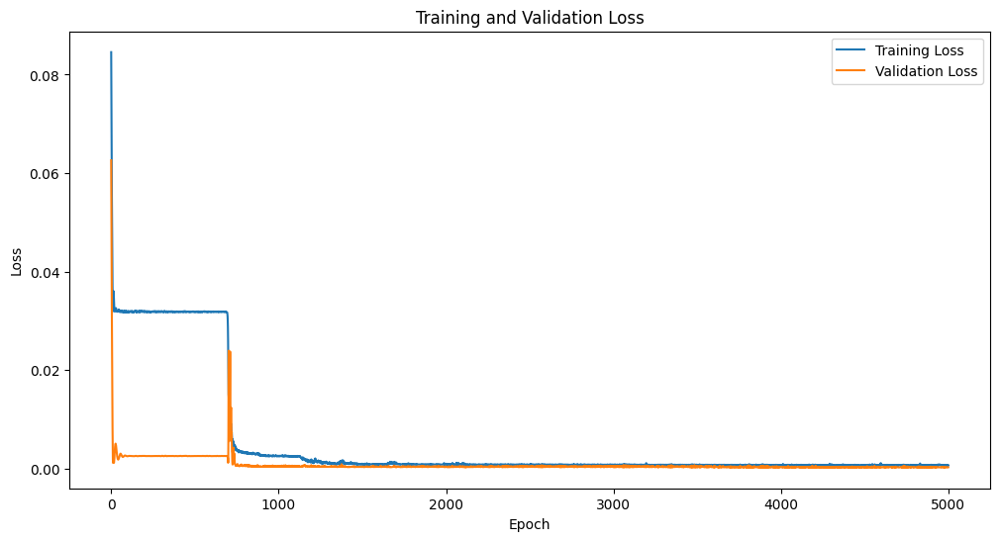

best_hidden_size:64, best_num_layers:3, best_dropout:0.1,


In [494]:
# Hyperparameters
input_size = 5  # Number of features
hidden_sizes = [16,32,64]  # Hidden units
output_size = 1  # Predicting 'Close'
num_layerss = [3,6,9,12]  # Number of LSTM layers
dropouts = [0.3,0.1,0.5]  # Dropout rate
learning_rate = 0.001
num_epochs = 5000
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None

for hidden_size in hidden_sizes:
    for num_layers in num_layerss:
        for dropout in dropouts:
            # Initialize the model, loss function, and optimizer
            model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
            criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
            optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
            
            # Train the model
            
            model, train_losses, val_losses = train_model(
                model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
            )

            if best_trainloss == None:
                best_trainloss = train_losses[-1]

            if best_trainloss > train_losses[-1]:
                best_trainloss = train_losses[-1]
                best_hidden_size = hidden_size
                best_num_layers = num_layers
                best_dropout = dropout
                best_model = model

In [495]:
print(f"best_hidden_size:{best_hidden_size}, best_num_layers:{best_num_layers}, best_dropout:{best_dropout},")

best_hidden_size:64, best_num_layers:3, best_dropout:0.1,


Epoch [1/3000], Train Loss: 0.1195, Val Loss: 0.1002
Epoch [2/3000], Train Loss: 0.1085, Val Loss: 0.0881
Epoch [3/3000], Train Loss: 0.0981, Val Loss: 0.0763
Epoch [4/3000], Train Loss: 0.0882, Val Loss: 0.0648
Epoch [5/3000], Train Loss: 0.0786, Val Loss: 0.0534
Epoch [6/3000], Train Loss: 0.0692, Val Loss: 0.0422
Epoch [7/3000], Train Loss: 0.0601, Val Loss: 0.0312
Epoch [8/3000], Train Loss: 0.0512, Val Loss: 0.0207
Epoch [9/3000], Train Loss: 0.0432, Val Loss: 0.0114
Epoch [10/3000], Train Loss: 0.0362, Val Loss: 0.0043
Epoch [11/3000], Train Loss: 0.0312, Val Loss: 0.0010
Epoch [12/3000], Train Loss: 0.0292, Val Loss: 0.0029
Epoch [13/3000], Train Loss: 0.0313, Val Loss: 0.0083
Epoch [14/3000], Train Loss: 0.0359, Val Loss: 0.0114
Epoch [15/3000], Train Loss: 0.0383, Val Loss: 0.0105
Epoch [16/3000], Train Loss: 0.0376, Val Loss: 0.0074
Epoch [17/3000], Train Loss: 0.0352, Val Loss: 0.0041
Epoch [18/3000], Train Loss: 0.0321, Val Loss: 0.0018
Epoch [19/3000], Train Loss: 0.0298, 

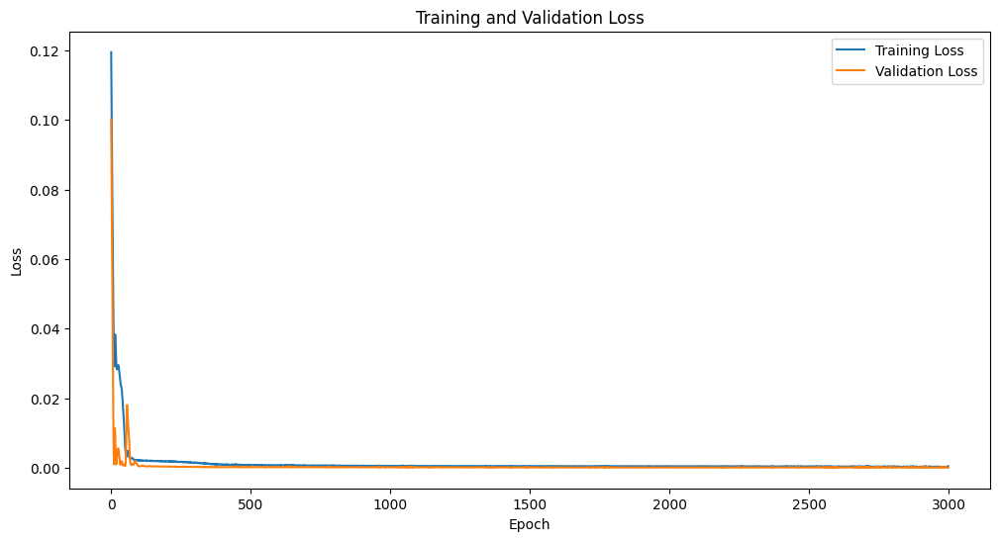

In [500]:
# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 5
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


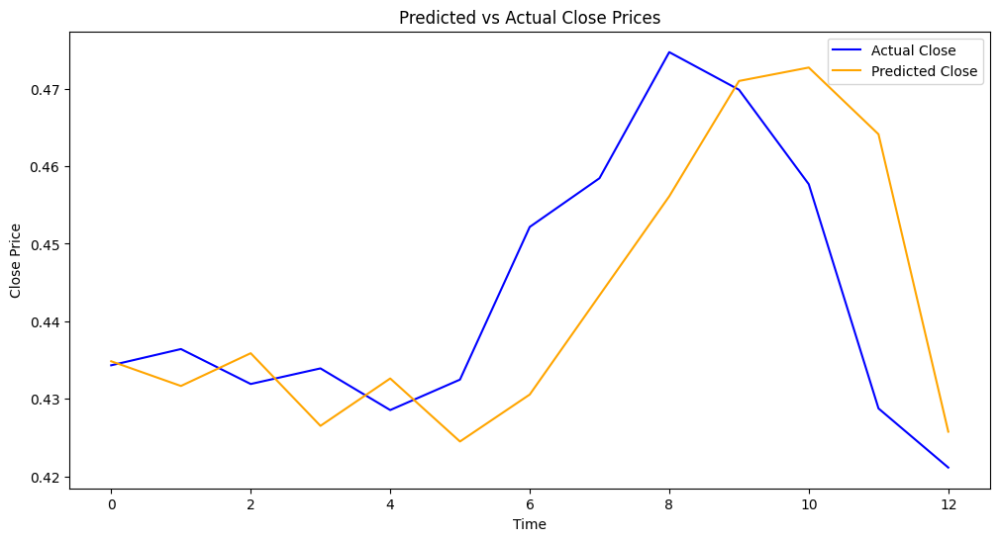

Mean Squared Error (MSE): 0.0002
Mean Absolute Error (MAE): 0.0108


In [501]:
mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

### Trying to predict all the features with LSTM

In [506]:
def create_sequences_all_features(data, sequence_length, prediction_length):
    X, y = [], []
    for i in range(len(data) - sequence_length - prediction_length + 1):
        # Input sequence: past N days for all features
        X.append(data.iloc[i:i + sequence_length].values)
        # Output sequence: next M days for all features
        y.append(data.iloc[i + sequence_length:i + sequence_length + prediction_length].values)
    return np.array(X), np.array(y)

# Create sequences for training, validation, and testing
X_train, y_train = create_sequences_all_features(train_set[scale_columns], N, M)
X_val, y_val = create_sequences_all_features(validation_set[scale_columns], N, M)
X_test, y_test = create_sequences_all_features(test_data[scale_columns], N, M)

# Display shapes
print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")


X_train shape: (999, 7, 5), y_train shape: (999, 1, 5)
X_val shape: (245, 7, 5), y_val shape: (245, 1, 5)
X_test shape: (13, 7, 5), y_test shape: (13, 1, 5)


In [595]:
def evaluate_model_all_features_with_plots(model, X_test, y_test, scaler, device, scale_columns):
    model.eval()
    with torch.no_grad():
        # Predict on test data
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
        y_pred = model(X_test_tensor).cpu().numpy()

    # Reshape predictions and actual values for inverse scaling
    y_pred_rescaled = scaler.inverse_transform(y_pred.reshape(-1, len(scale_columns)))
    y_actual_rescaled = scaler.inverse_transform(y_test.reshape(-1, len(scale_columns)))

    # Plot actual vs predicted for each feature
    for i, feature in enumerate(scale_columns):
        plt.figure(figsize=(10, 5))
        plt.plot(y_actual_rescaled[:, i], label=f'Actual {feature}', color='blue')
        plt.plot(y_pred_rescaled[:, i], label=f'Predicted {feature}', color='orange')
        plt.title(f'Predicted vs Actual {feature}')
        plt.xlabel('Time')
        plt.ylabel(f'{feature} Value')
        plt.legend()
        plt.show()

    # Calculate evaluation metrics
    mse = mean_squared_error(y_actual_rescaled, y_pred_rescaled)
    mae = mean_absolute_error(y_actual_rescaled, y_pred_rescaled)
    print(f"Mean Squared Error (MSE): {mse:.4f}")
    print(f"Mean Absolute Error (MAE): {mae:.4f}")

    return mse, mae

# Evaluate the updated model
mse, mae = evaluate_model_all_features_with_plots(model, X_test, y_test, scaler, device, scale_columns)

# Evaluate the updated model
mse, mae = evaluate_model_all_features(model, X_test, y_test, scaler, device, scale_columns)

In [516]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences_all_features(train_set[scale_columns], sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences_all_features(validation_set[scale_columns], sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences_all_features(test_data[scale_columns], sequence_length=N, prediction_length=M)

# Display shapes of the sequences
print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")

X_train shape: (999, 7, 5), y_train shape: (999, 1, 5)
X_val shape: (245, 7, 5), y_val shape: (245, 1, 5)
X_test shape: (13, 7, 5), y_test shape: (13, 1, 5)


/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([999, 1, 5])) that is different to the input size (torch.Size([999, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([245, 1, 5])) that is different to the input size (torch.Size([245, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch [1/3000], Train Loss: 0.0699, Val Loss: 0.2184
Epoch [2/3000], Train Loss: 0.0661, Val Loss: 0.2100
Epoch [3/3000], Train Loss: 0.0623, Val Loss: 0.2014
Epoch [4/3000], Train Loss: 0.0584, Val Loss: 0.1924
Epoch [5/3000], Train Loss: 0.0546, Val Loss: 0.1829
Epoch [6/3000], Train Loss: 0.0507, Val Loss: 0.1726
Epoch [7/3000], Train Loss: 0.0467, Val Loss: 0.1614
Epoch [8/3000], Train Loss: 0.0426, Val Loss: 0.1492
Epoch [9/3000], Train Loss: 0.0385, Val Loss: 0.1358
Epoch [10/3000], Train Loss: 0.0345, Val Loss: 0.1209
Epoch [11/3000], Train Loss: 0.0306, Val Loss: 0.1047
Epoch [12/3000], Train Loss: 0.0273, Val Loss: 0.0873
Epoch [13/3000], Train Loss: 0.0250, Val Loss: 0.0698
Epoch [14/3000], Train Loss: 0.0244, Val Loss: 0.0549
Epoch [15/3000], Train Loss: 0.0256, Val Loss: 0.0456
Epoch [16/3000], Train Loss: 0.0272, Val Loss: 0.0423
Epoch [17/3000], Train Loss: 0.0274, Val Loss: 0.0432
Epoch [18/3000], Train Loss: 0.0265, Val Loss: 0.0471
Epoch [19/3000], Train Loss: 0.0250, 

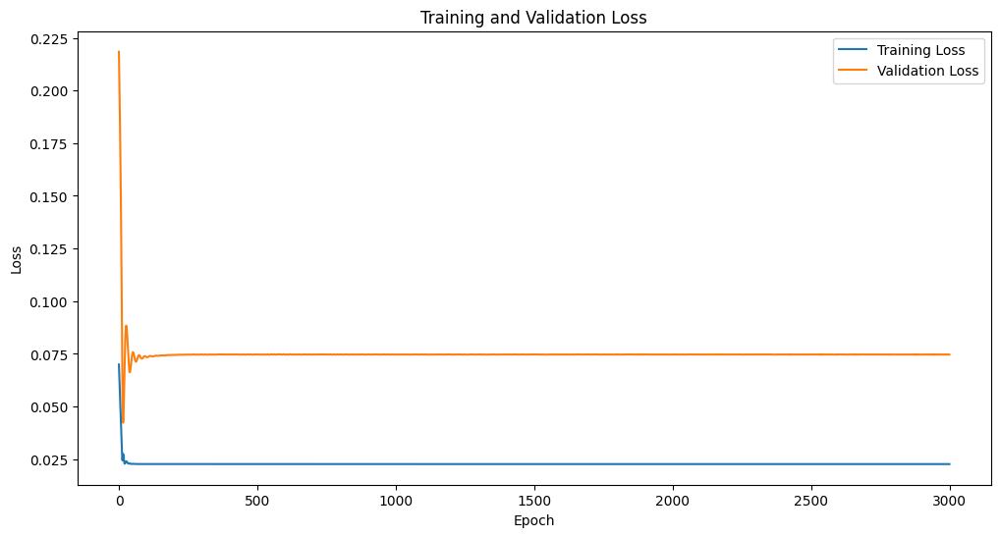

In [518]:
# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 5  # Predicting all
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 5
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


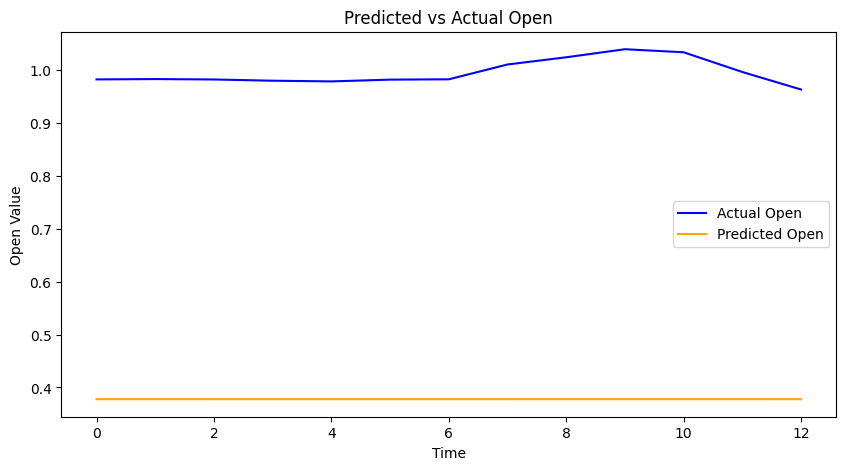

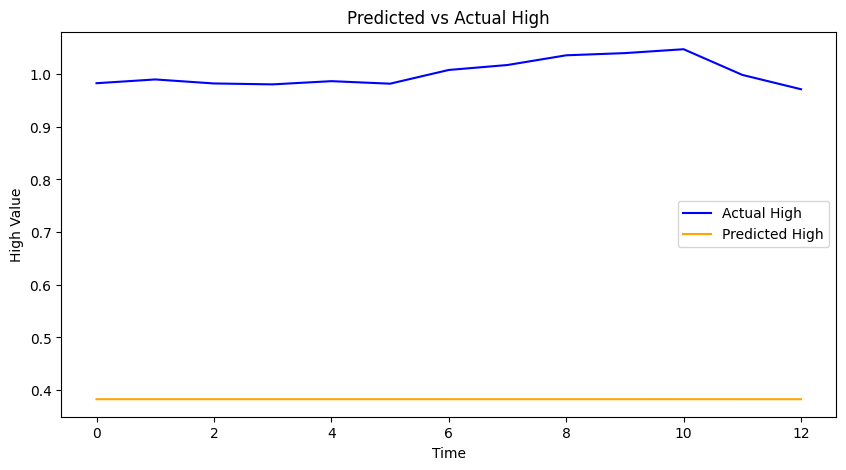

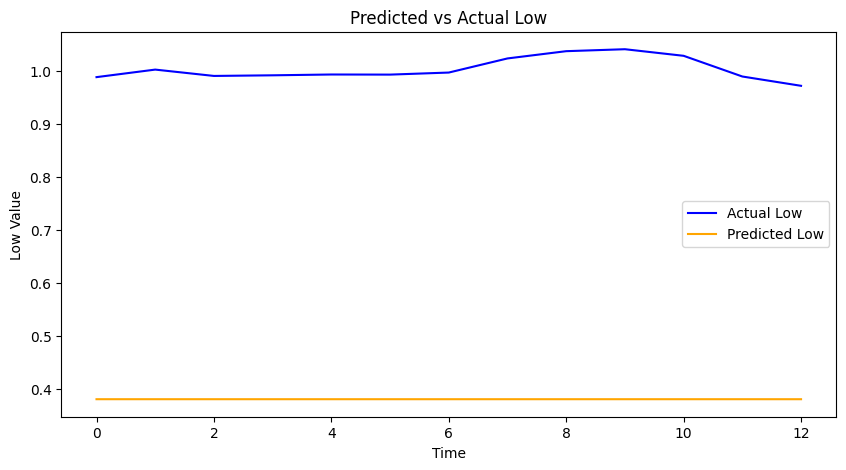

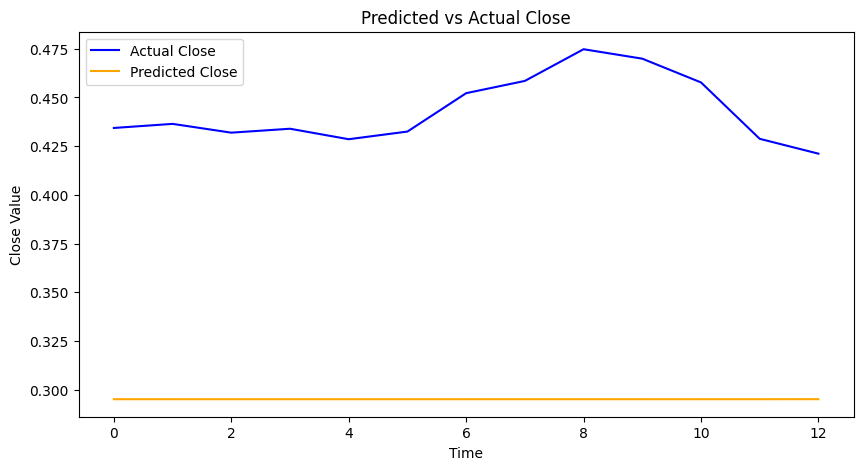

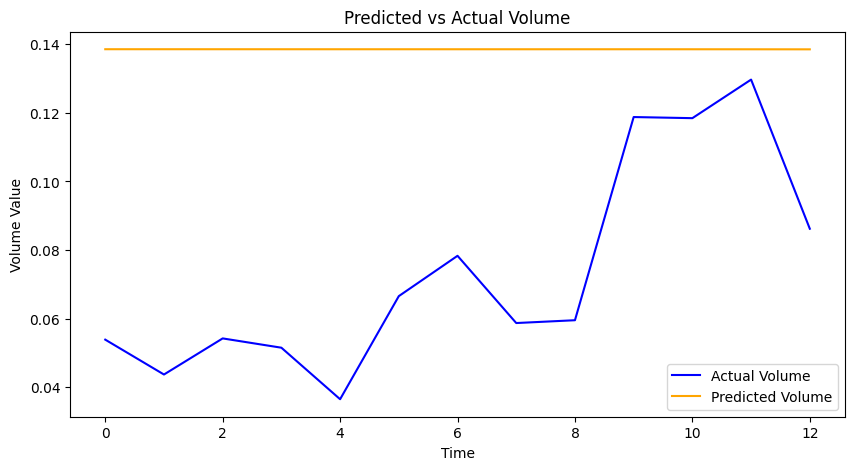

Mean Squared Error (MSE): 0.2364
Mean Absolute Error (MAE): 0.4146


In [520]:
# Evaluate the updated model
mse, mae = evaluate_model_all_features_with_plots(model, X_test, y_test, scaler, device, scale_columns)

/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([999, 1, 5])) that is different to the input size (torch.Size([999, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([245, 1, 5])) that is different to the input size (torch.Size([245, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch [1/2500], Train Loss: 0.1565, Val Loss: 0.3657
Epoch [2/2500], Train Loss: 0.1521, Val Loss: 0.3591
Epoch [3/2500], Train Loss: 0.1479, Val Loss: 0.3525
Epoch [4/2500], Train Loss: 0.1438, Val Loss: 0.3459
Epoch [5/2500], Train Loss: 0.1395, Val Loss: 0.3392
Epoch [6/2500], Train Loss: 0.1354, Val Loss: 0.3326
Epoch [7/2500], Train Loss: 0.1311, Val Loss: 0.3258
Epoch [8/2500], Train Loss: 0.1270, Val Loss: 0.3190
Epoch [9/2500], Train Loss: 0.1229, Val Loss: 0.3122
Epoch [10/2500], Train Loss: 0.1189, Val Loss: 0.3053
Epoch [11/2500], Train Loss: 0.1147, Val Loss: 0.2982
Epoch [12/2500], Train Loss: 0.1108, Val Loss: 0.2911
Epoch [13/2500], Train Loss: 0.1065, Val Loss: 0.2838
Epoch [14/2500], Train Loss: 0.1024, Val Loss: 0.2764
Epoch [15/2500], Train Loss: 0.0984, Val Loss: 0.2690
Epoch [16/2500], Train Loss: 0.0942, Val Loss: 0.2613
Epoch [17/2500], Train Loss: 0.0903, Val Loss: 0.2536
Epoch [18/2500], Train Loss: 0.0860, Val Loss: 0.2457
Epoch [19/2500], Train Loss: 0.0820, 

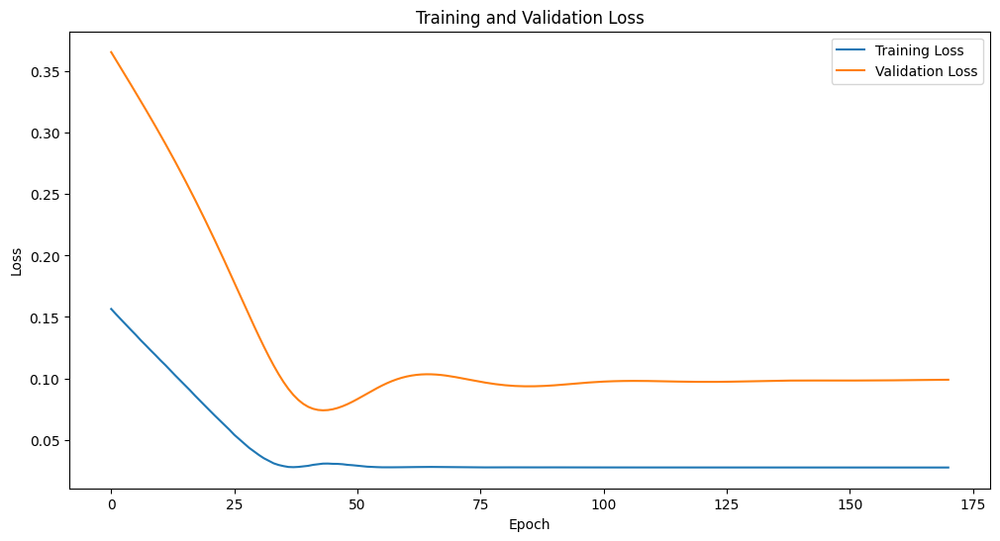

Epoch [1/2500], Train Loss: 0.0347, Val Loss: 0.1387
Epoch [2/2500], Train Loss: 0.0335, Val Loss: 0.1344
Epoch [3/2500], Train Loss: 0.0323, Val Loss: 0.1303
Epoch [4/2500], Train Loss: 0.0313, Val Loss: 0.1263
Epoch [5/2500], Train Loss: 0.0304, Val Loss: 0.1226
Epoch [6/2500], Train Loss: 0.0296, Val Loss: 0.1189
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.1154
Epoch [8/2500], Train Loss: 0.0284, Val Loss: 0.1121
Epoch [9/2500], Train Loss: 0.0279, Val Loss: 0.1089
Epoch [10/2500], Train Loss: 0.0276, Val Loss: 0.1060
Epoch [11/2500], Train Loss: 0.0274, Val Loss: 0.1032
Epoch [12/2500], Train Loss: 0.0272, Val Loss: 0.1006
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0983
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.0963
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.0946
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.0932
Epoch [17/2500], Train Loss: 0.0273, Val Loss: 0.0922
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.0915
Epoch [19/2500], Train Loss: 0.0275, 

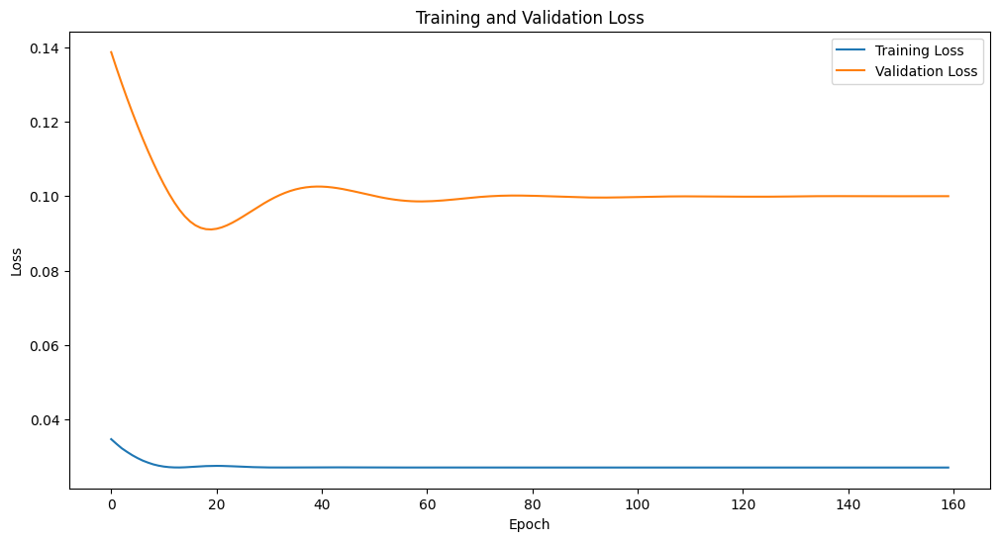

Epoch [1/2500], Train Loss: 0.0343, Val Loss: 0.1390
Epoch [2/2500], Train Loss: 0.0331, Val Loss: 0.1351
Epoch [3/2500], Train Loss: 0.0321, Val Loss: 0.1312
Epoch [4/2500], Train Loss: 0.0312, Val Loss: 0.1274
Epoch [5/2500], Train Loss: 0.0303, Val Loss: 0.1237
Epoch [6/2500], Train Loss: 0.0296, Val Loss: 0.1201
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.1167
Epoch [8/2500], Train Loss: 0.0284, Val Loss: 0.1133
Epoch [9/2500], Train Loss: 0.0280, Val Loss: 0.1101
Epoch [10/2500], Train Loss: 0.0276, Val Loss: 0.1071
Epoch [11/2500], Train Loss: 0.0274, Val Loss: 0.1042
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.1016
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.0992
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0972
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.0954
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0941
Epoch [17/2500], Train Loss: 0.0274, Val Loss: 0.0931
Epoch [18/2500], Train Loss: 0.0275, Val Loss: 0.0925
Epoch [19/2500], Train Loss: 0.0276, 

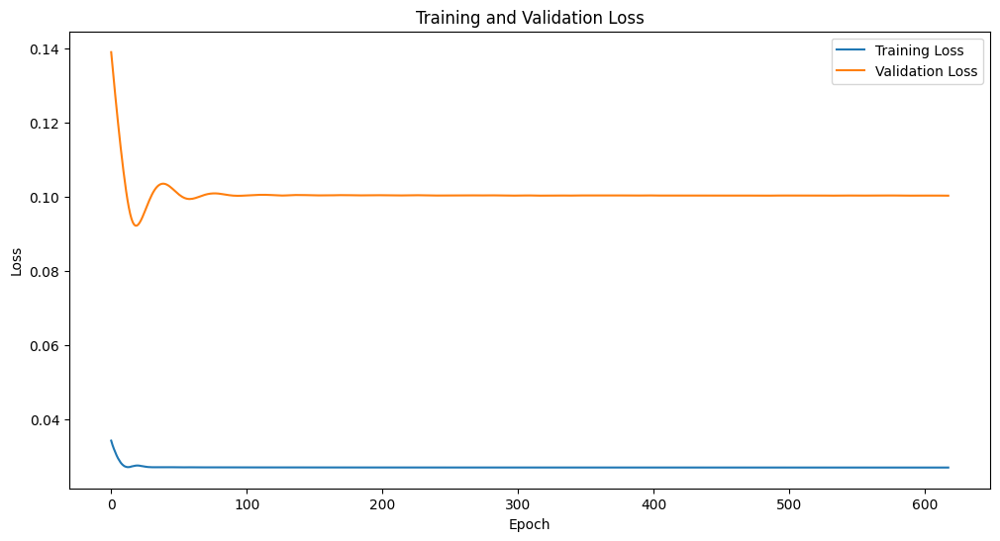

Epoch [1/2500], Train Loss: 0.0283, Val Loss: 0.1131
Epoch [2/2500], Train Loss: 0.0279, Val Loss: 0.1102
Epoch [3/2500], Train Loss: 0.0276, Val Loss: 0.1073
Epoch [4/2500], Train Loss: 0.0274, Val Loss: 0.1046
Epoch [5/2500], Train Loss: 0.0272, Val Loss: 0.1020
Epoch [6/2500], Train Loss: 0.0271, Val Loss: 0.0997
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.0978
Epoch [8/2500], Train Loss: 0.0272, Val Loss: 0.0964
Epoch [9/2500], Train Loss: 0.0272, Val Loss: 0.0955
Epoch [10/2500], Train Loss: 0.0273, Val Loss: 0.0951
Epoch [11/2500], Train Loss: 0.0273, Val Loss: 0.0950
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0954
Epoch [13/2500], Train Loss: 0.0273, Val Loss: 0.0959
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0967
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.0975
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.0985
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0994
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1003
Epoch [19/2500], Train Loss: 0.0271, 

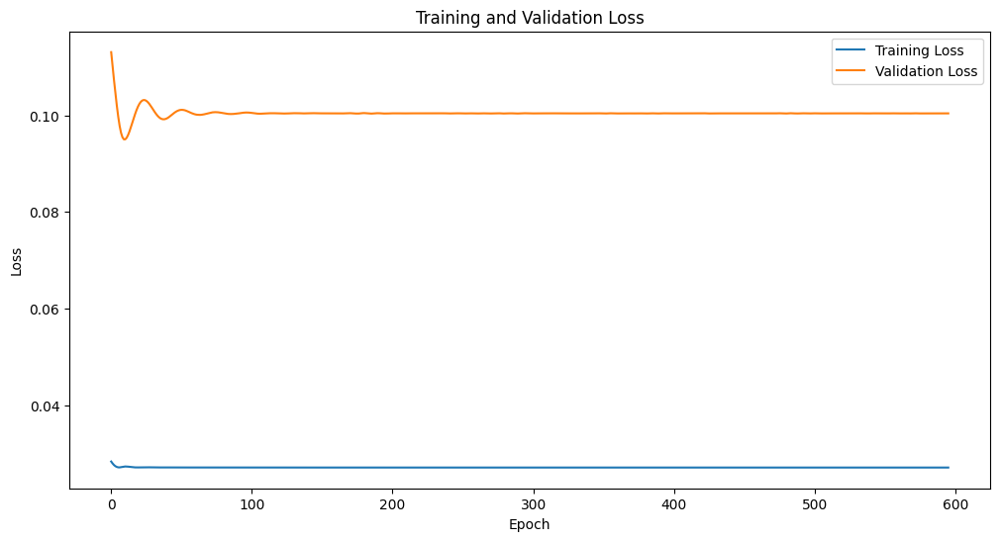

Epoch [1/2500], Train Loss: 0.0349, Val Loss: 0.1407
Epoch [2/2500], Train Loss: 0.0337, Val Loss: 0.1368
Epoch [3/2500], Train Loss: 0.0326, Val Loss: 0.1330
Epoch [4/2500], Train Loss: 0.0317, Val Loss: 0.1294
Epoch [5/2500], Train Loss: 0.0308, Val Loss: 0.1258
Epoch [6/2500], Train Loss: 0.0300, Val Loss: 0.1225
Epoch [7/2500], Train Loss: 0.0294, Val Loss: 0.1192
Epoch [8/2500], Train Loss: 0.0288, Val Loss: 0.1161
Epoch [9/2500], Train Loss: 0.0283, Val Loss: 0.1132
Epoch [10/2500], Train Loss: 0.0279, Val Loss: 0.1104
Epoch [11/2500], Train Loss: 0.0276, Val Loss: 0.1078
Epoch [12/2500], Train Loss: 0.0274, Val Loss: 0.1053
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.1030
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.1009
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.0991
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0974
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0960
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0949
Epoch [19/2500], Train Loss: 0.0273, 

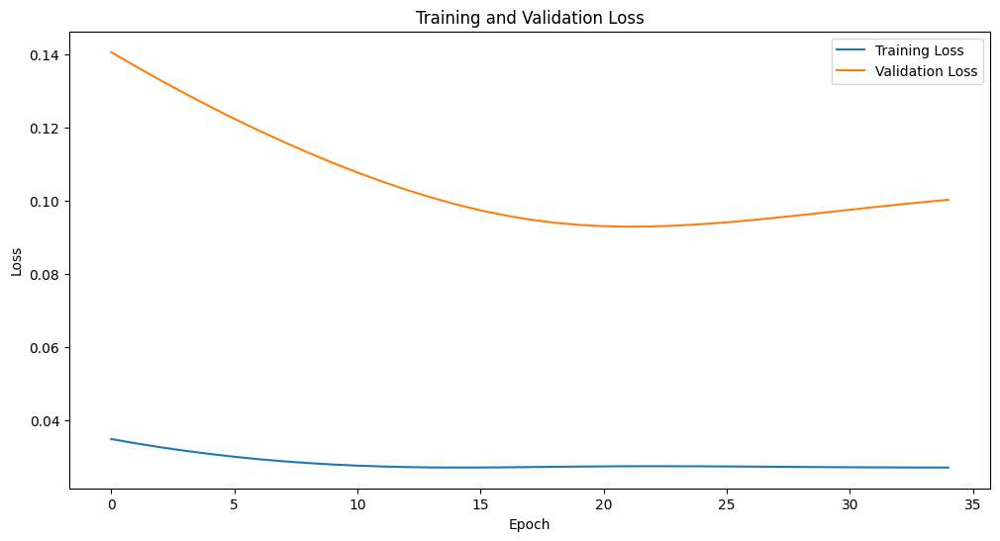

Epoch [1/2500], Train Loss: 0.0386, Val Loss: 0.1520
Epoch [2/2500], Train Loss: 0.0373, Val Loss: 0.1479
Epoch [3/2500], Train Loss: 0.0359, Val Loss: 0.1440
Epoch [4/2500], Train Loss: 0.0347, Val Loss: 0.1401
Epoch [5/2500], Train Loss: 0.0337, Val Loss: 0.1364
Epoch [6/2500], Train Loss: 0.0326, Val Loss: 0.1327
Epoch [7/2500], Train Loss: 0.0317, Val Loss: 0.1291
Epoch [8/2500], Train Loss: 0.0309, Val Loss: 0.1257
Epoch [9/2500], Train Loss: 0.0301, Val Loss: 0.1223
Epoch [10/2500], Train Loss: 0.0295, Val Loss: 0.1190
Epoch [11/2500], Train Loss: 0.0289, Val Loss: 0.1158
Epoch [12/2500], Train Loss: 0.0285, Val Loss: 0.1128
Epoch [13/2500], Train Loss: 0.0280, Val Loss: 0.1098
Epoch [14/2500], Train Loss: 0.0277, Val Loss: 0.1070
Epoch [15/2500], Train Loss: 0.0275, Val Loss: 0.1043
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.1018
Epoch [17/2500], Train Loss: 0.0273, Val Loss: 0.0995
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0975
Epoch [19/2500], Train Loss: 0.0273, 

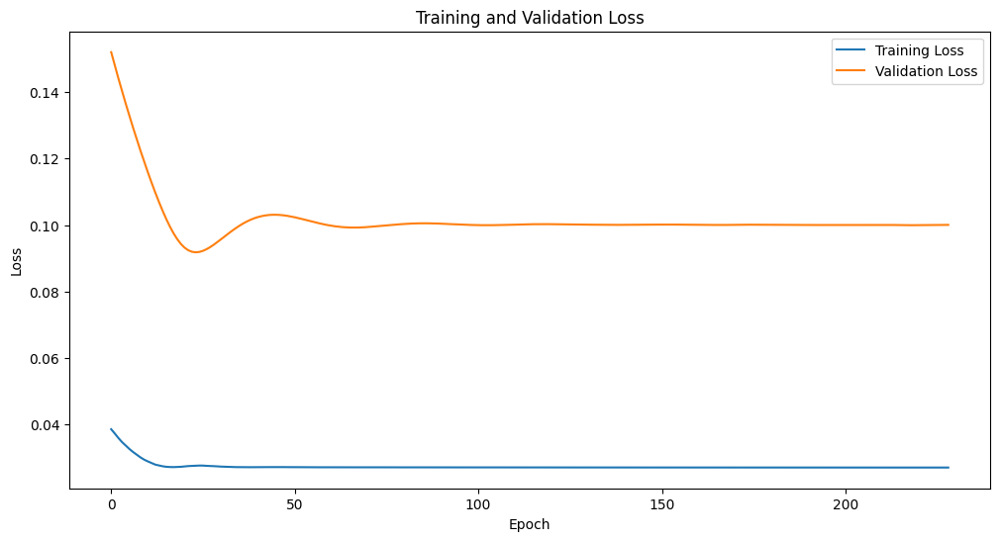

Epoch [1/2500], Train Loss: 0.1345, Val Loss: 0.3336
Epoch [2/2500], Train Loss: 0.1290, Val Loss: 0.3251
Epoch [3/2500], Train Loss: 0.1238, Val Loss: 0.3166
Epoch [4/2500], Train Loss: 0.1186, Val Loss: 0.3083
Epoch [5/2500], Train Loss: 0.1136, Val Loss: 0.3000
Epoch [6/2500], Train Loss: 0.1089, Val Loss: 0.2918
Epoch [7/2500], Train Loss: 0.1042, Val Loss: 0.2837
Epoch [8/2500], Train Loss: 0.0995, Val Loss: 0.2756
Epoch [9/2500], Train Loss: 0.0950, Val Loss: 0.2676
Epoch [10/2500], Train Loss: 0.0904, Val Loss: 0.2596
Epoch [11/2500], Train Loss: 0.0862, Val Loss: 0.2516
Epoch [12/2500], Train Loss: 0.0820, Val Loss: 0.2437
Epoch [13/2500], Train Loss: 0.0780, Val Loss: 0.2358
Epoch [14/2500], Train Loss: 0.0736, Val Loss: 0.2279
Epoch [15/2500], Train Loss: 0.0699, Val Loss: 0.2200
Epoch [16/2500], Train Loss: 0.0660, Val Loss: 0.2121
Epoch [17/2500], Train Loss: 0.0624, Val Loss: 0.2042
Epoch [18/2500], Train Loss: 0.0585, Val Loss: 0.1963
Epoch [19/2500], Train Loss: 0.0549, 

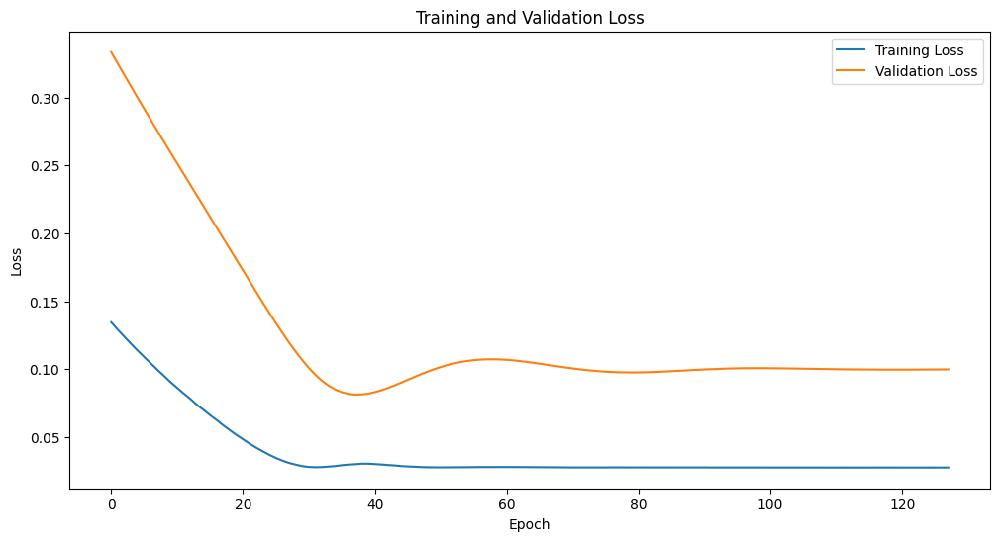

Epoch [1/2500], Train Loss: 0.0408, Val Loss: 0.1571
Epoch [2/2500], Train Loss: 0.0389, Val Loss: 0.1518
Epoch [3/2500], Train Loss: 0.0371, Val Loss: 0.1467
Epoch [4/2500], Train Loss: 0.0355, Val Loss: 0.1417
Epoch [5/2500], Train Loss: 0.0340, Val Loss: 0.1368
Epoch [6/2500], Train Loss: 0.0327, Val Loss: 0.1321
Epoch [7/2500], Train Loss: 0.0314, Val Loss: 0.1276
Epoch [8/2500], Train Loss: 0.0304, Val Loss: 0.1232
Epoch [9/2500], Train Loss: 0.0295, Val Loss: 0.1189
Epoch [10/2500], Train Loss: 0.0288, Val Loss: 0.1149
Epoch [11/2500], Train Loss: 0.0282, Val Loss: 0.1111
Epoch [12/2500], Train Loss: 0.0277, Val Loss: 0.1074
Epoch [13/2500], Train Loss: 0.0274, Val Loss: 0.1041
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.1010
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.0982
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0958
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0938
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.0922
Epoch [19/2500], Train Loss: 0.0276, 

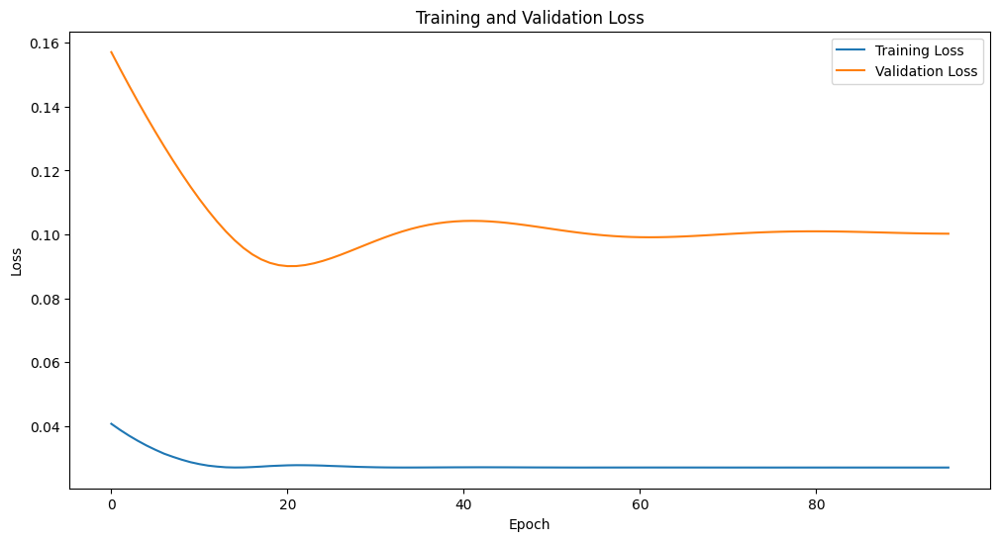

Epoch [1/2500], Train Loss: 0.0930, Val Loss: 0.2654
Epoch [2/2500], Train Loss: 0.0891, Val Loss: 0.2584
Epoch [3/2500], Train Loss: 0.0855, Val Loss: 0.2514
Epoch [4/2500], Train Loss: 0.0819, Val Loss: 0.2445
Epoch [5/2500], Train Loss: 0.0781, Val Loss: 0.2376
Epoch [6/2500], Train Loss: 0.0748, Val Loss: 0.2306
Epoch [7/2500], Train Loss: 0.0713, Val Loss: 0.2237
Epoch [8/2500], Train Loss: 0.0677, Val Loss: 0.2168
Epoch [9/2500], Train Loss: 0.0645, Val Loss: 0.2098
Epoch [10/2500], Train Loss: 0.0614, Val Loss: 0.2028
Epoch [11/2500], Train Loss: 0.0581, Val Loss: 0.1958
Epoch [12/2500], Train Loss: 0.0551, Val Loss: 0.1888
Epoch [13/2500], Train Loss: 0.0518, Val Loss: 0.1817
Epoch [14/2500], Train Loss: 0.0488, Val Loss: 0.1747
Epoch [15/2500], Train Loss: 0.0464, Val Loss: 0.1676
Epoch [16/2500], Train Loss: 0.0434, Val Loss: 0.1605
Epoch [17/2500], Train Loss: 0.0410, Val Loss: 0.1534
Epoch [18/2500], Train Loss: 0.0385, Val Loss: 0.1464
Epoch [19/2500], Train Loss: 0.0363, 

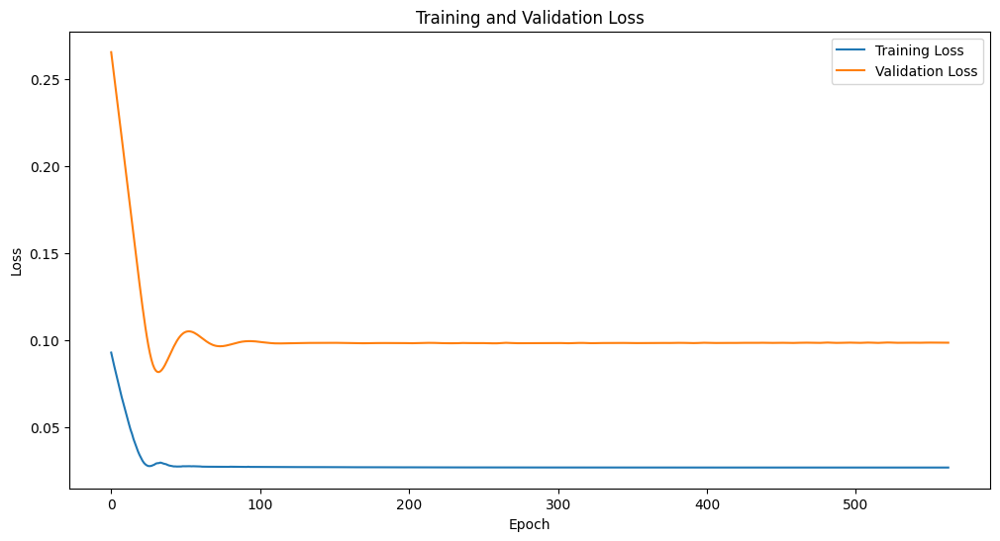

Epoch [1/2500], Train Loss: 0.0475, Val Loss: 0.1761
Epoch [2/2500], Train Loss: 0.0460, Val Loss: 0.1723
Epoch [3/2500], Train Loss: 0.0445, Val Loss: 0.1685
Epoch [4/2500], Train Loss: 0.0430, Val Loss: 0.1649
Epoch [5/2500], Train Loss: 0.0417, Val Loss: 0.1612
Epoch [6/2500], Train Loss: 0.0403, Val Loss: 0.1577
Epoch [7/2500], Train Loss: 0.0391, Val Loss: 0.1542
Epoch [8/2500], Train Loss: 0.0379, Val Loss: 0.1508
Epoch [9/2500], Train Loss: 0.0368, Val Loss: 0.1474
Epoch [10/2500], Train Loss: 0.0357, Val Loss: 0.1441
Epoch [11/2500], Train Loss: 0.0347, Val Loss: 0.1408
Epoch [12/2500], Train Loss: 0.0337, Val Loss: 0.1375
Epoch [13/2500], Train Loss: 0.0328, Val Loss: 0.1343
Epoch [14/2500], Train Loss: 0.0320, Val Loss: 0.1311
Epoch [15/2500], Train Loss: 0.0312, Val Loss: 0.1279
Epoch [16/2500], Train Loss: 0.0305, Val Loss: 0.1248
Epoch [17/2500], Train Loss: 0.0298, Val Loss: 0.1216
Epoch [18/2500], Train Loss: 0.0293, Val Loss: 0.1185
Epoch [19/2500], Train Loss: 0.0288, 

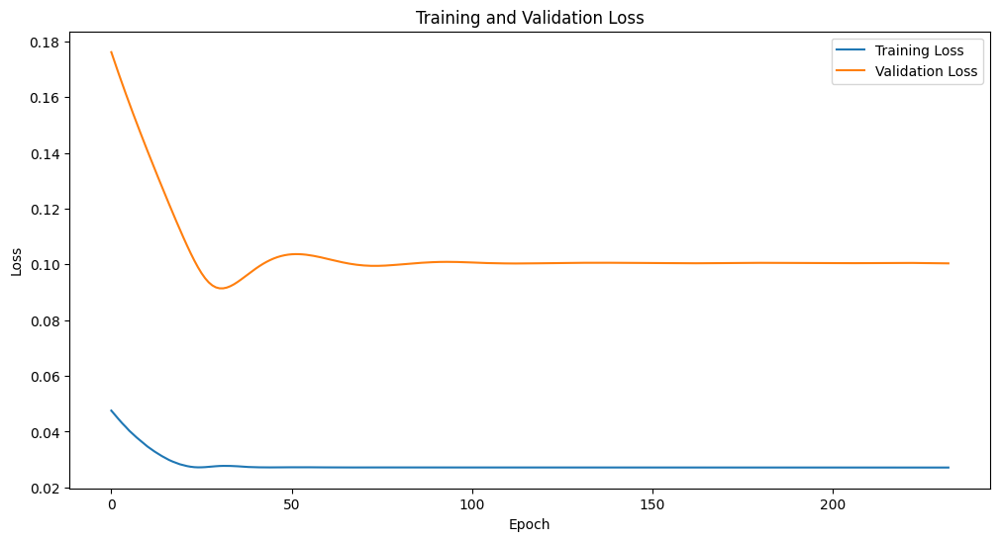

Epoch [1/2500], Train Loss: 0.0292, Val Loss: 0.1178
Epoch [2/2500], Train Loss: 0.0286, Val Loss: 0.1143
Epoch [3/2500], Train Loss: 0.0281, Val Loss: 0.1110
Epoch [4/2500], Train Loss: 0.0277, Val Loss: 0.1078
Epoch [5/2500], Train Loss: 0.0274, Val Loss: 0.1048
Epoch [6/2500], Train Loss: 0.0272, Val Loss: 0.1021
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.0997
Epoch [8/2500], Train Loss: 0.0271, Val Loss: 0.0976
Epoch [9/2500], Train Loss: 0.0271, Val Loss: 0.0960
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0949
Epoch [11/2500], Train Loss: 0.0273, Val Loss: 0.0943
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0941
Epoch [13/2500], Train Loss: 0.0273, Val Loss: 0.0942
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0946
Epoch [15/2500], Train Loss: 0.0273, Val Loss: 0.0953
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0961
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0970
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0979
Epoch [19/2500], Train Loss: 0.0271, 

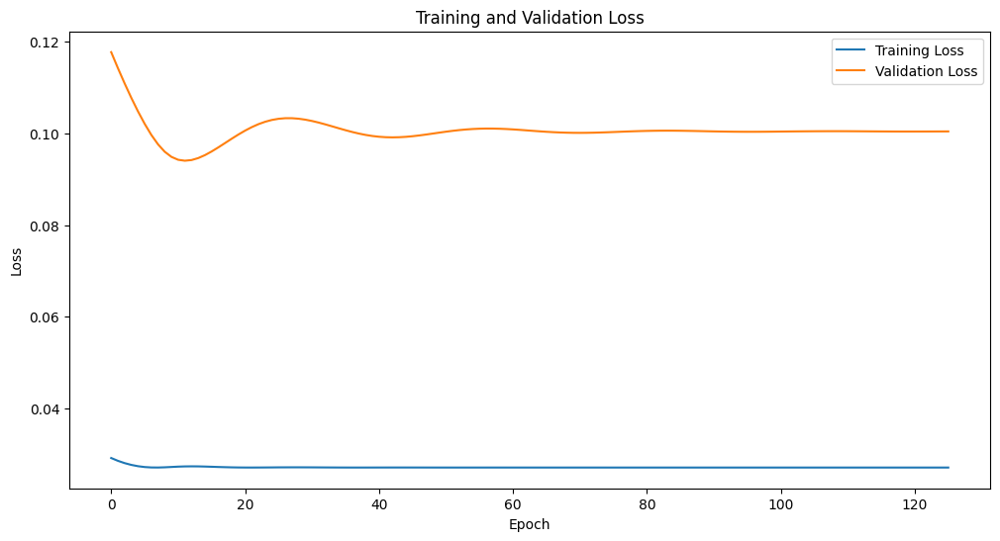

Epoch [1/2500], Train Loss: 0.1489, Val Loss: 0.3583
Epoch [2/2500], Train Loss: 0.1449, Val Loss: 0.3522
Epoch [3/2500], Train Loss: 0.1411, Val Loss: 0.3461
Epoch [4/2500], Train Loss: 0.1372, Val Loss: 0.3399
Epoch [5/2500], Train Loss: 0.1330, Val Loss: 0.3338
Epoch [6/2500], Train Loss: 0.1295, Val Loss: 0.3275
Epoch [7/2500], Train Loss: 0.1253, Val Loss: 0.3212
Epoch [8/2500], Train Loss: 0.1215, Val Loss: 0.3148
Epoch [9/2500], Train Loss: 0.1179, Val Loss: 0.3084
Epoch [10/2500], Train Loss: 0.1143, Val Loss: 0.3018
Epoch [11/2500], Train Loss: 0.1102, Val Loss: 0.2951
Epoch [12/2500], Train Loss: 0.1064, Val Loss: 0.2884
Epoch [13/2500], Train Loss: 0.1026, Val Loss: 0.2815
Epoch [14/2500], Train Loss: 0.0989, Val Loss: 0.2744
Epoch [15/2500], Train Loss: 0.0945, Val Loss: 0.2673
Epoch [16/2500], Train Loss: 0.0911, Val Loss: 0.2600
Epoch [17/2500], Train Loss: 0.0870, Val Loss: 0.2525
Epoch [18/2500], Train Loss: 0.0830, Val Loss: 0.2449
Epoch [19/2500], Train Loss: 0.0789, 

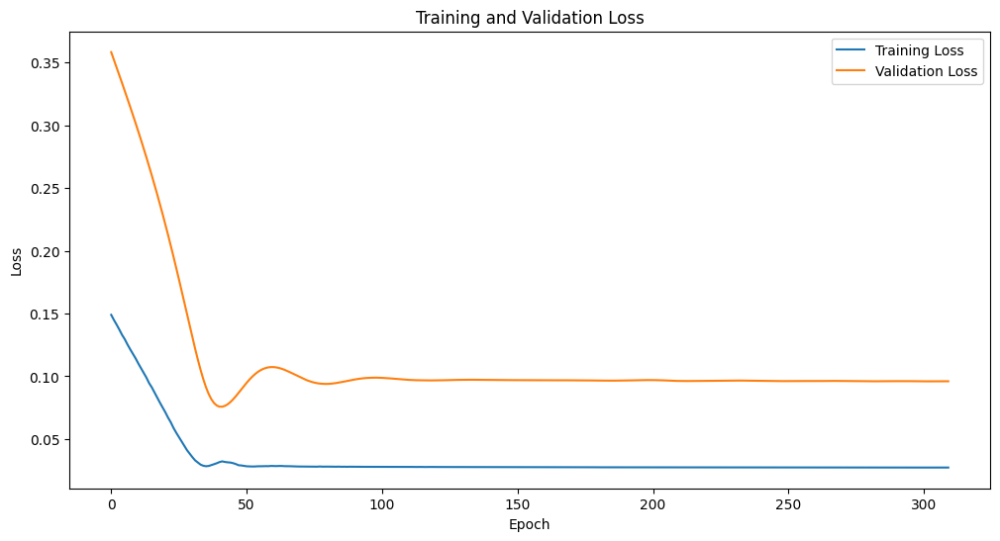

Epoch [1/2500], Train Loss: 0.0389, Val Loss: 0.1482
Epoch [2/2500], Train Loss: 0.0362, Val Loss: 0.1401
Epoch [3/2500], Train Loss: 0.0339, Val Loss: 0.1324
Epoch [4/2500], Train Loss: 0.0319, Val Loss: 0.1250
Epoch [5/2500], Train Loss: 0.0302, Val Loss: 0.1179
Epoch [6/2500], Train Loss: 0.0289, Val Loss: 0.1112
Epoch [7/2500], Train Loss: 0.0279, Val Loss: 0.1049
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.0991
Epoch [9/2500], Train Loss: 0.0271, Val Loss: 0.0941
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0901
Epoch [11/2500], Train Loss: 0.0275, Val Loss: 0.0873
Epoch [12/2500], Train Loss: 0.0279, Val Loss: 0.0857
Epoch [13/2500], Train Loss: 0.0282, Val Loss: 0.0852
Epoch [14/2500], Train Loss: 0.0283, Val Loss: 0.0855
Epoch [15/2500], Train Loss: 0.0282, Val Loss: 0.0865
Epoch [16/2500], Train Loss: 0.0281, Val Loss: 0.0880
Epoch [17/2500], Train Loss: 0.0279, Val Loss: 0.0898
Epoch [18/2500], Train Loss: 0.0276, Val Loss: 0.0918
Epoch [19/2500], Train Loss: 0.0274, 

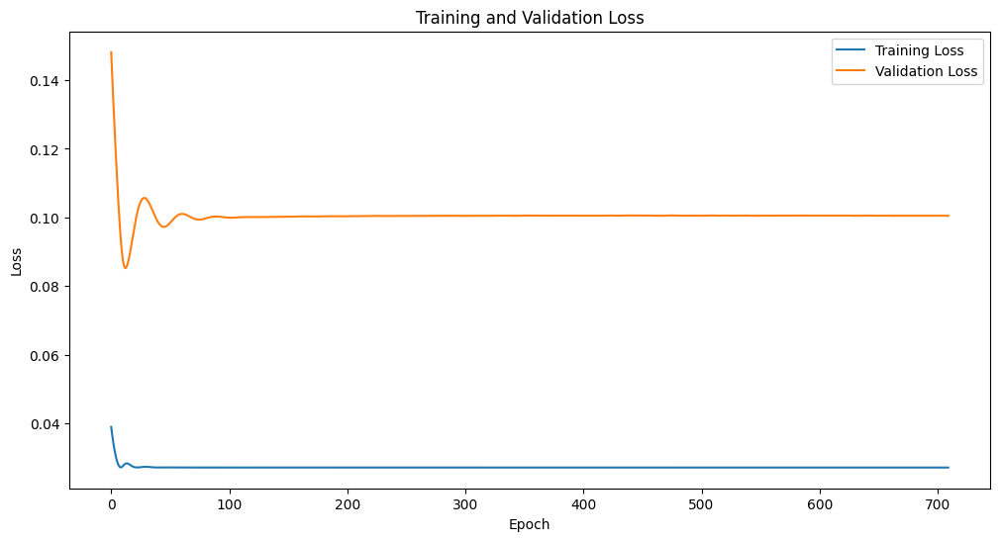

Epoch [1/2500], Train Loss: 0.0740, Val Loss: 0.2278
Epoch [2/2500], Train Loss: 0.0693, Val Loss: 0.2183
Epoch [3/2500], Train Loss: 0.0649, Val Loss: 0.2091
Epoch [4/2500], Train Loss: 0.0606, Val Loss: 0.2001
Epoch [5/2500], Train Loss: 0.0566, Val Loss: 0.1913
Epoch [6/2500], Train Loss: 0.0529, Val Loss: 0.1826
Epoch [7/2500], Train Loss: 0.0493, Val Loss: 0.1739
Epoch [8/2500], Train Loss: 0.0459, Val Loss: 0.1653
Epoch [9/2500], Train Loss: 0.0426, Val Loss: 0.1566
Epoch [10/2500], Train Loss: 0.0395, Val Loss: 0.1480
Epoch [11/2500], Train Loss: 0.0368, Val Loss: 0.1393
Epoch [12/2500], Train Loss: 0.0343, Val Loss: 0.1307
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.1221
Epoch [14/2500], Train Loss: 0.0301, Val Loss: 0.1137
Epoch [15/2500], Train Loss: 0.0286, Val Loss: 0.1055
Epoch [16/2500], Train Loss: 0.0276, Val Loss: 0.0978
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0908
Epoch [18/2500], Train Loss: 0.0273, Val Loss: 0.0850
Epoch [19/2500], Train Loss: 0.0279, 

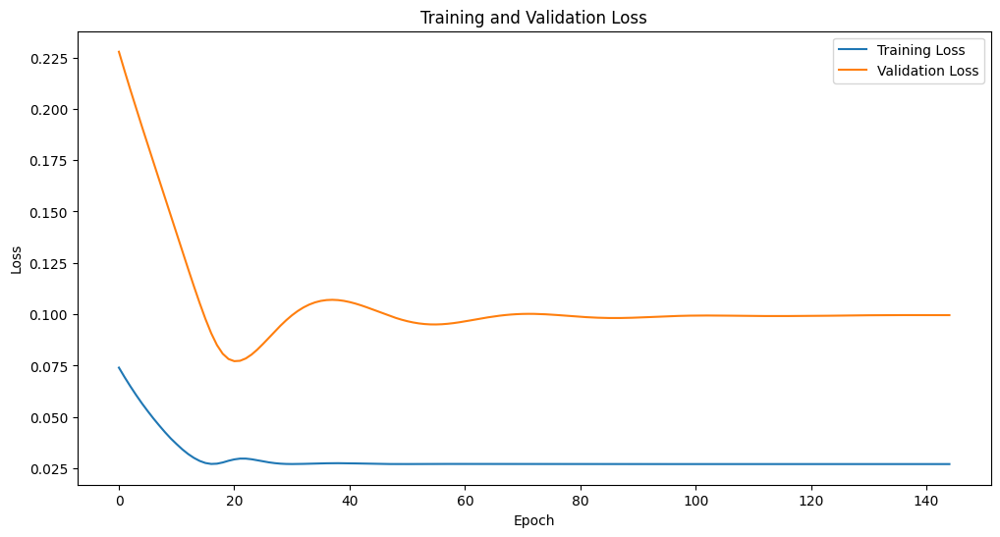

Epoch [1/2500], Train Loss: 0.0436, Val Loss: 0.1637
Epoch [2/2500], Train Loss: 0.0411, Val Loss: 0.1575
Epoch [3/2500], Train Loss: 0.0390, Val Loss: 0.1514
Epoch [4/2500], Train Loss: 0.0371, Val Loss: 0.1455
Epoch [5/2500], Train Loss: 0.0353, Val Loss: 0.1397
Epoch [6/2500], Train Loss: 0.0336, Val Loss: 0.1339
Epoch [7/2500], Train Loss: 0.0322, Val Loss: 0.1282
Epoch [8/2500], Train Loss: 0.0309, Val Loss: 0.1225
Epoch [9/2500], Train Loss: 0.0297, Val Loss: 0.1169
Epoch [10/2500], Train Loss: 0.0288, Val Loss: 0.1113
Epoch [11/2500], Train Loss: 0.0280, Val Loss: 0.1058
Epoch [12/2500], Train Loss: 0.0275, Val Loss: 0.1006
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.0958
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0916
Epoch [15/2500], Train Loss: 0.0275, Val Loss: 0.0883
Epoch [16/2500], Train Loss: 0.0278, Val Loss: 0.0863
Epoch [17/2500], Train Loss: 0.0281, Val Loss: 0.0853
Epoch [18/2500], Train Loss: 0.0283, Val Loss: 0.0852
Epoch [19/2500], Train Loss: 0.0283, 

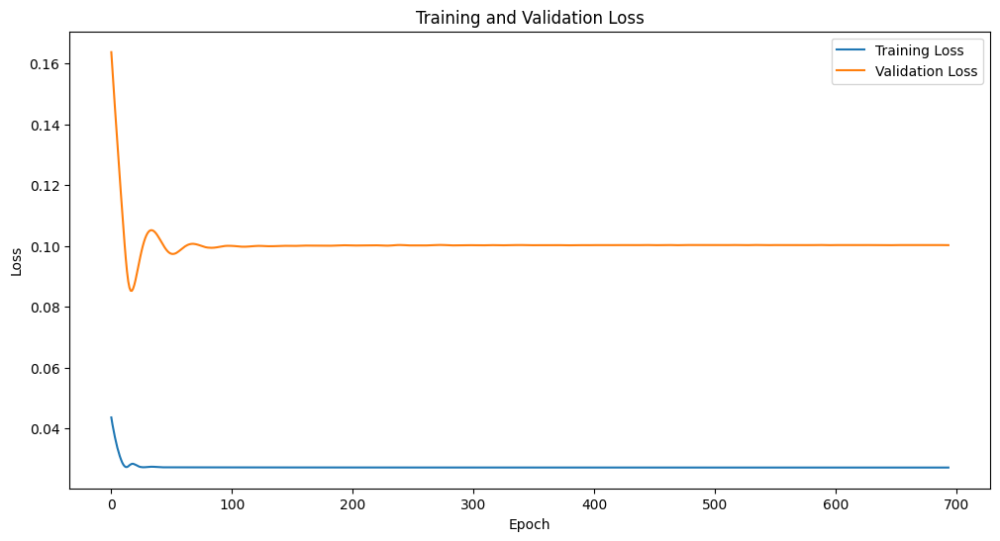

Epoch [1/2500], Train Loss: 0.0407, Val Loss: 0.1545
Epoch [2/2500], Train Loss: 0.0380, Val Loss: 0.1470
Epoch [3/2500], Train Loss: 0.0356, Val Loss: 0.1399
Epoch [4/2500], Train Loss: 0.0335, Val Loss: 0.1331
Epoch [5/2500], Train Loss: 0.0317, Val Loss: 0.1266
Epoch [6/2500], Train Loss: 0.0302, Val Loss: 0.1203
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.1144
Epoch [8/2500], Train Loss: 0.0281, Val Loss: 0.1088
Epoch [9/2500], Train Loss: 0.0275, Val Loss: 0.1035
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0988
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0947
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0915
Epoch [13/2500], Train Loss: 0.0277, Val Loss: 0.0894
Epoch [14/2500], Train Loss: 0.0280, Val Loss: 0.0881
Epoch [15/2500], Train Loss: 0.0282, Val Loss: 0.0878
Epoch [16/2500], Train Loss: 0.0282, Val Loss: 0.0881
Epoch [17/2500], Train Loss: 0.0282, Val Loss: 0.0889
Epoch [18/2500], Train Loss: 0.0280, Val Loss: 0.0902
Epoch [19/2500], Train Loss: 0.0279, 

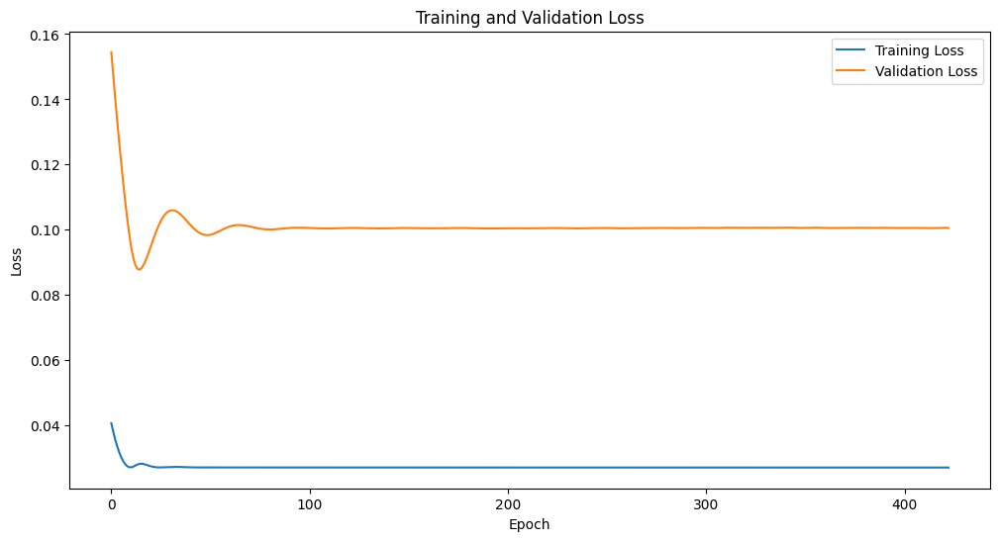

Epoch [1/2500], Train Loss: 0.1552, Val Loss: 0.3632
Epoch [2/2500], Train Loss: 0.1479, Val Loss: 0.3524
Epoch [3/2500], Train Loss: 0.1409, Val Loss: 0.3418
Epoch [4/2500], Train Loss: 0.1342, Val Loss: 0.3312
Epoch [5/2500], Train Loss: 0.1276, Val Loss: 0.3208
Epoch [6/2500], Train Loss: 0.1212, Val Loss: 0.3103
Epoch [7/2500], Train Loss: 0.1149, Val Loss: 0.2997
Epoch [8/2500], Train Loss: 0.1086, Val Loss: 0.2890
Epoch [9/2500], Train Loss: 0.1024, Val Loss: 0.2780
Epoch [10/2500], Train Loss: 0.0962, Val Loss: 0.2668
Epoch [11/2500], Train Loss: 0.0899, Val Loss: 0.2552
Epoch [12/2500], Train Loss: 0.0837, Val Loss: 0.2433
Epoch [13/2500], Train Loss: 0.0774, Val Loss: 0.2309
Epoch [14/2500], Train Loss: 0.0711, Val Loss: 0.2179
Epoch [15/2500], Train Loss: 0.0649, Val Loss: 0.2044
Epoch [16/2500], Train Loss: 0.0584, Val Loss: 0.1903
Epoch [17/2500], Train Loss: 0.0520, Val Loss: 0.1754
Epoch [18/2500], Train Loss: 0.0460, Val Loss: 0.1600
Epoch [19/2500], Train Loss: 0.0402, 

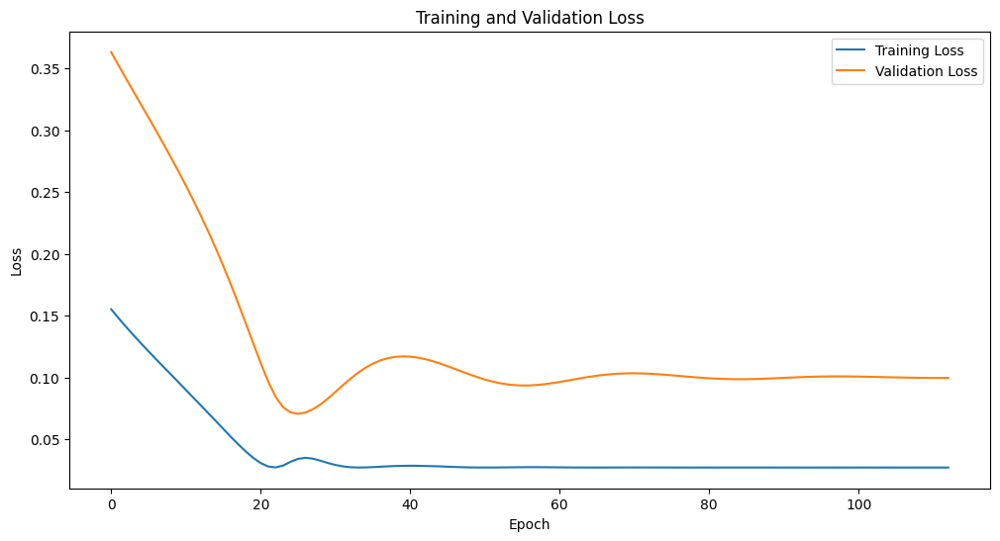

Epoch [1/2500], Train Loss: 0.0429, Val Loss: 0.1604
Epoch [2/2500], Train Loss: 0.0401, Val Loss: 0.1530
Epoch [3/2500], Train Loss: 0.0375, Val Loss: 0.1458
Epoch [4/2500], Train Loss: 0.0353, Val Loss: 0.1387
Epoch [5/2500], Train Loss: 0.0333, Val Loss: 0.1319
Epoch [6/2500], Train Loss: 0.0315, Val Loss: 0.1253
Epoch [7/2500], Train Loss: 0.0300, Val Loss: 0.1188
Epoch [8/2500], Train Loss: 0.0288, Val Loss: 0.1125
Epoch [9/2500], Train Loss: 0.0280, Val Loss: 0.1066
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1010
Epoch [11/2500], Train Loss: 0.0273, Val Loss: 0.0961
Epoch [12/2500], Train Loss: 0.0274, Val Loss: 0.0920
Epoch [13/2500], Train Loss: 0.0277, Val Loss: 0.0891
Epoch [14/2500], Train Loss: 0.0281, Val Loss: 0.0874
Epoch [15/2500], Train Loss: 0.0284, Val Loss: 0.0868
Epoch [16/2500], Train Loss: 0.0286, Val Loss: 0.0871
Epoch [17/2500], Train Loss: 0.0284, Val Loss: 0.0881
Epoch [18/2500], Train Loss: 0.0283, Val Loss: 0.0895
Epoch [19/2500], Train Loss: 0.0280, 

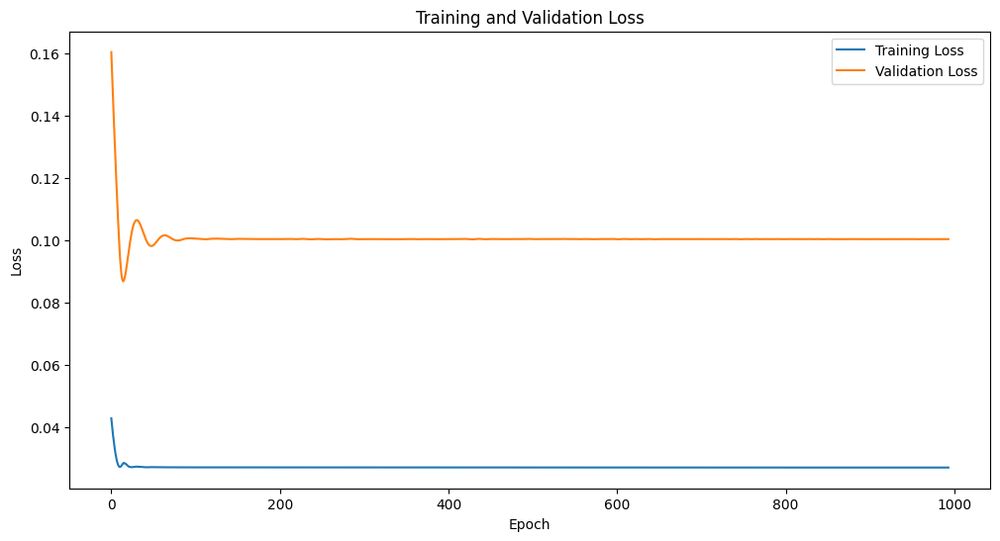

Epoch [1/2500], Train Loss: 0.0871, Val Loss: 0.2517
Epoch [2/2500], Train Loss: 0.0818, Val Loss: 0.2420
Epoch [3/2500], Train Loss: 0.0767, Val Loss: 0.2324
Epoch [4/2500], Train Loss: 0.0718, Val Loss: 0.2229
Epoch [5/2500], Train Loss: 0.0671, Val Loss: 0.2135
Epoch [6/2500], Train Loss: 0.0625, Val Loss: 0.2042
Epoch [7/2500], Train Loss: 0.0582, Val Loss: 0.1948
Epoch [8/2500], Train Loss: 0.0540, Val Loss: 0.1855
Epoch [9/2500], Train Loss: 0.0499, Val Loss: 0.1761
Epoch [10/2500], Train Loss: 0.0460, Val Loss: 0.1666
Epoch [11/2500], Train Loss: 0.0424, Val Loss: 0.1570
Epoch [12/2500], Train Loss: 0.0389, Val Loss: 0.1473
Epoch [13/2500], Train Loss: 0.0359, Val Loss: 0.1375
Epoch [14/2500], Train Loss: 0.0329, Val Loss: 0.1277
Epoch [15/2500], Train Loss: 0.0306, Val Loss: 0.1180
Epoch [16/2500], Train Loss: 0.0288, Val Loss: 0.1085
Epoch [17/2500], Train Loss: 0.0276, Val Loss: 0.0996
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0917
Epoch [19/2500], Train Loss: 0.0277, 

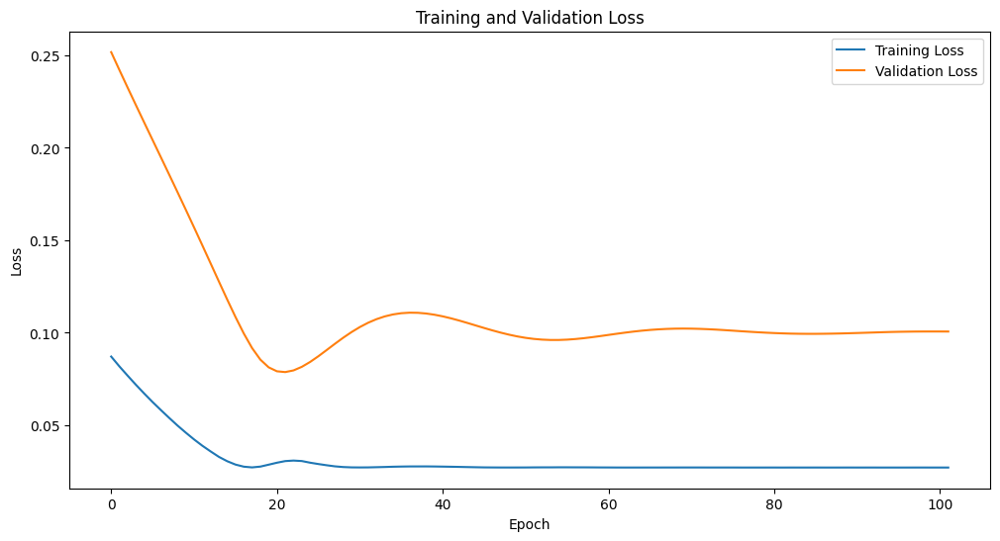

Epoch [1/2500], Train Loss: 0.0775, Val Loss: 0.2334
Epoch [2/2500], Train Loss: 0.0723, Val Loss: 0.2236
Epoch [3/2500], Train Loss: 0.0674, Val Loss: 0.2143
Epoch [4/2500], Train Loss: 0.0629, Val Loss: 0.2055
Epoch [5/2500], Train Loss: 0.0587, Val Loss: 0.1969
Epoch [6/2500], Train Loss: 0.0548, Val Loss: 0.1888
Epoch [7/2500], Train Loss: 0.0513, Val Loss: 0.1809
Epoch [8/2500], Train Loss: 0.0479, Val Loss: 0.1732
Epoch [9/2500], Train Loss: 0.0448, Val Loss: 0.1657
Epoch [10/2500], Train Loss: 0.0420, Val Loss: 0.1584
Epoch [11/2500], Train Loss: 0.0393, Val Loss: 0.1513
Epoch [12/2500], Train Loss: 0.0369, Val Loss: 0.1442
Epoch [13/2500], Train Loss: 0.0347, Val Loss: 0.1373
Epoch [14/2500], Train Loss: 0.0328, Val Loss: 0.1304
Epoch [15/2500], Train Loss: 0.0310, Val Loss: 0.1236
Epoch [16/2500], Train Loss: 0.0296, Val Loss: 0.1170
Epoch [17/2500], Train Loss: 0.0284, Val Loss: 0.1104
Epoch [18/2500], Train Loss: 0.0276, Val Loss: 0.1041
Epoch [19/2500], Train Loss: 0.0272, 

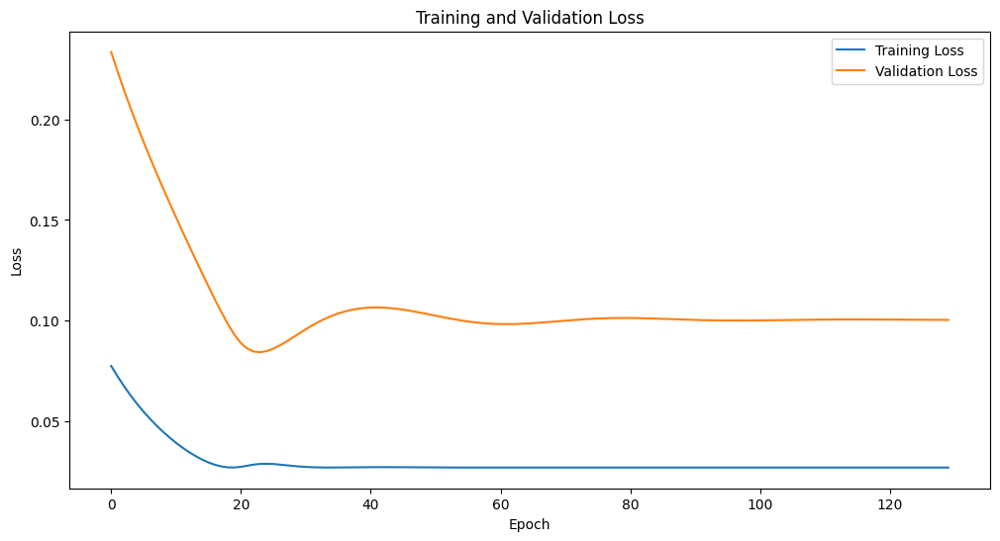

Epoch [1/2500], Train Loss: 0.0620, Val Loss: 0.2033
Epoch [2/2500], Train Loss: 0.0579, Val Loss: 0.1945
Epoch [3/2500], Train Loss: 0.0539, Val Loss: 0.1859
Epoch [4/2500], Train Loss: 0.0502, Val Loss: 0.1777
Epoch [5/2500], Train Loss: 0.0467, Val Loss: 0.1696
Epoch [6/2500], Train Loss: 0.0436, Val Loss: 0.1618
Epoch [7/2500], Train Loss: 0.0407, Val Loss: 0.1541
Epoch [8/2500], Train Loss: 0.0380, Val Loss: 0.1465
Epoch [9/2500], Train Loss: 0.0357, Val Loss: 0.1391
Epoch [10/2500], Train Loss: 0.0335, Val Loss: 0.1318
Epoch [11/2500], Train Loss: 0.0316, Val Loss: 0.1246
Epoch [12/2500], Train Loss: 0.0301, Val Loss: 0.1175
Epoch [13/2500], Train Loss: 0.0287, Val Loss: 0.1107
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.1042
Epoch [15/2500], Train Loss: 0.0275, Val Loss: 0.0982
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0929
Epoch [17/2500], Train Loss: 0.0277, Val Loss: 0.0887
Epoch [18/2500], Train Loss: 0.0282, Val Loss: 0.0858
Epoch [19/2500], Train Loss: 0.0287, 

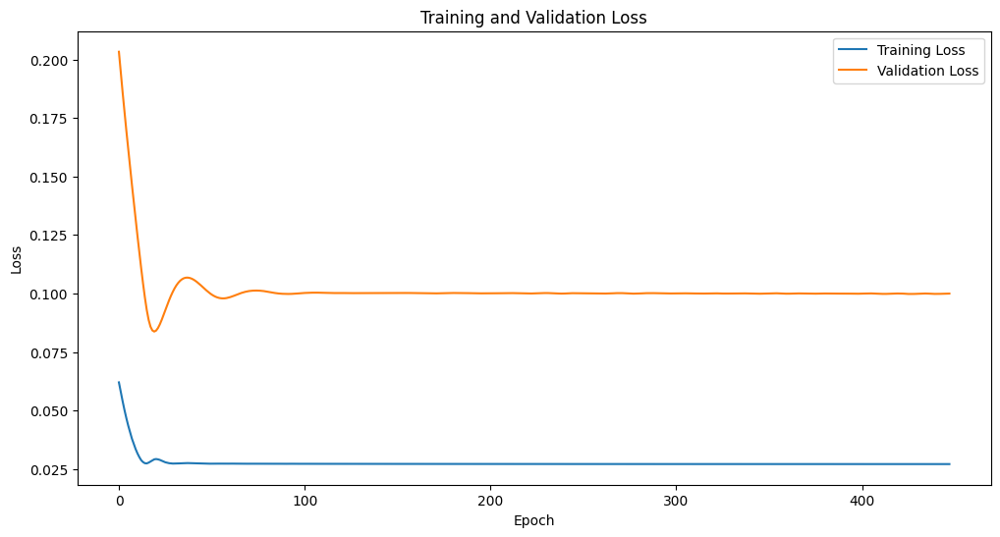

Epoch [1/2500], Train Loss: 0.0784, Val Loss: 0.2345
Epoch [2/2500], Train Loss: 0.0728, Val Loss: 0.2240
Epoch [3/2500], Train Loss: 0.0677, Val Loss: 0.2137
Epoch [4/2500], Train Loss: 0.0626, Val Loss: 0.2037
Epoch [5/2500], Train Loss: 0.0579, Val Loss: 0.1938
Epoch [6/2500], Train Loss: 0.0534, Val Loss: 0.1840
Epoch [7/2500], Train Loss: 0.0493, Val Loss: 0.1742
Epoch [8/2500], Train Loss: 0.0454, Val Loss: 0.1646
Epoch [9/2500], Train Loss: 0.0417, Val Loss: 0.1549
Epoch [10/2500], Train Loss: 0.0383, Val Loss: 0.1453
Epoch [11/2500], Train Loss: 0.0352, Val Loss: 0.1357
Epoch [12/2500], Train Loss: 0.0326, Val Loss: 0.1262
Epoch [13/2500], Train Loss: 0.0303, Val Loss: 0.1169
Epoch [14/2500], Train Loss: 0.0287, Val Loss: 0.1080
Epoch [15/2500], Train Loss: 0.0276, Val Loss: 0.0997
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0923
Epoch [17/2500], Train Loss: 0.0277, Val Loss: 0.0866
Epoch [18/2500], Train Loss: 0.0287, Val Loss: 0.0827
Epoch [19/2500], Train Loss: 0.0296, 

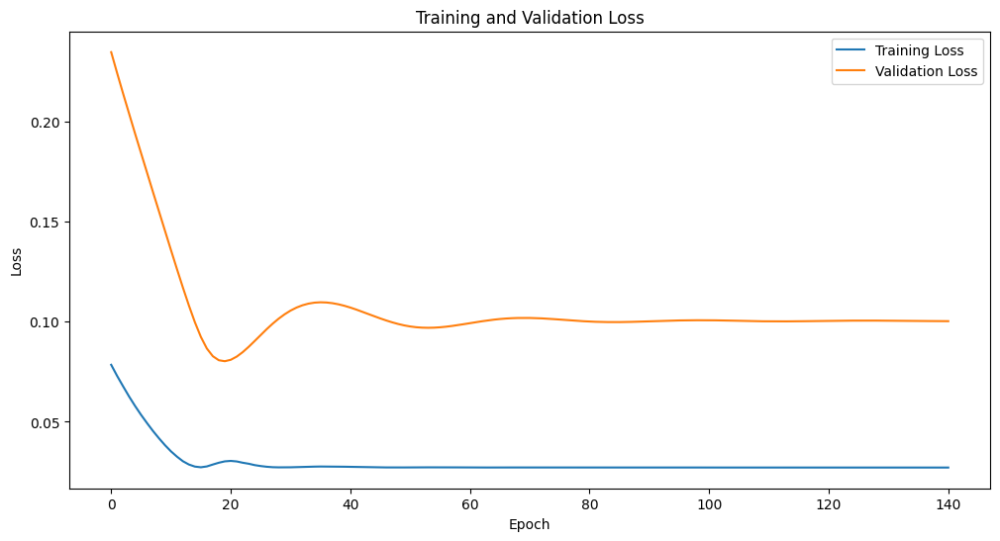

Epoch [1/2500], Train Loss: 0.1048, Val Loss: 0.2835
Epoch [2/2500], Train Loss: 0.0993, Val Loss: 0.2737
Epoch [3/2500], Train Loss: 0.0938, Val Loss: 0.2639
Epoch [4/2500], Train Loss: 0.0883, Val Loss: 0.2540
Epoch [5/2500], Train Loss: 0.0830, Val Loss: 0.2440
Epoch [6/2500], Train Loss: 0.0778, Val Loss: 0.2338
Epoch [7/2500], Train Loss: 0.0725, Val Loss: 0.2233
Epoch [8/2500], Train Loss: 0.0673, Val Loss: 0.2125
Epoch [9/2500], Train Loss: 0.0619, Val Loss: 0.2013
Epoch [10/2500], Train Loss: 0.0568, Val Loss: 0.1898
Epoch [11/2500], Train Loss: 0.0517, Val Loss: 0.1779
Epoch [12/2500], Train Loss: 0.0468, Val Loss: 0.1655
Epoch [13/2500], Train Loss: 0.0419, Val Loss: 0.1527
Epoch [14/2500], Train Loss: 0.0375, Val Loss: 0.1396
Epoch [15/2500], Train Loss: 0.0334, Val Loss: 0.1262
Epoch [16/2500], Train Loss: 0.0302, Val Loss: 0.1129
Epoch [17/2500], Train Loss: 0.0280, Val Loss: 0.1003
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.0891
Epoch [19/2500], Train Loss: 0.0280, 

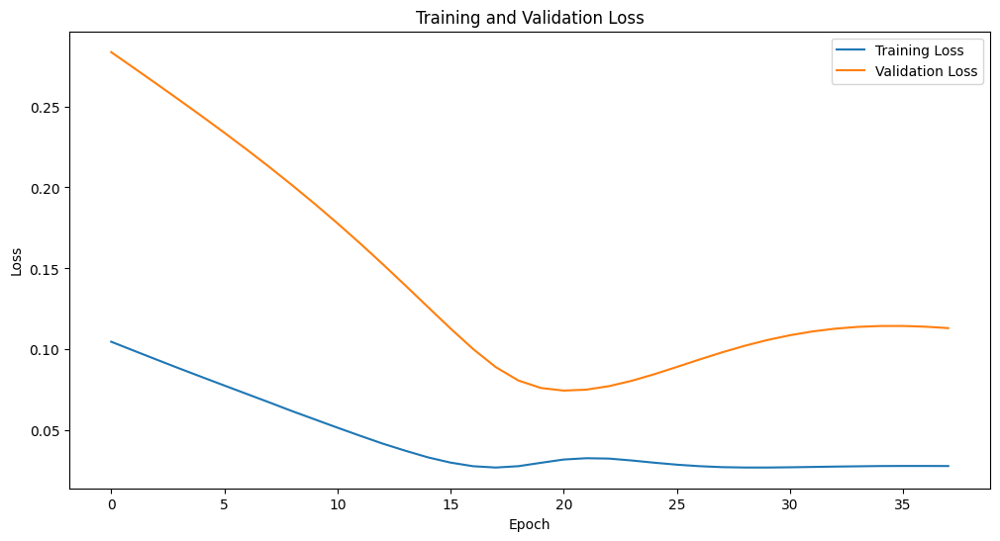

Epoch [1/2500], Train Loss: 0.0709, Val Loss: 0.2212
Epoch [2/2500], Train Loss: 0.0662, Val Loss: 0.2120
Epoch [3/2500], Train Loss: 0.0618, Val Loss: 0.2031
Epoch [4/2500], Train Loss: 0.0577, Val Loss: 0.1944
Epoch [5/2500], Train Loss: 0.0538, Val Loss: 0.1859
Epoch [6/2500], Train Loss: 0.0501, Val Loss: 0.1774
Epoch [7/2500], Train Loss: 0.0465, Val Loss: 0.1691
Epoch [8/2500], Train Loss: 0.0433, Val Loss: 0.1608
Epoch [9/2500], Train Loss: 0.0403, Val Loss: 0.1524
Epoch [10/2500], Train Loss: 0.0374, Val Loss: 0.1441
Epoch [11/2500], Train Loss: 0.0348, Val Loss: 0.1358
Epoch [12/2500], Train Loss: 0.0325, Val Loss: 0.1274
Epoch [13/2500], Train Loss: 0.0305, Val Loss: 0.1191
Epoch [14/2500], Train Loss: 0.0290, Val Loss: 0.1109
Epoch [15/2500], Train Loss: 0.0279, Val Loss: 0.1030
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0957
Epoch [17/2500], Train Loss: 0.0274, Val Loss: 0.0895
Epoch [18/2500], Train Loss: 0.0280, Val Loss: 0.0850
Epoch [19/2500], Train Loss: 0.0288, 

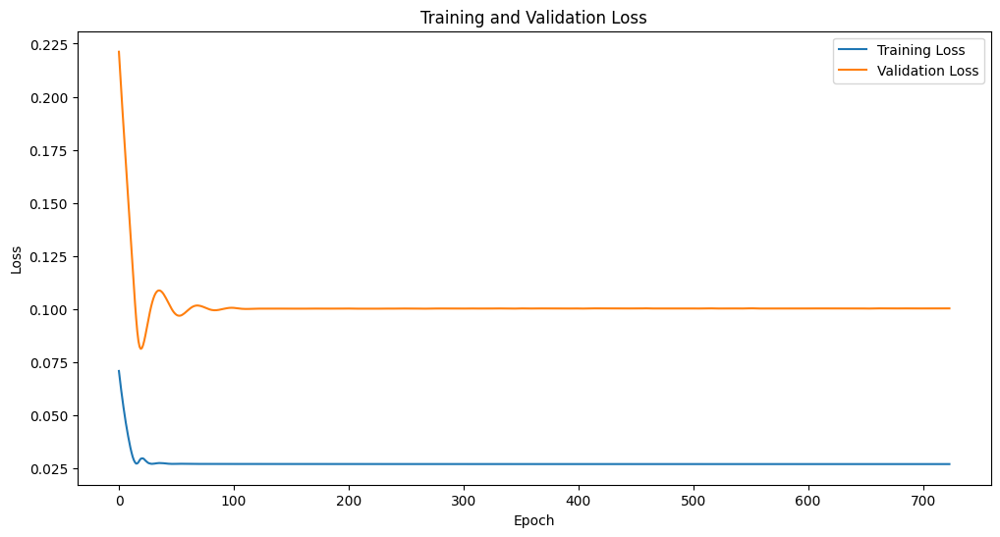

Epoch [1/2500], Train Loss: 0.0803, Val Loss: 0.2360
Epoch [2/2500], Train Loss: 0.0727, Val Loss: 0.2211
Epoch [3/2500], Train Loss: 0.0656, Val Loss: 0.2062
Epoch [4/2500], Train Loss: 0.0589, Val Loss: 0.1911
Epoch [5/2500], Train Loss: 0.0524, Val Loss: 0.1755
Epoch [6/2500], Train Loss: 0.0462, Val Loss: 0.1592
Epoch [7/2500], Train Loss: 0.0404, Val Loss: 0.1422
Epoch [8/2500], Train Loss: 0.0352, Val Loss: 0.1246
Epoch [9/2500], Train Loss: 0.0308, Val Loss: 0.1069
Epoch [10/2500], Train Loss: 0.0280, Val Loss: 0.0903
Epoch [11/2500], Train Loss: 0.0273, Val Loss: 0.0773
Epoch [12/2500], Train Loss: 0.0294, Val Loss: 0.0707
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0693
Epoch [14/2500], Train Loss: 0.0331, Val Loss: 0.0709
Epoch [15/2500], Train Loss: 0.0321, Val Loss: 0.0748
Epoch [16/2500], Train Loss: 0.0306, Val Loss: 0.0801
Epoch [17/2500], Train Loss: 0.0290, Val Loss: 0.0863
Epoch [18/2500], Train Loss: 0.0279, Val Loss: 0.0925
Epoch [19/2500], Train Loss: 0.0273, 

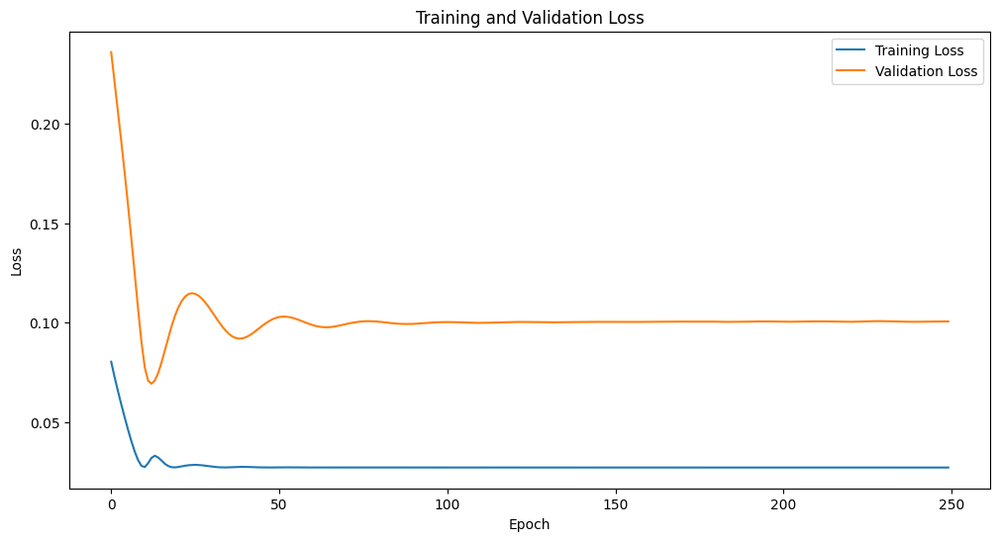

Epoch [1/2500], Train Loss: 0.0701, Val Loss: 0.2121
Epoch [2/2500], Train Loss: 0.0625, Val Loss: 0.1963
Epoch [3/2500], Train Loss: 0.0554, Val Loss: 0.1807
Epoch [4/2500], Train Loss: 0.0489, Val Loss: 0.1653
Epoch [5/2500], Train Loss: 0.0430, Val Loss: 0.1499
Epoch [6/2500], Train Loss: 0.0378, Val Loss: 0.1345
Epoch [7/2500], Train Loss: 0.0333, Val Loss: 0.1192
Epoch [8/2500], Train Loss: 0.0298, Val Loss: 0.1043
Epoch [9/2500], Train Loss: 0.0276, Val Loss: 0.0907
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0799
Epoch [11/2500], Train Loss: 0.0286, Val Loss: 0.0737
Epoch [12/2500], Train Loss: 0.0306, Val Loss: 0.0719
Epoch [13/2500], Train Loss: 0.0316, Val Loss: 0.0729
Epoch [14/2500], Train Loss: 0.0313, Val Loss: 0.0758
Epoch [15/2500], Train Loss: 0.0302, Val Loss: 0.0801
Epoch [16/2500], Train Loss: 0.0289, Val Loss: 0.0851
Epoch [17/2500], Train Loss: 0.0280, Val Loss: 0.0904
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.0956
Epoch [19/2500], Train Loss: 0.0271, 

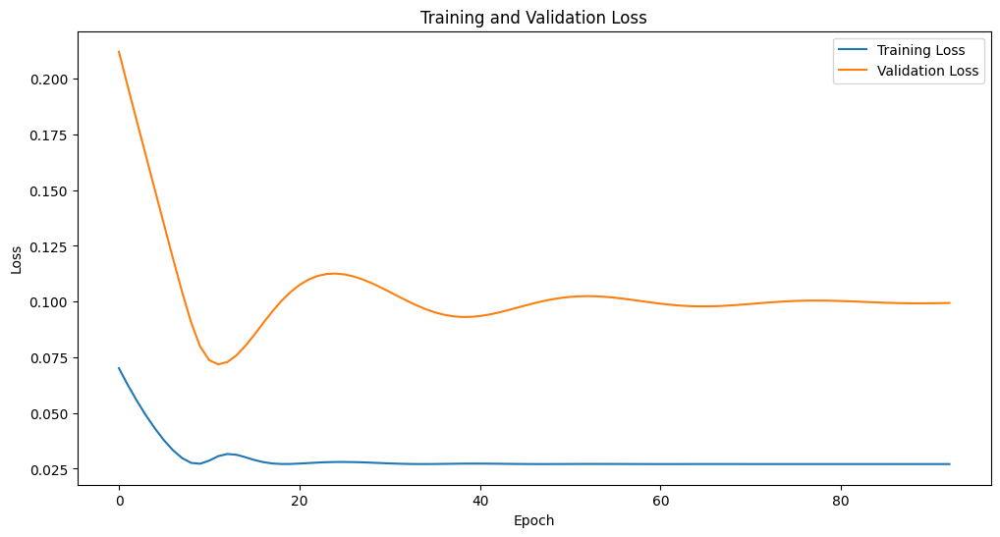

Epoch [1/2500], Train Loss: 0.0532, Val Loss: 0.1775
Epoch [2/2500], Train Loss: 0.0474, Val Loss: 0.1634
Epoch [3/2500], Train Loss: 0.0422, Val Loss: 0.1495
Epoch [4/2500], Train Loss: 0.0376, Val Loss: 0.1357
Epoch [5/2500], Train Loss: 0.0337, Val Loss: 0.1219
Epoch [6/2500], Train Loss: 0.0304, Val Loss: 0.1085
Epoch [7/2500], Train Loss: 0.0282, Val Loss: 0.0958
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.0850
Epoch [9/2500], Train Loss: 0.0278, Val Loss: 0.0778
Epoch [10/2500], Train Loss: 0.0294, Val Loss: 0.0749
Epoch [11/2500], Train Loss: 0.0303, Val Loss: 0.0750
Epoch [12/2500], Train Loss: 0.0304, Val Loss: 0.0773
Epoch [13/2500], Train Loss: 0.0298, Val Loss: 0.0810
Epoch [14/2500], Train Loss: 0.0288, Val Loss: 0.0856
Epoch [15/2500], Train Loss: 0.0280, Val Loss: 0.0905
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0954
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0999
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.1038
Epoch [19/2500], Train Loss: 0.0274, 

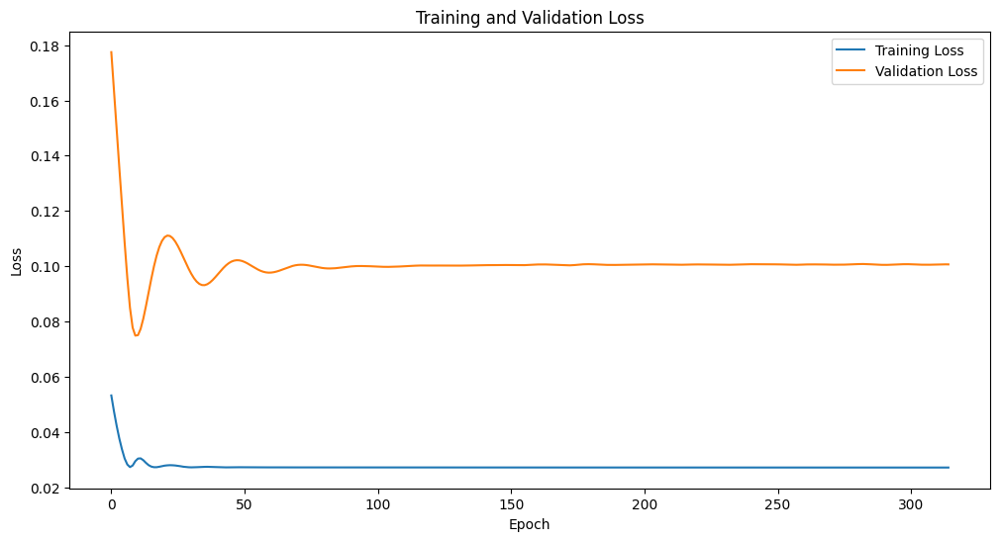

Epoch [1/2500], Train Loss: 0.0779, Val Loss: 0.2287
Epoch [2/2500], Train Loss: 0.0699, Val Loss: 0.2137
Epoch [3/2500], Train Loss: 0.0626, Val Loss: 0.1987
Epoch [4/2500], Train Loss: 0.0556, Val Loss: 0.1837
Epoch [5/2500], Train Loss: 0.0491, Val Loss: 0.1685
Epoch [6/2500], Train Loss: 0.0431, Val Loss: 0.1530
Epoch [7/2500], Train Loss: 0.0375, Val Loss: 0.1372
Epoch [8/2500], Train Loss: 0.0328, Val Loss: 0.1211
Epoch [9/2500], Train Loss: 0.0292, Val Loss: 0.1053
Epoch [10/2500], Train Loss: 0.0273, Val Loss: 0.0908
Epoch [11/2500], Train Loss: 0.0277, Val Loss: 0.0805
Epoch [12/2500], Train Loss: 0.0301, Val Loss: 0.0760
Epoch [13/2500], Train Loss: 0.0322, Val Loss: 0.0759
Epoch [14/2500], Train Loss: 0.0322, Val Loss: 0.0784
Epoch [15/2500], Train Loss: 0.0311, Val Loss: 0.0827
Epoch [16/2500], Train Loss: 0.0295, Val Loss: 0.0879
Epoch [17/2500], Train Loss: 0.0282, Val Loss: 0.0935
Epoch [18/2500], Train Loss: 0.0275, Val Loss: 0.0988
Epoch [19/2500], Train Loss: 0.0272, 

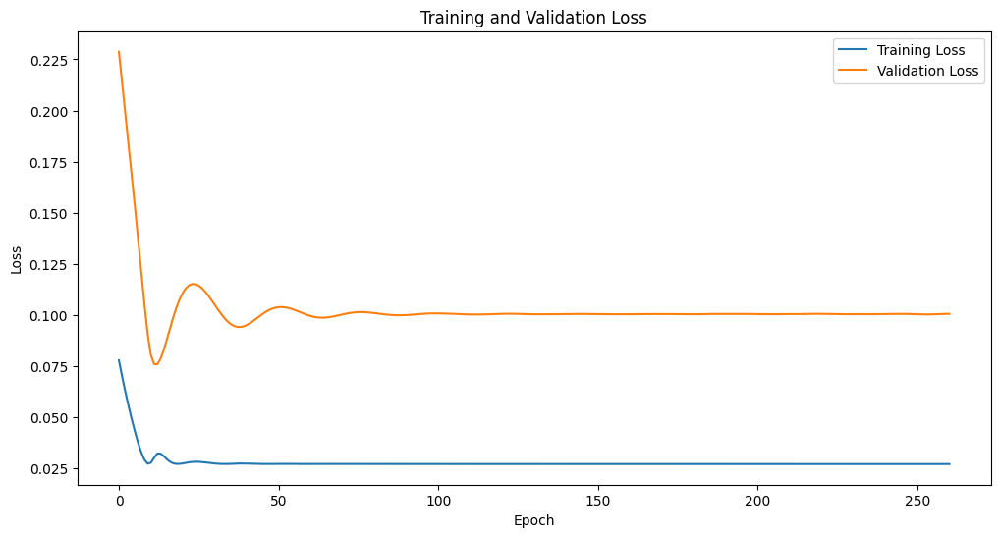

Epoch [1/2500], Train Loss: 0.0763, Val Loss: 0.2269
Epoch [2/2500], Train Loss: 0.0690, Val Loss: 0.2126
Epoch [3/2500], Train Loss: 0.0621, Val Loss: 0.1982
Epoch [4/2500], Train Loss: 0.0554, Val Loss: 0.1835
Epoch [5/2500], Train Loss: 0.0490, Val Loss: 0.1681
Epoch [6/2500], Train Loss: 0.0429, Val Loss: 0.1521
Epoch [7/2500], Train Loss: 0.0373, Val Loss: 0.1352
Epoch [8/2500], Train Loss: 0.0323, Val Loss: 0.1177
Epoch [9/2500], Train Loss: 0.0286, Val Loss: 0.1001
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.0847
Epoch [11/2500], Train Loss: 0.0288, Val Loss: 0.0764
Epoch [12/2500], Train Loss: 0.0317, Val Loss: 0.0746
Epoch [13/2500], Train Loss: 0.0327, Val Loss: 0.0768
Epoch [14/2500], Train Loss: 0.0316, Val Loss: 0.0813
Epoch [15/2500], Train Loss: 0.0298, Val Loss: 0.0870
Epoch [16/2500], Train Loss: 0.0283, Val Loss: 0.0931
Epoch [17/2500], Train Loss: 0.0274, Val Loss: 0.0990
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1042
Epoch [19/2500], Train Loss: 0.0272, 

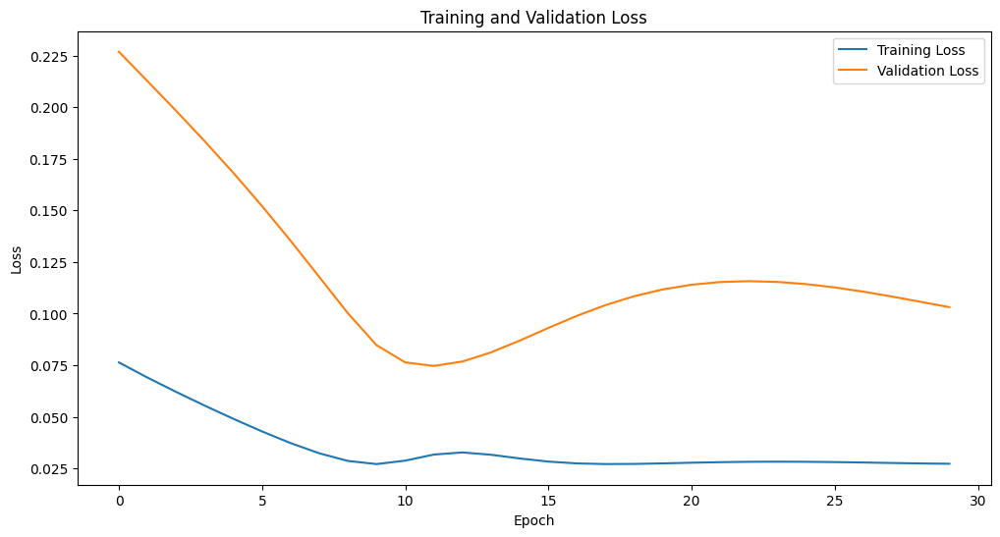

Epoch [1/2500], Train Loss: 0.0600, Val Loss: 0.1949
Epoch [2/2500], Train Loss: 0.0539, Val Loss: 0.1819
Epoch [3/2500], Train Loss: 0.0484, Val Loss: 0.1693
Epoch [4/2500], Train Loss: 0.0434, Val Loss: 0.1569
Epoch [5/2500], Train Loss: 0.0389, Val Loss: 0.1445
Epoch [6/2500], Train Loss: 0.0350, Val Loss: 0.1320
Epoch [7/2500], Train Loss: 0.0316, Val Loss: 0.1194
Epoch [8/2500], Train Loss: 0.0290, Val Loss: 0.1068
Epoch [9/2500], Train Loss: 0.0275, Val Loss: 0.0950
Epoch [10/2500], Train Loss: 0.0273, Val Loss: 0.0855
Epoch [11/2500], Train Loss: 0.0287, Val Loss: 0.0806
Epoch [12/2500], Train Loss: 0.0301, Val Loss: 0.0795
Epoch [13/2500], Train Loss: 0.0305, Val Loss: 0.0811
Epoch [14/2500], Train Loss: 0.0300, Val Loss: 0.0842
Epoch [15/2500], Train Loss: 0.0290, Val Loss: 0.0883
Epoch [16/2500], Train Loss: 0.0282, Val Loss: 0.0928
Epoch [17/2500], Train Loss: 0.0275, Val Loss: 0.0972
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.1012
Epoch [19/2500], Train Loss: 0.0272, 

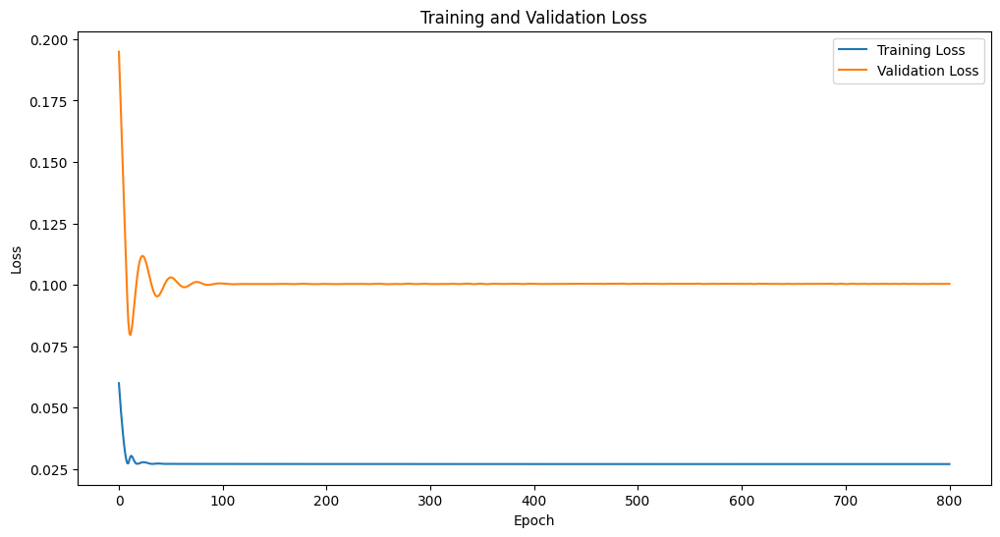

Epoch [1/2500], Train Loss: 0.1268, Val Loss: 0.3135
Epoch [2/2500], Train Loss: 0.1167, Val Loss: 0.2976
Epoch [3/2500], Train Loss: 0.1074, Val Loss: 0.2823
Epoch [4/2500], Train Loss: 0.0986, Val Loss: 0.2672
Epoch [5/2500], Train Loss: 0.0902, Val Loss: 0.2522
Epoch [6/2500], Train Loss: 0.0820, Val Loss: 0.2369
Epoch [7/2500], Train Loss: 0.0741, Val Loss: 0.2211
Epoch [8/2500], Train Loss: 0.0662, Val Loss: 0.2044
Epoch [9/2500], Train Loss: 0.0583, Val Loss: 0.1865
Epoch [10/2500], Train Loss: 0.0504, Val Loss: 0.1673
Epoch [11/2500], Train Loss: 0.0429, Val Loss: 0.1465
Epoch [12/2500], Train Loss: 0.0357, Val Loss: 0.1244
Epoch [13/2500], Train Loss: 0.0301, Val Loss: 0.1020
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0823
Epoch [15/2500], Train Loss: 0.0294, Val Loss: 0.0716
Epoch [16/2500], Train Loss: 0.0347, Val Loss: 0.0692
Epoch [17/2500], Train Loss: 0.0367, Val Loss: 0.0713
Epoch [18/2500], Train Loss: 0.0348, Val Loss: 0.0762
Epoch [19/2500], Train Loss: 0.0319, 

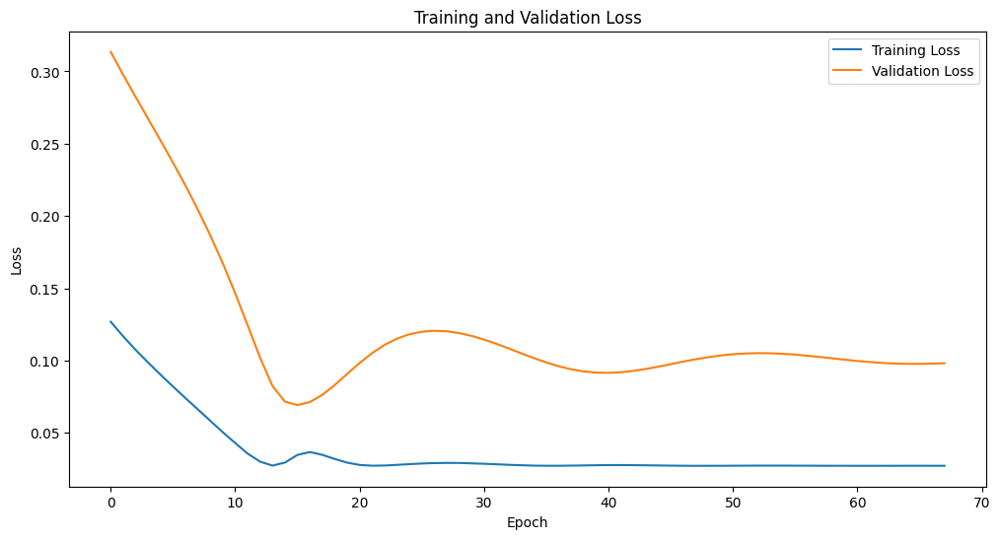

Epoch [1/2500], Train Loss: 0.0602, Val Loss: 0.1947
Epoch [2/2500], Train Loss: 0.0538, Val Loss: 0.1809
Epoch [3/2500], Train Loss: 0.0479, Val Loss: 0.1672
Epoch [4/2500], Train Loss: 0.0425, Val Loss: 0.1533
Epoch [5/2500], Train Loss: 0.0376, Val Loss: 0.1392
Epoch [6/2500], Train Loss: 0.0333, Val Loss: 0.1249
Epoch [7/2500], Train Loss: 0.0299, Val Loss: 0.1104
Epoch [8/2500], Train Loss: 0.0276, Val Loss: 0.0965
Epoch [9/2500], Train Loss: 0.0272, Val Loss: 0.0853
Epoch [10/2500], Train Loss: 0.0288, Val Loss: 0.0795
Epoch [11/2500], Train Loss: 0.0306, Val Loss: 0.0786
Epoch [12/2500], Train Loss: 0.0310, Val Loss: 0.0805
Epoch [13/2500], Train Loss: 0.0302, Val Loss: 0.0841
Epoch [14/2500], Train Loss: 0.0291, Val Loss: 0.0887
Epoch [15/2500], Train Loss: 0.0280, Val Loss: 0.0936
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0983
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1025
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1061
Epoch [19/2500], Train Loss: 0.0273, 

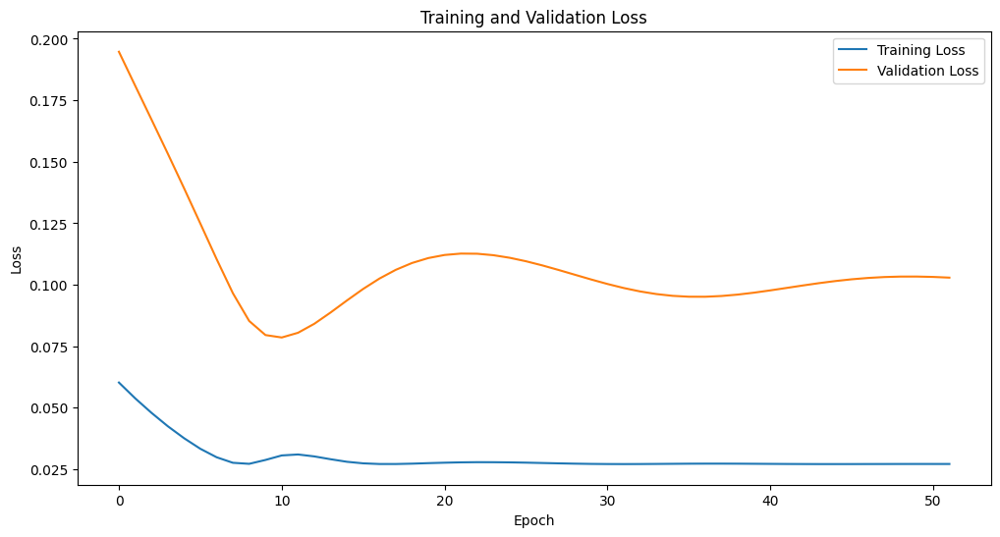

Epoch [1/2500], Train Loss: 0.1066, Val Loss: 0.2779
Epoch [2/2500], Train Loss: 0.0962, Val Loss: 0.2597
Epoch [3/2500], Train Loss: 0.0862, Val Loss: 0.2414
Epoch [4/2500], Train Loss: 0.0764, Val Loss: 0.2228
Epoch [5/2500], Train Loss: 0.0673, Val Loss: 0.2037
Epoch [6/2500], Train Loss: 0.0582, Val Loss: 0.1840
Epoch [7/2500], Train Loss: 0.0494, Val Loss: 0.1634
Epoch [8/2500], Train Loss: 0.0414, Val Loss: 0.1421
Epoch [9/2500], Train Loss: 0.0345, Val Loss: 0.1203
Epoch [10/2500], Train Loss: 0.0295, Val Loss: 0.0992
Epoch [11/2500], Train Loss: 0.0275, Val Loss: 0.0817
Epoch [12/2500], Train Loss: 0.0298, Val Loss: 0.0723
Epoch [13/2500], Train Loss: 0.0345, Val Loss: 0.0703
Epoch [14/2500], Train Loss: 0.0359, Val Loss: 0.0723
Epoch [15/2500], Train Loss: 0.0345, Val Loss: 0.0769
Epoch [16/2500], Train Loss: 0.0320, Val Loss: 0.0831
Epoch [17/2500], Train Loss: 0.0296, Val Loss: 0.0900
Epoch [18/2500], Train Loss: 0.0281, Val Loss: 0.0969
Epoch [19/2500], Train Loss: 0.0274, 

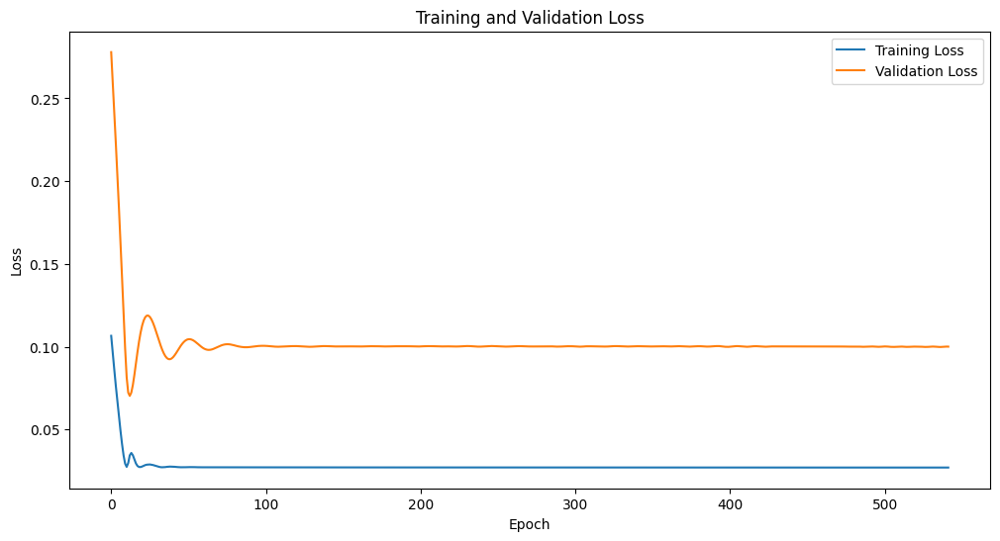

Epoch [1/2500], Train Loss: 0.0921, Val Loss: 0.2530
Epoch [2/2500], Train Loss: 0.0825, Val Loss: 0.2357
Epoch [3/2500], Train Loss: 0.0734, Val Loss: 0.2185
Epoch [4/2500], Train Loss: 0.0649, Val Loss: 0.2012
Epoch [5/2500], Train Loss: 0.0568, Val Loss: 0.1836
Epoch [6/2500], Train Loss: 0.0491, Val Loss: 0.1655
Epoch [7/2500], Train Loss: 0.0419, Val Loss: 0.1469
Epoch [8/2500], Train Loss: 0.0357, Val Loss: 0.1277
Epoch [9/2500], Train Loss: 0.0305, Val Loss: 0.1085
Epoch [10/2500], Train Loss: 0.0276, Val Loss: 0.0908
Epoch [11/2500], Train Loss: 0.0278, Val Loss: 0.0782
Epoch [12/2500], Train Loss: 0.0312, Val Loss: 0.0732
Epoch [13/2500], Train Loss: 0.0339, Val Loss: 0.0733
Epoch [14/2500], Train Loss: 0.0337, Val Loss: 0.0763
Epoch [15/2500], Train Loss: 0.0321, Val Loss: 0.0814
Epoch [16/2500], Train Loss: 0.0299, Val Loss: 0.0875
Epoch [17/2500], Train Loss: 0.0284, Val Loss: 0.0939
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.1000
Epoch [19/2500], Train Loss: 0.0272, 

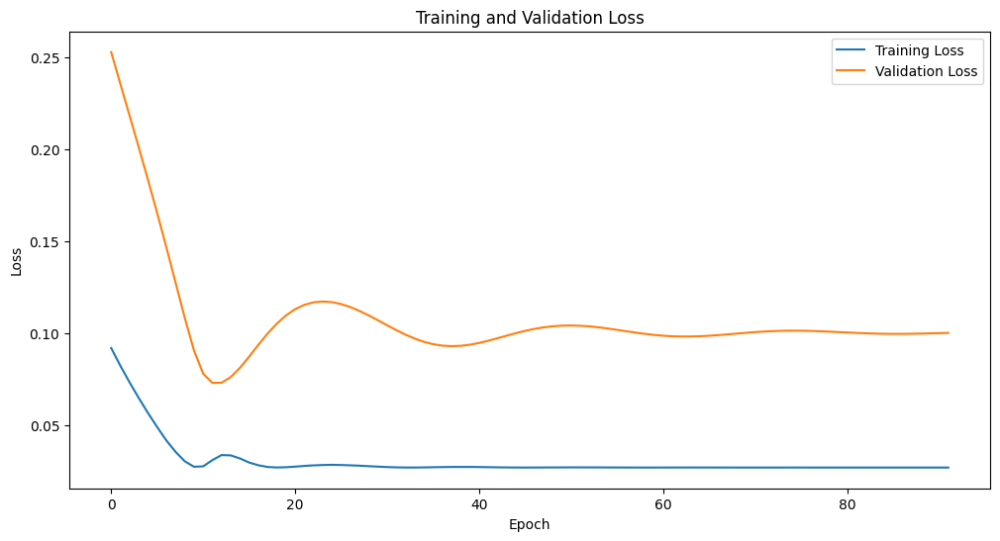

Epoch [1/2500], Train Loss: 0.0735, Val Loss: 0.2210
Epoch [2/2500], Train Loss: 0.0661, Val Loss: 0.2070
Epoch [3/2500], Train Loss: 0.0594, Val Loss: 0.1936
Epoch [4/2500], Train Loss: 0.0533, Val Loss: 0.1804
Epoch [5/2500], Train Loss: 0.0477, Val Loss: 0.1673
Epoch [6/2500], Train Loss: 0.0426, Val Loss: 0.1541
Epoch [7/2500], Train Loss: 0.0379, Val Loss: 0.1406
Epoch [8/2500], Train Loss: 0.0337, Val Loss: 0.1267
Epoch [9/2500], Train Loss: 0.0302, Val Loss: 0.1126
Epoch [10/2500], Train Loss: 0.0279, Val Loss: 0.0988
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0868
Epoch [12/2500], Train Loss: 0.0284, Val Loss: 0.0798
Epoch [13/2500], Train Loss: 0.0305, Val Loss: 0.0778
Epoch [14/2500], Train Loss: 0.0313, Val Loss: 0.0791
Epoch [15/2500], Train Loss: 0.0307, Val Loss: 0.0824
Epoch [16/2500], Train Loss: 0.0295, Val Loss: 0.0868
Epoch [17/2500], Train Loss: 0.0284, Val Loss: 0.0917
Epoch [18/2500], Train Loss: 0.0276, Val Loss: 0.0965
Epoch [19/2500], Train Loss: 0.0272, 

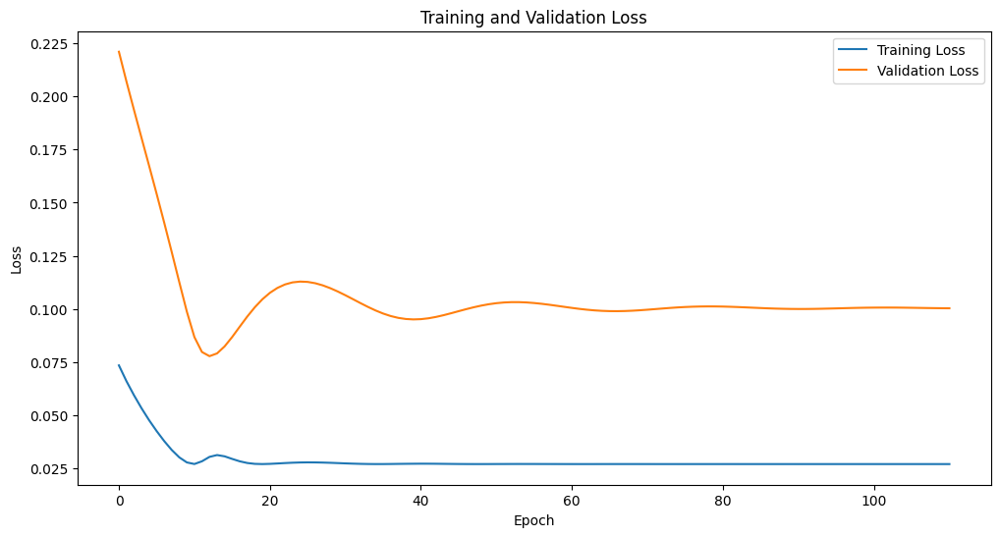

Epoch [1/2500], Train Loss: 0.1300, Val Loss: 0.3186
Epoch [2/2500], Train Loss: 0.1199, Val Loss: 0.3028
Epoch [3/2500], Train Loss: 0.1105, Val Loss: 0.2873
Epoch [4/2500], Train Loss: 0.1015, Val Loss: 0.2717
Epoch [5/2500], Train Loss: 0.0927, Val Loss: 0.2559
Epoch [6/2500], Train Loss: 0.0841, Val Loss: 0.2396
Epoch [7/2500], Train Loss: 0.0756, Val Loss: 0.2224
Epoch [8/2500], Train Loss: 0.0670, Val Loss: 0.2041
Epoch [9/2500], Train Loss: 0.0584, Val Loss: 0.1844
Epoch [10/2500], Train Loss: 0.0497, Val Loss: 0.1629
Epoch [11/2500], Train Loss: 0.0415, Val Loss: 0.1396
Epoch [12/2500], Train Loss: 0.0342, Val Loss: 0.1151
Epoch [13/2500], Train Loss: 0.0289, Val Loss: 0.0913
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.0739
Epoch [15/2500], Train Loss: 0.0328, Val Loss: 0.0676
Epoch [16/2500], Train Loss: 0.0376, Val Loss: 0.0678
Epoch [17/2500], Train Loss: 0.0368, Val Loss: 0.0716
Epoch [18/2500], Train Loss: 0.0343, Val Loss: 0.0779
Epoch [19/2500], Train Loss: 0.0310, 

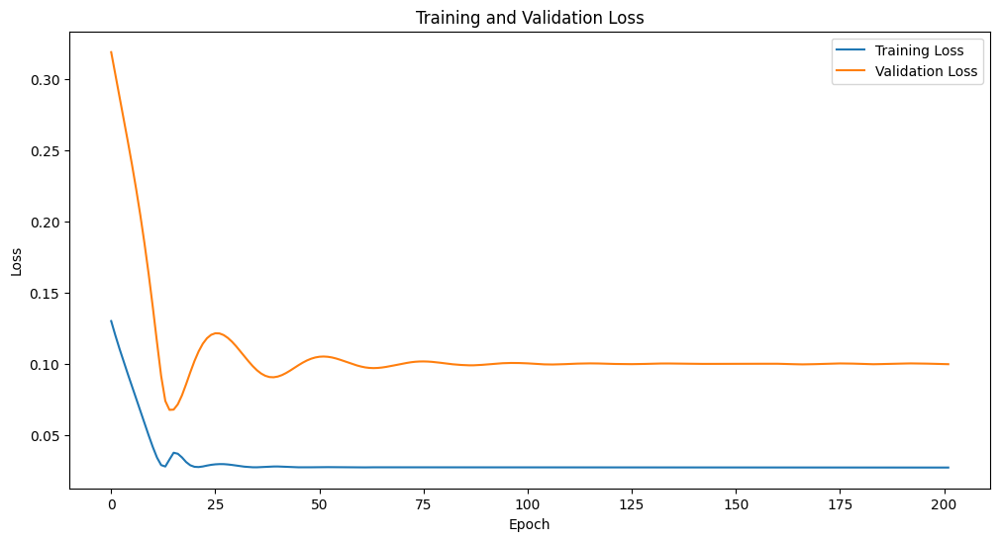

Epoch [1/2500], Train Loss: 0.0706, Val Loss: 0.1767
Epoch [2/2500], Train Loss: 0.0475, Val Loss: 0.1278
Epoch [3/2500], Train Loss: 0.0315, Val Loss: 0.0846
Epoch [4/2500], Train Loss: 0.0284, Val Loss: 0.0686
Epoch [5/2500], Train Loss: 0.0355, Val Loss: 0.0729
Epoch [6/2500], Train Loss: 0.0330, Val Loss: 0.0845
Epoch [7/2500], Train Loss: 0.0287, Val Loss: 0.0988
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.1114
Epoch [9/2500], Train Loss: 0.0279, Val Loss: 0.1198
Epoch [10/2500], Train Loss: 0.0290, Val Loss: 0.1237
Epoch [11/2500], Train Loss: 0.0296, Val Loss: 0.1237
Epoch [12/2500], Train Loss: 0.0297, Val Loss: 0.1208
Epoch [13/2500], Train Loss: 0.0292, Val Loss: 0.1162
Epoch [14/2500], Train Loss: 0.0284, Val Loss: 0.1105
Epoch [15/2500], Train Loss: 0.0278, Val Loss: 0.1046
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0990
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0945
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.0912
Epoch [19/2500], Train Loss: 0.0277, 

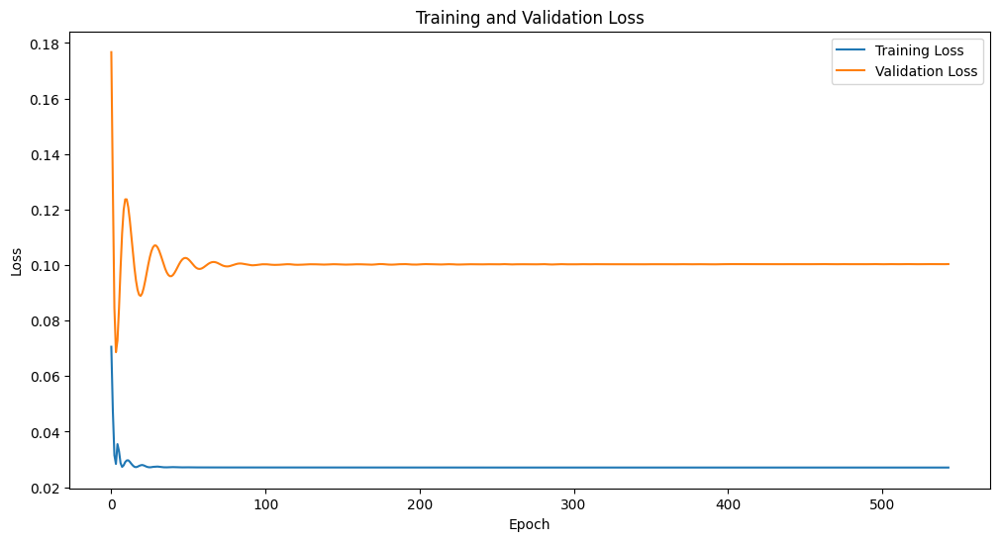

Epoch [1/2500], Train Loss: 0.0334, Val Loss: 0.1121
Epoch [2/2500], Train Loss: 0.0279, Val Loss: 0.0915
Epoch [3/2500], Train Loss: 0.0274, Val Loss: 0.0844
Epoch [4/2500], Train Loss: 0.0287, Val Loss: 0.0865
Epoch [5/2500], Train Loss: 0.0283, Val Loss: 0.0917
Epoch [6/2500], Train Loss: 0.0275, Val Loss: 0.0975
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.1026
Epoch [8/2500], Train Loss: 0.0271, Val Loss: 0.1064
Epoch [9/2500], Train Loss: 0.0273, Val Loss: 0.1085
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1091
Epoch [11/2500], Train Loss: 0.0275, Val Loss: 0.1084
Epoch [12/2500], Train Loss: 0.0274, Val Loss: 0.1069
Epoch [13/2500], Train Loss: 0.0273, Val Loss: 0.1049
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.1027
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.1004
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0985
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0969
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.0960
Epoch [19/2500], Train Loss: 0.0272, 

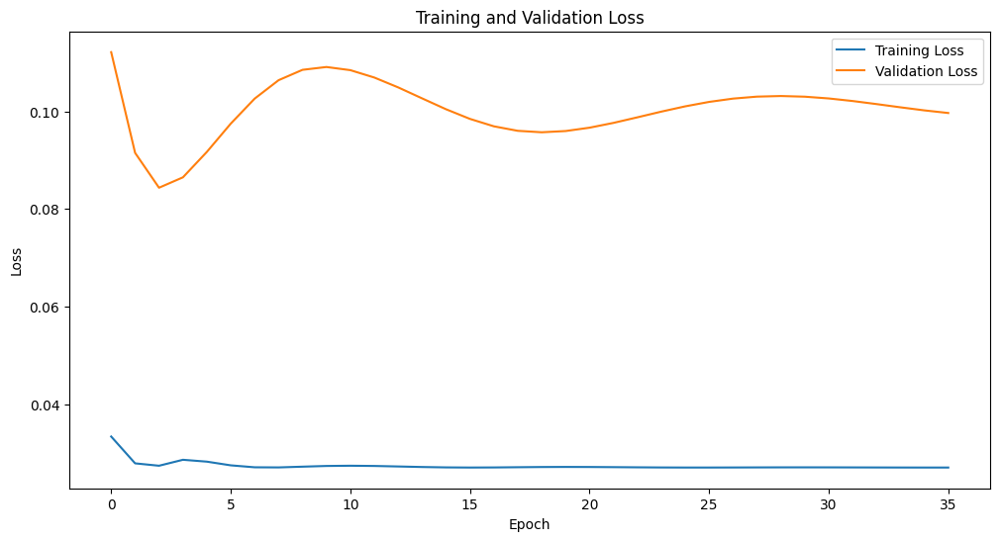

Epoch [1/2500], Train Loss: 0.1237, Val Loss: 0.2610
Epoch [2/2500], Train Loss: 0.0862, Val Loss: 0.1952
Epoch [3/2500], Train Loss: 0.0543, Val Loss: 0.1305
Epoch [4/2500], Train Loss: 0.0322, Val Loss: 0.0790
Epoch [5/2500], Train Loss: 0.0304, Val Loss: 0.0631
Epoch [6/2500], Train Loss: 0.0425, Val Loss: 0.0640
Epoch [7/2500], Train Loss: 0.0415, Val Loss: 0.0714
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0843
Epoch [9/2500], Train Loss: 0.0288, Val Loss: 0.0997
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1138
Epoch [11/2500], Train Loss: 0.0286, Val Loss: 0.1238
Epoch [12/2500], Train Loss: 0.0303, Val Loss: 0.1284
Epoch [13/2500], Train Loss: 0.0313, Val Loss: 0.1286
Epoch [14/2500], Train Loss: 0.0313, Val Loss: 0.1254
Epoch [15/2500], Train Loss: 0.0306, Val Loss: 0.1202
Epoch [16/2500], Train Loss: 0.0295, Val Loss: 0.1140
Epoch [17/2500], Train Loss: 0.0285, Val Loss: 0.1074
Epoch [18/2500], Train Loss: 0.0277, Val Loss: 0.1012
Epoch [19/2500], Train Loss: 0.0273, 

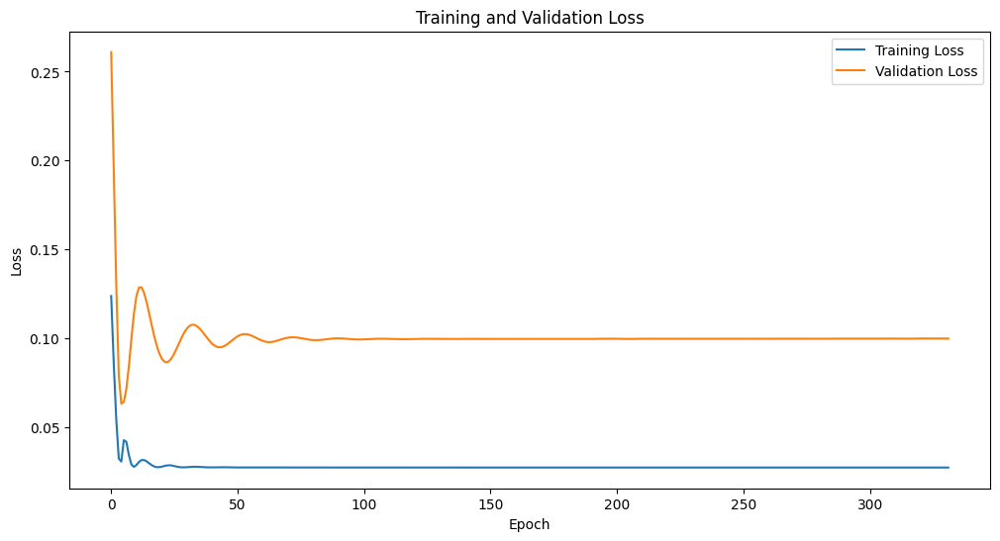

Epoch [1/2500], Train Loss: 0.0461, Val Loss: 0.1387
Epoch [2/2500], Train Loss: 0.0332, Val Loss: 0.1040
Epoch [3/2500], Train Loss: 0.0273, Val Loss: 0.0776
Epoch [4/2500], Train Loss: 0.0315, Val Loss: 0.0800
Epoch [5/2500], Train Loss: 0.0305, Val Loss: 0.0889
Epoch [6/2500], Train Loss: 0.0282, Val Loss: 0.0985
Epoch [7/2500], Train Loss: 0.0272, Val Loss: 0.1064
Epoch [8/2500], Train Loss: 0.0274, Val Loss: 0.1116
Epoch [9/2500], Train Loss: 0.0278, Val Loss: 0.1142
Epoch [10/2500], Train Loss: 0.0281, Val Loss: 0.1147
Epoch [11/2500], Train Loss: 0.0281, Val Loss: 0.1135
Epoch [12/2500], Train Loss: 0.0280, Val Loss: 0.1112
Epoch [13/2500], Train Loss: 0.0277, Val Loss: 0.1081
Epoch [14/2500], Train Loss: 0.0274, Val Loss: 0.1046
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.1012
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0981
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0957
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0940
Epoch [19/2500], Train Loss: 0.0274, 

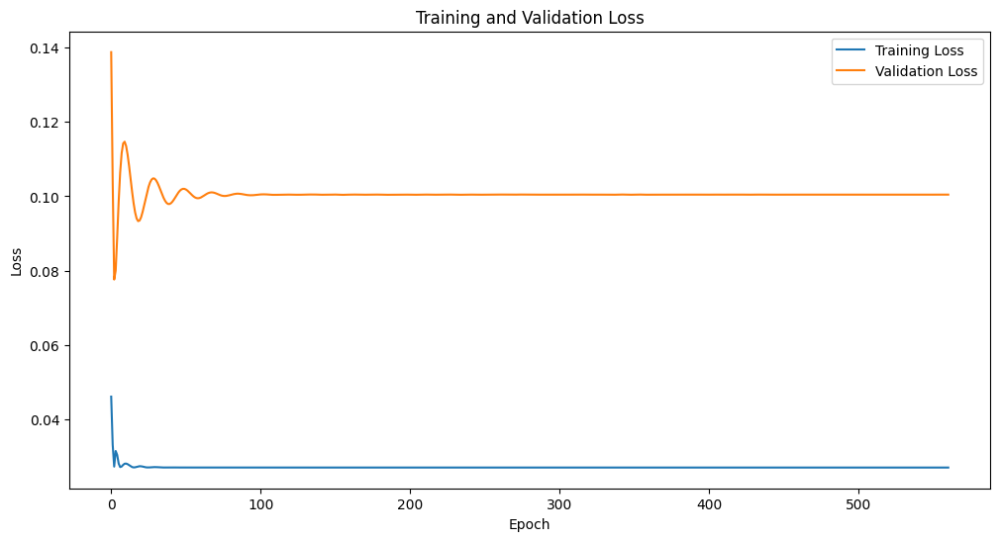

Epoch [1/2500], Train Loss: 0.0304, Val Loss: 0.0991
Epoch [2/2500], Train Loss: 0.0271, Val Loss: 0.0863
Epoch [3/2500], Train Loss: 0.0285, Val Loss: 0.0884
Epoch [4/2500], Train Loss: 0.0281, Val Loss: 0.0944
Epoch [5/2500], Train Loss: 0.0273, Val Loss: 0.1008
Epoch [6/2500], Train Loss: 0.0271, Val Loss: 0.1058
Epoch [7/2500], Train Loss: 0.0272, Val Loss: 0.1086
Epoch [8/2500], Train Loss: 0.0274, Val Loss: 0.1091
Epoch [9/2500], Train Loss: 0.0275, Val Loss: 0.1077
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1053
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.1023
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.0994
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0970
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0956
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.0953
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.0959
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0972
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.0989
Epoch [19/2500], Train Loss: 0.0271, 

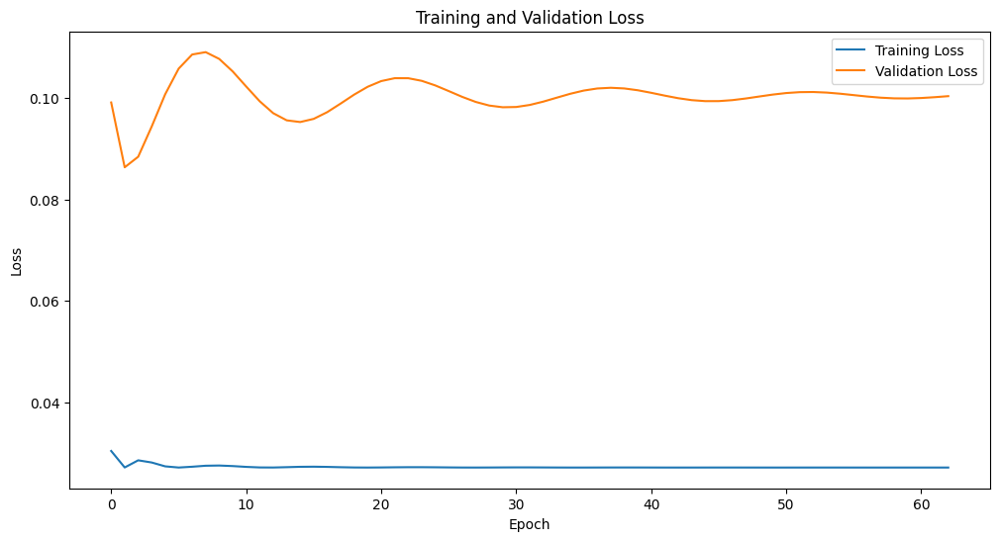

Epoch [1/2500], Train Loss: 0.1838, Val Loss: 0.3476
Epoch [2/2500], Train Loss: 0.1377, Val Loss: 0.2864
Epoch [3/2500], Train Loss: 0.1014, Val Loss: 0.2235
Epoch [4/2500], Train Loss: 0.0691, Val Loss: 0.1571
Epoch [5/2500], Train Loss: 0.0425, Val Loss: 0.0965
Epoch [6/2500], Train Loss: 0.0294, Val Loss: 0.0640
Epoch [7/2500], Train Loss: 0.0392, Val Loss: 0.0608
Epoch [8/2500], Train Loss: 0.0443, Val Loss: 0.0646
Epoch [9/2500], Train Loss: 0.0388, Val Loss: 0.0742
Epoch [10/2500], Train Loss: 0.0320, Val Loss: 0.0884
Epoch [11/2500], Train Loss: 0.0285, Val Loss: 0.1039
Epoch [12/2500], Train Loss: 0.0285, Val Loss: 0.1169
Epoch [13/2500], Train Loss: 0.0301, Val Loss: 0.1253
Epoch [14/2500], Train Loss: 0.0315, Val Loss: 0.1291
Epoch [15/2500], Train Loss: 0.0325, Val Loss: 0.1291
Epoch [16/2500], Train Loss: 0.0321, Val Loss: 0.1262
Epoch [17/2500], Train Loss: 0.0314, Val Loss: 0.1214
Epoch [18/2500], Train Loss: 0.0304, Val Loss: 0.1155
Epoch [19/2500], Train Loss: 0.0291, 

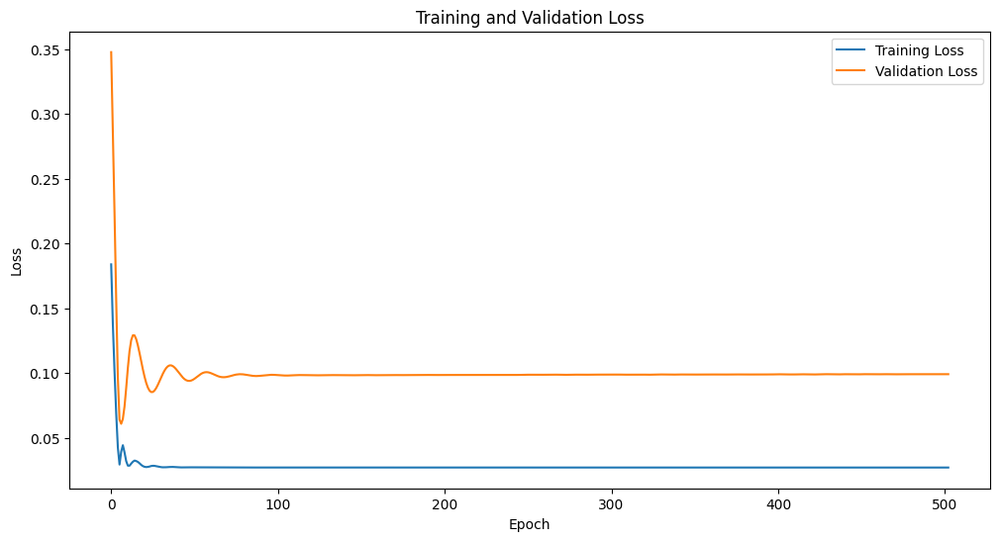

Epoch [1/2500], Train Loss: 0.0934, Val Loss: 0.2210
Epoch [2/2500], Train Loss: 0.0661, Val Loss: 0.1768
Epoch [3/2500], Train Loss: 0.0463, Val Loss: 0.1356
Epoch [4/2500], Train Loss: 0.0325, Val Loss: 0.0973
Epoch [5/2500], Train Loss: 0.0273, Val Loss: 0.0730
Epoch [6/2500], Train Loss: 0.0338, Val Loss: 0.0709
Epoch [7/2500], Train Loss: 0.0355, Val Loss: 0.0763
Epoch [8/2500], Train Loss: 0.0319, Val Loss: 0.0851
Epoch [9/2500], Train Loss: 0.0288, Val Loss: 0.0946
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1031
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.1097
Epoch [12/2500], Train Loss: 0.0276, Val Loss: 0.1141
Epoch [13/2500], Train Loss: 0.0281, Val Loss: 0.1164
Epoch [14/2500], Train Loss: 0.0284, Val Loss: 0.1168
Epoch [15/2500], Train Loss: 0.0284, Val Loss: 0.1156
Epoch [16/2500], Train Loss: 0.0283, Val Loss: 0.1134
Epoch [17/2500], Train Loss: 0.0280, Val Loss: 0.1103
Epoch [18/2500], Train Loss: 0.0276, Val Loss: 0.1067
Epoch [19/2500], Train Loss: 0.0273, 

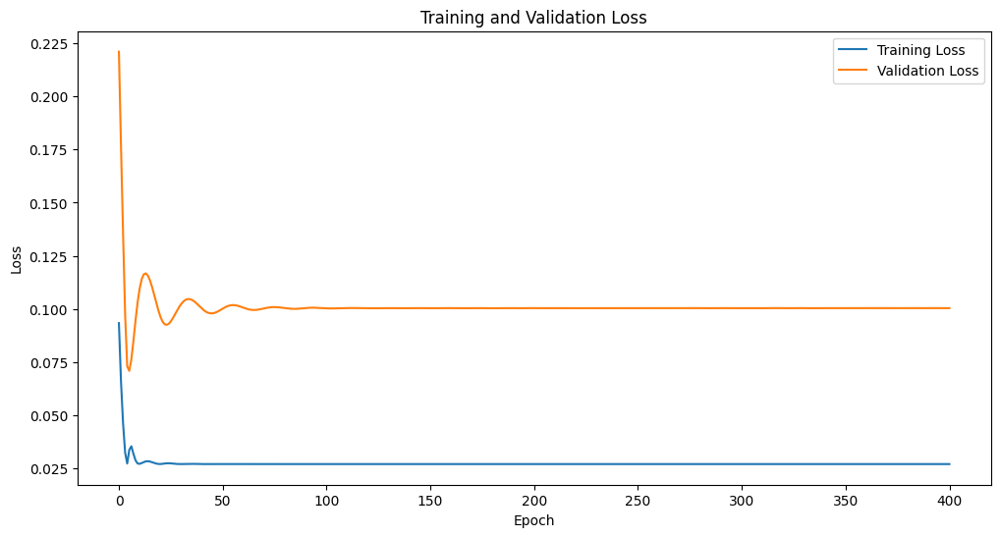

Epoch [1/2500], Train Loss: 0.0444, Val Loss: 0.1244
Epoch [2/2500], Train Loss: 0.0298, Val Loss: 0.0887
Epoch [3/2500], Train Loss: 0.0281, Val Loss: 0.0778
Epoch [4/2500], Train Loss: 0.0313, Val Loss: 0.0823
Epoch [5/2500], Train Loss: 0.0296, Val Loss: 0.0923
Epoch [6/2500], Train Loss: 0.0275, Val Loss: 0.1036
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.1124
Epoch [8/2500], Train Loss: 0.0278, Val Loss: 0.1161
Epoch [9/2500], Train Loss: 0.0283, Val Loss: 0.1153
Epoch [10/2500], Train Loss: 0.0282, Val Loss: 0.1119
Epoch [11/2500], Train Loss: 0.0278, Val Loss: 0.1074
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.1027
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0986
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.0955
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.0936
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0928
Epoch [17/2500], Train Loss: 0.0275, Val Loss: 0.0932
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.0945
Epoch [19/2500], Train Loss: 0.0273, 

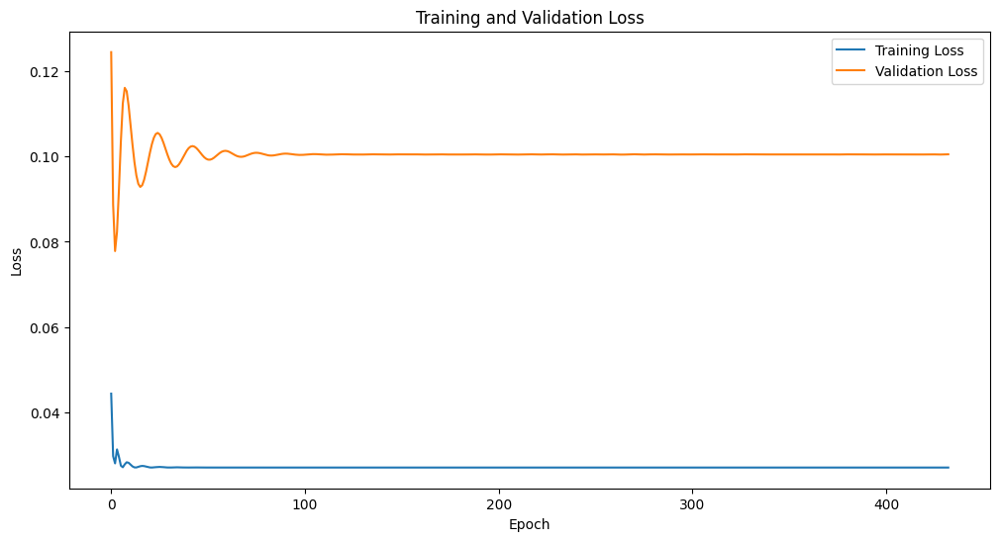

Epoch [1/2500], Train Loss: 0.1108, Val Loss: 0.2269
Epoch [2/2500], Train Loss: 0.0695, Val Loss: 0.1528
Epoch [3/2500], Train Loss: 0.0383, Val Loss: 0.0885
Epoch [4/2500], Train Loss: 0.0282, Val Loss: 0.0627
Epoch [5/2500], Train Loss: 0.0437, Val Loss: 0.0645
Epoch [6/2500], Train Loss: 0.0413, Val Loss: 0.0747
Epoch [7/2500], Train Loss: 0.0322, Val Loss: 0.0903
Epoch [8/2500], Train Loss: 0.0279, Val Loss: 0.1065
Epoch [9/2500], Train Loss: 0.0276, Val Loss: 0.1192
Epoch [10/2500], Train Loss: 0.0291, Val Loss: 0.1269
Epoch [11/2500], Train Loss: 0.0306, Val Loss: 0.1298
Epoch [12/2500], Train Loss: 0.0313, Val Loss: 0.1288
Epoch [13/2500], Train Loss: 0.0309, Val Loss: 0.1251
Epoch [14/2500], Train Loss: 0.0301, Val Loss: 0.1197
Epoch [15/2500], Train Loss: 0.0291, Val Loss: 0.1134
Epoch [16/2500], Train Loss: 0.0281, Val Loss: 0.1068
Epoch [17/2500], Train Loss: 0.0274, Val Loss: 0.1006
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.0952
Epoch [19/2500], Train Loss: 0.0273, 

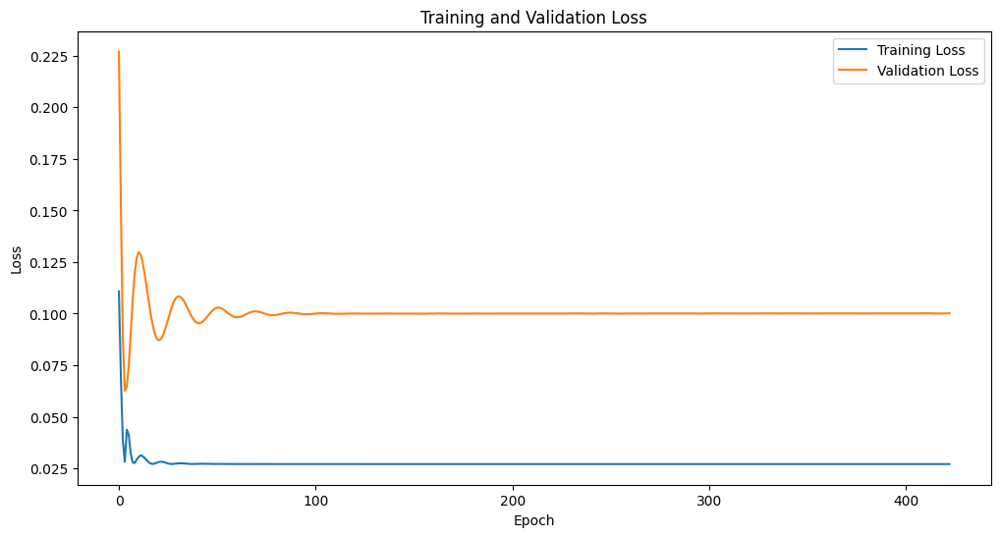

Epoch [1/2500], Train Loss: 0.0448, Val Loss: 0.1356
Epoch [2/2500], Train Loss: 0.0324, Val Loss: 0.1095
Epoch [3/2500], Train Loss: 0.0276, Val Loss: 0.0903
Epoch [4/2500], Train Loss: 0.0278, Val Loss: 0.0829
Epoch [5/2500], Train Loss: 0.0294, Val Loss: 0.0836
Epoch [6/2500], Train Loss: 0.0292, Val Loss: 0.0874
Epoch [7/2500], Train Loss: 0.0283, Val Loss: 0.0923
Epoch [8/2500], Train Loss: 0.0275, Val Loss: 0.0971
Epoch [9/2500], Train Loss: 0.0272, Val Loss: 0.1014
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.1048
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.1070
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.1081
Epoch [13/2500], Train Loss: 0.0274, Val Loss: 0.1083
Epoch [14/2500], Train Loss: 0.0274, Val Loss: 0.1077
Epoch [15/2500], Train Loss: 0.0274, Val Loss: 0.1065
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.1051
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.1034
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1017
Epoch [19/2500], Train Loss: 0.0271, 

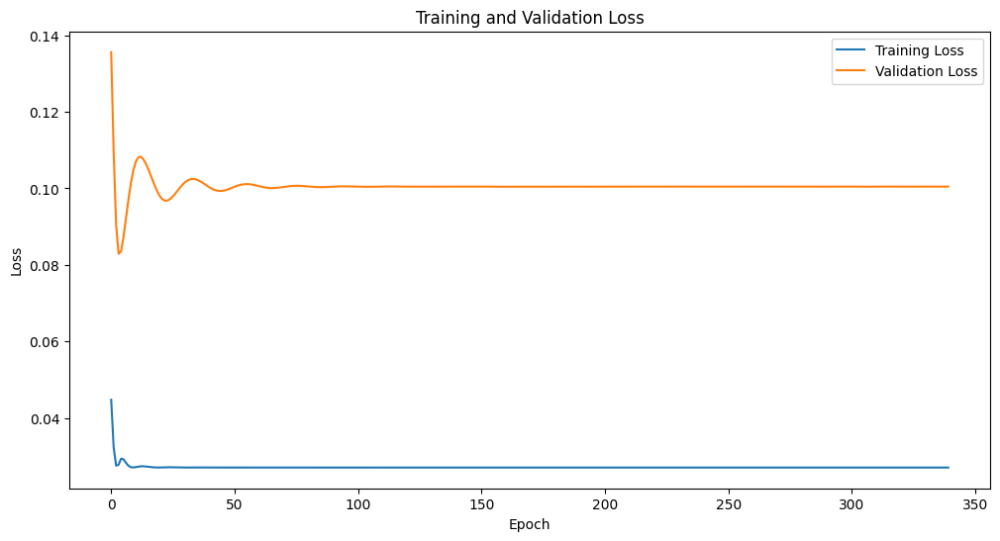

Epoch [1/2500], Train Loss: 0.0324, Val Loss: 0.0980
Epoch [2/2500], Train Loss: 0.0271, Val Loss: 0.0824
Epoch [3/2500], Train Loss: 0.0295, Val Loss: 0.0864
Epoch [4/2500], Train Loss: 0.0285, Val Loss: 0.0955
Epoch [5/2500], Train Loss: 0.0273, Val Loss: 0.1045
Epoch [6/2500], Train Loss: 0.0272, Val Loss: 0.1106
Epoch [7/2500], Train Loss: 0.0276, Val Loss: 0.1127
Epoch [8/2500], Train Loss: 0.0279, Val Loss: 0.1115
Epoch [9/2500], Train Loss: 0.0277, Val Loss: 0.1082
Epoch [10/2500], Train Loss: 0.0274, Val Loss: 0.1039
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0997
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.0963
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.0942
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0936
Epoch [15/2500], Train Loss: 0.0274, Val Loss: 0.0943
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0961
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0984
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1008
Epoch [19/2500], Train Loss: 0.0271, 

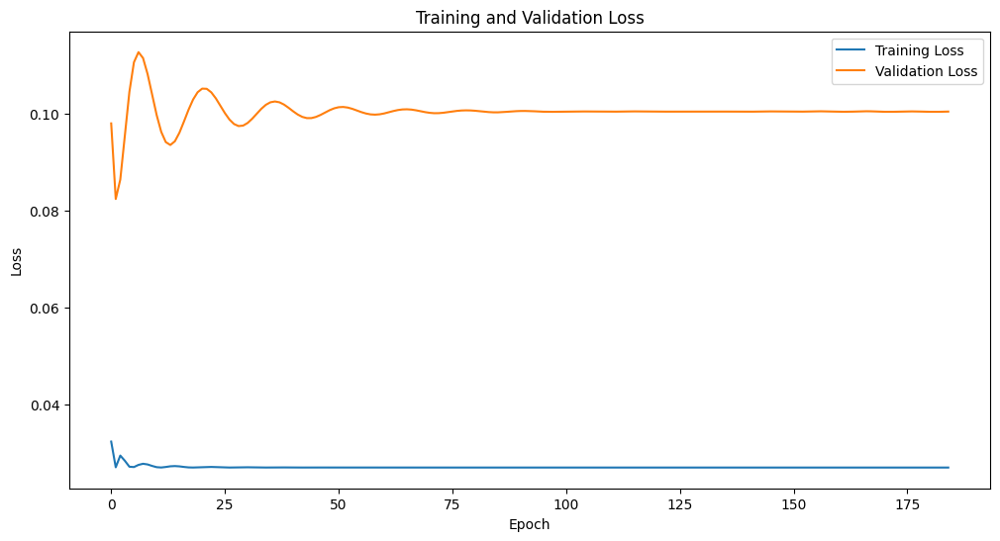

Epoch [1/2500], Train Loss: 0.1756, Val Loss: 0.3281
Epoch [2/2500], Train Loss: 0.1258, Val Loss: 0.2518
Epoch [3/2500], Train Loss: 0.0832, Val Loss: 0.1705
Epoch [4/2500], Train Loss: 0.0454, Val Loss: 0.0939
Epoch [5/2500], Train Loss: 0.0285, Val Loss: 0.0594
Epoch [6/2500], Train Loss: 0.0507, Val Loss: 0.0594
Epoch [7/2500], Train Loss: 0.0511, Val Loss: 0.0669
Epoch [8/2500], Train Loss: 0.0383, Val Loss: 0.0844
Epoch [9/2500], Train Loss: 0.0292, Val Loss: 0.1067
Epoch [10/2500], Train Loss: 0.0282, Val Loss: 0.1261
Epoch [11/2500], Train Loss: 0.0311, Val Loss: 0.1380
Epoch [12/2500], Train Loss: 0.0339, Val Loss: 0.1420
Epoch [13/2500], Train Loss: 0.0349, Val Loss: 0.1397
Epoch [14/2500], Train Loss: 0.0341, Val Loss: 0.1332
Epoch [15/2500], Train Loss: 0.0324, Val Loss: 0.1244
Epoch [16/2500], Train Loss: 0.0304, Val Loss: 0.1145
Epoch [17/2500], Train Loss: 0.0286, Val Loss: 0.1050
Epoch [18/2500], Train Loss: 0.0276, Val Loss: 0.0968
Epoch [19/2500], Train Loss: 0.0274, 

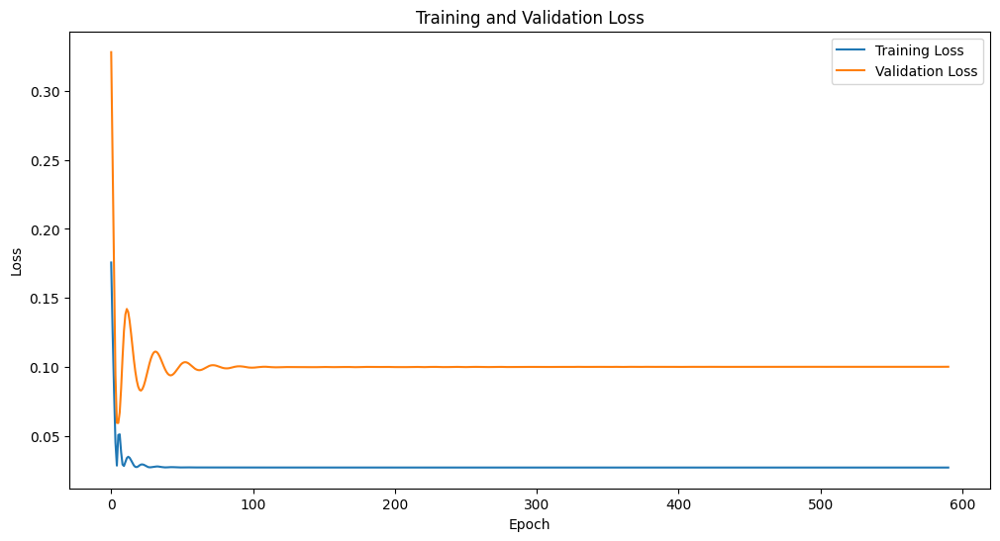

Epoch [1/2500], Train Loss: 0.0474, Val Loss: 0.1066
Epoch [2/2500], Train Loss: 0.0275, Val Loss: 0.0618
Epoch [3/2500], Train Loss: 0.0433, Val Loss: 0.0825
Epoch [4/2500], Train Loss: 0.0291, Val Loss: 0.1076
Epoch [5/2500], Train Loss: 0.0274, Val Loss: 0.1235
Epoch [6/2500], Train Loss: 0.0294, Val Loss: 0.1288
Epoch [7/2500], Train Loss: 0.0305, Val Loss: 0.1273
Epoch [8/2500], Train Loss: 0.0302, Val Loss: 0.1219
Epoch [9/2500], Train Loss: 0.0292, Val Loss: 0.1148
Epoch [10/2500], Train Loss: 0.0281, Val Loss: 0.1072
Epoch [11/2500], Train Loss: 0.0274, Val Loss: 0.0999
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.0938
Epoch [13/2500], Train Loss: 0.0273, Val Loss: 0.0897
Epoch [14/2500], Train Loss: 0.0277, Val Loss: 0.0881
Epoch [15/2500], Train Loss: 0.0280, Val Loss: 0.0888
Epoch [16/2500], Train Loss: 0.0279, Val Loss: 0.0911
Epoch [17/2500], Train Loss: 0.0276, Val Loss: 0.0946
Epoch [18/2500], Train Loss: 0.0273, Val Loss: 0.0984
Epoch [19/2500], Train Loss: 0.0271, 

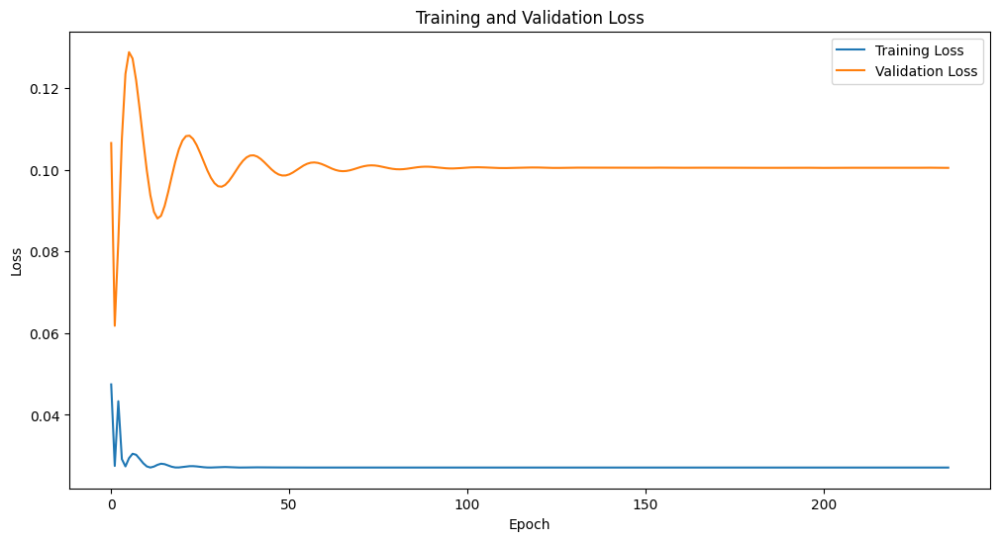

Epoch [1/2500], Train Loss: 0.0355, Val Loss: 0.0903
Epoch [2/2500], Train Loss: 0.0276, Val Loss: 0.0831
Epoch [3/2500], Train Loss: 0.0292, Val Loss: 0.0946
Epoch [4/2500], Train Loss: 0.0273, Val Loss: 0.1064
Epoch [5/2500], Train Loss: 0.0272, Val Loss: 0.1122
Epoch [6/2500], Train Loss: 0.0277, Val Loss: 0.1117
Epoch [7/2500], Train Loss: 0.0277, Val Loss: 0.1080
Epoch [8/2500], Train Loss: 0.0274, Val Loss: 0.1032
Epoch [9/2500], Train Loss: 0.0271, Val Loss: 0.0987
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.0955
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0941
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0944
Epoch [13/2500], Train Loss: 0.0273, Val Loss: 0.0961
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0984
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.1009
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.1031
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1045
Epoch [18/2500], Train Loss: 0.0272, Val Loss: 0.1052
Epoch [19/2500], Train Loss: 0.0272, 

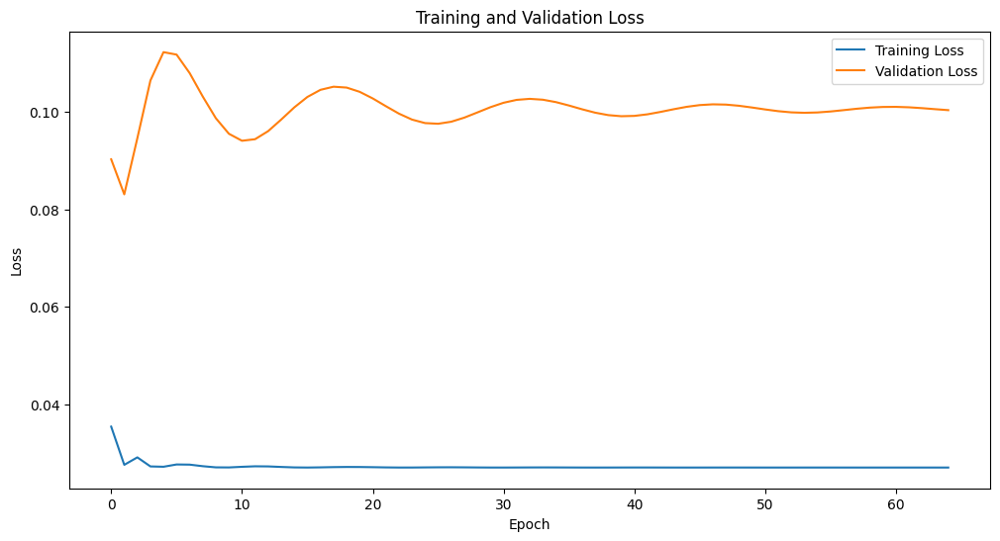

Epoch [1/2500], Train Loss: 0.1268, Val Loss: 0.2238
Epoch [2/2500], Train Loss: 0.0675, Val Loss: 0.1230
Epoch [3/2500], Train Loss: 0.0302, Val Loss: 0.0583
Epoch [4/2500], Train Loss: 0.0564, Val Loss: 0.0689
Epoch [5/2500], Train Loss: 0.0360, Val Loss: 0.0987
Epoch [6/2500], Train Loss: 0.0275, Val Loss: 0.1268
Epoch [7/2500], Train Loss: 0.0304, Val Loss: 0.1422
Epoch [8/2500], Train Loss: 0.0343, Val Loss: 0.1456
Epoch [9/2500], Train Loss: 0.0352, Val Loss: 0.1409
Epoch [10/2500], Train Loss: 0.0341, Val Loss: 0.1313
Epoch [11/2500], Train Loss: 0.0316, Val Loss: 0.1193
Epoch [12/2500], Train Loss: 0.0291, Val Loss: 0.1069
Epoch [13/2500], Train Loss: 0.0275, Val Loss: 0.0958
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0874
Epoch [15/2500], Train Loss: 0.0281, Val Loss: 0.0825
Epoch [16/2500], Train Loss: 0.0291, Val Loss: 0.0809
Epoch [17/2500], Train Loss: 0.0296, Val Loss: 0.0822
Epoch [18/2500], Train Loss: 0.0293, Val Loss: 0.0856
Epoch [19/2500], Train Loss: 0.0285, 

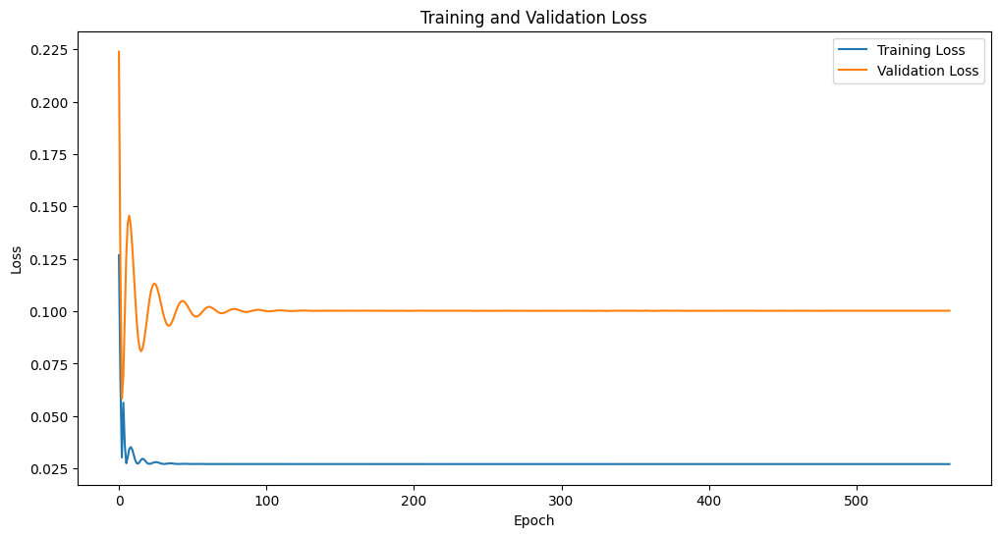

Epoch [1/2500], Train Loss: 0.0667, Val Loss: 0.1456
Epoch [2/2500], Train Loss: 0.0353, Val Loss: 0.0742
Epoch [3/2500], Train Loss: 0.0330, Val Loss: 0.0807
Epoch [4/2500], Train Loss: 0.0301, Val Loss: 0.0999
Epoch [5/2500], Train Loss: 0.0271, Val Loss: 0.1149
Epoch [6/2500], Train Loss: 0.0282, Val Loss: 0.1201
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.1172
Epoch [8/2500], Train Loss: 0.0285, Val Loss: 0.1099
Epoch [9/2500], Train Loss: 0.0276, Val Loss: 0.1012
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.0937
Epoch [11/2500], Train Loss: 0.0274, Val Loss: 0.0896
Epoch [12/2500], Train Loss: 0.0279, Val Loss: 0.0895
Epoch [13/2500], Train Loss: 0.0279, Val Loss: 0.0926
Epoch [14/2500], Train Loss: 0.0275, Val Loss: 0.0974
Epoch [15/2500], Train Loss: 0.0272, Val Loss: 0.1024
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.1064
Epoch [17/2500], Train Loss: 0.0273, Val Loss: 0.1086
Epoch [18/2500], Train Loss: 0.0275, Val Loss: 0.1089
Epoch [19/2500], Train Loss: 0.0275, 

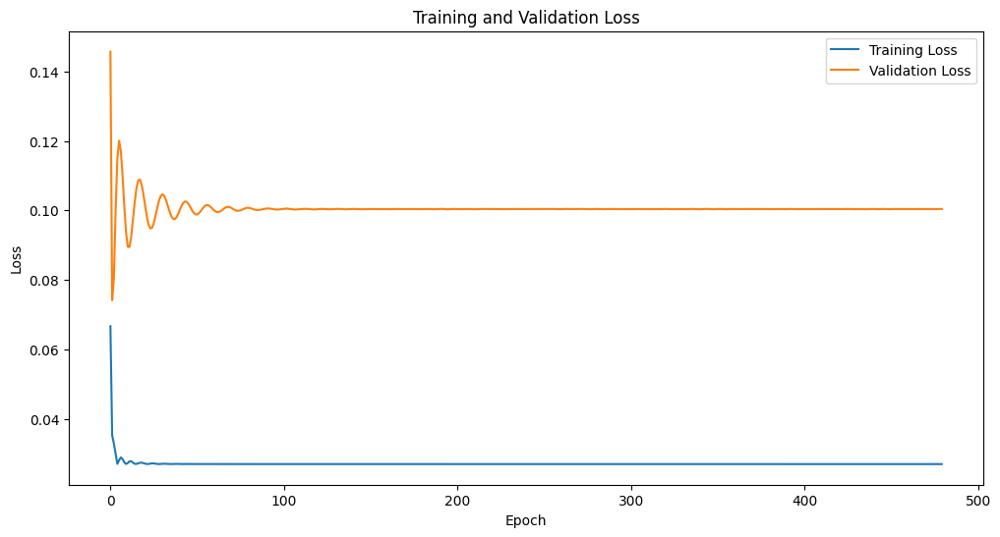

Epoch [1/2500], Train Loss: 0.0439, Val Loss: 0.1161
Epoch [2/2500], Train Loss: 0.0283, Val Loss: 0.0774
Epoch [3/2500], Train Loss: 0.0315, Val Loss: 0.0857
Epoch [4/2500], Train Loss: 0.0286, Val Loss: 0.1000
Epoch [5/2500], Train Loss: 0.0271, Val Loss: 0.1109
Epoch [6/2500], Train Loss: 0.0277, Val Loss: 0.1152
Epoch [7/2500], Train Loss: 0.0282, Val Loss: 0.1143
Epoch [8/2500], Train Loss: 0.0281, Val Loss: 0.1104
Epoch [9/2500], Train Loss: 0.0276, Val Loss: 0.1053
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.1001
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0958
Epoch [12/2500], Train Loss: 0.0272, Val Loss: 0.0933
Epoch [13/2500], Train Loss: 0.0274, Val Loss: 0.0928
Epoch [14/2500], Train Loss: 0.0275, Val Loss: 0.0939
Epoch [15/2500], Train Loss: 0.0274, Val Loss: 0.0962
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.0989
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1015
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1037
Epoch [19/2500], Train Loss: 0.0271, 

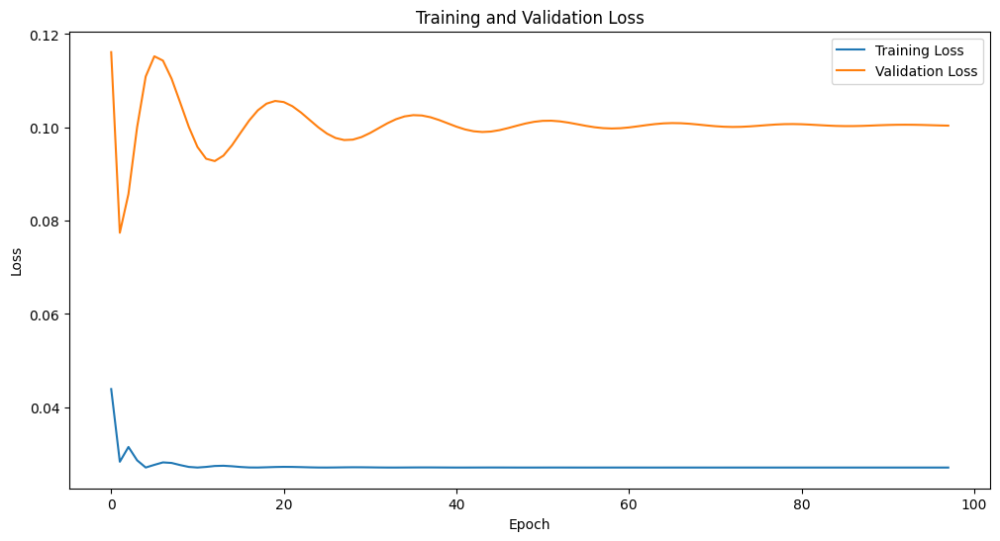

Epoch [1/2500], Train Loss: 0.0583, Val Loss: 0.1438
Epoch [2/2500], Train Loss: 0.0347, Val Loss: 0.0881
Epoch [3/2500], Train Loss: 0.0281, Val Loss: 0.0783
Epoch [4/2500], Train Loss: 0.0311, Val Loss: 0.0937
Epoch [5/2500], Train Loss: 0.0275, Val Loss: 0.1084
Epoch [6/2500], Train Loss: 0.0275, Val Loss: 0.1155
Epoch [7/2500], Train Loss: 0.0283, Val Loss: 0.1155
Epoch [8/2500], Train Loss: 0.0283, Val Loss: 0.1111
Epoch [9/2500], Train Loss: 0.0277, Val Loss: 0.1051
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0990
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0942
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0919
Epoch [13/2500], Train Loss: 0.0276, Val Loss: 0.0920
Epoch [14/2500], Train Loss: 0.0276, Val Loss: 0.0941
Epoch [15/2500], Train Loss: 0.0274, Val Loss: 0.0973
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.1007
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1038
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1059
Epoch [19/2500], Train Loss: 0.0272, 

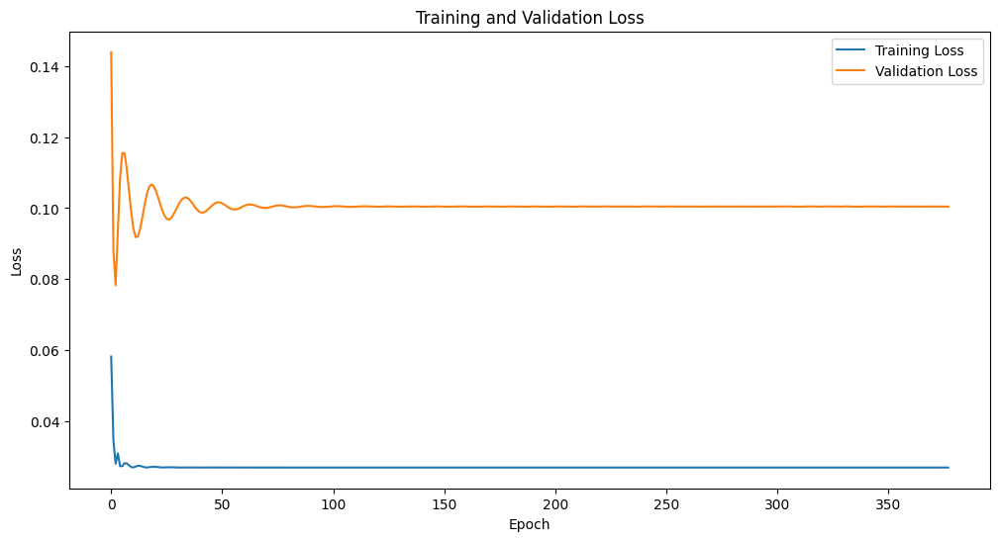

Epoch [1/2500], Train Loss: 0.0813, Val Loss: 0.1471
Epoch [2/2500], Train Loss: 0.0358, Val Loss: 0.0738
Epoch [3/2500], Train Loss: 0.0336, Val Loss: 0.0753
Epoch [4/2500], Train Loss: 0.0328, Val Loss: 0.0928
Epoch [5/2500], Train Loss: 0.0276, Val Loss: 0.1102
Epoch [6/2500], Train Loss: 0.0277, Val Loss: 0.1200
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.1216
Epoch [8/2500], Train Loss: 0.0292, Val Loss: 0.1177
Epoch [9/2500], Train Loss: 0.0286, Val Loss: 0.1109
Epoch [10/2500], Train Loss: 0.0277, Val Loss: 0.1031
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0959
Epoch [12/2500], Train Loss: 0.0272, Val Loss: 0.0911
Epoch [13/2500], Train Loss: 0.0277, Val Loss: 0.0896
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.0910
Epoch [15/2500], Train Loss: 0.0277, Val Loss: 0.0943
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.0984
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1024
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1055
Epoch [19/2500], Train Loss: 0.0273, 

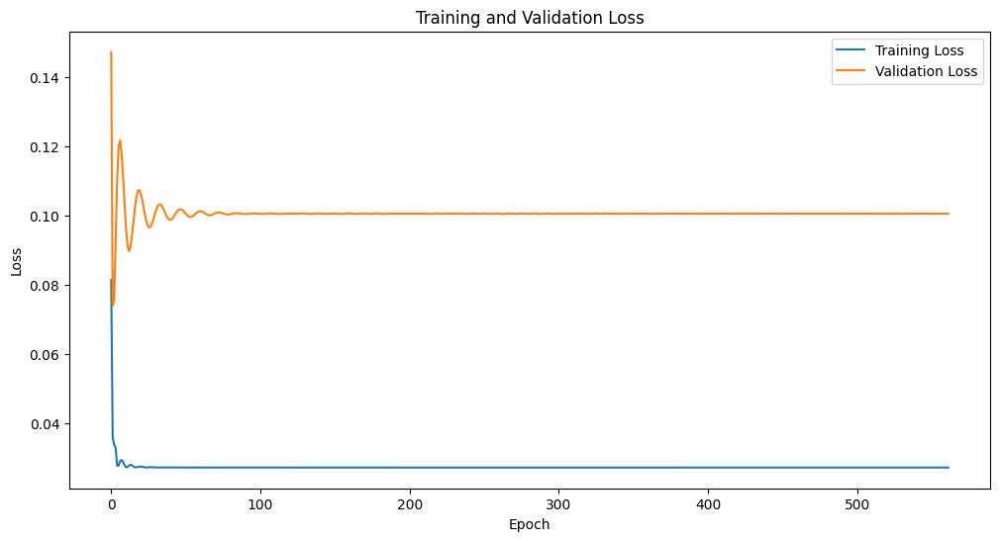

Epoch [1/2500], Train Loss: 0.0953, Val Loss: 0.1782
Epoch [2/2500], Train Loss: 0.0469, Val Loss: 0.0822
Epoch [3/2500], Train Loss: 0.0296, Val Loss: 0.0712
Epoch [4/2500], Train Loss: 0.0353, Val Loss: 0.0927
Epoch [5/2500], Train Loss: 0.0275, Val Loss: 0.1150
Epoch [6/2500], Train Loss: 0.0282, Val Loss: 0.1248
Epoch [7/2500], Train Loss: 0.0299, Val Loss: 0.1228
Epoch [8/2500], Train Loss: 0.0294, Val Loss: 0.1144
Epoch [9/2500], Train Loss: 0.0281, Val Loss: 0.1038
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0945
Epoch [11/2500], Train Loss: 0.0273, Val Loss: 0.0886
Epoch [12/2500], Train Loss: 0.0281, Val Loss: 0.0871
Epoch [13/2500], Train Loss: 0.0283, Val Loss: 0.0895
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.0945
Epoch [15/2500], Train Loss: 0.0273, Val Loss: 0.1004
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.1058
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.1095
Epoch [18/2500], Train Loss: 0.0275, Val Loss: 0.1110
Epoch [19/2500], Train Loss: 0.0277, 

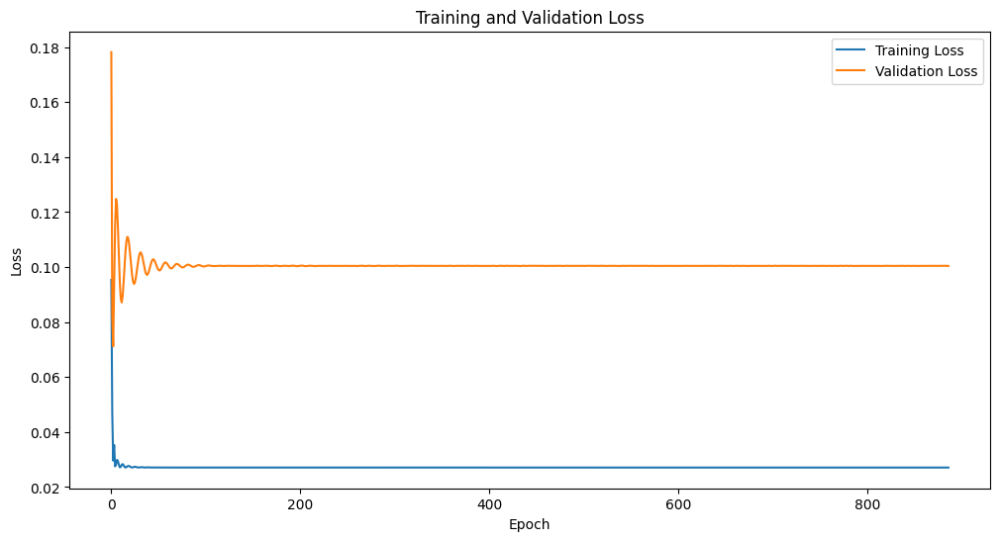

Epoch [1/2500], Train Loss: 0.0850, Val Loss: 0.1683
Epoch [2/2500], Train Loss: 0.0431, Val Loss: 0.0852
Epoch [3/2500], Train Loss: 0.0289, Val Loss: 0.0692
Epoch [4/2500], Train Loss: 0.0364, Val Loss: 0.0905
Epoch [5/2500], Train Loss: 0.0280, Val Loss: 0.1152
Epoch [6/2500], Train Loss: 0.0285, Val Loss: 0.1262
Epoch [7/2500], Train Loss: 0.0304, Val Loss: 0.1238
Epoch [8/2500], Train Loss: 0.0298, Val Loss: 0.1150
Epoch [9/2500], Train Loss: 0.0284, Val Loss: 0.1043
Epoch [10/2500], Train Loss: 0.0273, Val Loss: 0.0948
Epoch [11/2500], Train Loss: 0.0274, Val Loss: 0.0889
Epoch [12/2500], Train Loss: 0.0281, Val Loss: 0.0876
Epoch [13/2500], Train Loss: 0.0283, Val Loss: 0.0900
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.0946
Epoch [15/2500], Train Loss: 0.0274, Val Loss: 0.1000
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.1049
Epoch [17/2500], Train Loss: 0.0273, Val Loss: 0.1082
Epoch [18/2500], Train Loss: 0.0275, Val Loss: 0.1097
Epoch [19/2500], Train Loss: 0.0276, 

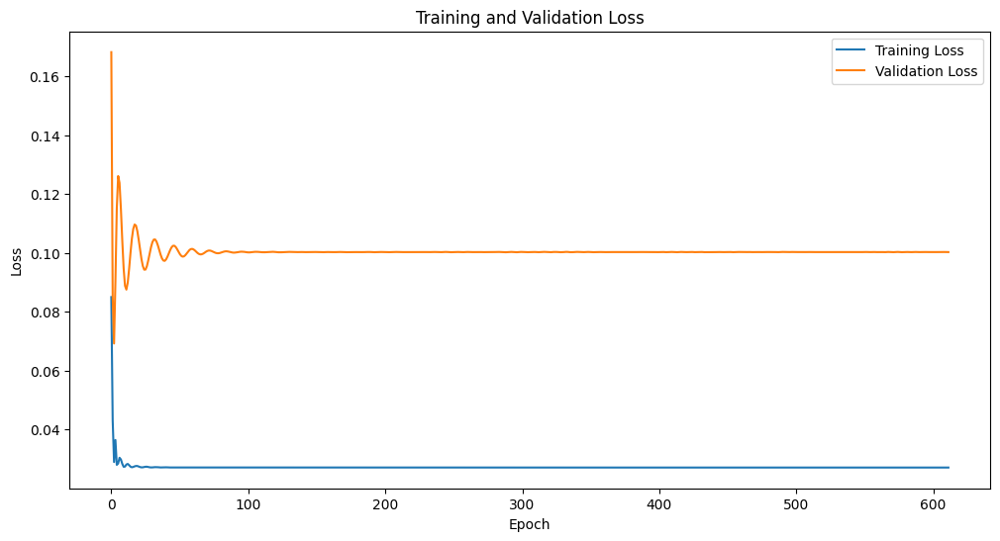

Epoch [1/2500], Train Loss: 0.0977, Val Loss: 0.1872
Epoch [2/2500], Train Loss: 0.0506, Val Loss: 0.0996
Epoch [3/2500], Train Loss: 0.0272, Val Loss: 0.0588
Epoch [4/2500], Train Loss: 0.0568, Val Loss: 0.0772
Epoch [5/2500], Train Loss: 0.0316, Val Loss: 0.1076
Epoch [6/2500], Train Loss: 0.0274, Val Loss: 0.1296
Epoch [7/2500], Train Loss: 0.0310, Val Loss: 0.1393
Epoch [8/2500], Train Loss: 0.0334, Val Loss: 0.1396
Epoch [9/2500], Train Loss: 0.0334, Val Loss: 0.1339
Epoch [10/2500], Train Loss: 0.0319, Val Loss: 0.1247
Epoch [11/2500], Train Loss: 0.0298, Val Loss: 0.1138
Epoch [12/2500], Train Loss: 0.0280, Val Loss: 0.1026
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0929
Epoch [14/2500], Train Loss: 0.0275, Val Loss: 0.0864
Epoch [15/2500], Train Loss: 0.0285, Val Loss: 0.0840
Epoch [16/2500], Train Loss: 0.0291, Val Loss: 0.0853
Epoch [17/2500], Train Loss: 0.0287, Val Loss: 0.0895
Epoch [18/2500], Train Loss: 0.0279, Val Loss: 0.0955
Epoch [19/2500], Train Loss: 0.0273, 

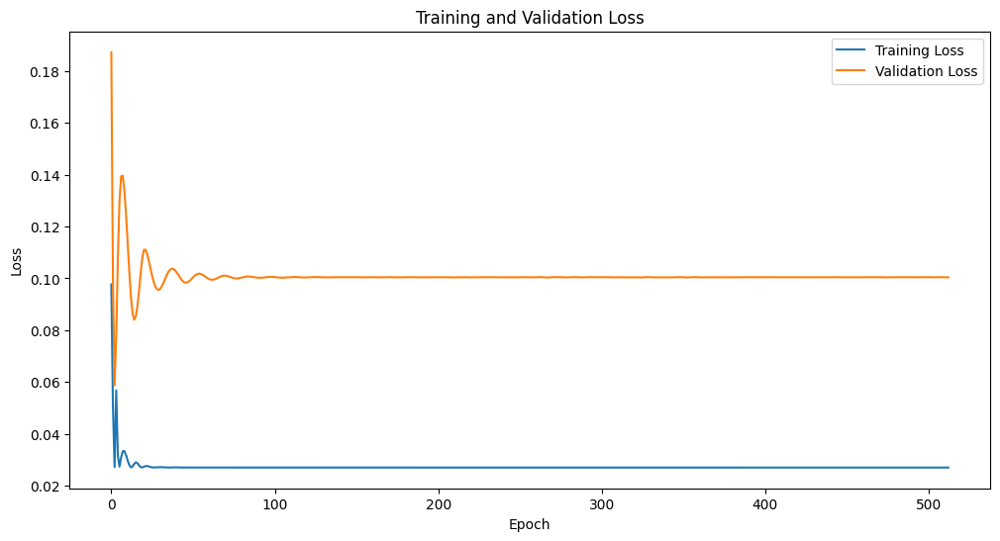

Epoch [1/2500], Train Loss: 0.1279, Val Loss: 0.2206
Epoch [2/2500], Train Loss: 0.0659, Val Loss: 0.1197
Epoch [3/2500], Train Loss: 0.0290, Val Loss: 0.0579
Epoch [4/2500], Train Loss: 0.0696, Val Loss: 0.0718
Epoch [5/2500], Train Loss: 0.0347, Val Loss: 0.1074
Epoch [6/2500], Train Loss: 0.0274, Val Loss: 0.1350
Epoch [7/2500], Train Loss: 0.0322, Val Loss: 0.1462
Epoch [8/2500], Train Loss: 0.0354, Val Loss: 0.1456
Epoch [9/2500], Train Loss: 0.0352, Val Loss: 0.1384
Epoch [10/2500], Train Loss: 0.0331, Val Loss: 0.1280
Epoch [11/2500], Train Loss: 0.0305, Val Loss: 0.1164
Epoch [12/2500], Train Loss: 0.0284, Val Loss: 0.1053
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.0957
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0885
Epoch [15/2500], Train Loss: 0.0281, Val Loss: 0.0844
Epoch [16/2500], Train Loss: 0.0290, Val Loss: 0.0831
Epoch [17/2500], Train Loss: 0.0293, Val Loss: 0.0843
Epoch [18/2500], Train Loss: 0.0290, Val Loss: 0.0874
Epoch [19/2500], Train Loss: 0.0283, 

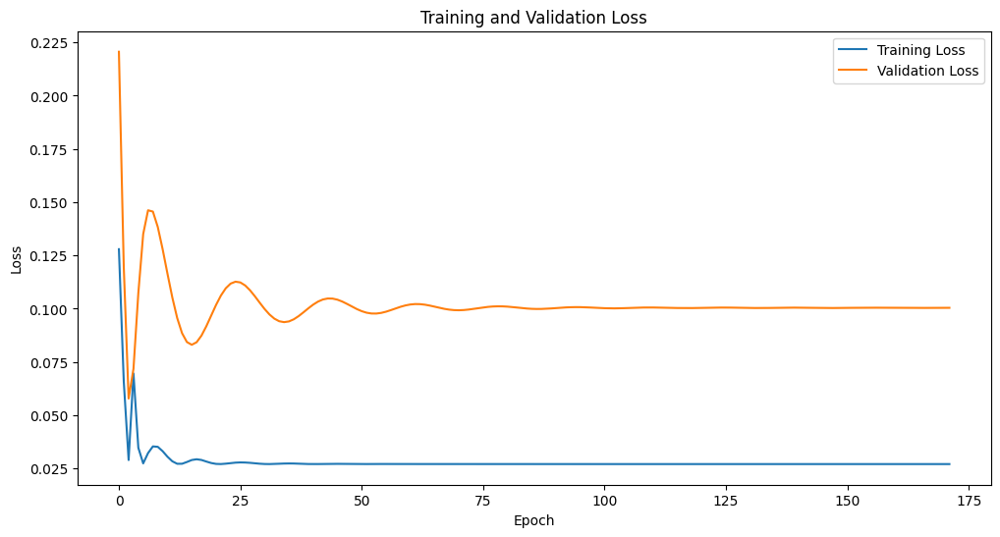

Epoch [1/2500], Train Loss: 0.0724, Val Loss: 0.1365
Epoch [2/2500], Train Loss: 0.0329, Val Loss: 0.0644
Epoch [3/2500], Train Loss: 0.0418, Val Loss: 0.0779
Epoch [4/2500], Train Loss: 0.0312, Val Loss: 0.1006
Epoch [5/2500], Train Loss: 0.0273, Val Loss: 0.1178
Epoch [6/2500], Train Loss: 0.0287, Val Loss: 0.1259
Epoch [7/2500], Train Loss: 0.0302, Val Loss: 0.1267
Epoch [8/2500], Train Loss: 0.0303, Val Loss: 0.1228
Epoch [9/2500], Train Loss: 0.0295, Val Loss: 0.1161
Epoch [10/2500], Train Loss: 0.0284, Val Loss: 0.1083
Epoch [11/2500], Train Loss: 0.0275, Val Loss: 0.1005
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.0938
Epoch [13/2500], Train Loss: 0.0274, Val Loss: 0.0896
Epoch [14/2500], Train Loss: 0.0279, Val Loss: 0.0881
Epoch [15/2500], Train Loss: 0.0281, Val Loss: 0.0889
Epoch [16/2500], Train Loss: 0.0280, Val Loss: 0.0915
Epoch [17/2500], Train Loss: 0.0276, Val Loss: 0.0950
Epoch [18/2500], Train Loss: 0.0273, Val Loss: 0.0988
Epoch [19/2500], Train Loss: 0.0271, 

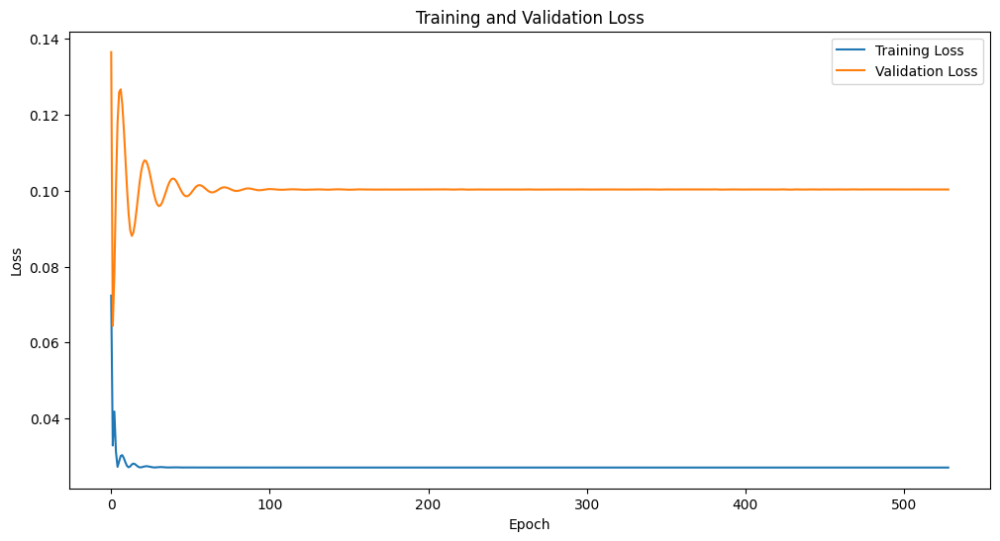

Epoch [1/2500], Train Loss: 0.0999, Val Loss: 0.1142
Epoch [2/2500], Train Loss: 0.0287, Val Loss: 0.1863
Epoch [3/2500], Train Loss: 0.2736, Val Loss: 0.0951
Epoch [4/2500], Train Loss: 0.0273, Val Loss: 0.1837
Epoch [5/2500], Train Loss: 0.0485, Val Loss: 0.2154
Epoch [6/2500], Train Loss: 0.0630, Val Loss: 0.2201
Epoch [7/2500], Train Loss: 0.0662, Val Loss: 0.2149
Epoch [8/2500], Train Loss: 0.0643, Val Loss: 0.2053
Epoch [9/2500], Train Loss: 0.0600, Val Loss: 0.1927
Epoch [10/2500], Train Loss: 0.0546, Val Loss: 0.1763
Epoch [11/2500], Train Loss: 0.0480, Val Loss: 0.1541
Epoch [12/2500], Train Loss: 0.0402, Val Loss: 0.1233
Epoch [13/2500], Train Loss: 0.0319, Val Loss: 0.0848
Epoch [14/2500], Train Loss: 0.0277, Val Loss: 0.0614
Epoch [15/2500], Train Loss: 0.0365, Val Loss: 0.0646
Epoch [16/2500], Train Loss: 0.0344, Val Loss: 0.0789
Epoch [17/2500], Train Loss: 0.0288, Val Loss: 0.0974
Epoch [18/2500], Train Loss: 0.0273, Val Loss: 0.1121
Epoch [19/2500], Train Loss: 0.0280, 

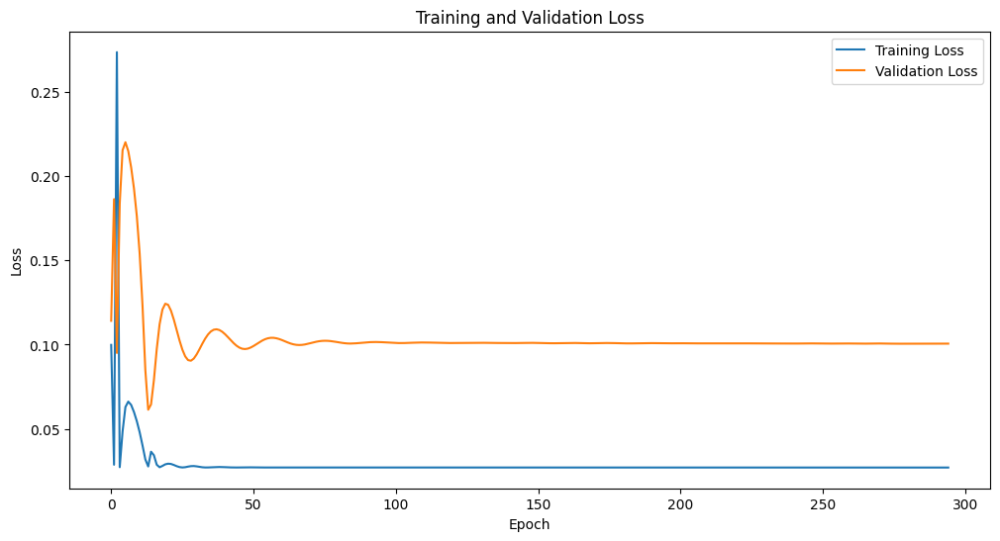

Epoch [1/2500], Train Loss: 0.0986, Val Loss: 0.1402
Epoch [2/2500], Train Loss: 0.0340, Val Loss: 0.0605
Epoch [3/2500], Train Loss: 0.0826, Val Loss: 0.1000
Epoch [4/2500], Train Loss: 0.0271, Val Loss: 0.1456
Epoch [5/2500], Train Loss: 0.0348, Val Loss: 0.1599
Epoch [6/2500], Train Loss: 0.0399, Val Loss: 0.1583
Epoch [7/2500], Train Loss: 0.0397, Val Loss: 0.1495
Epoch [8/2500], Train Loss: 0.0371, Val Loss: 0.1367
Epoch [9/2500], Train Loss: 0.0335, Val Loss: 0.1210
Epoch [10/2500], Train Loss: 0.0299, Val Loss: 0.1026
Epoch [11/2500], Train Loss: 0.0275, Val Loss: 0.0834
Epoch [12/2500], Train Loss: 0.0278, Val Loss: 0.0745
Epoch [13/2500], Train Loss: 0.0299, Val Loss: 0.0775
Epoch [14/2500], Train Loss: 0.0294, Val Loss: 0.0856
Epoch [15/2500], Train Loss: 0.0279, Val Loss: 0.0946
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.1023
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1078
Epoch [18/2500], Train Loss: 0.0274, Val Loss: 0.1112
Epoch [19/2500], Train Loss: 0.0276, 

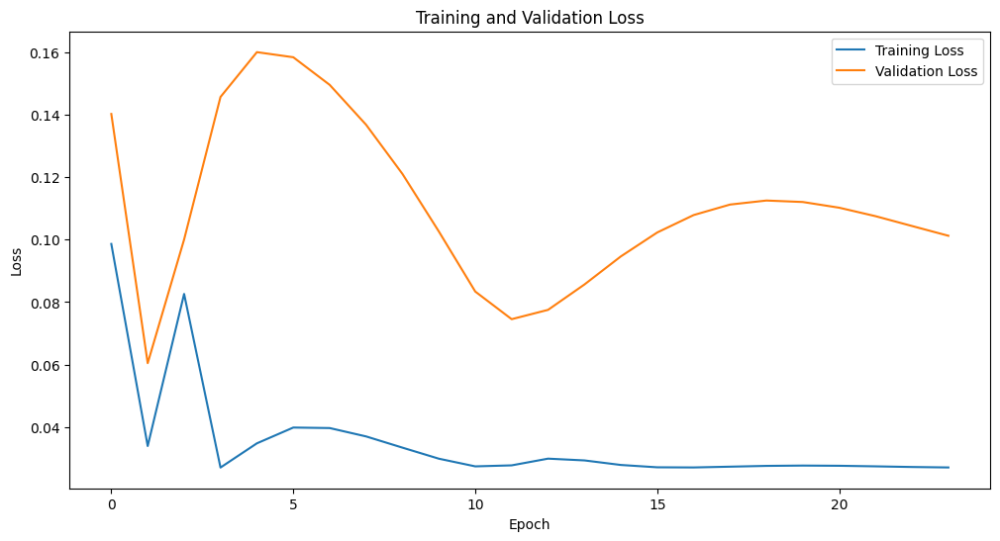

Epoch [1/2500], Train Loss: 0.0699, Val Loss: 0.0904
Epoch [2/2500], Train Loss: 0.0276, Val Loss: 0.0839
Epoch [3/2500], Train Loss: 0.0291, Val Loss: 0.1374
Epoch [4/2500], Train Loss: 0.0322, Val Loss: 0.1122
Epoch [5/2500], Train Loss: 0.0278, Val Loss: 0.0861
Epoch [6/2500], Train Loss: 0.0284, Val Loss: 0.0836
Epoch [7/2500], Train Loss: 0.0290, Val Loss: 0.0950
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.1073
Epoch [9/2500], Train Loss: 0.0274, Val Loss: 0.1137
Epoch [10/2500], Train Loss: 0.0281, Val Loss: 0.1133
Epoch [11/2500], Train Loss: 0.0281, Val Loss: 0.1080
Epoch [12/2500], Train Loss: 0.0275, Val Loss: 0.1005
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0937
Epoch [14/2500], Train Loss: 0.0273, Val Loss: 0.0902
Epoch [15/2500], Train Loss: 0.0277, Val Loss: 0.0909
Epoch [16/2500], Train Loss: 0.0276, Val Loss: 0.0947
Epoch [17/2500], Train Loss: 0.0272, Val Loss: 0.0998
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1042
Epoch [19/2500], Train Loss: 0.0272, 

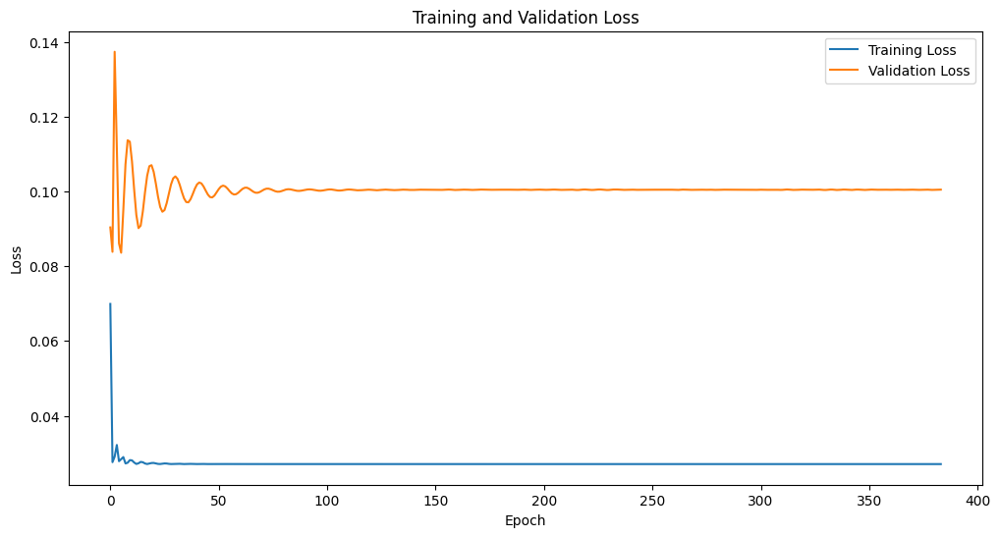

Epoch [1/2500], Train Loss: 0.0687, Val Loss: 0.0978
Epoch [2/2500], Train Loss: 0.0272, Val Loss: 0.0736
Epoch [3/2500], Train Loss: 0.0337, Val Loss: 0.1154
Epoch [4/2500], Train Loss: 0.0282, Val Loss: 0.1166
Epoch [5/2500], Train Loss: 0.0284, Val Loss: 0.1042
Epoch [6/2500], Train Loss: 0.0272, Val Loss: 0.0946
Epoch [7/2500], Train Loss: 0.0273, Val Loss: 0.0989
Epoch [8/2500], Train Loss: 0.0271, Val Loss: 0.1079
Epoch [9/2500], Train Loss: 0.0274, Val Loss: 0.1052
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0988
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0956
Epoch [12/2500], Train Loss: 0.0273, Val Loss: 0.0967
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.1001
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.1030
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.1039
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.1025
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1002
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.0981
Epoch [19/2500], Train Loss: 0.0271, 

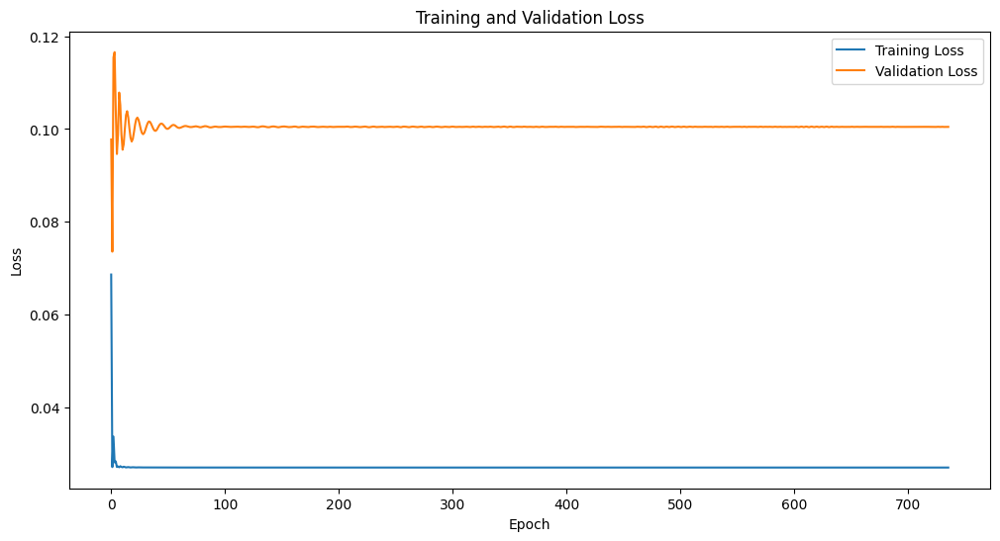

Epoch [1/2500], Train Loss: 0.0545, Val Loss: 0.0858
Epoch [2/2500], Train Loss: 0.0286, Val Loss: 0.1017
Epoch [3/2500], Train Loss: 0.0271, Val Loss: 0.1076
Epoch [4/2500], Train Loss: 0.0274, Val Loss: 0.1012
Epoch [5/2500], Train Loss: 0.0271, Val Loss: 0.0950
Epoch [6/2500], Train Loss: 0.0273, Val Loss: 0.1002
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.1046
Epoch [8/2500], Train Loss: 0.0272, Val Loss: 0.1030
Epoch [9/2500], Train Loss: 0.0271, Val Loss: 0.0991
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.0970
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0983
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.1011
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.1030
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.1026
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.1005
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0986
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0983
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.0996
Epoch [19/2500], Train Loss: 0.0271, 

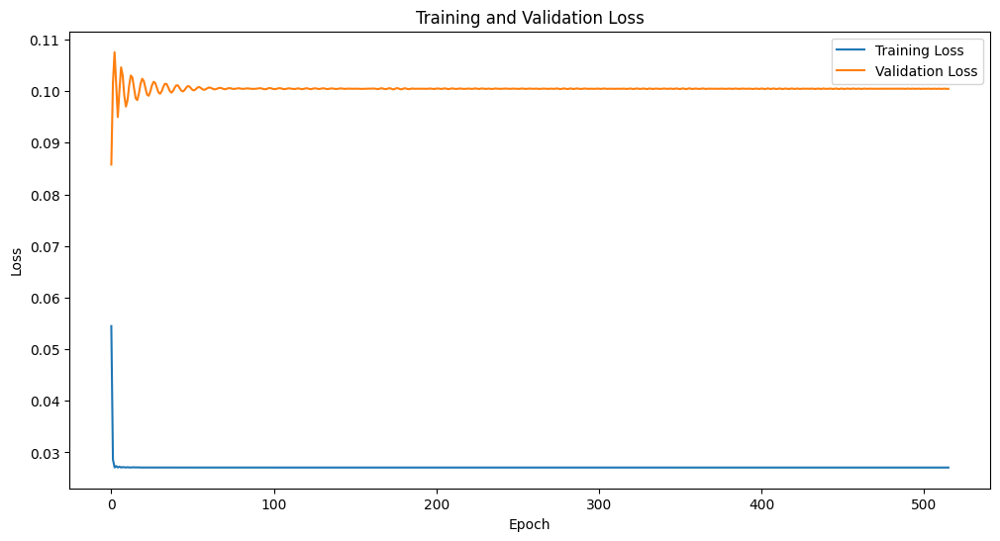

Epoch [1/2500], Train Loss: 0.1326, Val Loss: 0.1712
Epoch [2/2500], Train Loss: 0.0444, Val Loss: 0.0579
Epoch [3/2500], Train Loss: 0.0651, Val Loss: 0.1022
Epoch [4/2500], Train Loss: 0.0274, Val Loss: 0.1364
Epoch [5/2500], Train Loss: 0.0328, Val Loss: 0.1468
Epoch [6/2500], Train Loss: 0.0357, Val Loss: 0.1444
Epoch [7/2500], Train Loss: 0.0349, Val Loss: 0.1357
Epoch [8/2500], Train Loss: 0.0325, Val Loss: 0.1237
Epoch [9/2500], Train Loss: 0.0297, Val Loss: 0.1103
Epoch [10/2500], Train Loss: 0.0277, Val Loss: 0.0971
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0871
Epoch [12/2500], Train Loss: 0.0284, Val Loss: 0.0835
Epoch [13/2500], Train Loss: 0.0292, Val Loss: 0.0852
Epoch [14/2500], Train Loss: 0.0288, Val Loss: 0.0898
Epoch [15/2500], Train Loss: 0.0279, Val Loss: 0.0956
Epoch [16/2500], Train Loss: 0.0273, Val Loss: 0.1013
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1060
Epoch [18/2500], Train Loss: 0.0273, Val Loss: 0.1089
Epoch [19/2500], Train Loss: 0.0275, 

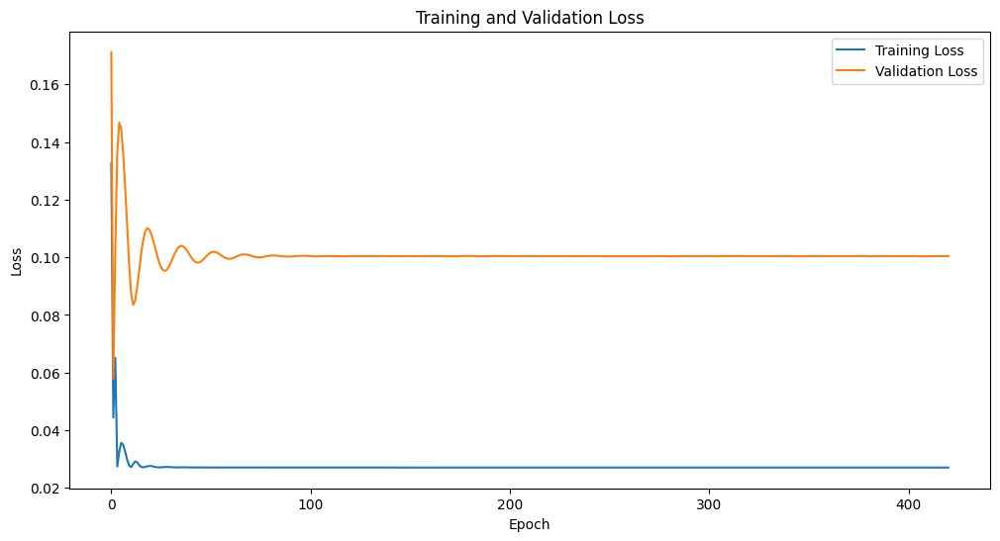

Epoch [1/2500], Train Loss: 0.1184, Val Loss: 0.1669
Epoch [2/2500], Train Loss: 0.0425, Val Loss: 0.0829
Epoch [3/2500], Train Loss: 0.1561, Val Loss: 0.1132
Epoch [4/2500], Train Loss: 0.0280, Val Loss: 0.1729
Epoch [5/2500], Train Loss: 0.0447, Val Loss: 0.1928
Epoch [6/2500], Train Loss: 0.0530, Val Loss: 0.1943
Epoch [7/2500], Train Loss: 0.0537, Val Loss: 0.1866
Epoch [8/2500], Train Loss: 0.0503, Val Loss: 0.1725
Epoch [9/2500], Train Loss: 0.0446, Val Loss: 0.1524
Epoch [10/2500], Train Loss: 0.0373, Val Loss: 0.1249
Epoch [11/2500], Train Loss: 0.0299, Val Loss: 0.0900
Epoch [12/2500], Train Loss: 0.0280, Val Loss: 0.0733
Epoch [13/2500], Train Loss: 0.0340, Val Loss: 0.0805
Epoch [14/2500], Train Loss: 0.0303, Val Loss: 0.0923
Epoch [15/2500], Train Loss: 0.0276, Val Loss: 0.1022
Epoch [16/2500], Train Loss: 0.0272, Val Loss: 0.1089
Epoch [17/2500], Train Loss: 0.0275, Val Loss: 0.1126
Epoch [18/2500], Train Loss: 0.0279, Val Loss: 0.1138
Epoch [19/2500], Train Loss: 0.0280, 

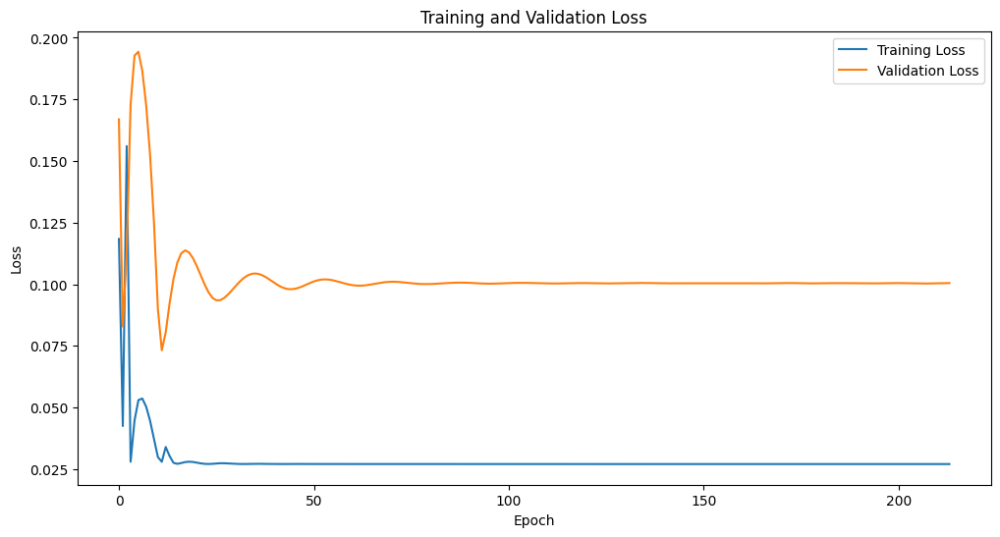

Epoch [1/2500], Train Loss: 0.0422, Val Loss: 0.0803
Epoch [2/2500], Train Loss: 0.0303, Val Loss: 0.1025
Epoch [3/2500], Train Loss: 0.0271, Val Loss: 0.1101
Epoch [4/2500], Train Loss: 0.0276, Val Loss: 0.1037
Epoch [5/2500], Train Loss: 0.0271, Val Loss: 0.0948
Epoch [6/2500], Train Loss: 0.0273, Val Loss: 0.0964
Epoch [7/2500], Train Loss: 0.0272, Val Loss: 0.1014
Epoch [8/2500], Train Loss: 0.0271, Val Loss: 0.1043
Epoch [9/2500], Train Loss: 0.0272, Val Loss: 0.1039
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.1014
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.0989
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.0976
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.0980
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.0996
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.1015
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.1026
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.1025
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1014
Epoch [19/2500], Train Loss: 0.0271, 

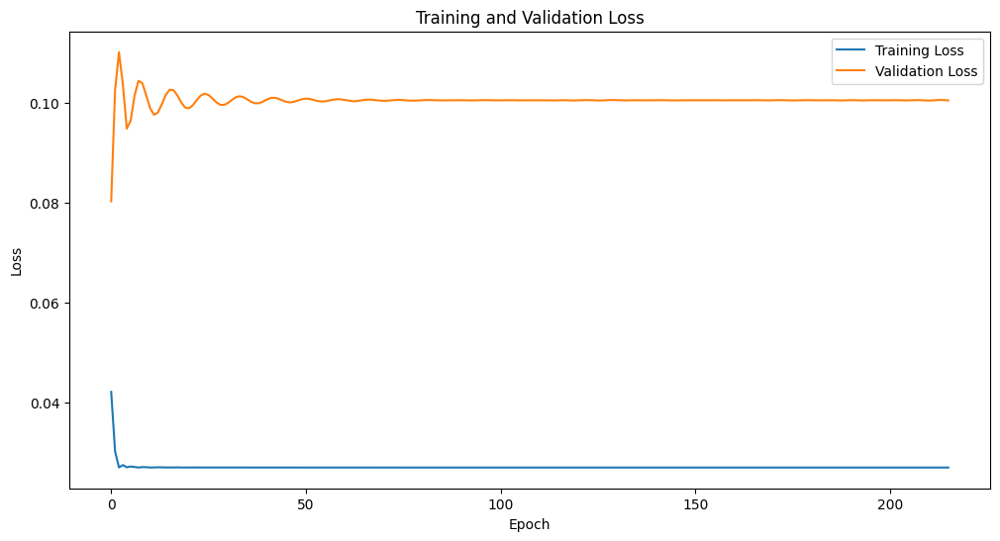

Epoch [1/2500], Train Loss: 0.0575, Val Loss: 0.0897
Epoch [2/2500], Train Loss: 0.0280, Val Loss: 0.0983
Epoch [3/2500], Train Loss: 0.0272, Val Loss: 0.1113
Epoch [4/2500], Train Loss: 0.0278, Val Loss: 0.0981
Epoch [5/2500], Train Loss: 0.0272, Val Loss: 0.0927
Epoch [6/2500], Train Loss: 0.0275, Val Loss: 0.0991
Epoch [7/2500], Train Loss: 0.0271, Val Loss: 0.1062
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.1050
Epoch [9/2500], Train Loss: 0.0272, Val Loss: 0.0995
Epoch [10/2500], Train Loss: 0.0271, Val Loss: 0.0964
Epoch [11/2500], Train Loss: 0.0272, Val Loss: 0.0986
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.1022
Epoch [13/2500], Train Loss: 0.0271, Val Loss: 0.1034
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.1019
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.0994
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0981
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0988
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1006
Epoch [19/2500], Train Loss: 0.0271, 

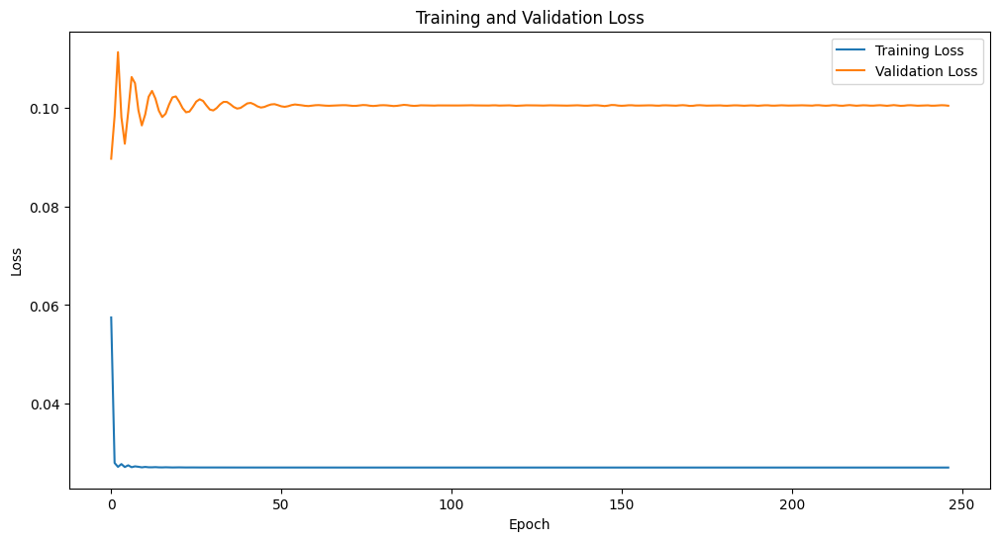

Epoch [1/2500], Train Loss: 0.0872, Val Loss: 0.1287
Epoch [2/2500], Train Loss: 0.0308, Val Loss: 0.1068
Epoch [3/2500], Train Loss: 0.2035, Val Loss: 0.1051
Epoch [4/2500], Train Loss: 0.0273, Val Loss: 0.1685
Epoch [5/2500], Train Loss: 0.0431, Val Loss: 0.1899
Epoch [6/2500], Train Loss: 0.0517, Val Loss: 0.1917
Epoch [7/2500], Train Loss: 0.0525, Val Loss: 0.1849
Epoch [8/2500], Train Loss: 0.0496, Val Loss: 0.1733
Epoch [9/2500], Train Loss: 0.0448, Val Loss: 0.1569
Epoch [10/2500], Train Loss: 0.0389, Val Loss: 0.1333
Epoch [11/2500], Train Loss: 0.0318, Val Loss: 0.0983
Epoch [12/2500], Train Loss: 0.0275, Val Loss: 0.0694
Epoch [13/2500], Train Loss: 0.0375, Val Loss: 0.0845
Epoch [14/2500], Train Loss: 0.0293, Val Loss: 0.1029
Epoch [15/2500], Train Loss: 0.0273, Val Loss: 0.1143
Epoch [16/2500], Train Loss: 0.0282, Val Loss: 0.1193
Epoch [17/2500], Train Loss: 0.0289, Val Loss: 0.1197
Epoch [18/2500], Train Loss: 0.0290, Val Loss: 0.1170
Epoch [19/2500], Train Loss: 0.0285, 

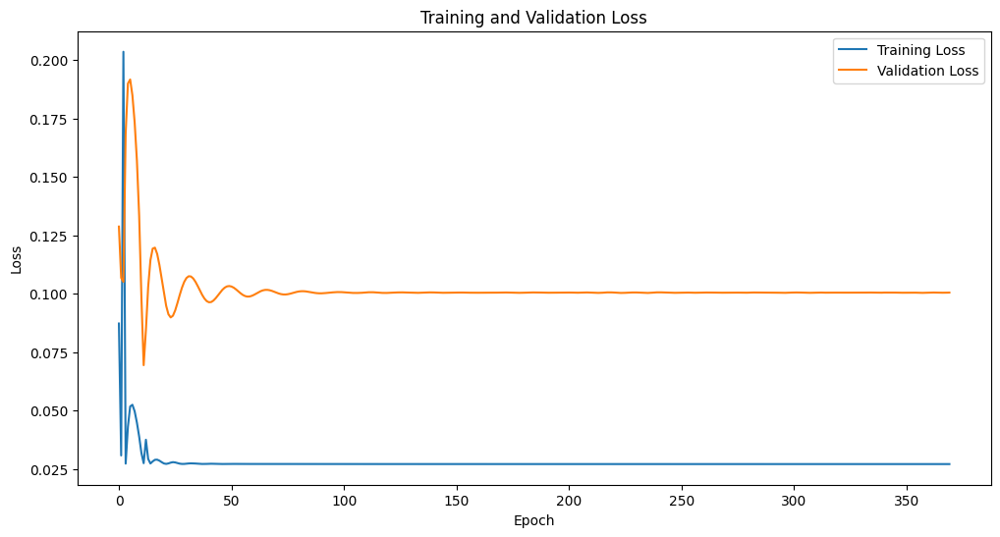

Epoch [1/2500], Train Loss: 0.0534, Val Loss: 0.0801
Epoch [2/2500], Train Loss: 0.0304, Val Loss: 0.1040
Epoch [3/2500], Train Loss: 0.0272, Val Loss: 0.1106
Epoch [4/2500], Train Loss: 0.0276, Val Loss: 0.1027
Epoch [5/2500], Train Loss: 0.0271, Val Loss: 0.0955
Epoch [6/2500], Train Loss: 0.0272, Val Loss: 0.0972
Epoch [7/2500], Train Loss: 0.0272, Val Loss: 0.1064
Epoch [8/2500], Train Loss: 0.0273, Val Loss: 0.0998
Epoch [9/2500], Train Loss: 0.0271, Val Loss: 0.0963
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0979
Epoch [11/2500], Train Loss: 0.0271, Val Loss: 0.1017
Epoch [12/2500], Train Loss: 0.0271, Val Loss: 0.1040
Epoch [13/2500], Train Loss: 0.0272, Val Loss: 0.1030
Epoch [14/2500], Train Loss: 0.0271, Val Loss: 0.1003
Epoch [15/2500], Train Loss: 0.0271, Val Loss: 0.0982
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0980
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0994
Epoch [18/2500], Train Loss: 0.0271, Val Loss: 0.1013
Epoch [19/2500], Train Loss: 0.0271, 

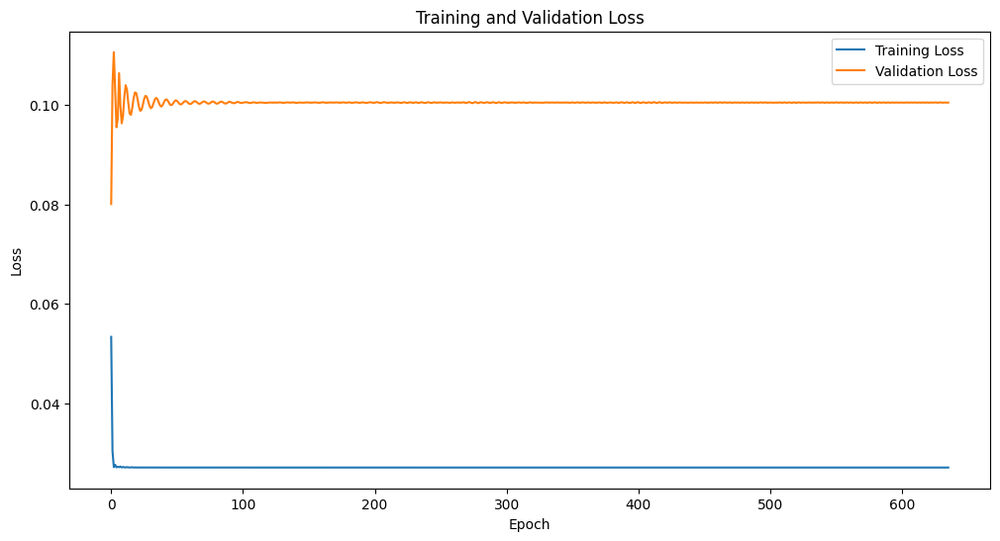

Epoch [1/2500], Train Loss: 0.0990, Val Loss: 0.1277
Epoch [2/2500], Train Loss: 0.0307, Val Loss: 0.1109
Epoch [3/2500], Train Loss: 0.2044, Val Loss: 0.1008
Epoch [4/2500], Train Loss: 0.0273, Val Loss: 0.1637
Epoch [5/2500], Train Loss: 0.0412, Val Loss: 0.1879
Epoch [6/2500], Train Loss: 0.0510, Val Loss: 0.1927
Epoch [7/2500], Train Loss: 0.0529, Val Loss: 0.1887
Epoch [8/2500], Train Loss: 0.0512, Val Loss: 0.1800
Epoch [9/2500], Train Loss: 0.0475, Val Loss: 0.1680
Epoch [10/2500], Train Loss: 0.0428, Val Loss: 0.1517
Epoch [11/2500], Train Loss: 0.0372, Val Loss: 0.1280
Epoch [12/2500], Train Loss: 0.0309, Val Loss: 0.0930
Epoch [13/2500], Train Loss: 0.0282, Val Loss: 0.0741
Epoch [14/2500], Train Loss: 0.0338, Val Loss: 0.0823
Epoch [15/2500], Train Loss: 0.0304, Val Loss: 0.0959
Epoch [16/2500], Train Loss: 0.0277, Val Loss: 0.1059
Epoch [17/2500], Train Loss: 0.0276, Val Loss: 0.1116
Epoch [18/2500], Train Loss: 0.0280, Val Loss: 0.1138
Epoch [19/2500], Train Loss: 0.0282, 

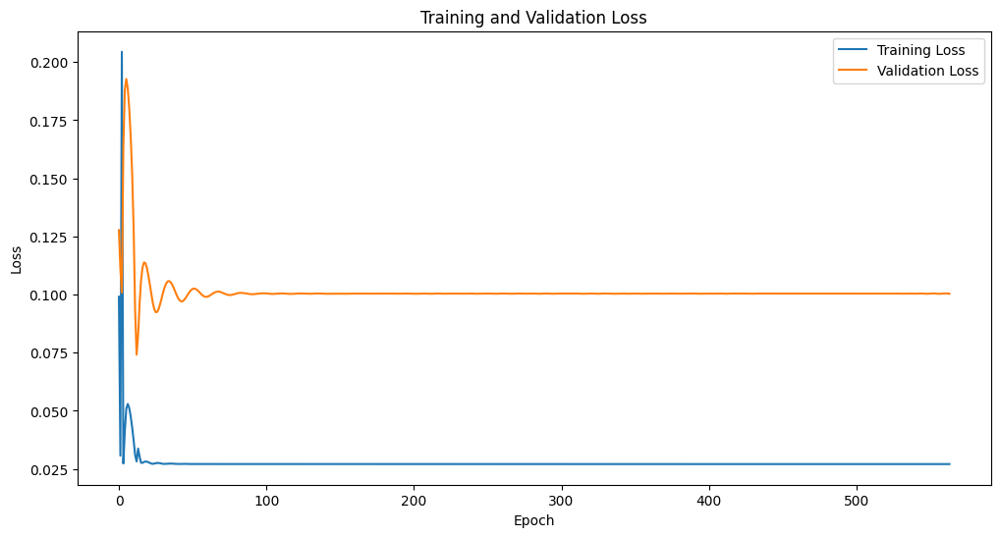

Epoch [1/2500], Train Loss: 0.0631, Val Loss: 0.2142
Epoch [2/2500], Train Loss: 0.0629, Val Loss: 0.2137
Epoch [3/2500], Train Loss: 0.0627, Val Loss: 0.2132
Epoch [4/2500], Train Loss: 0.0624, Val Loss: 0.2127
Epoch [5/2500], Train Loss: 0.0621, Val Loss: 0.2121
Epoch [6/2500], Train Loss: 0.0619, Val Loss: 0.2116
Epoch [7/2500], Train Loss: 0.0617, Val Loss: 0.2111
Epoch [8/2500], Train Loss: 0.0615, Val Loss: 0.2106
Epoch [9/2500], Train Loss: 0.0611, Val Loss: 0.2100
Epoch [10/2500], Train Loss: 0.0608, Val Loss: 0.2095
Epoch [11/2500], Train Loss: 0.0607, Val Loss: 0.2090
Epoch [12/2500], Train Loss: 0.0604, Val Loss: 0.2085
Epoch [13/2500], Train Loss: 0.0602, Val Loss: 0.2080
Epoch [14/2500], Train Loss: 0.0600, Val Loss: 0.2074
Epoch [15/2500], Train Loss: 0.0597, Val Loss: 0.2069
Epoch [16/2500], Train Loss: 0.0595, Val Loss: 0.2064
Epoch [17/2500], Train Loss: 0.0593, Val Loss: 0.2059
Epoch [18/2500], Train Loss: 0.0590, Val Loss: 0.2054
Epoch [19/2500], Train Loss: 0.0588, 

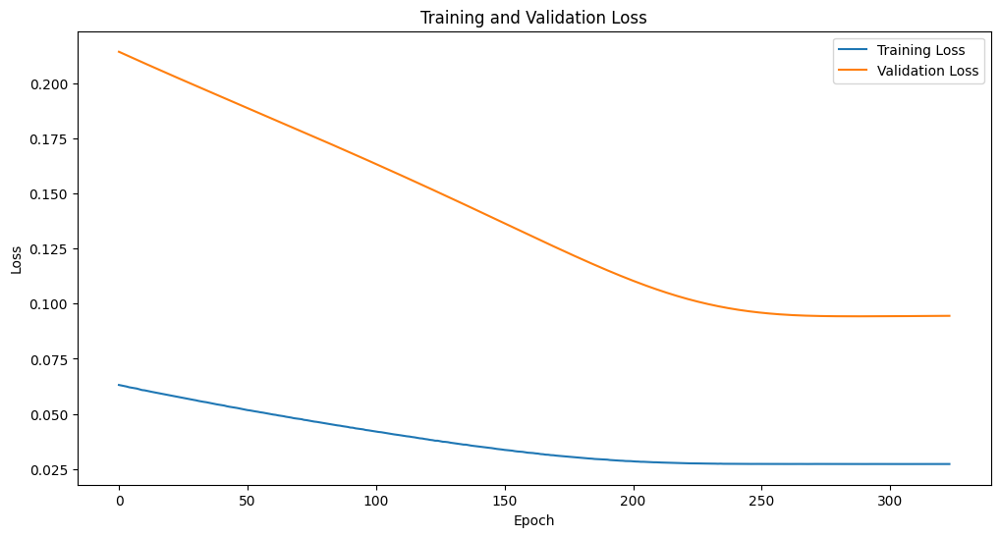

Epoch [1/2500], Train Loss: 0.1138, Val Loss: 0.3095
Epoch [2/2500], Train Loss: 0.1133, Val Loss: 0.3087
Epoch [3/2500], Train Loss: 0.1129, Val Loss: 0.3079
Epoch [4/2500], Train Loss: 0.1125, Val Loss: 0.3071
Epoch [5/2500], Train Loss: 0.1120, Val Loss: 0.3063
Epoch [6/2500], Train Loss: 0.1115, Val Loss: 0.3056
Epoch [7/2500], Train Loss: 0.1111, Val Loss: 0.3048
Epoch [8/2500], Train Loss: 0.1106, Val Loss: 0.3040
Epoch [9/2500], Train Loss: 0.1101, Val Loss: 0.3032
Epoch [10/2500], Train Loss: 0.1098, Val Loss: 0.3025
Epoch [11/2500], Train Loss: 0.1092, Val Loss: 0.3017
Epoch [12/2500], Train Loss: 0.1088, Val Loss: 0.3009
Epoch [13/2500], Train Loss: 0.1084, Val Loss: 0.3001
Epoch [14/2500], Train Loss: 0.1079, Val Loss: 0.2994
Epoch [15/2500], Train Loss: 0.1074, Val Loss: 0.2986
Epoch [16/2500], Train Loss: 0.1071, Val Loss: 0.2978
Epoch [17/2500], Train Loss: 0.1067, Val Loss: 0.2970
Epoch [18/2500], Train Loss: 0.1062, Val Loss: 0.2963
Epoch [19/2500], Train Loss: 0.1056, 

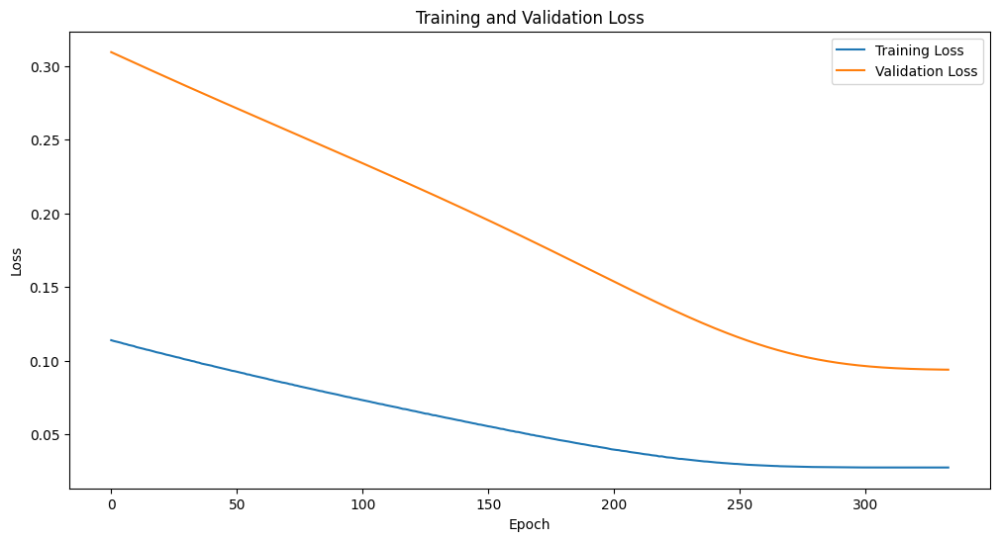

Epoch [1/2500], Train Loss: 0.1002, Val Loss: 0.2830
Epoch [2/2500], Train Loss: 0.0997, Val Loss: 0.2823
Epoch [3/2500], Train Loss: 0.0994, Val Loss: 0.2817
Epoch [4/2500], Train Loss: 0.0989, Val Loss: 0.2810
Epoch [5/2500], Train Loss: 0.0986, Val Loss: 0.2803
Epoch [6/2500], Train Loss: 0.0983, Val Loss: 0.2797
Epoch [7/2500], Train Loss: 0.0977, Val Loss: 0.2790
Epoch [8/2500], Train Loss: 0.0972, Val Loss: 0.2783
Epoch [9/2500], Train Loss: 0.0971, Val Loss: 0.2777
Epoch [10/2500], Train Loss: 0.0968, Val Loss: 0.2770
Epoch [11/2500], Train Loss: 0.0963, Val Loss: 0.2763
Epoch [12/2500], Train Loss: 0.0962, Val Loss: 0.2757
Epoch [13/2500], Train Loss: 0.0953, Val Loss: 0.2750
Epoch [14/2500], Train Loss: 0.0950, Val Loss: 0.2743
Epoch [15/2500], Train Loss: 0.0948, Val Loss: 0.2736
Epoch [16/2500], Train Loss: 0.0944, Val Loss: 0.2730
Epoch [17/2500], Train Loss: 0.0941, Val Loss: 0.2723
Epoch [18/2500], Train Loss: 0.0938, Val Loss: 0.2716
Epoch [19/2500], Train Loss: 0.0934, 

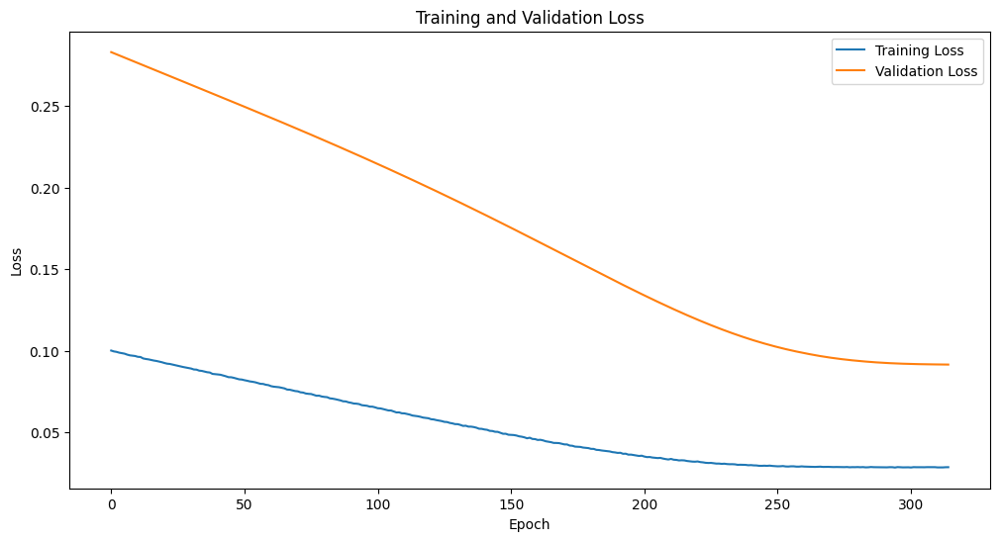

Epoch [1/2500], Train Loss: 0.0980, Val Loss: 0.2805
Epoch [2/2500], Train Loss: 0.0975, Val Loss: 0.2799
Epoch [3/2500], Train Loss: 0.0972, Val Loss: 0.2793
Epoch [4/2500], Train Loss: 0.0969, Val Loss: 0.2787
Epoch [5/2500], Train Loss: 0.0964, Val Loss: 0.2781
Epoch [6/2500], Train Loss: 0.0962, Val Loss: 0.2774
Epoch [7/2500], Train Loss: 0.0958, Val Loss: 0.2768
Epoch [8/2500], Train Loss: 0.0954, Val Loss: 0.2762
Epoch [9/2500], Train Loss: 0.0951, Val Loss: 0.2756
Epoch [10/2500], Train Loss: 0.0949, Val Loss: 0.2750
Epoch [11/2500], Train Loss: 0.0945, Val Loss: 0.2744
Epoch [12/2500], Train Loss: 0.0941, Val Loss: 0.2738
Epoch [13/2500], Train Loss: 0.0938, Val Loss: 0.2732
Epoch [14/2500], Train Loss: 0.0933, Val Loss: 0.2726
Epoch [15/2500], Train Loss: 0.0931, Val Loss: 0.2720
Epoch [16/2500], Train Loss: 0.0927, Val Loss: 0.2714
Epoch [17/2500], Train Loss: 0.0925, Val Loss: 0.2708
Epoch [18/2500], Train Loss: 0.0921, Val Loss: 0.2702
Epoch [19/2500], Train Loss: 0.0918, 

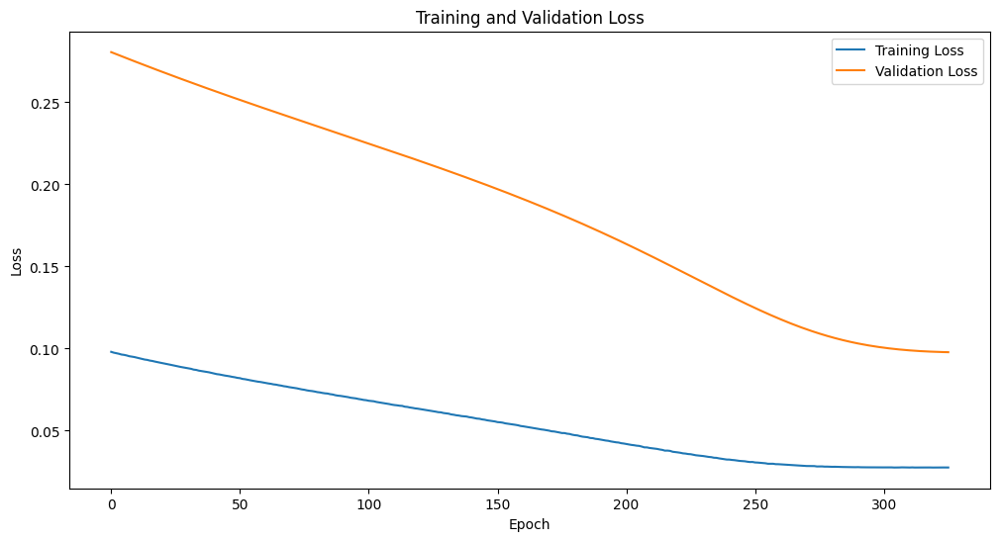

Epoch [1/2500], Train Loss: 0.1443, Val Loss: 0.3567
Epoch [2/2500], Train Loss: 0.1436, Val Loss: 0.3557
Epoch [3/2500], Train Loss: 0.1431, Val Loss: 0.3548
Epoch [4/2500], Train Loss: 0.1425, Val Loss: 0.3539
Epoch [5/2500], Train Loss: 0.1417, Val Loss: 0.3530
Epoch [6/2500], Train Loss: 0.1414, Val Loss: 0.3520
Epoch [7/2500], Train Loss: 0.1407, Val Loss: 0.3511
Epoch [8/2500], Train Loss: 0.1401, Val Loss: 0.3502
Epoch [9/2500], Train Loss: 0.1395, Val Loss: 0.3492
Epoch [10/2500], Train Loss: 0.1388, Val Loss: 0.3483
Epoch [11/2500], Train Loss: 0.1385, Val Loss: 0.3474
Epoch [12/2500], Train Loss: 0.1377, Val Loss: 0.3465
Epoch [13/2500], Train Loss: 0.1371, Val Loss: 0.3456
Epoch [14/2500], Train Loss: 0.1367, Val Loss: 0.3446
Epoch [15/2500], Train Loss: 0.1360, Val Loss: 0.3437
Epoch [16/2500], Train Loss: 0.1354, Val Loss: 0.3428
Epoch [17/2500], Train Loss: 0.1350, Val Loss: 0.3419
Epoch [18/2500], Train Loss: 0.1344, Val Loss: 0.3410
Epoch [19/2500], Train Loss: 0.1338, 

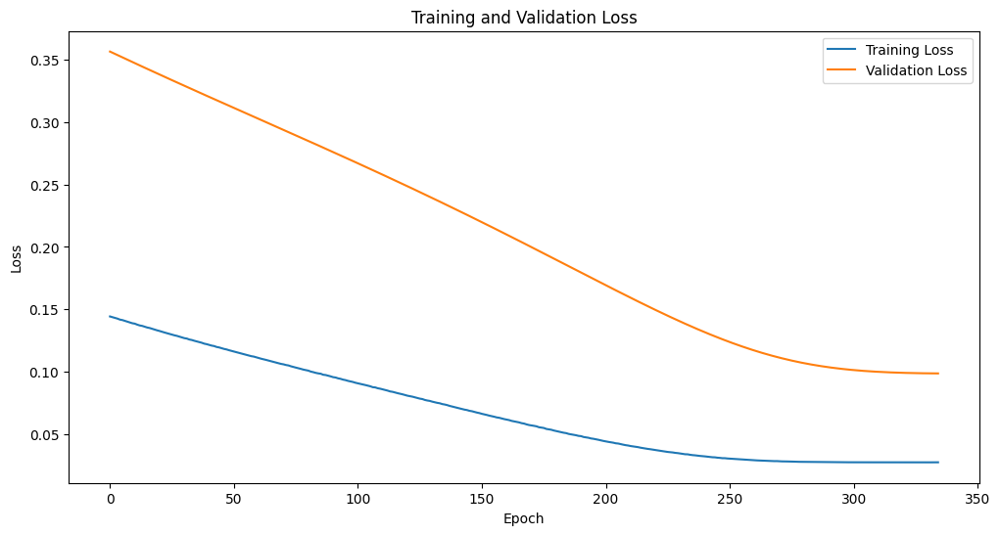

Epoch [1/2500], Train Loss: 0.0380, Val Loss: 0.1541
Epoch [2/2500], Train Loss: 0.0379, Val Loss: 0.1538
Epoch [3/2500], Train Loss: 0.0378, Val Loss: 0.1534
Epoch [4/2500], Train Loss: 0.0377, Val Loss: 0.1531
Epoch [5/2500], Train Loss: 0.0376, Val Loss: 0.1527
Epoch [6/2500], Train Loss: 0.0374, Val Loss: 0.1524
Epoch [7/2500], Train Loss: 0.0373, Val Loss: 0.1520
Epoch [8/2500], Train Loss: 0.0372, Val Loss: 0.1517
Epoch [9/2500], Train Loss: 0.0371, Val Loss: 0.1513
Epoch [10/2500], Train Loss: 0.0370, Val Loss: 0.1510
Epoch [11/2500], Train Loss: 0.0369, Val Loss: 0.1506
Epoch [12/2500], Train Loss: 0.0368, Val Loss: 0.1503
Epoch [13/2500], Train Loss: 0.0367, Val Loss: 0.1499
Epoch [14/2500], Train Loss: 0.0365, Val Loss: 0.1496
Epoch [15/2500], Train Loss: 0.0365, Val Loss: 0.1493
Epoch [16/2500], Train Loss: 0.0364, Val Loss: 0.1489
Epoch [17/2500], Train Loss: 0.0363, Val Loss: 0.1486
Epoch [18/2500], Train Loss: 0.0361, Val Loss: 0.1482
Epoch [19/2500], Train Loss: 0.0360, 

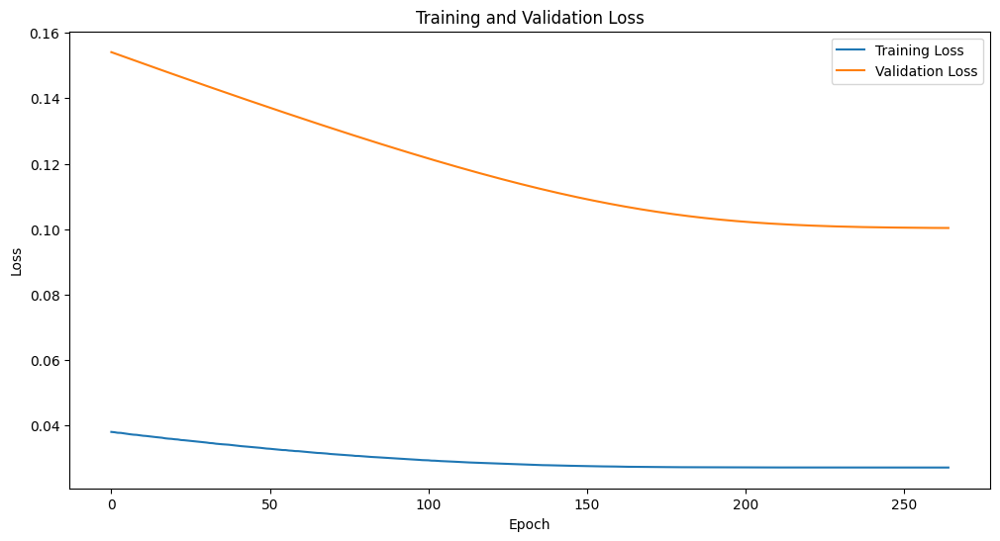

Epoch [1/2500], Train Loss: 0.0356, Val Loss: 0.1468
Epoch [2/2500], Train Loss: 0.0355, Val Loss: 0.1464
Epoch [3/2500], Train Loss: 0.0355, Val Loss: 0.1460
Epoch [4/2500], Train Loss: 0.0353, Val Loss: 0.1457
Epoch [5/2500], Train Loss: 0.0351, Val Loss: 0.1453
Epoch [6/2500], Train Loss: 0.0351, Val Loss: 0.1450
Epoch [7/2500], Train Loss: 0.0349, Val Loss: 0.1446
Epoch [8/2500], Train Loss: 0.0349, Val Loss: 0.1442
Epoch [9/2500], Train Loss: 0.0347, Val Loss: 0.1439
Epoch [10/2500], Train Loss: 0.0346, Val Loss: 0.1435
Epoch [11/2500], Train Loss: 0.0346, Val Loss: 0.1432
Epoch [12/2500], Train Loss: 0.0345, Val Loss: 0.1428
Epoch [13/2500], Train Loss: 0.0343, Val Loss: 0.1425
Epoch [14/2500], Train Loss: 0.0342, Val Loss: 0.1421
Epoch [15/2500], Train Loss: 0.0342, Val Loss: 0.1418
Epoch [16/2500], Train Loss: 0.0340, Val Loss: 0.1414
Epoch [17/2500], Train Loss: 0.0340, Val Loss: 0.1411
Epoch [18/2500], Train Loss: 0.0338, Val Loss: 0.1407
Epoch [19/2500], Train Loss: 0.0337, 

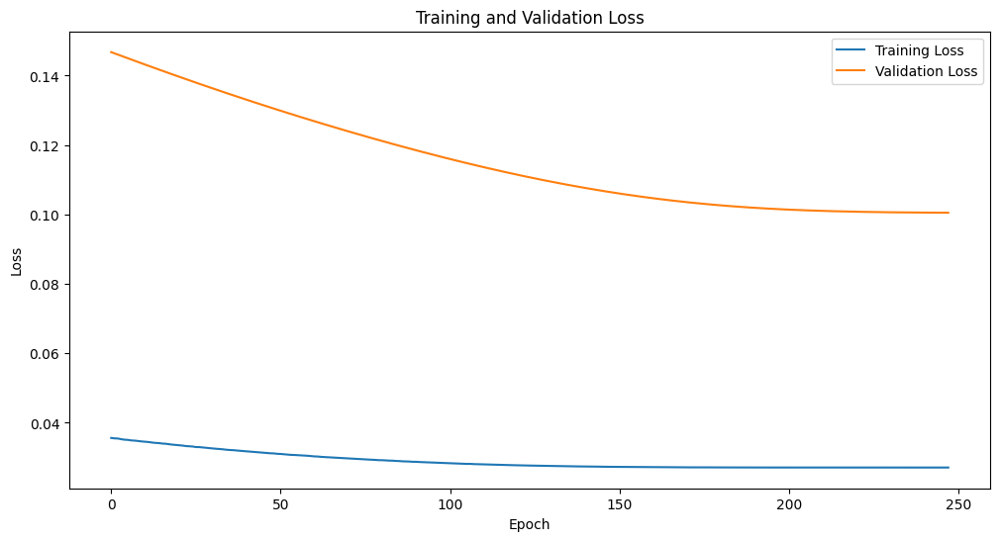

Epoch [1/2500], Train Loss: 0.0292, Val Loss: 0.1211
Epoch [2/2500], Train Loss: 0.0291, Val Loss: 0.1208
Epoch [3/2500], Train Loss: 0.0291, Val Loss: 0.1205
Epoch [4/2500], Train Loss: 0.0290, Val Loss: 0.1202
Epoch [5/2500], Train Loss: 0.0290, Val Loss: 0.1199
Epoch [6/2500], Train Loss: 0.0289, Val Loss: 0.1196
Epoch [7/2500], Train Loss: 0.0289, Val Loss: 0.1193
Epoch [8/2500], Train Loss: 0.0288, Val Loss: 0.1190
Epoch [9/2500], Train Loss: 0.0287, Val Loss: 0.1187
Epoch [10/2500], Train Loss: 0.0287, Val Loss: 0.1184
Epoch [11/2500], Train Loss: 0.0287, Val Loss: 0.1181
Epoch [12/2500], Train Loss: 0.0286, Val Loss: 0.1178
Epoch [13/2500], Train Loss: 0.0286, Val Loss: 0.1175
Epoch [14/2500], Train Loss: 0.0285, Val Loss: 0.1172
Epoch [15/2500], Train Loss: 0.0285, Val Loss: 0.1169
Epoch [16/2500], Train Loss: 0.0284, Val Loss: 0.1166
Epoch [17/2500], Train Loss: 0.0284, Val Loss: 0.1164
Epoch [18/2500], Train Loss: 0.0283, Val Loss: 0.1161
Epoch [19/2500], Train Loss: 0.0283, 

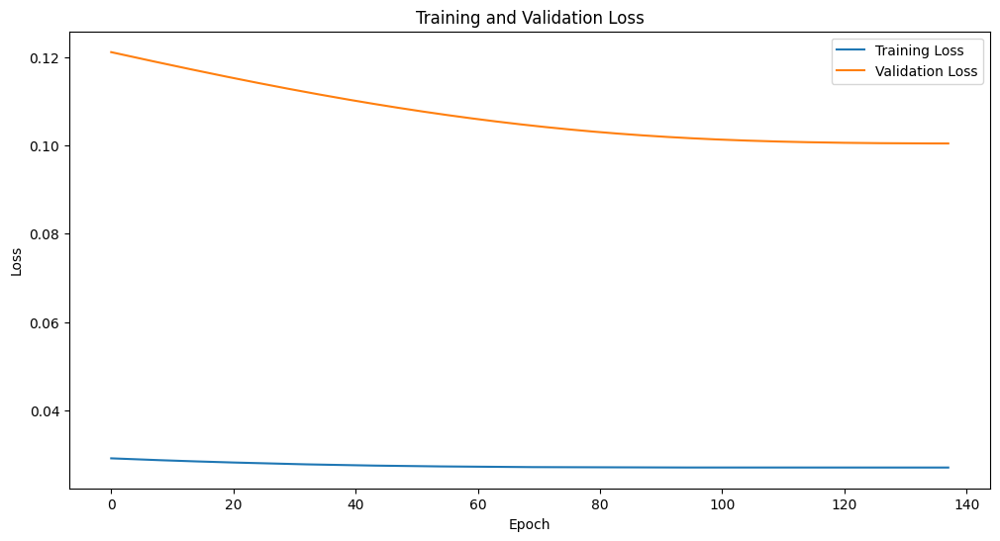

Epoch [1/2500], Train Loss: 0.0314, Val Loss: 0.1316
Epoch [2/2500], Train Loss: 0.0313, Val Loss: 0.1313
Epoch [3/2500], Train Loss: 0.0313, Val Loss: 0.1310
Epoch [4/2500], Train Loss: 0.0312, Val Loss: 0.1308
Epoch [5/2500], Train Loss: 0.0312, Val Loss: 0.1305
Epoch [6/2500], Train Loss: 0.0311, Val Loss: 0.1303
Epoch [7/2500], Train Loss: 0.0311, Val Loss: 0.1300
Epoch [8/2500], Train Loss: 0.0309, Val Loss: 0.1298
Epoch [9/2500], Train Loss: 0.0309, Val Loss: 0.1295
Epoch [10/2500], Train Loss: 0.0309, Val Loss: 0.1293
Epoch [11/2500], Train Loss: 0.0309, Val Loss: 0.1290
Epoch [12/2500], Train Loss: 0.0308, Val Loss: 0.1288
Epoch [13/2500], Train Loss: 0.0307, Val Loss: 0.1286
Epoch [14/2500], Train Loss: 0.0306, Val Loss: 0.1283
Epoch [15/2500], Train Loss: 0.0306, Val Loss: 0.1281
Epoch [16/2500], Train Loss: 0.0305, Val Loss: 0.1278
Epoch [17/2500], Train Loss: 0.0304, Val Loss: 0.1276
Epoch [18/2500], Train Loss: 0.0304, Val Loss: 0.1273
Epoch [19/2500], Train Loss: 0.0304, 

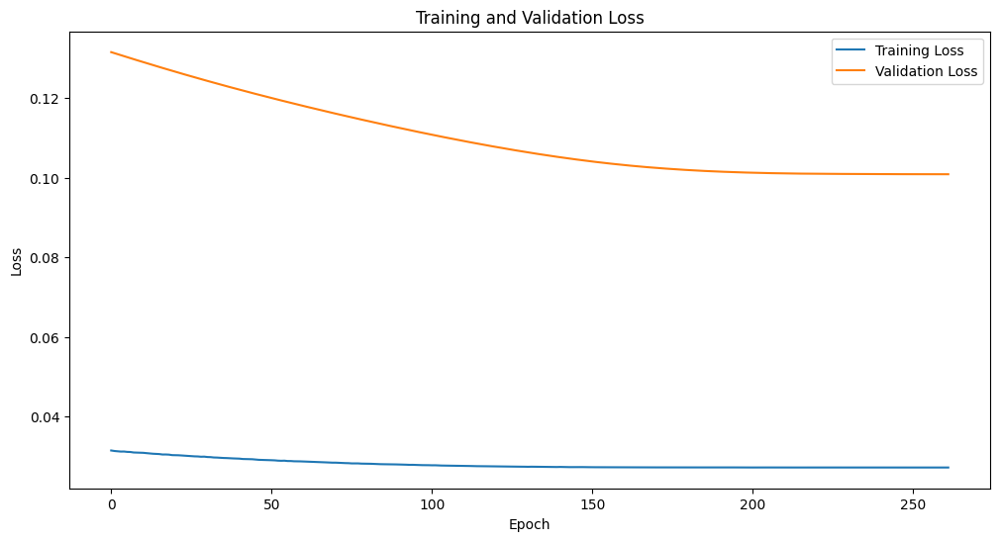

Epoch [1/2500], Train Loss: 0.2054, Val Loss: 0.4450
Epoch [2/2500], Train Loss: 0.2048, Val Loss: 0.4443
Epoch [3/2500], Train Loss: 0.2043, Val Loss: 0.4436
Epoch [4/2500], Train Loss: 0.2037, Val Loss: 0.4429
Epoch [5/2500], Train Loss: 0.2032, Val Loss: 0.4422
Epoch [6/2500], Train Loss: 0.2029, Val Loss: 0.4415
Epoch [7/2500], Train Loss: 0.2023, Val Loss: 0.4408
Epoch [8/2500], Train Loss: 0.2017, Val Loss: 0.4401
Epoch [9/2500], Train Loss: 0.2012, Val Loss: 0.4394
Epoch [10/2500], Train Loss: 0.2007, Val Loss: 0.4387
Epoch [11/2500], Train Loss: 0.2001, Val Loss: 0.4380
Epoch [12/2500], Train Loss: 0.1998, Val Loss: 0.4373
Epoch [13/2500], Train Loss: 0.1992, Val Loss: 0.4366
Epoch [14/2500], Train Loss: 0.1986, Val Loss: 0.4359
Epoch [15/2500], Train Loss: 0.1981, Val Loss: 0.4352
Epoch [16/2500], Train Loss: 0.1976, Val Loss: 0.4345
Epoch [17/2500], Train Loss: 0.1972, Val Loss: 0.4338
Epoch [18/2500], Train Loss: 0.1967, Val Loss: 0.4331
Epoch [19/2500], Train Loss: 0.1961, 

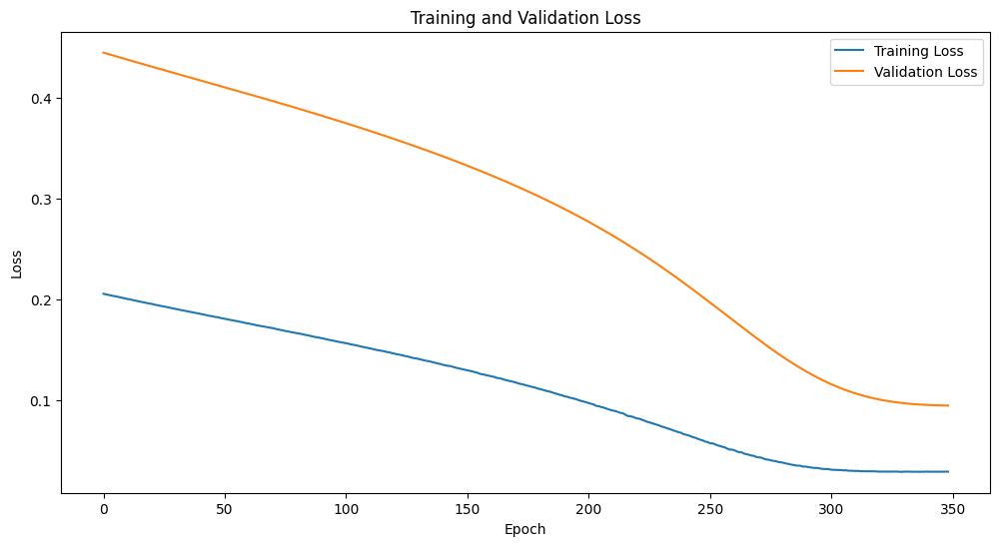

Epoch [1/2500], Train Loss: 0.0673, Val Loss: 0.2231
Epoch [2/2500], Train Loss: 0.0671, Val Loss: 0.2226
Epoch [3/2500], Train Loss: 0.0669, Val Loss: 0.2221
Epoch [4/2500], Train Loss: 0.0666, Val Loss: 0.2216
Epoch [5/2500], Train Loss: 0.0664, Val Loss: 0.2211
Epoch [6/2500], Train Loss: 0.0661, Val Loss: 0.2206
Epoch [7/2500], Train Loss: 0.0659, Val Loss: 0.2201
Epoch [8/2500], Train Loss: 0.0656, Val Loss: 0.2195
Epoch [9/2500], Train Loss: 0.0654, Val Loss: 0.2190
Epoch [10/2500], Train Loss: 0.0651, Val Loss: 0.2185
Epoch [11/2500], Train Loss: 0.0649, Val Loss: 0.2180
Epoch [12/2500], Train Loss: 0.0646, Val Loss: 0.2175
Epoch [13/2500], Train Loss: 0.0644, Val Loss: 0.2170
Epoch [14/2500], Train Loss: 0.0642, Val Loss: 0.2165
Epoch [15/2500], Train Loss: 0.0639, Val Loss: 0.2160
Epoch [16/2500], Train Loss: 0.0637, Val Loss: 0.2155
Epoch [17/2500], Train Loss: 0.0634, Val Loss: 0.2150
Epoch [18/2500], Train Loss: 0.0632, Val Loss: 0.2146
Epoch [19/2500], Train Loss: 0.0630, 

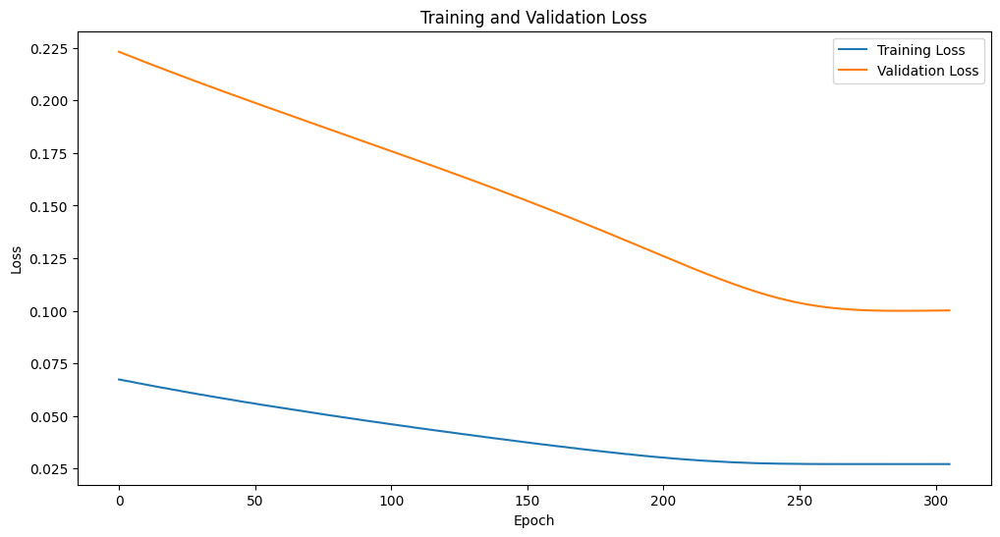

Epoch [1/2500], Train Loss: 0.1119, Val Loss: 0.3043
Epoch [2/2500], Train Loss: 0.1113, Val Loss: 0.3037
Epoch [3/2500], Train Loss: 0.1111, Val Loss: 0.3031
Epoch [4/2500], Train Loss: 0.1109, Val Loss: 0.3025
Epoch [5/2500], Train Loss: 0.1104, Val Loss: 0.3019
Epoch [6/2500], Train Loss: 0.1099, Val Loss: 0.3013
Epoch [7/2500], Train Loss: 0.1096, Val Loss: 0.3007
Epoch [8/2500], Train Loss: 0.1094, Val Loss: 0.3001
Epoch [9/2500], Train Loss: 0.1090, Val Loss: 0.2995
Epoch [10/2500], Train Loss: 0.1086, Val Loss: 0.2989
Epoch [11/2500], Train Loss: 0.1080, Val Loss: 0.2983
Epoch [12/2500], Train Loss: 0.1078, Val Loss: 0.2977
Epoch [13/2500], Train Loss: 0.1075, Val Loss: 0.2971
Epoch [14/2500], Train Loss: 0.1072, Val Loss: 0.2965
Epoch [15/2500], Train Loss: 0.1070, Val Loss: 0.2959
Epoch [16/2500], Train Loss: 0.1065, Val Loss: 0.2953
Epoch [17/2500], Train Loss: 0.1061, Val Loss: 0.2947
Epoch [18/2500], Train Loss: 0.1059, Val Loss: 0.2942
Epoch [19/2500], Train Loss: 0.1056, 

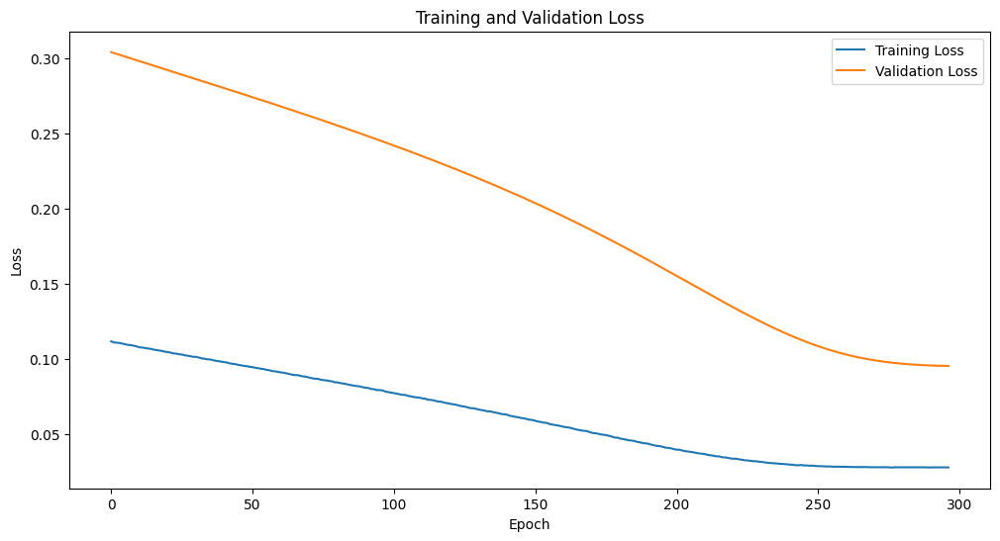

Epoch [1/2500], Train Loss: 0.1281, Val Loss: 0.3319
Epoch [2/2500], Train Loss: 0.1273, Val Loss: 0.3309
Epoch [3/2500], Train Loss: 0.1268, Val Loss: 0.3299
Epoch [4/2500], Train Loss: 0.1262, Val Loss: 0.3290
Epoch [5/2500], Train Loss: 0.1256, Val Loss: 0.3280
Epoch [6/2500], Train Loss: 0.1250, Val Loss: 0.3270
Epoch [7/2500], Train Loss: 0.1245, Val Loss: 0.3261
Epoch [8/2500], Train Loss: 0.1240, Val Loss: 0.3251
Epoch [9/2500], Train Loss: 0.1233, Val Loss: 0.3242
Epoch [10/2500], Train Loss: 0.1227, Val Loss: 0.3232
Epoch [11/2500], Train Loss: 0.1220, Val Loss: 0.3223
Epoch [12/2500], Train Loss: 0.1215, Val Loss: 0.3213
Epoch [13/2500], Train Loss: 0.1211, Val Loss: 0.3204
Epoch [14/2500], Train Loss: 0.1205, Val Loss: 0.3195
Epoch [15/2500], Train Loss: 0.1198, Val Loss: 0.3185
Epoch [16/2500], Train Loss: 0.1194, Val Loss: 0.3176
Epoch [17/2500], Train Loss: 0.1188, Val Loss: 0.3166
Epoch [18/2500], Train Loss: 0.1183, Val Loss: 0.3157
Epoch [19/2500], Train Loss: 0.1178, 

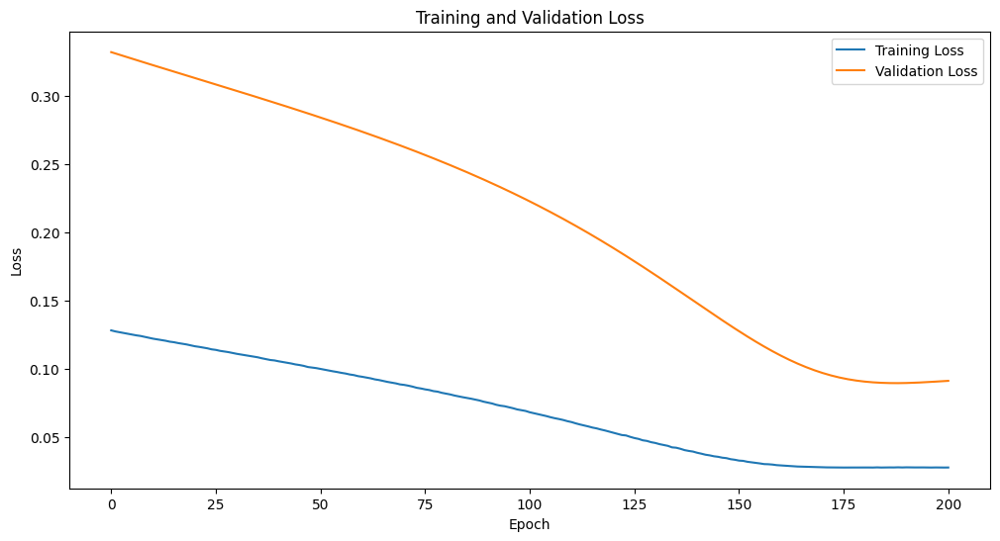

Epoch [1/2500], Train Loss: 0.0382, Val Loss: 0.1541
Epoch [2/2500], Train Loss: 0.0379, Val Loss: 0.1534
Epoch [3/2500], Train Loss: 0.0377, Val Loss: 0.1526
Epoch [4/2500], Train Loss: 0.0375, Val Loss: 0.1519
Epoch [5/2500], Train Loss: 0.0372, Val Loss: 0.1512
Epoch [6/2500], Train Loss: 0.0370, Val Loss: 0.1504
Epoch [7/2500], Train Loss: 0.0368, Val Loss: 0.1497
Epoch [8/2500], Train Loss: 0.0365, Val Loss: 0.1490
Epoch [9/2500], Train Loss: 0.0363, Val Loss: 0.1483
Epoch [10/2500], Train Loss: 0.0361, Val Loss: 0.1476
Epoch [11/2500], Train Loss: 0.0359, Val Loss: 0.1469
Epoch [12/2500], Train Loss: 0.0357, Val Loss: 0.1462
Epoch [13/2500], Train Loss: 0.0355, Val Loss: 0.1455
Epoch [14/2500], Train Loss: 0.0353, Val Loss: 0.1448
Epoch [15/2500], Train Loss: 0.0351, Val Loss: 0.1441
Epoch [16/2500], Train Loss: 0.0349, Val Loss: 0.1434
Epoch [17/2500], Train Loss: 0.0347, Val Loss: 0.1427
Epoch [18/2500], Train Loss: 0.0345, Val Loss: 0.1421
Epoch [19/2500], Train Loss: 0.0343, 

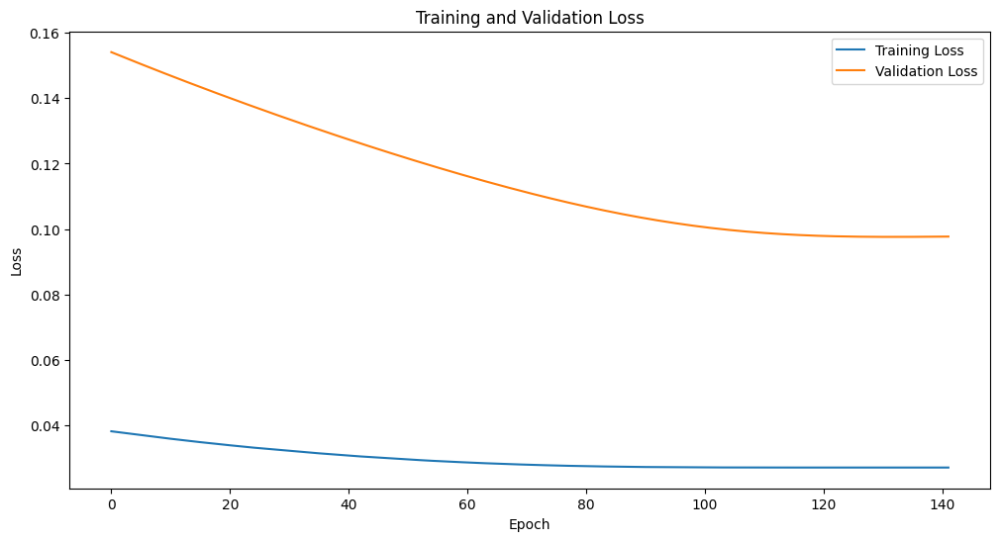

Epoch [1/2500], Train Loss: 0.0818, Val Loss: 0.2501
Epoch [2/2500], Train Loss: 0.0812, Val Loss: 0.2488
Epoch [3/2500], Train Loss: 0.0806, Val Loss: 0.2476
Epoch [4/2500], Train Loss: 0.0801, Val Loss: 0.2464
Epoch [5/2500], Train Loss: 0.0794, Val Loss: 0.2451
Epoch [6/2500], Train Loss: 0.0787, Val Loss: 0.2439
Epoch [7/2500], Train Loss: 0.0781, Val Loss: 0.2427
Epoch [8/2500], Train Loss: 0.0775, Val Loss: 0.2415
Epoch [9/2500], Train Loss: 0.0768, Val Loss: 0.2402
Epoch [10/2500], Train Loss: 0.0763, Val Loss: 0.2390
Epoch [11/2500], Train Loss: 0.0759, Val Loss: 0.2378
Epoch [12/2500], Train Loss: 0.0753, Val Loss: 0.2366
Epoch [13/2500], Train Loss: 0.0746, Val Loss: 0.2354
Epoch [14/2500], Train Loss: 0.0741, Val Loss: 0.2342
Epoch [15/2500], Train Loss: 0.0735, Val Loss: 0.2330
Epoch [16/2500], Train Loss: 0.0729, Val Loss: 0.2319
Epoch [17/2500], Train Loss: 0.0725, Val Loss: 0.2307
Epoch [18/2500], Train Loss: 0.0718, Val Loss: 0.2295
Epoch [19/2500], Train Loss: 0.0712, 

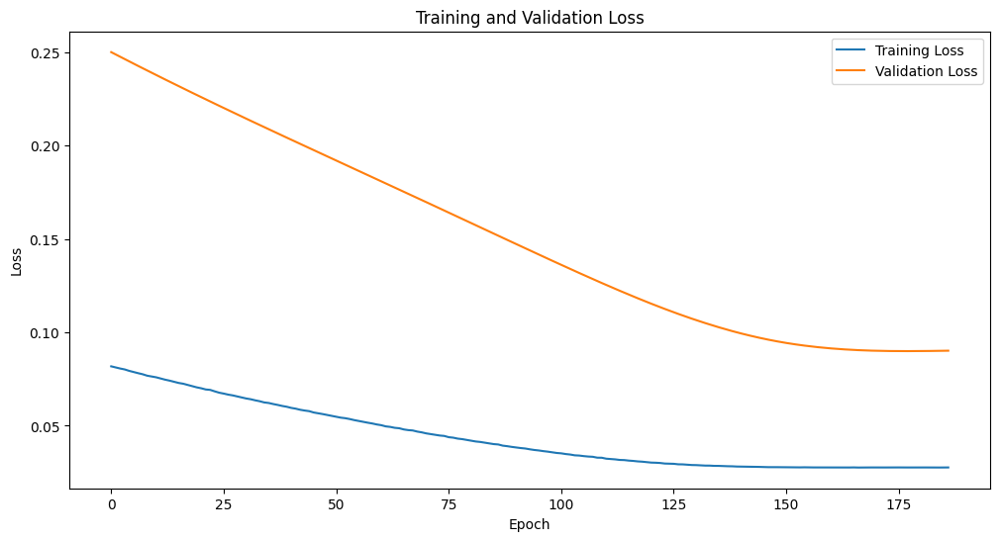

Epoch [1/2500], Train Loss: 0.0456, Val Loss: 0.1744
Epoch [2/2500], Train Loss: 0.0453, Val Loss: 0.1736
Epoch [3/2500], Train Loss: 0.0450, Val Loss: 0.1728
Epoch [4/2500], Train Loss: 0.0447, Val Loss: 0.1719
Epoch [5/2500], Train Loss: 0.0443, Val Loss: 0.1711
Epoch [6/2500], Train Loss: 0.0441, Val Loss: 0.1703
Epoch [7/2500], Train Loss: 0.0437, Val Loss: 0.1695
Epoch [8/2500], Train Loss: 0.0434, Val Loss: 0.1687
Epoch [9/2500], Train Loss: 0.0431, Val Loss: 0.1679
Epoch [10/2500], Train Loss: 0.0428, Val Loss: 0.1670
Epoch [11/2500], Train Loss: 0.0425, Val Loss: 0.1662
Epoch [12/2500], Train Loss: 0.0422, Val Loss: 0.1654
Epoch [13/2500], Train Loss: 0.0419, Val Loss: 0.1646
Epoch [14/2500], Train Loss: 0.0416, Val Loss: 0.1638
Epoch [15/2500], Train Loss: 0.0413, Val Loss: 0.1630
Epoch [16/2500], Train Loss: 0.0410, Val Loss: 0.1622
Epoch [17/2500], Train Loss: 0.0407, Val Loss: 0.1614
Epoch [18/2500], Train Loss: 0.0405, Val Loss: 0.1606
Epoch [19/2500], Train Loss: 0.0401, 

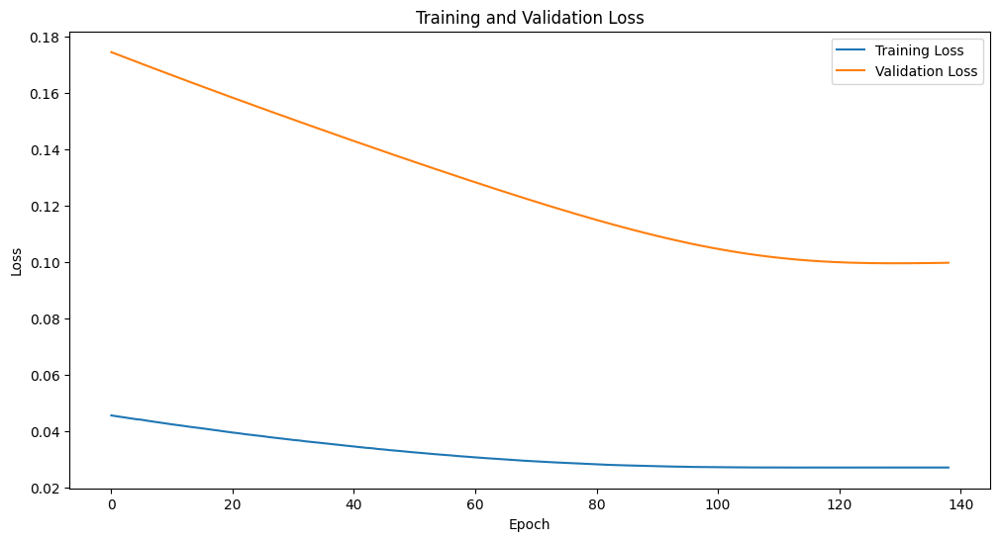

Epoch [1/2500], Train Loss: 0.0584, Val Loss: 0.2041
Epoch [2/2500], Train Loss: 0.0580, Val Loss: 0.2032
Epoch [3/2500], Train Loss: 0.0577, Val Loss: 0.2024
Epoch [4/2500], Train Loss: 0.0573, Val Loss: 0.2015
Epoch [5/2500], Train Loss: 0.0569, Val Loss: 0.2007
Epoch [6/2500], Train Loss: 0.0565, Val Loss: 0.1998
Epoch [7/2500], Train Loss: 0.0561, Val Loss: 0.1990
Epoch [8/2500], Train Loss: 0.0557, Val Loss: 0.1982
Epoch [9/2500], Train Loss: 0.0554, Val Loss: 0.1973
Epoch [10/2500], Train Loss: 0.0550, Val Loss: 0.1965
Epoch [11/2500], Train Loss: 0.0546, Val Loss: 0.1957
Epoch [12/2500], Train Loss: 0.0543, Val Loss: 0.1948
Epoch [13/2500], Train Loss: 0.0539, Val Loss: 0.1940
Epoch [14/2500], Train Loss: 0.0535, Val Loss: 0.1932
Epoch [15/2500], Train Loss: 0.0531, Val Loss: 0.1923
Epoch [16/2500], Train Loss: 0.0528, Val Loss: 0.1915
Epoch [17/2500], Train Loss: 0.0524, Val Loss: 0.1907
Epoch [18/2500], Train Loss: 0.0521, Val Loss: 0.1898
Epoch [19/2500], Train Loss: 0.0517, 

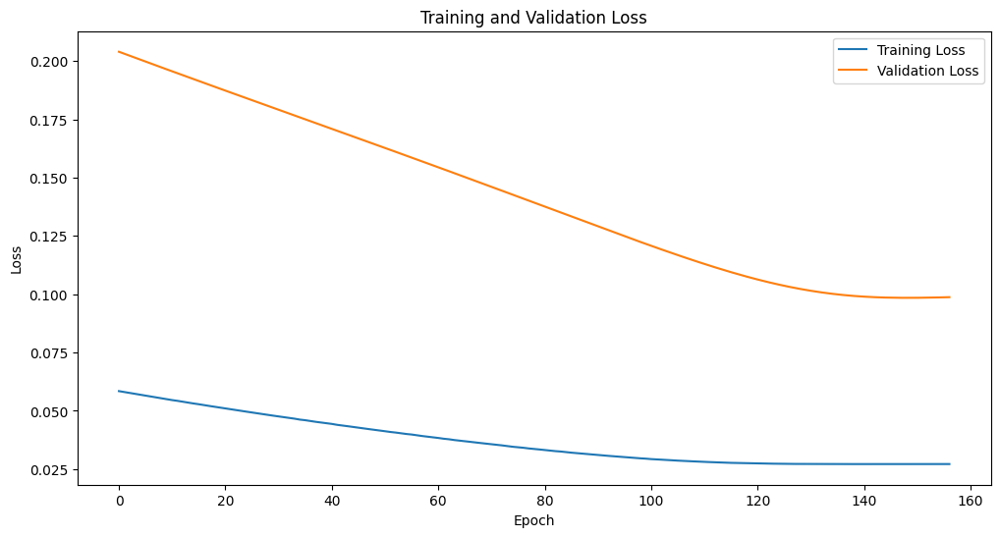

Epoch [1/2500], Train Loss: 0.1492, Val Loss: 0.3638
Epoch [2/2500], Train Loss: 0.1480, Val Loss: 0.3624
Epoch [3/2500], Train Loss: 0.1474, Val Loss: 0.3610
Epoch [4/2500], Train Loss: 0.1465, Val Loss: 0.3597
Epoch [5/2500], Train Loss: 0.1454, Val Loss: 0.3583
Epoch [6/2500], Train Loss: 0.1446, Val Loss: 0.3569
Epoch [7/2500], Train Loss: 0.1439, Val Loss: 0.3556
Epoch [8/2500], Train Loss: 0.1429, Val Loss: 0.3542
Epoch [9/2500], Train Loss: 0.1420, Val Loss: 0.3528
Epoch [10/2500], Train Loss: 0.1413, Val Loss: 0.3515
Epoch [11/2500], Train Loss: 0.1404, Val Loss: 0.3502
Epoch [12/2500], Train Loss: 0.1395, Val Loss: 0.3488
Epoch [13/2500], Train Loss: 0.1386, Val Loss: 0.3475
Epoch [14/2500], Train Loss: 0.1381, Val Loss: 0.3462
Epoch [15/2500], Train Loss: 0.1369, Val Loss: 0.3449
Epoch [16/2500], Train Loss: 0.1362, Val Loss: 0.3435
Epoch [17/2500], Train Loss: 0.1354, Val Loss: 0.3422
Epoch [18/2500], Train Loss: 0.1345, Val Loss: 0.3409
Epoch [19/2500], Train Loss: 0.1340, 

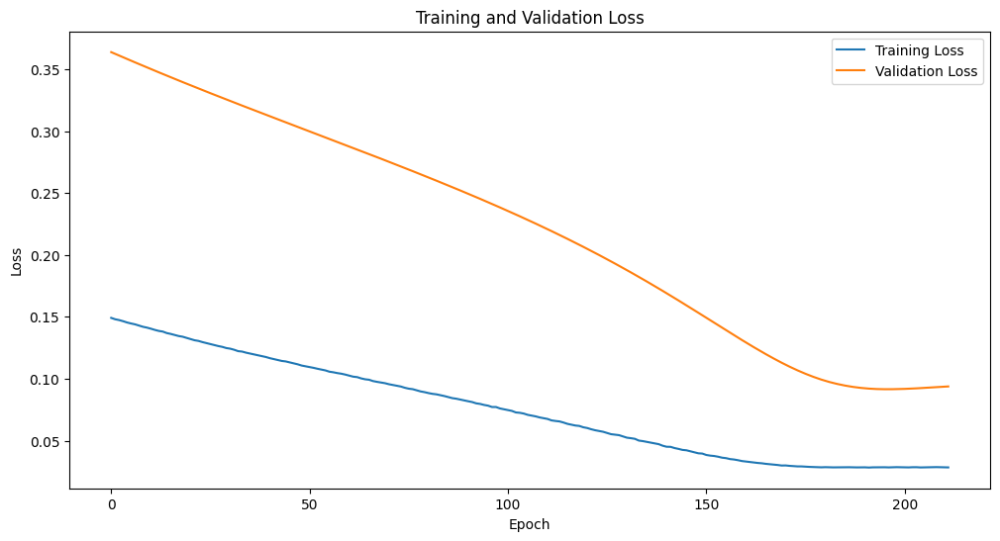

Epoch [1/2500], Train Loss: 0.1185, Val Loss: 0.3153
Epoch [2/2500], Train Loss: 0.1179, Val Loss: 0.3142
Epoch [3/2500], Train Loss: 0.1172, Val Loss: 0.3132
Epoch [4/2500], Train Loss: 0.1165, Val Loss: 0.3121
Epoch [5/2500], Train Loss: 0.1159, Val Loss: 0.3110
Epoch [6/2500], Train Loss: 0.1153, Val Loss: 0.3099
Epoch [7/2500], Train Loss: 0.1146, Val Loss: 0.3088
Epoch [8/2500], Train Loss: 0.1140, Val Loss: 0.3078
Epoch [9/2500], Train Loss: 0.1133, Val Loss: 0.3067
Epoch [10/2500], Train Loss: 0.1127, Val Loss: 0.3056
Epoch [11/2500], Train Loss: 0.1121, Val Loss: 0.3045
Epoch [12/2500], Train Loss: 0.1115, Val Loss: 0.3035
Epoch [13/2500], Train Loss: 0.1109, Val Loss: 0.3024
Epoch [14/2500], Train Loss: 0.1102, Val Loss: 0.3014
Epoch [15/2500], Train Loss: 0.1096, Val Loss: 0.3003
Epoch [16/2500], Train Loss: 0.1089, Val Loss: 0.2992
Epoch [17/2500], Train Loss: 0.1083, Val Loss: 0.2982
Epoch [18/2500], Train Loss: 0.1077, Val Loss: 0.2971
Epoch [19/2500], Train Loss: 0.1071, 

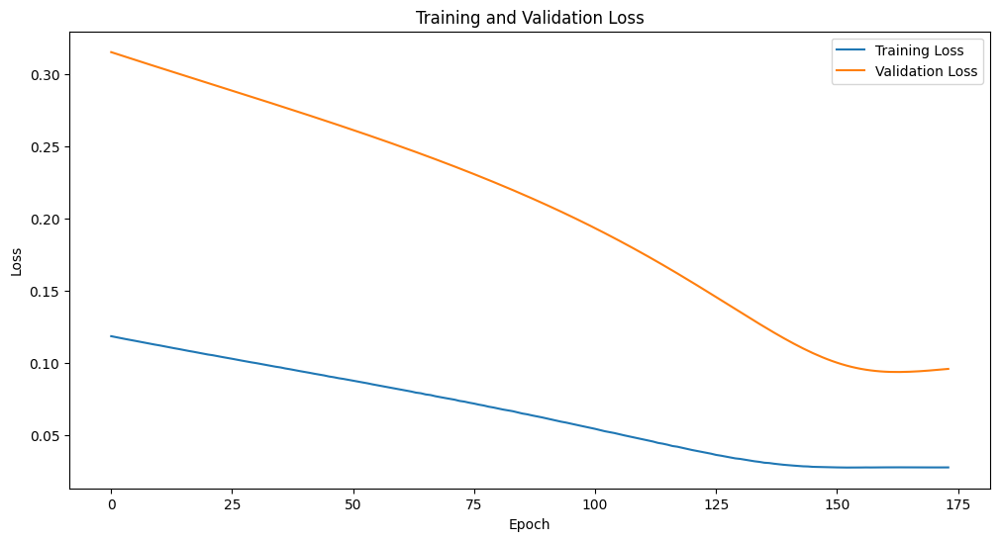

Epoch [1/2500], Train Loss: 0.0410, Val Loss: 0.1625
Epoch [2/2500], Train Loss: 0.0408, Val Loss: 0.1618
Epoch [3/2500], Train Loss: 0.0405, Val Loss: 0.1611
Epoch [4/2500], Train Loss: 0.0403, Val Loss: 0.1603
Epoch [5/2500], Train Loss: 0.0400, Val Loss: 0.1596
Epoch [6/2500], Train Loss: 0.0398, Val Loss: 0.1589
Epoch [7/2500], Train Loss: 0.0395, Val Loss: 0.1582
Epoch [8/2500], Train Loss: 0.0393, Val Loss: 0.1575
Epoch [9/2500], Train Loss: 0.0390, Val Loss: 0.1568
Epoch [10/2500], Train Loss: 0.0388, Val Loss: 0.1561
Epoch [11/2500], Train Loss: 0.0386, Val Loss: 0.1555
Epoch [12/2500], Train Loss: 0.0383, Val Loss: 0.1548
Epoch [13/2500], Train Loss: 0.0381, Val Loss: 0.1541
Epoch [14/2500], Train Loss: 0.0379, Val Loss: 0.1534
Epoch [15/2500], Train Loss: 0.0376, Val Loss: 0.1527
Epoch [16/2500], Train Loss: 0.0374, Val Loss: 0.1521
Epoch [17/2500], Train Loss: 0.0372, Val Loss: 0.1514
Epoch [18/2500], Train Loss: 0.0370, Val Loss: 0.1507
Epoch [19/2500], Train Loss: 0.0368, 

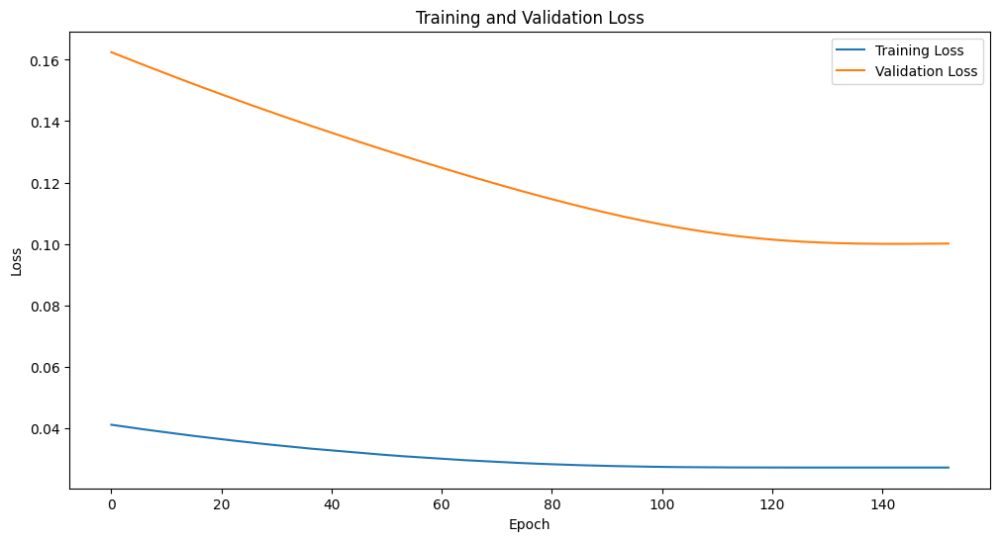

Epoch [1/2500], Train Loss: 0.0893, Val Loss: 0.2651
Epoch [2/2500], Train Loss: 0.0889, Val Loss: 0.2643
Epoch [3/2500], Train Loss: 0.0885, Val Loss: 0.2635
Epoch [4/2500], Train Loss: 0.0881, Val Loss: 0.2627
Epoch [5/2500], Train Loss: 0.0877, Val Loss: 0.2620
Epoch [6/2500], Train Loss: 0.0872, Val Loss: 0.2612
Epoch [7/2500], Train Loss: 0.0869, Val Loss: 0.2604
Epoch [8/2500], Train Loss: 0.0864, Val Loss: 0.2597
Epoch [9/2500], Train Loss: 0.0860, Val Loss: 0.2589
Epoch [10/2500], Train Loss: 0.0857, Val Loss: 0.2582
Epoch [11/2500], Train Loss: 0.0852, Val Loss: 0.2574
Epoch [12/2500], Train Loss: 0.0848, Val Loss: 0.2567
Epoch [13/2500], Train Loss: 0.0845, Val Loss: 0.2559
Epoch [14/2500], Train Loss: 0.0840, Val Loss: 0.2552
Epoch [15/2500], Train Loss: 0.0837, Val Loss: 0.2544
Epoch [16/2500], Train Loss: 0.0832, Val Loss: 0.2537
Epoch [17/2500], Train Loss: 0.0828, Val Loss: 0.2530
Epoch [18/2500], Train Loss: 0.0825, Val Loss: 0.2522
Epoch [19/2500], Train Loss: 0.0820, 

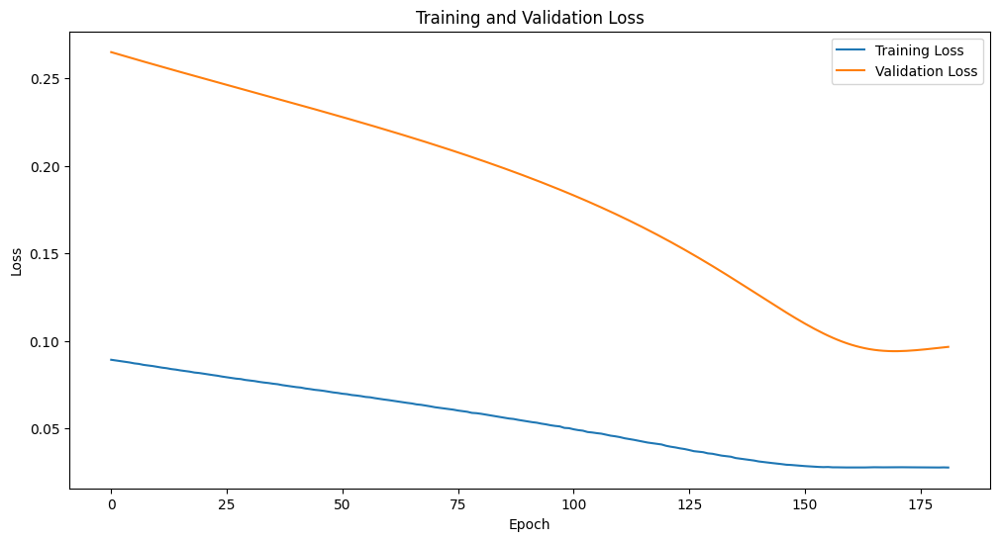

Epoch [1/2500], Train Loss: 0.1221, Val Loss: 0.3212
Epoch [2/2500], Train Loss: 0.1215, Val Loss: 0.3201
Epoch [3/2500], Train Loss: 0.1208, Val Loss: 0.3191
Epoch [4/2500], Train Loss: 0.1202, Val Loss: 0.3180
Epoch [5/2500], Train Loss: 0.1197, Val Loss: 0.3170
Epoch [6/2500], Train Loss: 0.1190, Val Loss: 0.3159
Epoch [7/2500], Train Loss: 0.1181, Val Loss: 0.3149
Epoch [8/2500], Train Loss: 0.1177, Val Loss: 0.3138
Epoch [9/2500], Train Loss: 0.1170, Val Loss: 0.3128
Epoch [10/2500], Train Loss: 0.1164, Val Loss: 0.3117
Epoch [11/2500], Train Loss: 0.1158, Val Loss: 0.3107
Epoch [12/2500], Train Loss: 0.1152, Val Loss: 0.3096
Epoch [13/2500], Train Loss: 0.1145, Val Loss: 0.3086
Epoch [14/2500], Train Loss: 0.1138, Val Loss: 0.3075
Epoch [15/2500], Train Loss: 0.1132, Val Loss: 0.3065
Epoch [16/2500], Train Loss: 0.1126, Val Loss: 0.3054
Epoch [17/2500], Train Loss: 0.1121, Val Loss: 0.3043
Epoch [18/2500], Train Loss: 0.1113, Val Loss: 0.3033
Epoch [19/2500], Train Loss: 0.1108, 

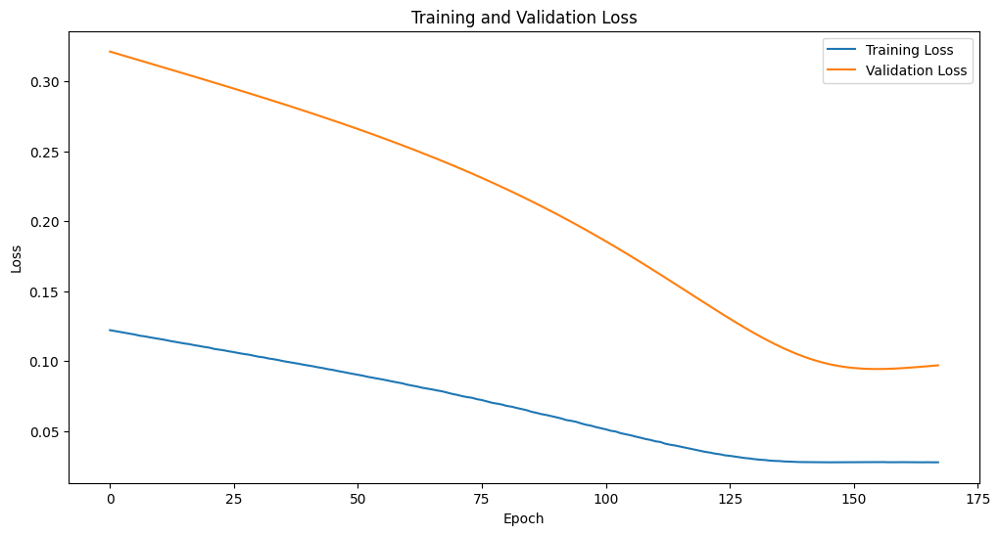

Epoch [1/2500], Train Loss: 0.1011, Val Loss: 0.2859
Epoch [2/2500], Train Loss: 0.1006, Val Loss: 0.2851
Epoch [3/2500], Train Loss: 0.1001, Val Loss: 0.2842
Epoch [4/2500], Train Loss: 0.0996, Val Loss: 0.2834
Epoch [5/2500], Train Loss: 0.0992, Val Loss: 0.2825
Epoch [6/2500], Train Loss: 0.0987, Val Loss: 0.2817
Epoch [7/2500], Train Loss: 0.0982, Val Loss: 0.2808
Epoch [8/2500], Train Loss: 0.0977, Val Loss: 0.2800
Epoch [9/2500], Train Loss: 0.0973, Val Loss: 0.2791
Epoch [10/2500], Train Loss: 0.0968, Val Loss: 0.2783
Epoch [11/2500], Train Loss: 0.0963, Val Loss: 0.2775
Epoch [12/2500], Train Loss: 0.0958, Val Loss: 0.2766
Epoch [13/2500], Train Loss: 0.0954, Val Loss: 0.2758
Epoch [14/2500], Train Loss: 0.0949, Val Loss: 0.2750
Epoch [15/2500], Train Loss: 0.0945, Val Loss: 0.2741
Epoch [16/2500], Train Loss: 0.0940, Val Loss: 0.2733
Epoch [17/2500], Train Loss: 0.0935, Val Loss: 0.2725
Epoch [18/2500], Train Loss: 0.0931, Val Loss: 0.2716
Epoch [19/2500], Train Loss: 0.0926, 

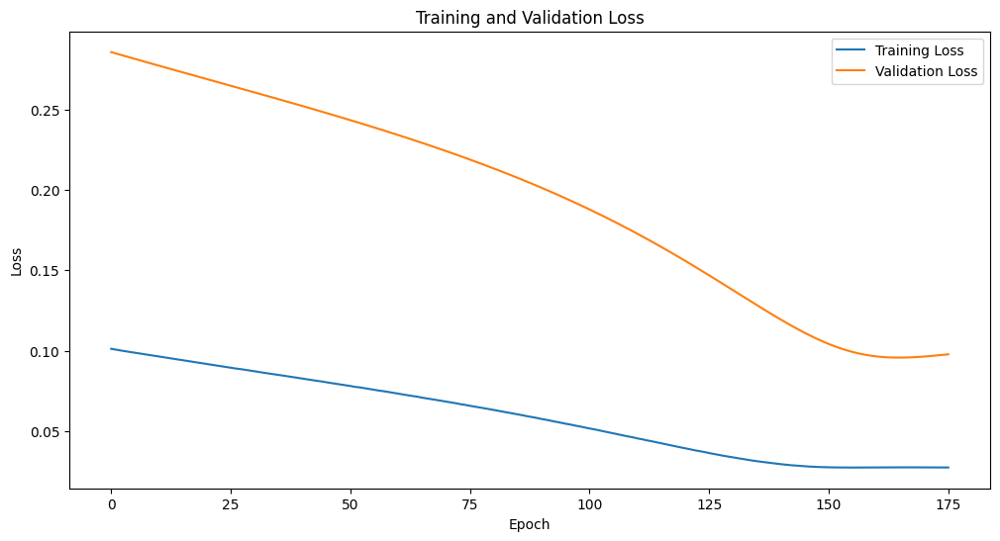

Epoch [1/2500], Train Loss: 0.1409, Val Loss: 0.3509
Epoch [2/2500], Train Loss: 0.1401, Val Loss: 0.3498
Epoch [3/2500], Train Loss: 0.1394, Val Loss: 0.3486
Epoch [4/2500], Train Loss: 0.1387, Val Loss: 0.3475
Epoch [5/2500], Train Loss: 0.1377, Val Loss: 0.3463
Epoch [6/2500], Train Loss: 0.1372, Val Loss: 0.3452
Epoch [7/2500], Train Loss: 0.1364, Val Loss: 0.3440
Epoch [8/2500], Train Loss: 0.1358, Val Loss: 0.3429
Epoch [9/2500], Train Loss: 0.1351, Val Loss: 0.3418
Epoch [10/2500], Train Loss: 0.1344, Val Loss: 0.3406
Epoch [11/2500], Train Loss: 0.1336, Val Loss: 0.3395
Epoch [12/2500], Train Loss: 0.1327, Val Loss: 0.3384
Epoch [13/2500], Train Loss: 0.1321, Val Loss: 0.3372
Epoch [14/2500], Train Loss: 0.1316, Val Loss: 0.3361
Epoch [15/2500], Train Loss: 0.1307, Val Loss: 0.3350
Epoch [16/2500], Train Loss: 0.1301, Val Loss: 0.3338
Epoch [17/2500], Train Loss: 0.1293, Val Loss: 0.3327
Epoch [18/2500], Train Loss: 0.1285, Val Loss: 0.3316
Epoch [19/2500], Train Loss: 0.1279, 

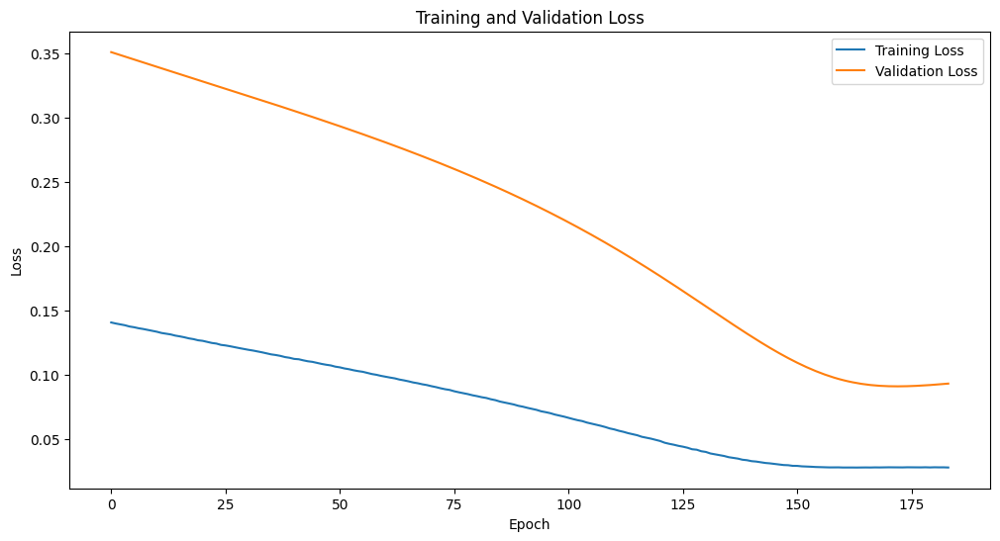

Epoch [1/2500], Train Loss: 0.1000, Val Loss: 0.2834
Epoch [2/2500], Train Loss: 0.0992, Val Loss: 0.2819
Epoch [3/2500], Train Loss: 0.0984, Val Loss: 0.2804
Epoch [4/2500], Train Loss: 0.0976, Val Loss: 0.2789
Epoch [5/2500], Train Loss: 0.0967, Val Loss: 0.2774
Epoch [6/2500], Train Loss: 0.0959, Val Loss: 0.2759
Epoch [7/2500], Train Loss: 0.0950, Val Loss: 0.2744
Epoch [8/2500], Train Loss: 0.0943, Val Loss: 0.2729
Epoch [9/2500], Train Loss: 0.0934, Val Loss: 0.2714
Epoch [10/2500], Train Loss: 0.0926, Val Loss: 0.2700
Epoch [11/2500], Train Loss: 0.0918, Val Loss: 0.2685
Epoch [12/2500], Train Loss: 0.0910, Val Loss: 0.2670
Epoch [13/2500], Train Loss: 0.0902, Val Loss: 0.2656
Epoch [14/2500], Train Loss: 0.0894, Val Loss: 0.2641
Epoch [15/2500], Train Loss: 0.0887, Val Loss: 0.2626
Epoch [16/2500], Train Loss: 0.0879, Val Loss: 0.2612
Epoch [17/2500], Train Loss: 0.0871, Val Loss: 0.2597
Epoch [18/2500], Train Loss: 0.0863, Val Loss: 0.2582
Epoch [19/2500], Train Loss: 0.0856, 

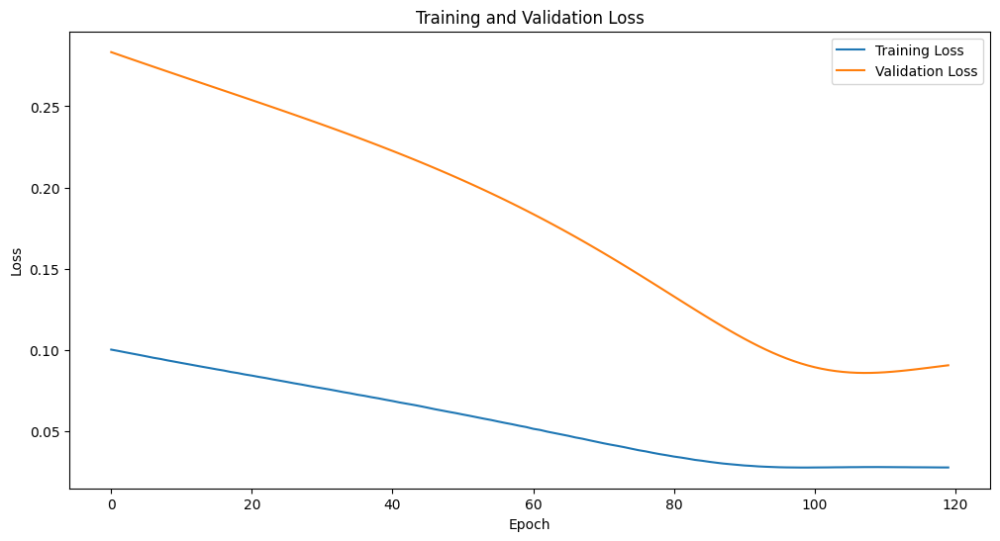

Epoch [1/2500], Train Loss: 0.0505, Val Loss: 0.1851
Epoch [2/2500], Train Loss: 0.0499, Val Loss: 0.1837
Epoch [3/2500], Train Loss: 0.0494, Val Loss: 0.1824
Epoch [4/2500], Train Loss: 0.0488, Val Loss: 0.1810
Epoch [5/2500], Train Loss: 0.0482, Val Loss: 0.1796
Epoch [6/2500], Train Loss: 0.0476, Val Loss: 0.1783
Epoch [7/2500], Train Loss: 0.0471, Val Loss: 0.1769
Epoch [8/2500], Train Loss: 0.0466, Val Loss: 0.1755
Epoch [9/2500], Train Loss: 0.0460, Val Loss: 0.1742
Epoch [10/2500], Train Loss: 0.0455, Val Loss: 0.1728
Epoch [11/2500], Train Loss: 0.0450, Val Loss: 0.1715
Epoch [12/2500], Train Loss: 0.0444, Val Loss: 0.1701
Epoch [13/2500], Train Loss: 0.0439, Val Loss: 0.1688
Epoch [14/2500], Train Loss: 0.0434, Val Loss: 0.1675
Epoch [15/2500], Train Loss: 0.0429, Val Loss: 0.1661
Epoch [16/2500], Train Loss: 0.0424, Val Loss: 0.1648
Epoch [17/2500], Train Loss: 0.0419, Val Loss: 0.1635
Epoch [18/2500], Train Loss: 0.0414, Val Loss: 0.1621
Epoch [19/2500], Train Loss: 0.0410, 

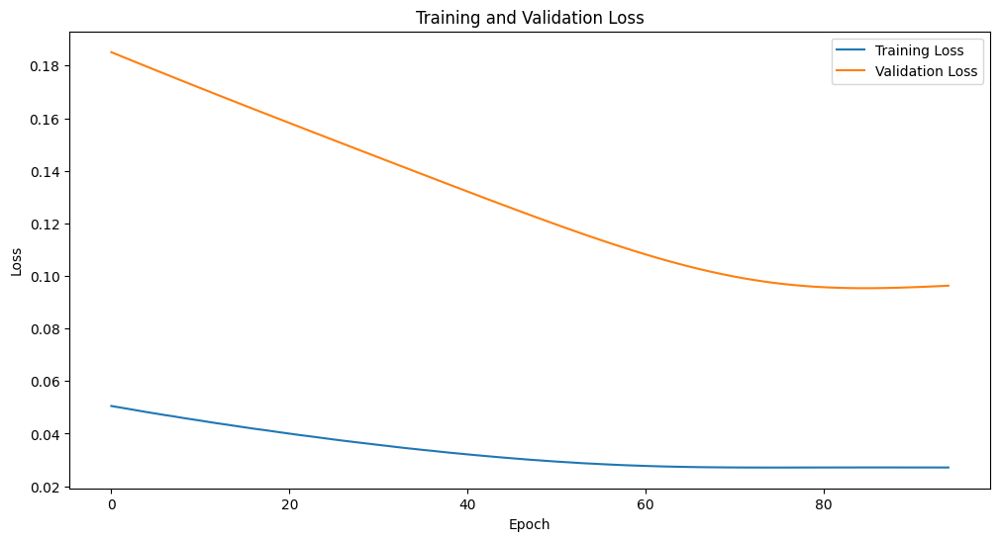

Epoch [1/2500], Train Loss: 0.0644, Val Loss: 0.2161
Epoch [2/2500], Train Loss: 0.0637, Val Loss: 0.2146
Epoch [3/2500], Train Loss: 0.0630, Val Loss: 0.2131
Epoch [4/2500], Train Loss: 0.0623, Val Loss: 0.2117
Epoch [5/2500], Train Loss: 0.0616, Val Loss: 0.2102
Epoch [6/2500], Train Loss: 0.0610, Val Loss: 0.2087
Epoch [7/2500], Train Loss: 0.0604, Val Loss: 0.2072
Epoch [8/2500], Train Loss: 0.0597, Val Loss: 0.2057
Epoch [9/2500], Train Loss: 0.0590, Val Loss: 0.2043
Epoch [10/2500], Train Loss: 0.0584, Val Loss: 0.2028
Epoch [11/2500], Train Loss: 0.0577, Val Loss: 0.2014
Epoch [12/2500], Train Loss: 0.0571, Val Loss: 0.1999
Epoch [13/2500], Train Loss: 0.0565, Val Loss: 0.1985
Epoch [14/2500], Train Loss: 0.0558, Val Loss: 0.1970
Epoch [15/2500], Train Loss: 0.0552, Val Loss: 0.1956
Epoch [16/2500], Train Loss: 0.0546, Val Loss: 0.1942
Epoch [17/2500], Train Loss: 0.0540, Val Loss: 0.1927
Epoch [18/2500], Train Loss: 0.0535, Val Loss: 0.1913
Epoch [19/2500], Train Loss: 0.0528, 

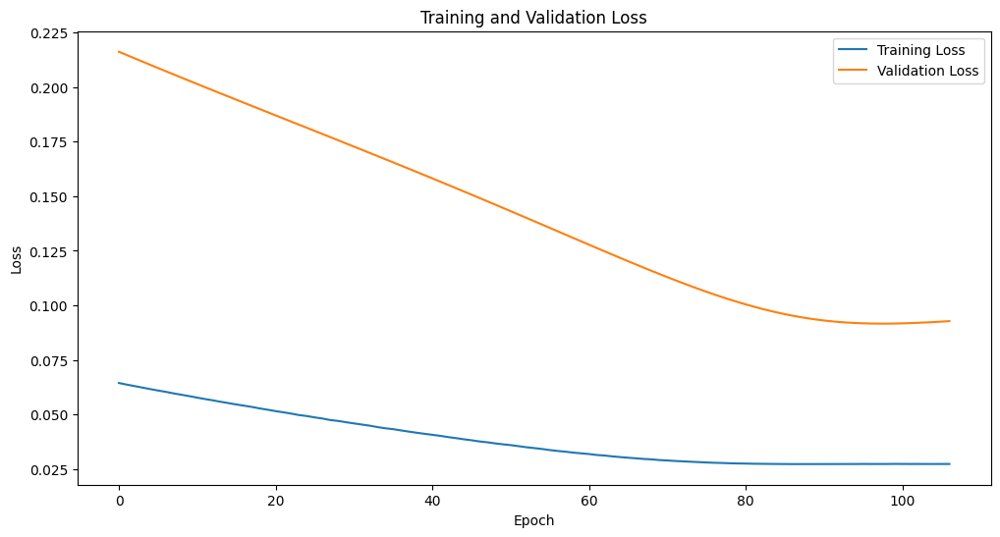

Epoch [1/2500], Train Loss: 0.0384, Val Loss: 0.1545
Epoch [2/2500], Train Loss: 0.0380, Val Loss: 0.1533
Epoch [3/2500], Train Loss: 0.0376, Val Loss: 0.1521
Epoch [4/2500], Train Loss: 0.0372, Val Loss: 0.1510
Epoch [5/2500], Train Loss: 0.0368, Val Loss: 0.1498
Epoch [6/2500], Train Loss: 0.0365, Val Loss: 0.1486
Epoch [7/2500], Train Loss: 0.0361, Val Loss: 0.1475
Epoch [8/2500], Train Loss: 0.0357, Val Loss: 0.1463
Epoch [9/2500], Train Loss: 0.0354, Val Loss: 0.1452
Epoch [10/2500], Train Loss: 0.0351, Val Loss: 0.1440
Epoch [11/2500], Train Loss: 0.0347, Val Loss: 0.1429
Epoch [12/2500], Train Loss: 0.0343, Val Loss: 0.1418
Epoch [13/2500], Train Loss: 0.0340, Val Loss: 0.1407
Epoch [14/2500], Train Loss: 0.0337, Val Loss: 0.1395
Epoch [15/2500], Train Loss: 0.0334, Val Loss: 0.1384
Epoch [16/2500], Train Loss: 0.0331, Val Loss: 0.1373
Epoch [17/2500], Train Loss: 0.0328, Val Loss: 0.1362
Epoch [18/2500], Train Loss: 0.0325, Val Loss: 0.1351
Epoch [19/2500], Train Loss: 0.0322, 

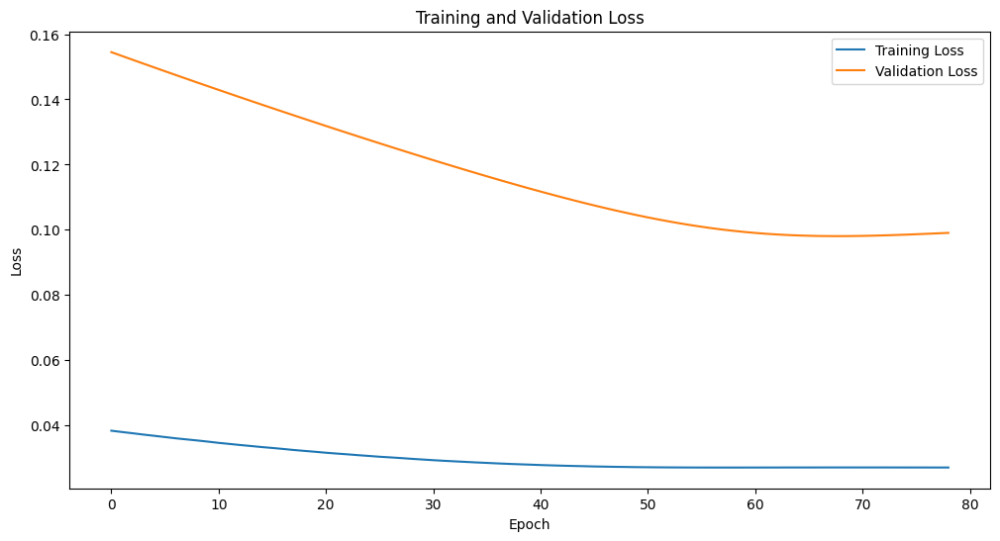

Epoch [1/2500], Train Loss: 0.0466, Val Loss: 0.1763
Epoch [2/2500], Train Loss: 0.0461, Val Loss: 0.1751
Epoch [3/2500], Train Loss: 0.0456, Val Loss: 0.1739
Epoch [4/2500], Train Loss: 0.0451, Val Loss: 0.1726
Epoch [5/2500], Train Loss: 0.0446, Val Loss: 0.1714
Epoch [6/2500], Train Loss: 0.0441, Val Loss: 0.1702
Epoch [7/2500], Train Loss: 0.0437, Val Loss: 0.1690
Epoch [8/2500], Train Loss: 0.0432, Val Loss: 0.1678
Epoch [9/2500], Train Loss: 0.0427, Val Loss: 0.1666
Epoch [10/2500], Train Loss: 0.0423, Val Loss: 0.1654
Epoch [11/2500], Train Loss: 0.0418, Val Loss: 0.1642
Epoch [12/2500], Train Loss: 0.0414, Val Loss: 0.1630
Epoch [13/2500], Train Loss: 0.0410, Val Loss: 0.1618
Epoch [14/2500], Train Loss: 0.0405, Val Loss: 0.1606
Epoch [15/2500], Train Loss: 0.0401, Val Loss: 0.1594
Epoch [16/2500], Train Loss: 0.0397, Val Loss: 0.1582
Epoch [17/2500], Train Loss: 0.0393, Val Loss: 0.1570
Epoch [18/2500], Train Loss: 0.0389, Val Loss: 0.1558
Epoch [19/2500], Train Loss: 0.0385, 

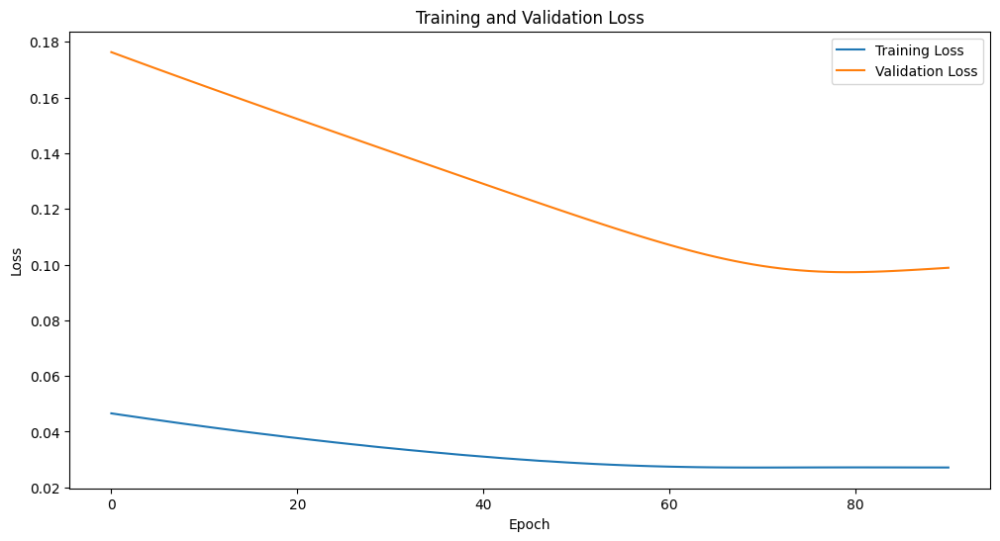

Epoch [1/2500], Train Loss: 0.1223, Val Loss: 0.3210
Epoch [2/2500], Train Loss: 0.1213, Val Loss: 0.3193
Epoch [3/2500], Train Loss: 0.1204, Val Loss: 0.3175
Epoch [4/2500], Train Loss: 0.1192, Val Loss: 0.3157
Epoch [5/2500], Train Loss: 0.1181, Val Loss: 0.3139
Epoch [6/2500], Train Loss: 0.1170, Val Loss: 0.3121
Epoch [7/2500], Train Loss: 0.1159, Val Loss: 0.3103
Epoch [8/2500], Train Loss: 0.1150, Val Loss: 0.3086
Epoch [9/2500], Train Loss: 0.1139, Val Loss: 0.3068
Epoch [10/2500], Train Loss: 0.1128, Val Loss: 0.3050
Epoch [11/2500], Train Loss: 0.1118, Val Loss: 0.3032
Epoch [12/2500], Train Loss: 0.1107, Val Loss: 0.3014
Epoch [13/2500], Train Loss: 0.1097, Val Loss: 0.2997
Epoch [14/2500], Train Loss: 0.1086, Val Loss: 0.2979
Epoch [15/2500], Train Loss: 0.1075, Val Loss: 0.2961
Epoch [16/2500], Train Loss: 0.1066, Val Loss: 0.2943
Epoch [17/2500], Train Loss: 0.1056, Val Loss: 0.2925
Epoch [18/2500], Train Loss: 0.1044, Val Loss: 0.2907
Epoch [19/2500], Train Loss: 0.1035, 

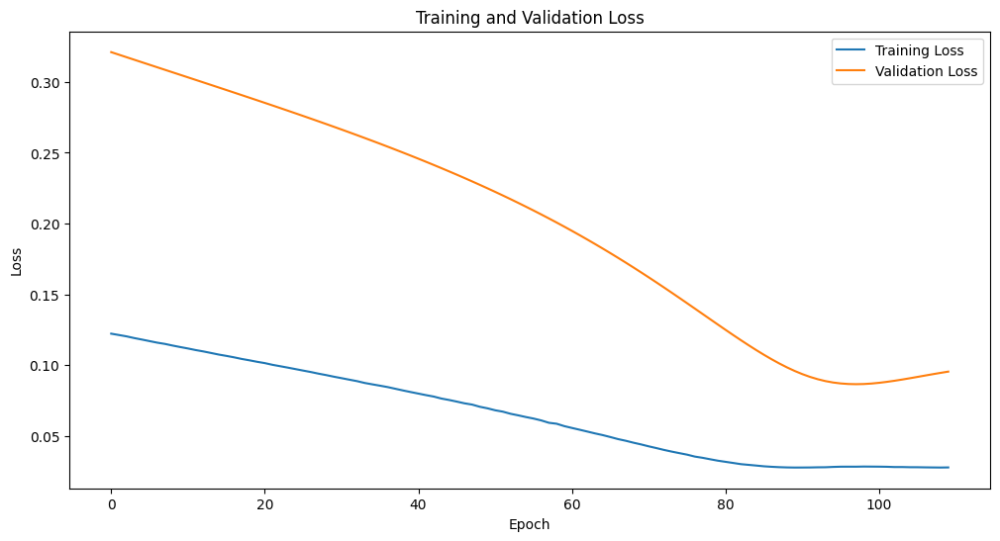

Epoch [1/2500], Train Loss: 0.0427, Val Loss: 0.1663
Epoch [2/2500], Train Loss: 0.0422, Val Loss: 0.1650
Epoch [3/2500], Train Loss: 0.0417, Val Loss: 0.1637
Epoch [4/2500], Train Loss: 0.0412, Val Loss: 0.1625
Epoch [5/2500], Train Loss: 0.0408, Val Loss: 0.1612
Epoch [6/2500], Train Loss: 0.0404, Val Loss: 0.1600
Epoch [7/2500], Train Loss: 0.0399, Val Loss: 0.1587
Epoch [8/2500], Train Loss: 0.0395, Val Loss: 0.1575
Epoch [9/2500], Train Loss: 0.0390, Val Loss: 0.1563
Epoch [10/2500], Train Loss: 0.0386, Val Loss: 0.1550
Epoch [11/2500], Train Loss: 0.0382, Val Loss: 0.1538
Epoch [12/2500], Train Loss: 0.0378, Val Loss: 0.1526
Epoch [13/2500], Train Loss: 0.0374, Val Loss: 0.1514
Epoch [14/2500], Train Loss: 0.0370, Val Loss: 0.1502
Epoch [15/2500], Train Loss: 0.0366, Val Loss: 0.1490
Epoch [16/2500], Train Loss: 0.0362, Val Loss: 0.1478
Epoch [17/2500], Train Loss: 0.0359, Val Loss: 0.1466
Epoch [18/2500], Train Loss: 0.0355, Val Loss: 0.1455
Epoch [19/2500], Train Loss: 0.0351, 

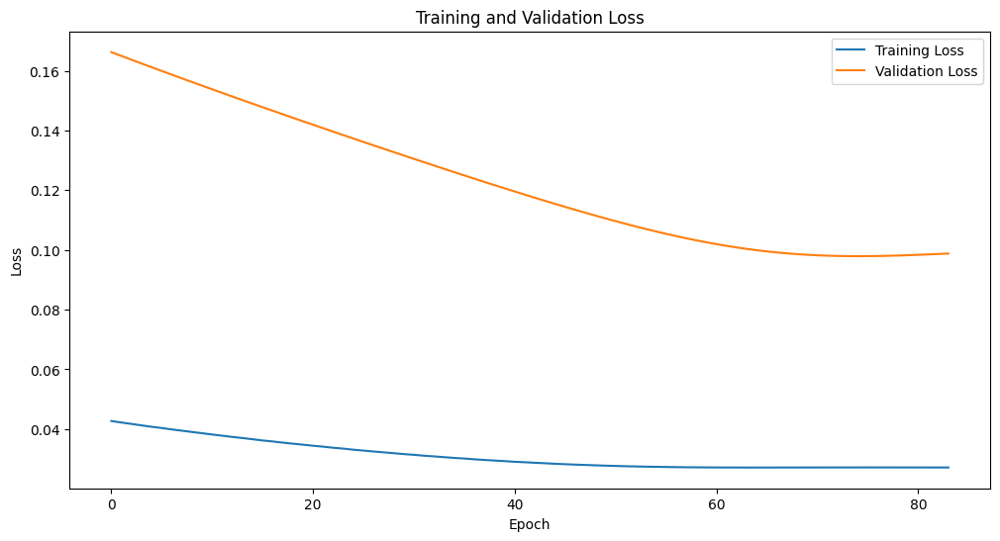

Epoch [1/2500], Train Loss: 0.0615, Val Loss: 0.2099
Epoch [2/2500], Train Loss: 0.0608, Val Loss: 0.2084
Epoch [3/2500], Train Loss: 0.0600, Val Loss: 0.2069
Epoch [4/2500], Train Loss: 0.0594, Val Loss: 0.2054
Epoch [5/2500], Train Loss: 0.0587, Val Loss: 0.2040
Epoch [6/2500], Train Loss: 0.0580, Val Loss: 0.2025
Epoch [7/2500], Train Loss: 0.0573, Val Loss: 0.2011
Epoch [8/2500], Train Loss: 0.0567, Val Loss: 0.1996
Epoch [9/2500], Train Loss: 0.0560, Val Loss: 0.1982
Epoch [10/2500], Train Loss: 0.0554, Val Loss: 0.1968
Epoch [11/2500], Train Loss: 0.0547, Val Loss: 0.1954
Epoch [12/2500], Train Loss: 0.0541, Val Loss: 0.1940
Epoch [13/2500], Train Loss: 0.0535, Val Loss: 0.1926
Epoch [14/2500], Train Loss: 0.0529, Val Loss: 0.1912
Epoch [15/2500], Train Loss: 0.0523, Val Loss: 0.1898
Epoch [16/2500], Train Loss: 0.0517, Val Loss: 0.1884
Epoch [17/2500], Train Loss: 0.0511, Val Loss: 0.1870
Epoch [18/2500], Train Loss: 0.0505, Val Loss: 0.1857
Epoch [19/2500], Train Loss: 0.0499, 

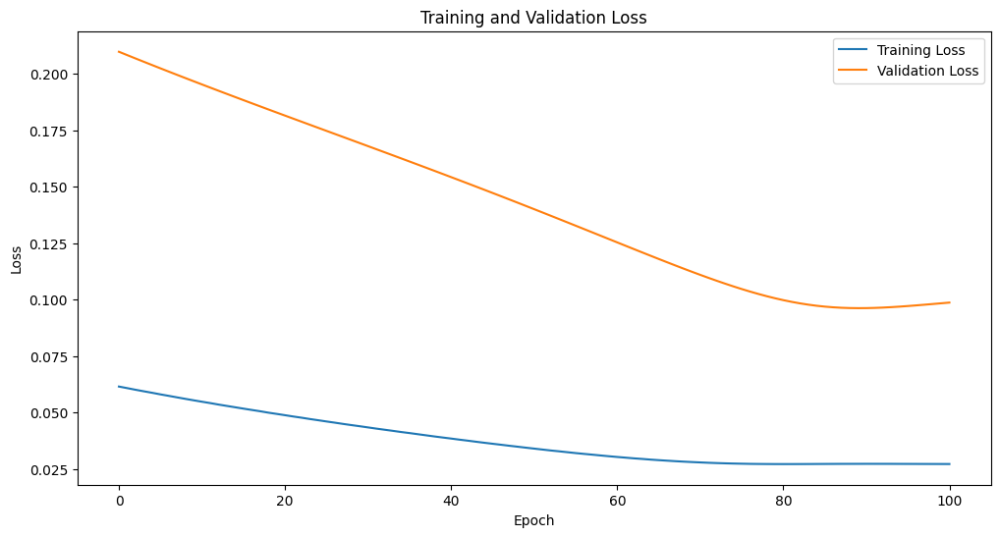

Epoch [1/2500], Train Loss: 0.0448, Val Loss: 0.1715
Epoch [2/2500], Train Loss: 0.0443, Val Loss: 0.1700
Epoch [3/2500], Train Loss: 0.0437, Val Loss: 0.1686
Epoch [4/2500], Train Loss: 0.0431, Val Loss: 0.1671
Epoch [5/2500], Train Loss: 0.0425, Val Loss: 0.1657
Epoch [6/2500], Train Loss: 0.0420, Val Loss: 0.1643
Epoch [7/2500], Train Loss: 0.0415, Val Loss: 0.1628
Epoch [8/2500], Train Loss: 0.0409, Val Loss: 0.1614
Epoch [9/2500], Train Loss: 0.0404, Val Loss: 0.1600
Epoch [10/2500], Train Loss: 0.0399, Val Loss: 0.1586
Epoch [11/2500], Train Loss: 0.0395, Val Loss: 0.1572
Epoch [12/2500], Train Loss: 0.0390, Val Loss: 0.1558
Epoch [13/2500], Train Loss: 0.0384, Val Loss: 0.1544
Epoch [14/2500], Train Loss: 0.0380, Val Loss: 0.1530
Epoch [15/2500], Train Loss: 0.0376, Val Loss: 0.1516
Epoch [16/2500], Train Loss: 0.0371, Val Loss: 0.1503
Epoch [17/2500], Train Loss: 0.0366, Val Loss: 0.1489
Epoch [18/2500], Train Loss: 0.0362, Val Loss: 0.1475
Epoch [19/2500], Train Loss: 0.0358, 

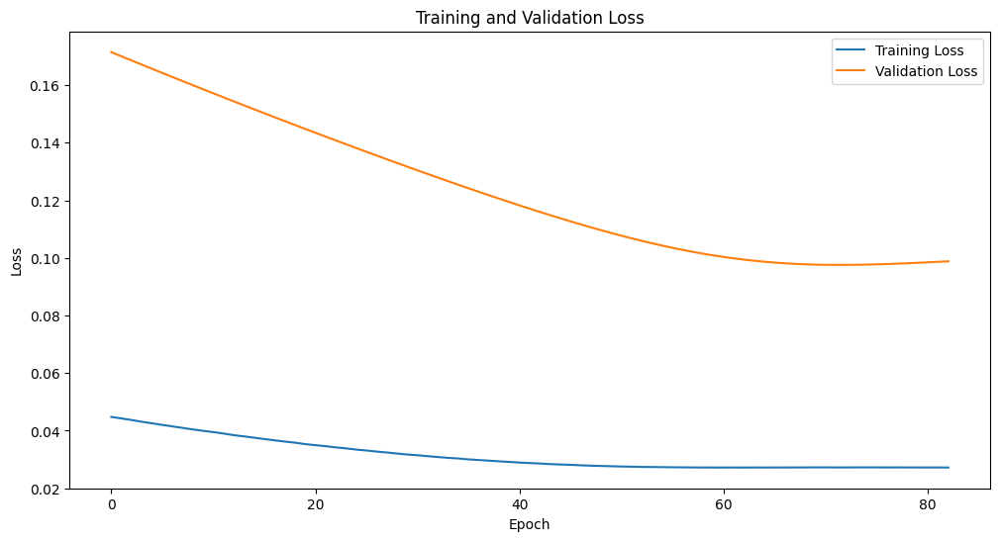

Epoch [1/2500], Train Loss: 0.0780, Val Loss: 0.2427
Epoch [2/2500], Train Loss: 0.0770, Val Loss: 0.2409
Epoch [3/2500], Train Loss: 0.0761, Val Loss: 0.2392
Epoch [4/2500], Train Loss: 0.0753, Val Loss: 0.2375
Epoch [5/2500], Train Loss: 0.0743, Val Loss: 0.2357
Epoch [6/2500], Train Loss: 0.0735, Val Loss: 0.2340
Epoch [7/2500], Train Loss: 0.0725, Val Loss: 0.2323
Epoch [8/2500], Train Loss: 0.0717, Val Loss: 0.2305
Epoch [9/2500], Train Loss: 0.0708, Val Loss: 0.2288
Epoch [10/2500], Train Loss: 0.0700, Val Loss: 0.2271
Epoch [11/2500], Train Loss: 0.0692, Val Loss: 0.2254
Epoch [12/2500], Train Loss: 0.0681, Val Loss: 0.2236
Epoch [13/2500], Train Loss: 0.0675, Val Loss: 0.2219
Epoch [14/2500], Train Loss: 0.0666, Val Loss: 0.2202
Epoch [15/2500], Train Loss: 0.0658, Val Loss: 0.2185
Epoch [16/2500], Train Loss: 0.0649, Val Loss: 0.2167
Epoch [17/2500], Train Loss: 0.0641, Val Loss: 0.2150
Epoch [18/2500], Train Loss: 0.0632, Val Loss: 0.2132
Epoch [19/2500], Train Loss: 0.0624, 

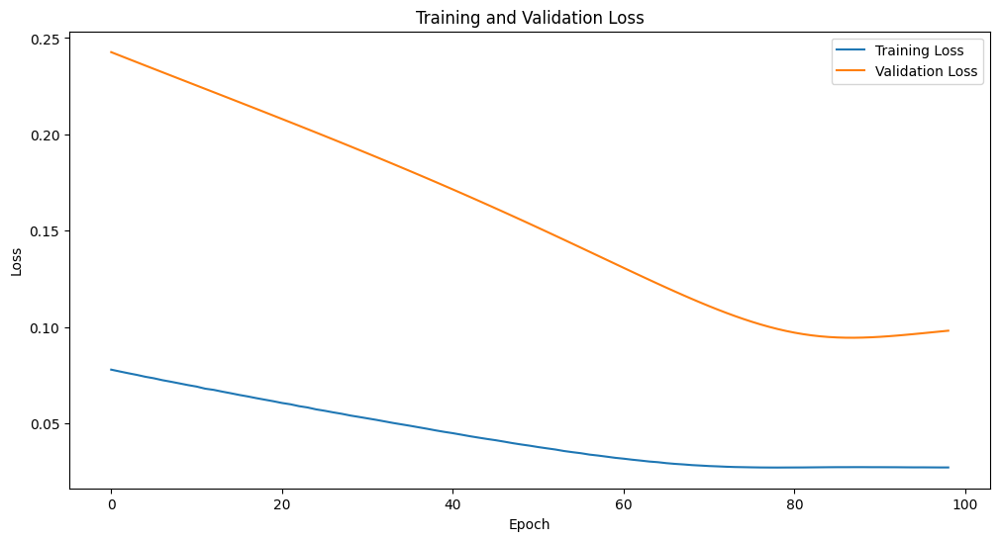

Epoch [1/2500], Train Loss: 0.0937, Val Loss: 0.2718
Epoch [2/2500], Train Loss: 0.0927, Val Loss: 0.2701
Epoch [3/2500], Train Loss: 0.0917, Val Loss: 0.2683
Epoch [4/2500], Train Loss: 0.0907, Val Loss: 0.2666
Epoch [5/2500], Train Loss: 0.0898, Val Loss: 0.2648
Epoch [6/2500], Train Loss: 0.0888, Val Loss: 0.2631
Epoch [7/2500], Train Loss: 0.0879, Val Loss: 0.2614
Epoch [8/2500], Train Loss: 0.0870, Val Loss: 0.2597
Epoch [9/2500], Train Loss: 0.0861, Val Loss: 0.2580
Epoch [10/2500], Train Loss: 0.0851, Val Loss: 0.2563
Epoch [11/2500], Train Loss: 0.0842, Val Loss: 0.2546
Epoch [12/2500], Train Loss: 0.0833, Val Loss: 0.2530
Epoch [13/2500], Train Loss: 0.0825, Val Loss: 0.2513
Epoch [14/2500], Train Loss: 0.0816, Val Loss: 0.2497
Epoch [15/2500], Train Loss: 0.0807, Val Loss: 0.2480
Epoch [16/2500], Train Loss: 0.0798, Val Loss: 0.2464
Epoch [17/2500], Train Loss: 0.0789, Val Loss: 0.2447
Epoch [18/2500], Train Loss: 0.0781, Val Loss: 0.2431
Epoch [19/2500], Train Loss: 0.0773, 

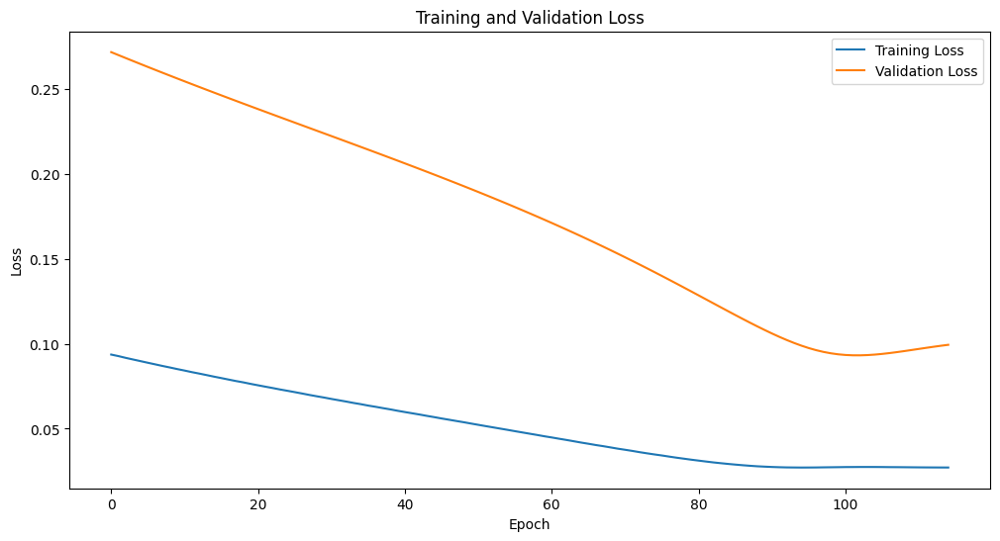

Epoch [1/2500], Train Loss: 0.0606, Val Loss: 0.2080
Epoch [2/2500], Train Loss: 0.0599, Val Loss: 0.2065
Epoch [3/2500], Train Loss: 0.0592, Val Loss: 0.2051
Epoch [4/2500], Train Loss: 0.0585, Val Loss: 0.2037
Epoch [5/2500], Train Loss: 0.0580, Val Loss: 0.2023
Epoch [6/2500], Train Loss: 0.0572, Val Loss: 0.2008
Epoch [7/2500], Train Loss: 0.0565, Val Loss: 0.1994
Epoch [8/2500], Train Loss: 0.0560, Val Loss: 0.1980
Epoch [9/2500], Train Loss: 0.0553, Val Loss: 0.1966
Epoch [10/2500], Train Loss: 0.0547, Val Loss: 0.1952
Epoch [11/2500], Train Loss: 0.0540, Val Loss: 0.1938
Epoch [12/2500], Train Loss: 0.0535, Val Loss: 0.1924
Epoch [13/2500], Train Loss: 0.0528, Val Loss: 0.1910
Epoch [14/2500], Train Loss: 0.0522, Val Loss: 0.1896
Epoch [15/2500], Train Loss: 0.0517, Val Loss: 0.1882
Epoch [16/2500], Train Loss: 0.0510, Val Loss: 0.1867
Epoch [17/2500], Train Loss: 0.0504, Val Loss: 0.1853
Epoch [18/2500], Train Loss: 0.0498, Val Loss: 0.1839
Epoch [19/2500], Train Loss: 0.0492, 

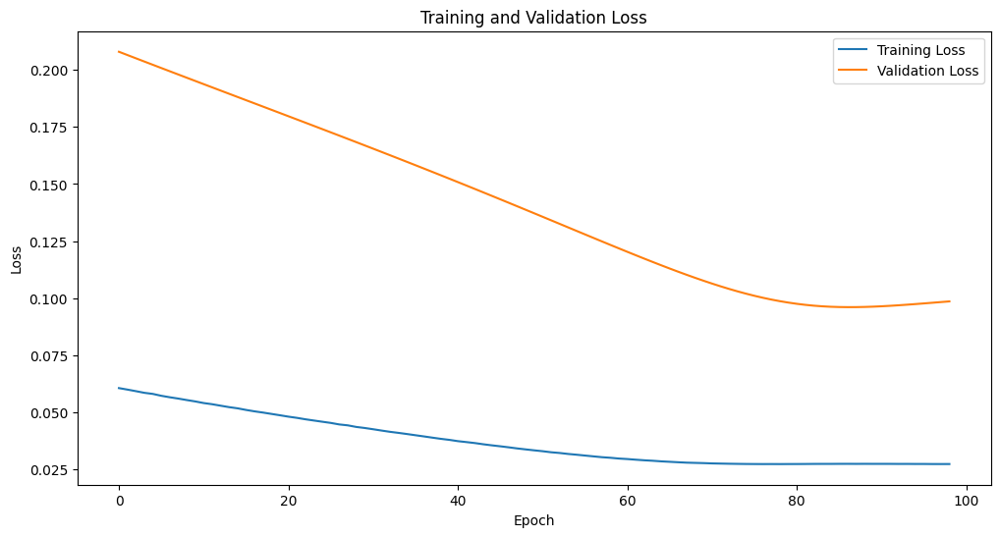

In [526]:
# Hyperparameters
input_size = 5  # Number of features
hidden_sizes = [16,32,64]  # Hidden units
output_size = 1  # Predicting 'Close'
num_layerss = [3,6,9,12]  # Number of LSTM layers
dropouts = [0.3,0.1,0.5]  # Dropout rate
learning_rates = [0.001,0.01,0.0001]
num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None

for learning_rate in learning_rates:
    for hidden_size in hidden_sizes:
        for num_layers in num_layerss:
            for dropout in dropouts:
                # Initialize the model, loss function, and optimizer
                model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
                criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
                optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
                
                # Train the model
                
                model, train_losses, val_losses = train_model(
                    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
                )
    
                if best_trainloss == None:
                    best_trainloss = train_losses[-1]
    
                if best_trainloss > train_losses[-1]:
                    best_trainloss = train_losses[-1]
                    best_hidden_size = hidden_size
                    best_num_layers = num_layers
                    best_dropout = dropout
                    best_model = model

In [528]:
print(f"best_hidden_size:{best_hidden_size}, best_num_layers:{best_num_layers}, best_dropout:{best_dropout},")

best_hidden_size:64, best_num_layers:6, best_dropout:0.3,


/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([999, 1, 5])) that is different to the input size (torch.Size([999, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([245, 1, 5])) that is different to the input size (torch.Size([245, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch [1/5000], Train Loss: 0.0804, Val Loss: 0.2453
Epoch [2/5000], Train Loss: 0.0800, Val Loss: 0.2445
Epoch [3/5000], Train Loss: 0.0796, Val Loss: 0.2437
Epoch [4/5000], Train Loss: 0.0791, Val Loss: 0.2429
Epoch [5/5000], Train Loss: 0.0787, Val Loss: 0.2420
Epoch [6/5000], Train Loss: 0.0783, Val Loss: 0.2412
Epoch [7/5000], Train Loss: 0.0778, Val Loss: 0.2404
Epoch [8/5000], Train Loss: 0.0774, Val Loss: 0.2396
Epoch [9/5000], Train Loss: 0.0770, Val Loss: 0.2388
Epoch [10/5000], Train Loss: 0.0765, Val Loss: 0.2380
Epoch [11/5000], Train Loss: 0.0761, Val Loss: 0.2371
Epoch [12/5000], Train Loss: 0.0757, Val Loss: 0.2363
Epoch [13/5000], Train Loss: 0.0753, Val Loss: 0.2355
Epoch [14/5000], Train Loss: 0.0748, Val Loss: 0.2347
Epoch [15/5000], Train Loss: 0.0743, Val Loss: 0.2338
Epoch [16/5000], Train Loss: 0.0739, Val Loss: 0.2330
Epoch [17/5000], Train Loss: 0.0735, Val Loss: 0.2322
Epoch [18/5000], Train Loss: 0.0730, Val Loss: 0.2313
Epoch [19/5000], Train Loss: 0.0726, 

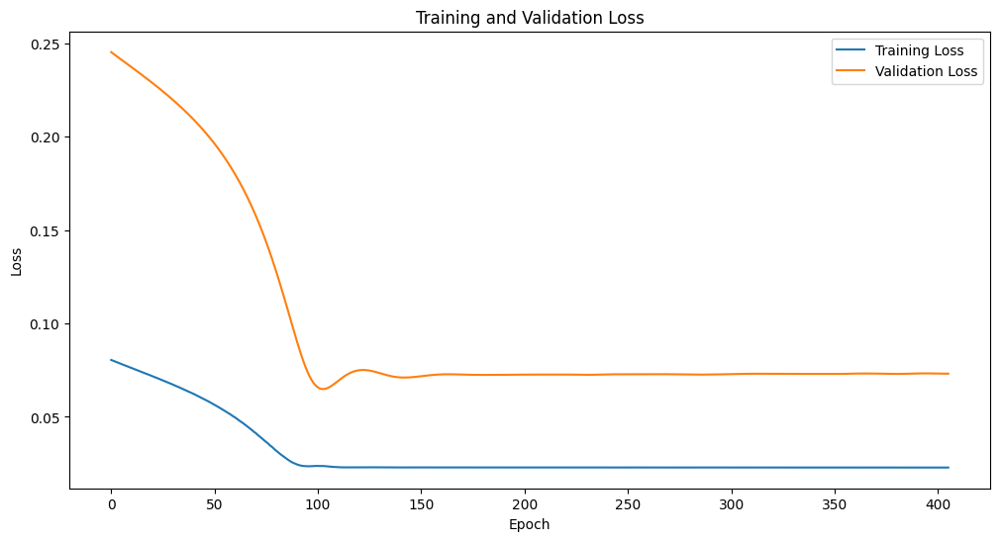

In [540]:
# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 5  # Predicting all
num_layers = 6  # Number of LSTM layers
dropout = 0.3  # Dropout rate
learning_rate = 0.0001
num_epochs = 5000
patience = 50
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


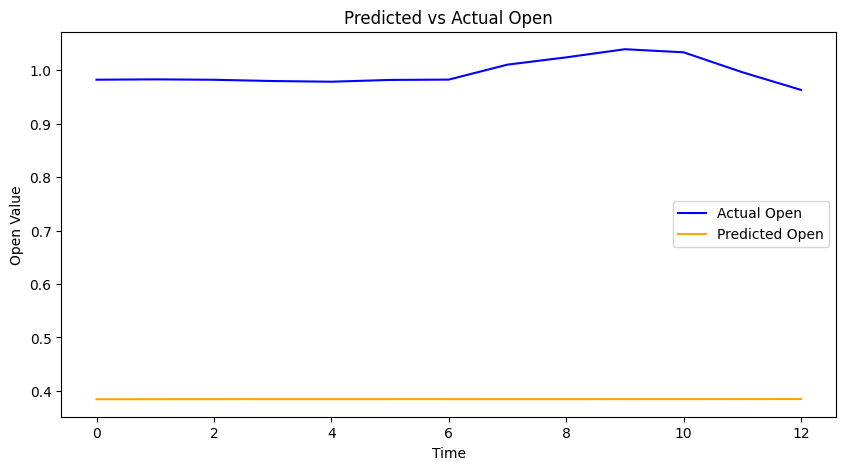

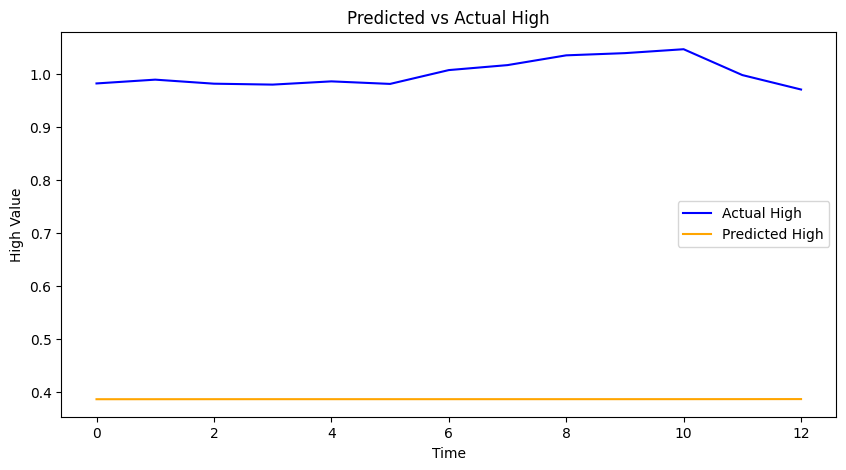

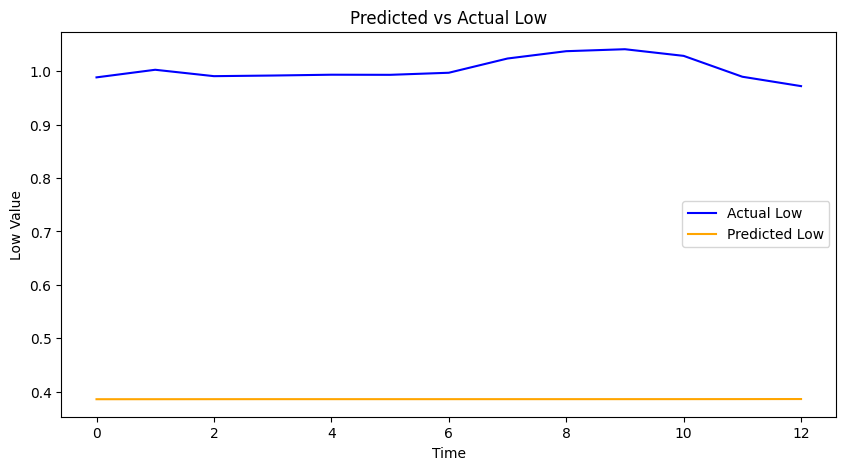

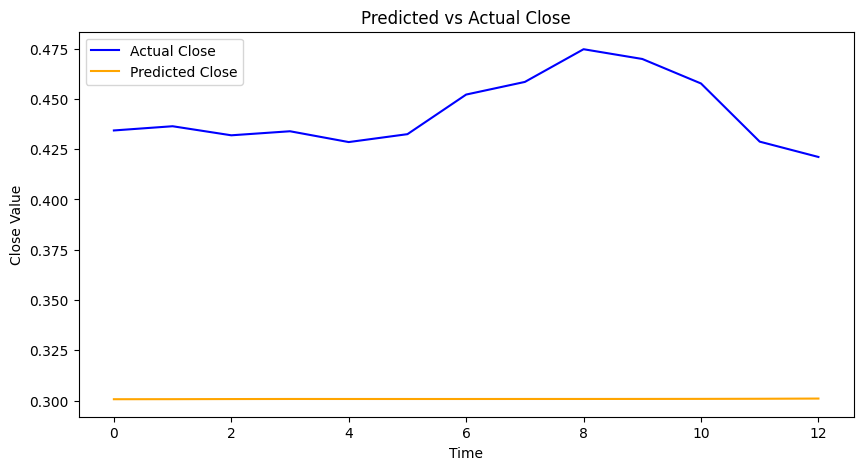

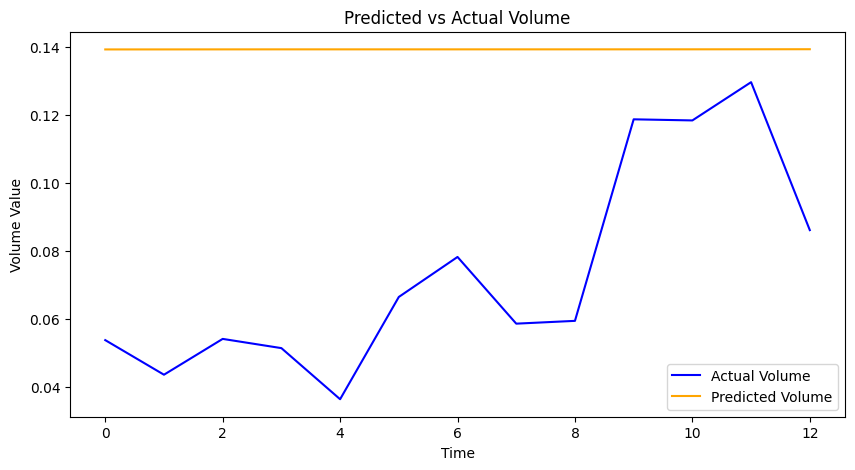

Mean Squared Error (MSE): 0.2320
Mean Absolute Error (MAE): 0.4103


In [541]:
mse, mae = evaluate_model_all_features_with_plots(model, X_test, y_test, scaler, device, scale_columns)

### Checking each feature

Epoch [1/3000], Train Loss: 0.0892, Val Loss: 0.3354
Epoch [2/3000], Train Loss: 0.0797, Val Loss: 0.3118
Epoch [3/3000], Train Loss: 0.0707, Val Loss: 0.2881
Epoch [4/3000], Train Loss: 0.0622, Val Loss: 0.2638
Epoch [5/3000], Train Loss: 0.0540, Val Loss: 0.2386
Epoch [6/3000], Train Loss: 0.0463, Val Loss: 0.2119
Epoch [7/3000], Train Loss: 0.0390, Val Loss: 0.1837
Epoch [8/3000], Train Loss: 0.0324, Val Loss: 0.1538
Epoch [9/3000], Train Loss: 0.0270, Val Loss: 0.1227
Epoch [10/3000], Train Loss: 0.0233, Val Loss: 0.0919
Epoch [11/3000], Train Loss: 0.0223, Val Loss: 0.0651
Epoch [12/3000], Train Loss: 0.0244, Val Loss: 0.0481
Epoch [13/3000], Train Loss: 0.0277, Val Loss: 0.0415
Epoch [14/3000], Train Loss: 0.0291, Val Loss: 0.0423
Epoch [15/3000], Train Loss: 0.0280, Val Loss: 0.0481
Epoch [16/3000], Train Loss: 0.0256, Val Loss: 0.0569
Epoch [17/3000], Train Loss: 0.0229, Val Loss: 0.0672
Epoch [18/3000], Train Loss: 0.0211, Val Loss: 0.0776
Epoch [19/3000], Train Loss: 0.0200, 

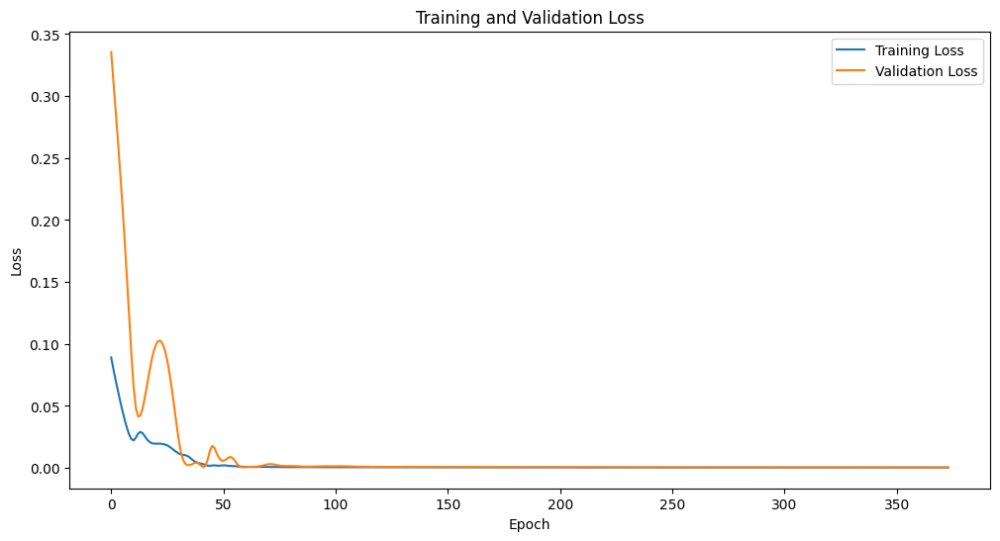

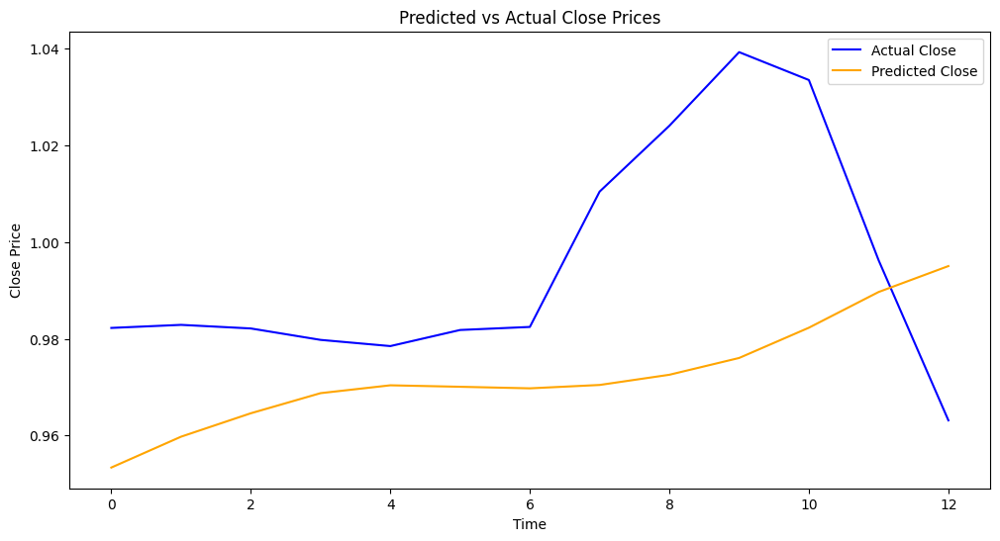

Mean Squared Error (MSE): 0.0011
Mean Absolute Error (MAE): 0.0275


In [556]:

# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 30
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/3000], Train Loss: 0.0939, Val Loss: 0.3490
Epoch [2/3000], Train Loss: 0.0846, Val Loss: 0.3262
Epoch [3/3000], Train Loss: 0.0757, Val Loss: 0.3030
Epoch [4/3000], Train Loss: 0.0672, Val Loss: 0.2789
Epoch [5/3000], Train Loss: 0.0588, Val Loss: 0.2534
Epoch [6/3000], Train Loss: 0.0507, Val Loss: 0.2258
Epoch [7/3000], Train Loss: 0.0428, Val Loss: 0.1958
Epoch [8/3000], Train Loss: 0.0353, Val Loss: 0.1632
Epoch [9/3000], Train Loss: 0.0286, Val Loss: 0.1282
Epoch [10/3000], Train Loss: 0.0236, Val Loss: 0.0926
Epoch [11/3000], Train Loss: 0.0217, Val Loss: 0.0608
Epoch [12/3000], Train Loss: 0.0242, Val Loss: 0.0411
Epoch [13/3000], Train Loss: 0.0285, Val Loss: 0.0348
Epoch [14/3000], Train Loss: 0.0301, Val Loss: 0.0373
Epoch [15/3000], Train Loss: 0.0286, Val Loss: 0.0455
Epoch [16/3000], Train Loss: 0.0256, Val Loss: 0.0571
Epoch [17/3000], Train Loss: 0.0228, Val Loss: 0.0702
Epoch [18/3000], Train Loss: 0.0210, Val Loss: 0.0831
Epoch [19/3000], Train Loss: 0.0202, 

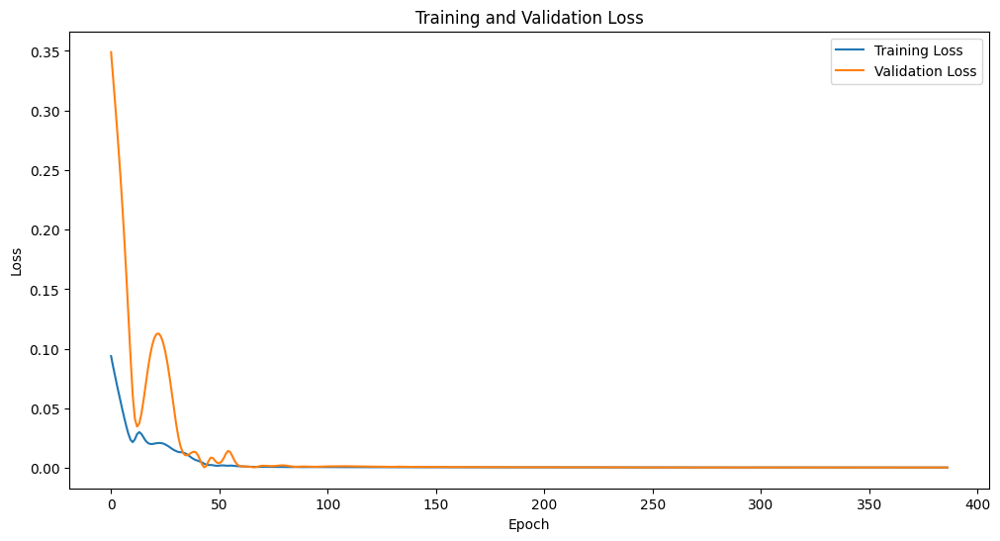

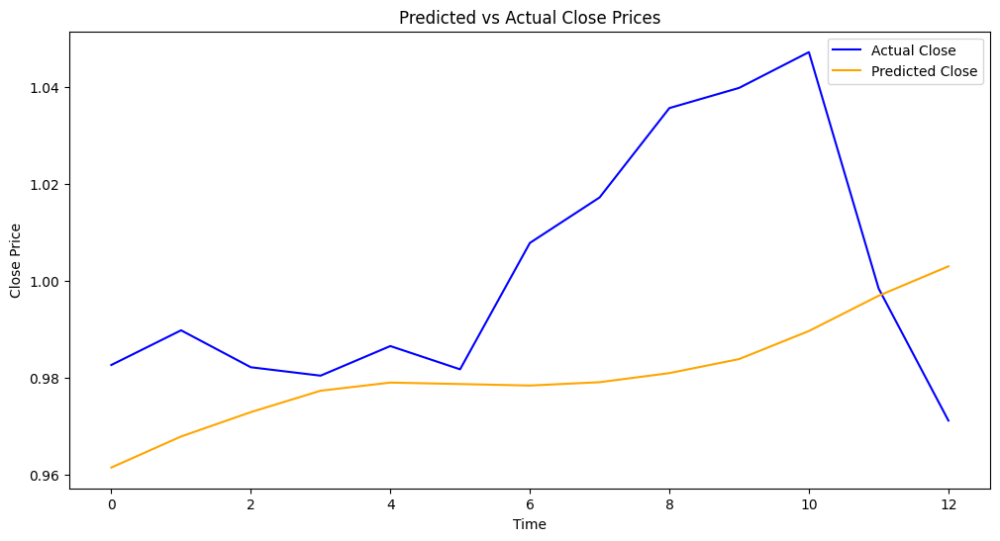

Mean Squared Error (MSE): 0.0011
Mean Absolute Error (MAE): 0.0258


In [558]:

# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='High', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='High', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='High', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 30
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/3000], Train Loss: 0.0981, Val Loss: 0.3591
Epoch [2/3000], Train Loss: 0.0882, Val Loss: 0.3362
Epoch [3/3000], Train Loss: 0.0791, Val Loss: 0.3138
Epoch [4/3000], Train Loss: 0.0706, Val Loss: 0.2915
Epoch [5/3000], Train Loss: 0.0625, Val Loss: 0.2690
Epoch [6/3000], Train Loss: 0.0550, Val Loss: 0.2459
Epoch [7/3000], Train Loss: 0.0479, Val Loss: 0.2221
Epoch [8/3000], Train Loss: 0.0412, Val Loss: 0.1972
Epoch [9/3000], Train Loss: 0.0351, Val Loss: 0.1711
Epoch [10/3000], Train Loss: 0.0295, Val Loss: 0.1439
Epoch [11/3000], Train Loss: 0.0252, Val Loss: 0.1160
Epoch [12/3000], Train Loss: 0.0224, Val Loss: 0.0886
Epoch [13/3000], Train Loss: 0.0219, Val Loss: 0.0648
Epoch [14/3000], Train Loss: 0.0236, Val Loss: 0.0484
Epoch [15/3000], Train Loss: 0.0262, Val Loss: 0.0409
Epoch [16/3000], Train Loss: 0.0279, Val Loss: 0.0402
Epoch [17/3000], Train Loss: 0.0273, Val Loss: 0.0442
Epoch [18/3000], Train Loss: 0.0253, Val Loss: 0.0513
Epoch [19/3000], Train Loss: 0.0230, 

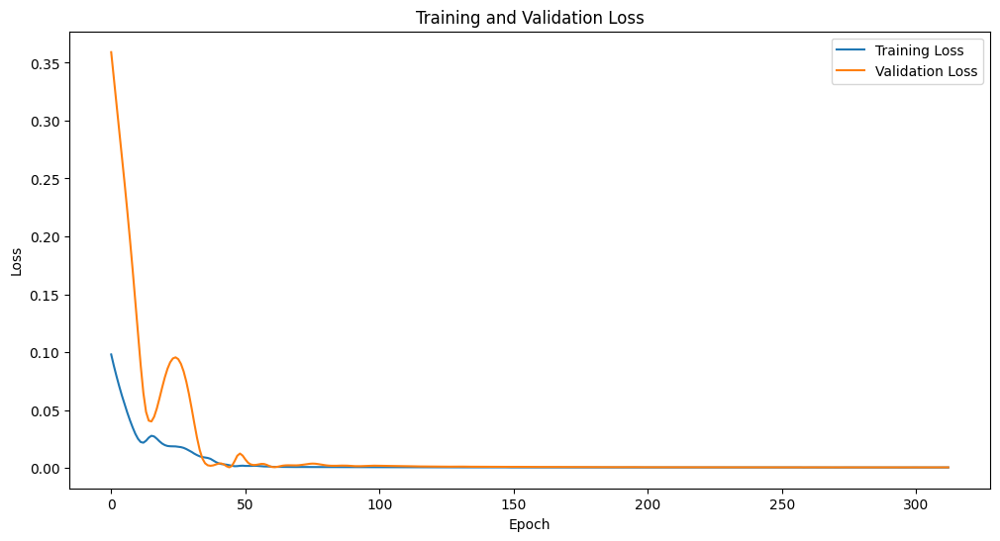

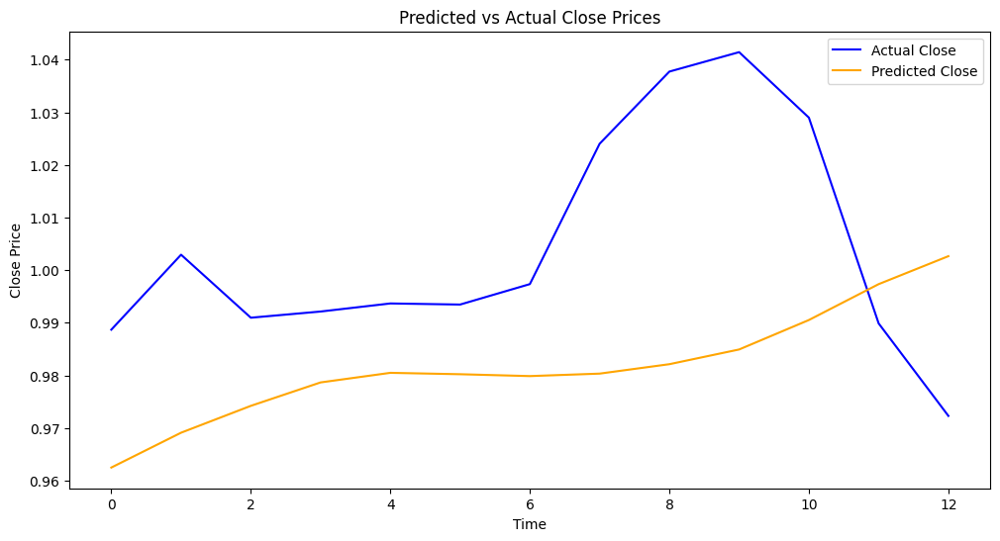

Mean Squared Error (MSE): 0.0010
Mean Absolute Error (MAE): 0.0282


In [560]:

# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 30
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/3000], Train Loss: 0.0140, Val Loss: 0.0016
Epoch [2/3000], Train Loss: 0.0105, Val Loss: 0.0008
Epoch [3/3000], Train Loss: 0.0079, Val Loss: 0.0008
Epoch [4/3000], Train Loss: 0.0059, Val Loss: 0.0018
Epoch [5/3000], Train Loss: 0.0048, Val Loss: 0.0037
Epoch [6/3000], Train Loss: 0.0046, Val Loss: 0.0060
Epoch [7/3000], Train Loss: 0.0051, Val Loss: 0.0077
Epoch [8/3000], Train Loss: 0.0057, Val Loss: 0.0081
Epoch [9/3000], Train Loss: 0.0059, Val Loss: 0.0075
Epoch [10/3000], Train Loss: 0.0057, Val Loss: 0.0064
Epoch [11/3000], Train Loss: 0.0053, Val Loss: 0.0052
Epoch [12/3000], Train Loss: 0.0048, Val Loss: 0.0040
Epoch [13/3000], Train Loss: 0.0045, Val Loss: 0.0031
Epoch [14/3000], Train Loss: 0.0044, Val Loss: 0.0024
Epoch [15/3000], Train Loss: 0.0043, Val Loss: 0.0019
Epoch [16/3000], Train Loss: 0.0044, Val Loss: 0.0016
Epoch [17/3000], Train Loss: 0.0044, Val Loss: 0.0014
Epoch [18/3000], Train Loss: 0.0045, Val Loss: 0.0012
Epoch [19/3000], Train Loss: 0.0046, 

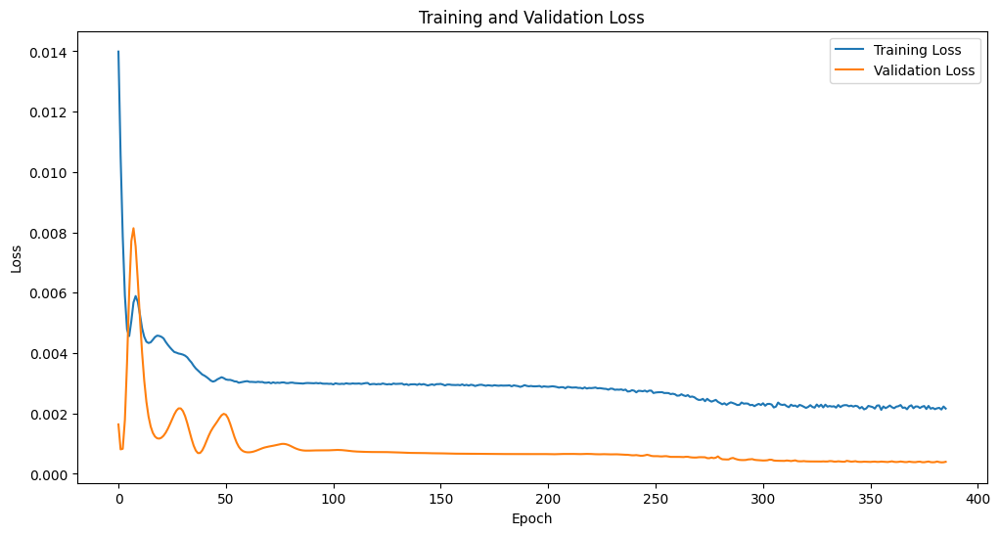

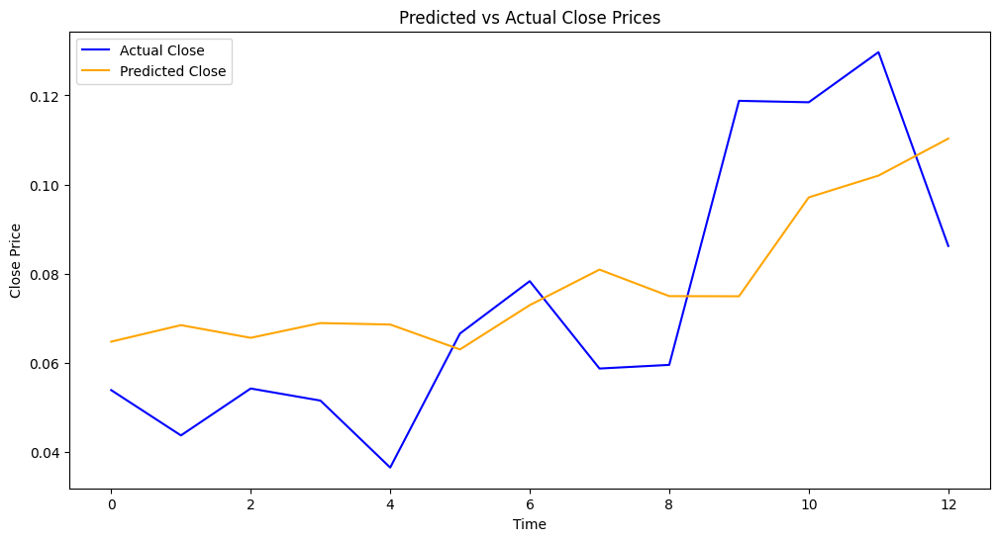

Mean Squared Error (MSE): 0.0005
Mean Absolute Error (MAE): 0.0200


In [562]:

# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropout = 0.1  # Dropout rate
learning_rate = 0.001
num_epochs = 3000
patience = 30
device = 'cpu'

# Initialize the model, loss function, and optimizer
model = StockPriceLSTM(input_size, hidden_size, output_size, num_layers, dropout).to(device)
criterion = nn.HuberLoss()  # Use Mean Squared Error Loss
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)


mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

# GRU

In [604]:
import torch.nn as nn

class StockPriceGRU(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers, dropout):
        super(StockPriceGRU, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.gru = nn.GRU(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # Initial hidden state
        out, _ = self.gru(x, h0)  # GRU output
        out = self.fc(out[:, -1, :])  # Fully connected layer (last hidden state)
        return out


Epoch [1/2500], Train Loss: 0.1154, Val Loss: 0.0925
Epoch [2/2500], Train Loss: 0.1092, Val Loss: 0.0852
Epoch [3/2500], Train Loss: 0.1031, Val Loss: 0.0781
Epoch [4/2500], Train Loss: 0.0967, Val Loss: 0.0713
Epoch [5/2500], Train Loss: 0.0906, Val Loss: 0.0647
Epoch [6/2500], Train Loss: 0.0860, Val Loss: 0.0584
Epoch [7/2500], Train Loss: 0.0809, Val Loss: 0.0523
Epoch [8/2500], Train Loss: 0.0752, Val Loss: 0.0464
Epoch [9/2500], Train Loss: 0.0697, Val Loss: 0.0408
Epoch [10/2500], Train Loss: 0.0656, Val Loss: 0.0355
Epoch [11/2500], Train Loss: 0.0613, Val Loss: 0.0305
Epoch [12/2500], Train Loss: 0.0569, Val Loss: 0.0257
Epoch [13/2500], Train Loss: 0.0532, Val Loss: 0.0213
Epoch [14/2500], Train Loss: 0.0492, Val Loss: 0.0173
Epoch [15/2500], Train Loss: 0.0459, Val Loss: 0.0136
Epoch [16/2500], Train Loss: 0.0431, Val Loss: 0.0104
Epoch [17/2500], Train Loss: 0.0408, Val Loss: 0.0076
Epoch [18/2500], Train Loss: 0.0383, Val Loss: 0.0053
Epoch [19/2500], Train Loss: 0.0365, 

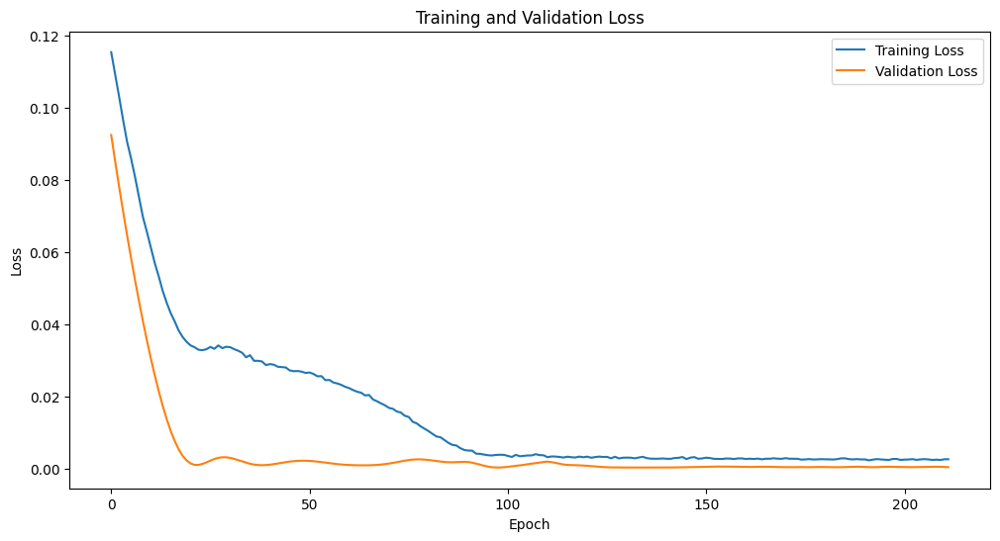

Epoch [1/2500], Train Loss: 0.0626, Val Loss: 0.0417
Epoch [2/2500], Train Loss: 0.0578, Val Loss: 0.0357
Epoch [3/2500], Train Loss: 0.0536, Val Loss: 0.0302
Epoch [4/2500], Train Loss: 0.0496, Val Loss: 0.0252
Epoch [5/2500], Train Loss: 0.0462, Val Loss: 0.0207
Epoch [6/2500], Train Loss: 0.0431, Val Loss: 0.0167
Epoch [7/2500], Train Loss: 0.0403, Val Loss: 0.0132
Epoch [8/2500], Train Loss: 0.0380, Val Loss: 0.0102
Epoch [9/2500], Train Loss: 0.0360, Val Loss: 0.0077
Epoch [10/2500], Train Loss: 0.0346, Val Loss: 0.0056
Epoch [11/2500], Train Loss: 0.0334, Val Loss: 0.0040
Epoch [12/2500], Train Loss: 0.0326, Val Loss: 0.0028
Epoch [13/2500], Train Loss: 0.0321, Val Loss: 0.0020
Epoch [14/2500], Train Loss: 0.0319, Val Loss: 0.0015
Epoch [15/2500], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0317, Val Loss: 0.0011
Epoch [17/2500], Train Loss: 0.0321, Val Loss: 0.0011
Epoch [18/2500], Train Loss: 0.0323, Val Loss: 0.0011
Epoch [19/2500], Train Loss: 0.0321, 

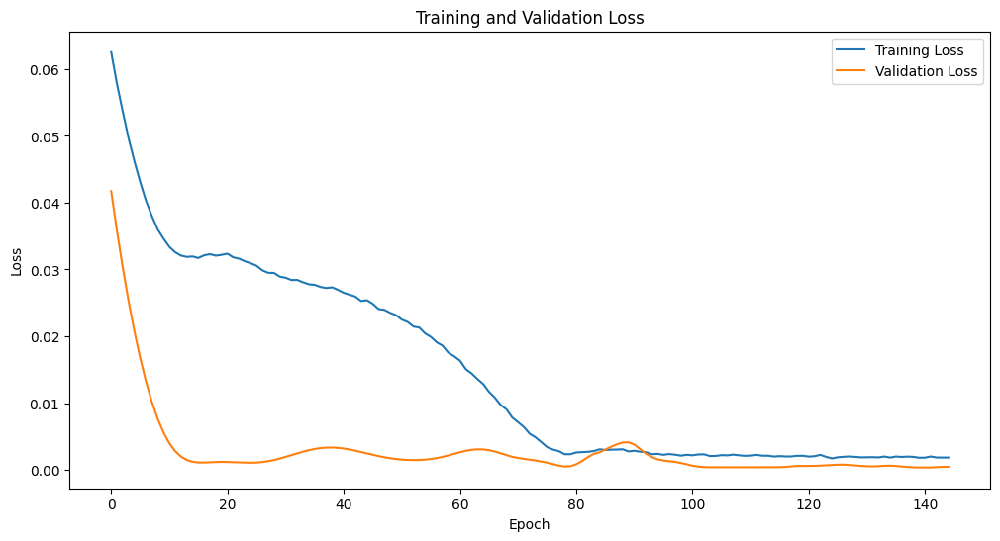

Epoch [1/2500], Train Loss: 0.0944, Val Loss: 0.0704
Epoch [2/2500], Train Loss: 0.0895, Val Loss: 0.0654
Epoch [3/2500], Train Loss: 0.0858, Val Loss: 0.0605
Epoch [4/2500], Train Loss: 0.0812, Val Loss: 0.0558
Epoch [5/2500], Train Loss: 0.0774, Val Loss: 0.0513
Epoch [6/2500], Train Loss: 0.0740, Val Loss: 0.0469
Epoch [7/2500], Train Loss: 0.0704, Val Loss: 0.0427
Epoch [8/2500], Train Loss: 0.0667, Val Loss: 0.0386
Epoch [9/2500], Train Loss: 0.0641, Val Loss: 0.0346
Epoch [10/2500], Train Loss: 0.0606, Val Loss: 0.0308
Epoch [11/2500], Train Loss: 0.0571, Val Loss: 0.0271
Epoch [12/2500], Train Loss: 0.0542, Val Loss: 0.0236
Epoch [13/2500], Train Loss: 0.0512, Val Loss: 0.0202
Epoch [14/2500], Train Loss: 0.0488, Val Loss: 0.0170
Epoch [15/2500], Train Loss: 0.0466, Val Loss: 0.0141
Epoch [16/2500], Train Loss: 0.0444, Val Loss: 0.0113
Epoch [17/2500], Train Loss: 0.0419, Val Loss: 0.0088
Epoch [18/2500], Train Loss: 0.0399, Val Loss: 0.0067
Epoch [19/2500], Train Loss: 0.0382, 

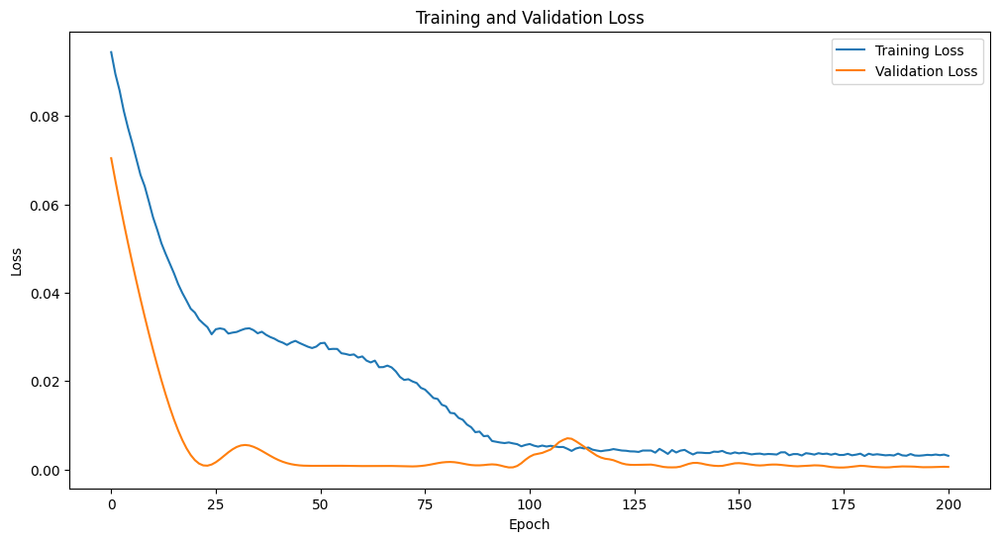

Epoch [1/2500], Train Loss: 0.1466, Val Loss: 0.1308
Epoch [2/2500], Train Loss: 0.1358, Val Loss: 0.1187
Epoch [3/2500], Train Loss: 0.1254, Val Loss: 0.1073
Epoch [4/2500], Train Loss: 0.1154, Val Loss: 0.0966
Epoch [5/2500], Train Loss: 0.1061, Val Loss: 0.0866
Epoch [6/2500], Train Loss: 0.0969, Val Loss: 0.0772
Epoch [7/2500], Train Loss: 0.0895, Val Loss: 0.0685
Epoch [8/2500], Train Loss: 0.0819, Val Loss: 0.0604
Epoch [9/2500], Train Loss: 0.0753, Val Loss: 0.0529
Epoch [10/2500], Train Loss: 0.0698, Val Loss: 0.0459
Epoch [11/2500], Train Loss: 0.0631, Val Loss: 0.0394
Epoch [12/2500], Train Loss: 0.0577, Val Loss: 0.0335
Epoch [13/2500], Train Loss: 0.0537, Val Loss: 0.0281
Epoch [14/2500], Train Loss: 0.0495, Val Loss: 0.0232
Epoch [15/2500], Train Loss: 0.0459, Val Loss: 0.0188
Epoch [16/2500], Train Loss: 0.0423, Val Loss: 0.0148
Epoch [17/2500], Train Loss: 0.0402, Val Loss: 0.0114
Epoch [18/2500], Train Loss: 0.0374, Val Loss: 0.0086
Epoch [19/2500], Train Loss: 0.0350, 

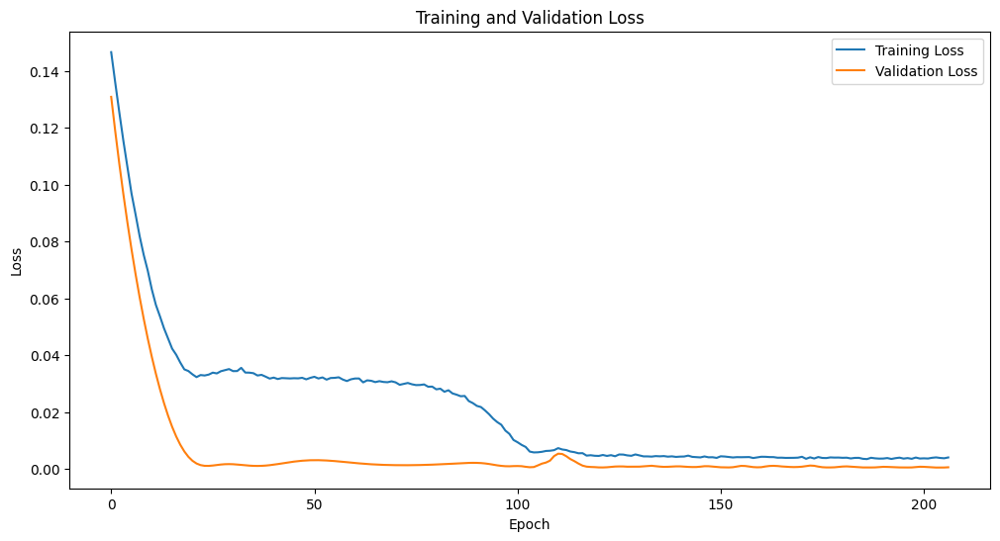

Epoch [1/2500], Train Loss: 0.1554, Val Loss: 0.1389
Epoch [2/2500], Train Loss: 0.1425, Val Loss: 0.1249
Epoch [3/2500], Train Loss: 0.1304, Val Loss: 0.1119
Epoch [4/2500], Train Loss: 0.1196, Val Loss: 0.0996
Epoch [5/2500], Train Loss: 0.1084, Val Loss: 0.0881
Epoch [6/2500], Train Loss: 0.0986, Val Loss: 0.0774
Epoch [7/2500], Train Loss: 0.0895, Val Loss: 0.0673
Epoch [8/2500], Train Loss: 0.0806, Val Loss: 0.0580
Epoch [9/2500], Train Loss: 0.0728, Val Loss: 0.0493
Epoch [10/2500], Train Loss: 0.0654, Val Loss: 0.0413
Epoch [11/2500], Train Loss: 0.0595, Val Loss: 0.0339
Epoch [12/2500], Train Loss: 0.0532, Val Loss: 0.0273
Epoch [13/2500], Train Loss: 0.0482, Val Loss: 0.0214
Epoch [14/2500], Train Loss: 0.0437, Val Loss: 0.0162
Epoch [15/2500], Train Loss: 0.0399, Val Loss: 0.0118
Epoch [16/2500], Train Loss: 0.0367, Val Loss: 0.0082
Epoch [17/2500], Train Loss: 0.0346, Val Loss: 0.0054
Epoch [18/2500], Train Loss: 0.0326, Val Loss: 0.0033
Epoch [19/2500], Train Loss: 0.0321, 

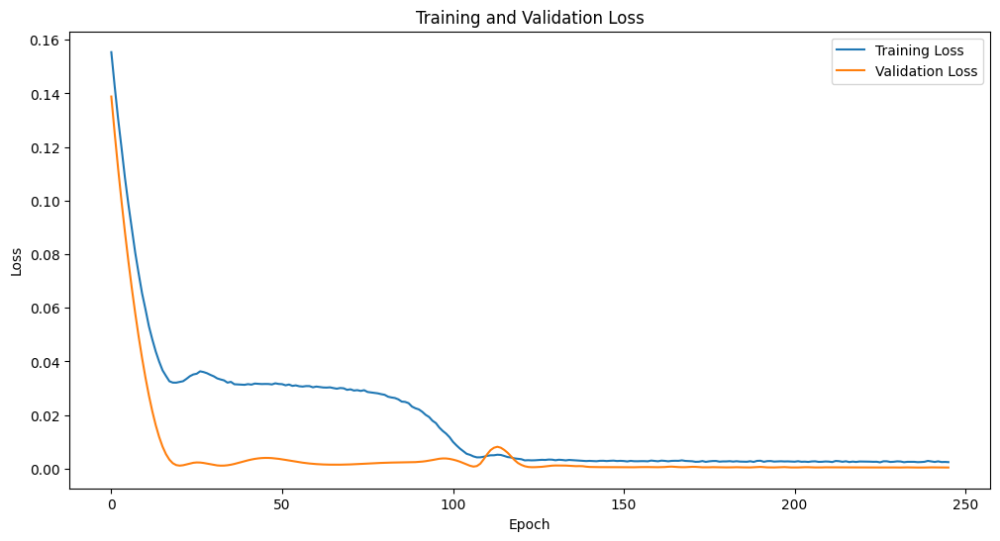

Epoch [1/2500], Train Loss: 0.0486, Val Loss: 0.0226
Epoch [2/2500], Train Loss: 0.0455, Val Loss: 0.0180
Epoch [3/2500], Train Loss: 0.0431, Val Loss: 0.0140
Epoch [4/2500], Train Loss: 0.0392, Val Loss: 0.0106
Epoch [5/2500], Train Loss: 0.0370, Val Loss: 0.0078
Epoch [6/2500], Train Loss: 0.0367, Val Loss: 0.0055
Epoch [7/2500], Train Loss: 0.0342, Val Loss: 0.0037
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0025
Epoch [9/2500], Train Loss: 0.0341, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0343, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0332, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0343, Val Loss: 0.0011
Epoch [13/2500], Train Loss: 0.0341, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0350, Val Loss: 0.0012
Epoch [15/2500], Train Loss: 0.0337, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0348, Val Loss: 0.0011
Epoch [17/2500], Train Loss: 0.0342, Val Loss: 0.0011
Epoch [18/2500], Train Loss: 0.0339, Val Loss: 0.0011
Epoch [19/2500], Train Loss: 0.0335, 

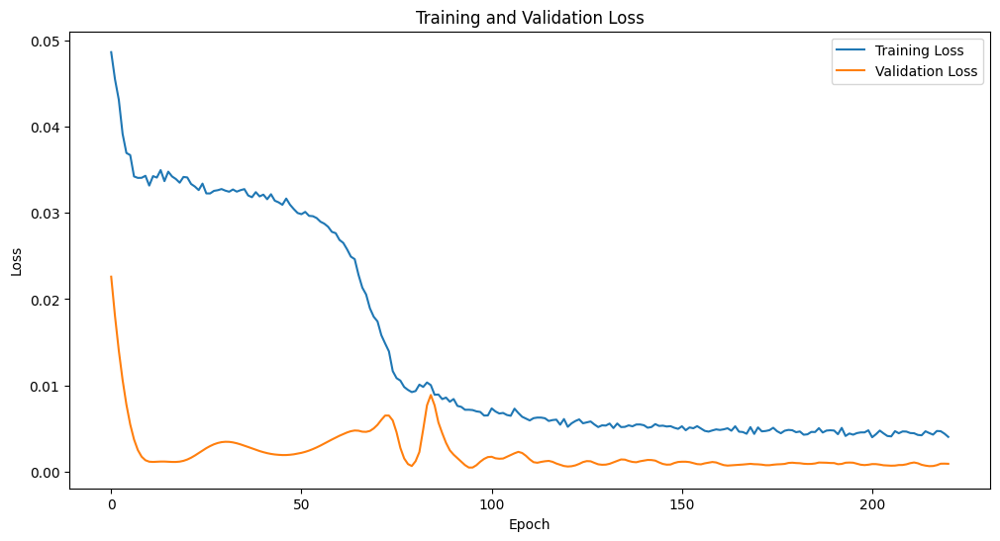

Epoch [1/2500], Train Loss: 0.0831, Val Loss: 0.0659
Epoch [2/2500], Train Loss: 0.0787, Val Loss: 0.0605
Epoch [3/2500], Train Loss: 0.0741, Val Loss: 0.0554
Epoch [4/2500], Train Loss: 0.0698, Val Loss: 0.0506
Epoch [5/2500], Train Loss: 0.0661, Val Loss: 0.0460
Epoch [6/2500], Train Loss: 0.0623, Val Loss: 0.0416
Epoch [7/2500], Train Loss: 0.0589, Val Loss: 0.0375
Epoch [8/2500], Train Loss: 0.0555, Val Loss: 0.0335
Epoch [9/2500], Train Loss: 0.0524, Val Loss: 0.0298
Epoch [10/2500], Train Loss: 0.0497, Val Loss: 0.0263
Epoch [11/2500], Train Loss: 0.0470, Val Loss: 0.0229
Epoch [12/2500], Train Loss: 0.0441, Val Loss: 0.0198
Epoch [13/2500], Train Loss: 0.0421, Val Loss: 0.0168
Epoch [14/2500], Train Loss: 0.0398, Val Loss: 0.0141
Epoch [15/2500], Train Loss: 0.0385, Val Loss: 0.0116
Epoch [16/2500], Train Loss: 0.0368, Val Loss: 0.0094
Epoch [17/2500], Train Loss: 0.0353, Val Loss: 0.0074
Epoch [18/2500], Train Loss: 0.0344, Val Loss: 0.0057
Epoch [19/2500], Train Loss: 0.0335, 

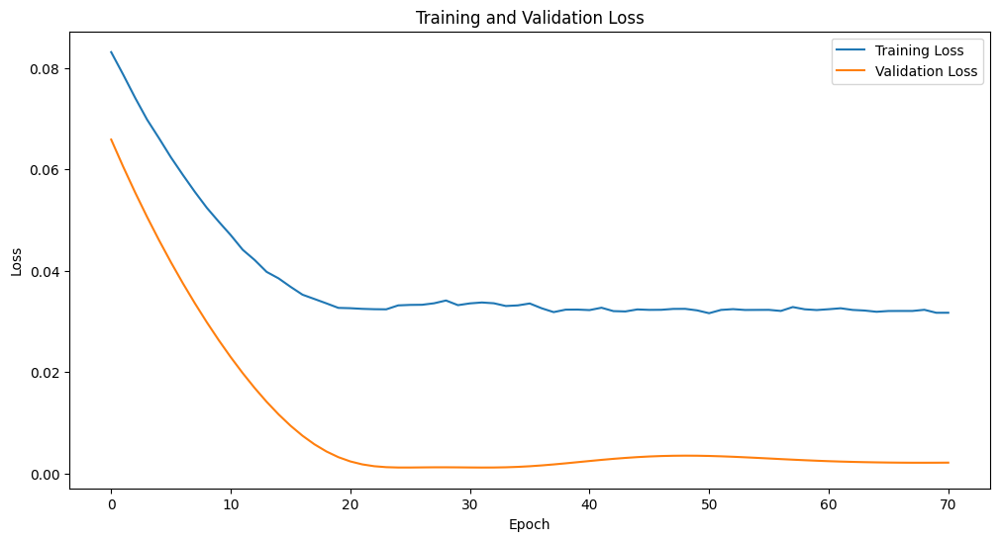

Epoch [1/2500], Train Loss: 0.2477, Val Loss: 0.2418
Epoch [2/2500], Train Loss: 0.2344, Val Loss: 0.2276
Epoch [3/2500], Train Loss: 0.2218, Val Loss: 0.2138
Epoch [4/2500], Train Loss: 0.2093, Val Loss: 0.2003
Epoch [5/2500], Train Loss: 0.1978, Val Loss: 0.1873
Epoch [6/2500], Train Loss: 0.1861, Val Loss: 0.1745
Epoch [7/2500], Train Loss: 0.1751, Val Loss: 0.1620
Epoch [8/2500], Train Loss: 0.1634, Val Loss: 0.1498
Epoch [9/2500], Train Loss: 0.1531, Val Loss: 0.1377
Epoch [10/2500], Train Loss: 0.1424, Val Loss: 0.1260
Epoch [11/2500], Train Loss: 0.1317, Val Loss: 0.1144
Epoch [12/2500], Train Loss: 0.1219, Val Loss: 0.1030
Epoch [13/2500], Train Loss: 0.1118, Val Loss: 0.0920
Epoch [14/2500], Train Loss: 0.1028, Val Loss: 0.0812
Epoch [15/2500], Train Loss: 0.0935, Val Loss: 0.0708
Epoch [16/2500], Train Loss: 0.0843, Val Loss: 0.0608
Epoch [17/2500], Train Loss: 0.0751, Val Loss: 0.0514
Epoch [18/2500], Train Loss: 0.0683, Val Loss: 0.0425
Epoch [19/2500], Train Loss: 0.0599, 

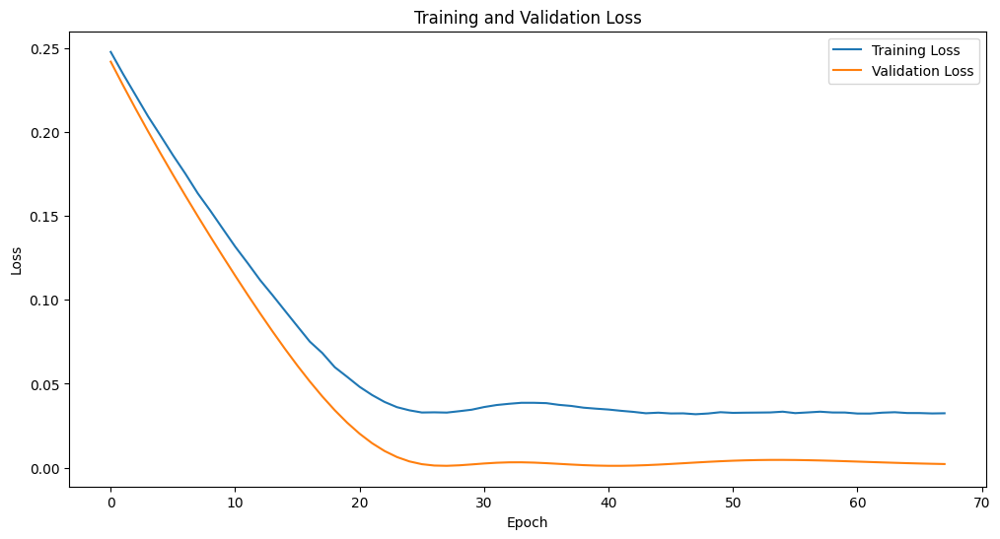

Epoch [1/2500], Train Loss: 0.1057, Val Loss: 0.0888
Epoch [2/2500], Train Loss: 0.0975, Val Loss: 0.0797
Epoch [3/2500], Train Loss: 0.0901, Val Loss: 0.0711
Epoch [4/2500], Train Loss: 0.0835, Val Loss: 0.0631
Epoch [5/2500], Train Loss: 0.0754, Val Loss: 0.0557
Epoch [6/2500], Train Loss: 0.0700, Val Loss: 0.0486
Epoch [7/2500], Train Loss: 0.0644, Val Loss: 0.0421
Epoch [8/2500], Train Loss: 0.0594, Val Loss: 0.0360
Epoch [9/2500], Train Loss: 0.0537, Val Loss: 0.0304
Epoch [10/2500], Train Loss: 0.0502, Val Loss: 0.0252
Epoch [11/2500], Train Loss: 0.0464, Val Loss: 0.0205
Epoch [12/2500], Train Loss: 0.0429, Val Loss: 0.0162
Epoch [13/2500], Train Loss: 0.0403, Val Loss: 0.0125
Epoch [14/2500], Train Loss: 0.0376, Val Loss: 0.0093
Epoch [15/2500], Train Loss: 0.0356, Val Loss: 0.0066
Epoch [16/2500], Train Loss: 0.0351, Val Loss: 0.0045
Epoch [17/2500], Train Loss: 0.0339, Val Loss: 0.0030
Epoch [18/2500], Train Loss: 0.0331, Val Loss: 0.0020
Epoch [19/2500], Train Loss: 0.0340, 

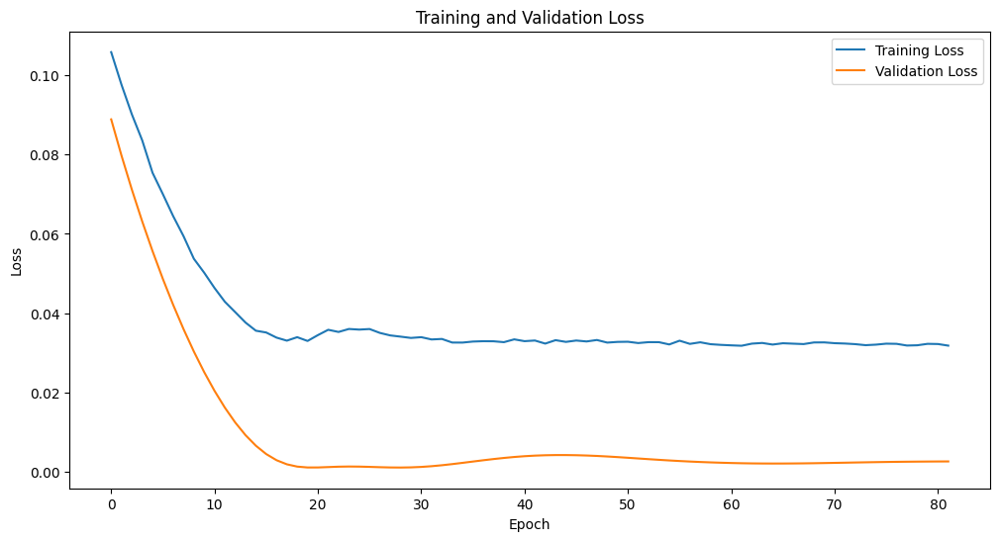

Epoch [1/2500], Train Loss: 0.0319, Val Loss: 0.0021
Epoch [2/2500], Train Loss: 0.0324, Val Loss: 0.0019
Epoch [3/2500], Train Loss: 0.0325, Val Loss: 0.0022
Epoch [4/2500], Train Loss: 0.0322, Val Loss: 0.0025
Epoch [5/2500], Train Loss: 0.0321, Val Loss: 0.0029
Epoch [6/2500], Train Loss: 0.0325, Val Loss: 0.0030
Epoch [7/2500], Train Loss: 0.0321, Val Loss: 0.0029
Epoch [8/2500], Train Loss: 0.0321, Val Loss: 0.0027
Epoch [9/2500], Train Loss: 0.0320, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0318, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0322, Val Loss: 0.0022
Epoch [12/2500], Train Loss: 0.0318, Val Loss: 0.0022
Epoch [13/2500], Train Loss: 0.0322, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0318, Val Loss: 0.0024
Epoch [15/2500], Train Loss: 0.0320, Val Loss: 0.0026
Epoch [16/2500], Train Loss: 0.0319, Val Loss: 0.0027
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0027
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0027
Epoch [19/2500], Train Loss: 0.0318, 

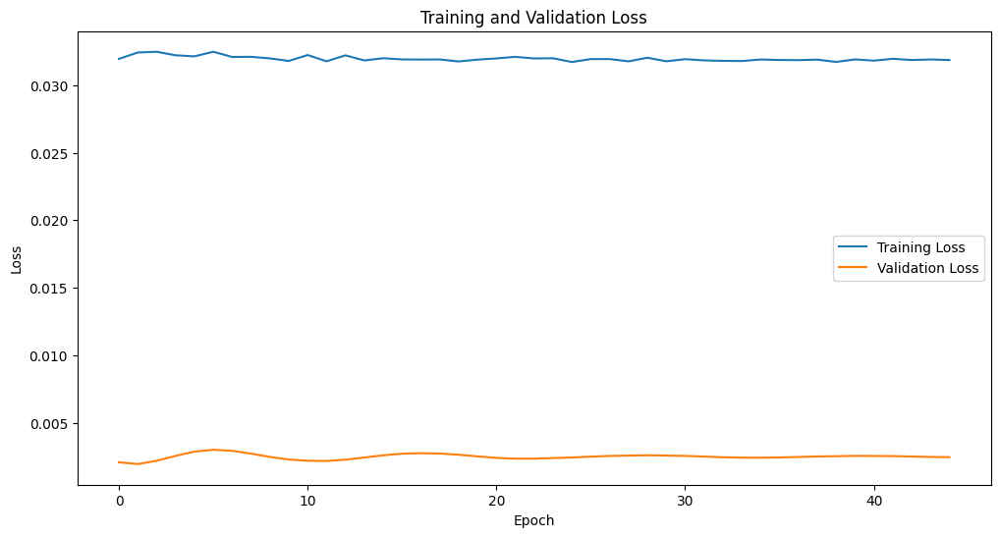

Epoch [1/2500], Train Loss: 0.0992, Val Loss: 0.0800
Epoch [2/2500], Train Loss: 0.0912, Val Loss: 0.0713
Epoch [3/2500], Train Loss: 0.0836, Val Loss: 0.0633
Epoch [4/2500], Train Loss: 0.0770, Val Loss: 0.0558
Epoch [5/2500], Train Loss: 0.0703, Val Loss: 0.0490
Epoch [6/2500], Train Loss: 0.0649, Val Loss: 0.0426
Epoch [7/2500], Train Loss: 0.0594, Val Loss: 0.0368
Epoch [8/2500], Train Loss: 0.0549, Val Loss: 0.0315
Epoch [9/2500], Train Loss: 0.0506, Val Loss: 0.0266
Epoch [10/2500], Train Loss: 0.0470, Val Loss: 0.0221
Epoch [11/2500], Train Loss: 0.0435, Val Loss: 0.0181
Epoch [12/2500], Train Loss: 0.0406, Val Loss: 0.0145
Epoch [13/2500], Train Loss: 0.0383, Val Loss: 0.0114
Epoch [14/2500], Train Loss: 0.0360, Val Loss: 0.0087
Epoch [15/2500], Train Loss: 0.0347, Val Loss: 0.0065
Epoch [16/2500], Train Loss: 0.0334, Val Loss: 0.0047
Epoch [17/2500], Train Loss: 0.0325, Val Loss: 0.0033
Epoch [18/2500], Train Loss: 0.0322, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0321, 

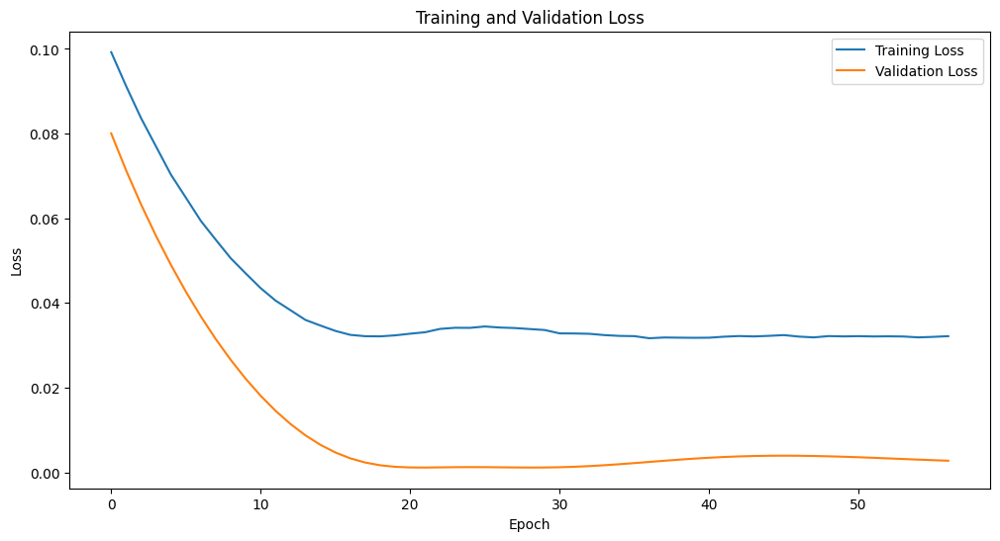

Epoch [1/2500], Train Loss: 0.0558, Val Loss: 0.0312
Epoch [2/2500], Train Loss: 0.0519, Val Loss: 0.0264
Epoch [3/2500], Train Loss: 0.0479, Val Loss: 0.0219
Epoch [4/2500], Train Loss: 0.0452, Val Loss: 0.0178
Epoch [5/2500], Train Loss: 0.0425, Val Loss: 0.0140
Epoch [6/2500], Train Loss: 0.0396, Val Loss: 0.0107
Epoch [7/2500], Train Loss: 0.0373, Val Loss: 0.0079
Epoch [8/2500], Train Loss: 0.0351, Val Loss: 0.0055
Epoch [9/2500], Train Loss: 0.0339, Val Loss: 0.0037
Epoch [10/2500], Train Loss: 0.0346, Val Loss: 0.0024
Epoch [11/2500], Train Loss: 0.0342, Val Loss: 0.0016
Epoch [12/2500], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0346, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0345, Val Loss: 0.0012
Epoch [15/2500], Train Loss: 0.0346, Val Loss: 0.0013
Epoch [16/2500], Train Loss: 0.0343, Val Loss: 0.0013
Epoch [17/2500], Train Loss: 0.0344, Val Loss: 0.0013
Epoch [18/2500], Train Loss: 0.0345, Val Loss: 0.0012
Epoch [19/2500], Train Loss: 0.0346, 

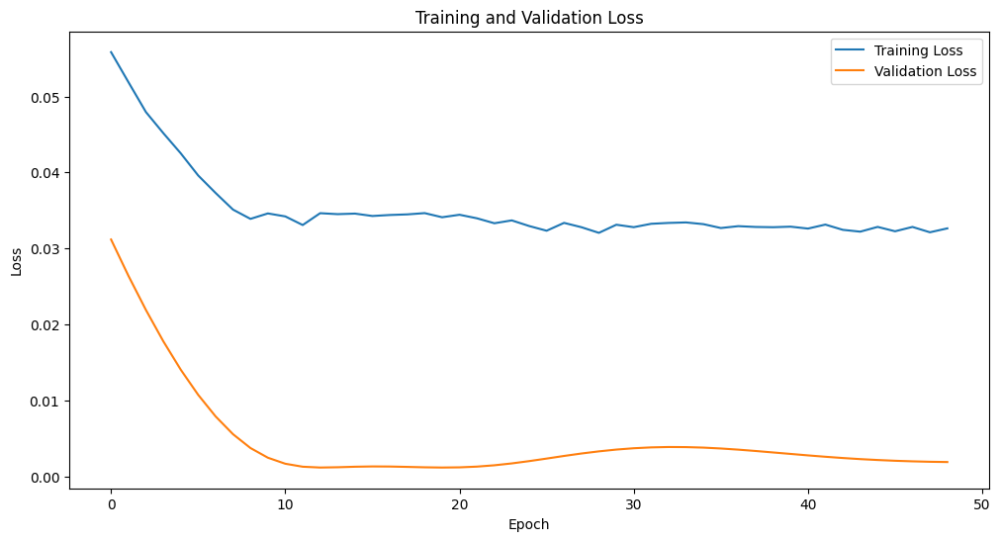

Epoch [1/2500], Train Loss: 0.0466, Val Loss: 0.0197
Epoch [2/2500], Train Loss: 0.0416, Val Loss: 0.0136
Epoch [3/2500], Train Loss: 0.0372, Val Loss: 0.0088
Epoch [4/2500], Train Loss: 0.0342, Val Loss: 0.0053
Epoch [5/2500], Train Loss: 0.0320, Val Loss: 0.0029
Epoch [6/2500], Train Loss: 0.0310, Val Loss: 0.0016
Epoch [7/2500], Train Loss: 0.0303, Val Loss: 0.0011
Epoch [8/2500], Train Loss: 0.0302, Val Loss: 0.0011
Epoch [9/2500], Train Loss: 0.0312, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0313, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0313, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0309, Val Loss: 0.0011
Epoch [13/2500], Train Loss: 0.0301, Val Loss: 0.0010
Epoch [14/2500], Train Loss: 0.0293, Val Loss: 0.0011
Epoch [15/2500], Train Loss: 0.0283, Val Loss: 0.0013
Epoch [16/2500], Train Loss: 0.0279, Val Loss: 0.0018
Epoch [17/2500], Train Loss: 0.0270, Val Loss: 0.0025
Epoch [18/2500], Train Loss: 0.0267, Val Loss: 0.0034
Epoch [19/2500], Train Loss: 0.0260, 

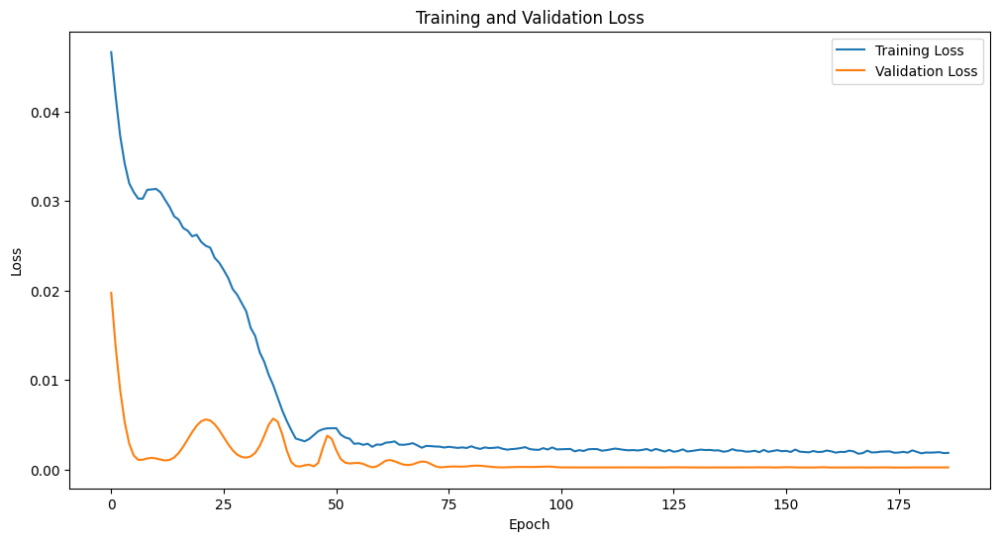

Epoch [1/2500], Train Loss: 0.0473, Val Loss: 0.0178
Epoch [2/2500], Train Loss: 0.0419, Val Loss: 0.0121
Epoch [3/2500], Train Loss: 0.0376, Val Loss: 0.0076
Epoch [4/2500], Train Loss: 0.0345, Val Loss: 0.0042
Epoch [5/2500], Train Loss: 0.0321, Val Loss: 0.0021
Epoch [6/2500], Train Loss: 0.0310, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0306, Val Loss: 0.0010
Epoch [8/2500], Train Loss: 0.0309, Val Loss: 0.0014
Epoch [9/2500], Train Loss: 0.0313, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0315, Val Loss: 0.0018
Epoch [11/2500], Train Loss: 0.0311, Val Loss: 0.0017
Epoch [12/2500], Train Loss: 0.0307, Val Loss: 0.0014
Epoch [13/2500], Train Loss: 0.0300, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0291, Val Loss: 0.0010
Epoch [15/2500], Train Loss: 0.0283, Val Loss: 0.0009
Epoch [16/2500], Train Loss: 0.0278, Val Loss: 0.0011
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0014
Epoch [18/2500], Train Loss: 0.0268, Val Loss: 0.0017
Epoch [19/2500], Train Loss: 0.0265, 

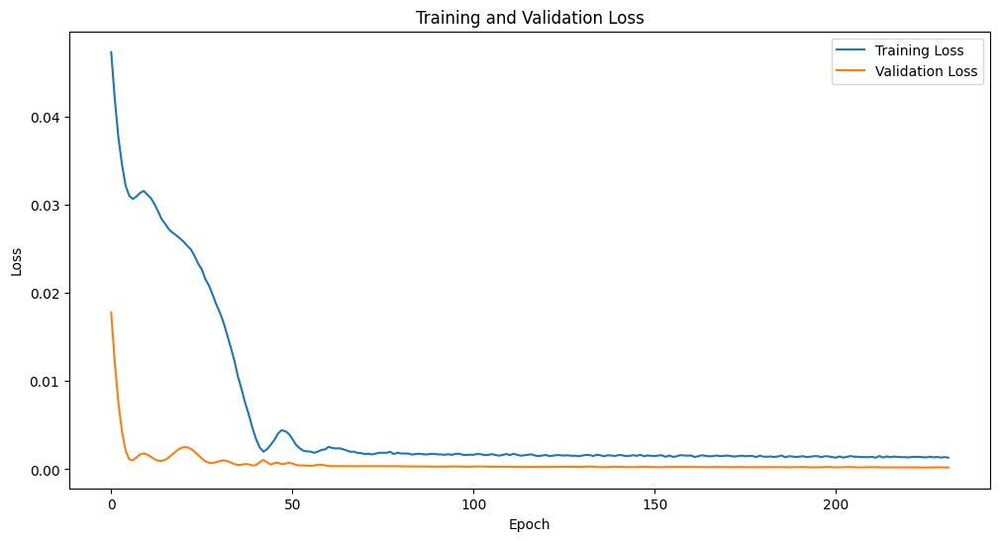

Epoch [1/2500], Train Loss: 0.0965, Val Loss: 0.0728
Epoch [2/2500], Train Loss: 0.0843, Val Loss: 0.0590
Epoch [3/2500], Train Loss: 0.0735, Val Loss: 0.0465
Epoch [4/2500], Train Loss: 0.0643, Val Loss: 0.0353
Epoch [5/2500], Train Loss: 0.0562, Val Loss: 0.0255
Epoch [6/2500], Train Loss: 0.0488, Val Loss: 0.0171
Epoch [7/2500], Train Loss: 0.0428, Val Loss: 0.0104
Epoch [8/2500], Train Loss: 0.0378, Val Loss: 0.0054
Epoch [9/2500], Train Loss: 0.0345, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0332, Val Loss: 0.0010
Epoch [11/2500], Train Loss: 0.0316, Val Loss: 0.0013
Epoch [12/2500], Train Loss: 0.0326, Val Loss: 0.0026
Epoch [13/2500], Train Loss: 0.0341, Val Loss: 0.0041
Epoch [14/2500], Train Loss: 0.0344, Val Loss: 0.0052
Epoch [15/2500], Train Loss: 0.0349, Val Loss: 0.0056
Epoch [16/2500], Train Loss: 0.0354, Val Loss: 0.0053
Epoch [17/2500], Train Loss: 0.0349, Val Loss: 0.0044
Epoch [18/2500], Train Loss: 0.0339, Val Loss: 0.0034
Epoch [19/2500], Train Loss: 0.0329, 

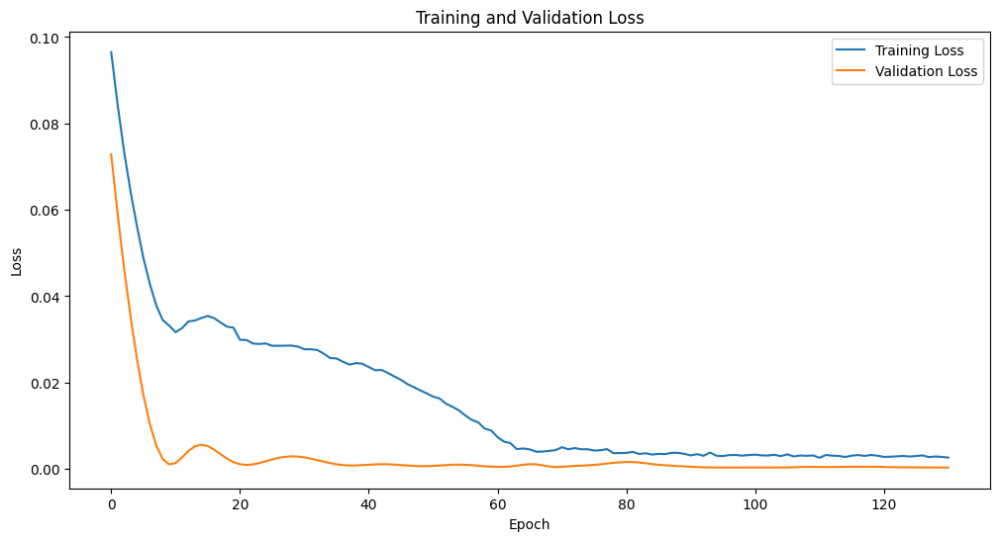

Epoch [1/2500], Train Loss: 0.0679, Val Loss: 0.0360
Epoch [2/2500], Train Loss: 0.0543, Val Loss: 0.0228
Epoch [3/2500], Train Loss: 0.0446, Val Loss: 0.0129
Epoch [4/2500], Train Loss: 0.0377, Val Loss: 0.0062
Epoch [5/2500], Train Loss: 0.0335, Val Loss: 0.0024
Epoch [6/2500], Train Loss: 0.0320, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0329, Val Loss: 0.0015
Epoch [8/2500], Train Loss: 0.0345, Val Loss: 0.0022
Epoch [9/2500], Train Loss: 0.0359, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0366, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0361, Val Loss: 0.0018
Epoch [12/2500], Train Loss: 0.0354, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0337, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0327, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0318, Val Loss: 0.0017
Epoch [16/2500], Train Loss: 0.0316, Val Loss: 0.0024
Epoch [17/2500], Train Loss: 0.0314, Val Loss: 0.0032
Epoch [18/2500], Train Loss: 0.0316, Val Loss: 0.0040
Epoch [19/2500], Train Loss: 0.0317, 

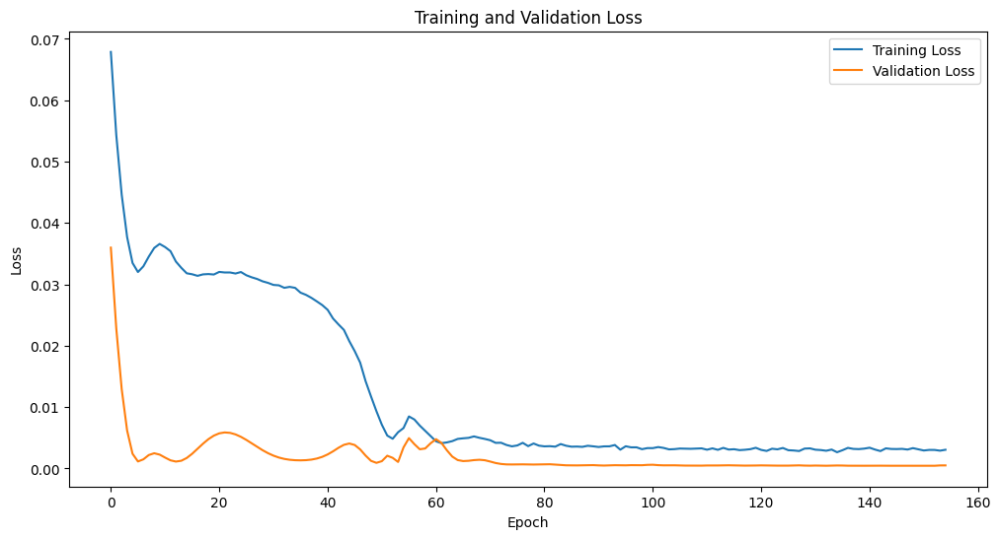

Epoch [1/2500], Train Loss: 0.1238, Val Loss: 0.1002
Epoch [2/2500], Train Loss: 0.1098, Val Loss: 0.0849
Epoch [3/2500], Train Loss: 0.0965, Val Loss: 0.0704
Epoch [4/2500], Train Loss: 0.0842, Val Loss: 0.0567
Epoch [5/2500], Train Loss: 0.0728, Val Loss: 0.0439
Epoch [6/2500], Train Loss: 0.0620, Val Loss: 0.0321
Epoch [7/2500], Train Loss: 0.0528, Val Loss: 0.0215
Epoch [8/2500], Train Loss: 0.0445, Val Loss: 0.0127
Epoch [9/2500], Train Loss: 0.0381, Val Loss: 0.0061
Epoch [10/2500], Train Loss: 0.0334, Val Loss: 0.0021
Epoch [11/2500], Train Loss: 0.0312, Val Loss: 0.0011
Epoch [12/2500], Train Loss: 0.0320, Val Loss: 0.0025
Epoch [13/2500], Train Loss: 0.0345, Val Loss: 0.0048
Epoch [14/2500], Train Loss: 0.0376, Val Loss: 0.0063
Epoch [15/2500], Train Loss: 0.0392, Val Loss: 0.0064
Epoch [16/2500], Train Loss: 0.0397, Val Loss: 0.0054
Epoch [17/2500], Train Loss: 0.0388, Val Loss: 0.0038
Epoch [18/2500], Train Loss: 0.0364, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0348, 

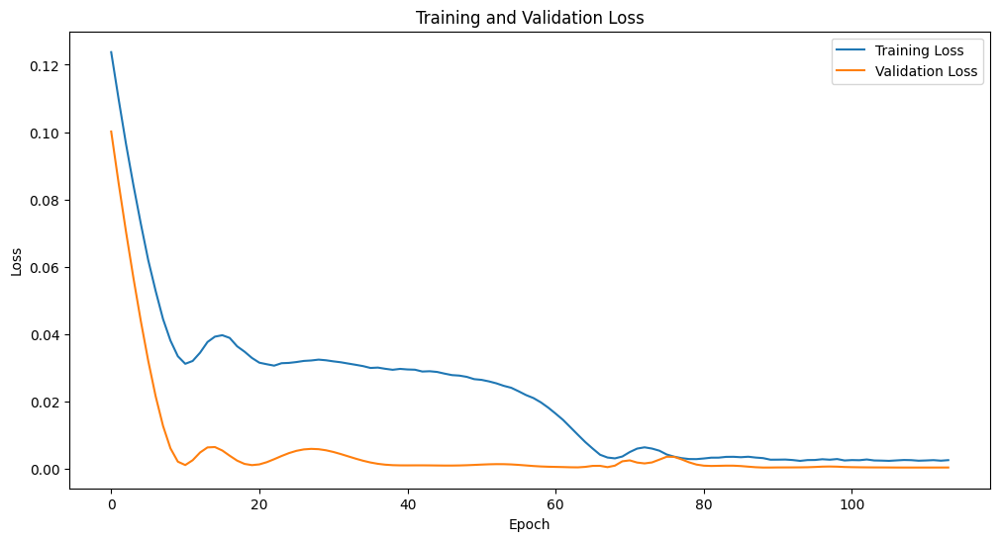

Epoch [1/2500], Train Loss: 0.0605, Val Loss: 0.0332
Epoch [2/2500], Train Loss: 0.0515, Val Loss: 0.0243
Epoch [3/2500], Train Loss: 0.0449, Val Loss: 0.0168
Epoch [4/2500], Train Loss: 0.0402, Val Loss: 0.0108
Epoch [5/2500], Train Loss: 0.0358, Val Loss: 0.0063
Epoch [6/2500], Train Loss: 0.0335, Val Loss: 0.0033
Epoch [7/2500], Train Loss: 0.0325, Val Loss: 0.0016
Epoch [8/2500], Train Loss: 0.0327, Val Loss: 0.0011
Epoch [9/2500], Train Loss: 0.0332, Val Loss: 0.0013
Epoch [10/2500], Train Loss: 0.0341, Val Loss: 0.0015
Epoch [11/2500], Train Loss: 0.0348, Val Loss: 0.0015
Epoch [12/2500], Train Loss: 0.0347, Val Loss: 0.0014
Epoch [13/2500], Train Loss: 0.0352, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0336, Val Loss: 0.0011
Epoch [15/2500], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0330, Val Loss: 0.0015
Epoch [17/2500], Train Loss: 0.0324, Val Loss: 0.0020
Epoch [18/2500], Train Loss: 0.0323, Val Loss: 0.0026
Epoch [19/2500], Train Loss: 0.0319, 

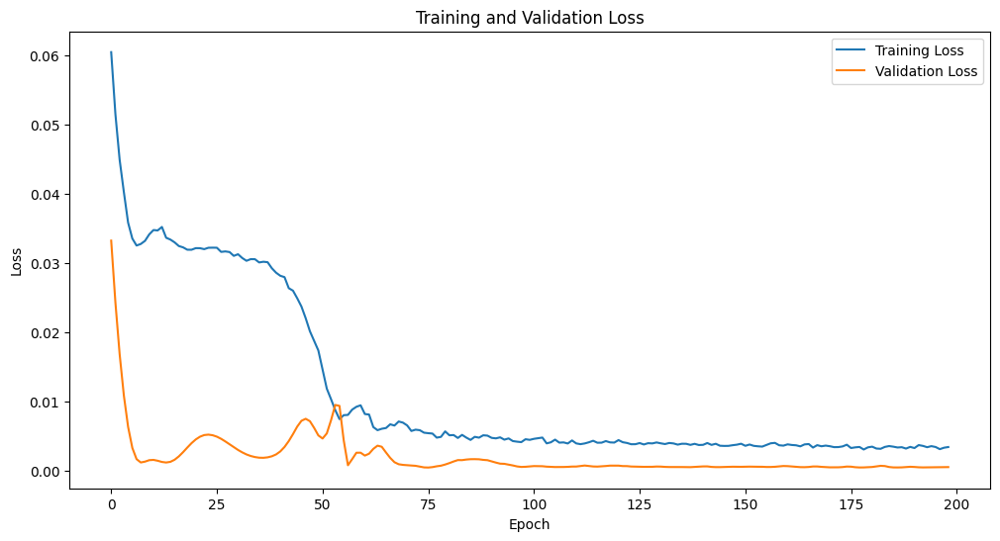

Epoch [1/2500], Train Loss: 0.0557, Val Loss: 0.0268
Epoch [2/2500], Train Loss: 0.0473, Val Loss: 0.0182
Epoch [3/2500], Train Loss: 0.0410, Val Loss: 0.0115
Epoch [4/2500], Train Loss: 0.0363, Val Loss: 0.0066
Epoch [5/2500], Train Loss: 0.0337, Val Loss: 0.0034
Epoch [6/2500], Train Loss: 0.0329, Val Loss: 0.0017
Epoch [7/2500], Train Loss: 0.0323, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0335, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0349, Val Loss: 0.0014
Epoch [10/2500], Train Loss: 0.0350, Val Loss: 0.0014
Epoch [11/2500], Train Loss: 0.0350, Val Loss: 0.0013
Epoch [12/2500], Train Loss: 0.0350, Val Loss: 0.0012
Epoch [13/2500], Train Loss: 0.0336, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0335, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0324, Val Loss: 0.0017
Epoch [16/2500], Train Loss: 0.0322, Val Loss: 0.0022
Epoch [17/2500], Train Loss: 0.0324, Val Loss: 0.0028
Epoch [18/2500], Train Loss: 0.0322, Val Loss: 0.0035
Epoch [19/2500], Train Loss: 0.0327, 

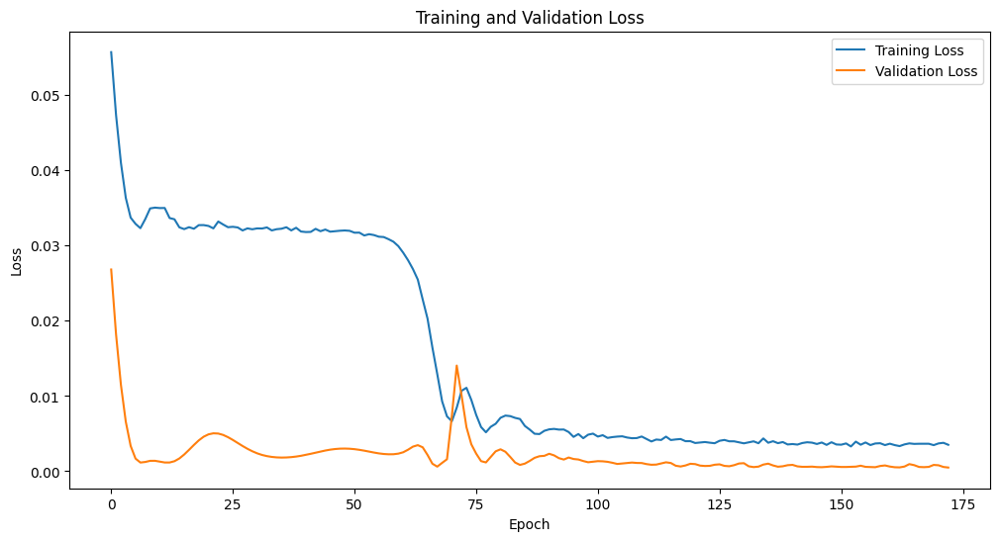

Epoch [1/2500], Train Loss: 0.0556, Val Loss: 0.0271
Epoch [2/2500], Train Loss: 0.0471, Val Loss: 0.0181
Epoch [3/2500], Train Loss: 0.0406, Val Loss: 0.0110
Epoch [4/2500], Train Loss: 0.0357, Val Loss: 0.0057
Epoch [5/2500], Train Loss: 0.0328, Val Loss: 0.0025
Epoch [6/2500], Train Loss: 0.0319, Val Loss: 0.0012
Epoch [7/2500], Train Loss: 0.0326, Val Loss: 0.0013
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0016
Epoch [9/2500], Train Loss: 0.0355, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0356, Val Loss: 0.0015
Epoch [11/2500], Train Loss: 0.0348, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0339, Val Loss: 0.0011
Epoch [13/2500], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [14/2500], Train Loss: 0.0324, Val Loss: 0.0017
Epoch [15/2500], Train Loss: 0.0319, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0318, Val Loss: 0.0030
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0037
Epoch [18/2500], Train Loss: 0.0320, Val Loss: 0.0043
Epoch [19/2500], Train Loss: 0.0322, 

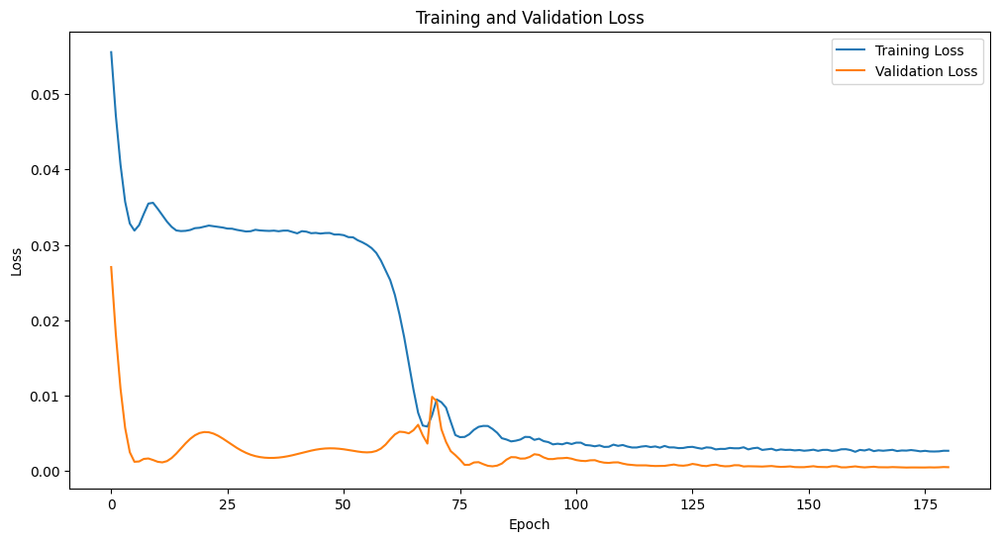

Epoch [1/2500], Train Loss: 0.0811, Val Loss: 0.0496
Epoch [2/2500], Train Loss: 0.0661, Val Loss: 0.0340
Epoch [3/2500], Train Loss: 0.0531, Val Loss: 0.0215
Epoch [4/2500], Train Loss: 0.0440, Val Loss: 0.0120
Epoch [5/2500], Train Loss: 0.0381, Val Loss: 0.0057
Epoch [6/2500], Train Loss: 0.0342, Val Loss: 0.0022
Epoch [7/2500], Train Loss: 0.0333, Val Loss: 0.0011
Epoch [8/2500], Train Loss: 0.0343, Val Loss: 0.0017
Epoch [9/2500], Train Loss: 0.0358, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0375, Val Loss: 0.0029
Epoch [11/2500], Train Loss: 0.0383, Val Loss: 0.0027
Epoch [12/2500], Train Loss: 0.0371, Val Loss: 0.0022
Epoch [13/2500], Train Loss: 0.0372, Val Loss: 0.0016
Epoch [14/2500], Train Loss: 0.0358, Val Loss: 0.0012
Epoch [15/2500], Train Loss: 0.0344, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0338, Val Loss: 0.0015
Epoch [17/2500], Train Loss: 0.0323, Val Loss: 0.0020
Epoch [18/2500], Train Loss: 0.0329, Val Loss: 0.0027
Epoch [19/2500], Train Loss: 0.0325, 

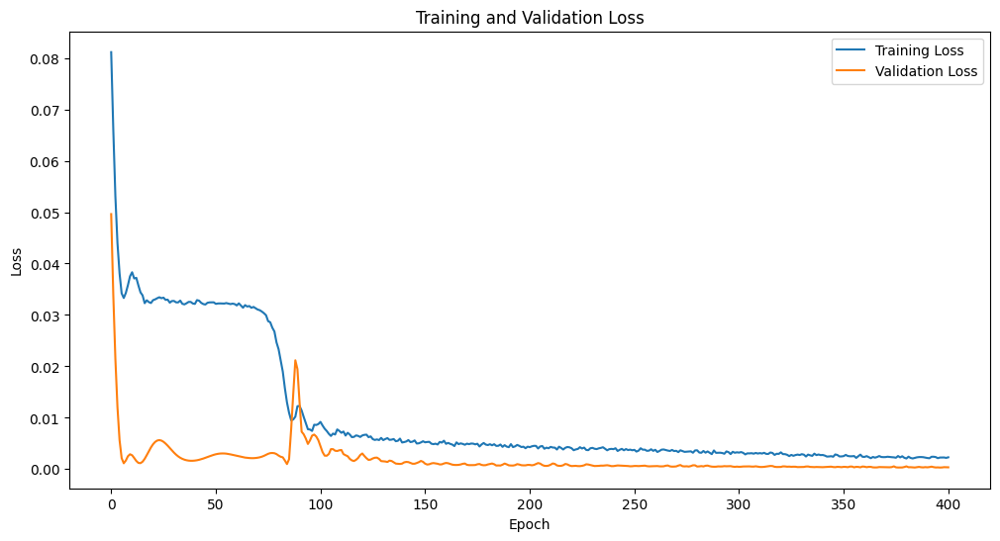

Epoch [1/2500], Train Loss: 0.1137, Val Loss: 0.0853
Epoch [2/2500], Train Loss: 0.0960, Val Loss: 0.0675
Epoch [3/2500], Train Loss: 0.0803, Val Loss: 0.0518
Epoch [4/2500], Train Loss: 0.0681, Val Loss: 0.0380
Epoch [5/2500], Train Loss: 0.0560, Val Loss: 0.0261
Epoch [6/2500], Train Loss: 0.0472, Val Loss: 0.0163
Epoch [7/2500], Train Loss: 0.0397, Val Loss: 0.0087
Epoch [8/2500], Train Loss: 0.0352, Val Loss: 0.0037
Epoch [9/2500], Train Loss: 0.0331, Val Loss: 0.0014
Epoch [10/2500], Train Loss: 0.0327, Val Loss: 0.0014
Epoch [11/2500], Train Loss: 0.0342, Val Loss: 0.0025
Epoch [12/2500], Train Loss: 0.0376, Val Loss: 0.0036
Epoch [13/2500], Train Loss: 0.0385, Val Loss: 0.0038
Epoch [14/2500], Train Loss: 0.0396, Val Loss: 0.0033
Epoch [15/2500], Train Loss: 0.0389, Val Loss: 0.0025
Epoch [16/2500], Train Loss: 0.0377, Val Loss: 0.0017
Epoch [17/2500], Train Loss: 0.0355, Val Loss: 0.0012
Epoch [18/2500], Train Loss: 0.0340, Val Loss: 0.0012
Epoch [19/2500], Train Loss: 0.0327, 

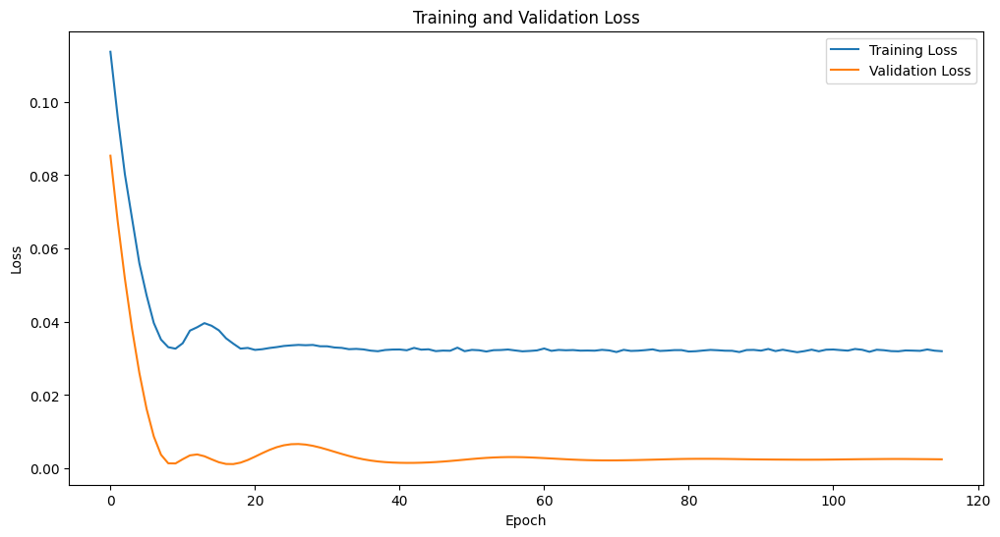

Epoch [1/2500], Train Loss: 0.0723, Val Loss: 0.0428
Epoch [2/2500], Train Loss: 0.0596, Val Loss: 0.0296
Epoch [3/2500], Train Loss: 0.0492, Val Loss: 0.0186
Epoch [4/2500], Train Loss: 0.0410, Val Loss: 0.0102
Epoch [5/2500], Train Loss: 0.0354, Val Loss: 0.0044
Epoch [6/2500], Train Loss: 0.0324, Val Loss: 0.0016
Epoch [7/2500], Train Loss: 0.0321, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0020
Epoch [9/2500], Train Loss: 0.0364, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0372, Val Loss: 0.0024
Epoch [11/2500], Train Loss: 0.0370, Val Loss: 0.0019
Epoch [12/2500], Train Loss: 0.0362, Val Loss: 0.0014
Epoch [13/2500], Train Loss: 0.0345, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0327, Val Loss: 0.0019
Epoch [16/2500], Train Loss: 0.0320, Val Loss: 0.0026
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0035
Epoch [18/2500], Train Loss: 0.0321, Val Loss: 0.0044
Epoch [19/2500], Train Loss: 0.0322, 

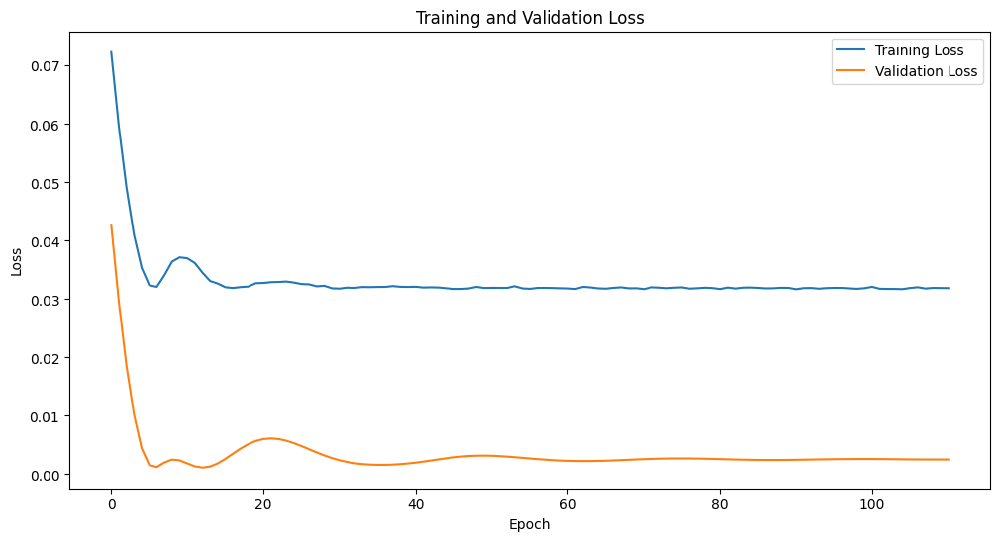

Epoch [1/2500], Train Loss: 0.0539, Val Loss: 0.0243
Epoch [2/2500], Train Loss: 0.0463, Val Loss: 0.0158
Epoch [3/2500], Train Loss: 0.0394, Val Loss: 0.0093
Epoch [4/2500], Train Loss: 0.0362, Val Loss: 0.0047
Epoch [5/2500], Train Loss: 0.0345, Val Loss: 0.0021
Epoch [6/2500], Train Loss: 0.0334, Val Loss: 0.0012
Epoch [7/2500], Train Loss: 0.0338, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0352, Val Loss: 0.0015
Epoch [9/2500], Train Loss: 0.0361, Val Loss: 0.0015
Epoch [10/2500], Train Loss: 0.0360, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0353, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0355, Val Loss: 0.0012
Epoch [13/2500], Train Loss: 0.0341, Val Loss: 0.0014
Epoch [14/2500], Train Loss: 0.0342, Val Loss: 0.0019
Epoch [15/2500], Train Loss: 0.0327, Val Loss: 0.0025
Epoch [16/2500], Train Loss: 0.0331, Val Loss: 0.0032
Epoch [17/2500], Train Loss: 0.0328, Val Loss: 0.0039
Epoch [18/2500], Train Loss: 0.0325, Val Loss: 0.0045
Epoch [19/2500], Train Loss: 0.0332, 

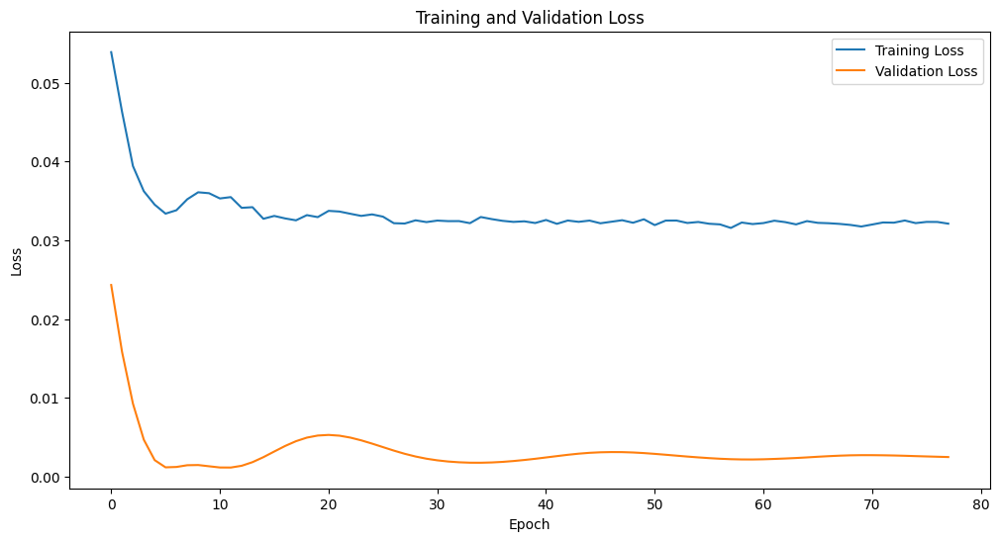

Epoch [1/2500], Train Loss: 0.1399, Val Loss: 0.0974
Epoch [2/2500], Train Loss: 0.1093, Val Loss: 0.0666
Epoch [3/2500], Train Loss: 0.0840, Val Loss: 0.0421
Epoch [4/2500], Train Loss: 0.0640, Val Loss: 0.0233
Epoch [5/2500], Train Loss: 0.0485, Val Loss: 0.0100
Epoch [6/2500], Train Loss: 0.0375, Val Loss: 0.0025
Epoch [7/2500], Train Loss: 0.0313, Val Loss: 0.0010
Epoch [8/2500], Train Loss: 0.0298, Val Loss: 0.0046
Epoch [9/2500], Train Loss: 0.0316, Val Loss: 0.0102
Epoch [10/2500], Train Loss: 0.0363, Val Loss: 0.0136
Epoch [11/2500], Train Loss: 0.0380, Val Loss: 0.0135
Epoch [12/2500], Train Loss: 0.0383, Val Loss: 0.0108
Epoch [13/2500], Train Loss: 0.0362, Val Loss: 0.0071
Epoch [14/2500], Train Loss: 0.0327, Val Loss: 0.0038
Epoch [15/2500], Train Loss: 0.0299, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0274, Val Loss: 0.0008
Epoch [17/2500], Train Loss: 0.0260, Val Loss: 0.0013
Epoch [18/2500], Train Loss: 0.0254, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0256, 

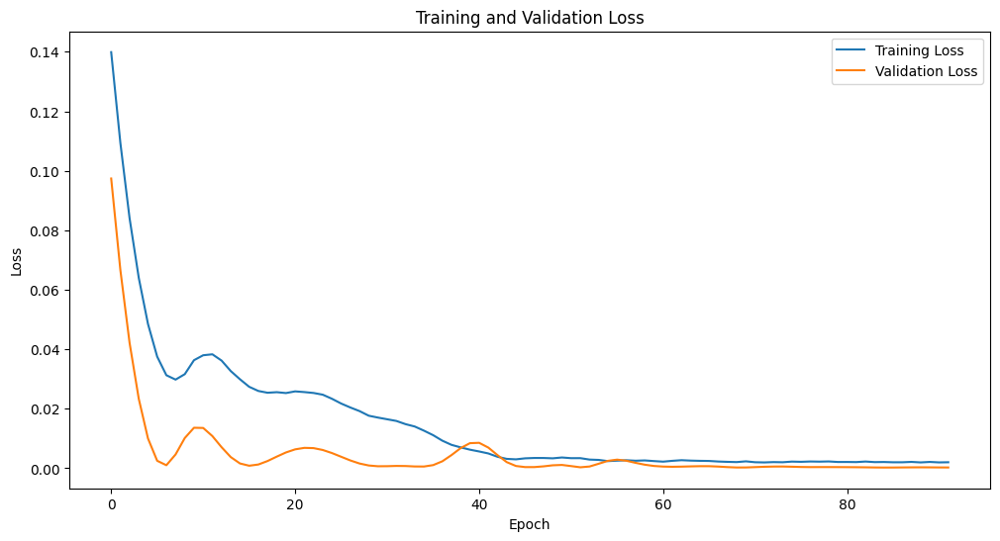

Epoch [1/2500], Train Loss: 0.1168, Val Loss: 0.0802
Epoch [2/2500], Train Loss: 0.0922, Val Loss: 0.0539
Epoch [3/2500], Train Loss: 0.0715, Val Loss: 0.0322
Epoch [4/2500], Train Loss: 0.0544, Val Loss: 0.0153
Epoch [5/2500], Train Loss: 0.0408, Val Loss: 0.0043
Epoch [6/2500], Train Loss: 0.0318, Val Loss: 0.0008
Epoch [7/2500], Train Loss: 0.0283, Val Loss: 0.0053
Epoch [8/2500], Train Loss: 0.0300, Val Loss: 0.0135
Epoch [9/2500], Train Loss: 0.0352, Val Loss: 0.0181
Epoch [10/2500], Train Loss: 0.0384, Val Loss: 0.0170
Epoch [11/2500], Train Loss: 0.0373, Val Loss: 0.0125
Epoch [12/2500], Train Loss: 0.0341, Val Loss: 0.0073
Epoch [13/2500], Train Loss: 0.0302, Val Loss: 0.0034
Epoch [14/2500], Train Loss: 0.0274, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0257, Val Loss: 0.0008
Epoch [16/2500], Train Loss: 0.0252, Val Loss: 0.0014
Epoch [17/2500], Train Loss: 0.0253, Val Loss: 0.0024
Epoch [18/2500], Train Loss: 0.0255, Val Loss: 0.0034
Epoch [19/2500], Train Loss: 0.0261, 

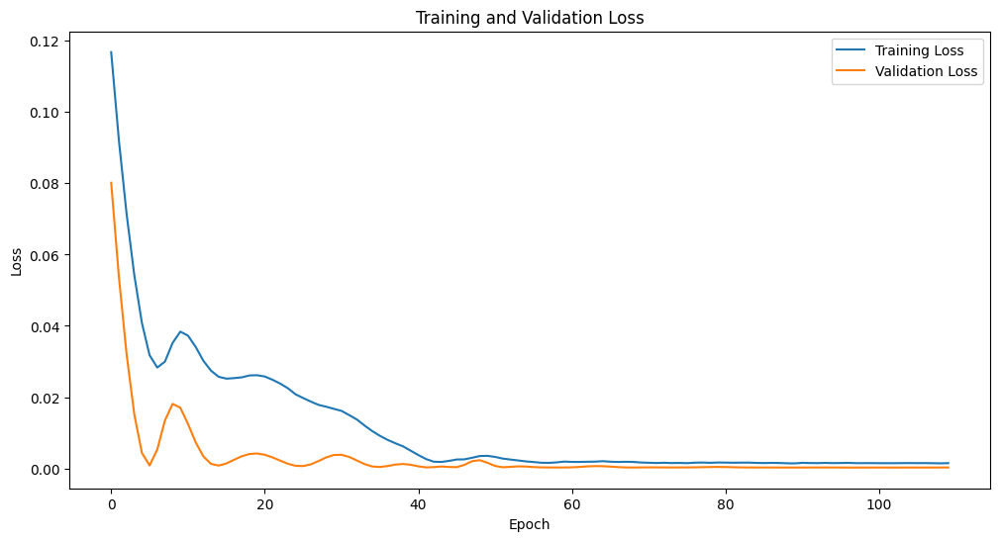

Epoch [1/2500], Train Loss: 0.0862, Val Loss: 0.0451
Epoch [2/2500], Train Loss: 0.0646, Val Loss: 0.0244
Epoch [3/2500], Train Loss: 0.0481, Val Loss: 0.0098
Epoch [4/2500], Train Loss: 0.0369, Val Loss: 0.0021
Epoch [5/2500], Train Loss: 0.0315, Val Loss: 0.0015
Epoch [6/2500], Train Loss: 0.0319, Val Loss: 0.0055
Epoch [7/2500], Train Loss: 0.0355, Val Loss: 0.0088
Epoch [8/2500], Train Loss: 0.0378, Val Loss: 0.0088
Epoch [9/2500], Train Loss: 0.0375, Val Loss: 0.0065
Epoch [10/2500], Train Loss: 0.0348, Val Loss: 0.0037
Epoch [11/2500], Train Loss: 0.0314, Val Loss: 0.0016
Epoch [12/2500], Train Loss: 0.0295, Val Loss: 0.0009
Epoch [13/2500], Train Loss: 0.0280, Val Loss: 0.0014
Epoch [14/2500], Train Loss: 0.0272, Val Loss: 0.0026
Epoch [15/2500], Train Loss: 0.0267, Val Loss: 0.0041
Epoch [16/2500], Train Loss: 0.0271, Val Loss: 0.0053
Epoch [17/2500], Train Loss: 0.0277, Val Loss: 0.0060
Epoch [18/2500], Train Loss: 0.0270, Val Loss: 0.0060
Epoch [19/2500], Train Loss: 0.0263, 

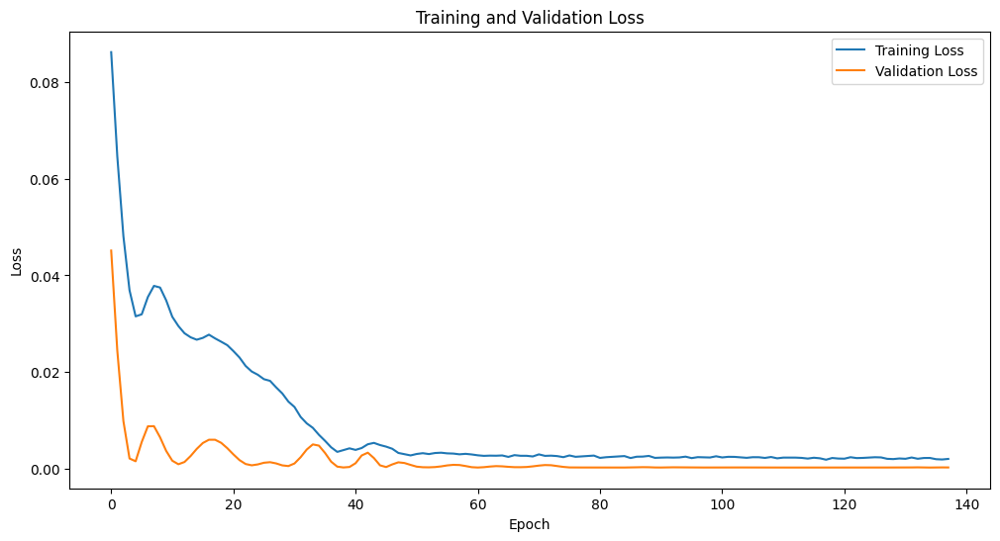

Epoch [1/2500], Train Loss: 0.0410, Val Loss: 0.0067
Epoch [2/2500], Train Loss: 0.0332, Val Loss: 0.0017
Epoch [3/2500], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [4/2500], Train Loss: 0.0340, Val Loss: 0.0014
Epoch [5/2500], Train Loss: 0.0344, Val Loss: 0.0012
Epoch [6/2500], Train Loss: 0.0334, Val Loss: 0.0013
Epoch [7/2500], Train Loss: 0.0320, Val Loss: 0.0020
Epoch [8/2500], Train Loss: 0.0315, Val Loss: 0.0031
Epoch [9/2500], Train Loss: 0.0315, Val Loss: 0.0043
Epoch [10/2500], Train Loss: 0.0318, Val Loss: 0.0052
Epoch [11/2500], Train Loss: 0.0318, Val Loss: 0.0055
Epoch [12/2500], Train Loss: 0.0319, Val Loss: 0.0053
Epoch [13/2500], Train Loss: 0.0319, Val Loss: 0.0047
Epoch [14/2500], Train Loss: 0.0314, Val Loss: 0.0038
Epoch [15/2500], Train Loss: 0.0310, Val Loss: 0.0029
Epoch [16/2500], Train Loss: 0.0305, Val Loss: 0.0021
Epoch [17/2500], Train Loss: 0.0300, Val Loss: 0.0016
Epoch [18/2500], Train Loss: 0.0299, Val Loss: 0.0012
Epoch [19/2500], Train Loss: 0.0296, 

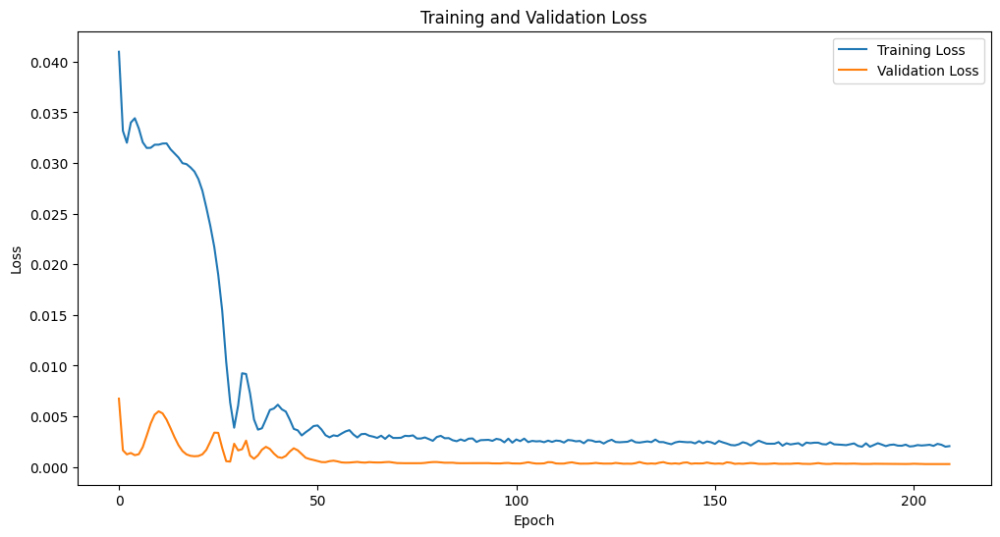

Epoch [1/2500], Train Loss: 0.0617, Val Loss: 0.0246
Epoch [2/2500], Train Loss: 0.0454, Val Loss: 0.0103
Epoch [3/2500], Train Loss: 0.0353, Val Loss: 0.0024
Epoch [4/2500], Train Loss: 0.0315, Val Loss: 0.0014
Epoch [5/2500], Train Loss: 0.0340, Val Loss: 0.0029
Epoch [6/2500], Train Loss: 0.0371, Val Loss: 0.0027
Epoch [7/2500], Train Loss: 0.0366, Val Loss: 0.0016
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0011
Epoch [9/2500], Train Loss: 0.0321, Val Loss: 0.0018
Epoch [10/2500], Train Loss: 0.0308, Val Loss: 0.0033
Epoch [11/2500], Train Loss: 0.0308, Val Loss: 0.0051
Epoch [12/2500], Train Loss: 0.0314, Val Loss: 0.0066
Epoch [13/2500], Train Loss: 0.0319, Val Loss: 0.0073
Epoch [14/2500], Train Loss: 0.0321, Val Loss: 0.0073
Epoch [15/2500], Train Loss: 0.0322, Val Loss: 0.0067
Epoch [16/2500], Train Loss: 0.0313, Val Loss: 0.0056
Epoch [17/2500], Train Loss: 0.0304, Val Loss: 0.0043
Epoch [18/2500], Train Loss: 0.0297, Val Loss: 0.0030
Epoch [19/2500], Train Loss: 0.0288, 

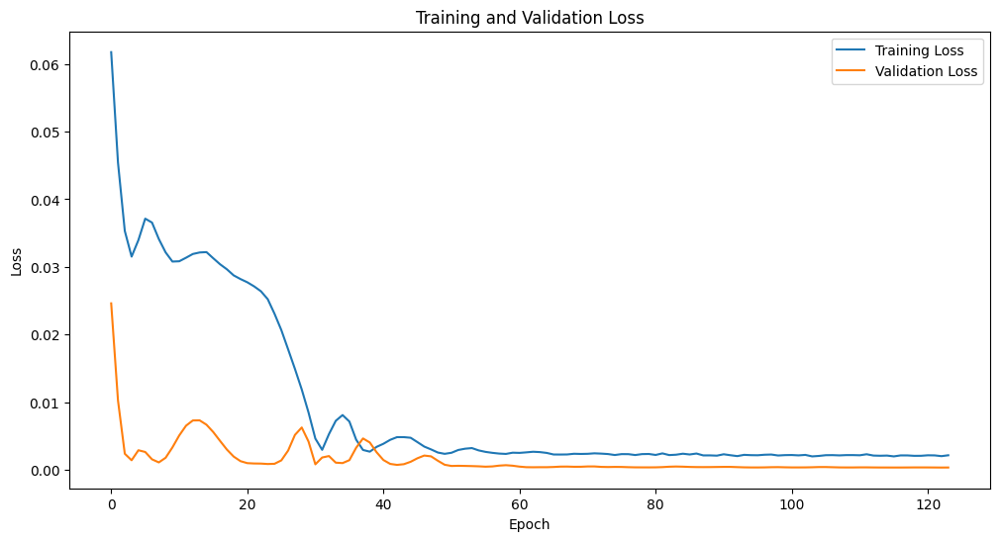

Epoch [1/2500], Train Loss: 0.0711, Val Loss: 0.0322
Epoch [2/2500], Train Loss: 0.0508, Val Loss: 0.0147
Epoch [3/2500], Train Loss: 0.0387, Val Loss: 0.0040
Epoch [4/2500], Train Loss: 0.0329, Val Loss: 0.0011
Epoch [5/2500], Train Loss: 0.0337, Val Loss: 0.0031
Epoch [6/2500], Train Loss: 0.0378, Val Loss: 0.0037
Epoch [7/2500], Train Loss: 0.0385, Val Loss: 0.0026
Epoch [8/2500], Train Loss: 0.0371, Val Loss: 0.0014
Epoch [9/2500], Train Loss: 0.0339, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0324, Val Loss: 0.0021
Epoch [11/2500], Train Loss: 0.0318, Val Loss: 0.0036
Epoch [12/2500], Train Loss: 0.0321, Val Loss: 0.0053
Epoch [13/2500], Train Loss: 0.0325, Val Loss: 0.0065
Epoch [14/2500], Train Loss: 0.0333, Val Loss: 0.0071
Epoch [15/2500], Train Loss: 0.0333, Val Loss: 0.0070
Epoch [16/2500], Train Loss: 0.0332, Val Loss: 0.0064
Epoch [17/2500], Train Loss: 0.0328, Val Loss: 0.0055
Epoch [18/2500], Train Loss: 0.0321, Val Loss: 0.0044
Epoch [19/2500], Train Loss: 0.0314, 

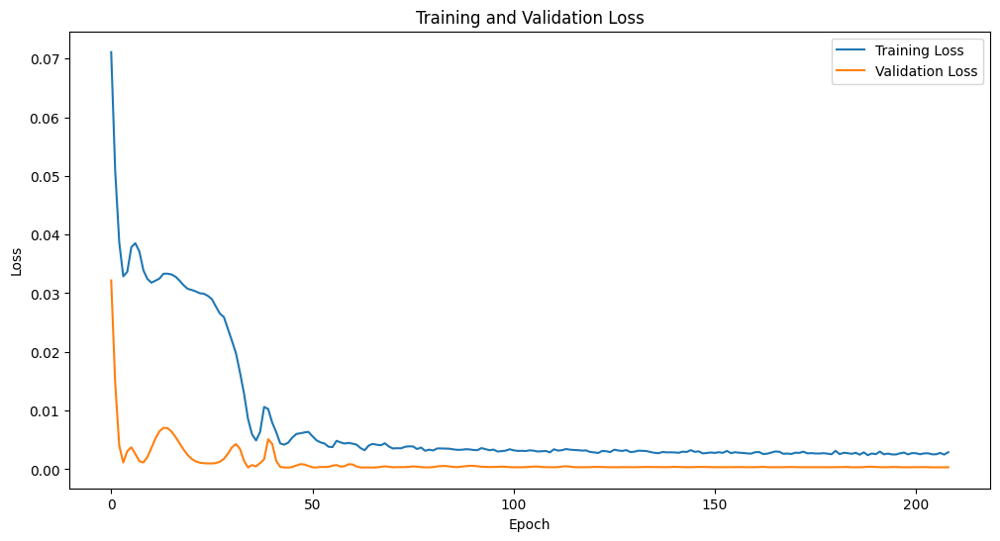

Epoch [1/2500], Train Loss: 0.1312, Val Loss: 0.0912
Epoch [2/2500], Train Loss: 0.1009, Val Loss: 0.0618
Epoch [3/2500], Train Loss: 0.0757, Val Loss: 0.0367
Epoch [4/2500], Train Loss: 0.0553, Val Loss: 0.0167
Epoch [5/2500], Train Loss: 0.0401, Val Loss: 0.0040
Epoch [6/2500], Train Loss: 0.0324, Val Loss: 0.0016
Epoch [7/2500], Train Loss: 0.0360, Val Loss: 0.0061
Epoch [8/2500], Train Loss: 0.0432, Val Loss: 0.0076
Epoch [9/2500], Train Loss: 0.0449, Val Loss: 0.0052
Epoch [10/2500], Train Loss: 0.0416, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0367, Val Loss: 0.0011
Epoch [12/2500], Train Loss: 0.0337, Val Loss: 0.0020
Epoch [13/2500], Train Loss: 0.0322, Val Loss: 0.0043
Epoch [14/2500], Train Loss: 0.0326, Val Loss: 0.0068
Epoch [15/2500], Train Loss: 0.0336, Val Loss: 0.0089
Epoch [16/2500], Train Loss: 0.0350, Val Loss: 0.0101
Epoch [17/2500], Train Loss: 0.0356, Val Loss: 0.0103
Epoch [18/2500], Train Loss: 0.0355, Val Loss: 0.0097
Epoch [19/2500], Train Loss: 0.0349, 

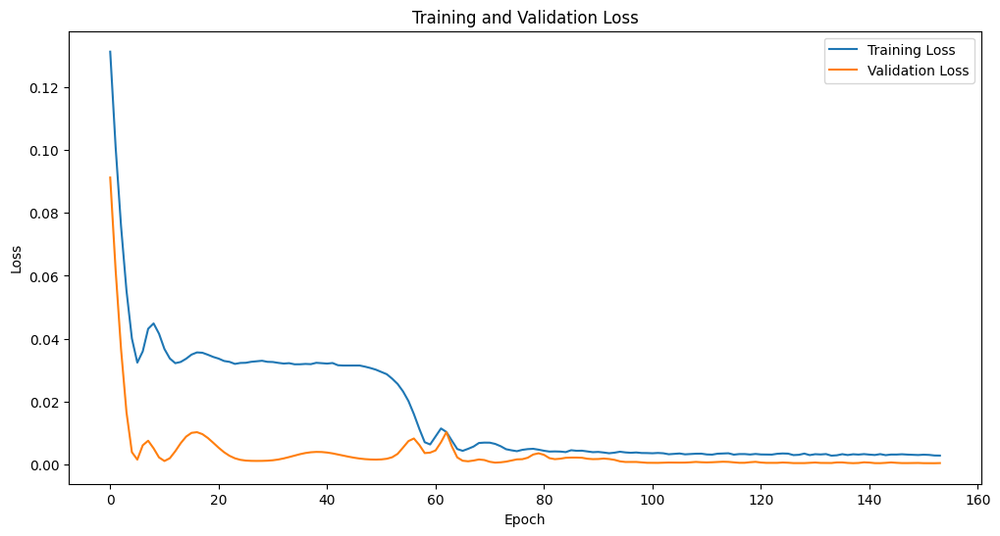

Epoch [1/2500], Train Loss: 0.1014, Val Loss: 0.0604
Epoch [2/2500], Train Loss: 0.0742, Val Loss: 0.0348
Epoch [3/2500], Train Loss: 0.0533, Val Loss: 0.0153
Epoch [4/2500], Train Loss: 0.0386, Val Loss: 0.0034
Epoch [5/2500], Train Loss: 0.0323, Val Loss: 0.0017
Epoch [6/2500], Train Loss: 0.0354, Val Loss: 0.0051
Epoch [7/2500], Train Loss: 0.0415, Val Loss: 0.0052
Epoch [8/2500], Train Loss: 0.0415, Val Loss: 0.0030
Epoch [9/2500], Train Loss: 0.0381, Val Loss: 0.0014
Epoch [10/2500], Train Loss: 0.0346, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0324, Val Loss: 0.0027
Epoch [12/2500], Train Loss: 0.0318, Val Loss: 0.0046
Epoch [13/2500], Train Loss: 0.0321, Val Loss: 0.0065
Epoch [14/2500], Train Loss: 0.0332, Val Loss: 0.0079
Epoch [15/2500], Train Loss: 0.0338, Val Loss: 0.0086
Epoch [16/2500], Train Loss: 0.0344, Val Loss: 0.0087
Epoch [17/2500], Train Loss: 0.0343, Val Loss: 0.0081
Epoch [18/2500], Train Loss: 0.0340, Val Loss: 0.0072
Epoch [19/2500], Train Loss: 0.0334, 

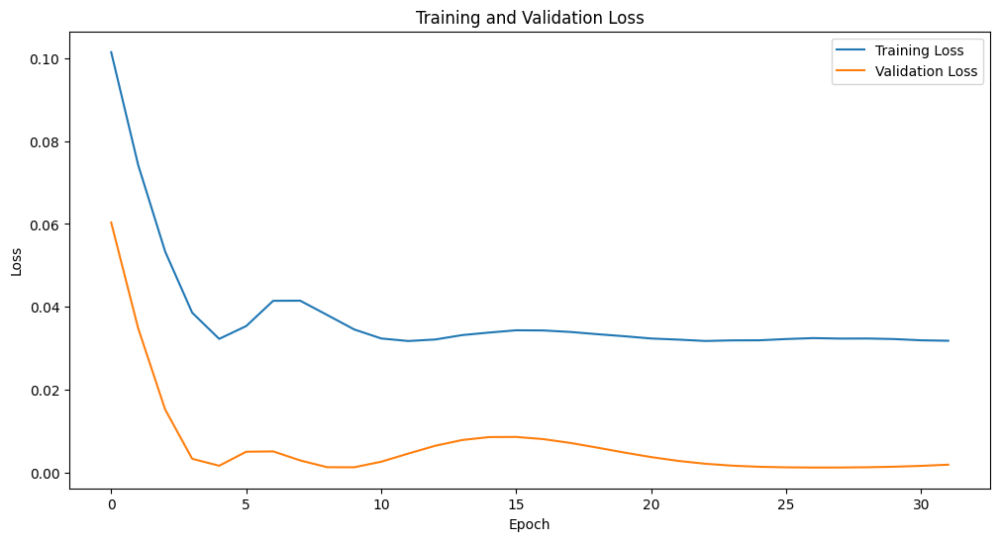

Epoch [1/2500], Train Loss: 0.1162, Val Loss: 0.0745
Epoch [2/2500], Train Loss: 0.0870, Val Loss: 0.0462
Epoch [3/2500], Train Loss: 0.0629, Val Loss: 0.0240
Epoch [4/2500], Train Loss: 0.0462, Val Loss: 0.0084
Epoch [5/2500], Train Loss: 0.0357, Val Loss: 0.0014
Epoch [6/2500], Train Loss: 0.0323, Val Loss: 0.0033
Epoch [7/2500], Train Loss: 0.0388, Val Loss: 0.0069
Epoch [8/2500], Train Loss: 0.0432, Val Loss: 0.0066
Epoch [9/2500], Train Loss: 0.0428, Val Loss: 0.0040
Epoch [10/2500], Train Loss: 0.0401, Val Loss: 0.0018
Epoch [11/2500], Train Loss: 0.0354, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0335, Val Loss: 0.0021
Epoch [13/2500], Train Loss: 0.0330, Val Loss: 0.0040
Epoch [14/2500], Train Loss: 0.0336, Val Loss: 0.0060
Epoch [15/2500], Train Loss: 0.0337, Val Loss: 0.0078
Epoch [16/2500], Train Loss: 0.0348, Val Loss: 0.0088
Epoch [17/2500], Train Loss: 0.0353, Val Loss: 0.0092
Epoch [18/2500], Train Loss: 0.0351, Val Loss: 0.0089
Epoch [19/2500], Train Loss: 0.0358, 

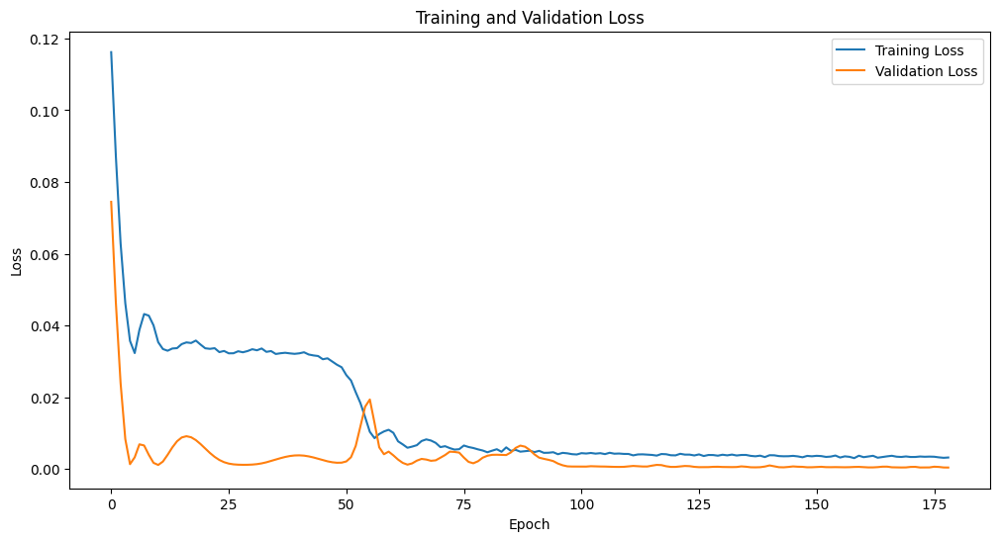

Epoch [1/2500], Train Loss: 0.0677, Val Loss: 0.0311
Epoch [2/2500], Train Loss: 0.0505, Val Loss: 0.0157
Epoch [3/2500], Train Loss: 0.0389, Val Loss: 0.0056
Epoch [4/2500], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [5/2500], Train Loss: 0.0325, Val Loss: 0.0019
Epoch [6/2500], Train Loss: 0.0361, Val Loss: 0.0025
Epoch [7/2500], Train Loss: 0.0377, Val Loss: 0.0019
Epoch [8/2500], Train Loss: 0.0364, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0343, Val Loss: 0.0013
Epoch [10/2500], Train Loss: 0.0327, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0320, Val Loss: 0.0038
Epoch [12/2500], Train Loss: 0.0321, Val Loss: 0.0053
Epoch [13/2500], Train Loss: 0.0327, Val Loss: 0.0063
Epoch [14/2500], Train Loss: 0.0333, Val Loss: 0.0068
Epoch [15/2500], Train Loss: 0.0334, Val Loss: 0.0068
Epoch [16/2500], Train Loss: 0.0335, Val Loss: 0.0063
Epoch [17/2500], Train Loss: 0.0332, Val Loss: 0.0055
Epoch [18/2500], Train Loss: 0.0327, Val Loss: 0.0046
Epoch [19/2500], Train Loss: 0.0322, 

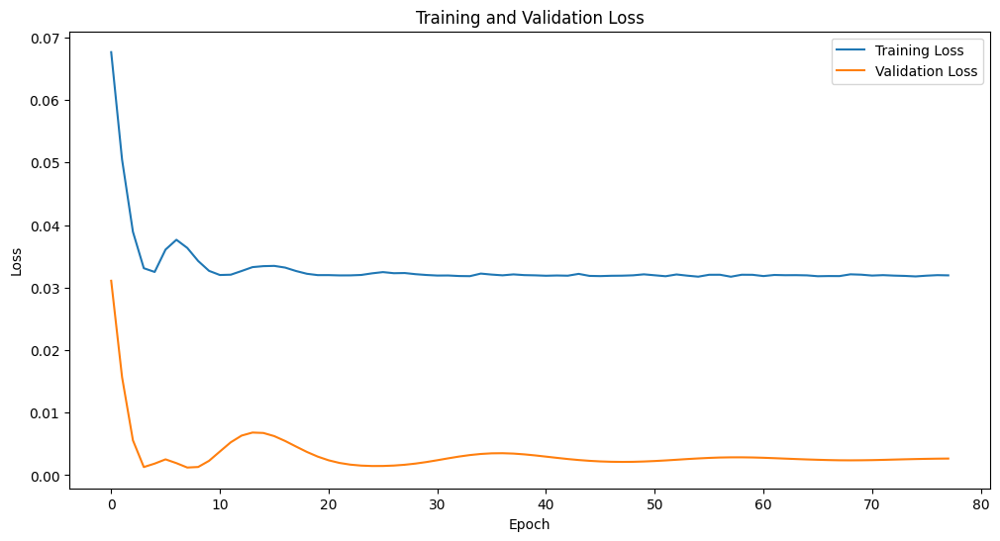

Epoch [1/2500], Train Loss: 0.0804, Val Loss: 0.0412
Epoch [2/2500], Train Loss: 0.0584, Val Loss: 0.0213
Epoch [3/2500], Train Loss: 0.0428, Val Loss: 0.0078
Epoch [4/2500], Train Loss: 0.0340, Val Loss: 0.0015
Epoch [5/2500], Train Loss: 0.0322, Val Loss: 0.0021
Epoch [6/2500], Train Loss: 0.0364, Val Loss: 0.0035
Epoch [7/2500], Train Loss: 0.0393, Val Loss: 0.0030
Epoch [8/2500], Train Loss: 0.0384, Val Loss: 0.0017
Epoch [9/2500], Train Loss: 0.0355, Val Loss: 0.0011
Epoch [10/2500], Train Loss: 0.0331, Val Loss: 0.0017
Epoch [11/2500], Train Loss: 0.0321, Val Loss: 0.0032
Epoch [12/2500], Train Loss: 0.0320, Val Loss: 0.0049
Epoch [13/2500], Train Loss: 0.0326, Val Loss: 0.0064
Epoch [14/2500], Train Loss: 0.0331, Val Loss: 0.0073
Epoch [15/2500], Train Loss: 0.0336, Val Loss: 0.0075
Epoch [16/2500], Train Loss: 0.0337, Val Loss: 0.0071
Epoch [17/2500], Train Loss: 0.0335, Val Loss: 0.0064
Epoch [18/2500], Train Loss: 0.0331, Val Loss: 0.0054
Epoch [19/2500], Train Loss: 0.0326, 

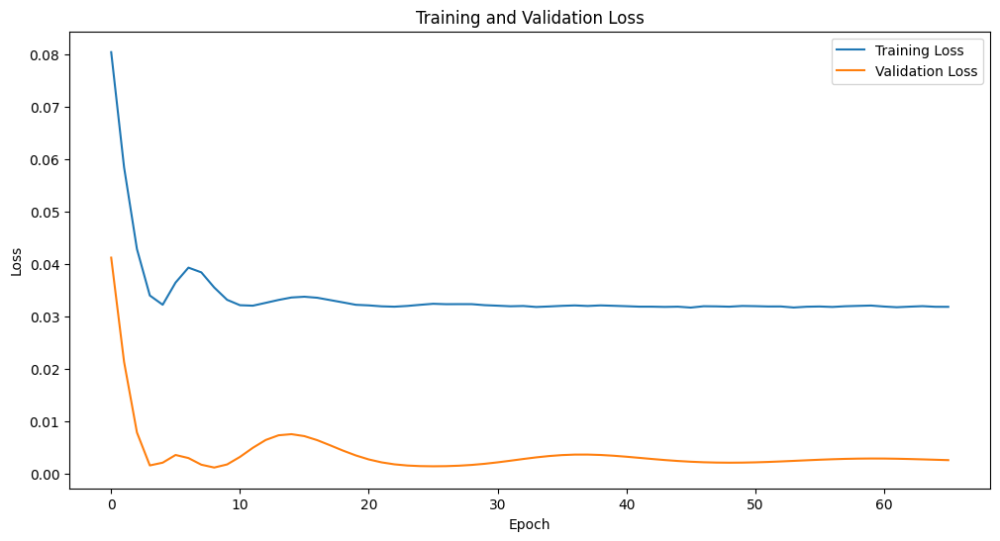

Epoch [1/2500], Train Loss: 0.1010, Val Loss: 0.0598
Epoch [2/2500], Train Loss: 0.0747, Val Loss: 0.0342
Epoch [3/2500], Train Loss: 0.0533, Val Loss: 0.0147
Epoch [4/2500], Train Loss: 0.0395, Val Loss: 0.0031
Epoch [5/2500], Train Loss: 0.0330, Val Loss: 0.0018
Epoch [6/2500], Train Loss: 0.0363, Val Loss: 0.0055
Epoch [7/2500], Train Loss: 0.0424, Val Loss: 0.0060
Epoch [8/2500], Train Loss: 0.0435, Val Loss: 0.0037
Epoch [9/2500], Train Loss: 0.0395, Val Loss: 0.0016
Epoch [10/2500], Train Loss: 0.0359, Val Loss: 0.0012
Epoch [11/2500], Train Loss: 0.0334, Val Loss: 0.0024
Epoch [12/2500], Train Loss: 0.0323, Val Loss: 0.0045
Epoch [13/2500], Train Loss: 0.0333, Val Loss: 0.0068
Epoch [14/2500], Train Loss: 0.0335, Val Loss: 0.0084
Epoch [15/2500], Train Loss: 0.0347, Val Loss: 0.0092
Epoch [16/2500], Train Loss: 0.0353, Val Loss: 0.0091
Epoch [17/2500], Train Loss: 0.0351, Val Loss: 0.0084
Epoch [18/2500], Train Loss: 0.0349, Val Loss: 0.0072
Epoch [19/2500], Train Loss: 0.0340, 

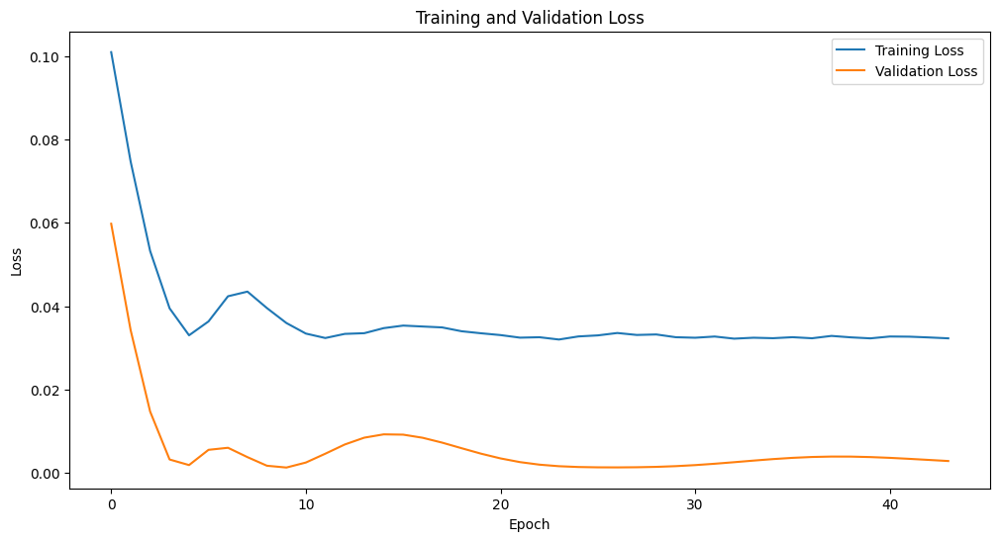

Epoch [1/2500], Train Loss: 0.0317, Val Loss: 0.0163
Epoch [2/2500], Train Loss: 0.0381, Val Loss: 0.0026
Epoch [3/2500], Train Loss: 0.0285, Val Loss: 0.0025
Epoch [4/2500], Train Loss: 0.0292, Val Loss: 0.0043
Epoch [5/2500], Train Loss: 0.0292, Val Loss: 0.0018
Epoch [6/2500], Train Loss: 0.0244, Val Loss: 0.0009
Epoch [7/2500], Train Loss: 0.0206, Val Loss: 0.0032
Epoch [8/2500], Train Loss: 0.0187, Val Loss: 0.0028
Epoch [9/2500], Train Loss: 0.0144, Val Loss: 0.0004
Epoch [10/2500], Train Loss: 0.0088, Val Loss: 0.0081
Epoch [11/2500], Train Loss: 0.0079, Val Loss: 0.0033
Epoch [12/2500], Train Loss: 0.0045, Val Loss: 0.0039
Epoch [13/2500], Train Loss: 0.0066, Val Loss: 0.0042
Epoch [14/2500], Train Loss: 0.0080, Val Loss: 0.0005
Epoch [15/2500], Train Loss: 0.0071, Val Loss: 0.0015
Epoch [16/2500], Train Loss: 0.0056, Val Loss: 0.0002
Epoch [17/2500], Train Loss: 0.0032, Val Loss: 0.0014
Epoch [18/2500], Train Loss: 0.0036, Val Loss: 0.0017
Epoch [19/2500], Train Loss: 0.0038, 

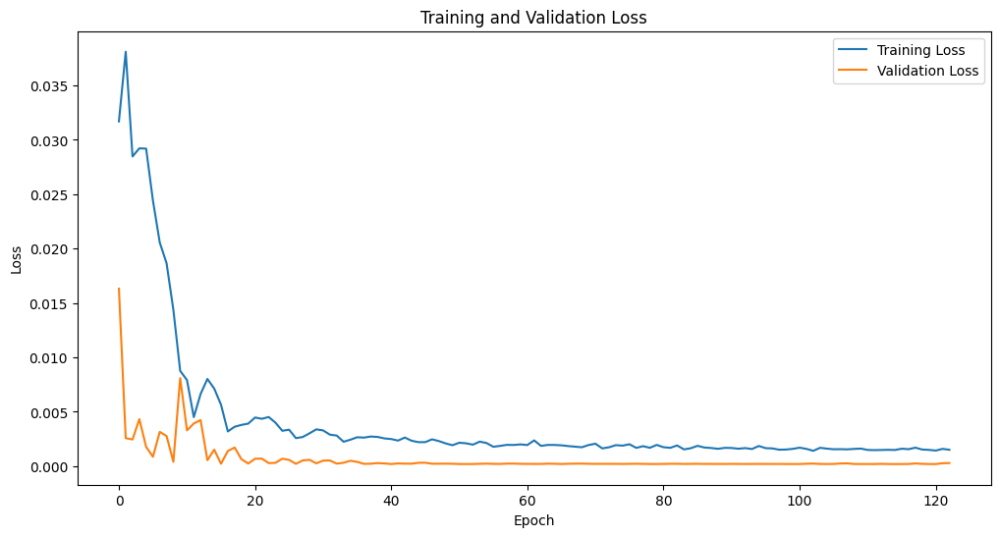

Epoch [1/2500], Train Loss: 0.0985, Val Loss: 0.0310
Epoch [2/2500], Train Loss: 0.0502, Val Loss: 0.0023
Epoch [3/2500], Train Loss: 0.0319, Val Loss: 0.0077
Epoch [4/2500], Train Loss: 0.0424, Val Loss: 0.0090
Epoch [5/2500], Train Loss: 0.0441, Val Loss: 0.0031
Epoch [6/2500], Train Loss: 0.0359, Val Loss: 0.0013
Epoch [7/2500], Train Loss: 0.0307, Val Loss: 0.0057
Epoch [8/2500], Train Loss: 0.0312, Val Loss: 0.0113
Epoch [9/2500], Train Loss: 0.0338, Val Loss: 0.0135
Epoch [10/2500], Train Loss: 0.0348, Val Loss: 0.0115
Epoch [11/2500], Train Loss: 0.0331, Val Loss: 0.0072
Epoch [12/2500], Train Loss: 0.0300, Val Loss: 0.0032
Epoch [13/2500], Train Loss: 0.0274, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0263, Val Loss: 0.0011
Epoch [15/2500], Train Loss: 0.0265, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0261, Val Loss: 0.0013
Epoch [17/2500], Train Loss: 0.0238, Val Loss: 0.0008
Epoch [18/2500], Train Loss: 0.0200, Val Loss: 0.0031
Epoch [19/2500], Train Loss: 0.0166, 

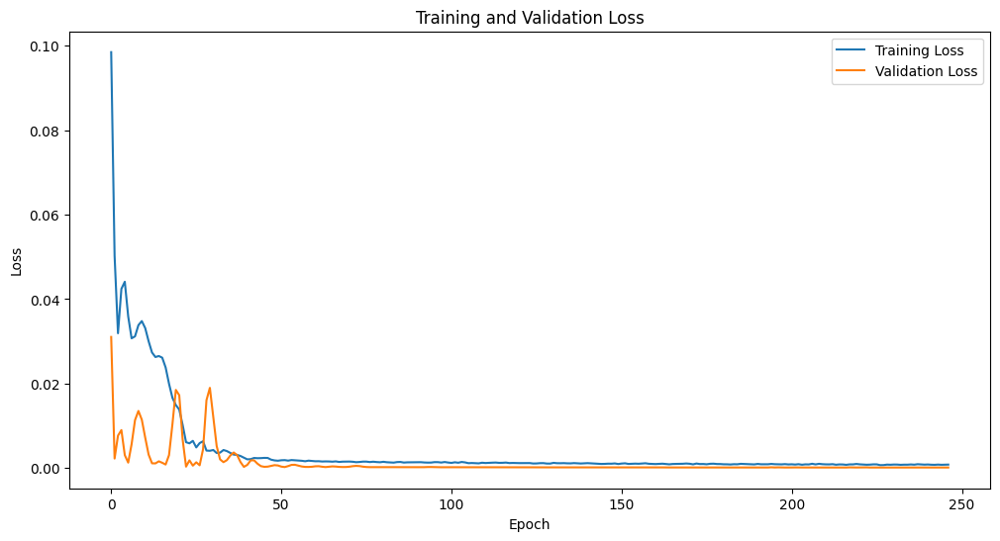

Epoch [1/2500], Train Loss: 0.1253, Val Loss: 0.0511
Epoch [2/2500], Train Loss: 0.0716, Val Loss: 0.0107
Epoch [3/2500], Train Loss: 0.0416, Val Loss: 0.0018
Epoch [4/2500], Train Loss: 0.0332, Val Loss: 0.0148
Epoch [5/2500], Train Loss: 0.0427, Val Loss: 0.0155
Epoch [6/2500], Train Loss: 0.0443, Val Loss: 0.0074
Epoch [7/2500], Train Loss: 0.0378, Val Loss: 0.0016
Epoch [8/2500], Train Loss: 0.0333, Val Loss: 0.0017
Epoch [9/2500], Train Loss: 0.0313, Val Loss: 0.0055
Epoch [10/2500], Train Loss: 0.0328, Val Loss: 0.0092
Epoch [11/2500], Train Loss: 0.0348, Val Loss: 0.0108
Epoch [12/2500], Train Loss: 0.0350, Val Loss: 0.0101
Epoch [13/2500], Train Loss: 0.0336, Val Loss: 0.0078
Epoch [14/2500], Train Loss: 0.0329, Val Loss: 0.0051
Epoch [15/2500], Train Loss: 0.0310, Val Loss: 0.0028
Epoch [16/2500], Train Loss: 0.0295, Val Loss: 0.0014
Epoch [17/2500], Train Loss: 0.0289, Val Loss: 0.0010
Epoch [18/2500], Train Loss: 0.0290, Val Loss: 0.0011
Epoch [19/2500], Train Loss: 0.0298, 

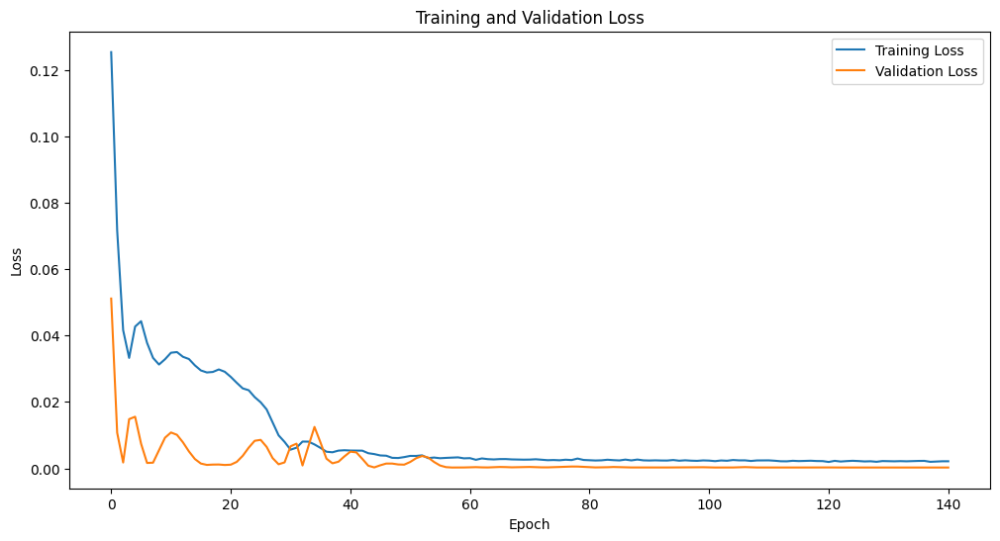

Epoch [1/2500], Train Loss: 0.0469, Val Loss: 0.0011
Epoch [2/2500], Train Loss: 0.0327, Val Loss: 0.0026
Epoch [3/2500], Train Loss: 0.0374, Val Loss: 0.0011
Epoch [4/2500], Train Loss: 0.0330, Val Loss: 0.0035
Epoch [5/2500], Train Loss: 0.0320, Val Loss: 0.0071
Epoch [6/2500], Train Loss: 0.0333, Val Loss: 0.0077
Epoch [7/2500], Train Loss: 0.0334, Val Loss: 0.0059
Epoch [8/2500], Train Loss: 0.0327, Val Loss: 0.0036
Epoch [9/2500], Train Loss: 0.0315, Val Loss: 0.0019
Epoch [10/2500], Train Loss: 0.0310, Val Loss: 0.0012
Epoch [11/2500], Train Loss: 0.0315, Val Loss: 0.0011
Epoch [12/2500], Train Loss: 0.0315, Val Loss: 0.0011
Epoch [13/2500], Train Loss: 0.0308, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0296, Val Loss: 0.0019
Epoch [15/2500], Train Loss: 0.0279, Val Loss: 0.0035
Epoch [16/2500], Train Loss: 0.0260, Val Loss: 0.0051
Epoch [17/2500], Train Loss: 0.0228, Val Loss: 0.0031
Epoch [18/2500], Train Loss: 0.0174, Val Loss: 0.0008
Epoch [19/2500], Train Loss: 0.0111, 

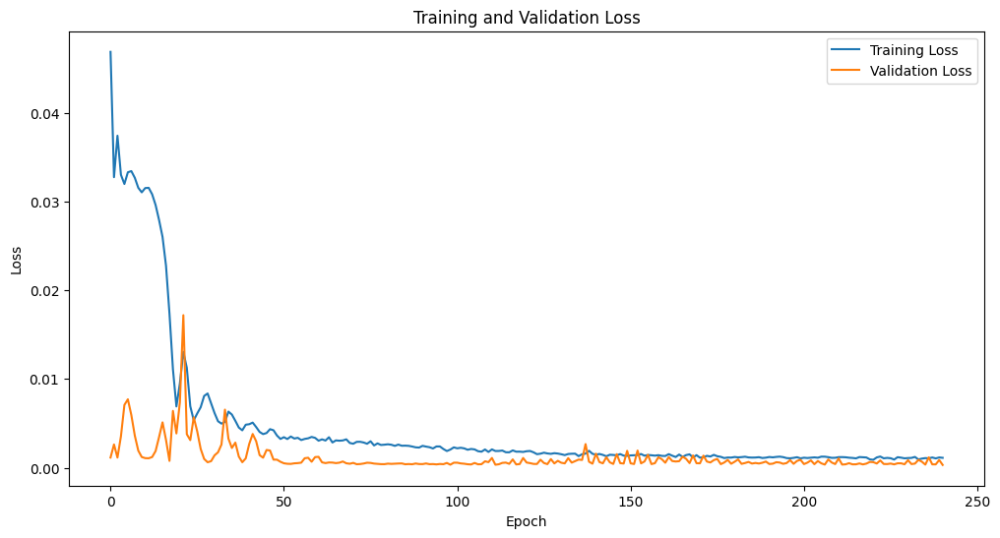

Epoch [1/2500], Train Loss: 0.0484, Val Loss: 0.0011
Epoch [2/2500], Train Loss: 0.0335, Val Loss: 0.0022
Epoch [3/2500], Train Loss: 0.0365, Val Loss: 0.0012
Epoch [4/2500], Train Loss: 0.0324, Val Loss: 0.0044
Epoch [5/2500], Train Loss: 0.0322, Val Loss: 0.0077
Epoch [6/2500], Train Loss: 0.0336, Val Loss: 0.0075
Epoch [7/2500], Train Loss: 0.0336, Val Loss: 0.0053
Epoch [8/2500], Train Loss: 0.0324, Val Loss: 0.0031
Epoch [9/2500], Train Loss: 0.0316, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0314, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0319, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0319, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0314, Val Loss: 0.0016
Epoch [14/2500], Train Loss: 0.0307, Val Loss: 0.0025
Epoch [15/2500], Train Loss: 0.0299, Val Loss: 0.0039
Epoch [16/2500], Train Loss: 0.0289, Val Loss: 0.0056
Epoch [17/2500], Train Loss: 0.0271, Val Loss: 0.0067
Epoch [18/2500], Train Loss: 0.0237, Val Loss: 0.0052
Epoch [19/2500], Train Loss: 0.0182, 

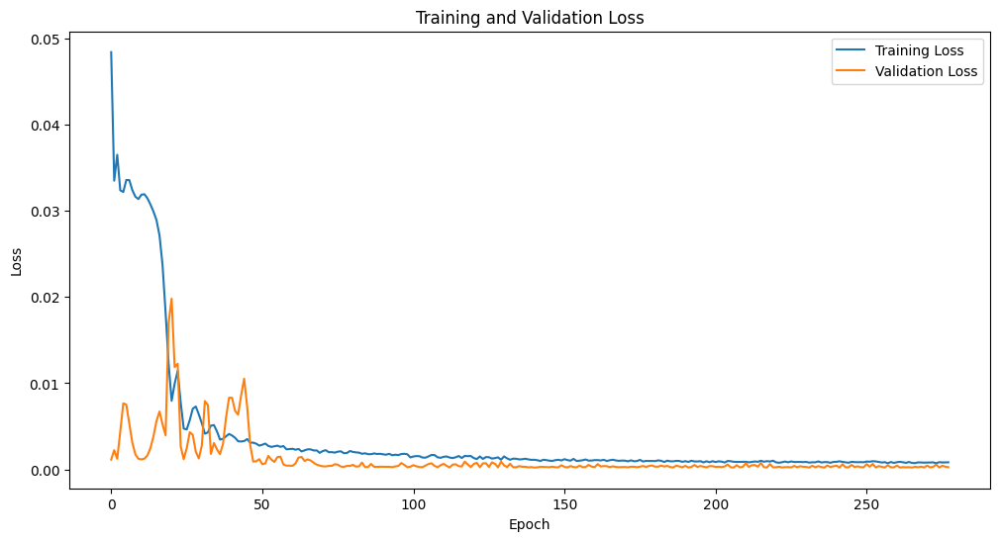

Epoch [1/2500], Train Loss: 0.0336, Val Loss: 0.0215
Epoch [2/2500], Train Loss: 0.0439, Val Loss: 0.0050
Epoch [3/2500], Train Loss: 0.0333, Val Loss: 0.0011
Epoch [4/2500], Train Loss: 0.0334, Val Loss: 0.0014
Epoch [5/2500], Train Loss: 0.0346, Val Loss: 0.0012
Epoch [6/2500], Train Loss: 0.0336, Val Loss: 0.0015
Epoch [7/2500], Train Loss: 0.0325, Val Loss: 0.0030
Epoch [8/2500], Train Loss: 0.0321, Val Loss: 0.0047
Epoch [9/2500], Train Loss: 0.0321, Val Loss: 0.0056
Epoch [10/2500], Train Loss: 0.0327, Val Loss: 0.0053
Epoch [11/2500], Train Loss: 0.0326, Val Loss: 0.0043
Epoch [12/2500], Train Loss: 0.0320, Val Loss: 0.0033
Epoch [13/2500], Train Loss: 0.0321, Val Loss: 0.0025
Epoch [14/2500], Train Loss: 0.0317, Val Loss: 0.0020
Epoch [15/2500], Train Loss: 0.0318, Val Loss: 0.0018
Epoch [16/2500], Train Loss: 0.0318, Val Loss: 0.0017
Epoch [17/2500], Train Loss: 0.0318, Val Loss: 0.0018
Epoch [18/2500], Train Loss: 0.0316, Val Loss: 0.0020
Epoch [19/2500], Train Loss: 0.0315, 

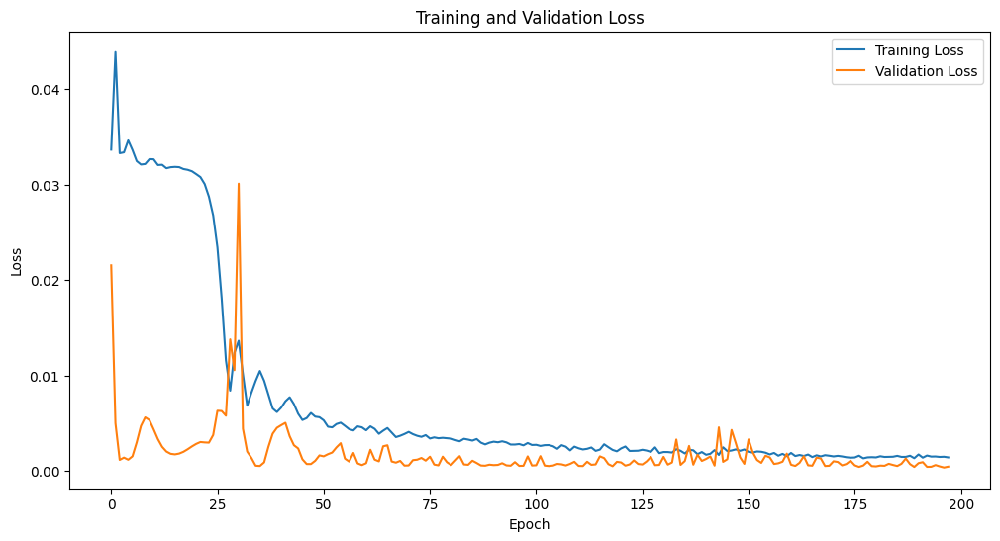

Epoch [1/2500], Train Loss: 0.1799, Val Loss: 0.0465
Epoch [2/2500], Train Loss: 0.0633, Val Loss: 0.0012
Epoch [3/2500], Train Loss: 0.0336, Val Loss: 0.0169
Epoch [4/2500], Train Loss: 0.0574, Val Loss: 0.0111
Epoch [5/2500], Train Loss: 0.0498, Val Loss: 0.0017
Epoch [6/2500], Train Loss: 0.0362, Val Loss: 0.0041
Epoch [7/2500], Train Loss: 0.0330, Val Loss: 0.0126
Epoch [8/2500], Train Loss: 0.0371, Val Loss: 0.0171
Epoch [9/2500], Train Loss: 0.0405, Val Loss: 0.0156
Epoch [10/2500], Train Loss: 0.0390, Val Loss: 0.0111
Epoch [11/2500], Train Loss: 0.0365, Val Loss: 0.0066
Epoch [12/2500], Train Loss: 0.0335, Val Loss: 0.0034
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0017
Epoch [14/2500], Train Loss: 0.0325, Val Loss: 0.0012
Epoch [15/2500], Train Loss: 0.0333, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0336, Val Loss: 0.0012
Epoch [17/2500], Train Loss: 0.0339, Val Loss: 0.0011
Epoch [18/2500], Train Loss: 0.0333, Val Loss: 0.0013
Epoch [19/2500], Train Loss: 0.0324, 

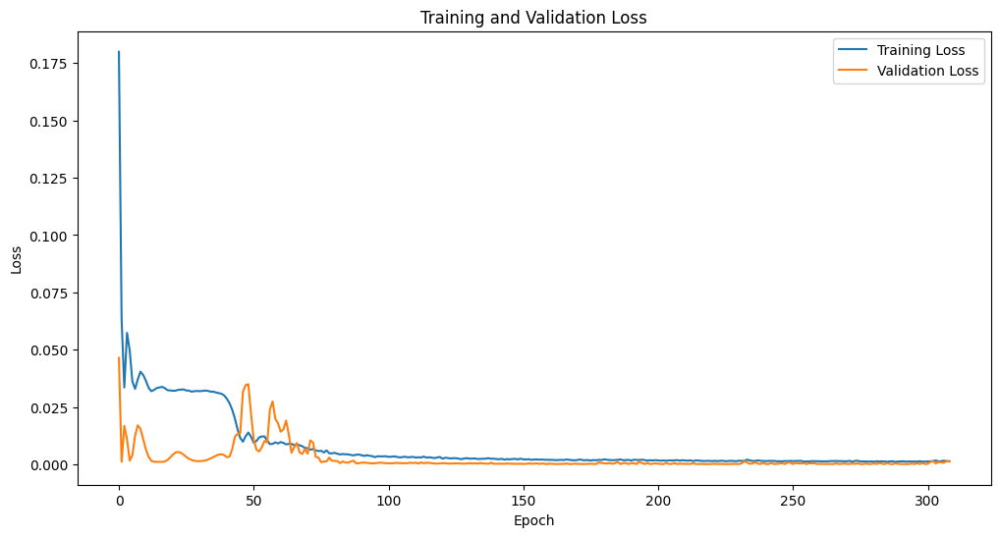

Epoch [1/2500], Train Loss: 0.0726, Val Loss: 0.0111
Epoch [2/2500], Train Loss: 0.0359, Val Loss: 0.0016
Epoch [3/2500], Train Loss: 0.0353, Val Loss: 0.0035
Epoch [4/2500], Train Loss: 0.0392, Val Loss: 0.0014
Epoch [5/2500], Train Loss: 0.0347, Val Loss: 0.0020
Epoch [6/2500], Train Loss: 0.0317, Val Loss: 0.0057
Epoch [7/2500], Train Loss: 0.0328, Val Loss: 0.0083
Epoch [8/2500], Train Loss: 0.0341, Val Loss: 0.0078
Epoch [9/2500], Train Loss: 0.0338, Val Loss: 0.0055
Epoch [10/2500], Train Loss: 0.0326, Val Loss: 0.0032
Epoch [11/2500], Train Loss: 0.0319, Val Loss: 0.0018
Epoch [12/2500], Train Loss: 0.0318, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0325, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0326, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0325, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0321, Val Loss: 0.0022
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0030
Epoch [18/2500], Train Loss: 0.0318, Val Loss: 0.0037
Epoch [19/2500], Train Loss: 0.0319, 

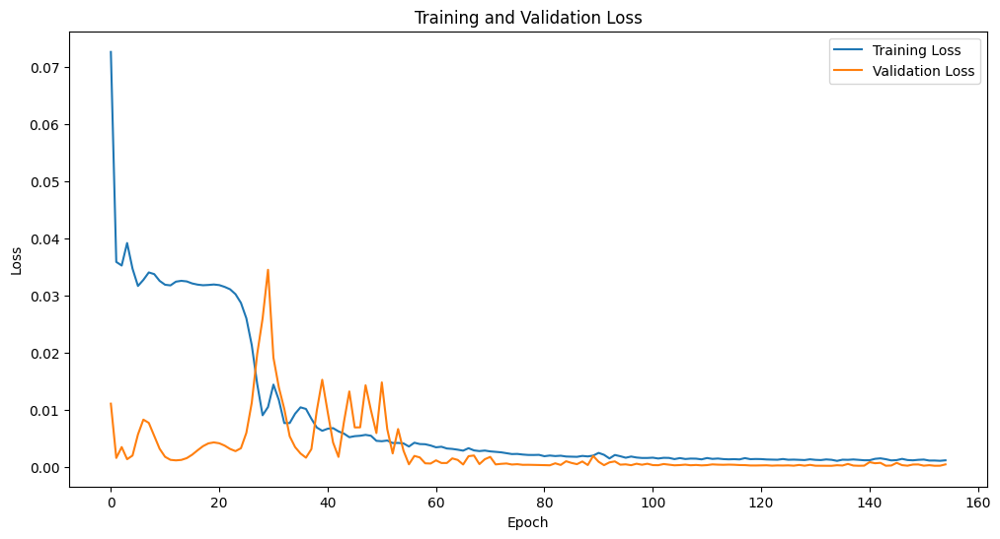

Epoch [1/2500], Train Loss: 0.1522, Val Loss: 0.0486
Epoch [2/2500], Train Loss: 0.0673, Val Loss: 0.0020
Epoch [3/2500], Train Loss: 0.0351, Val Loss: 0.0166
Epoch [4/2500], Train Loss: 0.0532, Val Loss: 0.0109
Epoch [5/2500], Train Loss: 0.0474, Val Loss: 0.0014
Epoch [6/2500], Train Loss: 0.0368, Val Loss: 0.0051
Epoch [7/2500], Train Loss: 0.0343, Val Loss: 0.0130
Epoch [8/2500], Train Loss: 0.0394, Val Loss: 0.0155
Epoch [9/2500], Train Loss: 0.0403, Val Loss: 0.0125
Epoch [10/2500], Train Loss: 0.0384, Val Loss: 0.0077
Epoch [11/2500], Train Loss: 0.0348, Val Loss: 0.0037
Epoch [12/2500], Train Loss: 0.0338, Val Loss: 0.0016
Epoch [13/2500], Train Loss: 0.0333, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0341, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0350, Val Loss: 0.0013
Epoch [16/2500], Train Loss: 0.0344, Val Loss: 0.0012
Epoch [17/2500], Train Loss: 0.0337, Val Loss: 0.0013
Epoch [18/2500], Train Loss: 0.0331, Val Loss: 0.0020
Epoch [19/2500], Train Loss: 0.0326, 

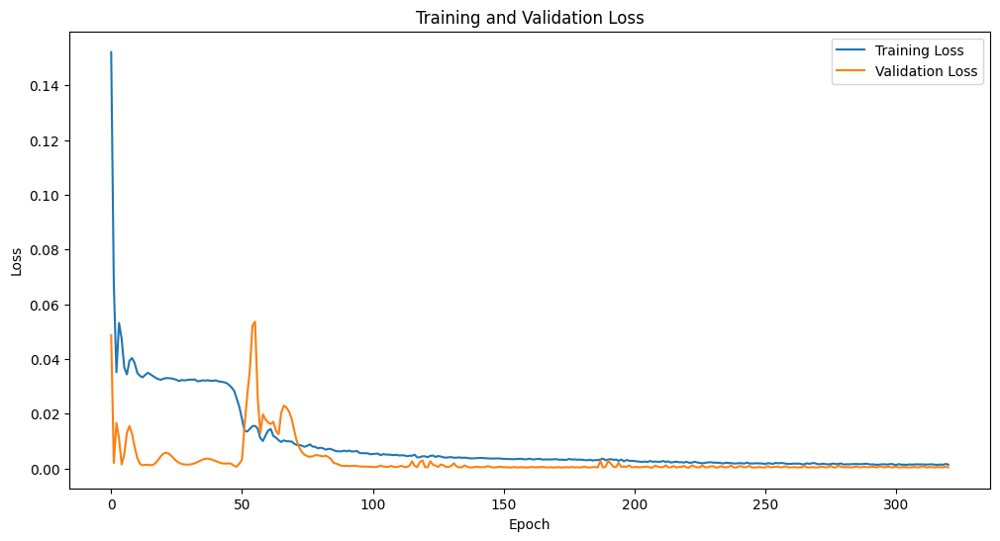

Epoch [1/2500], Train Loss: 0.1776, Val Loss: 0.0641
Epoch [2/2500], Train Loss: 0.0785, Val Loss: 0.0091
Epoch [3/2500], Train Loss: 0.0360, Val Loss: 0.0075
Epoch [4/2500], Train Loss: 0.0462, Val Loss: 0.0113
Epoch [5/2500], Train Loss: 0.0515, Val Loss: 0.0024
Epoch [6/2500], Train Loss: 0.0374, Val Loss: 0.0038
Epoch [7/2500], Train Loss: 0.0339, Val Loss: 0.0137
Epoch [8/2500], Train Loss: 0.0390, Val Loss: 0.0164
Epoch [9/2500], Train Loss: 0.0398, Val Loss: 0.0112
Epoch [10/2500], Train Loss: 0.0367, Val Loss: 0.0050
Epoch [11/2500], Train Loss: 0.0334, Val Loss: 0.0017
Epoch [12/2500], Train Loss: 0.0321, Val Loss: 0.0012
Epoch [13/2500], Train Loss: 0.0343, Val Loss: 0.0014
Epoch [14/2500], Train Loss: 0.0352, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0350, Val Loss: 0.0011
Epoch [16/2500], Train Loss: 0.0333, Val Loss: 0.0016
Epoch [17/2500], Train Loss: 0.0323, Val Loss: 0.0029
Epoch [18/2500], Train Loss: 0.0321, Val Loss: 0.0046
Epoch [19/2500], Train Loss: 0.0326, 

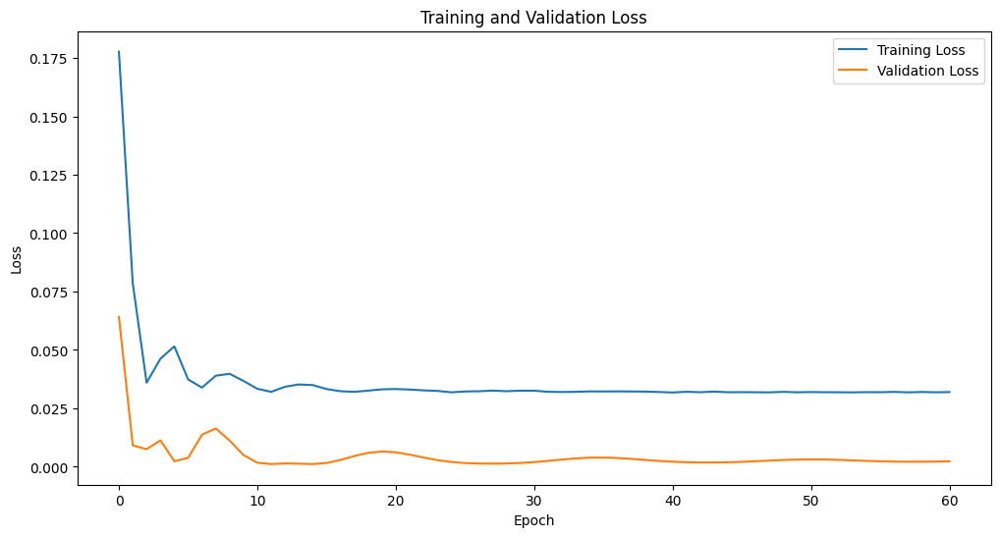

Epoch [1/2500], Train Loss: 0.0596, Val Loss: 0.0015
Epoch [2/2500], Train Loss: 0.0323, Val Loss: 0.0043
Epoch [3/2500], Train Loss: 0.0408, Val Loss: 0.0012
Epoch [4/2500], Train Loss: 0.0340, Val Loss: 0.0039
Epoch [5/2500], Train Loss: 0.0321, Val Loss: 0.0093
Epoch [6/2500], Train Loss: 0.0346, Val Loss: 0.0096
Epoch [7/2500], Train Loss: 0.0350, Val Loss: 0.0063
Epoch [8/2500], Train Loss: 0.0331, Val Loss: 0.0031
Epoch [9/2500], Train Loss: 0.0319, Val Loss: 0.0015
Epoch [10/2500], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [11/2500], Train Loss: 0.0332, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0331, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0324, Val Loss: 0.0019
Epoch [14/2500], Train Loss: 0.0319, Val Loss: 0.0029
Epoch [15/2500], Train Loss: 0.0318, Val Loss: 0.0040
Epoch [16/2500], Train Loss: 0.0322, Val Loss: 0.0048
Epoch [17/2500], Train Loss: 0.0323, Val Loss: 0.0049
Epoch [18/2500], Train Loss: 0.0324, Val Loss: 0.0045
Epoch [19/2500], Train Loss: 0.0324, 

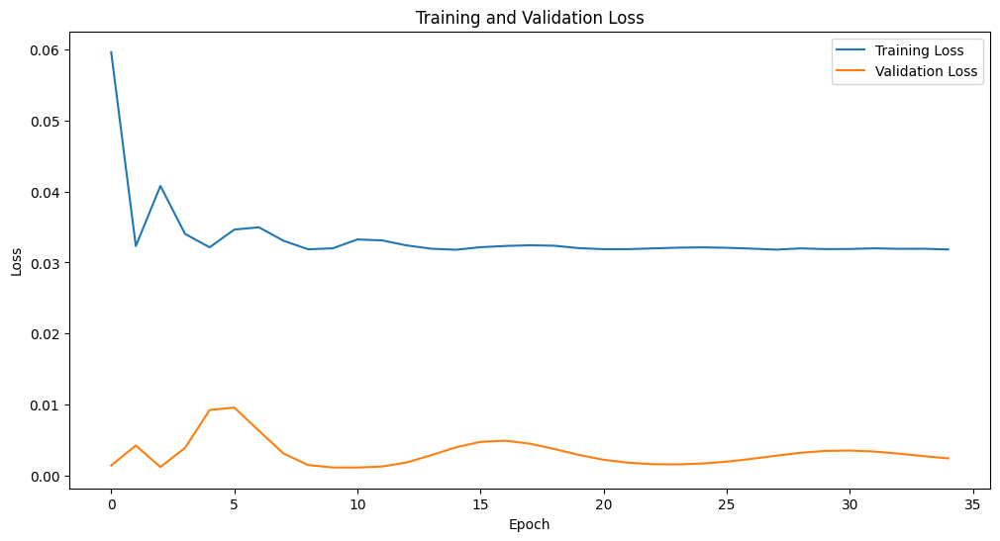

Epoch [1/2500], Train Loss: 0.0569, Val Loss: 0.0020
Epoch [2/2500], Train Loss: 0.0327, Val Loss: 0.0038
Epoch [3/2500], Train Loss: 0.0397, Val Loss: 0.0023
Epoch [4/2500], Train Loss: 0.0370, Val Loss: 0.0013
Epoch [5/2500], Train Loss: 0.0325, Val Loss: 0.0044
Epoch [6/2500], Train Loss: 0.0326, Val Loss: 0.0076
Epoch [7/2500], Train Loss: 0.0342, Val Loss: 0.0074
Epoch [8/2500], Train Loss: 0.0339, Val Loss: 0.0054
Epoch [9/2500], Train Loss: 0.0329, Val Loss: 0.0034
Epoch [10/2500], Train Loss: 0.0322, Val Loss: 0.0022
Epoch [11/2500], Train Loss: 0.0320, Val Loss: 0.0015
Epoch [12/2500], Train Loss: 0.0322, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0325, Val Loss: 0.0014
Epoch [14/2500], Train Loss: 0.0324, Val Loss: 0.0015
Epoch [15/2500], Train Loss: 0.0323, Val Loss: 0.0019
Epoch [16/2500], Train Loss: 0.0320, Val Loss: 0.0026
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0032
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0037
Epoch [19/2500], Train Loss: 0.0321, 

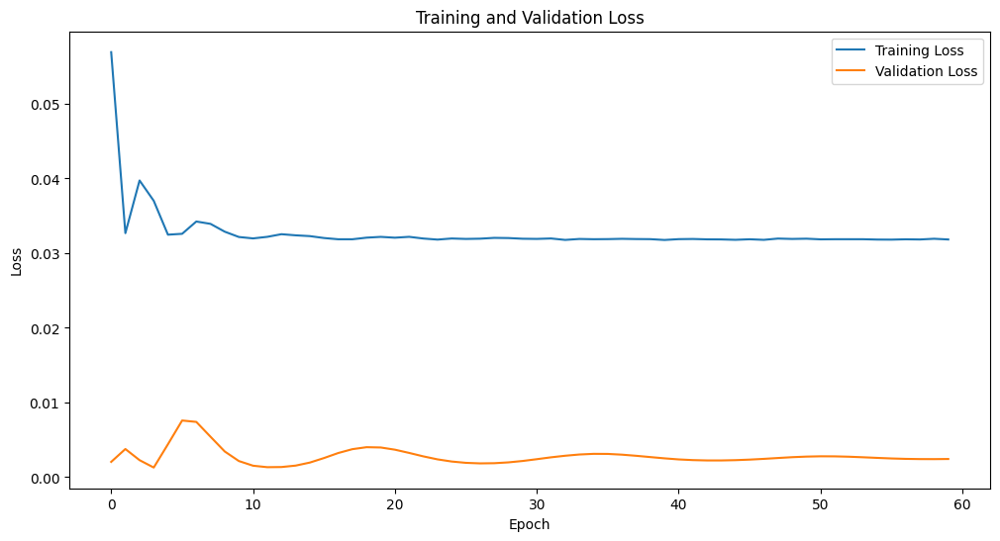

Epoch [1/2500], Train Loss: 0.0508, Val Loss: 0.0109
Epoch [2/2500], Train Loss: 0.0428, Val Loss: 0.0018
Epoch [3/2500], Train Loss: 0.0310, Val Loss: 0.0039
Epoch [4/2500], Train Loss: 0.0277, Val Loss: 0.0097
Epoch [5/2500], Train Loss: 0.0290, Val Loss: 0.0080
Epoch [6/2500], Train Loss: 0.0260, Val Loss: 0.0022
Epoch [7/2500], Train Loss: 0.0196, Val Loss: 0.0016
Epoch [8/2500], Train Loss: 0.0161, Val Loss: 0.0058
Epoch [9/2500], Train Loss: 0.0136, Val Loss: 0.0015
Epoch [10/2500], Train Loss: 0.0057, Val Loss: 0.0065
Epoch [11/2500], Train Loss: 0.0043, Val Loss: 0.0078
Epoch [12/2500], Train Loss: 0.0079, Val Loss: 0.0021
Epoch [13/2500], Train Loss: 0.0074, Val Loss: 0.0075
Epoch [14/2500], Train Loss: 0.0068, Val Loss: 0.0012
Epoch [15/2500], Train Loss: 0.0024, Val Loss: 0.0007
Epoch [16/2500], Train Loss: 0.0033, Val Loss: 0.0016
Epoch [17/2500], Train Loss: 0.0052, Val Loss: 0.0009
Epoch [18/2500], Train Loss: 0.0053, Val Loss: 0.0003
Epoch [19/2500], Train Loss: 0.0049, 

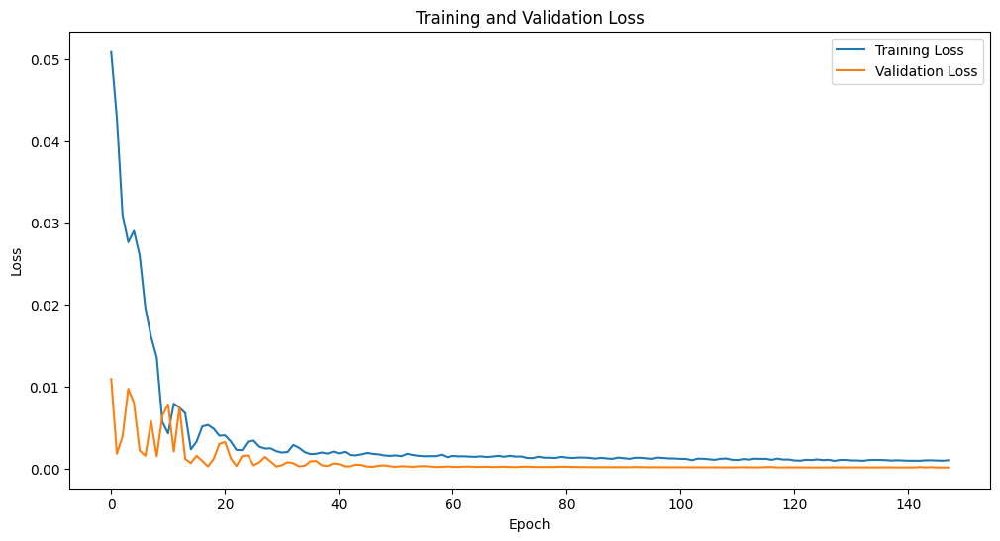

Epoch [1/2500], Train Loss: 0.1869, Val Loss: 0.0418
Epoch [2/2500], Train Loss: 0.0642, Val Loss: 0.0038
Epoch [3/2500], Train Loss: 0.0344, Val Loss: 0.0218
Epoch [4/2500], Train Loss: 0.0509, Val Loss: 0.0012
Epoch [5/2500], Train Loss: 0.0307, Val Loss: 0.0156
Epoch [6/2500], Train Loss: 0.0354, Val Loss: 0.0234
Epoch [7/2500], Train Loss: 0.0393, Val Loss: 0.0122
Epoch [8/2500], Train Loss: 0.0315, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0263, Val Loss: 0.0015
Epoch [10/2500], Train Loss: 0.0272, Val Loss: 0.0036
Epoch [11/2500], Train Loss: 0.0287, Val Loss: 0.0021
Epoch [12/2500], Train Loss: 0.0257, Val Loss: 0.0009
Epoch [13/2500], Train Loss: 0.0212, Val Loss: 0.0047
Epoch [14/2500], Train Loss: 0.0193, Val Loss: 0.0114
Epoch [15/2500], Train Loss: 0.0194, Val Loss: 0.0139
Epoch [16/2500], Train Loss: 0.0173, Val Loss: 0.0082
Epoch [17/2500], Train Loss: 0.0123, Val Loss: 0.0009
Epoch [18/2500], Train Loss: 0.0076, Val Loss: 0.0022
Epoch [19/2500], Train Loss: 0.0072, 

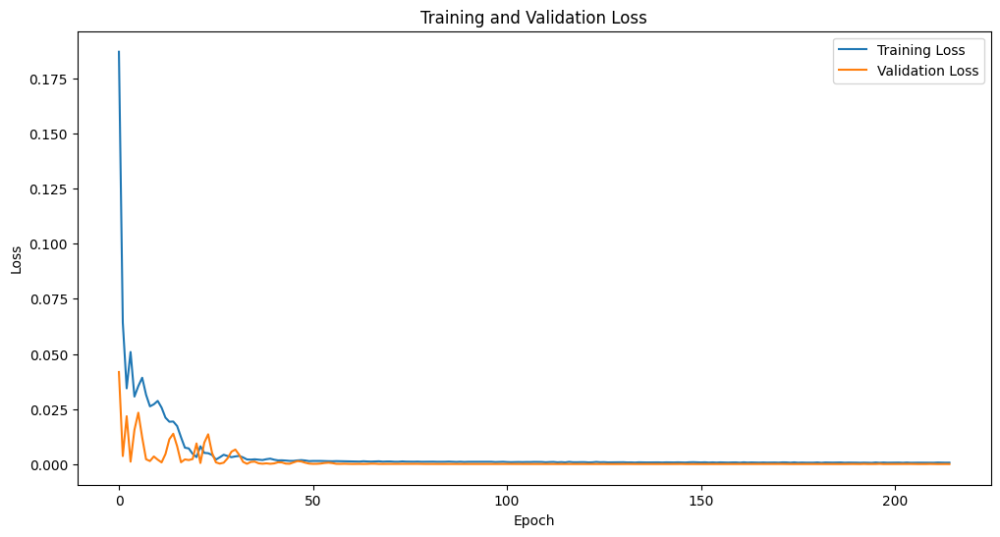

Epoch [1/2500], Train Loss: 0.0672, Val Loss: 0.0070
Epoch [2/2500], Train Loss: 0.0380, Val Loss: 0.0039
Epoch [3/2500], Train Loss: 0.0357, Val Loss: 0.0032
Epoch [4/2500], Train Loss: 0.0297, Val Loss: 0.0118
Epoch [5/2500], Train Loss: 0.0322, Val Loss: 0.0104
Epoch [6/2500], Train Loss: 0.0294, Val Loss: 0.0032
Epoch [7/2500], Train Loss: 0.0244, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0224, Val Loss: 0.0026
Epoch [9/2500], Train Loss: 0.0220, Val Loss: 0.0007
Epoch [10/2500], Train Loss: 0.0149, Val Loss: 0.0083
Epoch [11/2500], Train Loss: 0.0113, Val Loss: 0.0165
Epoch [12/2500], Train Loss: 0.0096, Val Loss: 0.0036
Epoch [13/2500], Train Loss: 0.0048, Val Loss: 0.0071
Epoch [14/2500], Train Loss: 0.0105, Val Loss: 0.0018
Epoch [15/2500], Train Loss: 0.0063, Val Loss: 0.0027
Epoch [16/2500], Train Loss: 0.0085, Val Loss: 0.0006
Epoch [17/2500], Train Loss: 0.0058, Val Loss: 0.0044
Epoch [18/2500], Train Loss: 0.0038, Val Loss: 0.0119
Epoch [19/2500], Train Loss: 0.0050, 

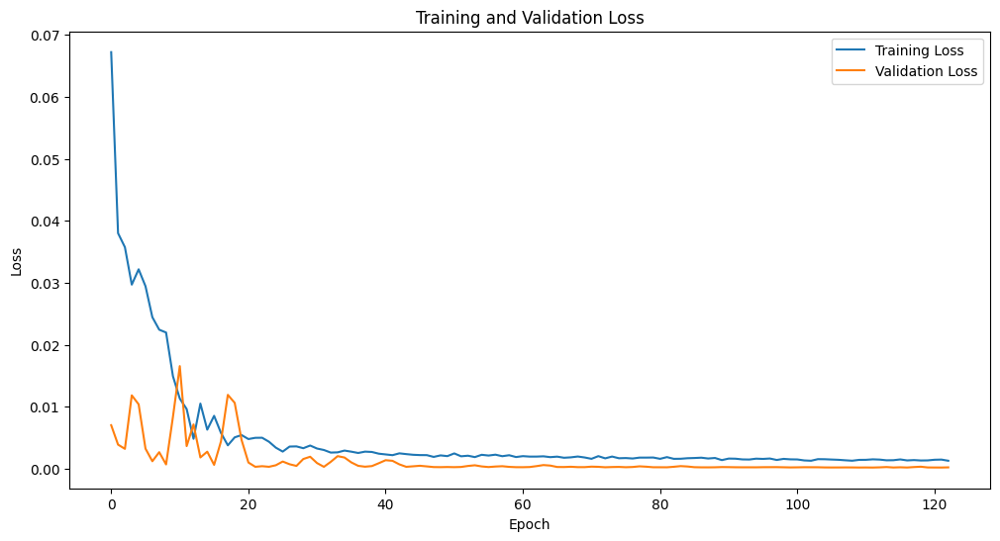

Epoch [1/2500], Train Loss: 0.1413, Val Loss: 0.0078
Epoch [2/2500], Train Loss: 0.0345, Val Loss: 0.0678
Epoch [3/2500], Train Loss: 0.1033, Val Loss: 0.0016
Epoch [4/2500], Train Loss: 0.0340, Val Loss: 0.0162
Epoch [5/2500], Train Loss: 0.0403, Val Loss: 0.0267
Epoch [6/2500], Train Loss: 0.0473, Val Loss: 0.0242
Epoch [7/2500], Train Loss: 0.0454, Val Loss: 0.0177
Epoch [8/2500], Train Loss: 0.0403, Val Loss: 0.0109
Epoch [9/2500], Train Loss: 0.0354, Val Loss: 0.0052
Epoch [10/2500], Train Loss: 0.0325, Val Loss: 0.0018
Epoch [11/2500], Train Loss: 0.0319, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0338, Val Loss: 0.0016
Epoch [13/2500], Train Loss: 0.0349, Val Loss: 0.0013
Epoch [14/2500], Train Loss: 0.0338, Val Loss: 0.0013
Epoch [15/2500], Train Loss: 0.0322, Val Loss: 0.0030
Epoch [16/2500], Train Loss: 0.0314, Val Loss: 0.0055
Epoch [17/2500], Train Loss: 0.0317, Val Loss: 0.0069
Epoch [18/2500], Train Loss: 0.0316, Val Loss: 0.0061
Epoch [19/2500], Train Loss: 0.0306, 

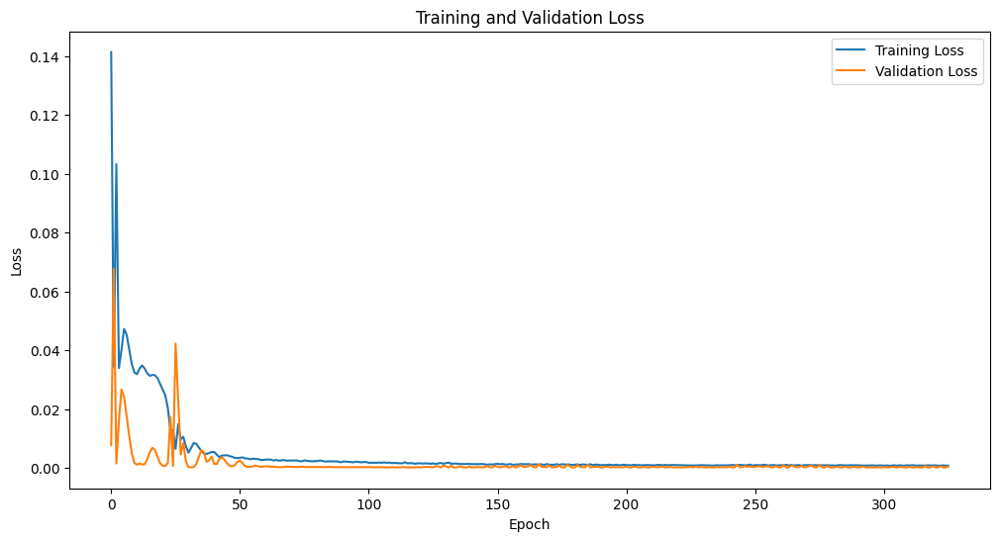

Epoch [1/2500], Train Loss: 0.1250, Val Loss: 0.0103
Epoch [2/2500], Train Loss: 0.0355, Val Loss: 0.0313
Epoch [3/2500], Train Loss: 0.0752, Val Loss: 0.0012
Epoch [4/2500], Train Loss: 0.0334, Val Loss: 0.0110
Epoch [5/2500], Train Loss: 0.0355, Val Loss: 0.0174
Epoch [6/2500], Train Loss: 0.0399, Val Loss: 0.0139
Epoch [7/2500], Train Loss: 0.0377, Val Loss: 0.0071
Epoch [8/2500], Train Loss: 0.0339, Val Loss: 0.0021
Epoch [9/2500], Train Loss: 0.0315, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0325, Val Loss: 0.0015
Epoch [11/2500], Train Loss: 0.0332, Val Loss: 0.0011
Epoch [12/2500], Train Loss: 0.0315, Val Loss: 0.0025
Epoch [13/2500], Train Loss: 0.0309, Val Loss: 0.0052
Epoch [14/2500], Train Loss: 0.0311, Val Loss: 0.0062
Epoch [15/2500], Train Loss: 0.0307, Val Loss: 0.0047
Epoch [16/2500], Train Loss: 0.0288, Val Loss: 0.0021
Epoch [17/2500], Train Loss: 0.0261, Val Loss: 0.0010
Epoch [18/2500], Train Loss: 0.0231, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0165, 

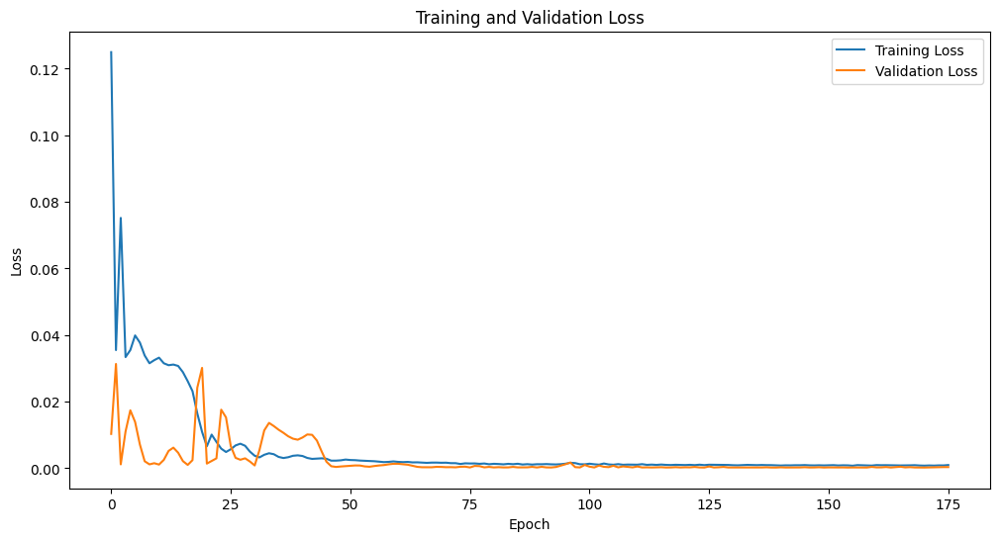

Epoch [1/2500], Train Loss: 0.0372, Val Loss: 0.0664
Epoch [2/2500], Train Loss: 0.1126, Val Loss: 0.0015
Epoch [3/2500], Train Loss: 0.0354, Val Loss: 0.0103
Epoch [4/2500], Train Loss: 0.0356, Val Loss: 0.0169
Epoch [5/2500], Train Loss: 0.0397, Val Loss: 0.0133
Epoch [6/2500], Train Loss: 0.0376, Val Loss: 0.0064
Epoch [7/2500], Train Loss: 0.0334, Val Loss: 0.0017
Epoch [8/2500], Train Loss: 0.0328, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0342, Val Loss: 0.0011
Epoch [10/2500], Train Loss: 0.0334, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0319, Val Loss: 0.0051
Epoch [12/2500], Train Loss: 0.0319, Val Loss: 0.0068
Epoch [13/2500], Train Loss: 0.0321, Val Loss: 0.0066
Epoch [14/2500], Train Loss: 0.0314, Val Loss: 0.0049
Epoch [15/2500], Train Loss: 0.0305, Val Loss: 0.0030
Epoch [16/2500], Train Loss: 0.0291, Val Loss: 0.0019
Epoch [17/2500], Train Loss: 0.0276, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0236, Val Loss: 0.0110
Epoch [19/2500], Train Loss: 0.0175, 

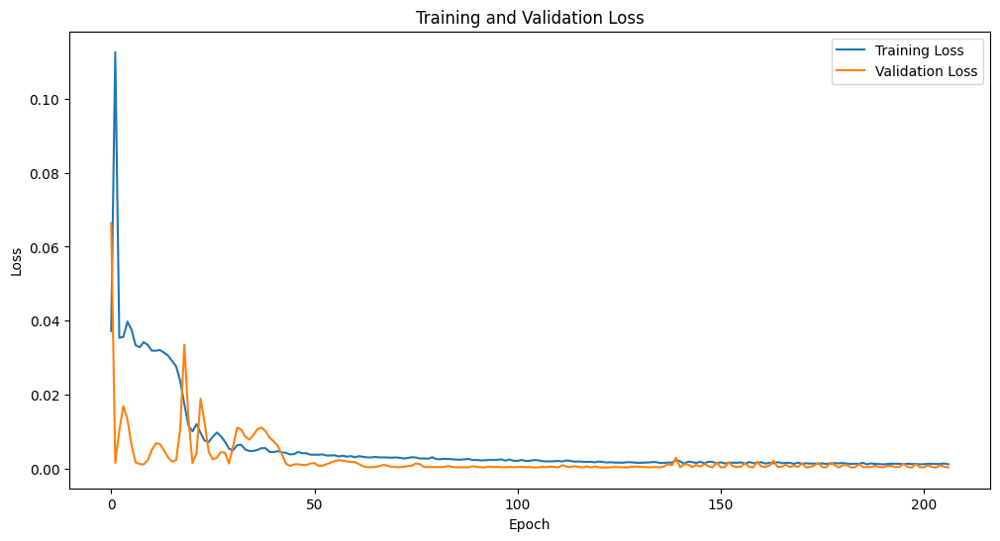

Epoch [1/2500], Train Loss: 0.0882, Val Loss: 0.0195
Epoch [2/2500], Train Loss: 0.0624, Val Loss: 0.0013
Epoch [3/2500], Train Loss: 0.0343, Val Loss: 0.0118
Epoch [4/2500], Train Loss: 0.0371, Val Loss: 0.0113
Epoch [5/2500], Train Loss: 0.0363, Val Loss: 0.0049
Epoch [6/2500], Train Loss: 0.0329, Val Loss: 0.0016
Epoch [7/2500], Train Loss: 0.0322, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0339, Val Loss: 0.0014
Epoch [9/2500], Train Loss: 0.0333, Val Loss: 0.0032
Epoch [10/2500], Train Loss: 0.0324, Val Loss: 0.0056
Epoch [11/2500], Train Loss: 0.0328, Val Loss: 0.0048
Epoch [12/2500], Train Loss: 0.0325, Val Loss: 0.0028
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0016
Epoch [14/2500], Train Loss: 0.0322, Val Loss: 0.0014
Epoch [15/2500], Train Loss: 0.0324, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0323, Val Loss: 0.0023
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0032
Epoch [18/2500], Train Loss: 0.0320, Val Loss: 0.0038
Epoch [19/2500], Train Loss: 0.0319, 

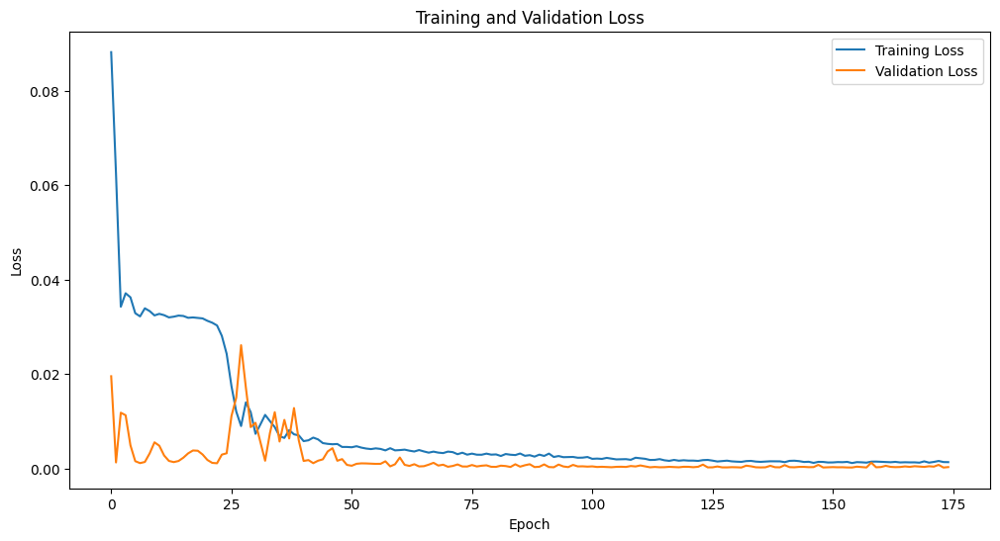

Epoch [1/2500], Train Loss: 0.1686, Val Loss: 0.0213
Epoch [2/2500], Train Loss: 0.0430, Val Loss: 0.0501
Epoch [3/2500], Train Loss: 0.0967, Val Loss: 0.0015
Epoch [4/2500], Train Loss: 0.0353, Val Loss: 0.0136
Epoch [5/2500], Train Loss: 0.0376, Val Loss: 0.0235
Epoch [6/2500], Train Loss: 0.0446, Val Loss: 0.0188
Epoch [7/2500], Train Loss: 0.0410, Val Loss: 0.0092
Epoch [8/2500], Train Loss: 0.0349, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0319, Val Loss: 0.0013
Epoch [10/2500], Train Loss: 0.0342, Val Loss: 0.0013
Epoch [11/2500], Train Loss: 0.0342, Val Loss: 0.0018
Epoch [12/2500], Train Loss: 0.0318, Val Loss: 0.0062
Epoch [13/2500], Train Loss: 0.0333, Val Loss: 0.0076
Epoch [14/2500], Train Loss: 0.0337, Val Loss: 0.0043
Epoch [15/2500], Train Loss: 0.0324, Val Loss: 0.0017
Epoch [16/2500], Train Loss: 0.0321, Val Loss: 0.0012
Epoch [17/2500], Train Loss: 0.0329, Val Loss: 0.0012
Epoch [18/2500], Train Loss: 0.0330, Val Loss: 0.0014
Epoch [19/2500], Train Loss: 0.0323, 

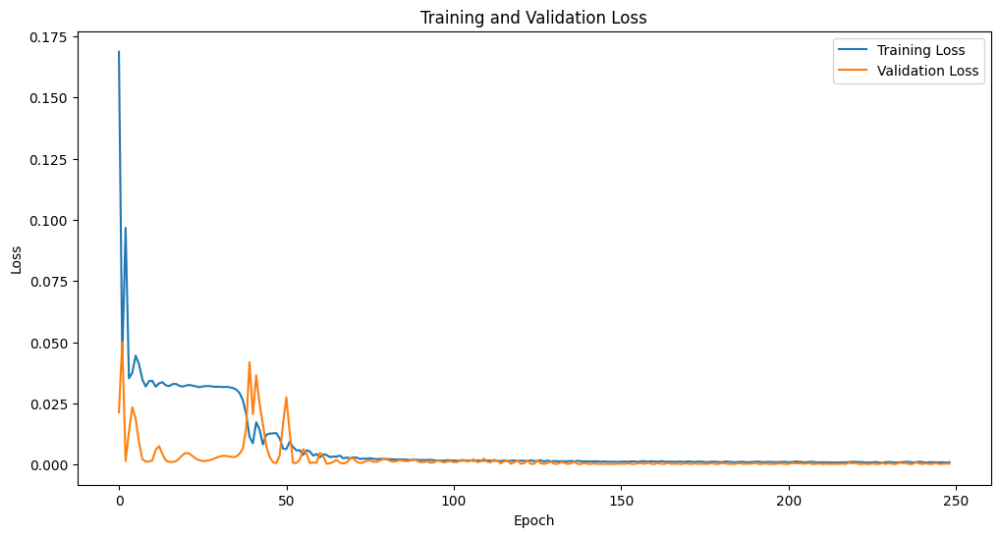

Epoch [1/2500], Train Loss: 0.0323, Val Loss: 0.0211
Epoch [2/2500], Train Loss: 0.0621, Val Loss: 0.0044
Epoch [3/2500], Train Loss: 0.0323, Val Loss: 0.0152
Epoch [4/2500], Train Loss: 0.0381, Val Loss: 0.0127
Epoch [5/2500], Train Loss: 0.0368, Val Loss: 0.0065
Epoch [6/2500], Train Loss: 0.0336, Val Loss: 0.0016
Epoch [7/2500], Train Loss: 0.0321, Val Loss: 0.0013
Epoch [8/2500], Train Loss: 0.0343, Val Loss: 0.0014
Epoch [9/2500], Train Loss: 0.0325, Val Loss: 0.0038
Epoch [10/2500], Train Loss: 0.0324, Val Loss: 0.0057
Epoch [11/2500], Train Loss: 0.0330, Val Loss: 0.0049
Epoch [12/2500], Train Loss: 0.0325, Val Loss: 0.0033
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0021
Epoch [14/2500], Train Loss: 0.0319, Val Loss: 0.0016
Epoch [15/2500], Train Loss: 0.0324, Val Loss: 0.0015
Epoch [16/2500], Train Loss: 0.0322, Val Loss: 0.0017
Epoch [17/2500], Train Loss: 0.0323, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0030
Epoch [19/2500], Train Loss: 0.0321, 

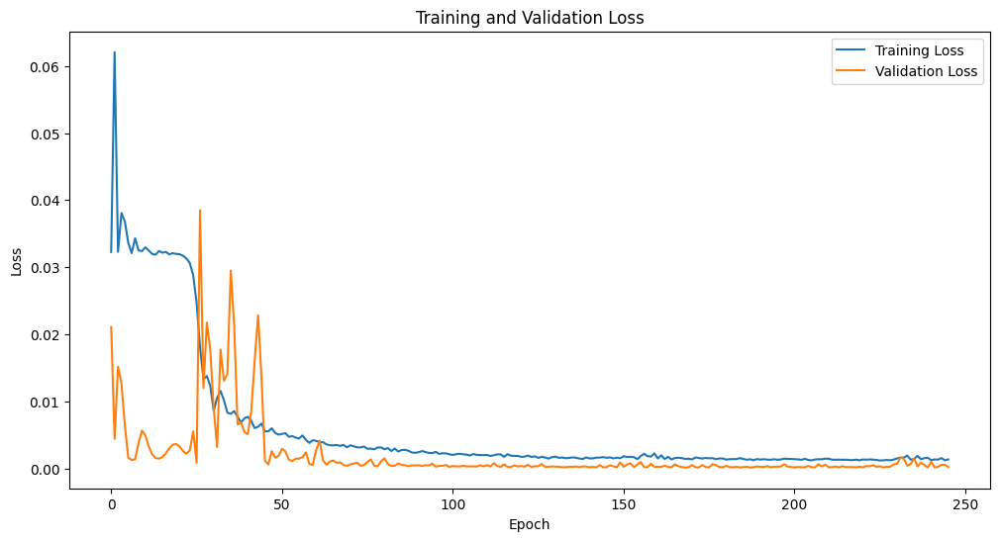

Epoch [1/2500], Train Loss: 0.1100, Val Loss: 0.0012
Epoch [2/2500], Train Loss: 0.0339, Val Loss: 0.0020
Epoch [3/2500], Train Loss: 0.0371, Val Loss: 0.0075
Epoch [4/2500], Train Loss: 0.0340, Val Loss: 0.0097
Epoch [5/2500], Train Loss: 0.0353, Val Loss: 0.0033
Epoch [6/2500], Train Loss: 0.0321, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0333, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0339, Val Loss: 0.0015
Epoch [9/2500], Train Loss: 0.0324, Val Loss: 0.0036
Epoch [10/2500], Train Loss: 0.0326, Val Loss: 0.0055
Epoch [11/2500], Train Loss: 0.0328, Val Loss: 0.0051
Epoch [12/2500], Train Loss: 0.0326, Val Loss: 0.0032
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0018
Epoch [14/2500], Train Loss: 0.0323, Val Loss: 0.0014
Epoch [15/2500], Train Loss: 0.0325, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0322, Val Loss: 0.0024
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0036
Epoch [18/2500], Train Loss: 0.0322, Val Loss: 0.0041
Epoch [19/2500], Train Loss: 0.0322, 

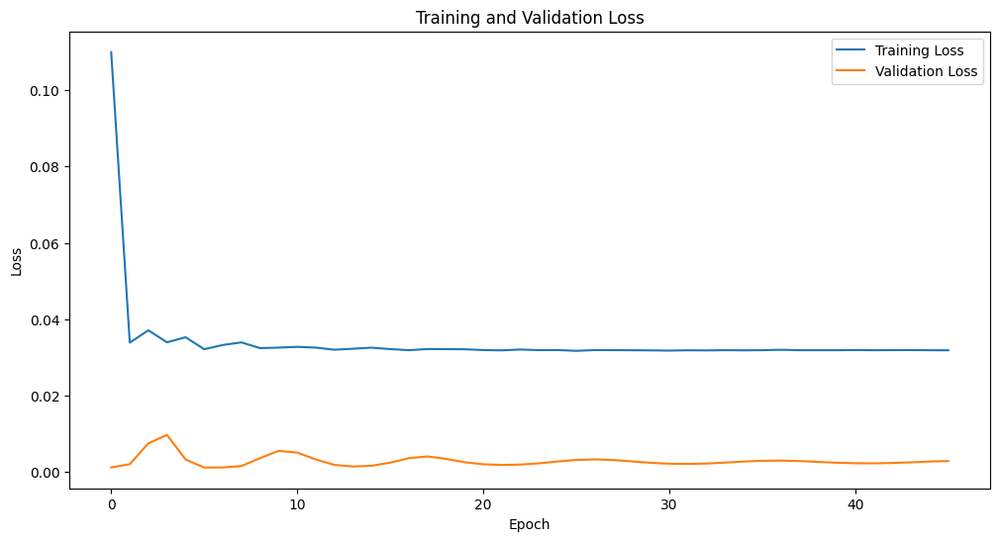

Epoch [1/2500], Train Loss: 0.1038, Val Loss: 0.0018
Epoch [2/2500], Train Loss: 0.0357, Val Loss: 0.0012
Epoch [3/2500], Train Loss: 0.0330, Val Loss: 0.0166
Epoch [4/2500], Train Loss: 0.0394, Val Loss: 0.0024
Epoch [5/2500], Train Loss: 0.0321, Val Loss: 0.0017
Epoch [6/2500], Train Loss: 0.0356, Val Loss: 0.0012
Epoch [7/2500], Train Loss: 0.0336, Val Loss: 0.0025
Epoch [8/2500], Train Loss: 0.0320, Val Loss: 0.0063
Epoch [9/2500], Train Loss: 0.0329, Val Loss: 0.0071
Epoch [10/2500], Train Loss: 0.0334, Val Loss: 0.0047
Epoch [11/2500], Train Loss: 0.0324, Val Loss: 0.0023
Epoch [12/2500], Train Loss: 0.0317, Val Loss: 0.0013
Epoch [13/2500], Train Loss: 0.0324, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0327, Val Loss: 0.0015
Epoch [15/2500], Train Loss: 0.0323, Val Loss: 0.0024
Epoch [16/2500], Train Loss: 0.0319, Val Loss: 0.0038
Epoch [17/2500], Train Loss: 0.0321, Val Loss: 0.0046
Epoch [18/2500], Train Loss: 0.0324, Val Loss: 0.0043
Epoch [19/2500], Train Loss: 0.0322, 

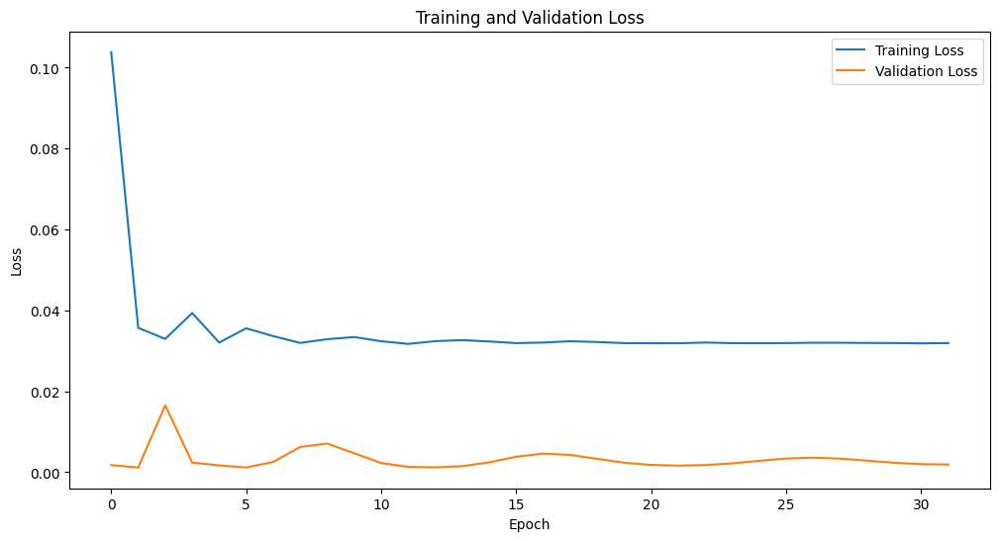

Epoch [1/2500], Train Loss: 0.1283, Val Loss: 0.0199
Epoch [2/2500], Train Loss: 0.0428, Val Loss: 0.0084
Epoch [3/2500], Train Loss: 0.0450, Val Loss: 0.0018
Epoch [4/2500], Train Loss: 0.0365, Val Loss: 0.0071
Epoch [5/2500], Train Loss: 0.0338, Val Loss: 0.0126
Epoch [6/2500], Train Loss: 0.0370, Val Loss: 0.0064
Epoch [7/2500], Train Loss: 0.0334, Val Loss: 0.0018
Epoch [8/2500], Train Loss: 0.0326, Val Loss: 0.0011
Epoch [9/2500], Train Loss: 0.0339, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0325, Val Loss: 0.0025
Epoch [11/2500], Train Loss: 0.0324, Val Loss: 0.0045
Epoch [12/2500], Train Loss: 0.0326, Val Loss: 0.0044
Epoch [13/2500], Train Loss: 0.0326, Val Loss: 0.0029
Epoch [14/2500], Train Loss: 0.0321, Val Loss: 0.0019
Epoch [15/2500], Train Loss: 0.0323, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0324, Val Loss: 0.0018
Epoch [17/2500], Train Loss: 0.0322, Val Loss: 0.0024
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0031
Epoch [19/2500], Train Loss: 0.0321, 

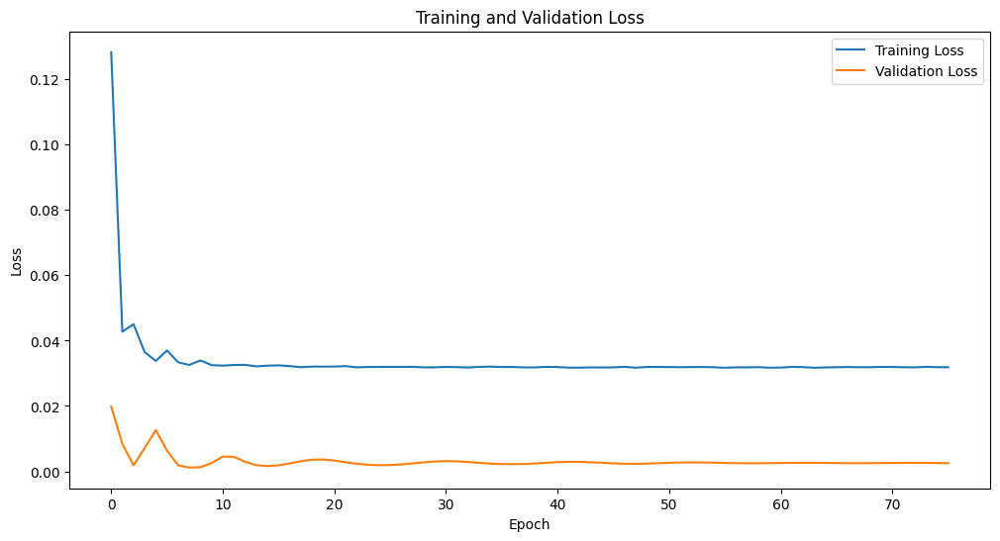

Epoch [1/2500], Train Loss: 0.0671, Val Loss: 0.0255
Epoch [2/2500], Train Loss: 0.0576, Val Loss: 0.0122
Epoch [3/2500], Train Loss: 0.0344, Val Loss: 0.0181
Epoch [4/2500], Train Loss: 0.0367, Val Loss: 0.0054
Epoch [5/2500], Train Loss: 0.0289, Val Loss: 0.0010
Epoch [6/2500], Train Loss: 0.0268, Val Loss: 0.0038
Epoch [7/2500], Train Loss: 0.0273, Val Loss: 0.0019
Epoch [8/2500], Train Loss: 0.0218, Val Loss: 0.0014
Epoch [9/2500], Train Loss: 0.0151, Val Loss: 0.0071
Epoch [10/2500], Train Loss: 0.0105, Val Loss: 0.0004
Epoch [11/2500], Train Loss: 0.0019, Val Loss: 0.0159
Epoch [12/2500], Train Loss: 0.0165, Val Loss: 0.0198
Epoch [13/2500], Train Loss: 0.0152, Val Loss: 0.0062
Epoch [14/2500], Train Loss: 0.0054, Val Loss: 0.0004
Epoch [15/2500], Train Loss: 0.0037, Val Loss: 0.0040
Epoch [16/2500], Train Loss: 0.0080, Val Loss: 0.0054
Epoch [17/2500], Train Loss: 0.0105, Val Loss: 0.0034
Epoch [18/2500], Train Loss: 0.0104, Val Loss: 0.0012
Epoch [19/2500], Train Loss: 0.0089, 

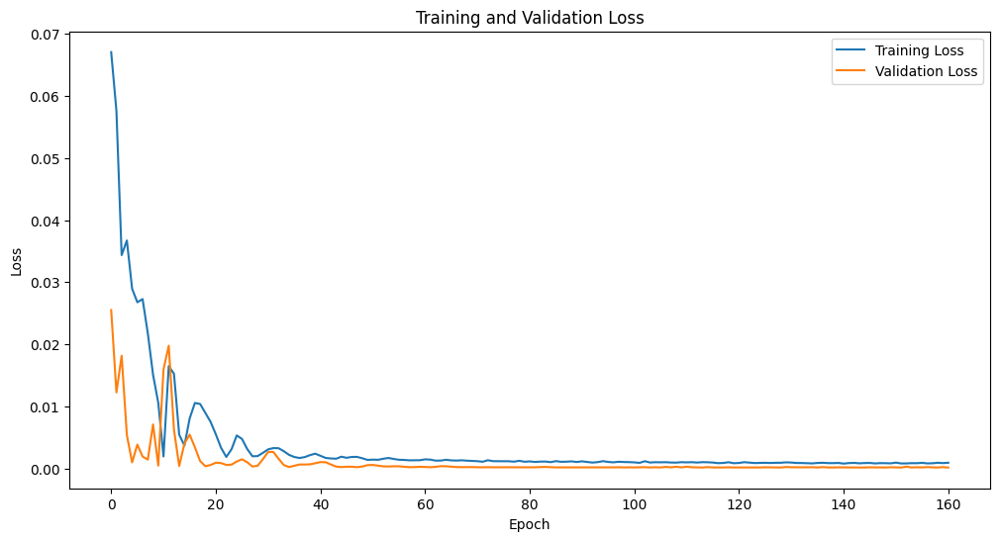

Epoch [1/2500], Train Loss: 0.0554, Val Loss: 0.1123
Epoch [2/2500], Train Loss: 0.1304, Val Loss: 0.0160
Epoch [3/2500], Train Loss: 0.0346, Val Loss: 0.0349
Epoch [4/2500], Train Loss: 0.0457, Val Loss: 0.0151
Epoch [5/2500], Train Loss: 0.0358, Val Loss: 0.0030
Epoch [6/2500], Train Loss: 0.0298, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0297, Val Loss: 0.0026
Epoch [8/2500], Train Loss: 0.0308, Val Loss: 0.0021
Epoch [9/2500], Train Loss: 0.0293, Val Loss: 0.0010
Epoch [10/2500], Train Loss: 0.0266, Val Loss: 0.0011
Epoch [11/2500], Train Loss: 0.0244, Val Loss: 0.0016
Epoch [12/2500], Train Loss: 0.0221, Val Loss: 0.0011
Epoch [13/2500], Train Loss: 0.0179, Val Loss: 0.0006
Epoch [14/2500], Train Loss: 0.0121, Val Loss: 0.0039
Epoch [15/2500], Train Loss: 0.0068, Val Loss: 0.0009
Epoch [16/2500], Train Loss: 0.0019, Val Loss: 0.0133
Epoch [17/2500], Train Loss: 0.0100, Val Loss: 0.0016
Epoch [18/2500], Train Loss: 0.0101, Val Loss: 0.0019
Epoch [19/2500], Train Loss: 0.0043, 

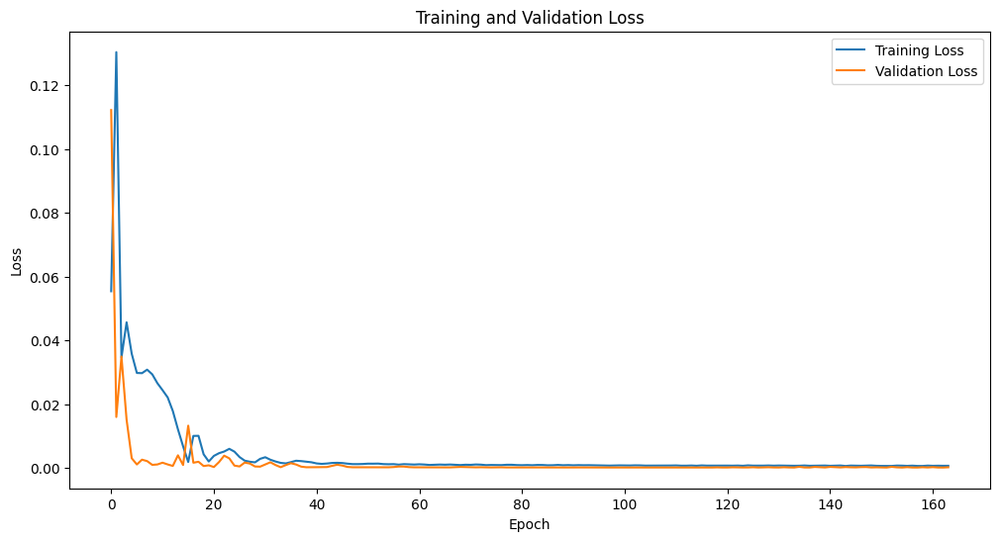

Epoch [1/2500], Train Loss: 0.0855, Val Loss: 0.0587
Epoch [2/2500], Train Loss: 0.0950, Val Loss: 0.0128
Epoch [3/2500], Train Loss: 0.0384, Val Loss: 0.0225
Epoch [4/2500], Train Loss: 0.0473, Val Loss: 0.0084
Epoch [5/2500], Train Loss: 0.0380, Val Loss: 0.0011
Epoch [6/2500], Train Loss: 0.0314, Val Loss: 0.0025
Epoch [7/2500], Train Loss: 0.0300, Val Loss: 0.0052
Epoch [8/2500], Train Loss: 0.0304, Val Loss: 0.0026
Epoch [9/2500], Train Loss: 0.0281, Val Loss: 0.0008
Epoch [10/2500], Train Loss: 0.0257, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0240, Val Loss: 0.0028
Epoch [12/2500], Train Loss: 0.0210, Val Loss: 0.0005
Epoch [13/2500], Train Loss: 0.0150, Val Loss: 0.0061
Epoch [14/2500], Train Loss: 0.0112, Val Loss: 0.0005
Epoch [15/2500], Train Loss: 0.0044, Val Loss: 0.0212
Epoch [16/2500], Train Loss: 0.0104, Val Loss: 0.0124
Epoch [17/2500], Train Loss: 0.0138, Val Loss: 0.0005
Epoch [18/2500], Train Loss: 0.0059, Val Loss: 0.0050
Epoch [19/2500], Train Loss: 0.0054, 

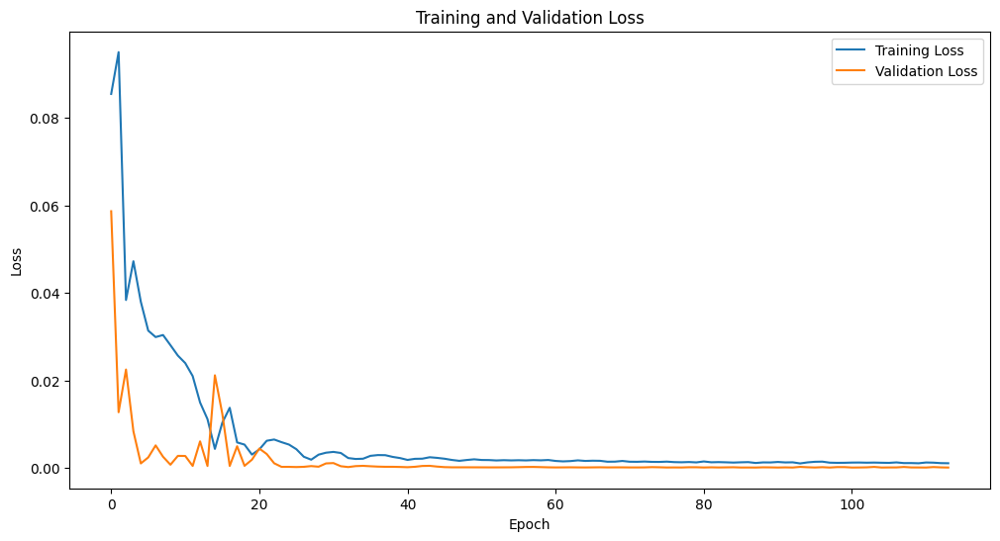

Epoch [1/2500], Train Loss: 0.0848, Val Loss: 0.0820
Epoch [2/2500], Train Loss: 0.1296, Val Loss: 0.0704
Epoch [3/2500], Train Loss: 0.0795, Val Loss: 0.0156
Epoch [4/2500], Train Loss: 0.0394, Val Loss: 0.0090
Epoch [5/2500], Train Loss: 0.0344, Val Loss: 0.0032
Epoch [6/2500], Train Loss: 0.0326, Val Loss: 0.0018
Epoch [7/2500], Train Loss: 0.0354, Val Loss: 0.0146
Epoch [8/2500], Train Loss: 0.0369, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0326, Val Loss: 0.0015
Epoch [10/2500], Train Loss: 0.0332, Val Loss: 0.0039
Epoch [11/2500], Train Loss: 0.0308, Val Loss: 0.0071
Epoch [12/2500], Train Loss: 0.0315, Val Loss: 0.0058
Epoch [13/2500], Train Loss: 0.0288, Val Loss: 0.0036
Epoch [14/2500], Train Loss: 0.0247, Val Loss: 0.0041
Epoch [15/2500], Train Loss: 0.0207, Val Loss: 0.0291
Epoch [16/2500], Train Loss: 0.0136, Val Loss: 0.0658
Epoch [17/2500], Train Loss: 0.0119, Val Loss: 0.0282
Epoch [18/2500], Train Loss: 0.0133, Val Loss: 0.0168
Epoch [19/2500], Train Loss: 0.0054, 

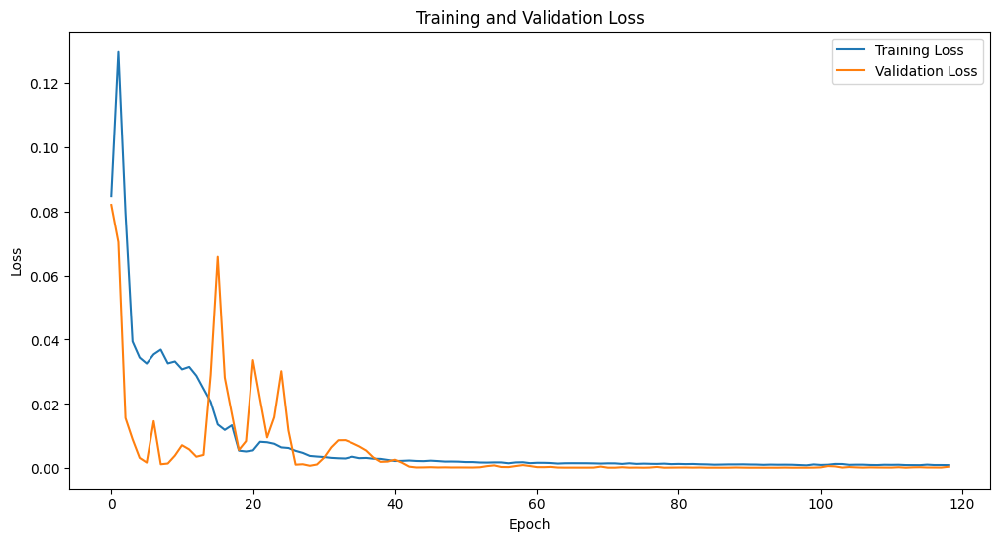

Epoch [1/2500], Train Loss: 0.0617, Val Loss: 0.0735
Epoch [2/2500], Train Loss: 0.1228, Val Loss: 0.0269
Epoch [3/2500], Train Loss: 0.0465, Val Loss: 0.0032
Epoch [4/2500], Train Loss: 0.0309, Val Loss: 0.0011
Epoch [5/2500], Train Loss: 0.0310, Val Loss: 0.0160
Epoch [6/2500], Train Loss: 0.0359, Val Loss: 0.0038
Epoch [7/2500], Train Loss: 0.0317, Val Loss: 0.0031
Epoch [8/2500], Train Loss: 0.0261, Val Loss: 0.0046
Epoch [9/2500], Train Loss: 0.0232, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0157, Val Loss: 0.0039
Epoch [11/2500], Train Loss: 0.0047, Val Loss: 0.0122
Epoch [12/2500], Train Loss: 0.0090, Val Loss: 0.0131
Epoch [13/2500], Train Loss: 0.0119, Val Loss: 0.0184
Epoch [14/2500], Train Loss: 0.0100, Val Loss: 0.0061
Epoch [15/2500], Train Loss: 0.0101, Val Loss: 0.0046
Epoch [16/2500], Train Loss: 0.0068, Val Loss: 0.0314
Epoch [17/2500], Train Loss: 0.0130, Val Loss: 0.0099
Epoch [18/2500], Train Loss: 0.0070, Val Loss: 0.0006
Epoch [19/2500], Train Loss: 0.0061, 

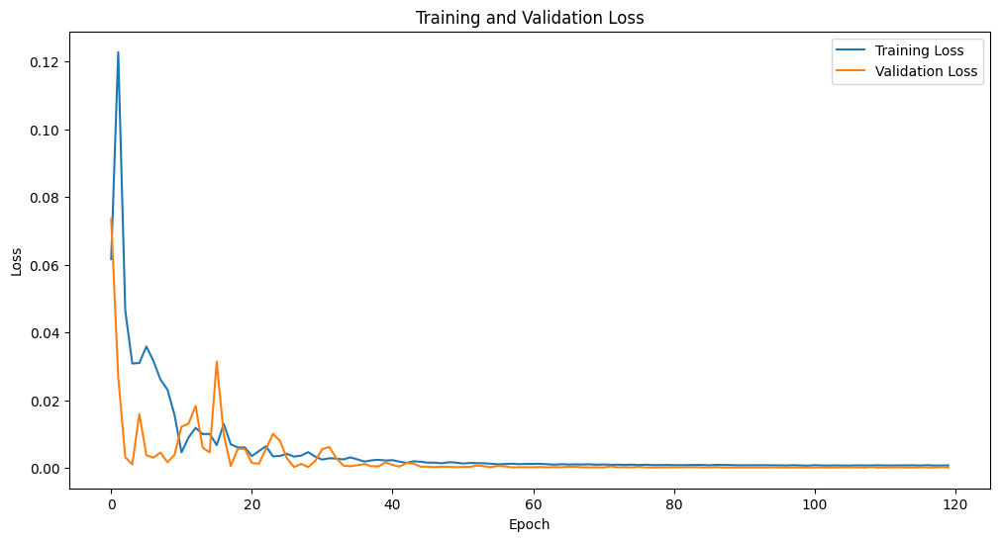

Epoch [1/2500], Train Loss: 0.0672, Val Loss: 0.2585
Epoch [2/2500], Train Loss: 0.2957, Val Loss: 0.0380
Epoch [3/2500], Train Loss: 0.0552, Val Loss: 0.0288
Epoch [4/2500], Train Loss: 0.0519, Val Loss: 0.0069
Epoch [5/2500], Train Loss: 0.0357, Val Loss: 0.0029
Epoch [6/2500], Train Loss: 0.0345, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0336, Val Loss: 0.0097
Epoch [8/2500], Train Loss: 0.0373, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0332, Val Loss: 0.0024
Epoch [10/2500], Train Loss: 0.0340, Val Loss: 0.0012
Epoch [11/2500], Train Loss: 0.0320, Val Loss: 0.0030
Epoch [12/2500], Train Loss: 0.0310, Val Loss: 0.0039
Epoch [13/2500], Train Loss: 0.0313, Val Loss: 0.0017
Epoch [14/2500], Train Loss: 0.0293, Val Loss: 0.0010
Epoch [15/2500], Train Loss: 0.0268, Val Loss: 0.0036
Epoch [16/2500], Train Loss: 0.0224, Val Loss: 0.0176
Epoch [17/2500], Train Loss: 0.0190, Val Loss: 0.0019
Epoch [18/2500], Train Loss: 0.0127, Val Loss: 0.0269
Epoch [19/2500], Train Loss: 0.0070, 

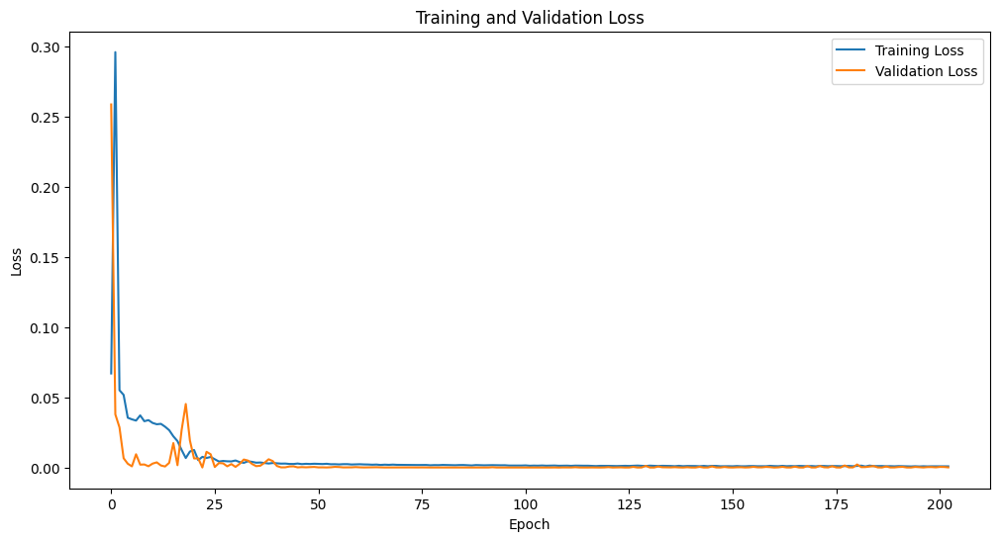

Epoch [1/2500], Train Loss: 0.1019, Val Loss: 0.0310
Epoch [2/2500], Train Loss: 0.0753, Val Loss: 0.0506
Epoch [3/2500], Train Loss: 0.0659, Val Loss: 0.0064
Epoch [4/2500], Train Loss: 0.0332, Val Loss: 0.0014
Epoch [5/2500], Train Loss: 0.0350, Val Loss: 0.0893
Epoch [6/2500], Train Loss: 0.0905, Val Loss: 0.0021
Epoch [7/2500], Train Loss: 0.0359, Val Loss: 0.0012
Epoch [8/2500], Train Loss: 0.0335, Val Loss: 0.0080
Epoch [9/2500], Train Loss: 0.0341, Val Loss: 0.0047
Epoch [10/2500], Train Loss: 0.0324, Val Loss: 0.0019
Epoch [11/2500], Train Loss: 0.0318, Val Loss: 0.0022
Epoch [12/2500], Train Loss: 0.0328, Val Loss: 0.0037
Epoch [13/2500], Train Loss: 0.0331, Val Loss: 0.0035
Epoch [14/2500], Train Loss: 0.0324, Val Loss: 0.0016
Epoch [15/2500], Train Loss: 0.0315, Val Loss: 0.0011
Epoch [16/2500], Train Loss: 0.0311, Val Loss: 0.0019
Epoch [17/2500], Train Loss: 0.0282, Val Loss: 0.0041
Epoch [18/2500], Train Loss: 0.0242, Val Loss: 0.0047
Epoch [19/2500], Train Loss: 0.0192, 

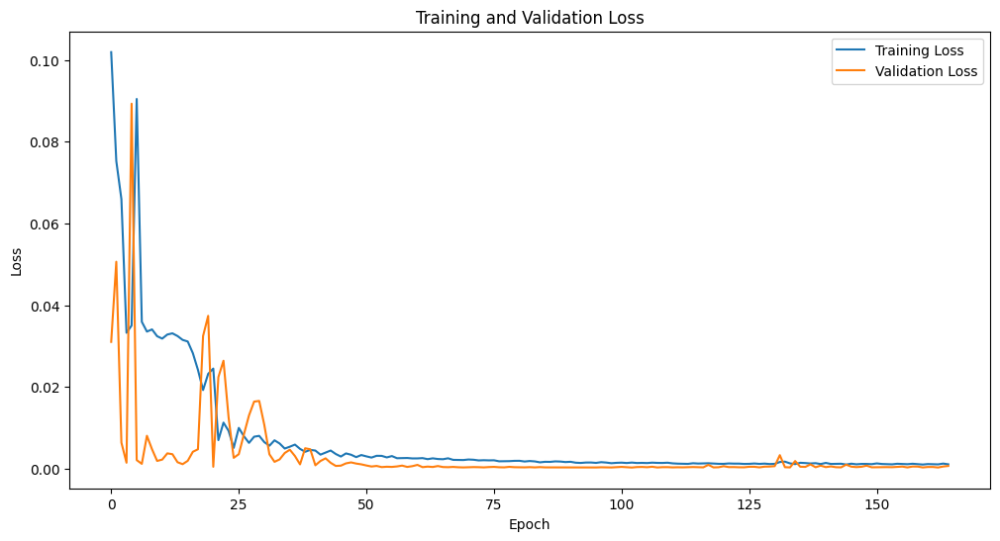

Epoch [1/2500], Train Loss: 0.1024, Val Loss: 0.2774
Epoch [2/2500], Train Loss: 0.3430, Val Loss: 0.0286
Epoch [3/2500], Train Loss: 0.0484, Val Loss: 0.0452
Epoch [4/2500], Train Loss: 0.0614, Val Loss: 0.0364
Epoch [5/2500], Train Loss: 0.0545, Val Loss: 0.0072
Epoch [6/2500], Train Loss: 0.0337, Val Loss: 0.0093
Epoch [7/2500], Train Loss: 0.0468, Val Loss: 0.0042
Epoch [8/2500], Train Loss: 0.0328, Val Loss: 0.0215
Epoch [9/2500], Train Loss: 0.0434, Val Loss: 0.0032
Epoch [10/2500], Train Loss: 0.0322, Val Loss: 0.0026
Epoch [11/2500], Train Loss: 0.0374, Val Loss: 0.0016
Epoch [12/2500], Train Loss: 0.0355, Val Loss: 0.0032
Epoch [13/2500], Train Loss: 0.0318, Val Loss: 0.0097
Epoch [14/2500], Train Loss: 0.0352, Val Loss: 0.0105
Epoch [15/2500], Train Loss: 0.0350, Val Loss: 0.0088
Epoch [16/2500], Train Loss: 0.0325, Val Loss: 0.0106
Epoch [17/2500], Train Loss: 0.0308, Val Loss: 0.0598
Epoch [18/2500], Train Loss: 0.0385, Val Loss: 0.0039
Epoch [19/2500], Train Loss: 0.0409, 

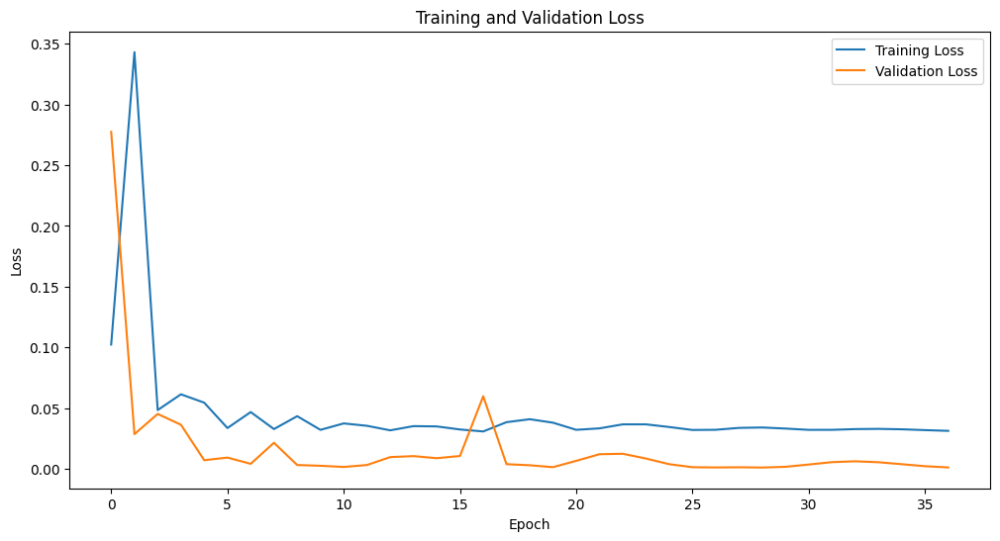

Epoch [1/2500], Train Loss: 0.0704, Val Loss: 0.0613
Epoch [2/2500], Train Loss: 0.1062, Val Loss: 0.0324
Epoch [3/2500], Train Loss: 0.0510, Val Loss: 0.0122
Epoch [4/2500], Train Loss: 0.0368, Val Loss: 0.0041
Epoch [5/2500], Train Loss: 0.0334, Val Loss: 0.0011
Epoch [6/2500], Train Loss: 0.0338, Val Loss: 0.0126
Epoch [7/2500], Train Loss: 0.0371, Val Loss: 0.0018
Epoch [8/2500], Train Loss: 0.0362, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0332, Val Loss: 0.0052
Epoch [10/2500], Train Loss: 0.0334, Val Loss: 0.0062
Epoch [11/2500], Train Loss: 0.0342, Val Loss: 0.0029
Epoch [12/2500], Train Loss: 0.0325, Val Loss: 0.0014
Epoch [13/2500], Train Loss: 0.0325, Val Loss: 0.0014
Epoch [14/2500], Train Loss: 0.0325, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0321, Val Loss: 0.0042
Epoch [16/2500], Train Loss: 0.0325, Val Loss: 0.0045
Epoch [17/2500], Train Loss: 0.0321, Val Loss: 0.0032
Epoch [18/2500], Train Loss: 0.0314, Val Loss: 0.0015
Epoch [19/2500], Train Loss: 0.0308, 

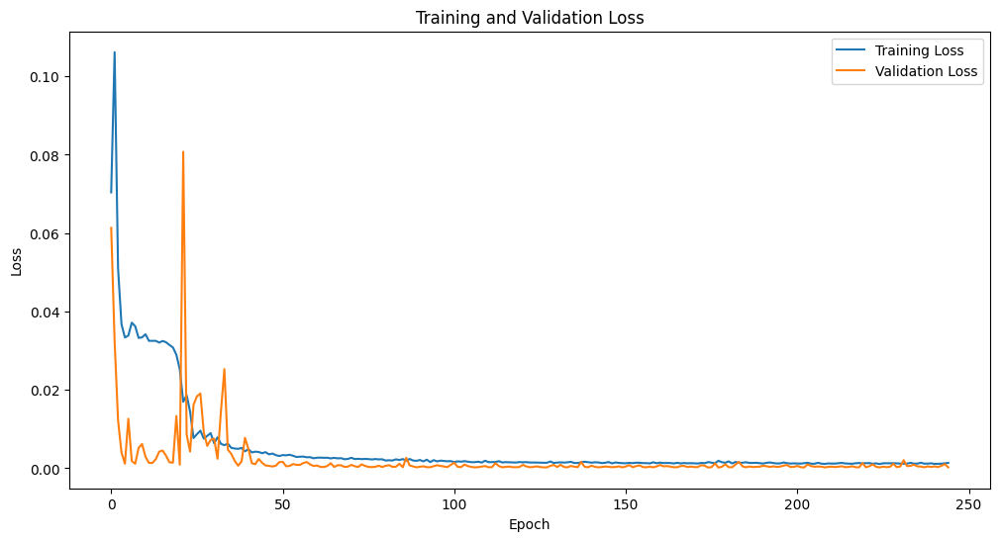

Epoch [1/2500], Train Loss: 0.0914, Val Loss: 0.0177
Epoch [2/2500], Train Loss: 0.0590, Val Loss: 0.0414
Epoch [3/2500], Train Loss: 0.0577, Val Loss: 0.0023
Epoch [4/2500], Train Loss: 0.0322, Val Loss: 0.0306
Epoch [5/2500], Train Loss: 0.0479, Val Loss: 0.0068
Epoch [6/2500], Train Loss: 0.0442, Val Loss: 0.0088
Epoch [7/2500], Train Loss: 0.0343, Val Loss: 0.0051
Epoch [8/2500], Train Loss: 0.0333, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0335, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0325, Val Loss: 0.0038
Epoch [11/2500], Train Loss: 0.0321, Val Loss: 0.0030
Epoch [12/2500], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [13/2500], Train Loss: 0.0329, Val Loss: 0.0044
Epoch [14/2500], Train Loss: 0.0332, Val Loss: 0.0027
Epoch [15/2500], Train Loss: 0.0323, Val Loss: 0.0014
Epoch [16/2500], Train Loss: 0.0313, Val Loss: 0.0029
Epoch [17/2500], Train Loss: 0.0313, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0304, Val Loss: 0.0010
Epoch [19/2500], Train Loss: 0.0277, 

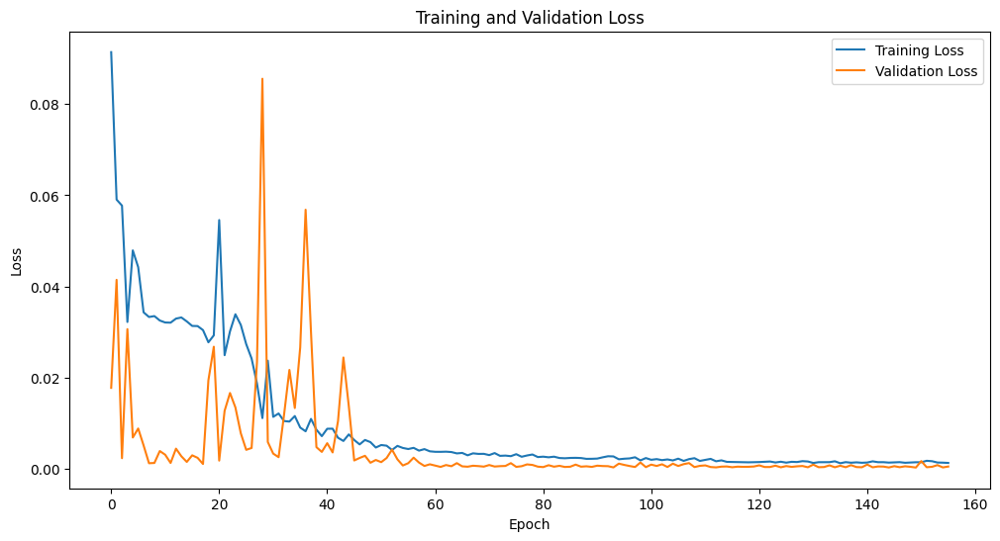

Epoch [1/2500], Train Loss: 0.0948, Val Loss: 0.0651
Epoch [2/2500], Train Loss: 0.1151, Val Loss: 0.0498
Epoch [3/2500], Train Loss: 0.0653, Val Loss: 0.0149
Epoch [4/2500], Train Loss: 0.0382, Val Loss: 0.0012
Epoch [5/2500], Train Loss: 0.0338, Val Loss: 0.0182
Epoch [6/2500], Train Loss: 0.0406, Val Loss: 0.0022
Epoch [7/2500], Train Loss: 0.0369, Val Loss: 0.0017
Epoch [8/2500], Train Loss: 0.0320, Val Loss: 0.0098
Epoch [9/2500], Train Loss: 0.0350, Val Loss: 0.0079
Epoch [10/2500], Train Loss: 0.0340, Val Loss: 0.0019
Epoch [11/2500], Train Loss: 0.0322, Val Loss: 0.0012
Epoch [12/2500], Train Loss: 0.0340, Val Loss: 0.0012
Epoch [13/2500], Train Loss: 0.0331, Val Loss: 0.0027
Epoch [14/2500], Train Loss: 0.0319, Val Loss: 0.0055
Epoch [15/2500], Train Loss: 0.0327, Val Loss: 0.0061
Epoch [16/2500], Train Loss: 0.0330, Val Loss: 0.0044
Epoch [17/2500], Train Loss: 0.0324, Val Loss: 0.0025
Epoch [18/2500], Train Loss: 0.0318, Val Loss: 0.0015
Epoch [19/2500], Train Loss: 0.0321, 

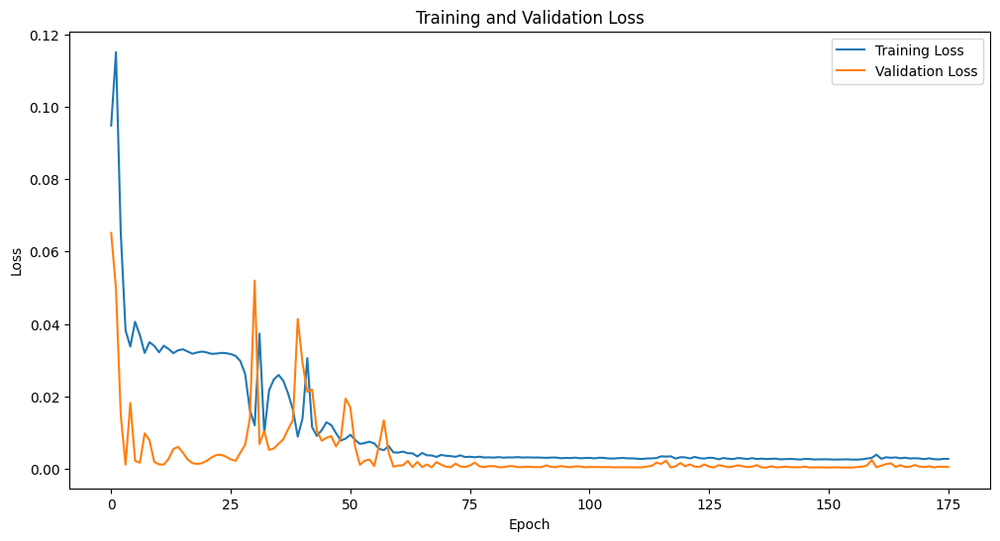

Epoch [1/2500], Train Loss: 0.0589, Val Loss: 0.0605
Epoch [2/2500], Train Loss: 0.1058, Val Loss: 0.0406
Epoch [3/2500], Train Loss: 0.0586, Val Loss: 0.0030
Epoch [4/2500], Train Loss: 0.0327, Val Loss: 0.0067
Epoch [5/2500], Train Loss: 0.0351, Val Loss: 0.0032
Epoch [6/2500], Train Loss: 0.0377, Val Loss: 0.0341
Epoch [7/2500], Train Loss: 0.0517, Val Loss: 0.0014
Epoch [8/2500], Train Loss: 0.0325, Val Loss: 0.0042
Epoch [9/2500], Train Loss: 0.0395, Val Loss: 0.0021
Epoch [10/2500], Train Loss: 0.0328, Val Loss: 0.0117
Epoch [11/2500], Train Loss: 0.0365, Val Loss: 0.0083
Epoch [12/2500], Train Loss: 0.0350, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0012
Epoch [14/2500], Train Loss: 0.0332, Val Loss: 0.0011
Epoch [15/2500], Train Loss: 0.0335, Val Loss: 0.0015
Epoch [16/2500], Train Loss: 0.0320, Val Loss: 0.0030
Epoch [17/2500], Train Loss: 0.0320, Val Loss: 0.0046
Epoch [18/2500], Train Loss: 0.0326, Val Loss: 0.0050
Epoch [19/2500], Train Loss: 0.0326, 

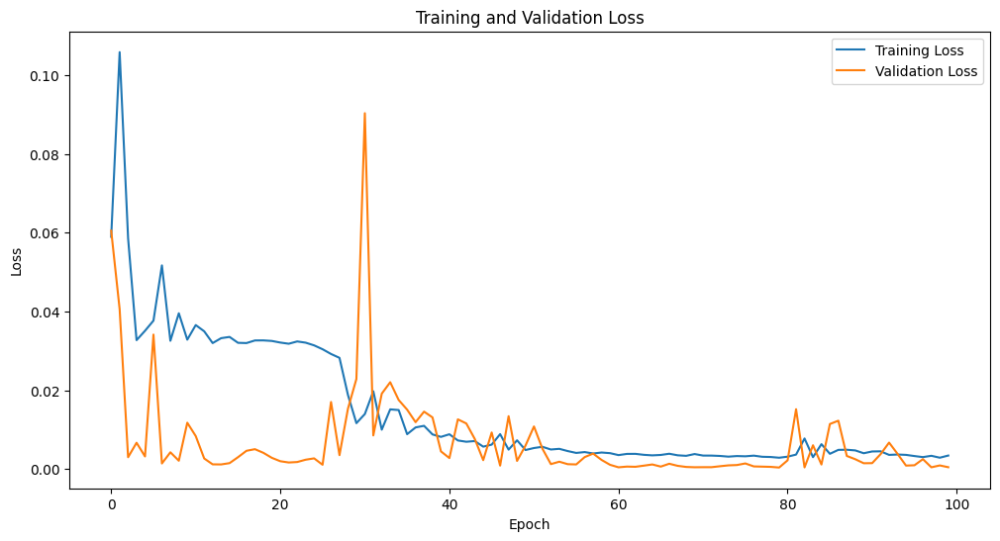

Epoch [1/2500], Train Loss: 0.1535, Val Loss: 0.1512
Epoch [2/2500], Train Loss: 0.1525, Val Loss: 0.1502
Epoch [3/2500], Train Loss: 0.1516, Val Loss: 0.1493
Epoch [4/2500], Train Loss: 0.1509, Val Loss: 0.1484
Epoch [5/2500], Train Loss: 0.1505, Val Loss: 0.1474
Epoch [6/2500], Train Loss: 0.1497, Val Loss: 0.1465
Epoch [7/2500], Train Loss: 0.1486, Val Loss: 0.1456
Epoch [8/2500], Train Loss: 0.1482, Val Loss: 0.1447
Epoch [9/2500], Train Loss: 0.1475, Val Loss: 0.1437
Epoch [10/2500], Train Loss: 0.1461, Val Loss: 0.1428
Epoch [11/2500], Train Loss: 0.1452, Val Loss: 0.1419
Epoch [12/2500], Train Loss: 0.1447, Val Loss: 0.1410
Epoch [13/2500], Train Loss: 0.1440, Val Loss: 0.1401
Epoch [14/2500], Train Loss: 0.1434, Val Loss: 0.1392
Epoch [15/2500], Train Loss: 0.1428, Val Loss: 0.1383
Epoch [16/2500], Train Loss: 0.1421, Val Loss: 0.1374
Epoch [17/2500], Train Loss: 0.1414, Val Loss: 0.1365
Epoch [18/2500], Train Loss: 0.1405, Val Loss: 0.1356
Epoch [19/2500], Train Loss: 0.1402, 

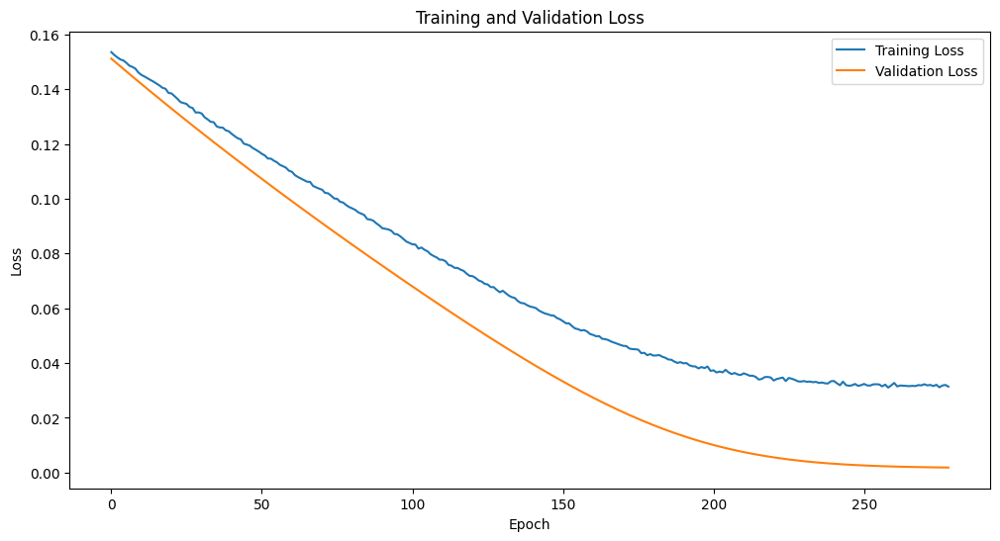

Epoch [1/2500], Train Loss: 0.1318, Val Loss: 0.1288
Epoch [2/2500], Train Loss: 0.1307, Val Loss: 0.1276
Epoch [3/2500], Train Loss: 0.1297, Val Loss: 0.1265
Epoch [4/2500], Train Loss: 0.1290, Val Loss: 0.1253
Epoch [5/2500], Train Loss: 0.1278, Val Loss: 0.1241
Epoch [6/2500], Train Loss: 0.1270, Val Loss: 0.1230
Epoch [7/2500], Train Loss: 0.1258, Val Loss: 0.1218
Epoch [8/2500], Train Loss: 0.1249, Val Loss: 0.1207
Epoch [9/2500], Train Loss: 0.1243, Val Loss: 0.1196
Epoch [10/2500], Train Loss: 0.1234, Val Loss: 0.1184
Epoch [11/2500], Train Loss: 0.1221, Val Loss: 0.1173
Epoch [12/2500], Train Loss: 0.1214, Val Loss: 0.1162
Epoch [13/2500], Train Loss: 0.1201, Val Loss: 0.1151
Epoch [14/2500], Train Loss: 0.1189, Val Loss: 0.1140
Epoch [15/2500], Train Loss: 0.1183, Val Loss: 0.1129
Epoch [16/2500], Train Loss: 0.1176, Val Loss: 0.1118
Epoch [17/2500], Train Loss: 0.1168, Val Loss: 0.1107
Epoch [18/2500], Train Loss: 0.1156, Val Loss: 0.1096
Epoch [19/2500], Train Loss: 0.1148, 

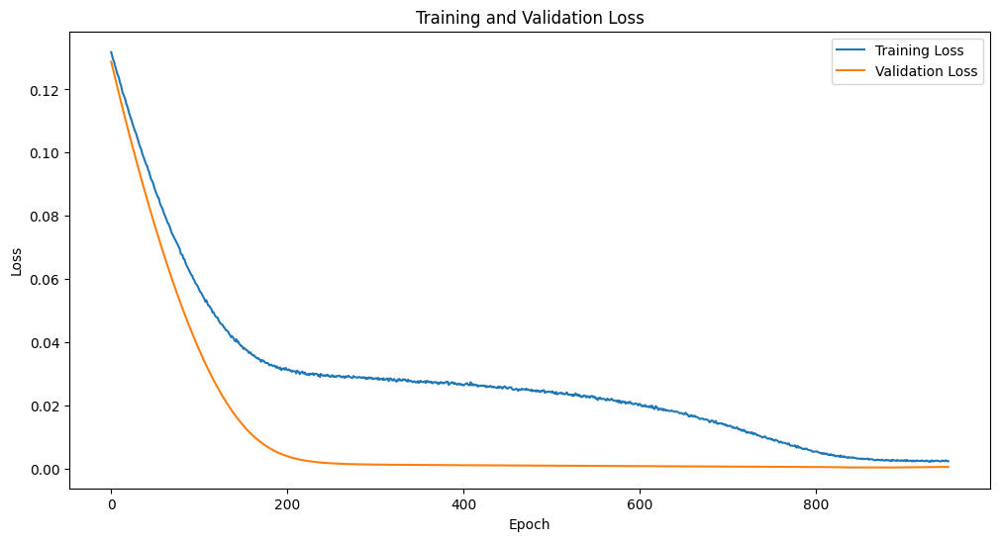

Epoch [1/2500], Train Loss: 0.0852, Val Loss: 0.0768
Epoch [2/2500], Train Loss: 0.0850, Val Loss: 0.0757
Epoch [3/2500], Train Loss: 0.0832, Val Loss: 0.0745
Epoch [4/2500], Train Loss: 0.0837, Val Loss: 0.0735
Epoch [5/2500], Train Loss: 0.0830, Val Loss: 0.0724
Epoch [6/2500], Train Loss: 0.0810, Val Loss: 0.0713
Epoch [7/2500], Train Loss: 0.0808, Val Loss: 0.0702
Epoch [8/2500], Train Loss: 0.0812, Val Loss: 0.0692
Epoch [9/2500], Train Loss: 0.0797, Val Loss: 0.0681
Epoch [10/2500], Train Loss: 0.0785, Val Loss: 0.0671
Epoch [11/2500], Train Loss: 0.0781, Val Loss: 0.0660
Epoch [12/2500], Train Loss: 0.0780, Val Loss: 0.0650
Epoch [13/2500], Train Loss: 0.0758, Val Loss: 0.0640
Epoch [14/2500], Train Loss: 0.0756, Val Loss: 0.0629
Epoch [15/2500], Train Loss: 0.0744, Val Loss: 0.0619
Epoch [16/2500], Train Loss: 0.0742, Val Loss: 0.0609
Epoch [17/2500], Train Loss: 0.0733, Val Loss: 0.0600
Epoch [18/2500], Train Loss: 0.0738, Val Loss: 0.0590
Epoch [19/2500], Train Loss: 0.0716, 

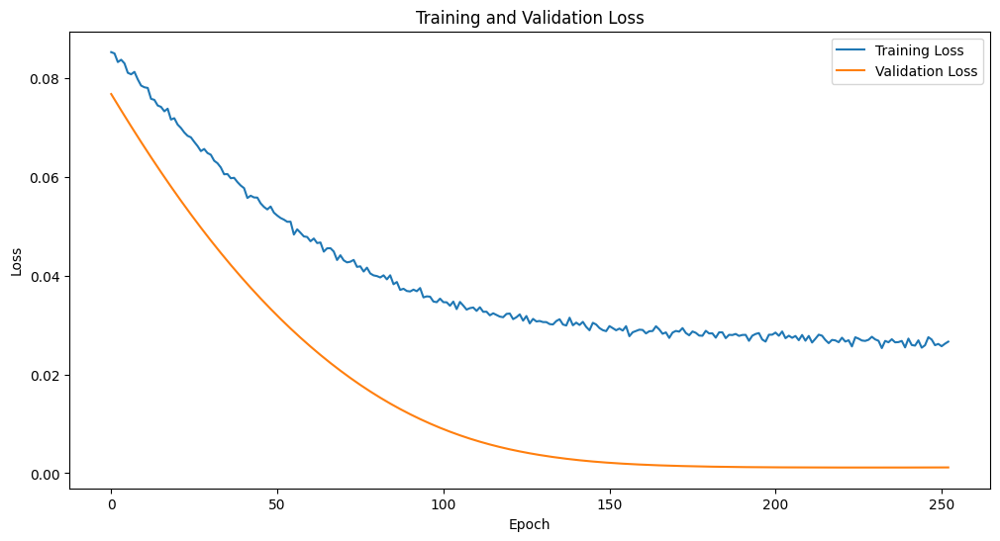

Epoch [1/2500], Train Loss: 0.0630, Val Loss: 0.0456
Epoch [2/2500], Train Loss: 0.0630, Val Loss: 0.0448
Epoch [3/2500], Train Loss: 0.0621, Val Loss: 0.0440
Epoch [4/2500], Train Loss: 0.0607, Val Loss: 0.0431
Epoch [5/2500], Train Loss: 0.0602, Val Loss: 0.0423
Epoch [6/2500], Train Loss: 0.0597, Val Loss: 0.0415
Epoch [7/2500], Train Loss: 0.0585, Val Loss: 0.0407
Epoch [8/2500], Train Loss: 0.0588, Val Loss: 0.0400
Epoch [9/2500], Train Loss: 0.0572, Val Loss: 0.0392
Epoch [10/2500], Train Loss: 0.0572, Val Loss: 0.0384
Epoch [11/2500], Train Loss: 0.0568, Val Loss: 0.0377
Epoch [12/2500], Train Loss: 0.0560, Val Loss: 0.0370
Epoch [13/2500], Train Loss: 0.0559, Val Loss: 0.0362
Epoch [14/2500], Train Loss: 0.0542, Val Loss: 0.0355
Epoch [15/2500], Train Loss: 0.0547, Val Loss: 0.0348
Epoch [16/2500], Train Loss: 0.0536, Val Loss: 0.0341
Epoch [17/2500], Train Loss: 0.0533, Val Loss: 0.0334
Epoch [18/2500], Train Loss: 0.0533, Val Loss: 0.0327
Epoch [19/2500], Train Loss: 0.0520, 

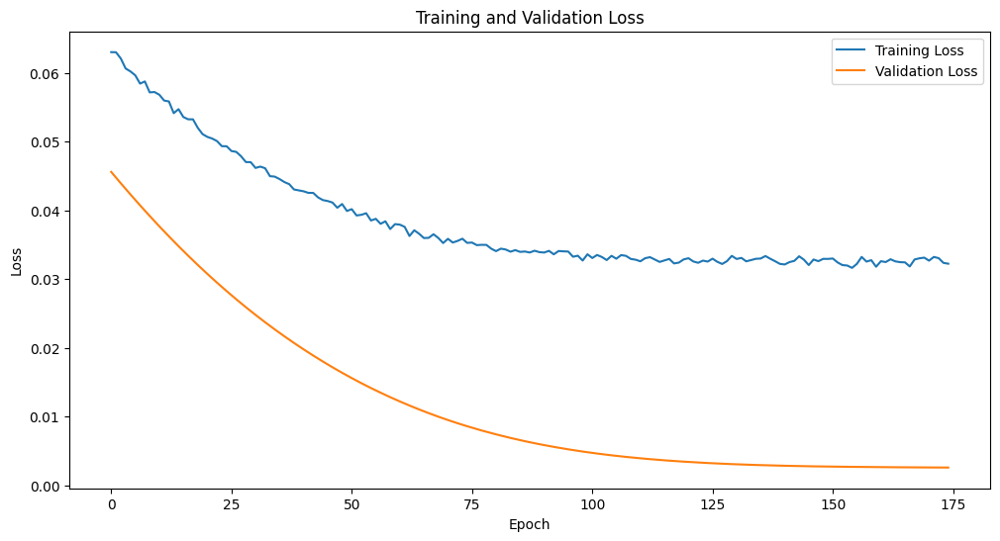

Epoch [1/2500], Train Loss: 0.1222, Val Loss: 0.1157
Epoch [2/2500], Train Loss: 0.1220, Val Loss: 0.1141
Epoch [3/2500], Train Loss: 0.1200, Val Loss: 0.1126
Epoch [4/2500], Train Loss: 0.1191, Val Loss: 0.1110
Epoch [5/2500], Train Loss: 0.1177, Val Loss: 0.1095
Epoch [6/2500], Train Loss: 0.1166, Val Loss: 0.1080
Epoch [7/2500], Train Loss: 0.1146, Val Loss: 0.1065
Epoch [8/2500], Train Loss: 0.1140, Val Loss: 0.1050
Epoch [9/2500], Train Loss: 0.1123, Val Loss: 0.1035
Epoch [10/2500], Train Loss: 0.1106, Val Loss: 0.1021
Epoch [11/2500], Train Loss: 0.1100, Val Loss: 0.1006
Epoch [12/2500], Train Loss: 0.1088, Val Loss: 0.0992
Epoch [13/2500], Train Loss: 0.1074, Val Loss: 0.0978
Epoch [14/2500], Train Loss: 0.1066, Val Loss: 0.0963
Epoch [15/2500], Train Loss: 0.1048, Val Loss: 0.0949
Epoch [16/2500], Train Loss: 0.1038, Val Loss: 0.0935
Epoch [17/2500], Train Loss: 0.1027, Val Loss: 0.0922
Epoch [18/2500], Train Loss: 0.1015, Val Loss: 0.0908
Epoch [19/2500], Train Loss: 0.1007, 

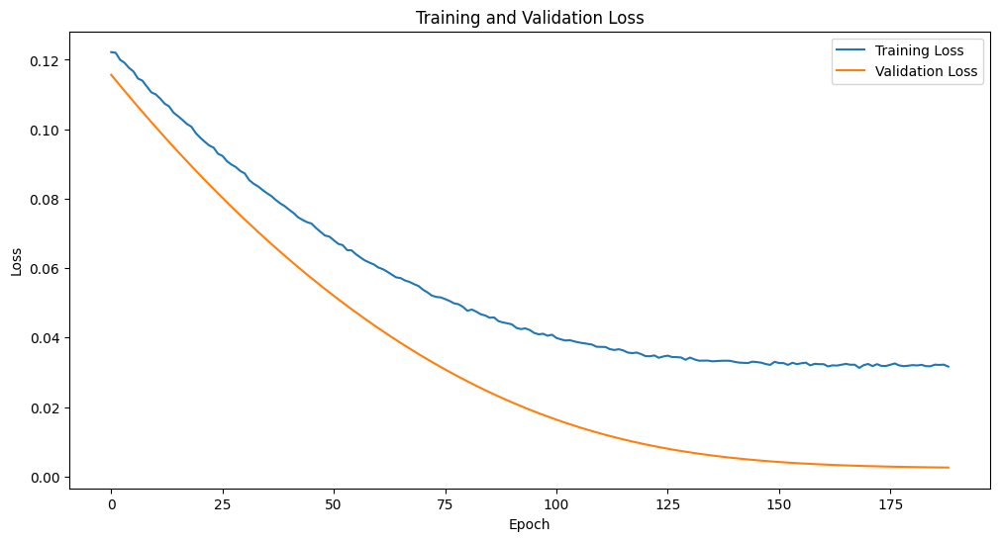

Epoch [1/2500], Train Loss: 0.0715, Val Loss: 0.0565
Epoch [2/2500], Train Loss: 0.0708, Val Loss: 0.0557
Epoch [3/2500], Train Loss: 0.0699, Val Loss: 0.0550
Epoch [4/2500], Train Loss: 0.0692, Val Loss: 0.0542
Epoch [5/2500], Train Loss: 0.0692, Val Loss: 0.0535
Epoch [6/2500], Train Loss: 0.0684, Val Loss: 0.0528
Epoch [7/2500], Train Loss: 0.0678, Val Loss: 0.0521
Epoch [8/2500], Train Loss: 0.0668, Val Loss: 0.0514
Epoch [9/2500], Train Loss: 0.0670, Val Loss: 0.0507
Epoch [10/2500], Train Loss: 0.0662, Val Loss: 0.0500
Epoch [11/2500], Train Loss: 0.0653, Val Loss: 0.0493
Epoch [12/2500], Train Loss: 0.0654, Val Loss: 0.0486
Epoch [13/2500], Train Loss: 0.0646, Val Loss: 0.0479
Epoch [14/2500], Train Loss: 0.0637, Val Loss: 0.0472
Epoch [15/2500], Train Loss: 0.0637, Val Loss: 0.0466
Epoch [16/2500], Train Loss: 0.0629, Val Loss: 0.0459
Epoch [17/2500], Train Loss: 0.0625, Val Loss: 0.0452
Epoch [18/2500], Train Loss: 0.0620, Val Loss: 0.0446
Epoch [19/2500], Train Loss: 0.0611, 

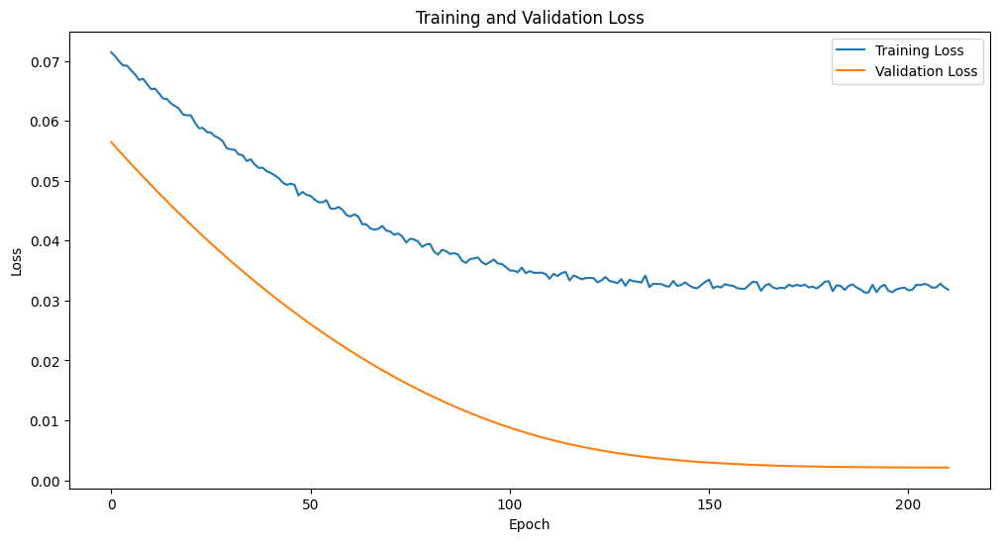

Epoch [1/2500], Train Loss: 0.0371, Val Loss: 0.0120
Epoch [2/2500], Train Loss: 0.0368, Val Loss: 0.0116
Epoch [3/2500], Train Loss: 0.0368, Val Loss: 0.0113
Epoch [4/2500], Train Loss: 0.0364, Val Loss: 0.0110
Epoch [5/2500], Train Loss: 0.0362, Val Loss: 0.0107
Epoch [6/2500], Train Loss: 0.0359, Val Loss: 0.0103
Epoch [7/2500], Train Loss: 0.0357, Val Loss: 0.0100
Epoch [8/2500], Train Loss: 0.0357, Val Loss: 0.0097
Epoch [9/2500], Train Loss: 0.0352, Val Loss: 0.0094
Epoch [10/2500], Train Loss: 0.0351, Val Loss: 0.0091
Epoch [11/2500], Train Loss: 0.0347, Val Loss: 0.0088
Epoch [12/2500], Train Loss: 0.0348, Val Loss: 0.0086
Epoch [13/2500], Train Loss: 0.0345, Val Loss: 0.0083
Epoch [14/2500], Train Loss: 0.0343, Val Loss: 0.0080
Epoch [15/2500], Train Loss: 0.0341, Val Loss: 0.0078
Epoch [16/2500], Train Loss: 0.0340, Val Loss: 0.0075
Epoch [17/2500], Train Loss: 0.0339, Val Loss: 0.0073
Epoch [18/2500], Train Loss: 0.0342, Val Loss: 0.0070
Epoch [19/2500], Train Loss: 0.0339, 

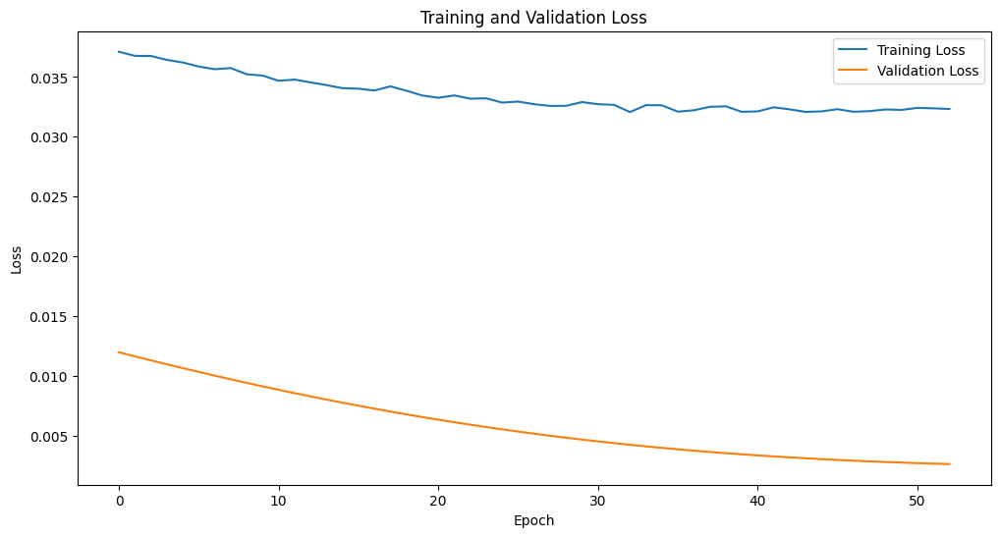

Epoch [1/2500], Train Loss: 0.0483, Val Loss: 0.0282
Epoch [2/2500], Train Loss: 0.0479, Val Loss: 0.0276
Epoch [3/2500], Train Loss: 0.0475, Val Loss: 0.0271
Epoch [4/2500], Train Loss: 0.0473, Val Loss: 0.0266
Epoch [5/2500], Train Loss: 0.0468, Val Loss: 0.0261
Epoch [6/2500], Train Loss: 0.0464, Val Loss: 0.0256
Epoch [7/2500], Train Loss: 0.0460, Val Loss: 0.0251
Epoch [8/2500], Train Loss: 0.0456, Val Loss: 0.0246
Epoch [9/2500], Train Loss: 0.0454, Val Loss: 0.0241
Epoch [10/2500], Train Loss: 0.0449, Val Loss: 0.0237
Epoch [11/2500], Train Loss: 0.0446, Val Loss: 0.0232
Epoch [12/2500], Train Loss: 0.0441, Val Loss: 0.0227
Epoch [13/2500], Train Loss: 0.0438, Val Loss: 0.0223
Epoch [14/2500], Train Loss: 0.0435, Val Loss: 0.0218
Epoch [15/2500], Train Loss: 0.0431, Val Loss: 0.0214
Epoch [16/2500], Train Loss: 0.0427, Val Loss: 0.0209
Epoch [17/2500], Train Loss: 0.0424, Val Loss: 0.0205
Epoch [18/2500], Train Loss: 0.0421, Val Loss: 0.0200
Epoch [19/2500], Train Loss: 0.0419, 

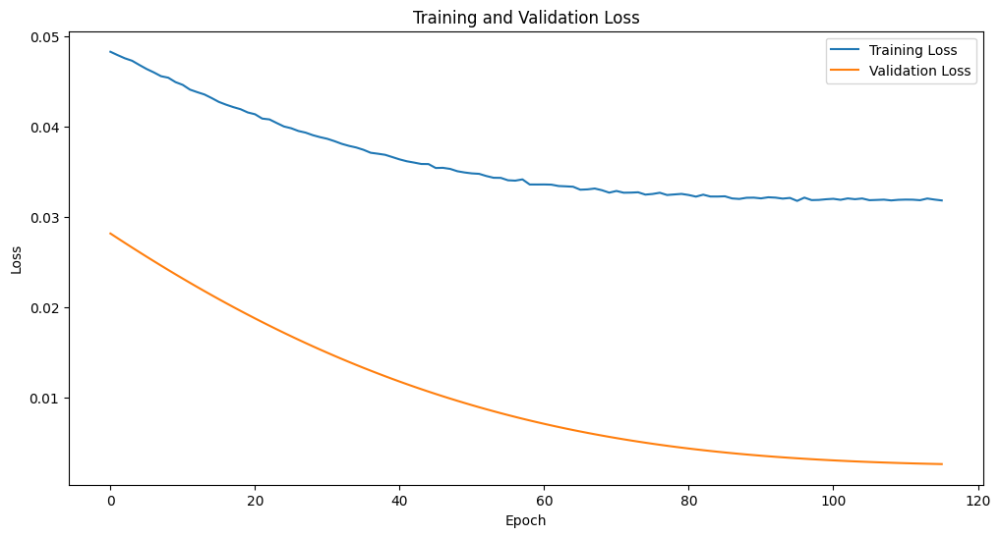

Epoch [1/2500], Train Loss: 0.1411, Val Loss: 0.1333
Epoch [2/2500], Train Loss: 0.1406, Val Loss: 0.1321
Epoch [3/2500], Train Loss: 0.1387, Val Loss: 0.1310
Epoch [4/2500], Train Loss: 0.1381, Val Loss: 0.1298
Epoch [5/2500], Train Loss: 0.1374, Val Loss: 0.1286
Epoch [6/2500], Train Loss: 0.1365, Val Loss: 0.1274
Epoch [7/2500], Train Loss: 0.1343, Val Loss: 0.1263
Epoch [8/2500], Train Loss: 0.1338, Val Loss: 0.1251
Epoch [9/2500], Train Loss: 0.1321, Val Loss: 0.1239
Epoch [10/2500], Train Loss: 0.1321, Val Loss: 0.1228
Epoch [11/2500], Train Loss: 0.1306, Val Loss: 0.1216
Epoch [12/2500], Train Loss: 0.1292, Val Loss: 0.1205
Epoch [13/2500], Train Loss: 0.1287, Val Loss: 0.1193
Epoch [14/2500], Train Loss: 0.1274, Val Loss: 0.1182
Epoch [15/2500], Train Loss: 0.1273, Val Loss: 0.1171
Epoch [16/2500], Train Loss: 0.1261, Val Loss: 0.1159
Epoch [17/2500], Train Loss: 0.1249, Val Loss: 0.1148
Epoch [18/2500], Train Loss: 0.1240, Val Loss: 0.1137
Epoch [19/2500], Train Loss: 0.1231, 

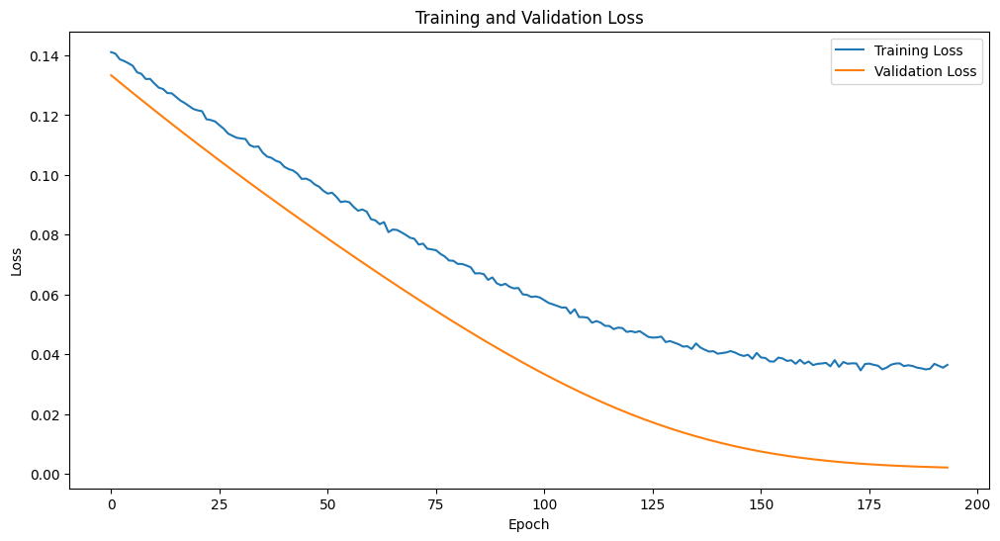

Epoch [1/2500], Train Loss: 0.0600, Val Loss: 0.0407
Epoch [2/2500], Train Loss: 0.0586, Val Loss: 0.0400
Epoch [3/2500], Train Loss: 0.0581, Val Loss: 0.0393
Epoch [4/2500], Train Loss: 0.0579, Val Loss: 0.0386
Epoch [5/2500], Train Loss: 0.0575, Val Loss: 0.0379
Epoch [6/2500], Train Loss: 0.0572, Val Loss: 0.0372
Epoch [7/2500], Train Loss: 0.0561, Val Loss: 0.0366
Epoch [8/2500], Train Loss: 0.0555, Val Loss: 0.0359
Epoch [9/2500], Train Loss: 0.0550, Val Loss: 0.0353
Epoch [10/2500], Train Loss: 0.0547, Val Loss: 0.0346
Epoch [11/2500], Train Loss: 0.0539, Val Loss: 0.0340
Epoch [12/2500], Train Loss: 0.0542, Val Loss: 0.0334
Epoch [13/2500], Train Loss: 0.0531, Val Loss: 0.0327
Epoch [14/2500], Train Loss: 0.0523, Val Loss: 0.0321
Epoch [15/2500], Train Loss: 0.0528, Val Loss: 0.0315
Epoch [16/2500], Train Loss: 0.0524, Val Loss: 0.0309
Epoch [17/2500], Train Loss: 0.0514, Val Loss: 0.0303
Epoch [18/2500], Train Loss: 0.0502, Val Loss: 0.0297
Epoch [19/2500], Train Loss: 0.0504, 

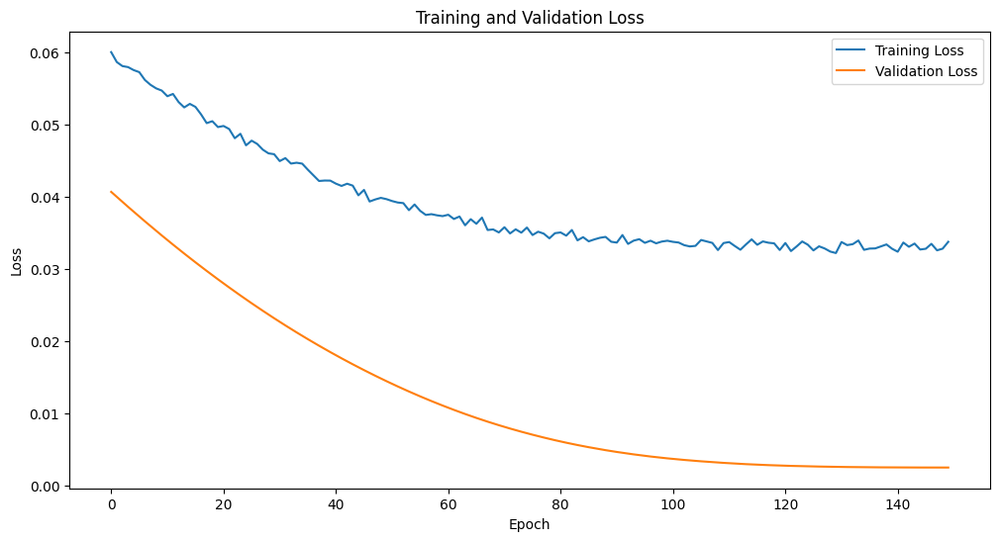

Epoch [1/2500], Train Loss: 0.0332, Val Loss: 0.0011
Epoch [2/2500], Train Loss: 0.0332, Val Loss: 0.0012
Epoch [3/2500], Train Loss: 0.0331, Val Loss: 0.0012
Epoch [4/2500], Train Loss: 0.0331, Val Loss: 0.0012
Epoch [5/2500], Train Loss: 0.0330, Val Loss: 0.0012
Epoch [6/2500], Train Loss: 0.0327, Val Loss: 0.0012
Epoch [7/2500], Train Loss: 0.0326, Val Loss: 0.0013
Epoch [8/2500], Train Loss: 0.0326, Val Loss: 0.0013
Epoch [9/2500], Train Loss: 0.0325, Val Loss: 0.0013
Epoch [10/2500], Train Loss: 0.0325, Val Loss: 0.0014
Epoch [11/2500], Train Loss: 0.0324, Val Loss: 0.0014
Epoch [12/2500], Train Loss: 0.0322, Val Loss: 0.0015
Epoch [13/2500], Train Loss: 0.0322, Val Loss: 0.0015
Epoch [14/2500], Train Loss: 0.0321, Val Loss: 0.0016
Epoch [15/2500], Train Loss: 0.0322, Val Loss: 0.0017
Epoch [16/2500], Train Loss: 0.0322, Val Loss: 0.0017
Epoch [17/2500], Train Loss: 0.0320, Val Loss: 0.0018
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0019
Epoch [19/2500], Train Loss: 0.0320, 

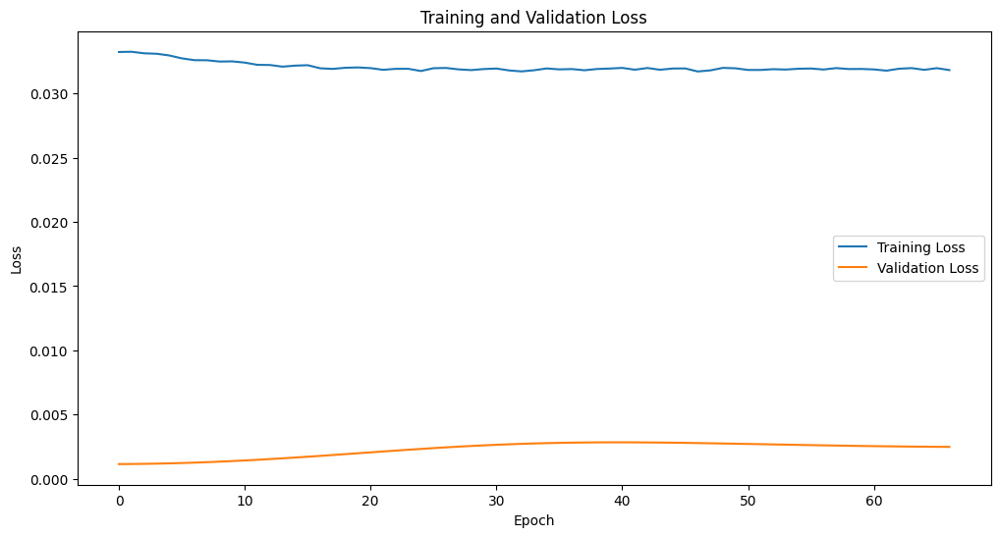

Epoch [1/2500], Train Loss: 0.0435, Val Loss: 0.0223
Epoch [2/2500], Train Loss: 0.0435, Val Loss: 0.0219
Epoch [3/2500], Train Loss: 0.0433, Val Loss: 0.0215
Epoch [4/2500], Train Loss: 0.0430, Val Loss: 0.0211
Epoch [5/2500], Train Loss: 0.0427, Val Loss: 0.0207
Epoch [6/2500], Train Loss: 0.0428, Val Loss: 0.0204
Epoch [7/2500], Train Loss: 0.0429, Val Loss: 0.0200
Epoch [8/2500], Train Loss: 0.0424, Val Loss: 0.0196
Epoch [9/2500], Train Loss: 0.0421, Val Loss: 0.0193
Epoch [10/2500], Train Loss: 0.0414, Val Loss: 0.0189
Epoch [11/2500], Train Loss: 0.0412, Val Loss: 0.0186
Epoch [12/2500], Train Loss: 0.0410, Val Loss: 0.0182
Epoch [13/2500], Train Loss: 0.0407, Val Loss: 0.0179
Epoch [14/2500], Train Loss: 0.0405, Val Loss: 0.0175
Epoch [15/2500], Train Loss: 0.0402, Val Loss: 0.0172
Epoch [16/2500], Train Loss: 0.0400, Val Loss: 0.0169
Epoch [17/2500], Train Loss: 0.0402, Val Loss: 0.0166
Epoch [18/2500], Train Loss: 0.0392, Val Loss: 0.0162
Epoch [19/2500], Train Loss: 0.0392, 

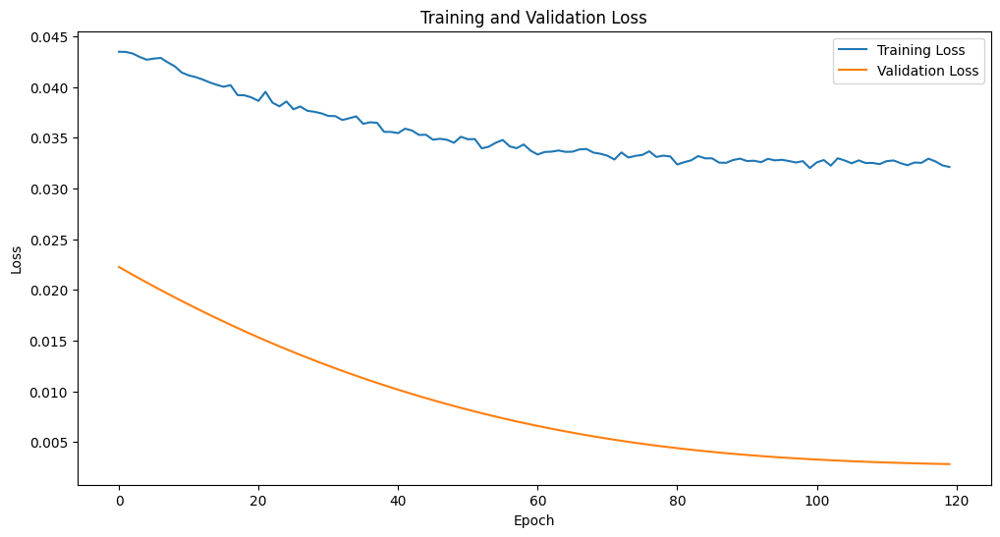

Epoch [1/2500], Train Loss: 0.0838, Val Loss: 0.0779
Epoch [2/2500], Train Loss: 0.0827, Val Loss: 0.0764
Epoch [3/2500], Train Loss: 0.0814, Val Loss: 0.0749
Epoch [4/2500], Train Loss: 0.0806, Val Loss: 0.0735
Epoch [5/2500], Train Loss: 0.0795, Val Loss: 0.0721
Epoch [6/2500], Train Loss: 0.0787, Val Loss: 0.0707
Epoch [7/2500], Train Loss: 0.0771, Val Loss: 0.0693
Epoch [8/2500], Train Loss: 0.0766, Val Loss: 0.0679
Epoch [9/2500], Train Loss: 0.0752, Val Loss: 0.0665
Epoch [10/2500], Train Loss: 0.0743, Val Loss: 0.0652
Epoch [11/2500], Train Loss: 0.0733, Val Loss: 0.0638
Epoch [12/2500], Train Loss: 0.0721, Val Loss: 0.0625
Epoch [13/2500], Train Loss: 0.0711, Val Loss: 0.0612
Epoch [14/2500], Train Loss: 0.0703, Val Loss: 0.0599
Epoch [15/2500], Train Loss: 0.0693, Val Loss: 0.0587
Epoch [16/2500], Train Loss: 0.0684, Val Loss: 0.0574
Epoch [17/2500], Train Loss: 0.0678, Val Loss: 0.0562
Epoch [18/2500], Train Loss: 0.0664, Val Loss: 0.0550
Epoch [19/2500], Train Loss: 0.0656, 

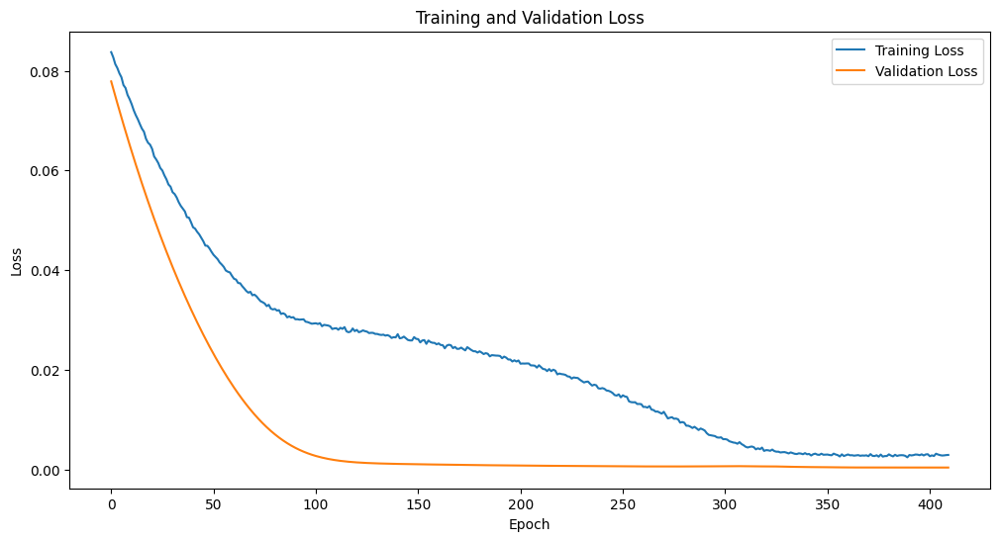

Epoch [1/2500], Train Loss: 0.0330, Val Loss: 0.0053
Epoch [2/2500], Train Loss: 0.0327, Val Loss: 0.0050
Epoch [3/2500], Train Loss: 0.0327, Val Loss: 0.0047
Epoch [4/2500], Train Loss: 0.0324, Val Loss: 0.0044
Epoch [5/2500], Train Loss: 0.0322, Val Loss: 0.0041
Epoch [6/2500], Train Loss: 0.0321, Val Loss: 0.0039
Epoch [7/2500], Train Loss: 0.0320, Val Loss: 0.0036
Epoch [8/2500], Train Loss: 0.0319, Val Loss: 0.0034
Epoch [9/2500], Train Loss: 0.0317, Val Loss: 0.0032
Epoch [10/2500], Train Loss: 0.0314, Val Loss: 0.0030
Epoch [11/2500], Train Loss: 0.0314, Val Loss: 0.0028
Epoch [12/2500], Train Loss: 0.0314, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0312, Val Loss: 0.0025
Epoch [14/2500], Train Loss: 0.0312, Val Loss: 0.0024
Epoch [15/2500], Train Loss: 0.0309, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0309, Val Loss: 0.0021
Epoch [17/2500], Train Loss: 0.0309, Val Loss: 0.0020
Epoch [18/2500], Train Loss: 0.0308, Val Loss: 0.0019
Epoch [19/2500], Train Loss: 0.0308, 

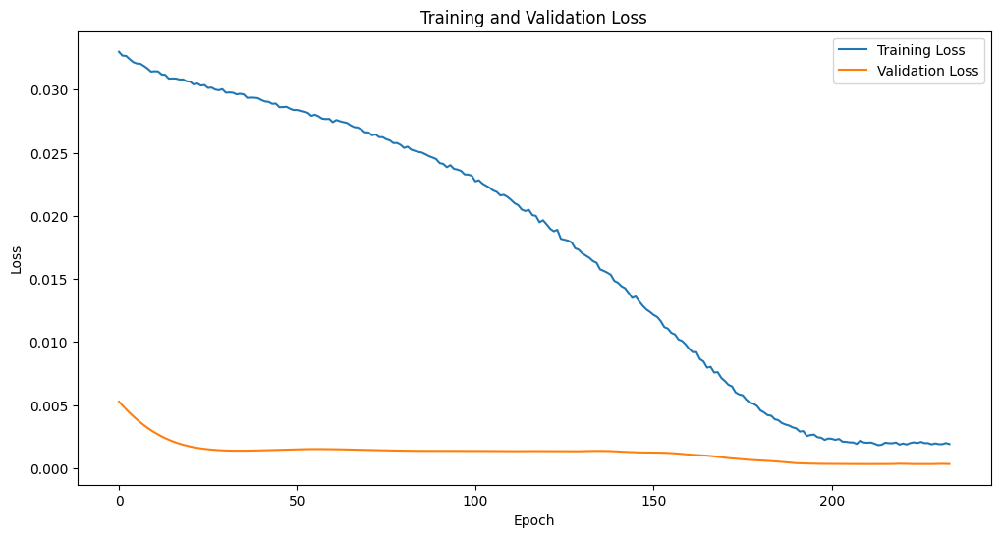

Epoch [1/2500], Train Loss: 0.0790, Val Loss: 0.0580
Epoch [2/2500], Train Loss: 0.0772, Val Loss: 0.0566
Epoch [3/2500], Train Loss: 0.0762, Val Loss: 0.0553
Epoch [4/2500], Train Loss: 0.0757, Val Loss: 0.0539
Epoch [5/2500], Train Loss: 0.0741, Val Loss: 0.0526
Epoch [6/2500], Train Loss: 0.0732, Val Loss: 0.0513
Epoch [7/2500], Train Loss: 0.0714, Val Loss: 0.0500
Epoch [8/2500], Train Loss: 0.0708, Val Loss: 0.0487
Epoch [9/2500], Train Loss: 0.0707, Val Loss: 0.0474
Epoch [10/2500], Train Loss: 0.0688, Val Loss: 0.0462
Epoch [11/2500], Train Loss: 0.0667, Val Loss: 0.0450
Epoch [12/2500], Train Loss: 0.0667, Val Loss: 0.0438
Epoch [13/2500], Train Loss: 0.0649, Val Loss: 0.0426
Epoch [14/2500], Train Loss: 0.0647, Val Loss: 0.0414
Epoch [15/2500], Train Loss: 0.0631, Val Loss: 0.0403
Epoch [16/2500], Train Loss: 0.0617, Val Loss: 0.0391
Epoch [17/2500], Train Loss: 0.0614, Val Loss: 0.0380
Epoch [18/2500], Train Loss: 0.0599, Val Loss: 0.0369
Epoch [19/2500], Train Loss: 0.0591, 

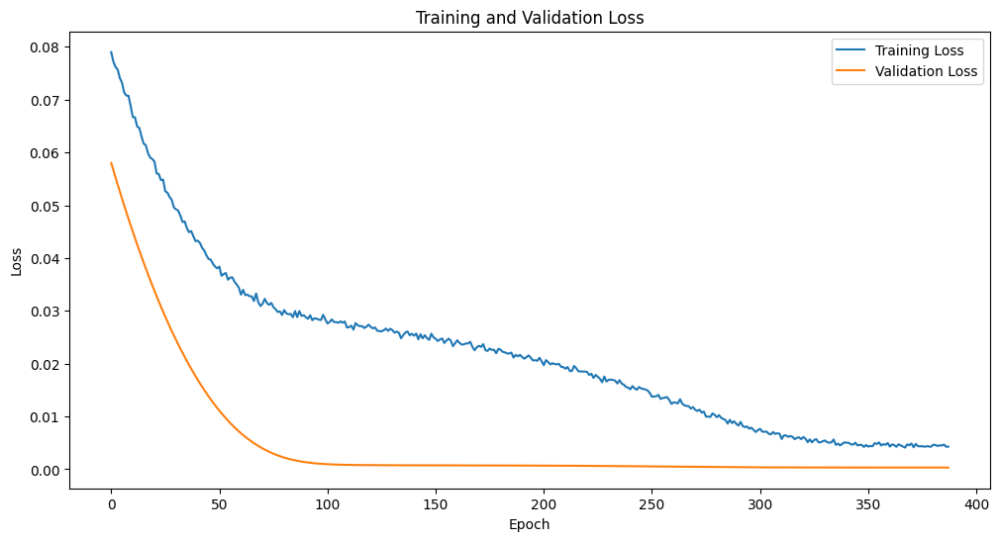

Epoch [1/2500], Train Loss: 0.0770, Val Loss: 0.0616
Epoch [2/2500], Train Loss: 0.0757, Val Loss: 0.0601
Epoch [3/2500], Train Loss: 0.0750, Val Loss: 0.0587
Epoch [4/2500], Train Loss: 0.0732, Val Loss: 0.0573
Epoch [5/2500], Train Loss: 0.0723, Val Loss: 0.0559
Epoch [6/2500], Train Loss: 0.0716, Val Loss: 0.0546
Epoch [7/2500], Train Loss: 0.0697, Val Loss: 0.0532
Epoch [8/2500], Train Loss: 0.0684, Val Loss: 0.0519
Epoch [9/2500], Train Loss: 0.0678, Val Loss: 0.0506
Epoch [10/2500], Train Loss: 0.0674, Val Loss: 0.0493
Epoch [11/2500], Train Loss: 0.0660, Val Loss: 0.0480
Epoch [12/2500], Train Loss: 0.0646, Val Loss: 0.0467
Epoch [13/2500], Train Loss: 0.0643, Val Loss: 0.0455
Epoch [14/2500], Train Loss: 0.0628, Val Loss: 0.0442
Epoch [15/2500], Train Loss: 0.0625, Val Loss: 0.0430
Epoch [16/2500], Train Loss: 0.0616, Val Loss: 0.0418
Epoch [17/2500], Train Loss: 0.0601, Val Loss: 0.0406
Epoch [18/2500], Train Loss: 0.0587, Val Loss: 0.0395
Epoch [19/2500], Train Loss: 0.0576, 

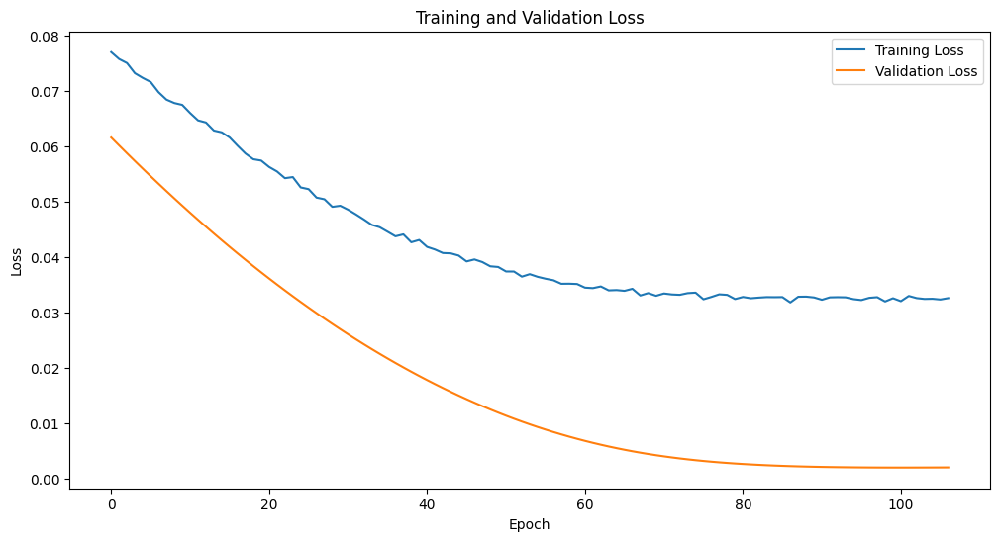

Epoch [1/2500], Train Loss: 0.0319, Val Loss: 0.0025
Epoch [2/2500], Train Loss: 0.0319, Val Loss: 0.0023
Epoch [3/2500], Train Loss: 0.0320, Val Loss: 0.0023
Epoch [4/2500], Train Loss: 0.0319, Val Loss: 0.0023
Epoch [5/2500], Train Loss: 0.0318, Val Loss: 0.0023
Epoch [6/2500], Train Loss: 0.0318, Val Loss: 0.0023
Epoch [7/2500], Train Loss: 0.0318, Val Loss: 0.0024
Epoch [8/2500], Train Loss: 0.0319, Val Loss: 0.0024
Epoch [9/2500], Train Loss: 0.0319, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0318, Val Loss: 0.0025
Epoch [11/2500], Train Loss: 0.0317, Val Loss: 0.0025
Epoch [12/2500], Train Loss: 0.0319, Val Loss: 0.0024
Epoch [13/2500], Train Loss: 0.0320, Val Loss: 0.0024
Epoch [14/2500], Train Loss: 0.0318, Val Loss: 0.0024
Epoch [15/2500], Train Loss: 0.0317, Val Loss: 0.0024
Epoch [16/2500], Train Loss: 0.0318, Val Loss: 0.0024
Epoch [17/2500], Train Loss: 0.0316, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0317, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0318, 

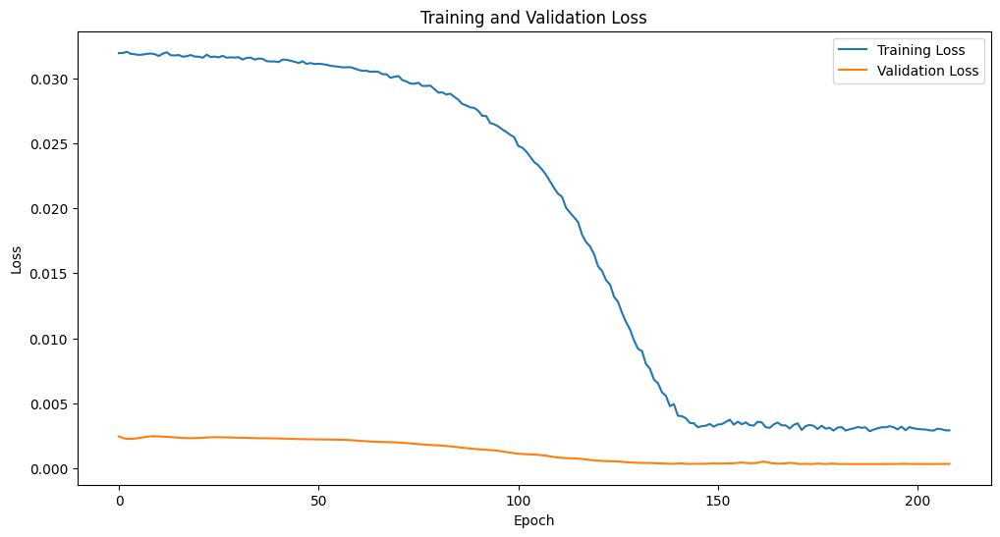

Epoch [1/2500], Train Loss: 0.0724, Val Loss: 0.0563
Epoch [2/2500], Train Loss: 0.0718, Val Loss: 0.0549
Epoch [3/2500], Train Loss: 0.0701, Val Loss: 0.0535
Epoch [4/2500], Train Loss: 0.0684, Val Loss: 0.0522
Epoch [5/2500], Train Loss: 0.0680, Val Loss: 0.0509
Epoch [6/2500], Train Loss: 0.0669, Val Loss: 0.0496
Epoch [7/2500], Train Loss: 0.0657, Val Loss: 0.0483
Epoch [8/2500], Train Loss: 0.0648, Val Loss: 0.0471
Epoch [9/2500], Train Loss: 0.0634, Val Loss: 0.0459
Epoch [10/2500], Train Loss: 0.0629, Val Loss: 0.0447
Epoch [11/2500], Train Loss: 0.0609, Val Loss: 0.0435
Epoch [12/2500], Train Loss: 0.0608, Val Loss: 0.0423
Epoch [13/2500], Train Loss: 0.0598, Val Loss: 0.0412
Epoch [14/2500], Train Loss: 0.0589, Val Loss: 0.0401
Epoch [15/2500], Train Loss: 0.0575, Val Loss: 0.0390
Epoch [16/2500], Train Loss: 0.0570, Val Loss: 0.0379
Epoch [17/2500], Train Loss: 0.0564, Val Loss: 0.0369
Epoch [18/2500], Train Loss: 0.0557, Val Loss: 0.0358
Epoch [19/2500], Train Loss: 0.0545, 

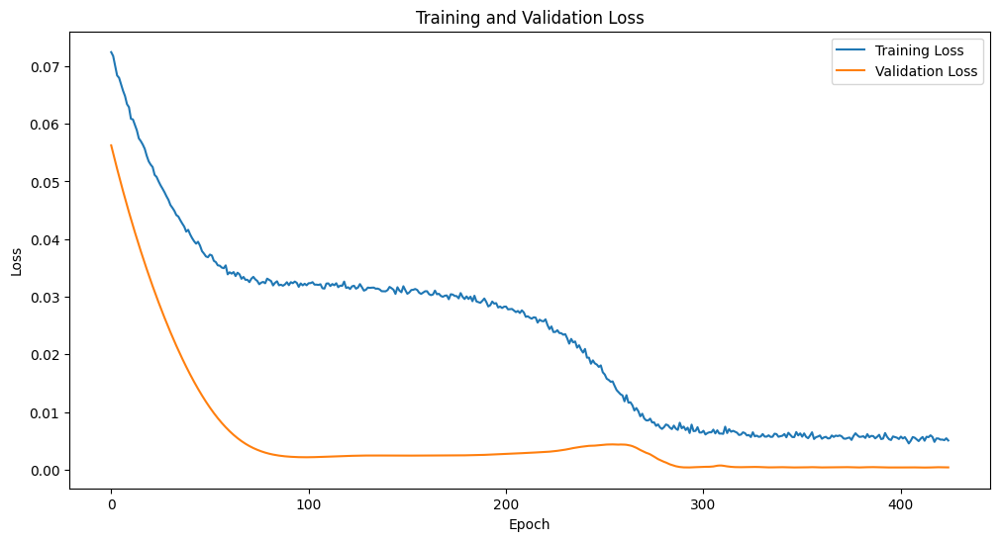

Epoch [1/2500], Train Loss: 0.0527, Val Loss: 0.0321
Epoch [2/2500], Train Loss: 0.0509, Val Loss: 0.0309
Epoch [3/2500], Train Loss: 0.0503, Val Loss: 0.0298
Epoch [4/2500], Train Loss: 0.0500, Val Loss: 0.0287
Epoch [5/2500], Train Loss: 0.0486, Val Loss: 0.0276
Epoch [6/2500], Train Loss: 0.0478, Val Loss: 0.0266
Epoch [7/2500], Train Loss: 0.0472, Val Loss: 0.0256
Epoch [8/2500], Train Loss: 0.0463, Val Loss: 0.0246
Epoch [9/2500], Train Loss: 0.0454, Val Loss: 0.0236
Epoch [10/2500], Train Loss: 0.0447, Val Loss: 0.0226
Epoch [11/2500], Train Loss: 0.0442, Val Loss: 0.0217
Epoch [12/2500], Train Loss: 0.0433, Val Loss: 0.0208
Epoch [13/2500], Train Loss: 0.0428, Val Loss: 0.0199
Epoch [14/2500], Train Loss: 0.0420, Val Loss: 0.0191
Epoch [15/2500], Train Loss: 0.0416, Val Loss: 0.0182
Epoch [16/2500], Train Loss: 0.0408, Val Loss: 0.0174
Epoch [17/2500], Train Loss: 0.0405, Val Loss: 0.0166
Epoch [18/2500], Train Loss: 0.0398, Val Loss: 0.0159
Epoch [19/2500], Train Loss: 0.0392, 

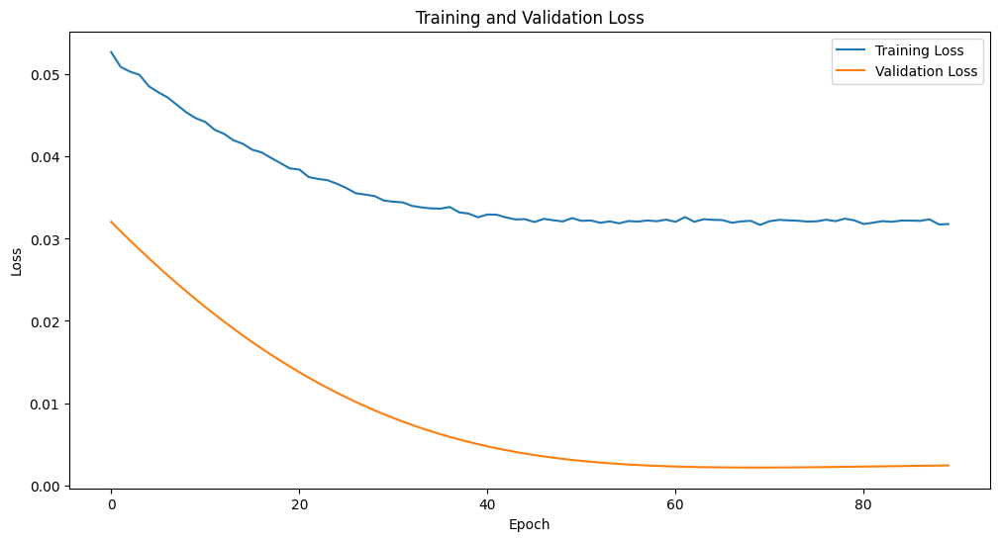

Epoch [1/2500], Train Loss: 0.0342, Val Loss: 0.0078
Epoch [2/2500], Train Loss: 0.0338, Val Loss: 0.0073
Epoch [3/2500], Train Loss: 0.0336, Val Loss: 0.0068
Epoch [4/2500], Train Loss: 0.0333, Val Loss: 0.0063
Epoch [5/2500], Train Loss: 0.0331, Val Loss: 0.0059
Epoch [6/2500], Train Loss: 0.0329, Val Loss: 0.0055
Epoch [7/2500], Train Loss: 0.0327, Val Loss: 0.0051
Epoch [8/2500], Train Loss: 0.0326, Val Loss: 0.0047
Epoch [9/2500], Train Loss: 0.0323, Val Loss: 0.0044
Epoch [10/2500], Train Loss: 0.0322, Val Loss: 0.0041
Epoch [11/2500], Train Loss: 0.0322, Val Loss: 0.0038
Epoch [12/2500], Train Loss: 0.0319, Val Loss: 0.0035
Epoch [13/2500], Train Loss: 0.0318, Val Loss: 0.0033
Epoch [14/2500], Train Loss: 0.0319, Val Loss: 0.0030
Epoch [15/2500], Train Loss: 0.0320, Val Loss: 0.0029
Epoch [16/2500], Train Loss: 0.0319, Val Loss: 0.0027
Epoch [17/2500], Train Loss: 0.0319, Val Loss: 0.0025
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0318, 

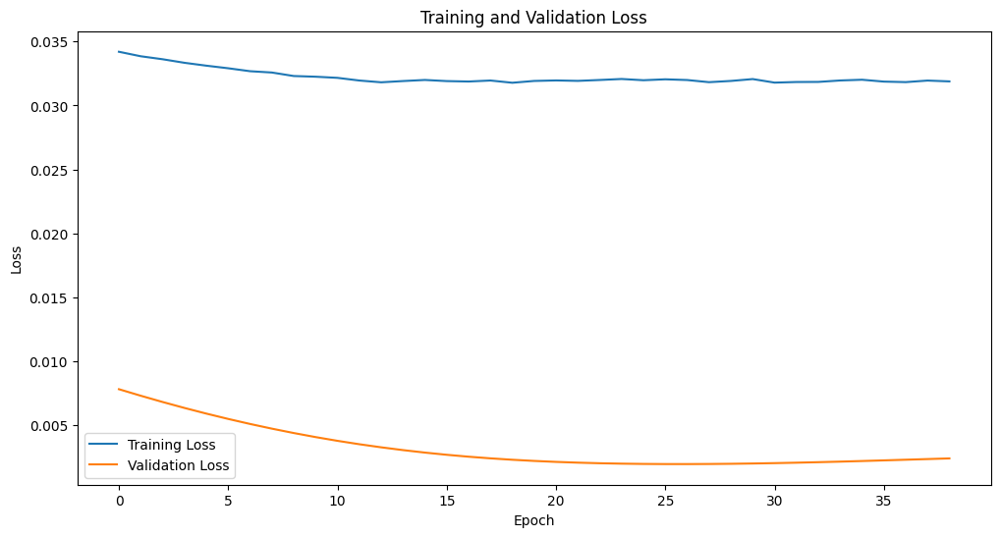

Epoch [1/2500], Train Loss: 0.0838, Val Loss: 0.0703
Epoch [2/2500], Train Loss: 0.0830, Val Loss: 0.0688
Epoch [3/2500], Train Loss: 0.0815, Val Loss: 0.0673
Epoch [4/2500], Train Loss: 0.0802, Val Loss: 0.0659
Epoch [5/2500], Train Loss: 0.0789, Val Loss: 0.0645
Epoch [6/2500], Train Loss: 0.0782, Val Loss: 0.0630
Epoch [7/2500], Train Loss: 0.0765, Val Loss: 0.0616
Epoch [8/2500], Train Loss: 0.0759, Val Loss: 0.0603
Epoch [9/2500], Train Loss: 0.0745, Val Loss: 0.0589
Epoch [10/2500], Train Loss: 0.0736, Val Loss: 0.0575
Epoch [11/2500], Train Loss: 0.0723, Val Loss: 0.0562
Epoch [12/2500], Train Loss: 0.0707, Val Loss: 0.0548
Epoch [13/2500], Train Loss: 0.0696, Val Loss: 0.0535
Epoch [14/2500], Train Loss: 0.0691, Val Loss: 0.0522
Epoch [15/2500], Train Loss: 0.0679, Val Loss: 0.0509
Epoch [16/2500], Train Loss: 0.0666, Val Loss: 0.0497
Epoch [17/2500], Train Loss: 0.0655, Val Loss: 0.0484
Epoch [18/2500], Train Loss: 0.0650, Val Loss: 0.0472
Epoch [19/2500], Train Loss: 0.0638, 

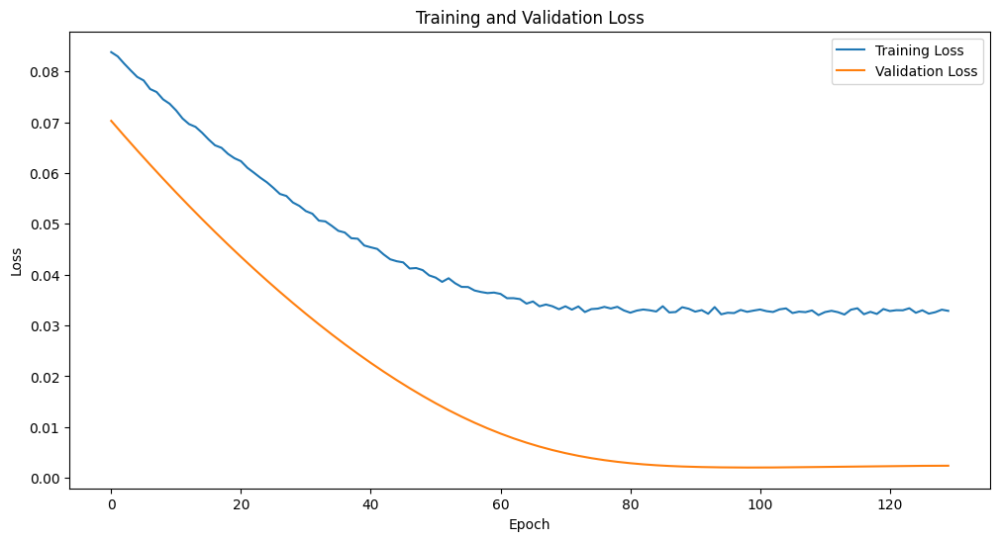

Epoch [1/2500], Train Loss: 0.1003, Val Loss: 0.0889
Epoch [2/2500], Train Loss: 0.0991, Val Loss: 0.0868
Epoch [3/2500], Train Loss: 0.0966, Val Loss: 0.0848
Epoch [4/2500], Train Loss: 0.0955, Val Loss: 0.0828
Epoch [5/2500], Train Loss: 0.0934, Val Loss: 0.0809
Epoch [6/2500], Train Loss: 0.0921, Val Loss: 0.0789
Epoch [7/2500], Train Loss: 0.0897, Val Loss: 0.0770
Epoch [8/2500], Train Loss: 0.0890, Val Loss: 0.0751
Epoch [9/2500], Train Loss: 0.0875, Val Loss: 0.0733
Epoch [10/2500], Train Loss: 0.0858, Val Loss: 0.0715
Epoch [11/2500], Train Loss: 0.0842, Val Loss: 0.0697
Epoch [12/2500], Train Loss: 0.0825, Val Loss: 0.0679
Epoch [13/2500], Train Loss: 0.0806, Val Loss: 0.0662
Epoch [14/2500], Train Loss: 0.0794, Val Loss: 0.0645
Epoch [15/2500], Train Loss: 0.0783, Val Loss: 0.0628
Epoch [16/2500], Train Loss: 0.0762, Val Loss: 0.0612
Epoch [17/2500], Train Loss: 0.0754, Val Loss: 0.0595
Epoch [18/2500], Train Loss: 0.0743, Val Loss: 0.0579
Epoch [19/2500], Train Loss: 0.0726, 

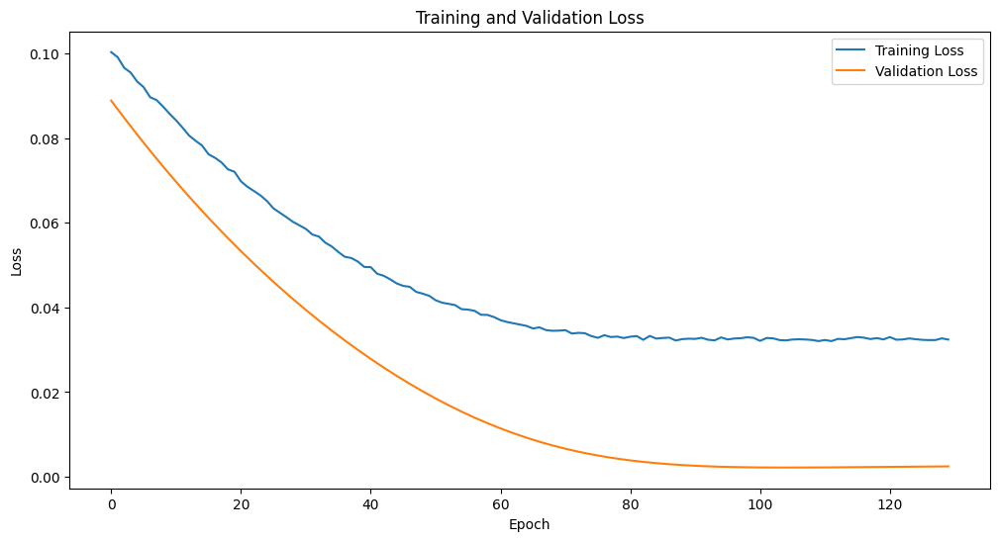

Epoch [1/2500], Train Loss: 0.0898, Val Loss: 0.0768
Epoch [2/2500], Train Loss: 0.0883, Val Loss: 0.0751
Epoch [3/2500], Train Loss: 0.0867, Val Loss: 0.0733
Epoch [4/2500], Train Loss: 0.0854, Val Loss: 0.0716
Epoch [5/2500], Train Loss: 0.0839, Val Loss: 0.0699
Epoch [6/2500], Train Loss: 0.0824, Val Loss: 0.0683
Epoch [7/2500], Train Loss: 0.0810, Val Loss: 0.0666
Epoch [8/2500], Train Loss: 0.0797, Val Loss: 0.0650
Epoch [9/2500], Train Loss: 0.0780, Val Loss: 0.0634
Epoch [10/2500], Train Loss: 0.0766, Val Loss: 0.0618
Epoch [11/2500], Train Loss: 0.0754, Val Loss: 0.0602
Epoch [12/2500], Train Loss: 0.0741, Val Loss: 0.0587
Epoch [13/2500], Train Loss: 0.0729, Val Loss: 0.0572
Epoch [14/2500], Train Loss: 0.0716, Val Loss: 0.0557
Epoch [15/2500], Train Loss: 0.0705, Val Loss: 0.0542
Epoch [16/2500], Train Loss: 0.0690, Val Loss: 0.0528
Epoch [17/2500], Train Loss: 0.0678, Val Loss: 0.0513
Epoch [18/2500], Train Loss: 0.0665, Val Loss: 0.0499
Epoch [19/2500], Train Loss: 0.0655, 

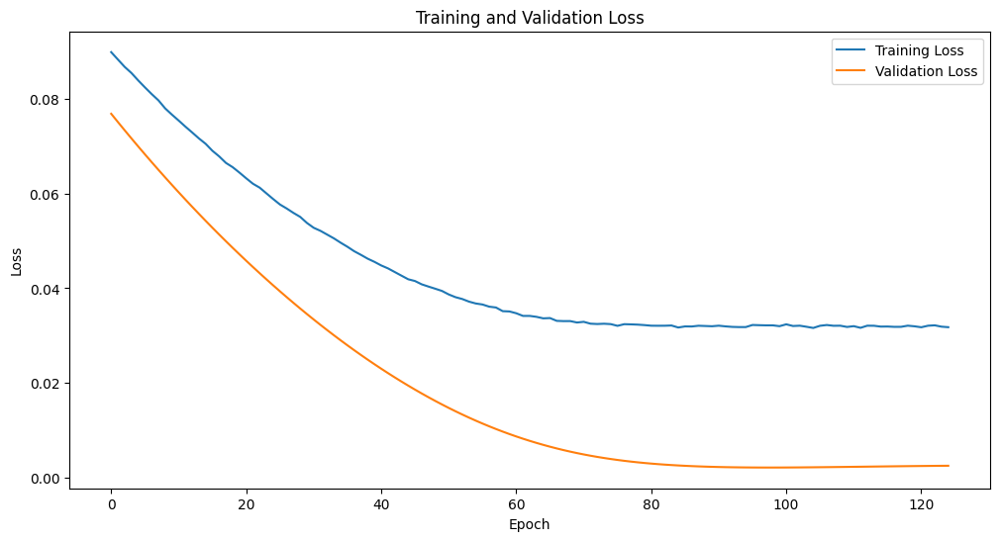

Epoch [1/2500], Train Loss: 0.1961, Val Loss: 0.1967
Epoch [2/2500], Train Loss: 0.1960, Val Loss: 0.1936
Epoch [3/2500], Train Loss: 0.1912, Val Loss: 0.1905
Epoch [4/2500], Train Loss: 0.1891, Val Loss: 0.1875
Epoch [5/2500], Train Loss: 0.1865, Val Loss: 0.1845
Epoch [6/2500], Train Loss: 0.1825, Val Loss: 0.1815
Epoch [7/2500], Train Loss: 0.1796, Val Loss: 0.1785
Epoch [8/2500], Train Loss: 0.1787, Val Loss: 0.1756
Epoch [9/2500], Train Loss: 0.1755, Val Loss: 0.1727
Epoch [10/2500], Train Loss: 0.1716, Val Loss: 0.1698
Epoch [11/2500], Train Loss: 0.1706, Val Loss: 0.1669
Epoch [12/2500], Train Loss: 0.1677, Val Loss: 0.1641
Epoch [13/2500], Train Loss: 0.1653, Val Loss: 0.1613
Epoch [14/2500], Train Loss: 0.1633, Val Loss: 0.1585
Epoch [15/2500], Train Loss: 0.1600, Val Loss: 0.1557
Epoch [16/2500], Train Loss: 0.1571, Val Loss: 0.1530
Epoch [17/2500], Train Loss: 0.1563, Val Loss: 0.1503
Epoch [18/2500], Train Loss: 0.1536, Val Loss: 0.1476
Epoch [19/2500], Train Loss: 0.1505, 

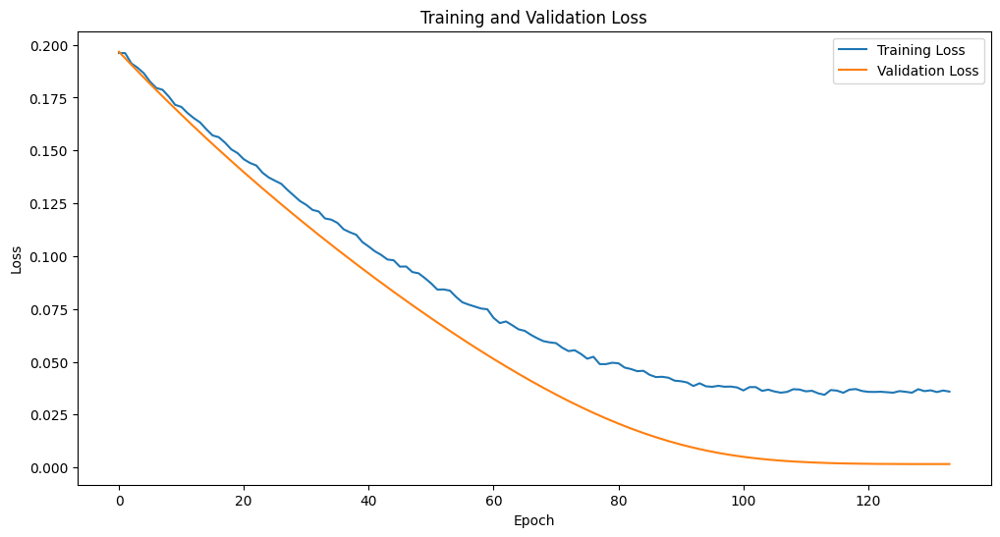

Epoch [1/2500], Train Loss: 0.1095, Val Loss: 0.0982
Epoch [2/2500], Train Loss: 0.1063, Val Loss: 0.0941
Epoch [3/2500], Train Loss: 0.1031, Val Loss: 0.0901
Epoch [4/2500], Train Loss: 0.0995, Val Loss: 0.0862
Epoch [5/2500], Train Loss: 0.0968, Val Loss: 0.0824
Epoch [6/2500], Train Loss: 0.0938, Val Loss: 0.0786
Epoch [7/2500], Train Loss: 0.0906, Val Loss: 0.0750
Epoch [8/2500], Train Loss: 0.0870, Val Loss: 0.0715
Epoch [9/2500], Train Loss: 0.0840, Val Loss: 0.0681
Epoch [10/2500], Train Loss: 0.0811, Val Loss: 0.0648
Epoch [11/2500], Train Loss: 0.0791, Val Loss: 0.0616
Epoch [12/2500], Train Loss: 0.0764, Val Loss: 0.0584
Epoch [13/2500], Train Loss: 0.0732, Val Loss: 0.0554
Epoch [14/2500], Train Loss: 0.0709, Val Loss: 0.0525
Epoch [15/2500], Train Loss: 0.0687, Val Loss: 0.0496
Epoch [16/2500], Train Loss: 0.0662, Val Loss: 0.0469
Epoch [17/2500], Train Loss: 0.0646, Val Loss: 0.0442
Epoch [18/2500], Train Loss: 0.0620, Val Loss: 0.0416
Epoch [19/2500], Train Loss: 0.0597, 

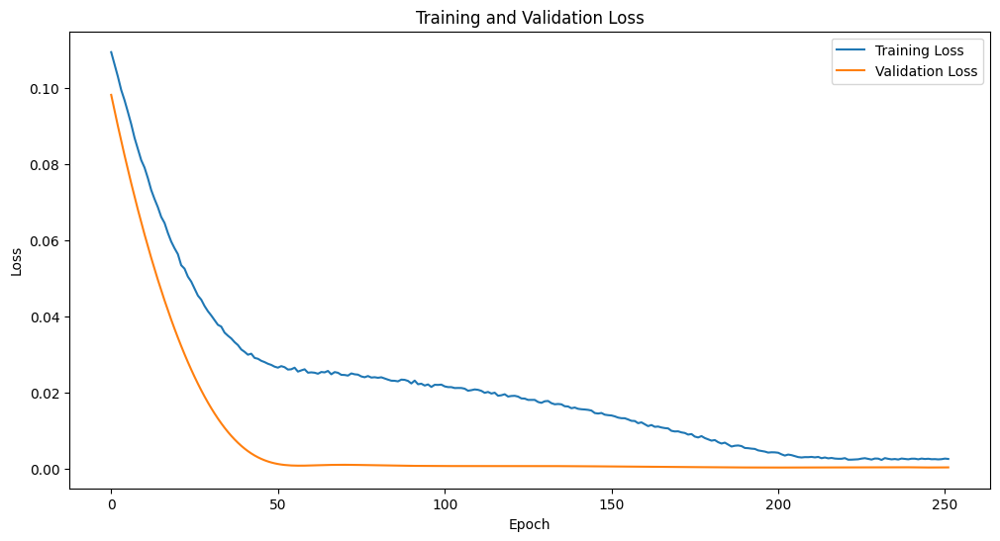

Epoch [1/2500], Train Loss: 0.0782, Val Loss: 0.0666
Epoch [2/2500], Train Loss: 0.0766, Val Loss: 0.0645
Epoch [3/2500], Train Loss: 0.0749, Val Loss: 0.0625
Epoch [4/2500], Train Loss: 0.0733, Val Loss: 0.0605
Epoch [5/2500], Train Loss: 0.0717, Val Loss: 0.0585
Epoch [6/2500], Train Loss: 0.0700, Val Loss: 0.0565
Epoch [7/2500], Train Loss: 0.0685, Val Loss: 0.0546
Epoch [8/2500], Train Loss: 0.0669, Val Loss: 0.0527
Epoch [9/2500], Train Loss: 0.0655, Val Loss: 0.0508
Epoch [10/2500], Train Loss: 0.0640, Val Loss: 0.0490
Epoch [11/2500], Train Loss: 0.0625, Val Loss: 0.0472
Epoch [12/2500], Train Loss: 0.0611, Val Loss: 0.0454
Epoch [13/2500], Train Loss: 0.0596, Val Loss: 0.0436
Epoch [14/2500], Train Loss: 0.0584, Val Loss: 0.0419
Epoch [15/2500], Train Loss: 0.0569, Val Loss: 0.0402
Epoch [16/2500], Train Loss: 0.0557, Val Loss: 0.0385
Epoch [17/2500], Train Loss: 0.0545, Val Loss: 0.0369
Epoch [18/2500], Train Loss: 0.0532, Val Loss: 0.0352
Epoch [19/2500], Train Loss: 0.0518, 

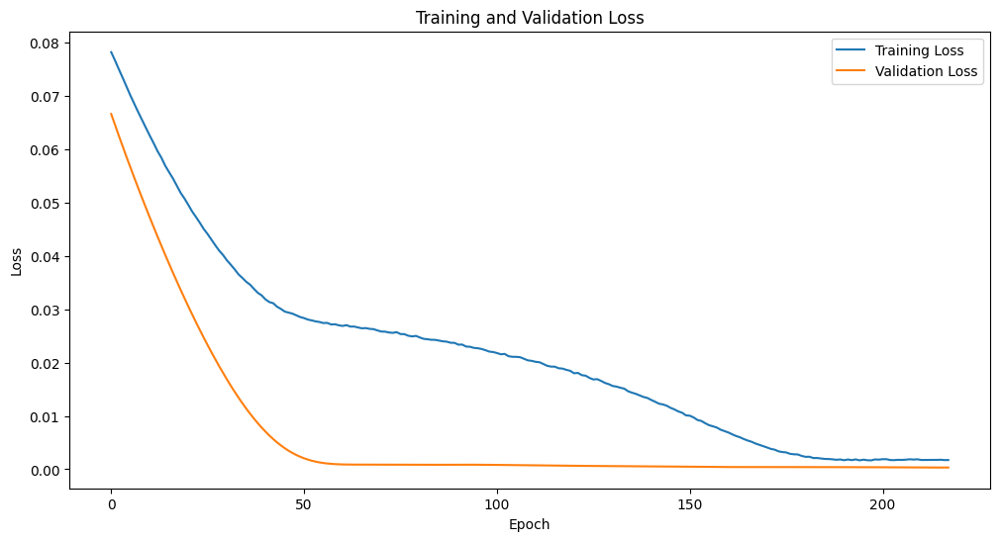

Epoch [1/2500], Train Loss: 0.0636, Val Loss: 0.0528
Epoch [2/2500], Train Loss: 0.0619, Val Loss: 0.0505
Epoch [3/2500], Train Loss: 0.0602, Val Loss: 0.0484
Epoch [4/2500], Train Loss: 0.0592, Val Loss: 0.0463
Epoch [5/2500], Train Loss: 0.0573, Val Loss: 0.0442
Epoch [6/2500], Train Loss: 0.0558, Val Loss: 0.0423
Epoch [7/2500], Train Loss: 0.0550, Val Loss: 0.0403
Epoch [8/2500], Train Loss: 0.0532, Val Loss: 0.0385
Epoch [9/2500], Train Loss: 0.0520, Val Loss: 0.0366
Epoch [10/2500], Train Loss: 0.0503, Val Loss: 0.0349
Epoch [11/2500], Train Loss: 0.0493, Val Loss: 0.0332
Epoch [12/2500], Train Loss: 0.0481, Val Loss: 0.0315
Epoch [13/2500], Train Loss: 0.0470, Val Loss: 0.0299
Epoch [14/2500], Train Loss: 0.0458, Val Loss: 0.0284
Epoch [15/2500], Train Loss: 0.0447, Val Loss: 0.0269
Epoch [16/2500], Train Loss: 0.0435, Val Loss: 0.0254
Epoch [17/2500], Train Loss: 0.0428, Val Loss: 0.0240
Epoch [18/2500], Train Loss: 0.0413, Val Loss: 0.0227
Epoch [19/2500], Train Loss: 0.0405, 

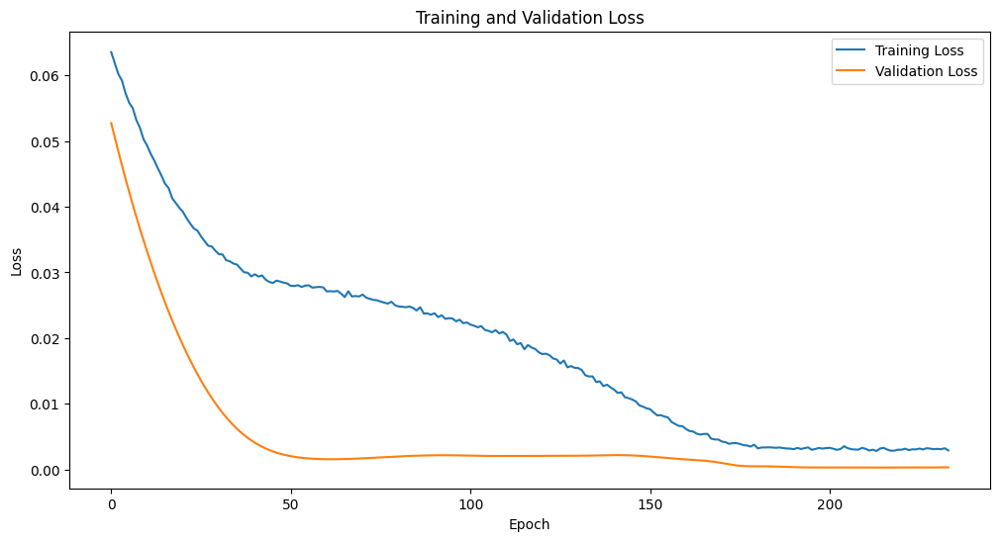

Epoch [1/2500], Train Loss: 0.0969, Val Loss: 0.0838
Epoch [2/2500], Train Loss: 0.0940, Val Loss: 0.0805
Epoch [3/2500], Train Loss: 0.0912, Val Loss: 0.0773
Epoch [4/2500], Train Loss: 0.0888, Val Loss: 0.0742
Epoch [5/2500], Train Loss: 0.0856, Val Loss: 0.0711
Epoch [6/2500], Train Loss: 0.0830, Val Loss: 0.0680
Epoch [7/2500], Train Loss: 0.0808, Val Loss: 0.0651
Epoch [8/2500], Train Loss: 0.0782, Val Loss: 0.0622
Epoch [9/2500], Train Loss: 0.0758, Val Loss: 0.0593
Epoch [10/2500], Train Loss: 0.0732, Val Loss: 0.0565
Epoch [11/2500], Train Loss: 0.0713, Val Loss: 0.0538
Epoch [12/2500], Train Loss: 0.0691, Val Loss: 0.0511
Epoch [13/2500], Train Loss: 0.0668, Val Loss: 0.0485
Epoch [14/2500], Train Loss: 0.0647, Val Loss: 0.0460
Epoch [15/2500], Train Loss: 0.0628, Val Loss: 0.0435
Epoch [16/2500], Train Loss: 0.0607, Val Loss: 0.0411
Epoch [17/2500], Train Loss: 0.0587, Val Loss: 0.0388
Epoch [18/2500], Train Loss: 0.0568, Val Loss: 0.0365
Epoch [19/2500], Train Loss: 0.0550, 

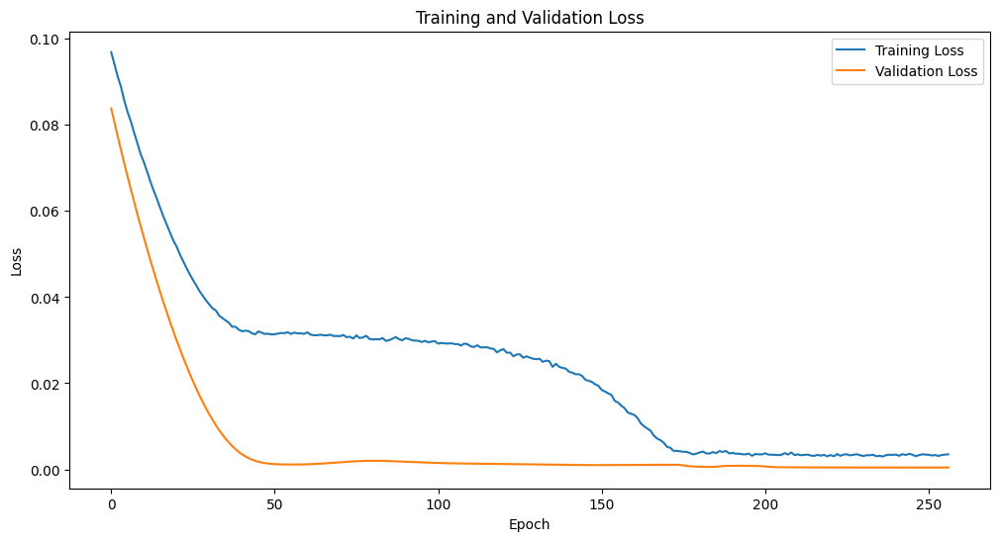

Epoch [1/2500], Train Loss: 0.0595, Val Loss: 0.0406
Epoch [2/2500], Train Loss: 0.0578, Val Loss: 0.0385
Epoch [3/2500], Train Loss: 0.0561, Val Loss: 0.0365
Epoch [4/2500], Train Loss: 0.0546, Val Loss: 0.0345
Epoch [5/2500], Train Loss: 0.0531, Val Loss: 0.0326
Epoch [6/2500], Train Loss: 0.0514, Val Loss: 0.0307
Epoch [7/2500], Train Loss: 0.0501, Val Loss: 0.0289
Epoch [8/2500], Train Loss: 0.0487, Val Loss: 0.0272
Epoch [9/2500], Train Loss: 0.0474, Val Loss: 0.0255
Epoch [10/2500], Train Loss: 0.0461, Val Loss: 0.0238
Epoch [11/2500], Train Loss: 0.0448, Val Loss: 0.0222
Epoch [12/2500], Train Loss: 0.0438, Val Loss: 0.0207
Epoch [13/2500], Train Loss: 0.0426, Val Loss: 0.0192
Epoch [14/2500], Train Loss: 0.0416, Val Loss: 0.0178
Epoch [15/2500], Train Loss: 0.0406, Val Loss: 0.0165
Epoch [16/2500], Train Loss: 0.0397, Val Loss: 0.0152
Epoch [17/2500], Train Loss: 0.0387, Val Loss: 0.0139
Epoch [18/2500], Train Loss: 0.0379, Val Loss: 0.0127
Epoch [19/2500], Train Loss: 0.0371, 

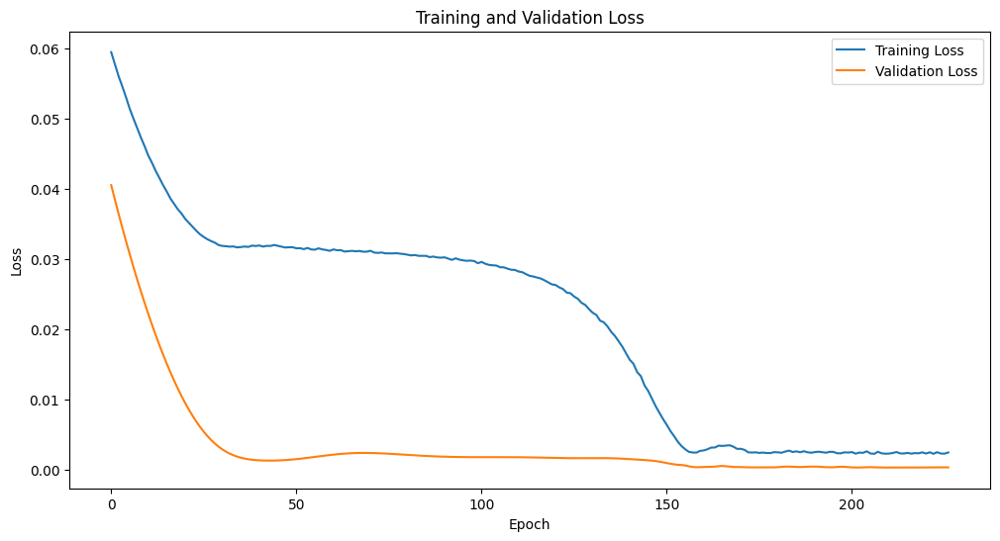

Epoch [1/2500], Train Loss: 0.0885, Val Loss: 0.0728
Epoch [2/2500], Train Loss: 0.0860, Val Loss: 0.0700
Epoch [3/2500], Train Loss: 0.0836, Val Loss: 0.0674
Epoch [4/2500], Train Loss: 0.0820, Val Loss: 0.0648
Epoch [5/2500], Train Loss: 0.0793, Val Loss: 0.0622
Epoch [6/2500], Train Loss: 0.0772, Val Loss: 0.0597
Epoch [7/2500], Train Loss: 0.0752, Val Loss: 0.0573
Epoch [8/2500], Train Loss: 0.0728, Val Loss: 0.0549
Epoch [9/2500], Train Loss: 0.0715, Val Loss: 0.0525
Epoch [10/2500], Train Loss: 0.0692, Val Loss: 0.0502
Epoch [11/2500], Train Loss: 0.0677, Val Loss: 0.0480
Epoch [12/2500], Train Loss: 0.0651, Val Loss: 0.0458
Epoch [13/2500], Train Loss: 0.0640, Val Loss: 0.0436
Epoch [14/2500], Train Loss: 0.0626, Val Loss: 0.0415
Epoch [15/2500], Train Loss: 0.0603, Val Loss: 0.0394
Epoch [16/2500], Train Loss: 0.0588, Val Loss: 0.0374
Epoch [17/2500], Train Loss: 0.0581, Val Loss: 0.0355
Epoch [18/2500], Train Loss: 0.0552, Val Loss: 0.0335
Epoch [19/2500], Train Loss: 0.0538, 

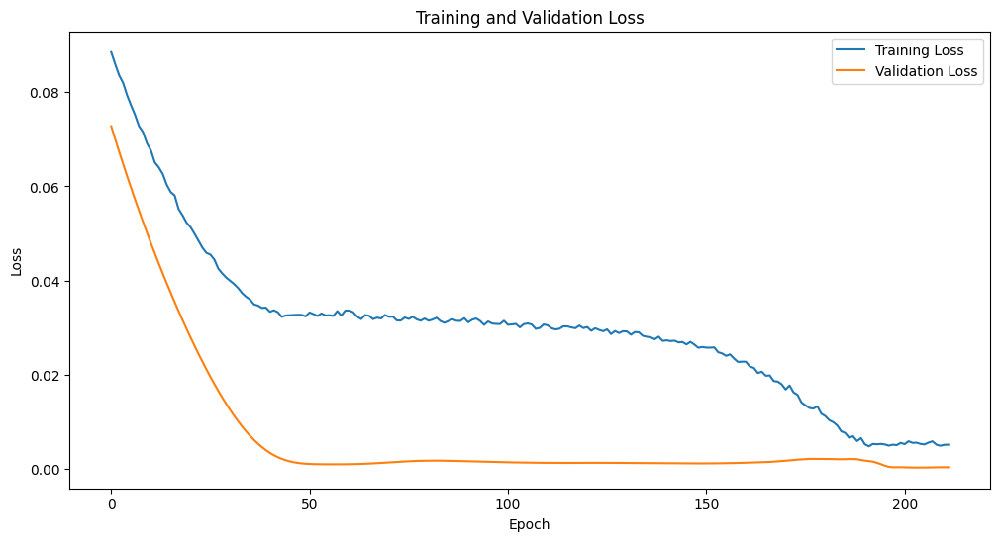

Epoch [1/2500], Train Loss: 0.1018, Val Loss: 0.0890
Epoch [2/2500], Train Loss: 0.0989, Val Loss: 0.0858
Epoch [3/2500], Train Loss: 0.0958, Val Loss: 0.0827
Epoch [4/2500], Train Loss: 0.0935, Val Loss: 0.0796
Epoch [5/2500], Train Loss: 0.0912, Val Loss: 0.0767
Epoch [6/2500], Train Loss: 0.0880, Val Loss: 0.0737
Epoch [7/2500], Train Loss: 0.0858, Val Loss: 0.0708
Epoch [8/2500], Train Loss: 0.0836, Val Loss: 0.0680
Epoch [9/2500], Train Loss: 0.0807, Val Loss: 0.0652
Epoch [10/2500], Train Loss: 0.0785, Val Loss: 0.0625
Epoch [11/2500], Train Loss: 0.0759, Val Loss: 0.0598
Epoch [12/2500], Train Loss: 0.0738, Val Loss: 0.0572
Epoch [13/2500], Train Loss: 0.0721, Val Loss: 0.0546
Epoch [14/2500], Train Loss: 0.0696, Val Loss: 0.0521
Epoch [15/2500], Train Loss: 0.0674, Val Loss: 0.0496
Epoch [16/2500], Train Loss: 0.0651, Val Loss: 0.0471
Epoch [17/2500], Train Loss: 0.0634, Val Loss: 0.0447
Epoch [18/2500], Train Loss: 0.0614, Val Loss: 0.0424
Epoch [19/2500], Train Loss: 0.0597, 

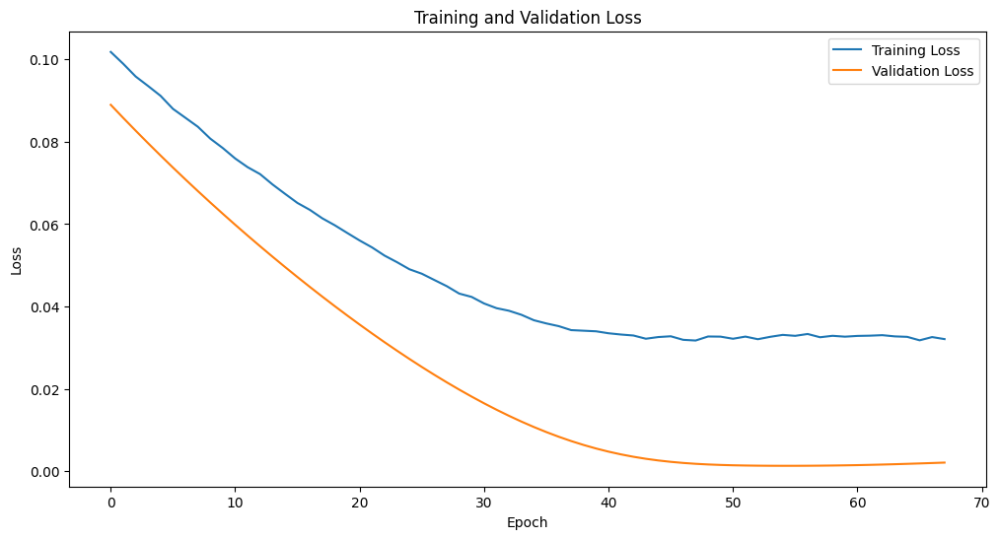

Epoch [1/2500], Train Loss: 0.0800, Val Loss: 0.0645
Epoch [2/2500], Train Loss: 0.0778, Val Loss: 0.0618
Epoch [3/2500], Train Loss: 0.0755, Val Loss: 0.0592
Epoch [4/2500], Train Loss: 0.0733, Val Loss: 0.0566
Epoch [5/2500], Train Loss: 0.0711, Val Loss: 0.0541
Epoch [6/2500], Train Loss: 0.0690, Val Loss: 0.0516
Epoch [7/2500], Train Loss: 0.0671, Val Loss: 0.0492
Epoch [8/2500], Train Loss: 0.0647, Val Loss: 0.0468
Epoch [9/2500], Train Loss: 0.0629, Val Loss: 0.0445
Epoch [10/2500], Train Loss: 0.0610, Val Loss: 0.0422
Epoch [11/2500], Train Loss: 0.0592, Val Loss: 0.0400
Epoch [12/2500], Train Loss: 0.0575, Val Loss: 0.0378
Epoch [13/2500], Train Loss: 0.0557, Val Loss: 0.0357
Epoch [14/2500], Train Loss: 0.0540, Val Loss: 0.0336
Epoch [15/2500], Train Loss: 0.0521, Val Loss: 0.0316
Epoch [16/2500], Train Loss: 0.0507, Val Loss: 0.0296
Epoch [17/2500], Train Loss: 0.0490, Val Loss: 0.0277
Epoch [18/2500], Train Loss: 0.0476, Val Loss: 0.0258
Epoch [19/2500], Train Loss: 0.0463, 

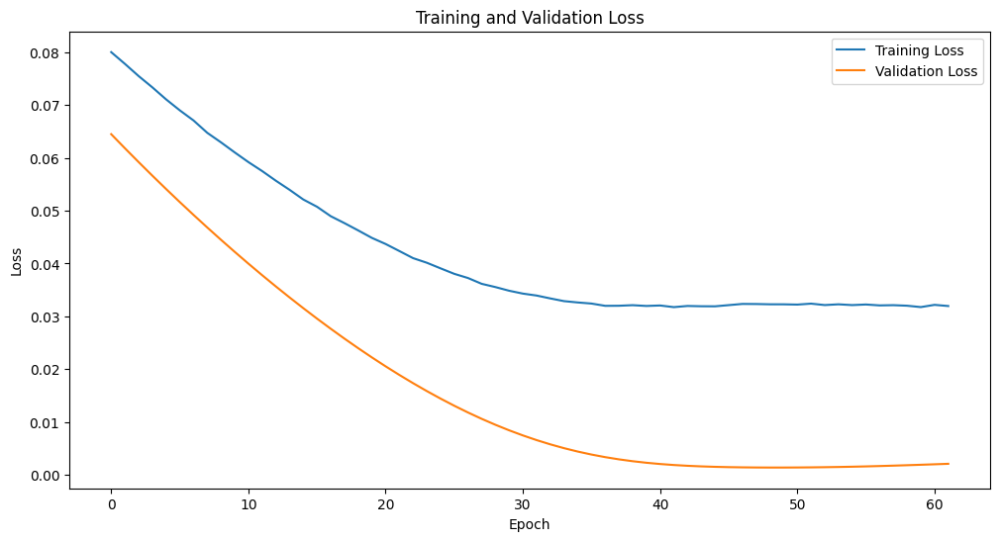

Epoch [1/2500], Train Loss: 0.1017, Val Loss: 0.0893
Epoch [2/2500], Train Loss: 0.0994, Val Loss: 0.0863
Epoch [3/2500], Train Loss: 0.0968, Val Loss: 0.0833
Epoch [4/2500], Train Loss: 0.0944, Val Loss: 0.0804
Epoch [5/2500], Train Loss: 0.0921, Val Loss: 0.0775
Epoch [6/2500], Train Loss: 0.0898, Val Loss: 0.0747
Epoch [7/2500], Train Loss: 0.0875, Val Loss: 0.0719
Epoch [8/2500], Train Loss: 0.0845, Val Loss: 0.0692
Epoch [9/2500], Train Loss: 0.0823, Val Loss: 0.0665
Epoch [10/2500], Train Loss: 0.0798, Val Loss: 0.0639
Epoch [11/2500], Train Loss: 0.0776, Val Loss: 0.0613
Epoch [12/2500], Train Loss: 0.0758, Val Loss: 0.0587
Epoch [13/2500], Train Loss: 0.0732, Val Loss: 0.0562
Epoch [14/2500], Train Loss: 0.0711, Val Loss: 0.0538
Epoch [15/2500], Train Loss: 0.0693, Val Loss: 0.0514
Epoch [16/2500], Train Loss: 0.0677, Val Loss: 0.0490
Epoch [17/2500], Train Loss: 0.0651, Val Loss: 0.0467
Epoch [18/2500], Train Loss: 0.0631, Val Loss: 0.0444
Epoch [19/2500], Train Loss: 0.0619, 

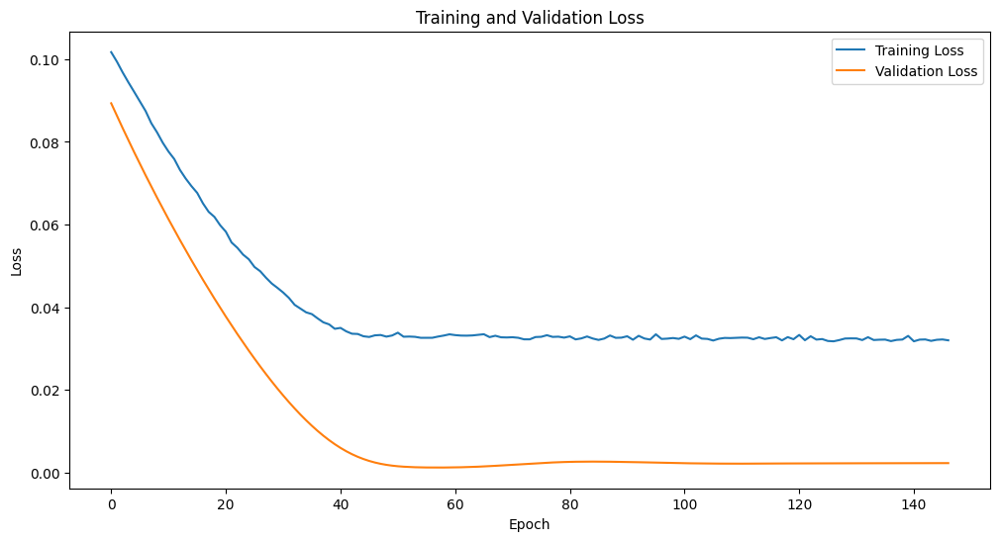

Epoch [1/2500], Train Loss: 0.0565, Val Loss: 0.0366
Epoch [2/2500], Train Loss: 0.0548, Val Loss: 0.0344
Epoch [3/2500], Train Loss: 0.0531, Val Loss: 0.0323
Epoch [4/2500], Train Loss: 0.0513, Val Loss: 0.0302
Epoch [5/2500], Train Loss: 0.0497, Val Loss: 0.0282
Epoch [6/2500], Train Loss: 0.0482, Val Loss: 0.0263
Epoch [7/2500], Train Loss: 0.0470, Val Loss: 0.0245
Epoch [8/2500], Train Loss: 0.0454, Val Loss: 0.0227
Epoch [9/2500], Train Loss: 0.0439, Val Loss: 0.0210
Epoch [10/2500], Train Loss: 0.0429, Val Loss: 0.0193
Epoch [11/2500], Train Loss: 0.0416, Val Loss: 0.0177
Epoch [12/2500], Train Loss: 0.0406, Val Loss: 0.0162
Epoch [13/2500], Train Loss: 0.0392, Val Loss: 0.0148
Epoch [14/2500], Train Loss: 0.0384, Val Loss: 0.0135
Epoch [15/2500], Train Loss: 0.0376, Val Loss: 0.0122
Epoch [16/2500], Train Loss: 0.0365, Val Loss: 0.0110
Epoch [17/2500], Train Loss: 0.0360, Val Loss: 0.0099
Epoch [18/2500], Train Loss: 0.0351, Val Loss: 0.0088
Epoch [19/2500], Train Loss: 0.0346, 

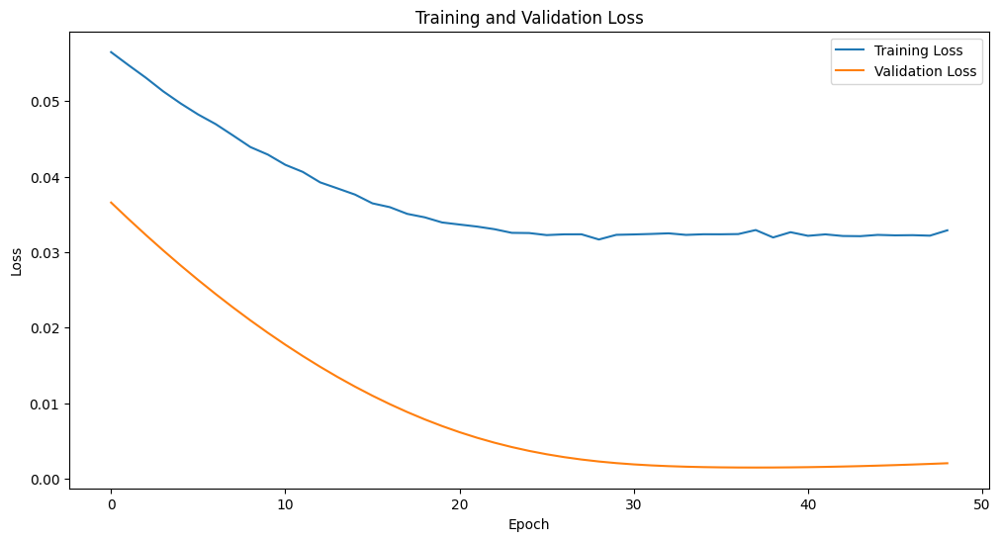

Epoch [1/2500], Train Loss: 0.0840, Val Loss: 0.0689
Epoch [2/2500], Train Loss: 0.0815, Val Loss: 0.0662
Epoch [3/2500], Train Loss: 0.0792, Val Loss: 0.0635
Epoch [4/2500], Train Loss: 0.0770, Val Loss: 0.0608
Epoch [5/2500], Train Loss: 0.0747, Val Loss: 0.0581
Epoch [6/2500], Train Loss: 0.0723, Val Loss: 0.0556
Epoch [7/2500], Train Loss: 0.0704, Val Loss: 0.0530
Epoch [8/2500], Train Loss: 0.0681, Val Loss: 0.0505
Epoch [9/2500], Train Loss: 0.0661, Val Loss: 0.0480
Epoch [10/2500], Train Loss: 0.0640, Val Loss: 0.0456
Epoch [11/2500], Train Loss: 0.0619, Val Loss: 0.0433
Epoch [12/2500], Train Loss: 0.0601, Val Loss: 0.0409
Epoch [13/2500], Train Loss: 0.0581, Val Loss: 0.0386
Epoch [14/2500], Train Loss: 0.0562, Val Loss: 0.0364
Epoch [15/2500], Train Loss: 0.0545, Val Loss: 0.0342
Epoch [16/2500], Train Loss: 0.0528, Val Loss: 0.0321
Epoch [17/2500], Train Loss: 0.0510, Val Loss: 0.0300
Epoch [18/2500], Train Loss: 0.0494, Val Loss: 0.0280
Epoch [19/2500], Train Loss: 0.0479, 

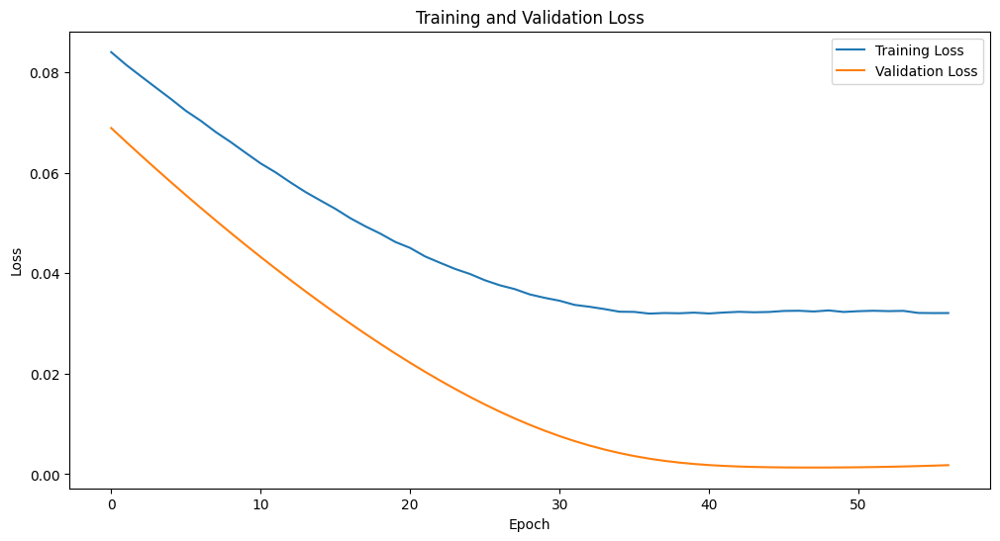

Epoch [1/2500], Train Loss: 0.1234, Val Loss: 0.1137
Epoch [2/2500], Train Loss: 0.1208, Val Loss: 0.1107
Epoch [3/2500], Train Loss: 0.1176, Val Loss: 0.1077
Epoch [4/2500], Train Loss: 0.1151, Val Loss: 0.1048
Epoch [5/2500], Train Loss: 0.1127, Val Loss: 0.1019
Epoch [6/2500], Train Loss: 0.1106, Val Loss: 0.0990
Epoch [7/2500], Train Loss: 0.1079, Val Loss: 0.0962
Epoch [8/2500], Train Loss: 0.1057, Val Loss: 0.0934
Epoch [9/2500], Train Loss: 0.1028, Val Loss: 0.0906
Epoch [10/2500], Train Loss: 0.1010, Val Loss: 0.0879
Epoch [11/2500], Train Loss: 0.0981, Val Loss: 0.0852
Epoch [12/2500], Train Loss: 0.0956, Val Loss: 0.0826
Epoch [13/2500], Train Loss: 0.0935, Val Loss: 0.0800
Epoch [14/2500], Train Loss: 0.0913, Val Loss: 0.0774
Epoch [15/2500], Train Loss: 0.0891, Val Loss: 0.0748
Epoch [16/2500], Train Loss: 0.0871, Val Loss: 0.0723
Epoch [17/2500], Train Loss: 0.0847, Val Loss: 0.0697
Epoch [18/2500], Train Loss: 0.0824, Val Loss: 0.0673
Epoch [19/2500], Train Loss: 0.0812, 

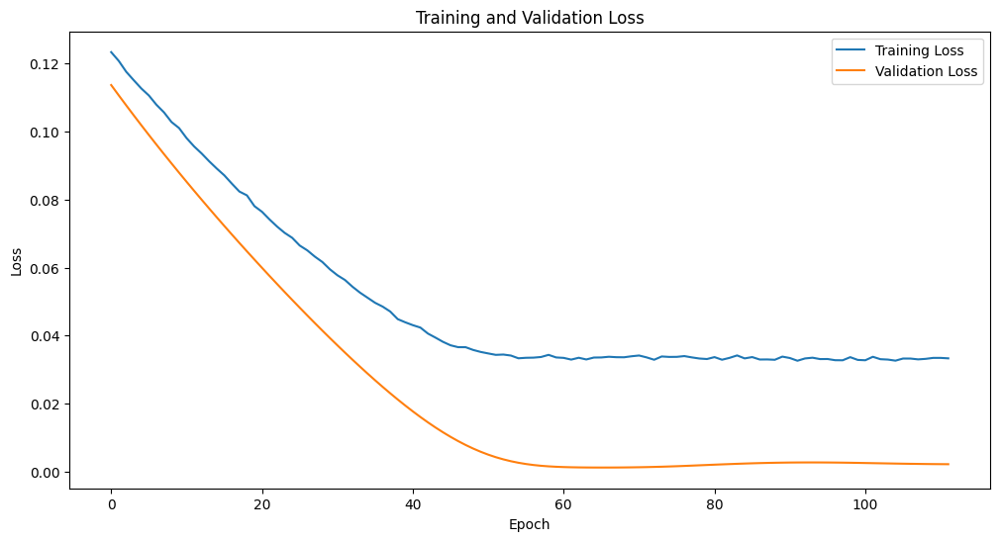

Epoch [1/2500], Train Loss: 0.0634, Val Loss: 0.0029
Epoch [2/2500], Train Loss: 0.0621, Val Loss: 0.0029
Epoch [3/2500], Train Loss: 0.0618, Val Loss: 0.0029
Epoch [4/2500], Train Loss: 0.0608, Val Loss: 0.0028
Epoch [5/2500], Train Loss: 0.0608, Val Loss: 0.0026
Epoch [6/2500], Train Loss: 0.0601, Val Loss: 0.0024
Epoch [7/2500], Train Loss: 0.0601, Val Loss: 0.0022
Epoch [8/2500], Train Loss: 0.0595, Val Loss: 0.0021
Epoch [9/2500], Train Loss: 0.0588, Val Loss: 0.0020
Epoch [10/2500], Train Loss: 0.0573, Val Loss: 0.0019
Epoch [11/2500], Train Loss: 0.0574, Val Loss: 0.0018
Epoch [12/2500], Train Loss: 0.0570, Val Loss: 0.0017
Epoch [13/2500], Train Loss: 0.0565, Val Loss: 0.0017
Epoch [14/2500], Train Loss: 0.0553, Val Loss: 0.0016
Epoch [15/2500], Train Loss: 0.0555, Val Loss: 0.0016
Epoch [16/2500], Train Loss: 0.0539, Val Loss: 0.0015
Epoch [17/2500], Train Loss: 0.0536, Val Loss: 0.0015
Epoch [18/2500], Train Loss: 0.0508, Val Loss: 0.0016
Epoch [19/2500], Train Loss: 0.0510, 

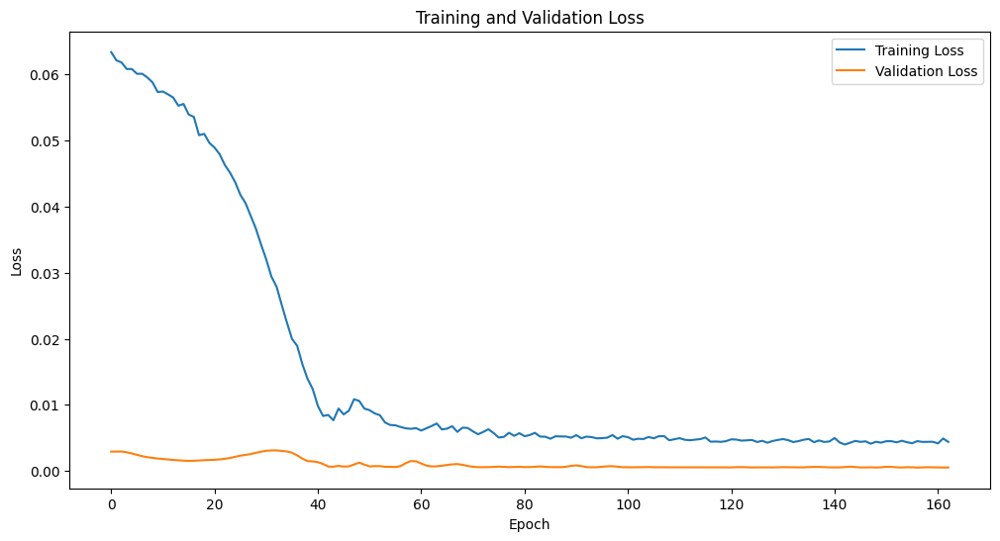

Epoch [1/2500], Train Loss: 0.2456, Val Loss: 0.2110
Epoch [2/2500], Train Loss: 0.2280, Val Loss: 0.1924
Epoch [3/2500], Train Loss: 0.2128, Val Loss: 0.1750
Epoch [4/2500], Train Loss: 0.1978, Val Loss: 0.1588
Epoch [5/2500], Train Loss: 0.1839, Val Loss: 0.1438
Epoch [6/2500], Train Loss: 0.1726, Val Loss: 0.1297
Epoch [7/2500], Train Loss: 0.1603, Val Loss: 0.1165
Epoch [8/2500], Train Loss: 0.1490, Val Loss: 0.1042
Epoch [9/2500], Train Loss: 0.1385, Val Loss: 0.0927
Epoch [10/2500], Train Loss: 0.1294, Val Loss: 0.0819
Epoch [11/2500], Train Loss: 0.1207, Val Loss: 0.0718
Epoch [12/2500], Train Loss: 0.1127, Val Loss: 0.0624
Epoch [13/2500], Train Loss: 0.1052, Val Loss: 0.0537
Epoch [14/2500], Train Loss: 0.0977, Val Loss: 0.0456
Epoch [15/2500], Train Loss: 0.0915, Val Loss: 0.0382
Epoch [16/2500], Train Loss: 0.0858, Val Loss: 0.0315
Epoch [17/2500], Train Loss: 0.0806, Val Loss: 0.0254
Epoch [18/2500], Train Loss: 0.0759, Val Loss: 0.0200
Epoch [19/2500], Train Loss: 0.0716, 

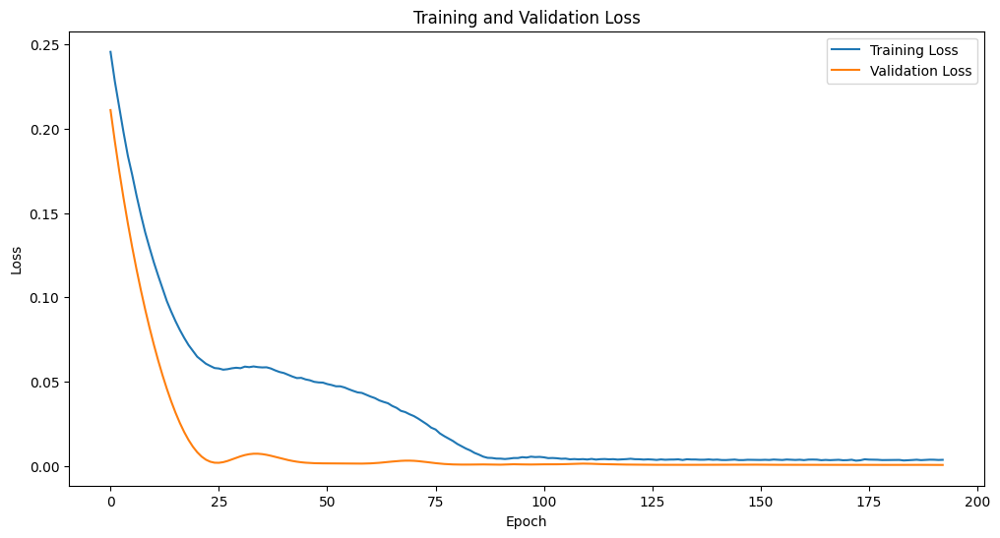

Epoch [1/2500], Train Loss: 0.1479, Val Loss: 0.0970
Epoch [2/2500], Train Loss: 0.1358, Val Loss: 0.0816
Epoch [3/2500], Train Loss: 0.1250, Val Loss: 0.0678
Epoch [4/2500], Train Loss: 0.1156, Val Loss: 0.0557
Epoch [5/2500], Train Loss: 0.1037, Val Loss: 0.0450
Epoch [6/2500], Train Loss: 0.0978, Val Loss: 0.0356
Epoch [7/2500], Train Loss: 0.0885, Val Loss: 0.0276
Epoch [8/2500], Train Loss: 0.0826, Val Loss: 0.0208
Epoch [9/2500], Train Loss: 0.0804, Val Loss: 0.0151
Epoch [10/2500], Train Loss: 0.0749, Val Loss: 0.0106
Epoch [11/2500], Train Loss: 0.0717, Val Loss: 0.0071
Epoch [12/2500], Train Loss: 0.0693, Val Loss: 0.0046
Epoch [13/2500], Train Loss: 0.0664, Val Loss: 0.0029
Epoch [14/2500], Train Loss: 0.0676, Val Loss: 0.0020
Epoch [15/2500], Train Loss: 0.0649, Val Loss: 0.0017
Epoch [16/2500], Train Loss: 0.0641, Val Loss: 0.0020
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0025
Epoch [18/2500], Train Loss: 0.0645, Val Loss: 0.0033
Epoch [19/2500], Train Loss: 0.0664, 

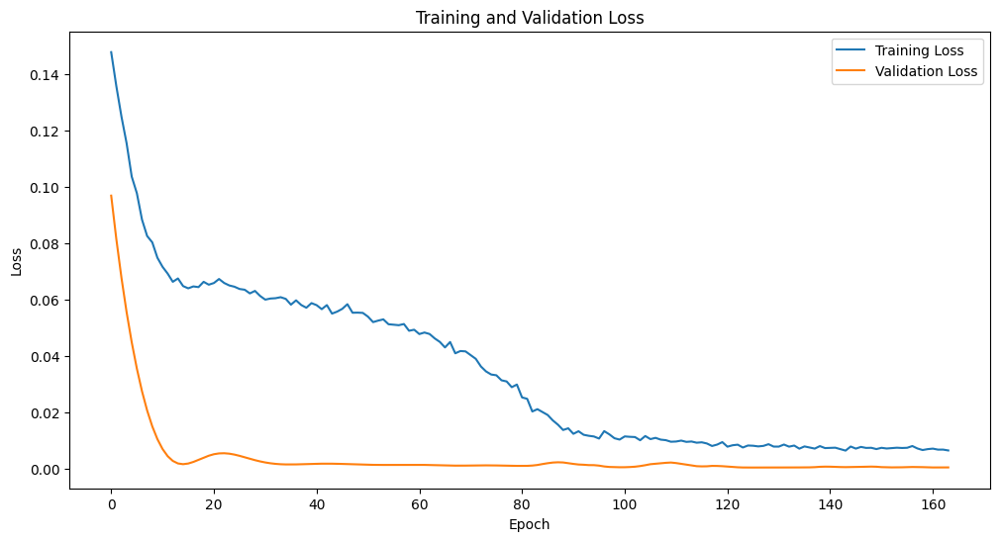

Epoch [1/2500], Train Loss: 0.1252, Val Loss: 0.0795
Epoch [2/2500], Train Loss: 0.1138, Val Loss: 0.0660
Epoch [3/2500], Train Loss: 0.1025, Val Loss: 0.0537
Epoch [4/2500], Train Loss: 0.0943, Val Loss: 0.0425
Epoch [5/2500], Train Loss: 0.0843, Val Loss: 0.0327
Epoch [6/2500], Train Loss: 0.0784, Val Loss: 0.0242
Epoch [7/2500], Train Loss: 0.0730, Val Loss: 0.0171
Epoch [8/2500], Train Loss: 0.0690, Val Loss: 0.0114
Epoch [9/2500], Train Loss: 0.0655, Val Loss: 0.0073
Epoch [10/2500], Train Loss: 0.0648, Val Loss: 0.0045
Epoch [11/2500], Train Loss: 0.0648, Val Loss: 0.0029
Epoch [12/2500], Train Loss: 0.0647, Val Loss: 0.0023
Epoch [13/2500], Train Loss: 0.0661, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0681, Val Loss: 0.0025
Epoch [15/2500], Train Loss: 0.0686, Val Loss: 0.0027
Epoch [16/2500], Train Loss: 0.0686, Val Loss: 0.0028
Epoch [17/2500], Train Loss: 0.0699, Val Loss: 0.0027
Epoch [18/2500], Train Loss: 0.0685, Val Loss: 0.0025
Epoch [19/2500], Train Loss: 0.0679, 

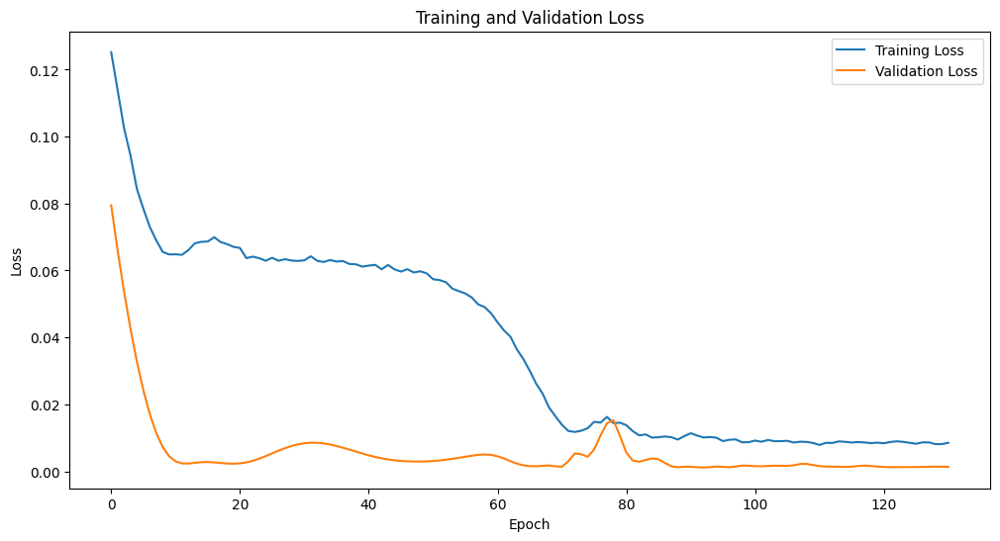

Epoch [1/2500], Train Loss: 0.4316, Val Loss: 0.4098
Epoch [2/2500], Train Loss: 0.4075, Val Loss: 0.3846
Epoch [3/2500], Train Loss: 0.3849, Val Loss: 0.3606
Epoch [4/2500], Train Loss: 0.3626, Val Loss: 0.3378
Epoch [5/2500], Train Loss: 0.3424, Val Loss: 0.3160
Epoch [6/2500], Train Loss: 0.3224, Val Loss: 0.2953
Epoch [7/2500], Train Loss: 0.3044, Val Loss: 0.2755
Epoch [8/2500], Train Loss: 0.2863, Val Loss: 0.2565
Epoch [9/2500], Train Loss: 0.2695, Val Loss: 0.2382
Epoch [10/2500], Train Loss: 0.2540, Val Loss: 0.2206
Epoch [11/2500], Train Loss: 0.2375, Val Loss: 0.2035
Epoch [12/2500], Train Loss: 0.2232, Val Loss: 0.1869
Epoch [13/2500], Train Loss: 0.2084, Val Loss: 0.1708
Epoch [14/2500], Train Loss: 0.1940, Val Loss: 0.1552
Epoch [15/2500], Train Loss: 0.1811, Val Loss: 0.1399
Epoch [16/2500], Train Loss: 0.1681, Val Loss: 0.1251
Epoch [17/2500], Train Loss: 0.1552, Val Loss: 0.1108
Epoch [18/2500], Train Loss: 0.1428, Val Loss: 0.0969
Epoch [19/2500], Train Loss: 0.1318, 

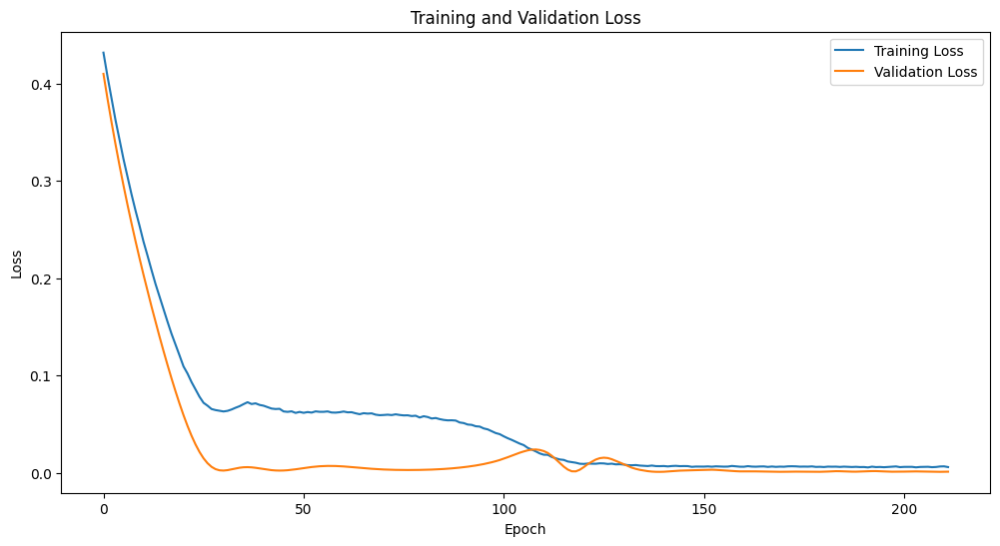

Epoch [1/2500], Train Loss: 0.3067, Val Loss: 0.2729
Epoch [2/2500], Train Loss: 0.2842, Val Loss: 0.2465
Epoch [3/2500], Train Loss: 0.2600, Val Loss: 0.2219
Epoch [4/2500], Train Loss: 0.2392, Val Loss: 0.1991
Epoch [5/2500], Train Loss: 0.2211, Val Loss: 0.1779
Epoch [6/2500], Train Loss: 0.2018, Val Loss: 0.1580
Epoch [7/2500], Train Loss: 0.1864, Val Loss: 0.1395
Epoch [8/2500], Train Loss: 0.1705, Val Loss: 0.1221
Epoch [9/2500], Train Loss: 0.1552, Val Loss: 0.1057
Epoch [10/2500], Train Loss: 0.1434, Val Loss: 0.0904
Epoch [11/2500], Train Loss: 0.1297, Val Loss: 0.0761
Epoch [12/2500], Train Loss: 0.1173, Val Loss: 0.0627
Epoch [13/2500], Train Loss: 0.1084, Val Loss: 0.0505
Epoch [14/2500], Train Loss: 0.0988, Val Loss: 0.0395
Epoch [15/2500], Train Loss: 0.0926, Val Loss: 0.0297
Epoch [16/2500], Train Loss: 0.0850, Val Loss: 0.0213
Epoch [17/2500], Train Loss: 0.0815, Val Loss: 0.0144
Epoch [18/2500], Train Loss: 0.0736, Val Loss: 0.0091
Epoch [19/2500], Train Loss: 0.0716, 

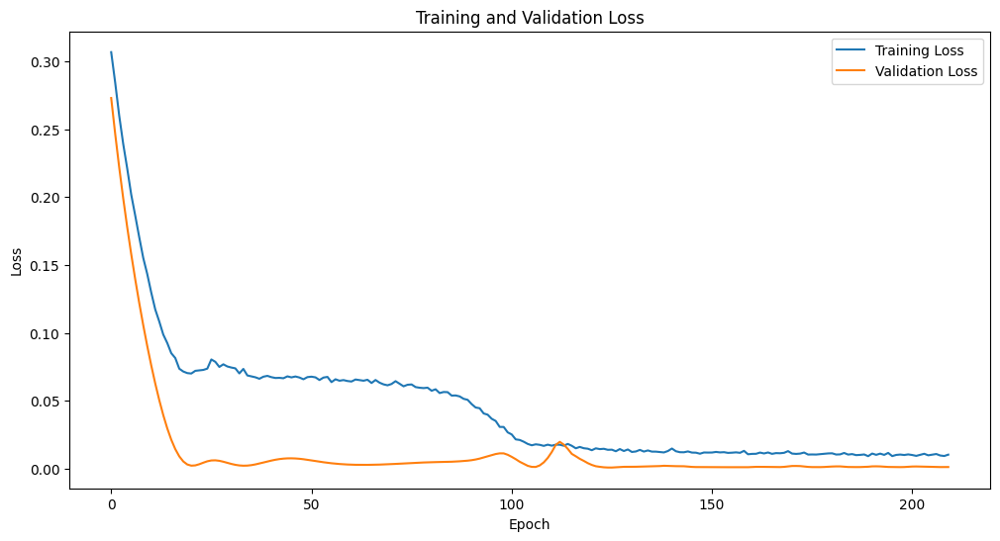

Epoch [1/2500], Train Loss: 0.2081, Val Loss: 0.1736
Epoch [2/2500], Train Loss: 0.1948, Val Loss: 0.1591
Epoch [3/2500], Train Loss: 0.1821, Val Loss: 0.1455
Epoch [4/2500], Train Loss: 0.1703, Val Loss: 0.1327
Epoch [5/2500], Train Loss: 0.1601, Val Loss: 0.1205
Epoch [6/2500], Train Loss: 0.1493, Val Loss: 0.1090
Epoch [7/2500], Train Loss: 0.1400, Val Loss: 0.0981
Epoch [8/2500], Train Loss: 0.1305, Val Loss: 0.0877
Epoch [9/2500], Train Loss: 0.1215, Val Loss: 0.0778
Epoch [10/2500], Train Loss: 0.1150, Val Loss: 0.0684
Epoch [11/2500], Train Loss: 0.1071, Val Loss: 0.0595
Epoch [12/2500], Train Loss: 0.1000, Val Loss: 0.0512
Epoch [13/2500], Train Loss: 0.0935, Val Loss: 0.0433
Epoch [14/2500], Train Loss: 0.0873, Val Loss: 0.0361
Epoch [15/2500], Train Loss: 0.0825, Val Loss: 0.0294
Epoch [16/2500], Train Loss: 0.0781, Val Loss: 0.0234
Epoch [17/2500], Train Loss: 0.0746, Val Loss: 0.0181
Epoch [18/2500], Train Loss: 0.0721, Val Loss: 0.0135
Epoch [19/2500], Train Loss: 0.0686, 

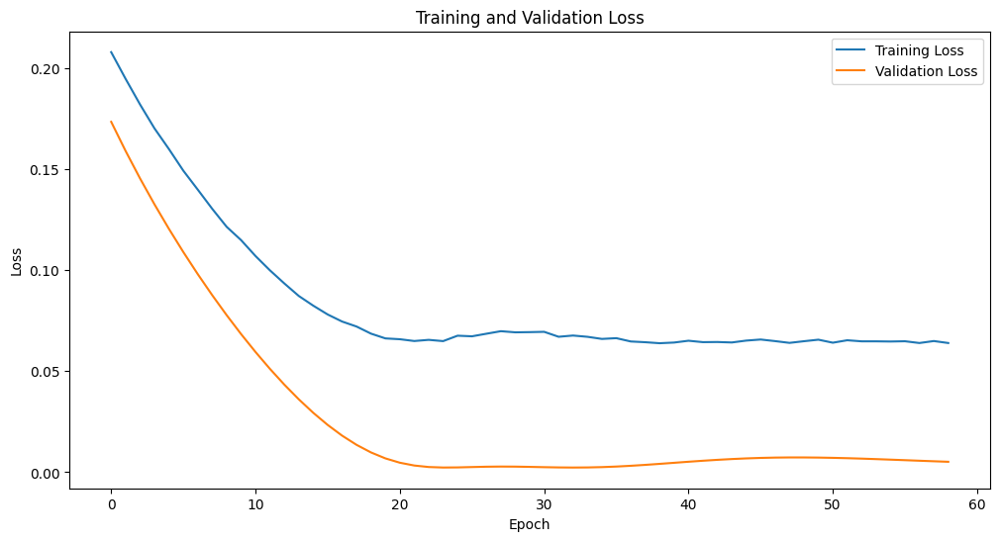

Epoch [1/2500], Train Loss: 0.0968, Val Loss: 0.0443
Epoch [2/2500], Train Loss: 0.0870, Val Loss: 0.0335
Epoch [3/2500], Train Loss: 0.0792, Val Loss: 0.0246
Epoch [4/2500], Train Loss: 0.0731, Val Loss: 0.0174
Epoch [5/2500], Train Loss: 0.0684, Val Loss: 0.0118
Epoch [6/2500], Train Loss: 0.0660, Val Loss: 0.0077
Epoch [7/2500], Train Loss: 0.0641, Val Loss: 0.0050
Epoch [8/2500], Train Loss: 0.0637, Val Loss: 0.0034
Epoch [9/2500], Train Loss: 0.0647, Val Loss: 0.0026
Epoch [10/2500], Train Loss: 0.0652, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0663, Val Loss: 0.0023
Epoch [12/2500], Train Loss: 0.0668, Val Loss: 0.0023
Epoch [13/2500], Train Loss: 0.0672, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0672, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0670, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0662, Val Loss: 0.0024
Epoch [17/2500], Train Loss: 0.0652, Val Loss: 0.0025
Epoch [18/2500], Train Loss: 0.0650, Val Loss: 0.0028
Epoch [19/2500], Train Loss: 0.0647, 

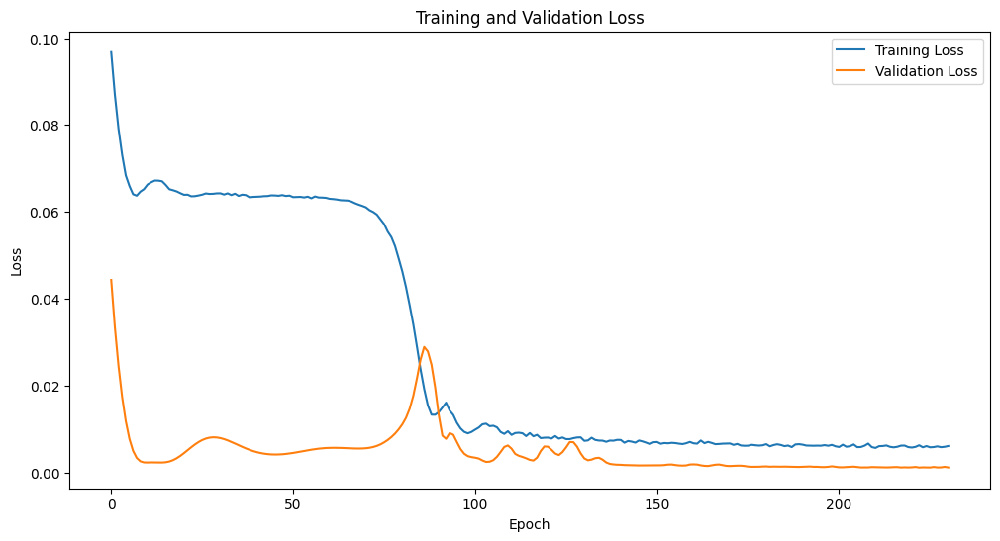

Epoch [1/2500], Train Loss: 0.1713, Val Loss: 0.1284
Epoch [2/2500], Train Loss: 0.1558, Val Loss: 0.1136
Epoch [3/2500], Train Loss: 0.1440, Val Loss: 0.0997
Epoch [4/2500], Train Loss: 0.1311, Val Loss: 0.0868
Epoch [5/2500], Train Loss: 0.1234, Val Loss: 0.0749
Epoch [6/2500], Train Loss: 0.1133, Val Loss: 0.0638
Epoch [7/2500], Train Loss: 0.1052, Val Loss: 0.0537
Epoch [8/2500], Train Loss: 0.0976, Val Loss: 0.0445
Epoch [9/2500], Train Loss: 0.0897, Val Loss: 0.0362
Epoch [10/2500], Train Loss: 0.0861, Val Loss: 0.0288
Epoch [11/2500], Train Loss: 0.0783, Val Loss: 0.0223
Epoch [12/2500], Train Loss: 0.0752, Val Loss: 0.0168
Epoch [13/2500], Train Loss: 0.0734, Val Loss: 0.0123
Epoch [14/2500], Train Loss: 0.0719, Val Loss: 0.0087
Epoch [15/2500], Train Loss: 0.0713, Val Loss: 0.0060
Epoch [16/2500], Train Loss: 0.0673, Val Loss: 0.0041
Epoch [17/2500], Train Loss: 0.0679, Val Loss: 0.0030
Epoch [18/2500], Train Loss: 0.0685, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0671, 

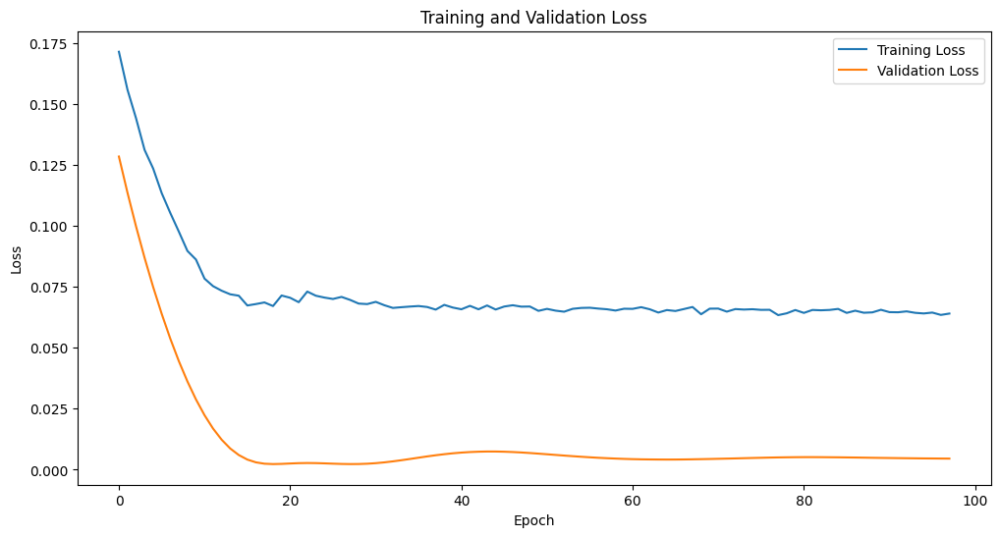

Epoch [1/2500], Train Loss: 0.0955, Val Loss: 0.0454
Epoch [2/2500], Train Loss: 0.0877, Val Loss: 0.0364
Epoch [3/2500], Train Loss: 0.0810, Val Loss: 0.0285
Epoch [4/2500], Train Loss: 0.0761, Val Loss: 0.0217
Epoch [5/2500], Train Loss: 0.0719, Val Loss: 0.0160
Epoch [6/2500], Train Loss: 0.0685, Val Loss: 0.0113
Epoch [7/2500], Train Loss: 0.0663, Val Loss: 0.0078
Epoch [8/2500], Train Loss: 0.0649, Val Loss: 0.0053
Epoch [9/2500], Train Loss: 0.0638, Val Loss: 0.0037
Epoch [10/2500], Train Loss: 0.0643, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0652, Val Loss: 0.0024
Epoch [12/2500], Train Loss: 0.0657, Val Loss: 0.0023
Epoch [13/2500], Train Loss: 0.0675, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0671, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0679, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0672, Val Loss: 0.0023
Epoch [17/2500], Train Loss: 0.0670, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0667, Val Loss: 0.0024
Epoch [19/2500], Train Loss: 0.0659, 

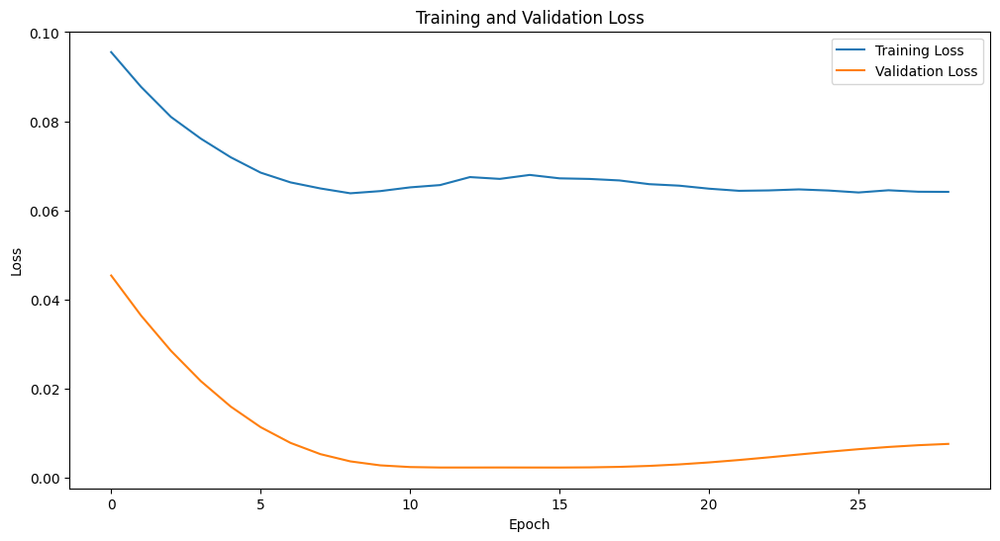

Epoch [1/2500], Train Loss: 0.1502, Val Loss: 0.1085
Epoch [2/2500], Train Loss: 0.1386, Val Loss: 0.0949
Epoch [3/2500], Train Loss: 0.1278, Val Loss: 0.0823
Epoch [4/2500], Train Loss: 0.1175, Val Loss: 0.0706
Epoch [5/2500], Train Loss: 0.1071, Val Loss: 0.0598
Epoch [6/2500], Train Loss: 0.0990, Val Loss: 0.0499
Epoch [7/2500], Train Loss: 0.0916, Val Loss: 0.0409
Epoch [8/2500], Train Loss: 0.0849, Val Loss: 0.0328
Epoch [9/2500], Train Loss: 0.0783, Val Loss: 0.0257
Epoch [10/2500], Train Loss: 0.0739, Val Loss: 0.0195
Epoch [11/2500], Train Loss: 0.0701, Val Loss: 0.0143
Epoch [12/2500], Train Loss: 0.0673, Val Loss: 0.0101
Epoch [13/2500], Train Loss: 0.0650, Val Loss: 0.0069
Epoch [14/2500], Train Loss: 0.0644, Val Loss: 0.0046
Epoch [15/2500], Train Loss: 0.0647, Val Loss: 0.0032
Epoch [16/2500], Train Loss: 0.0645, Val Loss: 0.0025
Epoch [17/2500], Train Loss: 0.0658, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0664, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0672, 

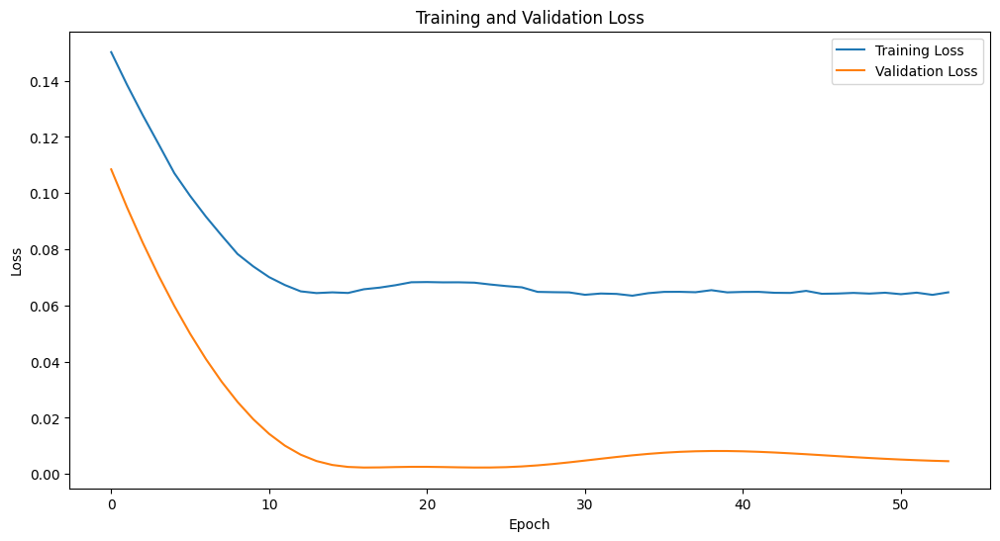

Epoch [1/2500], Train Loss: 0.2045, Val Loss: 0.1660
Epoch [2/2500], Train Loss: 0.1892, Val Loss: 0.1490
Epoch [3/2500], Train Loss: 0.1727, Val Loss: 0.1332
Epoch [4/2500], Train Loss: 0.1601, Val Loss: 0.1185
Epoch [5/2500], Train Loss: 0.1486, Val Loss: 0.1048
Epoch [6/2500], Train Loss: 0.1355, Val Loss: 0.0921
Epoch [7/2500], Train Loss: 0.1253, Val Loss: 0.0803
Epoch [8/2500], Train Loss: 0.1190, Val Loss: 0.0695
Epoch [9/2500], Train Loss: 0.1104, Val Loss: 0.0594
Epoch [10/2500], Train Loss: 0.1019, Val Loss: 0.0503
Epoch [11/2500], Train Loss: 0.0943, Val Loss: 0.0419
Epoch [12/2500], Train Loss: 0.0898, Val Loss: 0.0344
Epoch [13/2500], Train Loss: 0.0827, Val Loss: 0.0277
Epoch [14/2500], Train Loss: 0.0787, Val Loss: 0.0219
Epoch [15/2500], Train Loss: 0.0751, Val Loss: 0.0169
Epoch [16/2500], Train Loss: 0.0704, Val Loss: 0.0127
Epoch [17/2500], Train Loss: 0.0715, Val Loss: 0.0093
Epoch [18/2500], Train Loss: 0.0676, Val Loss: 0.0067
Epoch [19/2500], Train Loss: 0.0667, 

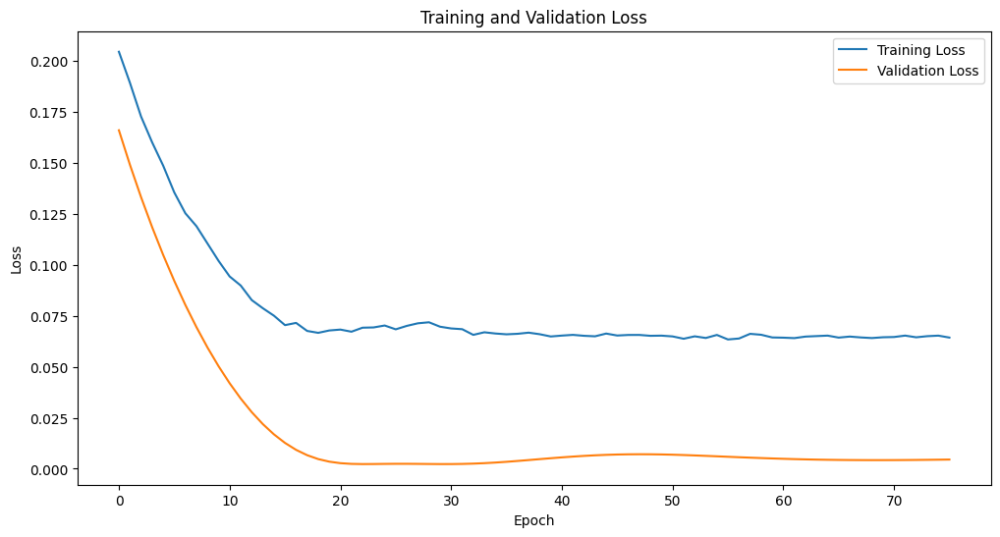

Epoch [1/2500], Train Loss: 0.1141, Val Loss: 0.0628
Epoch [2/2500], Train Loss: 0.0997, Val Loss: 0.0470
Epoch [3/2500], Train Loss: 0.0872, Val Loss: 0.0336
Epoch [4/2500], Train Loss: 0.0771, Val Loss: 0.0226
Epoch [5/2500], Train Loss: 0.0695, Val Loss: 0.0139
Epoch [6/2500], Train Loss: 0.0631, Val Loss: 0.0076
Epoch [7/2500], Train Loss: 0.0589, Val Loss: 0.0037
Epoch [8/2500], Train Loss: 0.0565, Val Loss: 0.0020
Epoch [9/2500], Train Loss: 0.0556, Val Loss: 0.0021
Epoch [10/2500], Train Loss: 0.0565, Val Loss: 0.0032
Epoch [11/2500], Train Loss: 0.0576, Val Loss: 0.0046
Epoch [12/2500], Train Loss: 0.0585, Val Loss: 0.0056
Epoch [13/2500], Train Loss: 0.0579, Val Loss: 0.0059
Epoch [14/2500], Train Loss: 0.0570, Val Loss: 0.0056
Epoch [15/2500], Train Loss: 0.0564, Val Loss: 0.0047
Epoch [16/2500], Train Loss: 0.0547, Val Loss: 0.0037
Epoch [17/2500], Train Loss: 0.0526, Val Loss: 0.0028
Epoch [18/2500], Train Loss: 0.0505, Val Loss: 0.0020
Epoch [19/2500], Train Loss: 0.0489, 

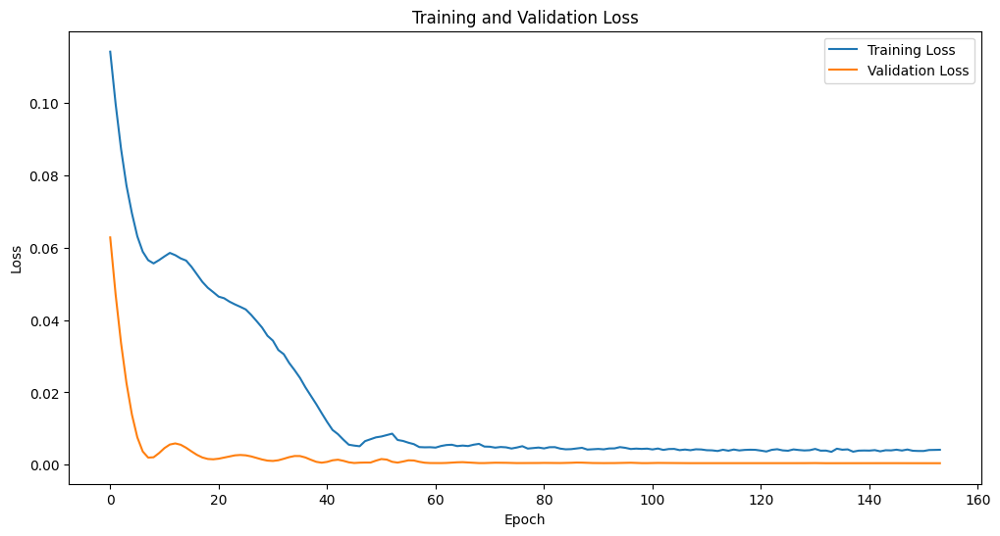

Epoch [1/2500], Train Loss: 0.1049, Val Loss: 0.0390
Epoch [2/2500], Train Loss: 0.0918, Val Loss: 0.0259
Epoch [3/2500], Train Loss: 0.0810, Val Loss: 0.0155
Epoch [4/2500], Train Loss: 0.0728, Val Loss: 0.0080
Epoch [5/2500], Train Loss: 0.0667, Val Loss: 0.0035
Epoch [6/2500], Train Loss: 0.0630, Val Loss: 0.0019
Epoch [7/2500], Train Loss: 0.0619, Val Loss: 0.0026
Epoch [8/2500], Train Loss: 0.0619, Val Loss: 0.0046
Epoch [9/2500], Train Loss: 0.0635, Val Loss: 0.0065
Epoch [10/2500], Train Loss: 0.0641, Val Loss: 0.0074
Epoch [11/2500], Train Loss: 0.0641, Val Loss: 0.0072
Epoch [12/2500], Train Loss: 0.0630, Val Loss: 0.0062
Epoch [13/2500], Train Loss: 0.0614, Val Loss: 0.0047
Epoch [14/2500], Train Loss: 0.0594, Val Loss: 0.0034
Epoch [15/2500], Train Loss: 0.0575, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0554, Val Loss: 0.0018
Epoch [17/2500], Train Loss: 0.0540, Val Loss: 0.0017
Epoch [18/2500], Train Loss: 0.0528, Val Loss: 0.0020
Epoch [19/2500], Train Loss: 0.0522, 

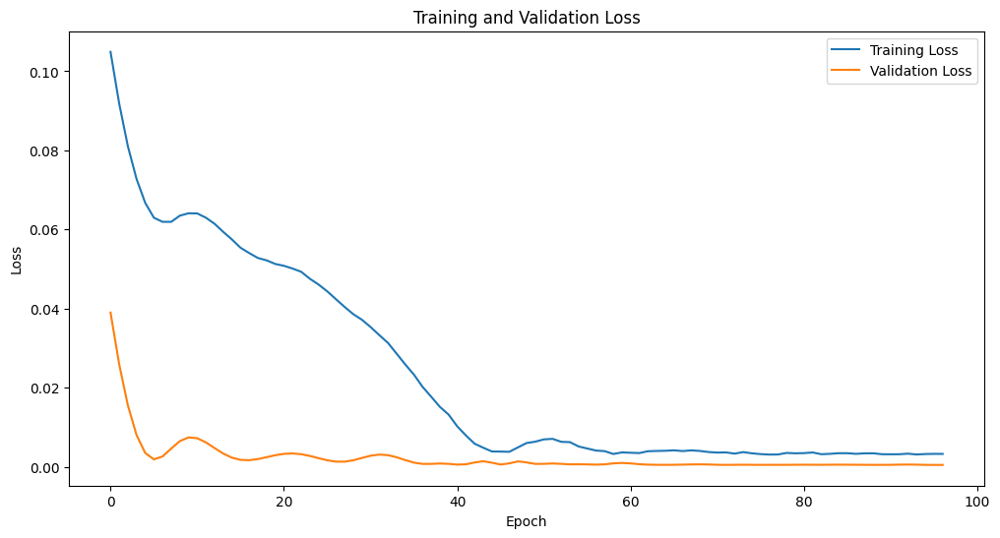

Epoch [1/2500], Train Loss: 0.0796, Val Loss: 0.0226
Epoch [2/2500], Train Loss: 0.0723, Val Loss: 0.0134
Epoch [3/2500], Train Loss: 0.0669, Val Loss: 0.0072
Epoch [4/2500], Train Loss: 0.0636, Val Loss: 0.0037
Epoch [5/2500], Train Loss: 0.0618, Val Loss: 0.0023
Epoch [6/2500], Train Loss: 0.0609, Val Loss: 0.0020
Epoch [7/2500], Train Loss: 0.0616, Val Loss: 0.0022
Epoch [8/2500], Train Loss: 0.0615, Val Loss: 0.0022
Epoch [9/2500], Train Loss: 0.0597, Val Loss: 0.0021
Epoch [10/2500], Train Loss: 0.0588, Val Loss: 0.0019
Epoch [11/2500], Train Loss: 0.0566, Val Loss: 0.0018
Epoch [12/2500], Train Loss: 0.0559, Val Loss: 0.0020
Epoch [13/2500], Train Loss: 0.0547, Val Loss: 0.0024
Epoch [14/2500], Train Loss: 0.0537, Val Loss: 0.0030
Epoch [15/2500], Train Loss: 0.0520, Val Loss: 0.0038
Epoch [16/2500], Train Loss: 0.0511, Val Loss: 0.0046
Epoch [17/2500], Train Loss: 0.0497, Val Loss: 0.0052
Epoch [18/2500], Train Loss: 0.0495, Val Loss: 0.0054
Epoch [19/2500], Train Loss: 0.0488, 

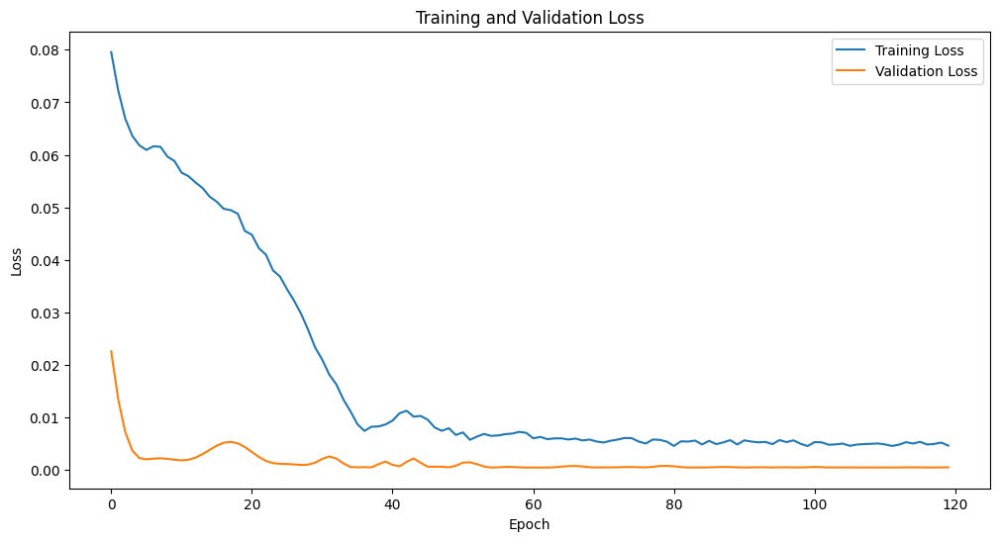

Epoch [1/2500], Train Loss: 0.2181, Val Loss: 0.1571
Epoch [2/2500], Train Loss: 0.1833, Val Loss: 0.1209
Epoch [3/2500], Train Loss: 0.1514, Val Loss: 0.0885
Epoch [4/2500], Train Loss: 0.1253, Val Loss: 0.0602
Epoch [5/2500], Train Loss: 0.1020, Val Loss: 0.0366
Epoch [6/2500], Train Loss: 0.0845, Val Loss: 0.0185
Epoch [7/2500], Train Loss: 0.0720, Val Loss: 0.0069
Epoch [8/2500], Train Loss: 0.0652, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0664, Val Loss: 0.0038
Epoch [10/2500], Train Loss: 0.0713, Val Loss: 0.0079
Epoch [11/2500], Train Loss: 0.0768, Val Loss: 0.0109
Epoch [12/2500], Train Loss: 0.0820, Val Loss: 0.0112
Epoch [13/2500], Train Loss: 0.0815, Val Loss: 0.0093
Epoch [14/2500], Train Loss: 0.0779, Val Loss: 0.0065
Epoch [15/2500], Train Loss: 0.0747, Val Loss: 0.0040
Epoch [16/2500], Train Loss: 0.0708, Val Loss: 0.0025
Epoch [17/2500], Train Loss: 0.0675, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0642, Val Loss: 0.0032
Epoch [19/2500], Train Loss: 0.0639, 

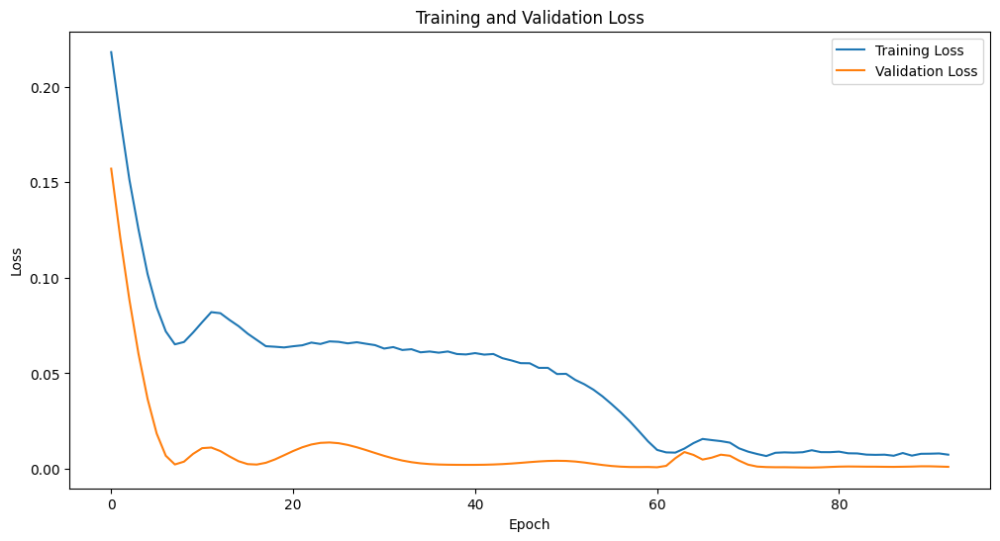

Epoch [1/2500], Train Loss: 0.2128, Val Loss: 0.1565
Epoch [2/2500], Train Loss: 0.1818, Val Loss: 0.1230
Epoch [3/2500], Train Loss: 0.1530, Val Loss: 0.0927
Epoch [4/2500], Train Loss: 0.1282, Val Loss: 0.0658
Epoch [5/2500], Train Loss: 0.1061, Val Loss: 0.0428
Epoch [6/2500], Train Loss: 0.0878, Val Loss: 0.0242
Epoch [7/2500], Train Loss: 0.0745, Val Loss: 0.0109
Epoch [8/2500], Train Loss: 0.0659, Val Loss: 0.0036
Epoch [9/2500], Train Loss: 0.0630, Val Loss: 0.0024
Epoch [10/2500], Train Loss: 0.0661, Val Loss: 0.0052
Epoch [11/2500], Train Loss: 0.0716, Val Loss: 0.0086
Epoch [12/2500], Train Loss: 0.0775, Val Loss: 0.0100
Epoch [13/2500], Train Loss: 0.0794, Val Loss: 0.0092
Epoch [14/2500], Train Loss: 0.0778, Val Loss: 0.0069
Epoch [15/2500], Train Loss: 0.0755, Val Loss: 0.0045
Epoch [16/2500], Train Loss: 0.0704, Val Loss: 0.0027
Epoch [17/2500], Train Loss: 0.0668, Val Loss: 0.0022
Epoch [18/2500], Train Loss: 0.0643, Val Loss: 0.0028
Epoch [19/2500], Train Loss: 0.0627, 

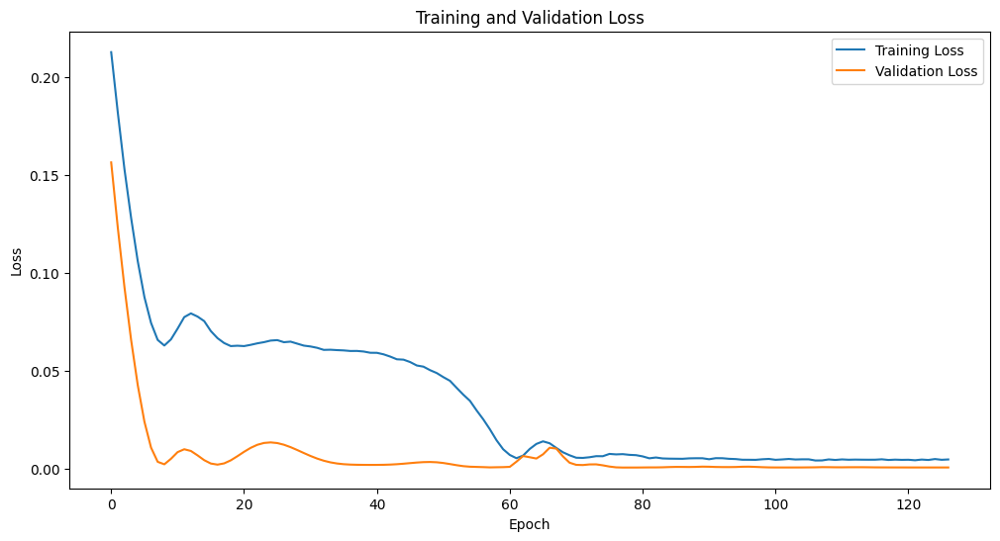

Epoch [1/2500], Train Loss: 0.1278, Val Loss: 0.0730
Epoch [2/2500], Train Loss: 0.1101, Val Loss: 0.0536
Epoch [3/2500], Train Loss: 0.0943, Val Loss: 0.0374
Epoch [4/2500], Train Loss: 0.0827, Val Loss: 0.0243
Epoch [5/2500], Train Loss: 0.0747, Val Loss: 0.0142
Epoch [6/2500], Train Loss: 0.0684, Val Loss: 0.0073
Epoch [7/2500], Train Loss: 0.0656, Val Loss: 0.0034
Epoch [8/2500], Train Loss: 0.0645, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0657, Val Loss: 0.0027
Epoch [10/2500], Train Loss: 0.0683, Val Loss: 0.0035
Epoch [11/2500], Train Loss: 0.0710, Val Loss: 0.0038
Epoch [12/2500], Train Loss: 0.0711, Val Loss: 0.0035
Epoch [13/2500], Train Loss: 0.0714, Val Loss: 0.0029
Epoch [14/2500], Train Loss: 0.0694, Val Loss: 0.0024
Epoch [15/2500], Train Loss: 0.0674, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0664, Val Loss: 0.0026
Epoch [17/2500], Train Loss: 0.0649, Val Loss: 0.0034
Epoch [18/2500], Train Loss: 0.0643, Val Loss: 0.0046
Epoch [19/2500], Train Loss: 0.0630, 

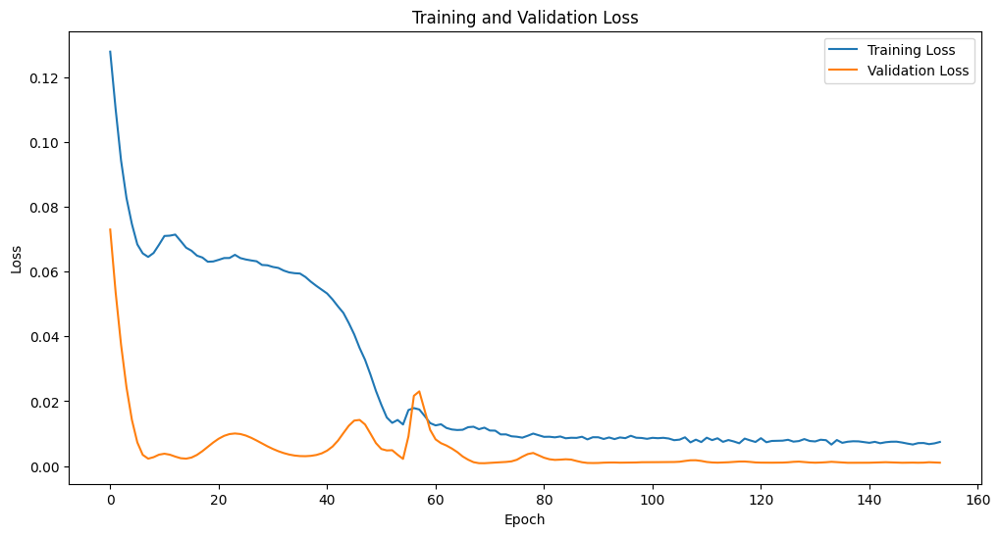

Epoch [1/2500], Train Loss: 0.2539, Val Loss: 0.1997
Epoch [2/2500], Train Loss: 0.2163, Val Loss: 0.1614
Epoch [3/2500], Train Loss: 0.1842, Val Loss: 0.1265
Epoch [4/2500], Train Loss: 0.1532, Val Loss: 0.0948
Epoch [5/2500], Train Loss: 0.1286, Val Loss: 0.0668
Epoch [6/2500], Train Loss: 0.1058, Val Loss: 0.0429
Epoch [7/2500], Train Loss: 0.0878, Val Loss: 0.0237
Epoch [8/2500], Train Loss: 0.0755, Val Loss: 0.0103
Epoch [9/2500], Train Loss: 0.0670, Val Loss: 0.0033
Epoch [10/2500], Train Loss: 0.0647, Val Loss: 0.0027
Epoch [11/2500], Train Loss: 0.0695, Val Loss: 0.0059
Epoch [12/2500], Train Loss: 0.0758, Val Loss: 0.0093
Epoch [13/2500], Train Loss: 0.0809, Val Loss: 0.0105
Epoch [14/2500], Train Loss: 0.0852, Val Loss: 0.0094
Epoch [15/2500], Train Loss: 0.0828, Val Loss: 0.0070
Epoch [16/2500], Train Loss: 0.0797, Val Loss: 0.0045
Epoch [17/2500], Train Loss: 0.0730, Val Loss: 0.0028
Epoch [18/2500], Train Loss: 0.0698, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0670, 

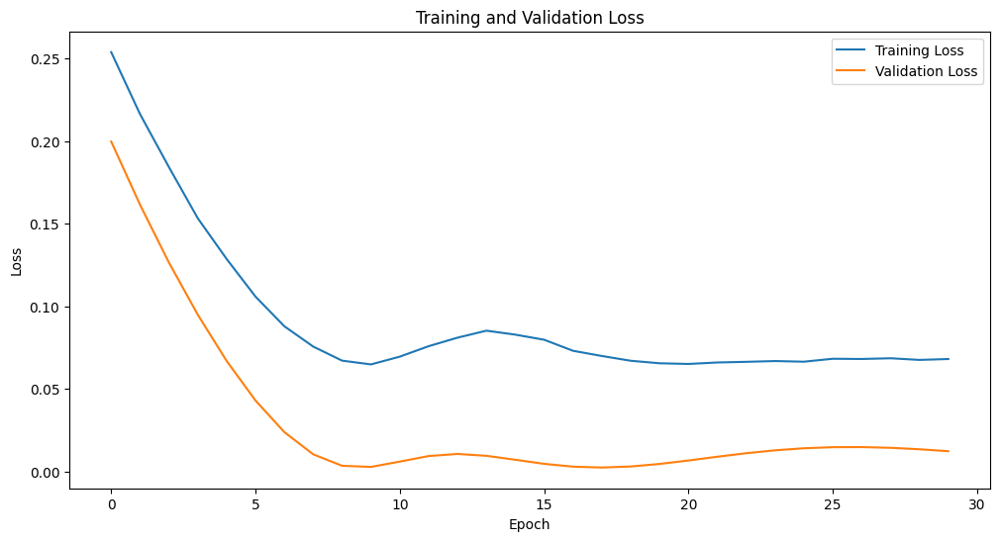

Epoch [1/2500], Train Loss: 0.2699, Val Loss: 0.2220
Epoch [2/2500], Train Loss: 0.2360, Val Loss: 0.1881
Epoch [3/2500], Train Loss: 0.2068, Val Loss: 0.1568
Epoch [4/2500], Train Loss: 0.1796, Val Loss: 0.1281
Epoch [5/2500], Train Loss: 0.1550, Val Loss: 0.1016
Epoch [6/2500], Train Loss: 0.1326, Val Loss: 0.0776
Epoch [7/2500], Train Loss: 0.1131, Val Loss: 0.0559
Epoch [8/2500], Train Loss: 0.0961, Val Loss: 0.0372
Epoch [9/2500], Train Loss: 0.0817, Val Loss: 0.0217
Epoch [10/2500], Train Loss: 0.0722, Val Loss: 0.0104
Epoch [11/2500], Train Loss: 0.0651, Val Loss: 0.0039
Epoch [12/2500], Train Loss: 0.0639, Val Loss: 0.0023
Epoch [13/2500], Train Loss: 0.0674, Val Loss: 0.0041
Epoch [14/2500], Train Loss: 0.0725, Val Loss: 0.0066
Epoch [15/2500], Train Loss: 0.0769, Val Loss: 0.0078
Epoch [16/2500], Train Loss: 0.0789, Val Loss: 0.0072
Epoch [17/2500], Train Loss: 0.0783, Val Loss: 0.0056
Epoch [18/2500], Train Loss: 0.0749, Val Loss: 0.0038
Epoch [19/2500], Train Loss: 0.0714, 

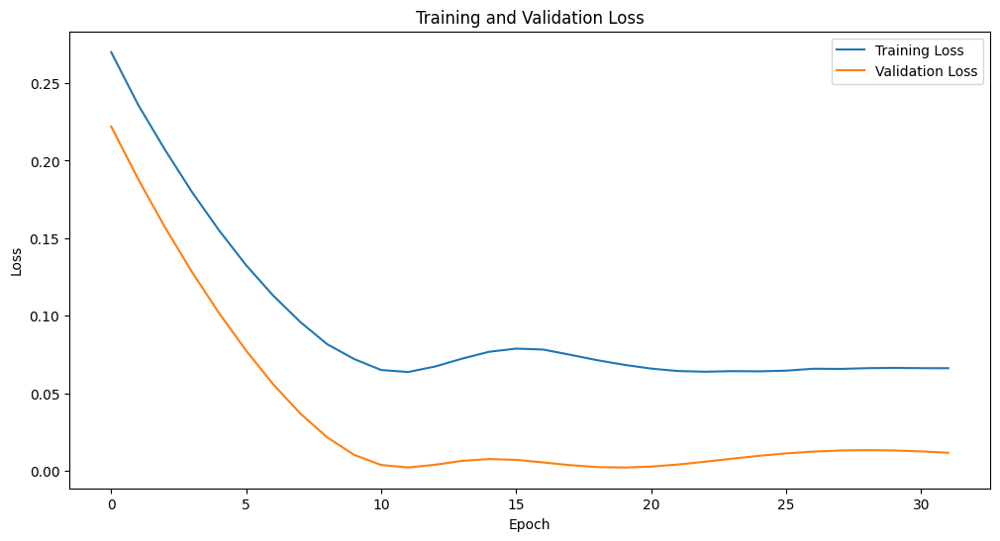

Epoch [1/2500], Train Loss: 0.1259, Val Loss: 0.0686
Epoch [2/2500], Train Loss: 0.1058, Val Loss: 0.0480
Epoch [3/2500], Train Loss: 0.0899, Val Loss: 0.0315
Epoch [4/2500], Train Loss: 0.0793, Val Loss: 0.0187
Epoch [5/2500], Train Loss: 0.0706, Val Loss: 0.0097
Epoch [6/2500], Train Loss: 0.0664, Val Loss: 0.0044
Epoch [7/2500], Train Loss: 0.0646, Val Loss: 0.0024
Epoch [8/2500], Train Loss: 0.0663, Val Loss: 0.0025
Epoch [9/2500], Train Loss: 0.0684, Val Loss: 0.0032
Epoch [10/2500], Train Loss: 0.0710, Val Loss: 0.0035
Epoch [11/2500], Train Loss: 0.0709, Val Loss: 0.0032
Epoch [12/2500], Train Loss: 0.0715, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0691, Val Loss: 0.0024
Epoch [14/2500], Train Loss: 0.0668, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0664, Val Loss: 0.0027
Epoch [16/2500], Train Loss: 0.0657, Val Loss: 0.0035
Epoch [17/2500], Train Loss: 0.0643, Val Loss: 0.0046
Epoch [18/2500], Train Loss: 0.0640, Val Loss: 0.0059
Epoch [19/2500], Train Loss: 0.0646, 

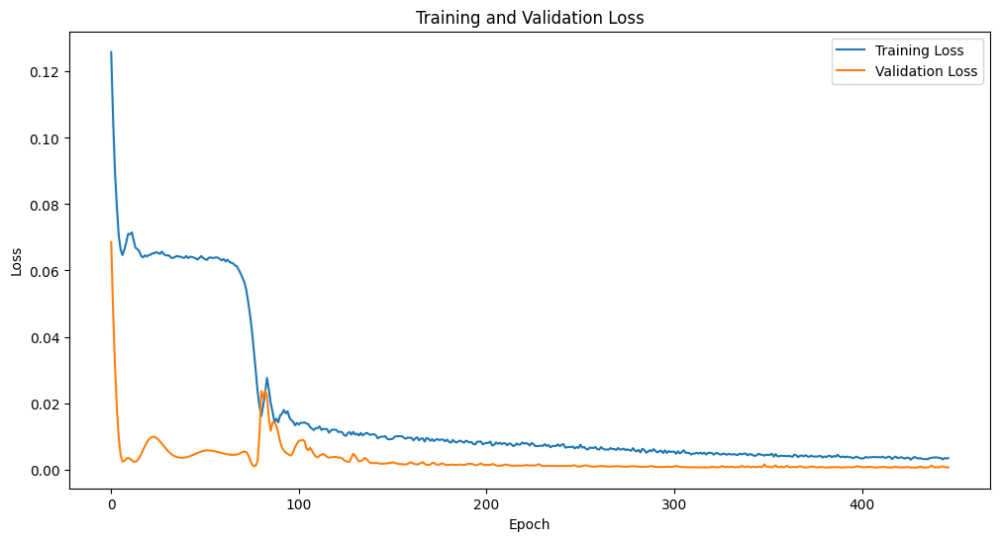

Epoch [1/2500], Train Loss: 0.0957, Val Loss: 0.0370
Epoch [2/2500], Train Loss: 0.0818, Val Loss: 0.0217
Epoch [3/2500], Train Loss: 0.0716, Val Loss: 0.0108
Epoch [4/2500], Train Loss: 0.0663, Val Loss: 0.0045
Epoch [5/2500], Train Loss: 0.0640, Val Loss: 0.0024
Epoch [6/2500], Train Loss: 0.0665, Val Loss: 0.0026
Epoch [7/2500], Train Loss: 0.0689, Val Loss: 0.0029
Epoch [8/2500], Train Loss: 0.0699, Val Loss: 0.0027
Epoch [9/2500], Train Loss: 0.0699, Val Loss: 0.0024
Epoch [10/2500], Train Loss: 0.0674, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0660, Val Loss: 0.0028
Epoch [12/2500], Train Loss: 0.0653, Val Loss: 0.0038
Epoch [13/2500], Train Loss: 0.0635, Val Loss: 0.0052
Epoch [14/2500], Train Loss: 0.0645, Val Loss: 0.0066
Epoch [15/2500], Train Loss: 0.0641, Val Loss: 0.0080
Epoch [16/2500], Train Loss: 0.0647, Val Loss: 0.0091
Epoch [17/2500], Train Loss: 0.0644, Val Loss: 0.0099
Epoch [18/2500], Train Loss: 0.0650, Val Loss: 0.0102
Epoch [19/2500], Train Loss: 0.0651, 

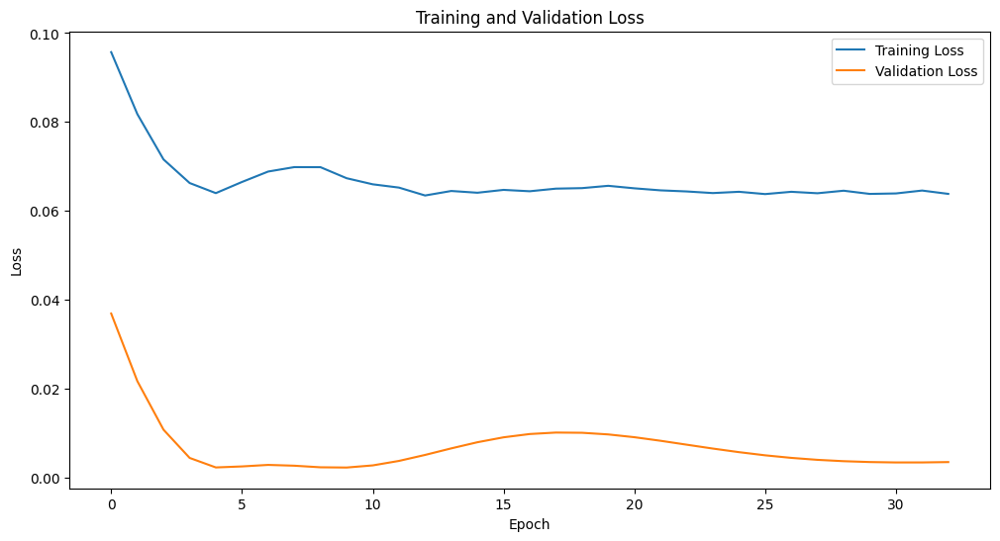

Epoch [1/2500], Train Loss: 0.0860, Val Loss: 0.0282
Epoch [2/2500], Train Loss: 0.0753, Val Loss: 0.0164
Epoch [3/2500], Train Loss: 0.0681, Val Loss: 0.0081
Epoch [4/2500], Train Loss: 0.0641, Val Loss: 0.0036
Epoch [5/2500], Train Loss: 0.0640, Val Loss: 0.0023
Epoch [6/2500], Train Loss: 0.0660, Val Loss: 0.0024
Epoch [7/2500], Train Loss: 0.0680, Val Loss: 0.0025
Epoch [8/2500], Train Loss: 0.0684, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0676, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0661, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0647, Val Loss: 0.0038
Epoch [12/2500], Train Loss: 0.0640, Val Loss: 0.0052
Epoch [13/2500], Train Loss: 0.0637, Val Loss: 0.0067
Epoch [14/2500], Train Loss: 0.0637, Val Loss: 0.0081
Epoch [15/2500], Train Loss: 0.0642, Val Loss: 0.0092
Epoch [16/2500], Train Loss: 0.0648, Val Loss: 0.0098
Epoch [17/2500], Train Loss: 0.0650, Val Loss: 0.0100
Epoch [18/2500], Train Loss: 0.0649, Val Loss: 0.0097
Epoch [19/2500], Train Loss: 0.0649, 

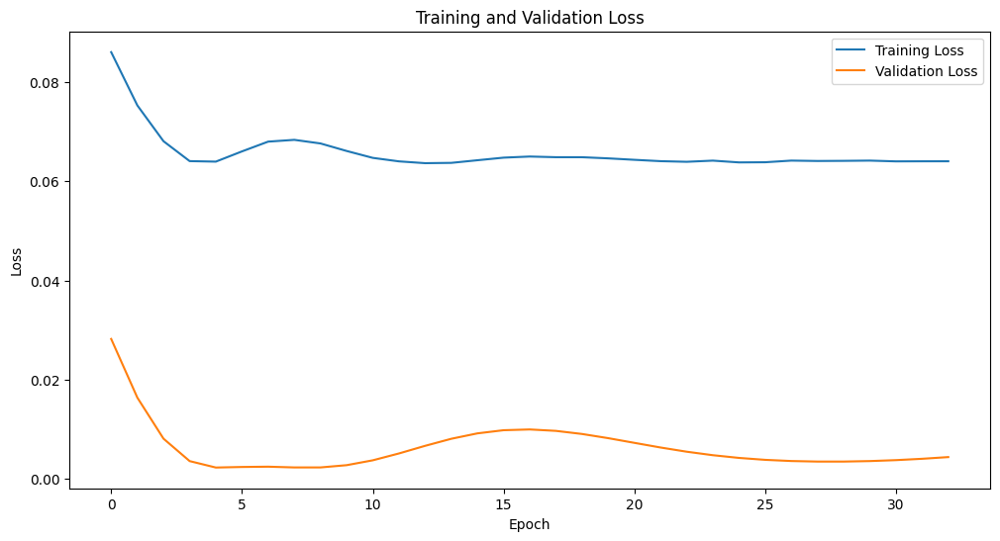

Epoch [1/2500], Train Loss: 0.1755, Val Loss: 0.1185
Epoch [2/2500], Train Loss: 0.1476, Val Loss: 0.0893
Epoch [3/2500], Train Loss: 0.1238, Val Loss: 0.0636
Epoch [4/2500], Train Loss: 0.1043, Val Loss: 0.0417
Epoch [5/2500], Train Loss: 0.0874, Val Loss: 0.0241
Epoch [6/2500], Train Loss: 0.0767, Val Loss: 0.0114
Epoch [7/2500], Train Loss: 0.0688, Val Loss: 0.0042
Epoch [8/2500], Train Loss: 0.0662, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0681, Val Loss: 0.0040
Epoch [10/2500], Train Loss: 0.0736, Val Loss: 0.0061
Epoch [11/2500], Train Loss: 0.0761, Val Loss: 0.0070
Epoch [12/2500], Train Loss: 0.0785, Val Loss: 0.0063
Epoch [13/2500], Train Loss: 0.0789, Val Loss: 0.0047
Epoch [14/2500], Train Loss: 0.0732, Val Loss: 0.0032
Epoch [15/2500], Train Loss: 0.0714, Val Loss: 0.0024
Epoch [16/2500], Train Loss: 0.0683, Val Loss: 0.0024
Epoch [17/2500], Train Loss: 0.0665, Val Loss: 0.0033
Epoch [18/2500], Train Loss: 0.0665, Val Loss: 0.0047
Epoch [19/2500], Train Loss: 0.0647, 

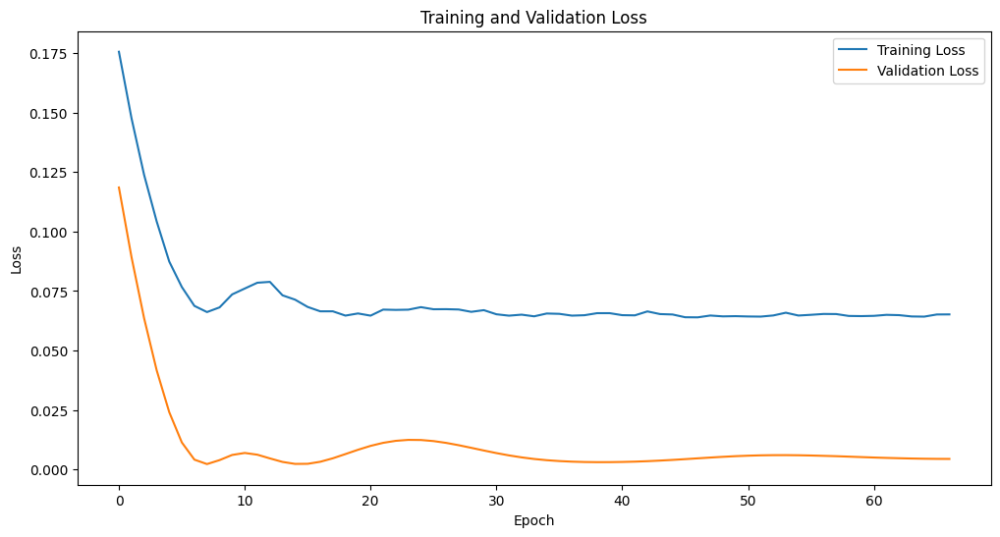

Epoch [1/2500], Train Loss: 0.1757, Val Loss: 0.1140
Epoch [2/2500], Train Loss: 0.1345, Val Loss: 0.0704
Epoch [3/2500], Train Loss: 0.1022, Val Loss: 0.0360
Epoch [4/2500], Train Loss: 0.0774, Val Loss: 0.0126
Epoch [5/2500], Train Loss: 0.0628, Val Loss: 0.0023
Epoch [6/2500], Train Loss: 0.0576, Val Loss: 0.0050
Epoch [7/2500], Train Loss: 0.0621, Val Loss: 0.0130
Epoch [8/2500], Train Loss: 0.0707, Val Loss: 0.0167
Epoch [9/2500], Train Loss: 0.0727, Val Loss: 0.0146
Epoch [10/2500], Train Loss: 0.0698, Val Loss: 0.0094
Epoch [11/2500], Train Loss: 0.0638, Val Loss: 0.0046
Epoch [12/2500], Train Loss: 0.0571, Val Loss: 0.0020
Epoch [13/2500], Train Loss: 0.0527, Val Loss: 0.0020
Epoch [14/2500], Train Loss: 0.0500, Val Loss: 0.0039
Epoch [15/2500], Train Loss: 0.0509, Val Loss: 0.0068
Epoch [16/2500], Train Loss: 0.0508, Val Loss: 0.0095
Epoch [17/2500], Train Loss: 0.0510, Val Loss: 0.0113
Epoch [18/2500], Train Loss: 0.0514, Val Loss: 0.0119
Epoch [19/2500], Train Loss: 0.0508, 

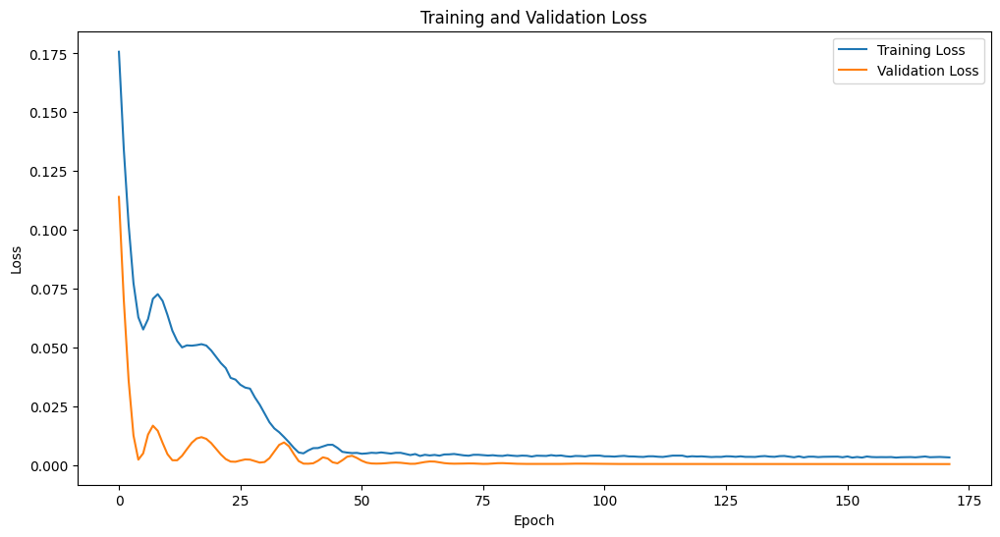

Epoch [1/2500], Train Loss: 0.1892, Val Loss: 0.1065
Epoch [2/2500], Train Loss: 0.1442, Val Loss: 0.0616
Epoch [3/2500], Train Loss: 0.1086, Val Loss: 0.0282
Epoch [4/2500], Train Loss: 0.0828, Val Loss: 0.0078
Epoch [5/2500], Train Loss: 0.0673, Val Loss: 0.0019
Epoch [6/2500], Train Loss: 0.0631, Val Loss: 0.0090
Epoch [7/2500], Train Loss: 0.0681, Val Loss: 0.0190
Epoch [8/2500], Train Loss: 0.0752, Val Loss: 0.0225
Epoch [9/2500], Train Loss: 0.0776, Val Loss: 0.0190
Epoch [10/2500], Train Loss: 0.0746, Val Loss: 0.0124
Epoch [11/2500], Train Loss: 0.0689, Val Loss: 0.0063
Epoch [12/2500], Train Loss: 0.0629, Val Loss: 0.0026
Epoch [13/2500], Train Loss: 0.0588, Val Loss: 0.0018
Epoch [14/2500], Train Loss: 0.0565, Val Loss: 0.0032
Epoch [15/2500], Train Loss: 0.0556, Val Loss: 0.0057
Epoch [16/2500], Train Loss: 0.0561, Val Loss: 0.0083
Epoch [17/2500], Train Loss: 0.0567, Val Loss: 0.0103
Epoch [18/2500], Train Loss: 0.0569, Val Loss: 0.0113
Epoch [19/2500], Train Loss: 0.0567, 

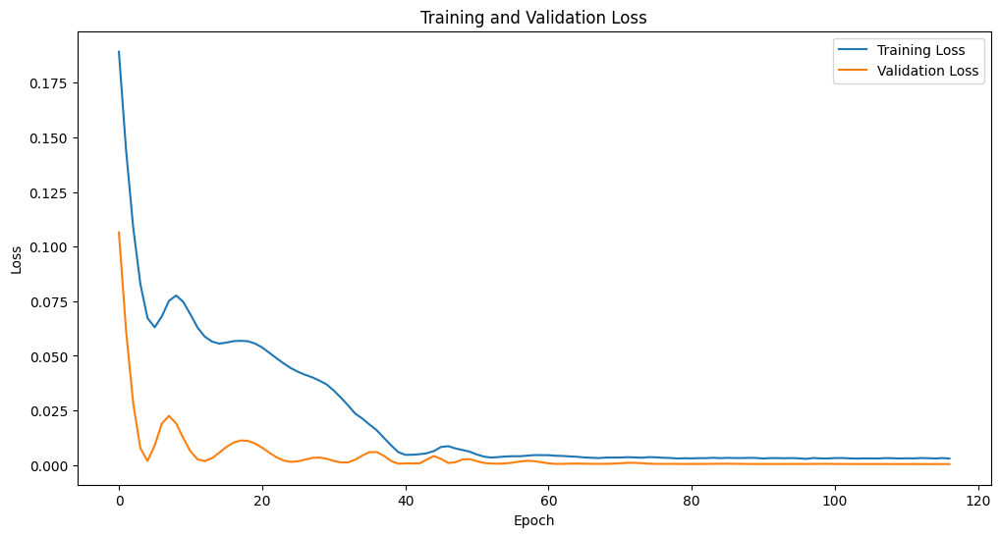

Epoch [1/2500], Train Loss: 0.0839, Val Loss: 0.0133
Epoch [2/2500], Train Loss: 0.0694, Val Loss: 0.0033
Epoch [3/2500], Train Loss: 0.0641, Val Loss: 0.0024
Epoch [4/2500], Train Loss: 0.0640, Val Loss: 0.0042
Epoch [5/2500], Train Loss: 0.0654, Val Loss: 0.0043
Epoch [6/2500], Train Loss: 0.0635, Val Loss: 0.0030
Epoch [7/2500], Train Loss: 0.0596, Val Loss: 0.0020
Epoch [8/2500], Train Loss: 0.0559, Val Loss: 0.0020
Epoch [9/2500], Train Loss: 0.0541, Val Loss: 0.0030
Epoch [10/2500], Train Loss: 0.0520, Val Loss: 0.0044
Epoch [11/2500], Train Loss: 0.0515, Val Loss: 0.0056
Epoch [12/2500], Train Loss: 0.0500, Val Loss: 0.0058
Epoch [13/2500], Train Loss: 0.0490, Val Loss: 0.0051
Epoch [14/2500], Train Loss: 0.0453, Val Loss: 0.0037
Epoch [15/2500], Train Loss: 0.0416, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0384, Val Loss: 0.0014
Epoch [17/2500], Train Loss: 0.0347, Val Loss: 0.0013
Epoch [18/2500], Train Loss: 0.0319, Val Loss: 0.0015
Epoch [19/2500], Train Loss: 0.0291, 

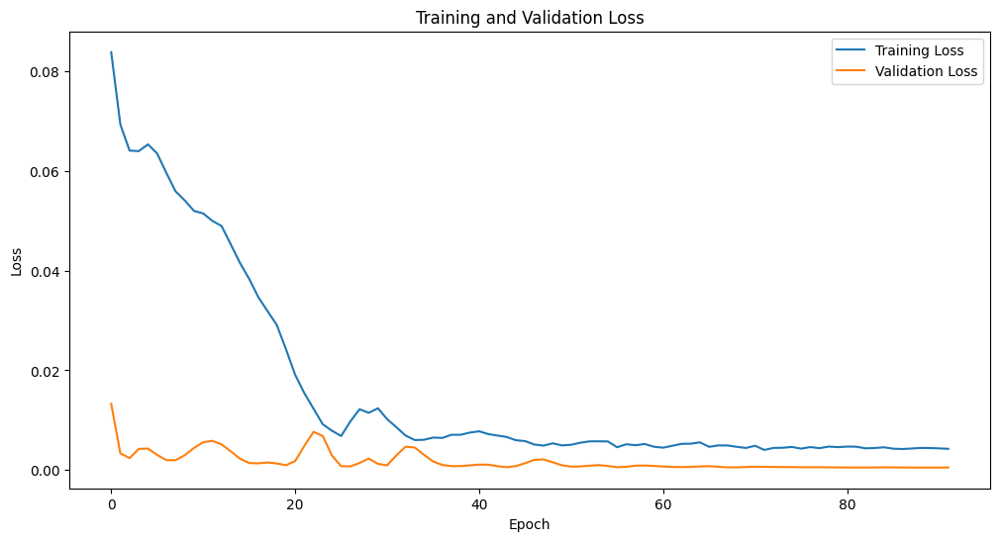

Epoch [1/2500], Train Loss: 0.1329, Val Loss: 0.0596
Epoch [2/2500], Train Loss: 0.0999, Val Loss: 0.0296
Epoch [3/2500], Train Loss: 0.0772, Val Loss: 0.0102
Epoch [4/2500], Train Loss: 0.0650, Val Loss: 0.0024
Epoch [5/2500], Train Loss: 0.0635, Val Loss: 0.0042
Epoch [6/2500], Train Loss: 0.0706, Val Loss: 0.0063
Epoch [7/2500], Train Loss: 0.0734, Val Loss: 0.0050
Epoch [8/2500], Train Loss: 0.0722, Val Loss: 0.0029
Epoch [9/2500], Train Loss: 0.0676, Val Loss: 0.0022
Epoch [10/2500], Train Loss: 0.0643, Val Loss: 0.0035
Epoch [11/2500], Train Loss: 0.0626, Val Loss: 0.0061
Epoch [12/2500], Train Loss: 0.0622, Val Loss: 0.0090
Epoch [13/2500], Train Loss: 0.0630, Val Loss: 0.0115
Epoch [14/2500], Train Loss: 0.0638, Val Loss: 0.0129
Epoch [15/2500], Train Loss: 0.0641, Val Loss: 0.0131
Epoch [16/2500], Train Loss: 0.0639, Val Loss: 0.0123
Epoch [17/2500], Train Loss: 0.0629, Val Loss: 0.0107
Epoch [18/2500], Train Loss: 0.0617, Val Loss: 0.0087
Epoch [19/2500], Train Loss: 0.0603, 

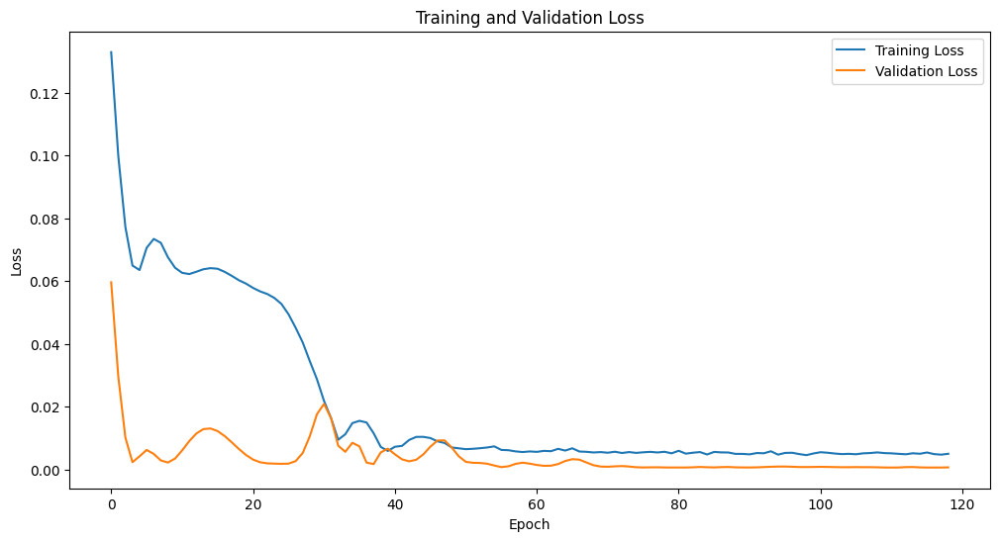

Epoch [1/2500], Train Loss: 0.1545, Val Loss: 0.0832
Epoch [2/2500], Train Loss: 0.1174, Val Loss: 0.0482
Epoch [3/2500], Train Loss: 0.0904, Val Loss: 0.0224
Epoch [4/2500], Train Loss: 0.0724, Val Loss: 0.0067
Epoch [5/2500], Train Loss: 0.0640, Val Loss: 0.0023
Epoch [6/2500], Train Loss: 0.0664, Val Loss: 0.0052
Epoch [7/2500], Train Loss: 0.0732, Val Loss: 0.0069
Epoch [8/2500], Train Loss: 0.0756, Val Loss: 0.0055
Epoch [9/2500], Train Loss: 0.0735, Val Loss: 0.0033
Epoch [10/2500], Train Loss: 0.0688, Val Loss: 0.0022
Epoch [11/2500], Train Loss: 0.0651, Val Loss: 0.0029
Epoch [12/2500], Train Loss: 0.0629, Val Loss: 0.0050
Epoch [13/2500], Train Loss: 0.0627, Val Loss: 0.0077
Epoch [14/2500], Train Loss: 0.0627, Val Loss: 0.0103
Epoch [15/2500], Train Loss: 0.0636, Val Loss: 0.0122
Epoch [16/2500], Train Loss: 0.0642, Val Loss: 0.0132
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0132
Epoch [18/2500], Train Loss: 0.0644, Val Loss: 0.0123
Epoch [19/2500], Train Loss: 0.0640, 

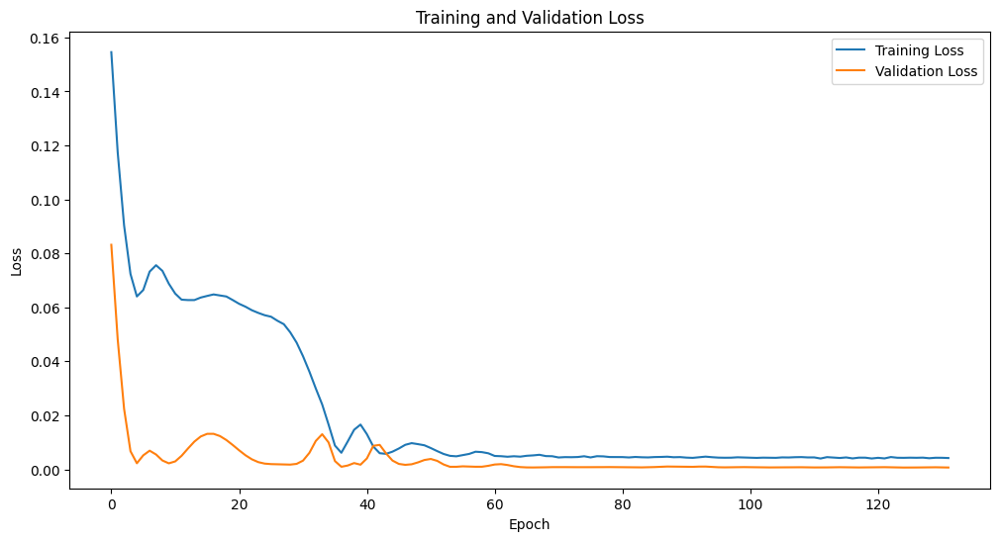

Epoch [1/2500], Train Loss: 0.0805, Val Loss: 0.0118
Epoch [2/2500], Train Loss: 0.0664, Val Loss: 0.0027
Epoch [3/2500], Train Loss: 0.0647, Val Loss: 0.0027
Epoch [4/2500], Train Loss: 0.0690, Val Loss: 0.0027
Epoch [5/2500], Train Loss: 0.0684, Val Loss: 0.0022
Epoch [6/2500], Train Loss: 0.0661, Val Loss: 0.0029
Epoch [7/2500], Train Loss: 0.0636, Val Loss: 0.0052
Epoch [8/2500], Train Loss: 0.0634, Val Loss: 0.0079
Epoch [9/2500], Train Loss: 0.0635, Val Loss: 0.0100
Epoch [10/2500], Train Loss: 0.0642, Val Loss: 0.0108
Epoch [11/2500], Train Loss: 0.0640, Val Loss: 0.0101
Epoch [12/2500], Train Loss: 0.0633, Val Loss: 0.0083
Epoch [13/2500], Train Loss: 0.0619, Val Loss: 0.0061
Epoch [14/2500], Train Loss: 0.0611, Val Loss: 0.0040
Epoch [15/2500], Train Loss: 0.0599, Val Loss: 0.0025
Epoch [16/2500], Train Loss: 0.0590, Val Loss: 0.0019
Epoch [17/2500], Train Loss: 0.0577, Val Loss: 0.0019
Epoch [18/2500], Train Loss: 0.0565, Val Loss: 0.0019
Epoch [19/2500], Train Loss: 0.0537, 

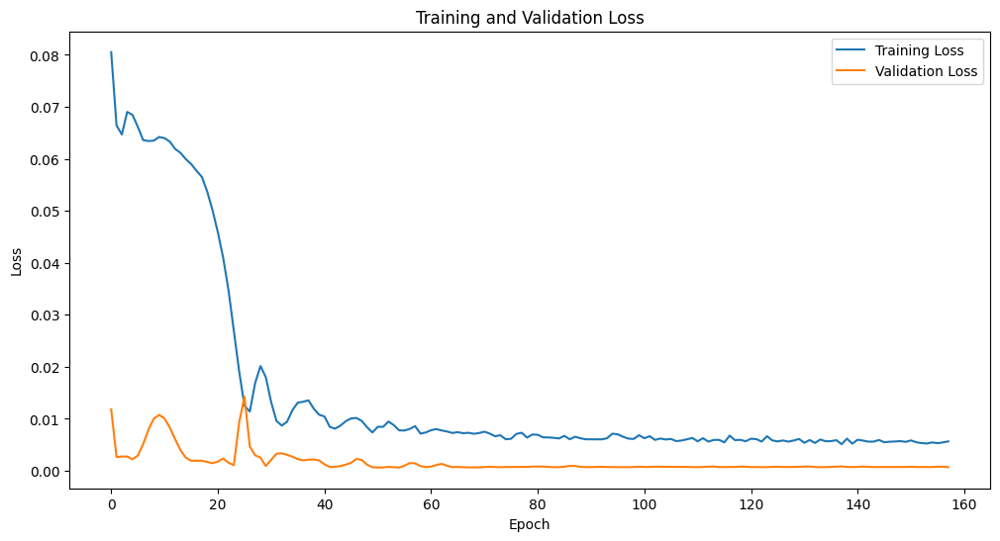

Epoch [1/2500], Train Loss: 0.1372, Val Loss: 0.0638
Epoch [2/2500], Train Loss: 0.1019, Val Loss: 0.0327
Epoch [3/2500], Train Loss: 0.0785, Val Loss: 0.0126
Epoch [4/2500], Train Loss: 0.0661, Val Loss: 0.0032
Epoch [5/2500], Train Loss: 0.0636, Val Loss: 0.0030
Epoch [6/2500], Train Loss: 0.0702, Val Loss: 0.0048
Epoch [7/2500], Train Loss: 0.0747, Val Loss: 0.0044
Epoch [8/2500], Train Loss: 0.0732, Val Loss: 0.0029
Epoch [9/2500], Train Loss: 0.0701, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0665, Val Loss: 0.0031
Epoch [11/2500], Train Loss: 0.0644, Val Loss: 0.0051
Epoch [12/2500], Train Loss: 0.0641, Val Loss: 0.0075
Epoch [13/2500], Train Loss: 0.0641, Val Loss: 0.0099
Epoch [14/2500], Train Loss: 0.0654, Val Loss: 0.0116
Epoch [15/2500], Train Loss: 0.0654, Val Loss: 0.0125
Epoch [16/2500], Train Loss: 0.0663, Val Loss: 0.0125
Epoch [17/2500], Train Loss: 0.0663, Val Loss: 0.0119
Epoch [18/2500], Train Loss: 0.0659, Val Loss: 0.0108
Epoch [19/2500], Train Loss: 0.0656, 

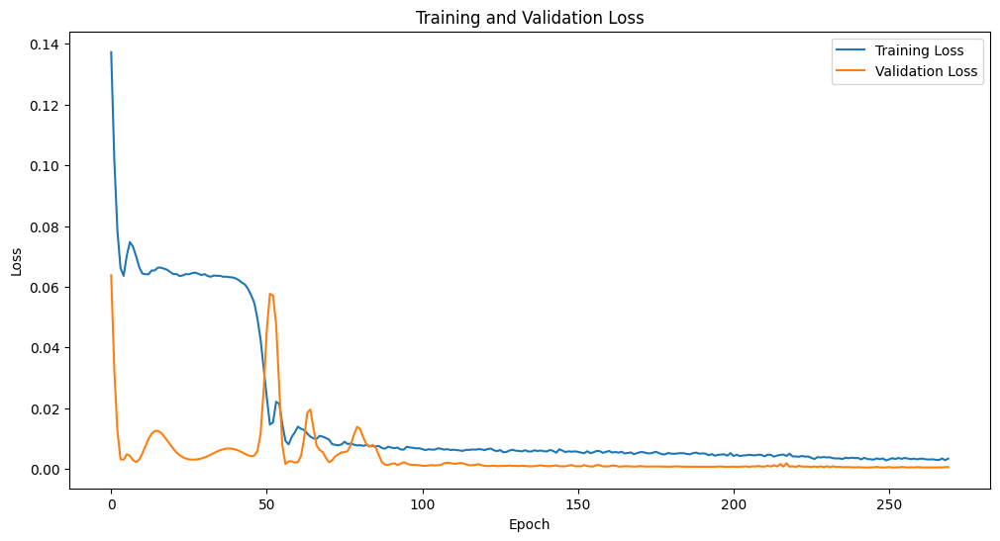

Epoch [1/2500], Train Loss: 0.1461, Val Loss: 0.0677
Epoch [2/2500], Train Loss: 0.1051, Val Loss: 0.0330
Epoch [3/2500], Train Loss: 0.0785, Val Loss: 0.0115
Epoch [4/2500], Train Loss: 0.0657, Val Loss: 0.0027
Epoch [5/2500], Train Loss: 0.0646, Val Loss: 0.0036
Epoch [6/2500], Train Loss: 0.0711, Val Loss: 0.0052
Epoch [7/2500], Train Loss: 0.0750, Val Loss: 0.0043
Epoch [8/2500], Train Loss: 0.0734, Val Loss: 0.0027
Epoch [9/2500], Train Loss: 0.0689, Val Loss: 0.0024
Epoch [10/2500], Train Loss: 0.0657, Val Loss: 0.0036
Epoch [11/2500], Train Loss: 0.0639, Val Loss: 0.0061
Epoch [12/2500], Train Loss: 0.0639, Val Loss: 0.0090
Epoch [13/2500], Train Loss: 0.0646, Val Loss: 0.0115
Epoch [14/2500], Train Loss: 0.0655, Val Loss: 0.0129
Epoch [15/2500], Train Loss: 0.0662, Val Loss: 0.0133
Epoch [16/2500], Train Loss: 0.0664, Val Loss: 0.0127
Epoch [17/2500], Train Loss: 0.0661, Val Loss: 0.0115
Epoch [18/2500], Train Loss: 0.0654, Val Loss: 0.0099
Epoch [19/2500], Train Loss: 0.0647, 

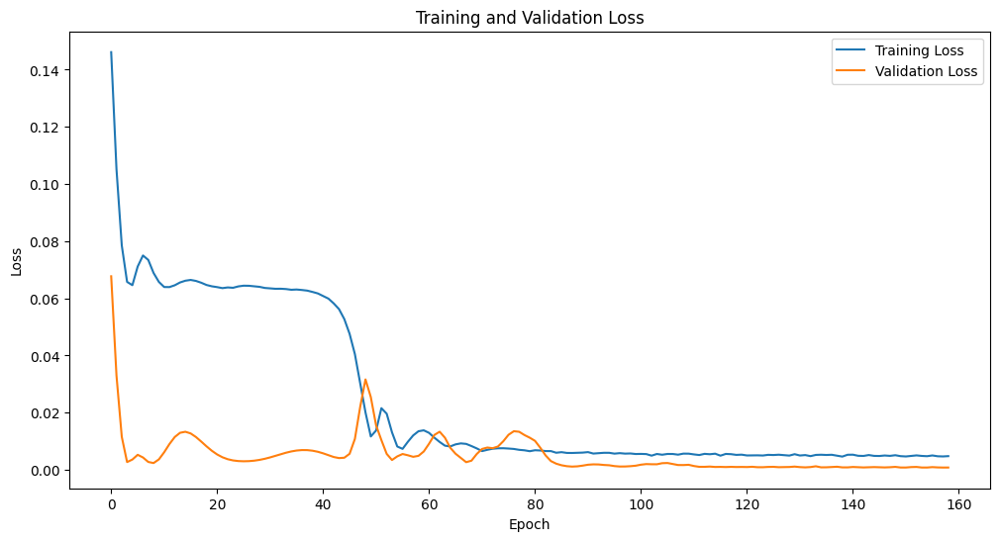

Epoch [1/2500], Train Loss: 0.1146, Val Loss: 0.0413
Epoch [2/2500], Train Loss: 0.0849, Val Loss: 0.0165
Epoch [3/2500], Train Loss: 0.0678, Val Loss: 0.0041
Epoch [4/2500], Train Loss: 0.0652, Val Loss: 0.0026
Epoch [5/2500], Train Loss: 0.0696, Val Loss: 0.0042
Epoch [6/2500], Train Loss: 0.0741, Val Loss: 0.0038
Epoch [7/2500], Train Loss: 0.0734, Val Loss: 0.0026
Epoch [8/2500], Train Loss: 0.0687, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0667, Val Loss: 0.0035
Epoch [10/2500], Train Loss: 0.0647, Val Loss: 0.0056
Epoch [11/2500], Train Loss: 0.0645, Val Loss: 0.0081
Epoch [12/2500], Train Loss: 0.0648, Val Loss: 0.0104
Epoch [13/2500], Train Loss: 0.0658, Val Loss: 0.0118
Epoch [14/2500], Train Loss: 0.0661, Val Loss: 0.0124
Epoch [15/2500], Train Loss: 0.0666, Val Loss: 0.0121
Epoch [16/2500], Train Loss: 0.0670, Val Loss: 0.0112
Epoch [17/2500], Train Loss: 0.0652, Val Loss: 0.0099
Epoch [18/2500], Train Loss: 0.0650, Val Loss: 0.0084
Epoch [19/2500], Train Loss: 0.0643, 

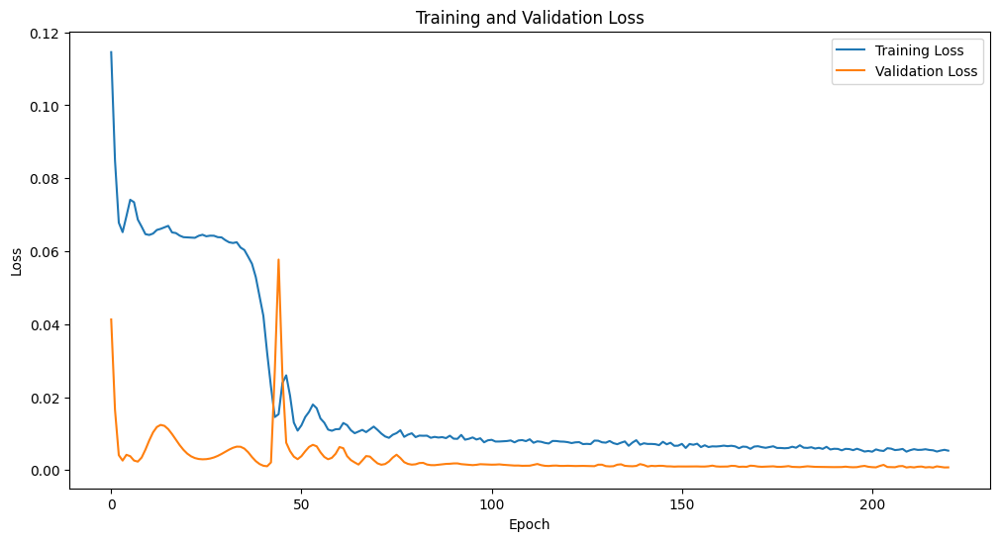

Epoch [1/2500], Train Loss: 0.0851, Val Loss: 0.0164
Epoch [2/2500], Train Loss: 0.0682, Val Loss: 0.0039
Epoch [3/2500], Train Loss: 0.0642, Val Loss: 0.0025
Epoch [4/2500], Train Loss: 0.0686, Val Loss: 0.0029
Epoch [5/2500], Train Loss: 0.0695, Val Loss: 0.0024
Epoch [6/2500], Train Loss: 0.0674, Val Loss: 0.0026
Epoch [7/2500], Train Loss: 0.0650, Val Loss: 0.0044
Epoch [8/2500], Train Loss: 0.0642, Val Loss: 0.0070
Epoch [9/2500], Train Loss: 0.0639, Val Loss: 0.0096
Epoch [10/2500], Train Loss: 0.0647, Val Loss: 0.0112
Epoch [11/2500], Train Loss: 0.0659, Val Loss: 0.0116
Epoch [12/2500], Train Loss: 0.0654, Val Loss: 0.0110
Epoch [13/2500], Train Loss: 0.0651, Val Loss: 0.0096
Epoch [14/2500], Train Loss: 0.0650, Val Loss: 0.0079
Epoch [15/2500], Train Loss: 0.0643, Val Loss: 0.0063
Epoch [16/2500], Train Loss: 0.0642, Val Loss: 0.0049
Epoch [17/2500], Train Loss: 0.0636, Val Loss: 0.0039
Epoch [18/2500], Train Loss: 0.0643, Val Loss: 0.0034
Epoch [19/2500], Train Loss: 0.0641, 

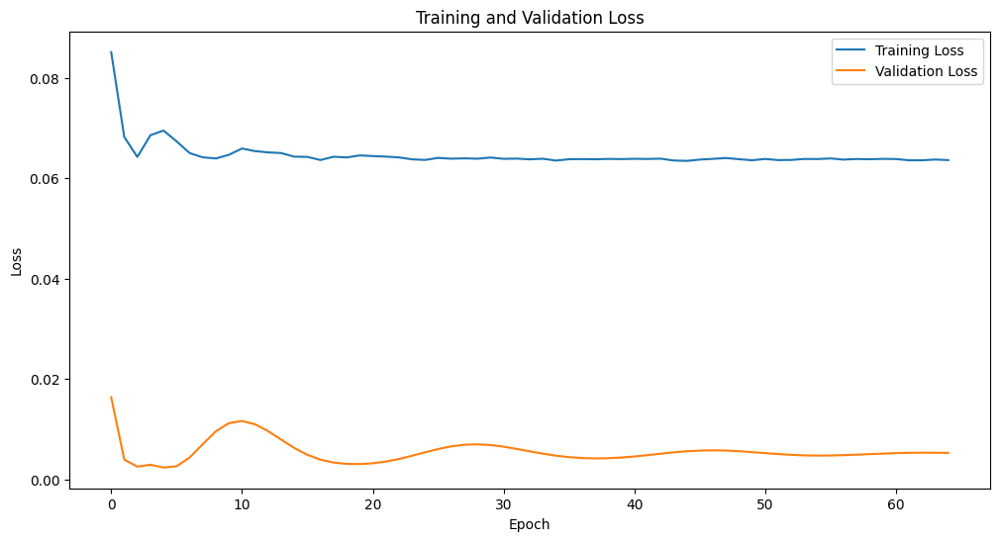

Epoch [1/2500], Train Loss: 0.1849, Val Loss: 0.1083
Epoch [2/2500], Train Loss: 0.1381, Val Loss: 0.0642
Epoch [3/2500], Train Loss: 0.1023, Val Loss: 0.0303
Epoch [4/2500], Train Loss: 0.0769, Val Loss: 0.0085
Epoch [5/2500], Train Loss: 0.0645, Val Loss: 0.0024
Epoch [6/2500], Train Loss: 0.0680, Val Loss: 0.0070
Epoch [7/2500], Train Loss: 0.0786, Val Loss: 0.0083
Epoch [8/2500], Train Loss: 0.0807, Val Loss: 0.0055
Epoch [9/2500], Train Loss: 0.0759, Val Loss: 0.0029
Epoch [10/2500], Train Loss: 0.0698, Val Loss: 0.0024
Epoch [11/2500], Train Loss: 0.0655, Val Loss: 0.0043
Epoch [12/2500], Train Loss: 0.0643, Val Loss: 0.0075
Epoch [13/2500], Train Loss: 0.0640, Val Loss: 0.0108
Epoch [14/2500], Train Loss: 0.0651, Val Loss: 0.0136
Epoch [15/2500], Train Loss: 0.0667, Val Loss: 0.0154
Epoch [16/2500], Train Loss: 0.0674, Val Loss: 0.0159
Epoch [17/2500], Train Loss: 0.0679, Val Loss: 0.0154
Epoch [18/2500], Train Loss: 0.0674, Val Loss: 0.0141
Epoch [19/2500], Train Loss: 0.0667, 

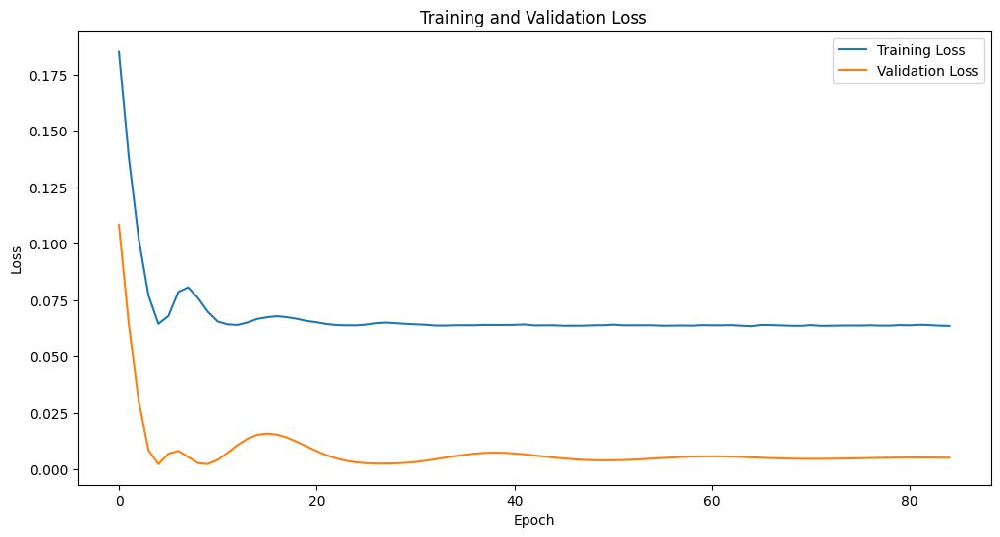

Epoch [1/2500], Train Loss: 0.1776, Val Loss: 0.1006
Epoch [2/2500], Train Loss: 0.1328, Val Loss: 0.0563
Epoch [3/2500], Train Loss: 0.0973, Val Loss: 0.0230
Epoch [4/2500], Train Loss: 0.0750, Val Loss: 0.0045
Epoch [5/2500], Train Loss: 0.0652, Val Loss: 0.0042
Epoch [6/2500], Train Loss: 0.0747, Val Loss: 0.0093
Epoch [7/2500], Train Loss: 0.0818, Val Loss: 0.0086
Epoch [8/2500], Train Loss: 0.0806, Val Loss: 0.0048
Epoch [9/2500], Train Loss: 0.0751, Val Loss: 0.0024
Epoch [10/2500], Train Loss: 0.0685, Val Loss: 0.0031
Epoch [11/2500], Train Loss: 0.0656, Val Loss: 0.0061
Epoch [12/2500], Train Loss: 0.0649, Val Loss: 0.0102
Epoch [13/2500], Train Loss: 0.0662, Val Loss: 0.0138
Epoch [14/2500], Train Loss: 0.0688, Val Loss: 0.0162
Epoch [15/2500], Train Loss: 0.0681, Val Loss: 0.0171
Epoch [16/2500], Train Loss: 0.0692, Val Loss: 0.0165
Epoch [17/2500], Train Loss: 0.0690, Val Loss: 0.0148
Epoch [18/2500], Train Loss: 0.0684, Val Loss: 0.0125
Epoch [19/2500], Train Loss: 0.0680, 

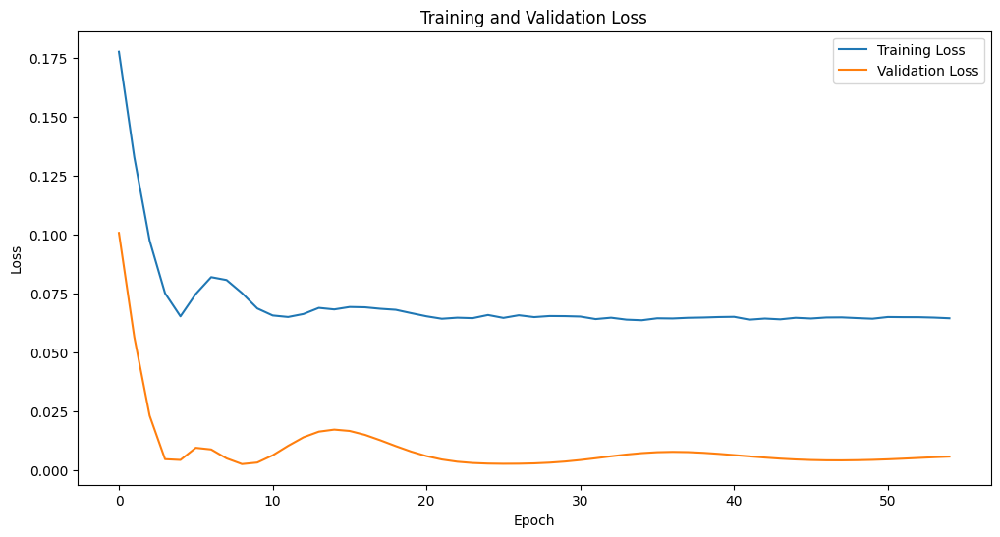

Epoch [1/2500], Train Loss: 0.2125, Val Loss: 0.0727
Epoch [2/2500], Train Loss: 0.0996, Val Loss: 0.0067
Epoch [3/2500], Train Loss: 0.0580, Val Loss: 0.0136
Epoch [4/2500], Train Loss: 0.0745, Val Loss: 0.0223
Epoch [5/2500], Train Loss: 0.0817, Val Loss: 0.0103
Epoch [6/2500], Train Loss: 0.0688, Val Loss: 0.0021
Epoch [7/2500], Train Loss: 0.0552, Val Loss: 0.0051
Epoch [8/2500], Train Loss: 0.0548, Val Loss: 0.0134
Epoch [9/2500], Train Loss: 0.0567, Val Loss: 0.0205
Epoch [10/2500], Train Loss: 0.0598, Val Loss: 0.0231
Epoch [11/2500], Train Loss: 0.0598, Val Loss: 0.0213
Epoch [12/2500], Train Loss: 0.0548, Val Loss: 0.0165
Epoch [13/2500], Train Loss: 0.0496, Val Loss: 0.0108
Epoch [14/2500], Train Loss: 0.0460, Val Loss: 0.0059
Epoch [15/2500], Train Loss: 0.0417, Val Loss: 0.0030
Epoch [16/2500], Train Loss: 0.0392, Val Loss: 0.0018
Epoch [17/2500], Train Loss: 0.0374, Val Loss: 0.0017
Epoch [18/2500], Train Loss: 0.0343, Val Loss: 0.0025
Epoch [19/2500], Train Loss: 0.0299, 

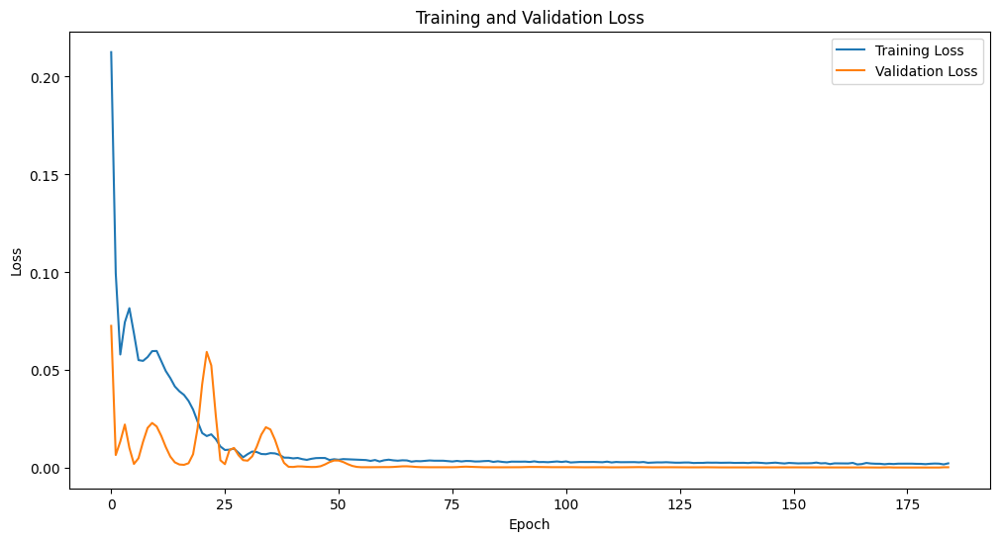

Epoch [1/2500], Train Loss: 0.1815, Val Loss: 0.0152
Epoch [2/2500], Train Loss: 0.0702, Val Loss: 0.0223
Epoch [3/2500], Train Loss: 0.0801, Val Loss: 0.0364
Epoch [4/2500], Train Loss: 0.0936, Val Loss: 0.0147
Epoch [5/2500], Train Loss: 0.0729, Val Loss: 0.0020
Epoch [6/2500], Train Loss: 0.0565, Val Loss: 0.0085
Epoch [7/2500], Train Loss: 0.0568, Val Loss: 0.0215
Epoch [8/2500], Train Loss: 0.0622, Val Loss: 0.0275
Epoch [9/2500], Train Loss: 0.0647, Val Loss: 0.0233
Epoch [10/2500], Train Loss: 0.0590, Val Loss: 0.0133
Epoch [11/2500], Train Loss: 0.0501, Val Loss: 0.0042
Epoch [12/2500], Train Loss: 0.0433, Val Loss: 0.0017
Epoch [13/2500], Train Loss: 0.0408, Val Loss: 0.0050
Epoch [14/2500], Train Loss: 0.0423, Val Loss: 0.0063
Epoch [15/2500], Train Loss: 0.0406, Val Loss: 0.0026
Epoch [16/2500], Train Loss: 0.0321, Val Loss: 0.0025
Epoch [17/2500], Train Loss: 0.0221, Val Loss: 0.0178
Epoch [18/2500], Train Loss: 0.0175, Val Loss: 0.0429
Epoch [19/2500], Train Loss: 0.0188, 

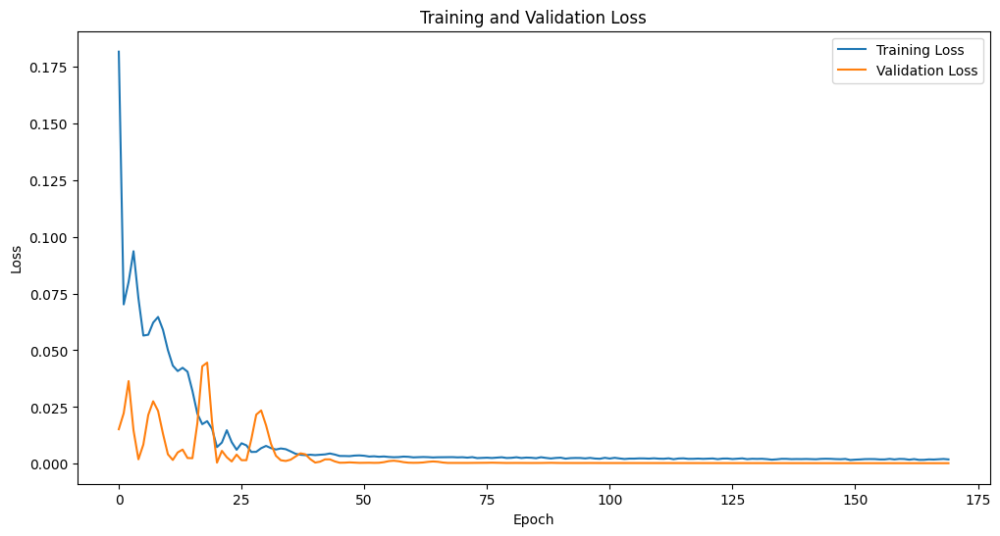

Epoch [1/2500], Train Loss: 0.0775, Val Loss: 0.0098
Epoch [2/2500], Train Loss: 0.0829, Val Loss: 0.0028
Epoch [3/2500], Train Loss: 0.0698, Val Loss: 0.0059
Epoch [4/2500], Train Loss: 0.0645, Val Loss: 0.0145
Epoch [5/2500], Train Loss: 0.0656, Val Loss: 0.0172
Epoch [6/2500], Train Loss: 0.0664, Val Loss: 0.0137
Epoch [7/2500], Train Loss: 0.0628, Val Loss: 0.0079
Epoch [8/2500], Train Loss: 0.0593, Val Loss: 0.0035
Epoch [9/2500], Train Loss: 0.0568, Val Loss: 0.0021
Epoch [10/2500], Train Loss: 0.0566, Val Loss: 0.0020
Epoch [11/2500], Train Loss: 0.0551, Val Loss: 0.0022
Epoch [12/2500], Train Loss: 0.0504, Val Loss: 0.0053
Epoch [13/2500], Train Loss: 0.0460, Val Loss: 0.0147
Epoch [14/2500], Train Loss: 0.0406, Val Loss: 0.0244
Epoch [15/2500], Train Loss: 0.0362, Val Loss: 0.0221
Epoch [16/2500], Train Loss: 0.0264, Val Loss: 0.0084
Epoch [17/2500], Train Loss: 0.0197, Val Loss: 0.0033
Epoch [18/2500], Train Loss: 0.0162, Val Loss: 0.0137
Epoch [19/2500], Train Loss: 0.0124, 

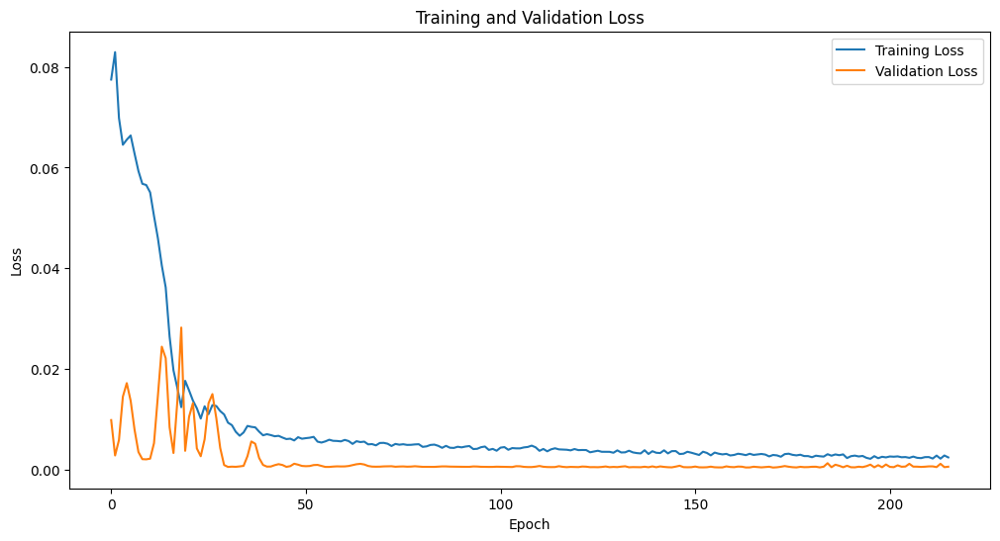

Epoch [1/2500], Train Loss: 0.1867, Val Loss: 0.0207
Epoch [2/2500], Train Loss: 0.0750, Val Loss: 0.0149
Epoch [3/2500], Train Loss: 0.0896, Val Loss: 0.0162
Epoch [4/2500], Train Loss: 0.0924, Val Loss: 0.0035
Epoch [5/2500], Train Loss: 0.0717, Val Loss: 0.0054
Epoch [6/2500], Train Loss: 0.0640, Val Loss: 0.0171
Epoch [7/2500], Train Loss: 0.0681, Val Loss: 0.0249
Epoch [8/2500], Train Loss: 0.0720, Val Loss: 0.0249
Epoch [9/2500], Train Loss: 0.0722, Val Loss: 0.0199
Epoch [10/2500], Train Loss: 0.0688, Val Loss: 0.0136
Epoch [11/2500], Train Loss: 0.0658, Val Loss: 0.0082
Epoch [12/2500], Train Loss: 0.0636, Val Loss: 0.0046
Epoch [13/2500], Train Loss: 0.0628, Val Loss: 0.0028
Epoch [14/2500], Train Loss: 0.0632, Val Loss: 0.0022
Epoch [15/2500], Train Loss: 0.0638, Val Loss: 0.0022
Epoch [16/2500], Train Loss: 0.0640, Val Loss: 0.0022
Epoch [17/2500], Train Loss: 0.0628, Val Loss: 0.0021
Epoch [18/2500], Train Loss: 0.0593, Val Loss: 0.0028
Epoch [19/2500], Train Loss: 0.0558, 

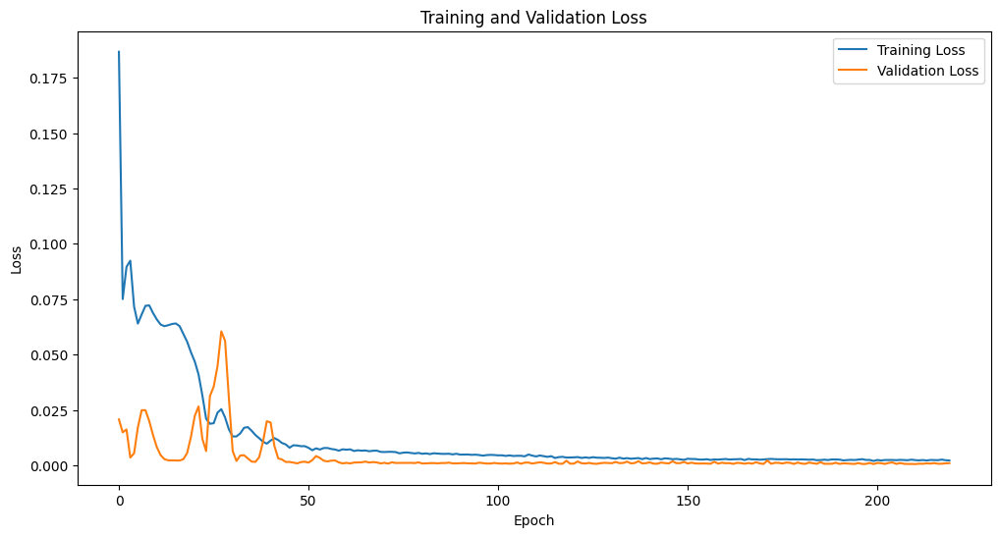

Epoch [1/2500], Train Loss: 0.2132, Val Loss: 0.0556
Epoch [2/2500], Train Loss: 0.0955, Val Loss: 0.0025
Epoch [3/2500], Train Loss: 0.0657, Val Loss: 0.0155
Epoch [4/2500], Train Loss: 0.0920, Val Loss: 0.0066
Epoch [5/2500], Train Loss: 0.0782, Val Loss: 0.0042
Epoch [6/2500], Train Loss: 0.0646, Val Loss: 0.0223
Epoch [7/2500], Train Loss: 0.0713, Val Loss: 0.0310
Epoch [8/2500], Train Loss: 0.0771, Val Loss: 0.0225
Epoch [9/2500], Train Loss: 0.0716, Val Loss: 0.0110
Epoch [10/2500], Train Loss: 0.0654, Val Loss: 0.0043
Epoch [11/2500], Train Loss: 0.0635, Val Loss: 0.0024
Epoch [12/2500], Train Loss: 0.0651, Val Loss: 0.0024
Epoch [13/2500], Train Loss: 0.0671, Val Loss: 0.0024
Epoch [14/2500], Train Loss: 0.0670, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0659, Val Loss: 0.0026
Epoch [16/2500], Train Loss: 0.0638, Val Loss: 0.0039
Epoch [17/2500], Train Loss: 0.0631, Val Loss: 0.0061
Epoch [18/2500], Train Loss: 0.0629, Val Loss: 0.0084
Epoch [19/2500], Train Loss: 0.0636, 

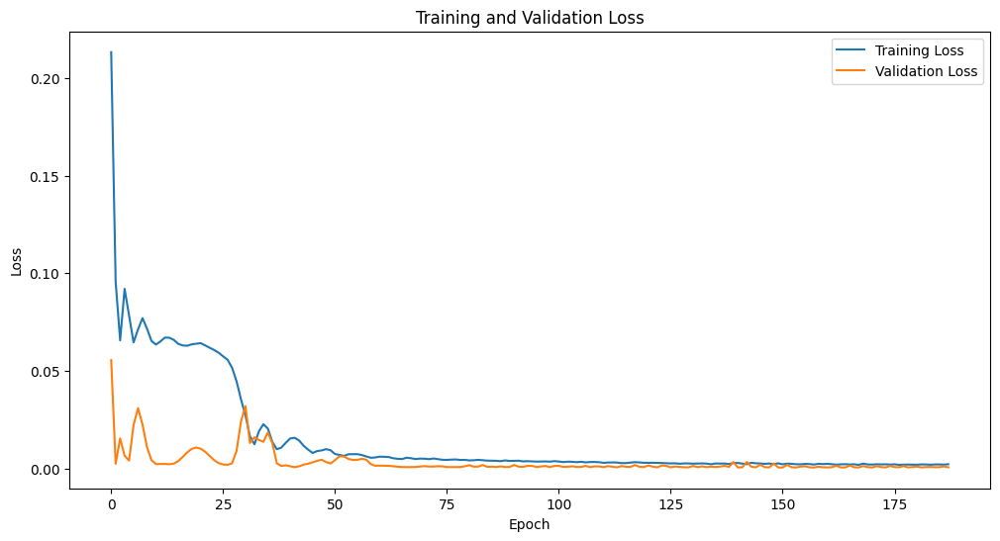

Epoch [1/2500], Train Loss: 0.1814, Val Loss: 0.0408
Epoch [2/2500], Train Loss: 0.0876, Val Loss: 0.0026
Epoch [3/2500], Train Loss: 0.0671, Val Loss: 0.0094
Epoch [4/2500], Train Loss: 0.0816, Val Loss: 0.0053
Epoch [5/2500], Train Loss: 0.0770, Val Loss: 0.0027
Epoch [6/2500], Train Loss: 0.0667, Val Loss: 0.0101
Epoch [7/2500], Train Loss: 0.0665, Val Loss: 0.0172
Epoch [8/2500], Train Loss: 0.0698, Val Loss: 0.0168
Epoch [9/2500], Train Loss: 0.0691, Val Loss: 0.0120
Epoch [10/2500], Train Loss: 0.0673, Val Loss: 0.0071
Epoch [11/2500], Train Loss: 0.0650, Val Loss: 0.0040
Epoch [12/2500], Train Loss: 0.0644, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0647, Val Loss: 0.0025
Epoch [14/2500], Train Loss: 0.0651, Val Loss: 0.0026
Epoch [15/2500], Train Loss: 0.0648, Val Loss: 0.0034
Epoch [16/2500], Train Loss: 0.0641, Val Loss: 0.0049
Epoch [17/2500], Train Loss: 0.0632, Val Loss: 0.0069
Epoch [18/2500], Train Loss: 0.0630, Val Loss: 0.0087
Epoch [19/2500], Train Loss: 0.0629, 

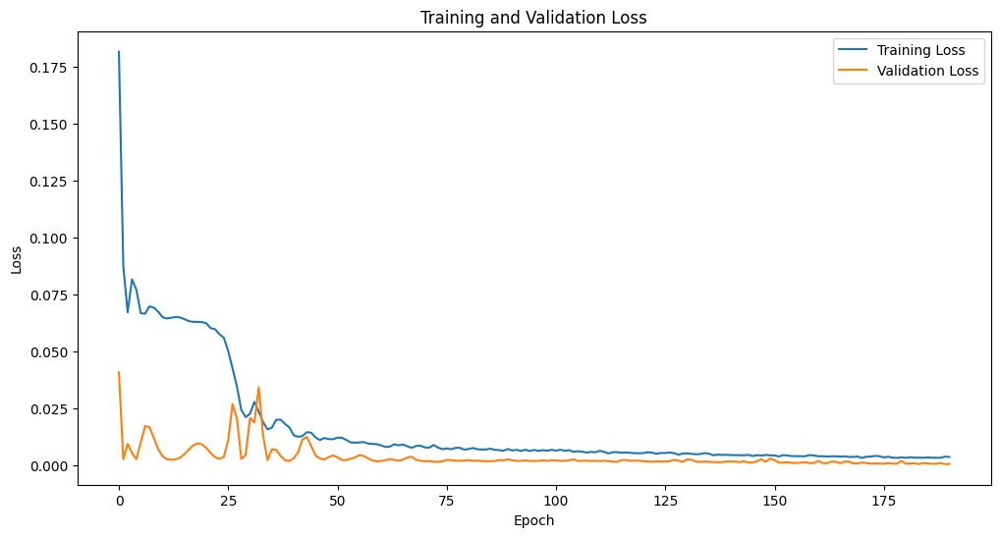

Epoch [1/2500], Train Loss: 0.1611, Val Loss: 0.0147
Epoch [2/2500], Train Loss: 0.0698, Val Loss: 0.0121
Epoch [3/2500], Train Loss: 0.0856, Val Loss: 0.0121
Epoch [4/2500], Train Loss: 0.0862, Val Loss: 0.0028
Epoch [5/2500], Train Loss: 0.0709, Val Loss: 0.0067
Epoch [6/2500], Train Loss: 0.0650, Val Loss: 0.0182
Epoch [7/2500], Train Loss: 0.0701, Val Loss: 0.0217
Epoch [8/2500], Train Loss: 0.0717, Val Loss: 0.0172
Epoch [9/2500], Train Loss: 0.0698, Val Loss: 0.0107
Epoch [10/2500], Train Loss: 0.0662, Val Loss: 0.0058
Epoch [11/2500], Train Loss: 0.0649, Val Loss: 0.0033
Epoch [12/2500], Train Loss: 0.0648, Val Loss: 0.0024
Epoch [13/2500], Train Loss: 0.0664, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0661, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0665, Val Loss: 0.0026
Epoch [16/2500], Train Loss: 0.0656, Val Loss: 0.0034
Epoch [17/2500], Train Loss: 0.0643, Val Loss: 0.0049
Epoch [18/2500], Train Loss: 0.0642, Val Loss: 0.0067
Epoch [19/2500], Train Loss: 0.0639, 

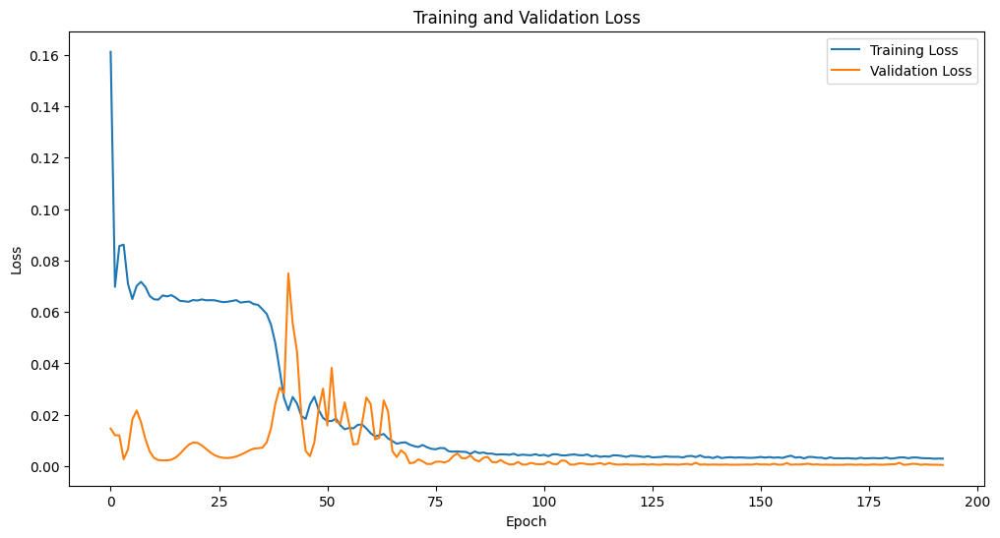

Epoch [1/2500], Train Loss: 0.1563, Val Loss: 0.0094
Epoch [2/2500], Train Loss: 0.0649, Val Loss: 0.0162
Epoch [3/2500], Train Loss: 0.0928, Val Loss: 0.0087
Epoch [4/2500], Train Loss: 0.0811, Val Loss: 0.0024
Epoch [5/2500], Train Loss: 0.0656, Val Loss: 0.0099
Epoch [6/2500], Train Loss: 0.0648, Val Loss: 0.0204
Epoch [7/2500], Train Loss: 0.0705, Val Loss: 0.0238
Epoch [8/2500], Train Loss: 0.0726, Val Loss: 0.0205
Epoch [9/2500], Train Loss: 0.0705, Val Loss: 0.0144
Epoch [10/2500], Train Loss: 0.0670, Val Loss: 0.0086
Epoch [11/2500], Train Loss: 0.0644, Val Loss: 0.0047
Epoch [12/2500], Train Loss: 0.0638, Val Loss: 0.0029
Epoch [13/2500], Train Loss: 0.0644, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0659, Val Loss: 0.0023
Epoch [15/2500], Train Loss: 0.0660, Val Loss: 0.0024
Epoch [16/2500], Train Loss: 0.0655, Val Loss: 0.0027
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0036
Epoch [18/2500], Train Loss: 0.0640, Val Loss: 0.0050
Epoch [19/2500], Train Loss: 0.0637, 

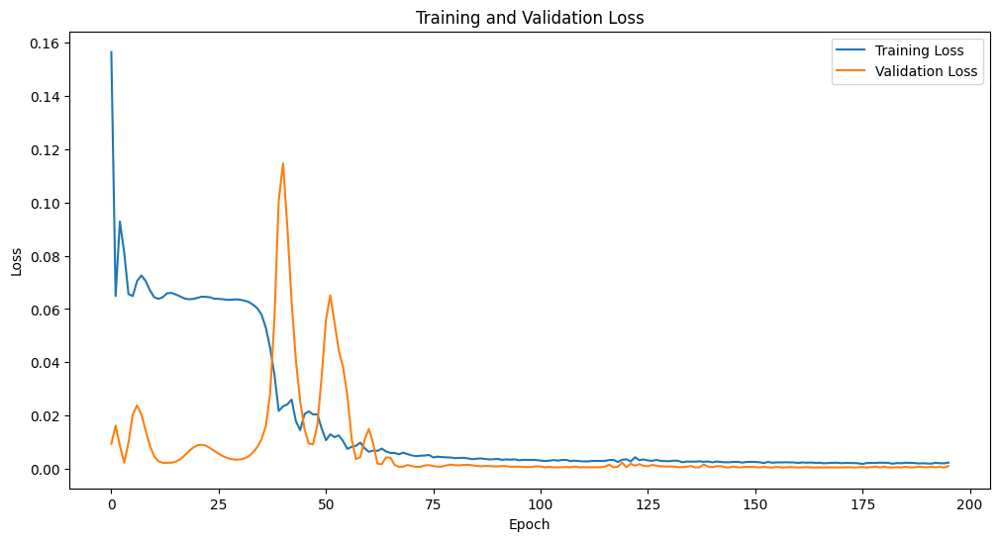

Epoch [1/2500], Train Loss: 0.1431, Val Loss: 0.0119
Epoch [2/2500], Train Loss: 0.0676, Val Loss: 0.0093
Epoch [3/2500], Train Loss: 0.0836, Val Loss: 0.0056
Epoch [4/2500], Train Loss: 0.0764, Val Loss: 0.0031
Epoch [5/2500], Train Loss: 0.0646, Val Loss: 0.0131
Epoch [6/2500], Train Loss: 0.0673, Val Loss: 0.0195
Epoch [7/2500], Train Loss: 0.0696, Val Loss: 0.0155
Epoch [8/2500], Train Loss: 0.0679, Val Loss: 0.0089
Epoch [9/2500], Train Loss: 0.0640, Val Loss: 0.0045
Epoch [10/2500], Train Loss: 0.0648, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0651, Val Loss: 0.0025
Epoch [12/2500], Train Loss: 0.0662, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0653, Val Loss: 0.0035
Epoch [14/2500], Train Loss: 0.0643, Val Loss: 0.0052
Epoch [15/2500], Train Loss: 0.0644, Val Loss: 0.0073
Epoch [16/2500], Train Loss: 0.0637, Val Loss: 0.0088
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0090
Epoch [18/2500], Train Loss: 0.0658, Val Loss: 0.0080
Epoch [19/2500], Train Loss: 0.0646, 

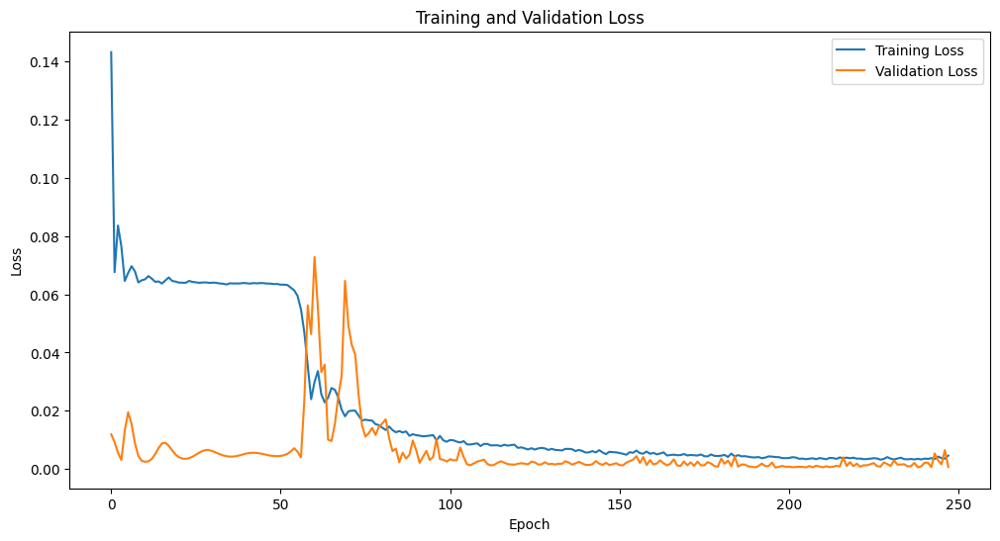

Epoch [1/2500], Train Loss: 0.1308, Val Loss: 0.0072
Epoch [2/2500], Train Loss: 0.0653, Val Loss: 0.0100
Epoch [3/2500], Train Loss: 0.0833, Val Loss: 0.0035
Epoch [4/2500], Train Loss: 0.0722, Val Loss: 0.0083
Epoch [5/2500], Train Loss: 0.0661, Val Loss: 0.0227
Epoch [6/2500], Train Loss: 0.0728, Val Loss: 0.0175
Epoch [7/2500], Train Loss: 0.0698, Val Loss: 0.0078
Epoch [8/2500], Train Loss: 0.0655, Val Loss: 0.0031
Epoch [9/2500], Train Loss: 0.0647, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0661, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0675, Val Loss: 0.0023
Epoch [12/2500], Train Loss: 0.0663, Val Loss: 0.0027
Epoch [13/2500], Train Loss: 0.0655, Val Loss: 0.0040
Epoch [14/2500], Train Loss: 0.0640, Val Loss: 0.0062
Epoch [15/2500], Train Loss: 0.0640, Val Loss: 0.0086
Epoch [16/2500], Train Loss: 0.0647, Val Loss: 0.0101
Epoch [17/2500], Train Loss: 0.0651, Val Loss: 0.0103
Epoch [18/2500], Train Loss: 0.0650, Val Loss: 0.0095
Epoch [19/2500], Train Loss: 0.0647, 

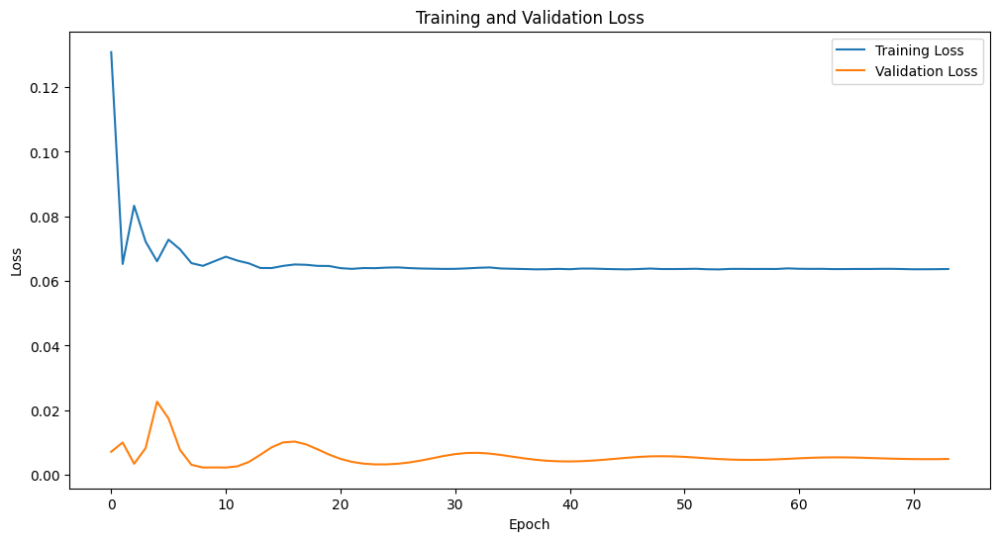

Epoch [1/2500], Train Loss: 0.0722, Val Loss: 0.0501
Epoch [2/2500], Train Loss: 0.0915, Val Loss: 0.0144
Epoch [3/2500], Train Loss: 0.0670, Val Loss: 0.0029
Epoch [4/2500], Train Loss: 0.0645, Val Loss: 0.0025
Epoch [5/2500], Train Loss: 0.0682, Val Loss: 0.0025
Epoch [6/2500], Train Loss: 0.0682, Val Loss: 0.0025
Epoch [7/2500], Train Loss: 0.0654, Val Loss: 0.0052
Epoch [8/2500], Train Loss: 0.0639, Val Loss: 0.0108
Epoch [9/2500], Train Loss: 0.0653, Val Loss: 0.0128
Epoch [10/2500], Train Loss: 0.0662, Val Loss: 0.0103
Epoch [11/2500], Train Loss: 0.0650, Val Loss: 0.0070
Epoch [12/2500], Train Loss: 0.0637, Val Loss: 0.0047
Epoch [13/2500], Train Loss: 0.0637, Val Loss: 0.0035
Epoch [14/2500], Train Loss: 0.0640, Val Loss: 0.0030
Epoch [15/2500], Train Loss: 0.0643, Val Loss: 0.0030
Epoch [16/2500], Train Loss: 0.0645, Val Loss: 0.0032
Epoch [17/2500], Train Loss: 0.0643, Val Loss: 0.0037
Epoch [18/2500], Train Loss: 0.0640, Val Loss: 0.0044
Epoch [19/2500], Train Loss: 0.0636, 

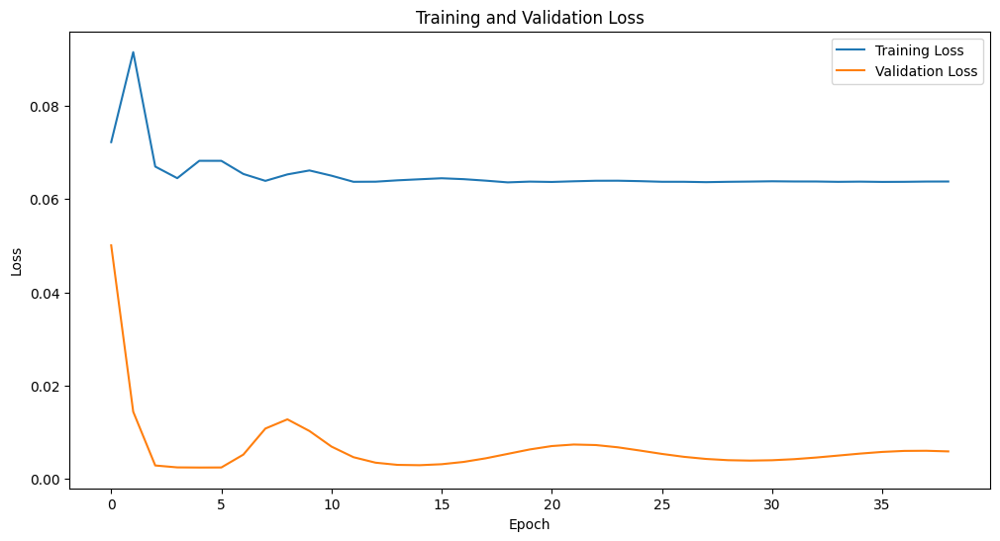

Epoch [1/2500], Train Loss: 0.0665, Val Loss: 0.0551
Epoch [2/2500], Train Loss: 0.0949, Val Loss: 0.0164
Epoch [3/2500], Train Loss: 0.0686, Val Loss: 0.0024
Epoch [4/2500], Train Loss: 0.0659, Val Loss: 0.0033
Epoch [5/2500], Train Loss: 0.0720, Val Loss: 0.0025
Epoch [6/2500], Train Loss: 0.0683, Val Loss: 0.0030
Epoch [7/2500], Train Loss: 0.0647, Val Loss: 0.0073
Epoch [8/2500], Train Loss: 0.0641, Val Loss: 0.0118
Epoch [9/2500], Train Loss: 0.0656, Val Loss: 0.0114
Epoch [10/2500], Train Loss: 0.0656, Val Loss: 0.0082
Epoch [11/2500], Train Loss: 0.0647, Val Loss: 0.0051
Epoch [12/2500], Train Loss: 0.0639, Val Loss: 0.0035
Epoch [13/2500], Train Loss: 0.0643, Val Loss: 0.0029
Epoch [14/2500], Train Loss: 0.0644, Val Loss: 0.0030
Epoch [15/2500], Train Loss: 0.0647, Val Loss: 0.0036
Epoch [16/2500], Train Loss: 0.0639, Val Loss: 0.0046
Epoch [17/2500], Train Loss: 0.0640, Val Loss: 0.0059
Epoch [18/2500], Train Loss: 0.0639, Val Loss: 0.0070
Epoch [19/2500], Train Loss: 0.0640, 

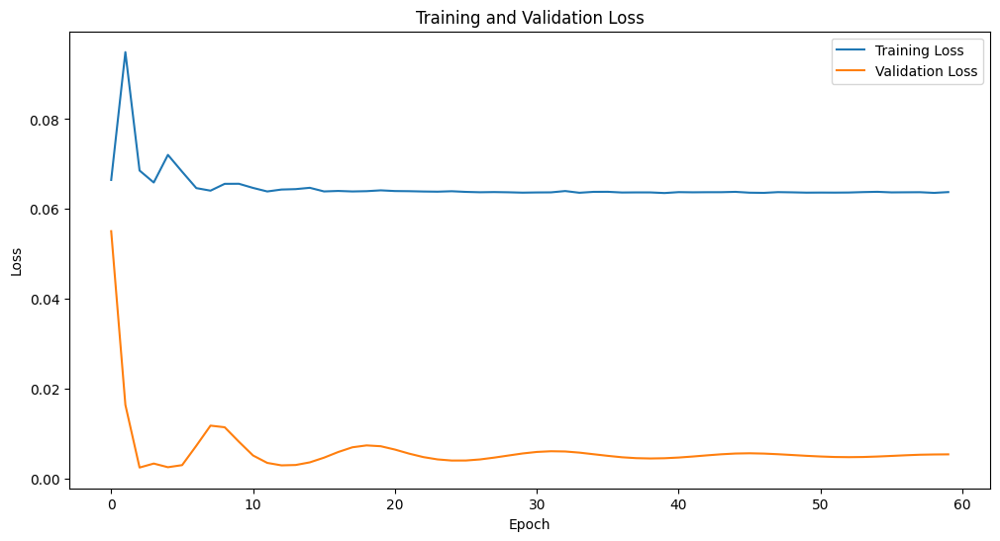

Epoch [1/2500], Train Loss: 0.1284, Val Loss: 0.0137
Epoch [2/2500], Train Loss: 0.0785, Val Loss: 0.0039
Epoch [3/2500], Train Loss: 0.0661, Val Loss: 0.0132
Epoch [4/2500], Train Loss: 0.0571, Val Loss: 0.0325
Epoch [5/2500], Train Loss: 0.0607, Val Loss: 0.0223
Epoch [6/2500], Train Loss: 0.0520, Val Loss: 0.0059
Epoch [7/2500], Train Loss: 0.0410, Val Loss: 0.0018
Epoch [8/2500], Train Loss: 0.0366, Val Loss: 0.0033
Epoch [9/2500], Train Loss: 0.0307, Val Loss: 0.0017
Epoch [10/2500], Train Loss: 0.0149, Val Loss: 0.0304
Epoch [11/2500], Train Loss: 0.0125, Val Loss: 0.0237
Epoch [12/2500], Train Loss: 0.0120, Val Loss: 0.0055
Epoch [13/2500], Train Loss: 0.0174, Val Loss: 0.0088
Epoch [14/2500], Train Loss: 0.0142, Val Loss: 0.0010
Epoch [15/2500], Train Loss: 0.0066, Val Loss: 0.0023
Epoch [16/2500], Train Loss: 0.0075, Val Loss: 0.0006
Epoch [17/2500], Train Loss: 0.0076, Val Loss: 0.0028
Epoch [18/2500], Train Loss: 0.0086, Val Loss: 0.0085
Epoch [19/2500], Train Loss: 0.0106, 

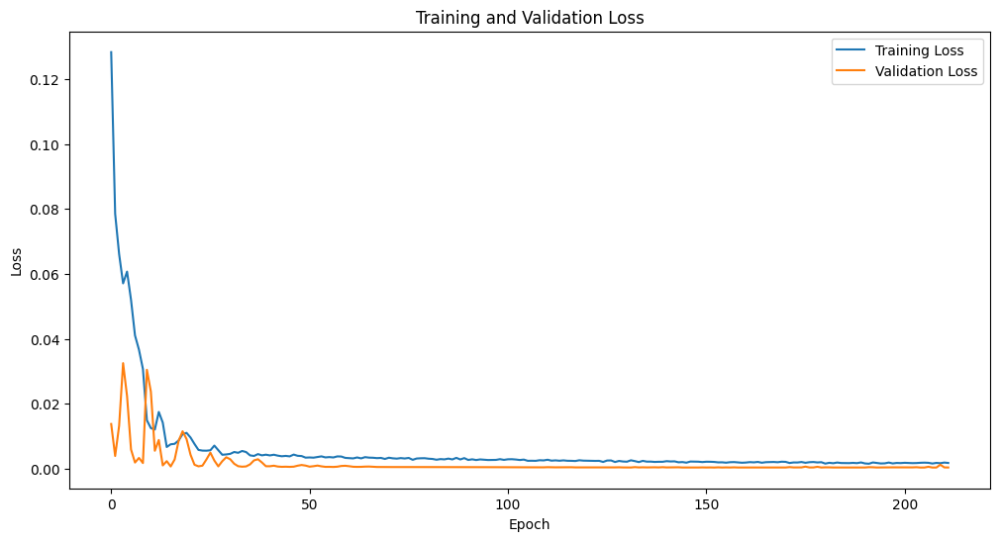

Epoch [1/2500], Train Loss: 0.1248, Val Loss: 0.0242
Epoch [2/2500], Train Loss: 0.0882, Val Loss: 0.0060
Epoch [3/2500], Train Loss: 0.0707, Val Loss: 0.0048
Epoch [4/2500], Train Loss: 0.0619, Val Loss: 0.0152
Epoch [5/2500], Train Loss: 0.0644, Val Loss: 0.0180
Epoch [6/2500], Train Loss: 0.0644, Val Loss: 0.0125
Epoch [7/2500], Train Loss: 0.0602, Val Loss: 0.0050
Epoch [8/2500], Train Loss: 0.0554, Val Loss: 0.0019
Epoch [9/2500], Train Loss: 0.0525, Val Loss: 0.0038
Epoch [10/2500], Train Loss: 0.0512, Val Loss: 0.0037
Epoch [11/2500], Train Loss: 0.0453, Val Loss: 0.0014
Epoch [12/2500], Train Loss: 0.0350, Val Loss: 0.0065
Epoch [13/2500], Train Loss: 0.0242, Val Loss: 0.0204
Epoch [14/2500], Train Loss: 0.0164, Val Loss: 0.0079
Epoch [15/2500], Train Loss: 0.0048, Val Loss: 0.0164
Epoch [16/2500], Train Loss: 0.0197, Val Loss: 0.0011
Epoch [17/2500], Train Loss: 0.0134, Val Loss: 0.0056
Epoch [18/2500], Train Loss: 0.0142, Val Loss: 0.0010
Epoch [19/2500], Train Loss: 0.0056, 

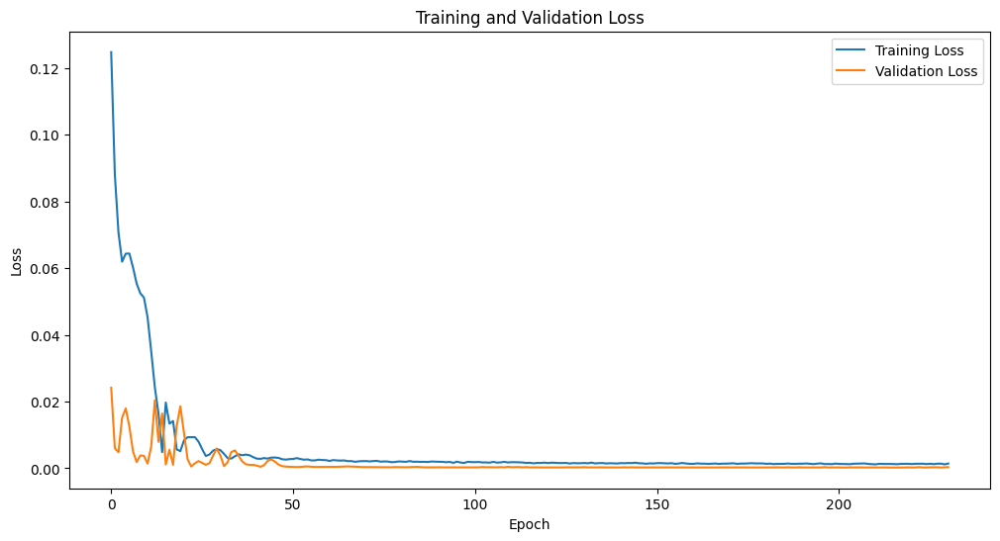

Epoch [1/2500], Train Loss: 0.0652, Val Loss: 0.0622
Epoch [2/2500], Train Loss: 0.0875, Val Loss: 0.0034
Epoch [3/2500], Train Loss: 0.0557, Val Loss: 0.0089
Epoch [4/2500], Train Loss: 0.0662, Val Loss: 0.0038
Epoch [5/2500], Train Loss: 0.0561, Val Loss: 0.0038
Epoch [6/2500], Train Loss: 0.0463, Val Loss: 0.0160
Epoch [7/2500], Train Loss: 0.0456, Val Loss: 0.0108
Epoch [8/2500], Train Loss: 0.0312, Val Loss: 0.0012
Epoch [9/2500], Train Loss: 0.0189, Val Loss: 0.0102
Epoch [10/2500], Train Loss: 0.0160, Val Loss: 0.0041
Epoch [11/2500], Train Loss: 0.0102, Val Loss: 0.0157
Epoch [12/2500], Train Loss: 0.0228, Val Loss: 0.0032
Epoch [13/2500], Train Loss: 0.0104, Val Loss: 0.0157
Epoch [14/2500], Train Loss: 0.0126, Val Loss: 0.0041
Epoch [15/2500], Train Loss: 0.0069, Val Loss: 0.0006
Epoch [16/2500], Train Loss: 0.0088, Val Loss: 0.0021
Epoch [17/2500], Train Loss: 0.0125, Val Loss: 0.0018
Epoch [18/2500], Train Loss: 0.0123, Val Loss: 0.0006
Epoch [19/2500], Train Loss: 0.0094, 

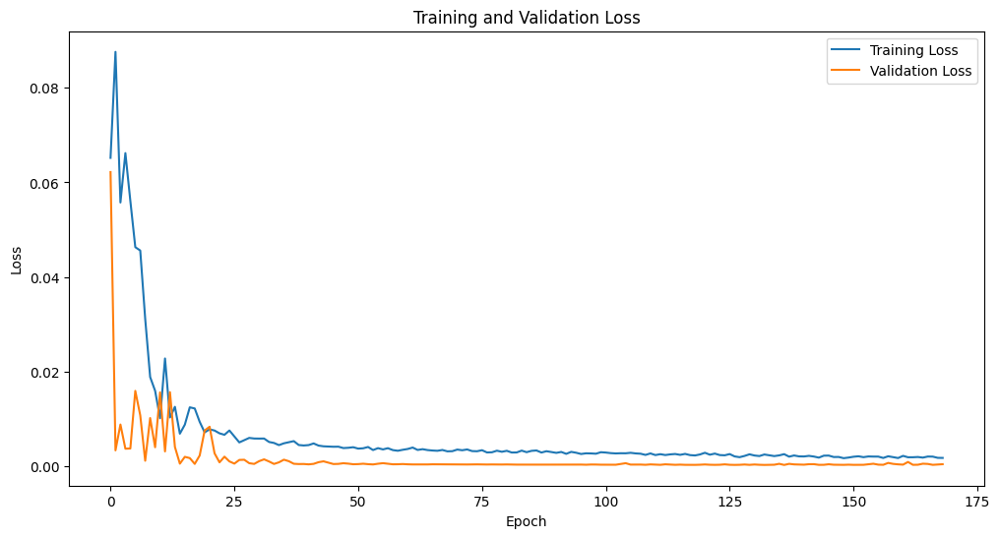

Epoch [1/2500], Train Loss: 0.2505, Val Loss: 0.0043
Epoch [2/2500], Train Loss: 0.0641, Val Loss: 0.0423
Epoch [3/2500], Train Loss: 0.1205, Val Loss: 0.0060
Epoch [4/2500], Train Loss: 0.0634, Val Loss: 0.0355
Epoch [5/2500], Train Loss: 0.0792, Val Loss: 0.0300
Epoch [6/2500], Train Loss: 0.0763, Val Loss: 0.0131
Epoch [7/2500], Train Loss: 0.0665, Val Loss: 0.0034
Epoch [8/2500], Train Loss: 0.0639, Val Loss: 0.0024
Epoch [9/2500], Train Loss: 0.0669, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0662, Val Loss: 0.0035
Epoch [11/2500], Train Loss: 0.0621, Val Loss: 0.0102
Epoch [12/2500], Train Loss: 0.0609, Val Loss: 0.0170
Epoch [13/2500], Train Loss: 0.0611, Val Loss: 0.0152
Epoch [14/2500], Train Loss: 0.0553, Val Loss: 0.0068
Epoch [15/2500], Train Loss: 0.0479, Val Loss: 0.0020
Epoch [16/2500], Train Loss: 0.0392, Val Loss: 0.0086
Epoch [17/2500], Train Loss: 0.0233, Val Loss: 0.0898
Epoch [18/2500], Train Loss: 0.0202, Val Loss: 0.0268
Epoch [19/2500], Train Loss: 0.0185, 

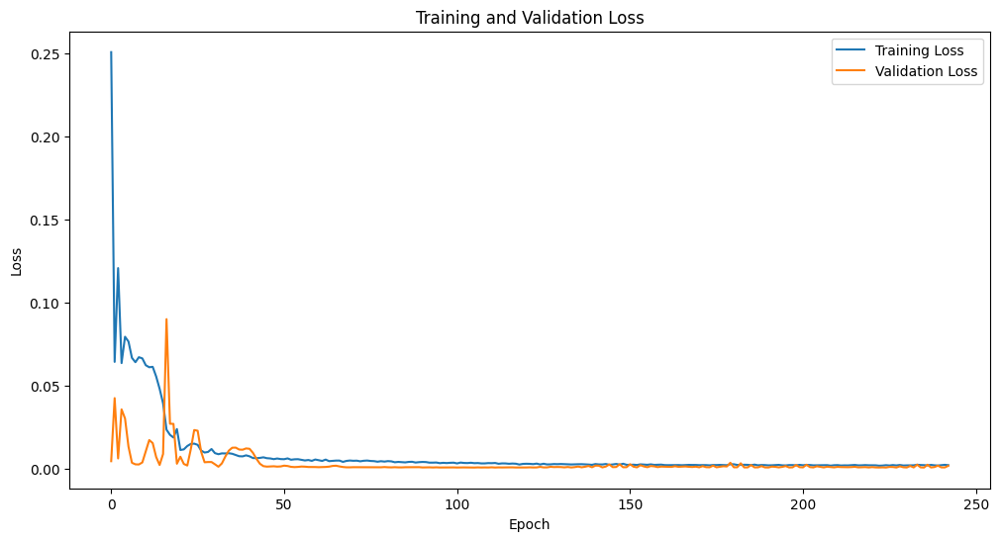

Epoch [1/2500], Train Loss: 0.2718, Val Loss: 0.0226
Epoch [2/2500], Train Loss: 0.0722, Val Loss: 0.0471
Epoch [3/2500], Train Loss: 0.1309, Val Loss: 0.0027
Epoch [4/2500], Train Loss: 0.0656, Val Loss: 0.0393
Epoch [5/2500], Train Loss: 0.0841, Val Loss: 0.0327
Epoch [6/2500], Train Loss: 0.0789, Val Loss: 0.0092
Epoch [7/2500], Train Loss: 0.0644, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0665, Val Loss: 0.0040
Epoch [9/2500], Train Loss: 0.0714, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0665, Val Loss: 0.0047
Epoch [11/2500], Train Loss: 0.0636, Val Loss: 0.0114
Epoch [12/2500], Train Loss: 0.0649, Val Loss: 0.0149
Epoch [13/2500], Train Loss: 0.0658, Val Loss: 0.0123
Epoch [14/2500], Train Loss: 0.0634, Val Loss: 0.0070
Epoch [15/2500], Train Loss: 0.0597, Val Loss: 0.0029
Epoch [16/2500], Train Loss: 0.0568, Val Loss: 0.0019
Epoch [17/2500], Train Loss: 0.0549, Val Loss: 0.0019
Epoch [18/2500], Train Loss: 0.0501, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0380, 

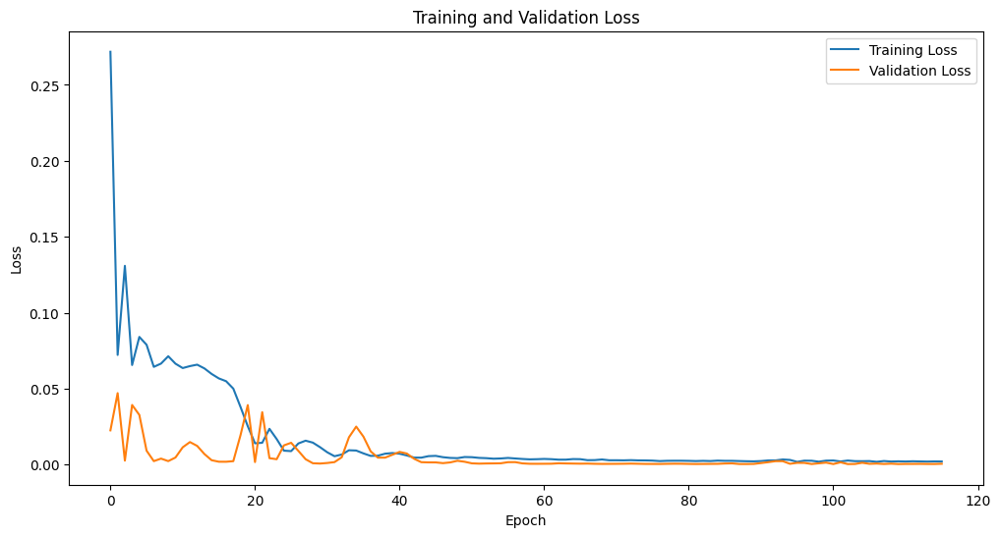

Epoch [1/2500], Train Loss: 0.0988, Val Loss: 0.0630
Epoch [2/2500], Train Loss: 0.1391, Val Loss: 0.0031
Epoch [3/2500], Train Loss: 0.0661, Val Loss: 0.0261
Epoch [4/2500], Train Loss: 0.0741, Val Loss: 0.0285
Epoch [5/2500], Train Loss: 0.0757, Val Loss: 0.0188
Epoch [6/2500], Train Loss: 0.0691, Val Loss: 0.0092
Epoch [7/2500], Train Loss: 0.0648, Val Loss: 0.0035
Epoch [8/2500], Train Loss: 0.0632, Val Loss: 0.0022
Epoch [9/2500], Train Loss: 0.0659, Val Loss: 0.0022
Epoch [10/2500], Train Loss: 0.0662, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0634, Val Loss: 0.0054
Epoch [12/2500], Train Loss: 0.0617, Val Loss: 0.0087
Epoch [13/2500], Train Loss: 0.0616, Val Loss: 0.0107
Epoch [14/2500], Train Loss: 0.0589, Val Loss: 0.0100
Epoch [15/2500], Train Loss: 0.0541, Val Loss: 0.0060
Epoch [16/2500], Train Loss: 0.0459, Val Loss: 0.0037
Epoch [17/2500], Train Loss: 0.0331, Val Loss: 0.0335
Epoch [18/2500], Train Loss: 0.0196, Val Loss: 0.0759
Epoch [19/2500], Train Loss: 0.0222, 

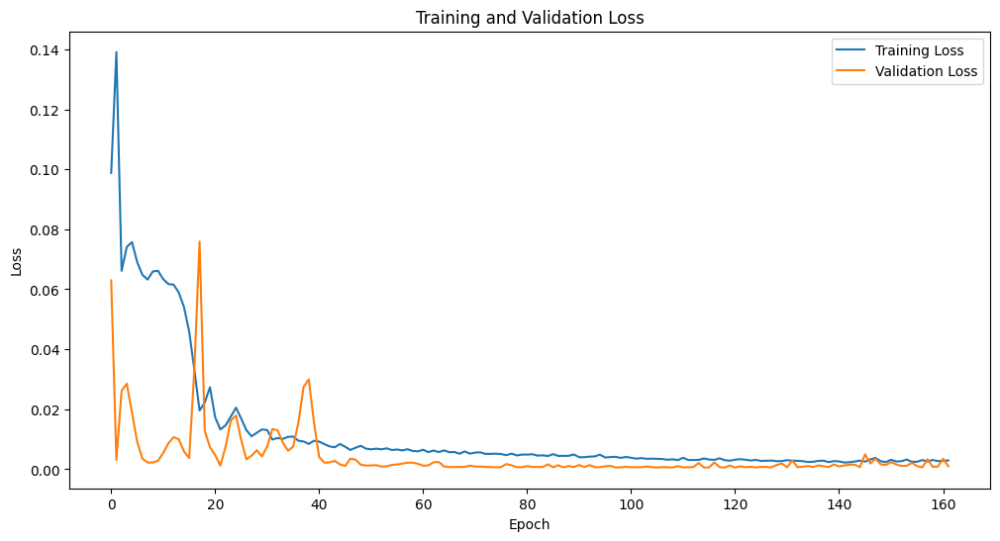

Epoch [1/2500], Train Loss: 0.0757, Val Loss: 0.0983
Epoch [2/2500], Train Loss: 0.1930, Val Loss: 0.0033
Epoch [3/2500], Train Loss: 0.0646, Val Loss: 0.0309
Epoch [4/2500], Train Loss: 0.0771, Val Loss: 0.0362
Epoch [5/2500], Train Loss: 0.0813, Val Loss: 0.0258
Epoch [6/2500], Train Loss: 0.0739, Val Loss: 0.0120
Epoch [7/2500], Train Loss: 0.0660, Val Loss: 0.0028
Epoch [8/2500], Train Loss: 0.0649, Val Loss: 0.0026
Epoch [9/2500], Train Loss: 0.0680, Val Loss: 0.0029
Epoch [10/2500], Train Loss: 0.0651, Val Loss: 0.0094
Epoch [11/2500], Train Loss: 0.0653, Val Loss: 0.0132
Epoch [12/2500], Train Loss: 0.0669, Val Loss: 0.0105
Epoch [13/2500], Train Loss: 0.0649, Val Loss: 0.0062
Epoch [14/2500], Train Loss: 0.0642, Val Loss: 0.0036
Epoch [15/2500], Train Loss: 0.0653, Val Loss: 0.0028
Epoch [16/2500], Train Loss: 0.0646, Val Loss: 0.0030
Epoch [17/2500], Train Loss: 0.0643, Val Loss: 0.0038
Epoch [18/2500], Train Loss: 0.0641, Val Loss: 0.0054
Epoch [19/2500], Train Loss: 0.0638, 

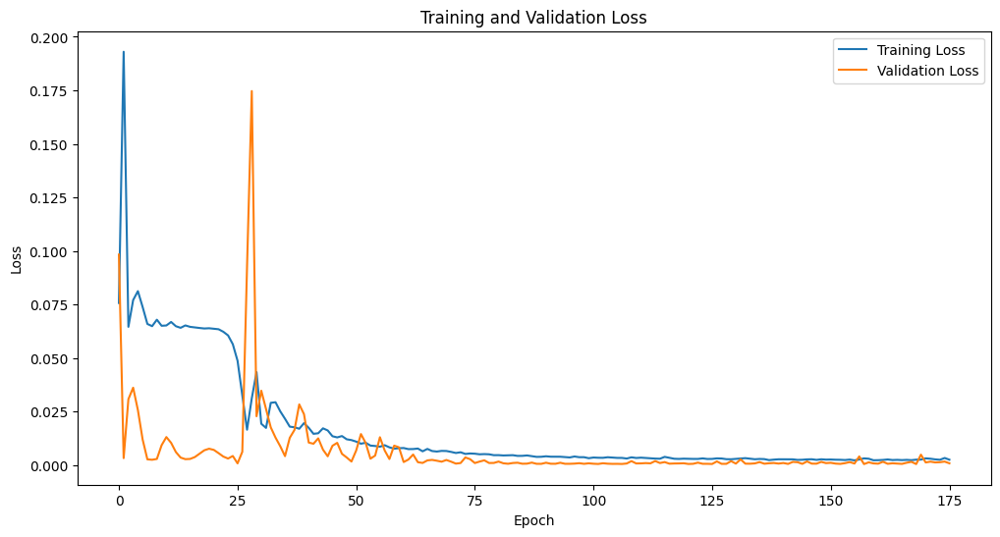

Epoch [1/2500], Train Loss: 0.1297, Val Loss: 0.0334
Epoch [2/2500], Train Loss: 0.1151, Val Loss: 0.0047
Epoch [3/2500], Train Loss: 0.0639, Val Loss: 0.0299
Epoch [4/2500], Train Loss: 0.0767, Val Loss: 0.0236
Epoch [5/2500], Train Loss: 0.0722, Val Loss: 0.0093
Epoch [6/2500], Train Loss: 0.0645, Val Loss: 0.0028
Epoch [7/2500], Train Loss: 0.0644, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0675, Val Loss: 0.0023
Epoch [9/2500], Train Loss: 0.0662, Val Loss: 0.0037
Epoch [10/2500], Train Loss: 0.0641, Val Loss: 0.0073
Epoch [11/2500], Train Loss: 0.0643, Val Loss: 0.0092
Epoch [12/2500], Train Loss: 0.0648, Val Loss: 0.0076
Epoch [13/2500], Train Loss: 0.0643, Val Loss: 0.0047
Epoch [14/2500], Train Loss: 0.0638, Val Loss: 0.0031
Epoch [15/2500], Train Loss: 0.0641, Val Loss: 0.0030
Epoch [16/2500], Train Loss: 0.0643, Val Loss: 0.0041
Epoch [17/2500], Train Loss: 0.0638, Val Loss: 0.0060
Epoch [18/2500], Train Loss: 0.0637, Val Loss: 0.0076
Epoch [19/2500], Train Loss: 0.0640, 

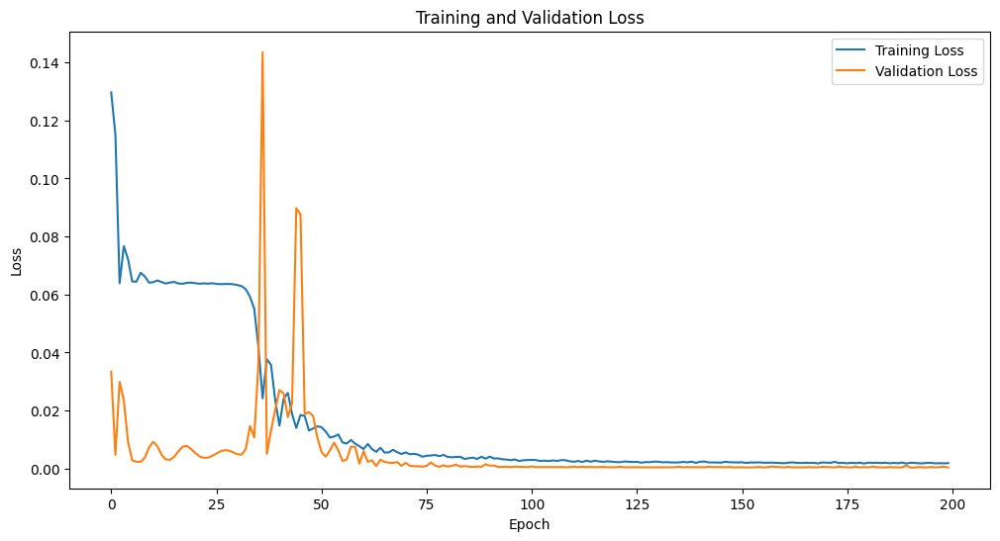

Epoch [1/2500], Train Loss: 0.2080, Val Loss: 0.0099
Epoch [2/2500], Train Loss: 0.0694, Val Loss: 0.0526
Epoch [3/2500], Train Loss: 0.1362, Val Loss: 0.0053
Epoch [4/2500], Train Loss: 0.0675, Val Loss: 0.0441
Epoch [5/2500], Train Loss: 0.0879, Val Loss: 0.0331
Epoch [6/2500], Train Loss: 0.0818, Val Loss: 0.0128
Epoch [7/2500], Train Loss: 0.0673, Val Loss: 0.0030
Epoch [8/2500], Train Loss: 0.0670, Val Loss: 0.0025
Epoch [9/2500], Train Loss: 0.0686, Val Loss: 0.0023
Epoch [10/2500], Train Loss: 0.0676, Val Loss: 0.0042
Epoch [11/2500], Train Loss: 0.0651, Val Loss: 0.0068
Epoch [12/2500], Train Loss: 0.0648, Val Loss: 0.0070
Epoch [13/2500], Train Loss: 0.0653, Val Loss: 0.0043
Epoch [14/2500], Train Loss: 0.0652, Val Loss: 0.0029
Epoch [15/2500], Train Loss: 0.0658, Val Loss: 0.0028
Epoch [16/2500], Train Loss: 0.0653, Val Loss: 0.0034
Epoch [17/2500], Train Loss: 0.0643, Val Loss: 0.0045
Epoch [18/2500], Train Loss: 0.0651, Val Loss: 0.0052
Epoch [19/2500], Train Loss: 0.0644, 

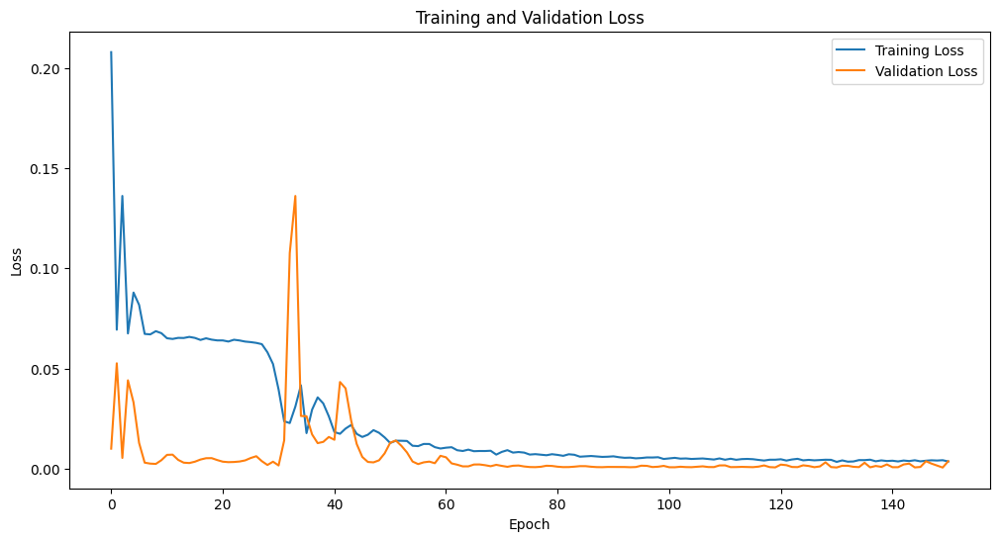

Epoch [1/2500], Train Loss: 0.3092, Val Loss: 0.0023
Epoch [2/2500], Train Loss: 0.0685, Val Loss: 0.0106
Epoch [3/2500], Train Loss: 0.0861, Val Loss: 0.0184
Epoch [4/2500], Train Loss: 0.0692, Val Loss: 0.0208
Epoch [5/2500], Train Loss: 0.0722, Val Loss: 0.0037
Epoch [6/2500], Train Loss: 0.0646, Val Loss: 0.0025
Epoch [7/2500], Train Loss: 0.0700, Val Loss: 0.0026
Epoch [8/2500], Train Loss: 0.0653, Val Loss: 0.0069
Epoch [9/2500], Train Loss: 0.0649, Val Loss: 0.0115
Epoch [10/2500], Train Loss: 0.0664, Val Loss: 0.0109
Epoch [11/2500], Train Loss: 0.0660, Val Loss: 0.0069
Epoch [12/2500], Train Loss: 0.0645, Val Loss: 0.0038
Epoch [13/2500], Train Loss: 0.0644, Val Loss: 0.0027
Epoch [14/2500], Train Loss: 0.0649, Val Loss: 0.0028
Epoch [15/2500], Train Loss: 0.0650, Val Loss: 0.0040
Epoch [16/2500], Train Loss: 0.0643, Val Loss: 0.0062
Epoch [17/2500], Train Loss: 0.0640, Val Loss: 0.0081
Epoch [18/2500], Train Loss: 0.0645, Val Loss: 0.0082
Epoch [19/2500], Train Loss: 0.0646, 

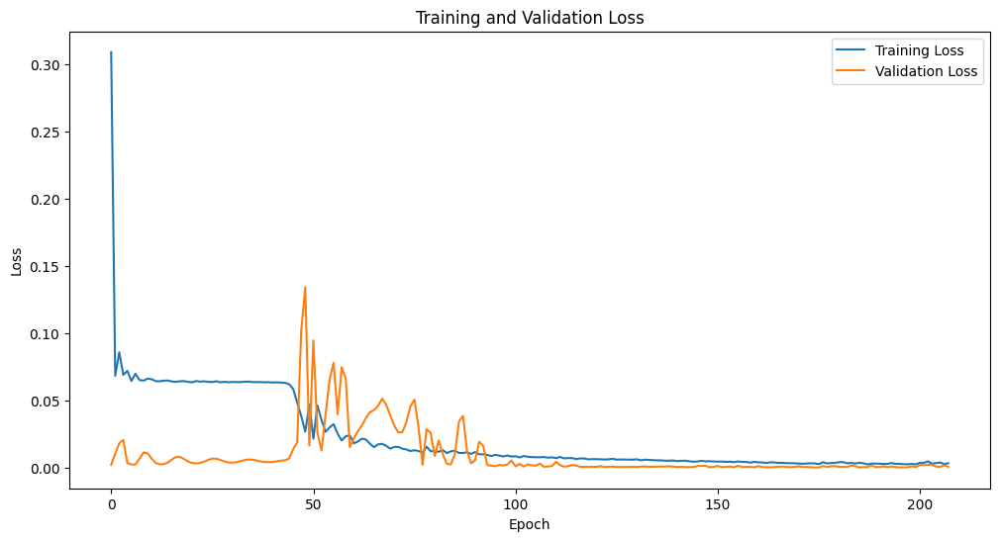

Epoch [1/2500], Train Loss: 0.1669, Val Loss: 0.0042
Epoch [2/2500], Train Loss: 0.0735, Val Loss: 0.0030
Epoch [3/2500], Train Loss: 0.0644, Val Loss: 0.0271
Epoch [4/2500], Train Loss: 0.0749, Val Loss: 0.0056
Epoch [5/2500], Train Loss: 0.0639, Val Loss: 0.0028
Epoch [6/2500], Train Loss: 0.0691, Val Loss: 0.0023
Epoch [7/2500], Train Loss: 0.0672, Val Loss: 0.0055
Epoch [8/2500], Train Loss: 0.0637, Val Loss: 0.0129
Epoch [9/2500], Train Loss: 0.0661, Val Loss: 0.0139
Epoch [10/2500], Train Loss: 0.0666, Val Loss: 0.0088
Epoch [11/2500], Train Loss: 0.0646, Val Loss: 0.0042
Epoch [12/2500], Train Loss: 0.0640, Val Loss: 0.0026
Epoch [13/2500], Train Loss: 0.0649, Val Loss: 0.0024
Epoch [14/2500], Train Loss: 0.0656, Val Loss: 0.0030
Epoch [15/2500], Train Loss: 0.0644, Val Loss: 0.0050
Epoch [16/2500], Train Loss: 0.0638, Val Loss: 0.0077
Epoch [17/2500], Train Loss: 0.0640, Val Loss: 0.0094
Epoch [18/2500], Train Loss: 0.0647, Val Loss: 0.0090
Epoch [19/2500], Train Loss: 0.0644, 

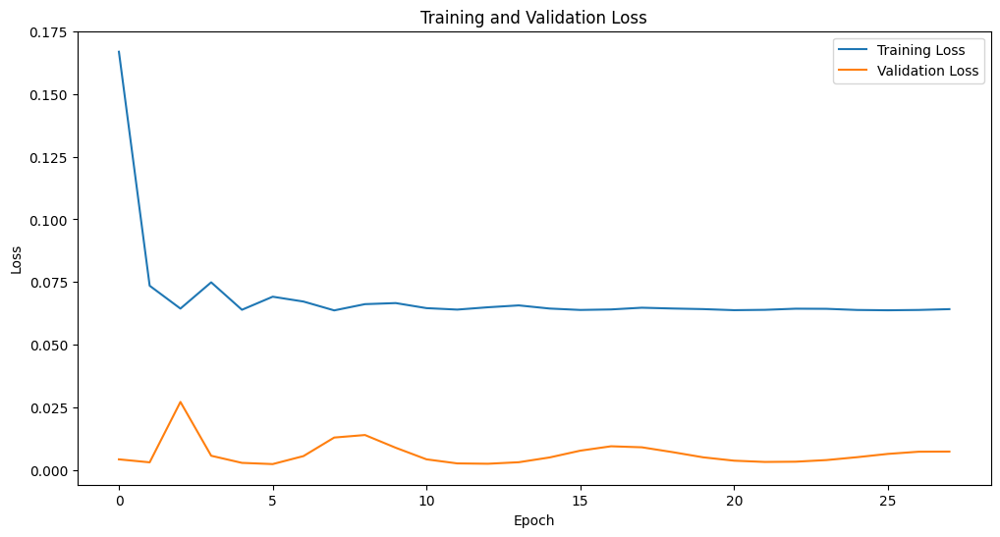

Epoch [1/2500], Train Loss: 0.0830, Val Loss: 0.0655
Epoch [2/2500], Train Loss: 0.1492, Val Loss: 0.0029
Epoch [3/2500], Train Loss: 0.0652, Val Loss: 0.0197
Epoch [4/2500], Train Loss: 0.0700, Val Loss: 0.0232
Epoch [5/2500], Train Loss: 0.0728, Val Loss: 0.0145
Epoch [6/2500], Train Loss: 0.0681, Val Loss: 0.0052
Epoch [7/2500], Train Loss: 0.0645, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0678, Val Loss: 0.0024
Epoch [9/2500], Train Loss: 0.0656, Val Loss: 0.0060
Epoch [10/2500], Train Loss: 0.0649, Val Loss: 0.0117
Epoch [11/2500], Train Loss: 0.0655, Val Loss: 0.0099
Epoch [12/2500], Train Loss: 0.0656, Val Loss: 0.0055
Epoch [13/2500], Train Loss: 0.0637, Val Loss: 0.0032
Epoch [14/2500], Train Loss: 0.0645, Val Loss: 0.0028
Epoch [15/2500], Train Loss: 0.0651, Val Loss: 0.0033
Epoch [16/2500], Train Loss: 0.0645, Val Loss: 0.0047
Epoch [17/2500], Train Loss: 0.0644, Val Loss: 0.0064
Epoch [18/2500], Train Loss: 0.0642, Val Loss: 0.0077
Epoch [19/2500], Train Loss: 0.0640, 

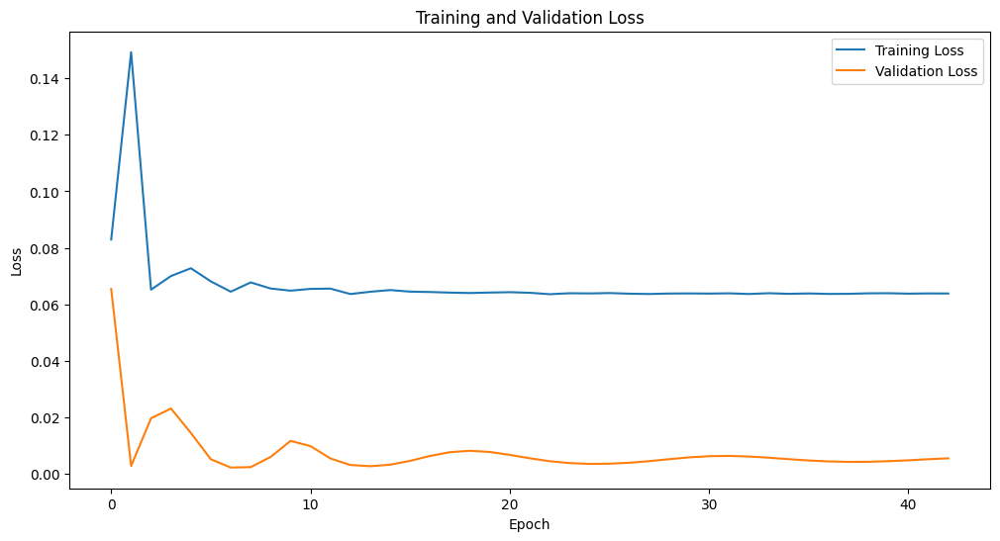

Epoch [1/2500], Train Loss: 0.1050, Val Loss: 0.1594
Epoch [2/2500], Train Loss: 0.2073, Val Loss: 0.0167
Epoch [3/2500], Train Loss: 0.0681, Val Loss: 0.0472
Epoch [4/2500], Train Loss: 0.0868, Val Loss: 0.0284
Epoch [5/2500], Train Loss: 0.0745, Val Loss: 0.0096
Epoch [6/2500], Train Loss: 0.0610, Val Loss: 0.0020
Epoch [7/2500], Train Loss: 0.0560, Val Loss: 0.0032
Epoch [8/2500], Train Loss: 0.0567, Val Loss: 0.0019
Epoch [9/2500], Train Loss: 0.0509, Val Loss: 0.0101
Epoch [10/2500], Train Loss: 0.0434, Val Loss: 0.0259
Epoch [11/2500], Train Loss: 0.0363, Val Loss: 0.0117
Epoch [12/2500], Train Loss: 0.0199, Val Loss: 0.0014
Epoch [13/2500], Train Loss: 0.0176, Val Loss: 0.0715
Epoch [14/2500], Train Loss: 0.0196, Val Loss: 0.0065
Epoch [15/2500], Train Loss: 0.0115, Val Loss: 0.0240
Epoch [16/2500], Train Loss: 0.0144, Val Loss: 0.0010
Epoch [17/2500], Train Loss: 0.0062, Val Loss: 0.0009
Epoch [18/2500], Train Loss: 0.0128, Val Loss: 0.0023
Epoch [19/2500], Train Loss: 0.0103, 

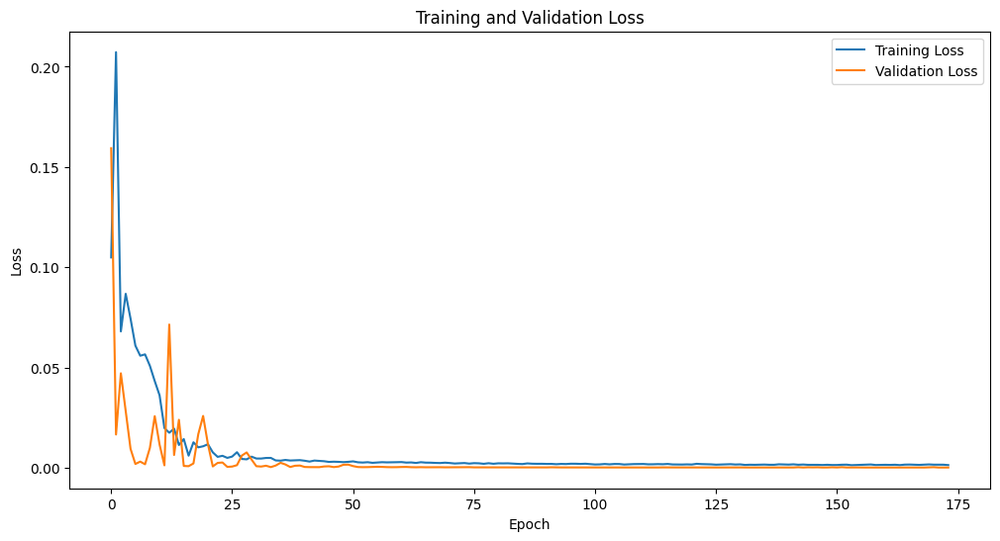

Epoch [1/2500], Train Loss: 0.1004, Val Loss: 0.2789
Epoch [2/2500], Train Loss: 0.3157, Val Loss: 0.0154
Epoch [3/2500], Train Loss: 0.0623, Val Loss: 0.0766
Epoch [4/2500], Train Loss: 0.1011, Val Loss: 0.0498
Epoch [5/2500], Train Loss: 0.0867, Val Loss: 0.0196
Epoch [6/2500], Train Loss: 0.0669, Val Loss: 0.0045
Epoch [7/2500], Train Loss: 0.0558, Val Loss: 0.0022
Epoch [8/2500], Train Loss: 0.0529, Val Loss: 0.0076
Epoch [9/2500], Train Loss: 0.0537, Val Loss: 0.0073
Epoch [10/2500], Train Loss: 0.0487, Val Loss: 0.0016
Epoch [11/2500], Train Loss: 0.0372, Val Loss: 0.0054
Epoch [12/2500], Train Loss: 0.0279, Val Loss: 0.0111
Epoch [13/2500], Train Loss: 0.0171, Val Loss: 0.0005
Epoch [14/2500], Train Loss: 0.0039, Val Loss: 0.0184
Epoch [15/2500], Train Loss: 0.0182, Val Loss: 0.0341
Epoch [16/2500], Train Loss: 0.0288, Val Loss: 0.0023
Epoch [17/2500], Train Loss: 0.0088, Val Loss: 0.0155
Epoch [18/2500], Train Loss: 0.0060, Val Loss: 0.0121
Epoch [19/2500], Train Loss: 0.0077, 

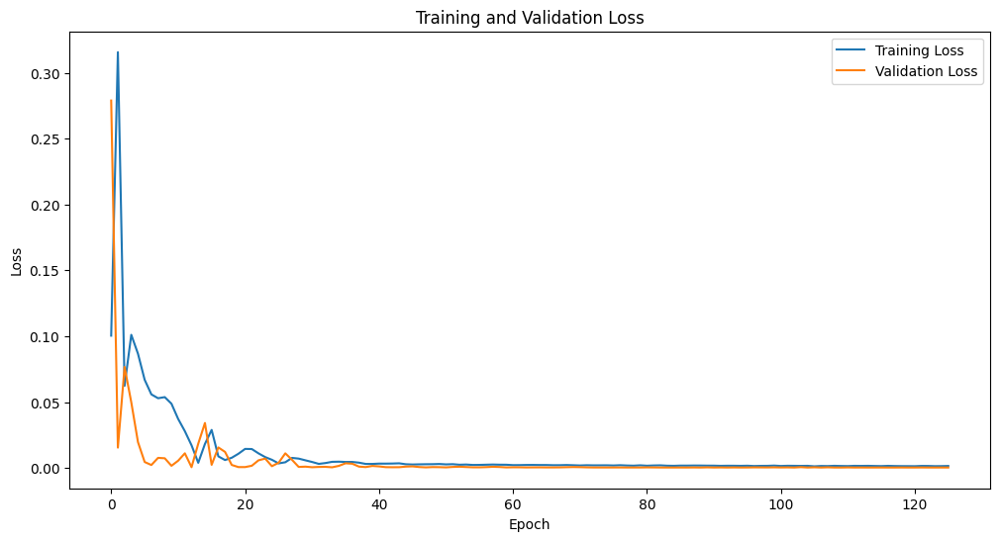

Epoch [1/2500], Train Loss: 0.2355, Val Loss: 0.1017
Epoch [2/2500], Train Loss: 0.1461, Val Loss: 0.0630
Epoch [3/2500], Train Loss: 0.0863, Val Loss: 0.0767
Epoch [4/2500], Train Loss: 0.0939, Val Loss: 0.0235
Epoch [5/2500], Train Loss: 0.0648, Val Loss: 0.0019
Epoch [6/2500], Train Loss: 0.0543, Val Loss: 0.0122
Epoch [7/2500], Train Loss: 0.0614, Val Loss: 0.0067
Epoch [8/2500], Train Loss: 0.0531, Val Loss: 0.0022
Epoch [9/2500], Train Loss: 0.0432, Val Loss: 0.0119
Epoch [10/2500], Train Loss: 0.0412, Val Loss: 0.0157
Epoch [11/2500], Train Loss: 0.0330, Val Loss: 0.0038
Epoch [12/2500], Train Loss: 0.0158, Val Loss: 0.0064
Epoch [13/2500], Train Loss: 0.0158, Val Loss: 0.0017
Epoch [14/2500], Train Loss: 0.0090, Val Loss: 0.0591
Epoch [15/2500], Train Loss: 0.0230, Val Loss: 0.0137
Epoch [16/2500], Train Loss: 0.0122, Val Loss: 0.0080
Epoch [17/2500], Train Loss: 0.0083, Val Loss: 0.0176
Epoch [18/2500], Train Loss: 0.0083, Val Loss: 0.0055
Epoch [19/2500], Train Loss: 0.0074, 

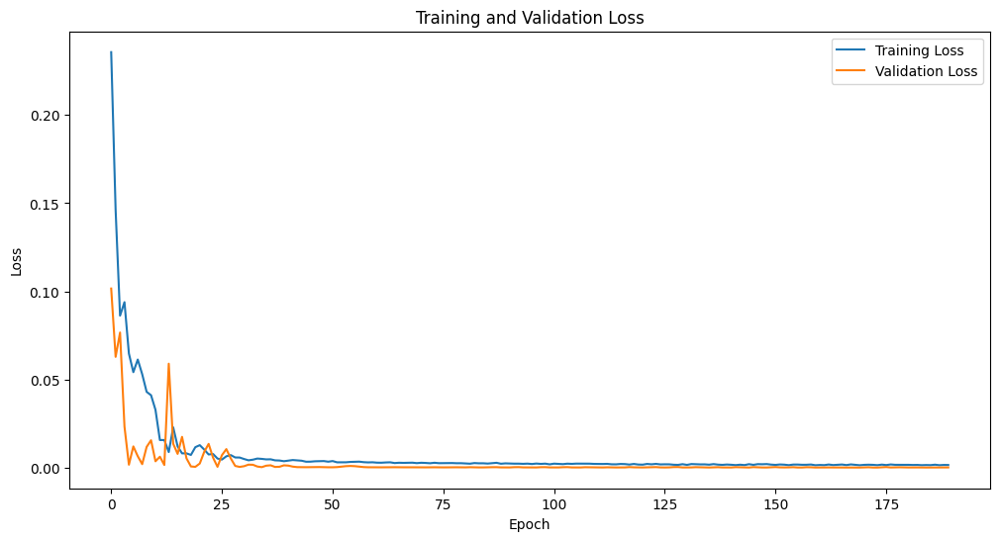

Epoch [1/2500], Train Loss: 0.1107, Val Loss: 0.1333
Epoch [2/2500], Train Loss: 0.2261, Val Loss: 0.0605
Epoch [3/2500], Train Loss: 0.0952, Val Loss: 0.0020
Epoch [4/2500], Train Loss: 0.0625, Val Loss: 0.0033
Epoch [5/2500], Train Loss: 0.0615, Val Loss: 0.0209
Epoch [6/2500], Train Loss: 0.0691, Val Loss: 0.0022
Epoch [7/2500], Train Loss: 0.0569, Val Loss: 0.0062
Epoch [8/2500], Train Loss: 0.0572, Val Loss: 0.0193
Epoch [9/2500], Train Loss: 0.0495, Val Loss: 0.0267
Epoch [10/2500], Train Loss: 0.0359, Val Loss: 0.0140
Epoch [11/2500], Train Loss: 0.0326, Val Loss: 0.0871
Epoch [12/2500], Train Loss: 0.0243, Val Loss: 0.0695
Epoch [13/2500], Train Loss: 0.0195, Val Loss: 0.0011
Epoch [14/2500], Train Loss: 0.0097, Val Loss: 0.0241
Epoch [15/2500], Train Loss: 0.0150, Val Loss: 0.0012
Epoch [16/2500], Train Loss: 0.0118, Val Loss: 0.0027
Epoch [17/2500], Train Loss: 0.0153, Val Loss: 0.0021
Epoch [18/2500], Train Loss: 0.0110, Val Loss: 0.0041
Epoch [19/2500], Train Loss: 0.0077, 

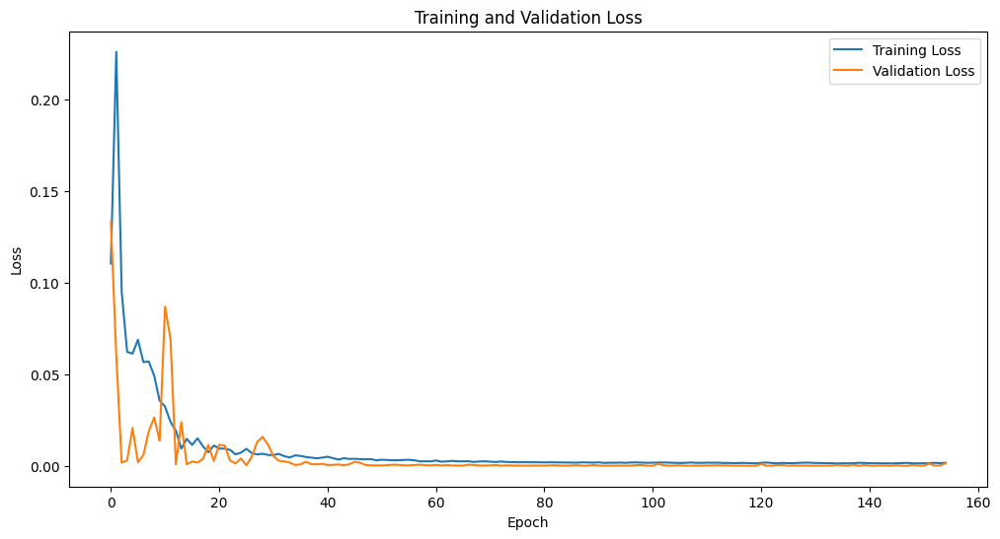

Epoch [1/2500], Train Loss: 0.2468, Val Loss: 0.1087
Epoch [2/2500], Train Loss: 0.2071, Val Loss: 0.0621
Epoch [3/2500], Train Loss: 0.1008, Val Loss: 0.0065
Epoch [4/2500], Train Loss: 0.0629, Val Loss: 0.0141
Epoch [5/2500], Train Loss: 0.0780, Val Loss: 0.2603
Epoch [6/2500], Train Loss: 0.2091, Val Loss: 0.0272
Epoch [7/2500], Train Loss: 0.0701, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0608, Val Loss: 0.0039
Epoch [9/2500], Train Loss: 0.0642, Val Loss: 0.0025
Epoch [10/2500], Train Loss: 0.0574, Val Loss: 0.0106
Epoch [11/2500], Train Loss: 0.0574, Val Loss: 0.0177
Epoch [12/2500], Train Loss: 0.0576, Val Loss: 0.0150
Epoch [13/2500], Train Loss: 0.0509, Val Loss: 0.0062
Epoch [14/2500], Train Loss: 0.0398, Val Loss: 0.0028
Epoch [15/2500], Train Loss: 0.0284, Val Loss: 0.0401
Epoch [16/2500], Train Loss: 0.0156, Val Loss: 0.0709
Epoch [17/2500], Train Loss: 0.0231, Val Loss: 0.0177
Epoch [18/2500], Train Loss: 0.0240, Val Loss: 0.0014
Epoch [19/2500], Train Loss: 0.0056, 

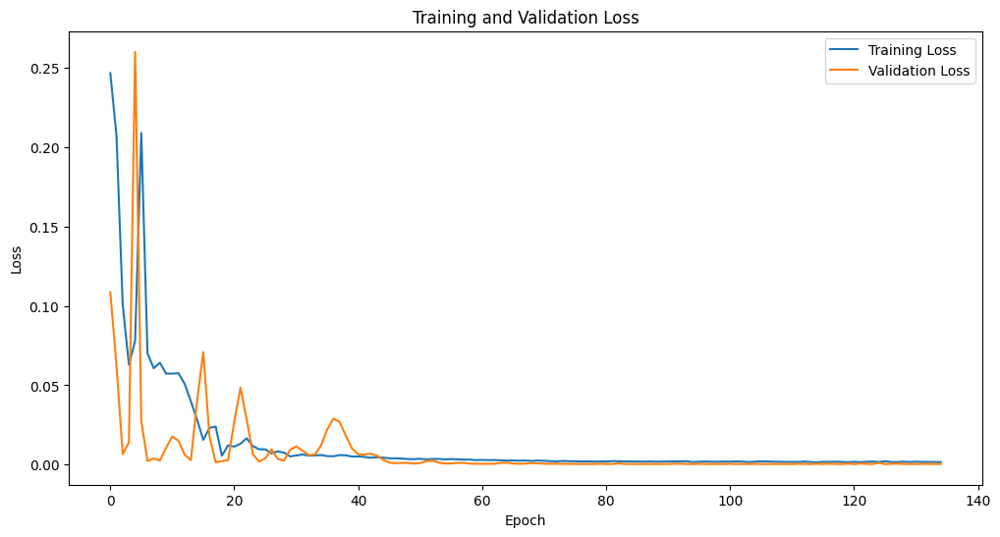

Epoch [1/2500], Train Loss: 0.2203, Val Loss: 0.0801
Epoch [2/2500], Train Loss: 0.1651, Val Loss: 0.1858
Epoch [3/2500], Train Loss: 0.1997, Val Loss: 0.0521
Epoch [4/2500], Train Loss: 0.0936, Val Loss: 0.0172
Epoch [5/2500], Train Loss: 0.0690, Val Loss: 0.0035
Epoch [6/2500], Train Loss: 0.0637, Val Loss: 0.0028
Epoch [7/2500], Train Loss: 0.0685, Val Loss: 0.0024
Epoch [8/2500], Train Loss: 0.0654, Val Loss: 0.0074
Epoch [9/2500], Train Loss: 0.0639, Val Loss: 0.0111
Epoch [10/2500], Train Loss: 0.0645, Val Loss: 0.0067
Epoch [11/2500], Train Loss: 0.0627, Val Loss: 0.0033
Epoch [12/2500], Train Loss: 0.0610, Val Loss: 0.0030
Epoch [13/2500], Train Loss: 0.0580, Val Loss: 0.0061
Epoch [14/2500], Train Loss: 0.0473, Val Loss: 0.0093
Epoch [15/2500], Train Loss: 0.0291, Val Loss: 0.0290
Epoch [16/2500], Train Loss: 0.0209, Val Loss: 0.2741
Epoch [17/2500], Train Loss: 0.1451, Val Loss: 0.0358
Epoch [18/2500], Train Loss: 0.0224, Val Loss: 0.0373
Epoch [19/2500], Train Loss: 0.0483, 

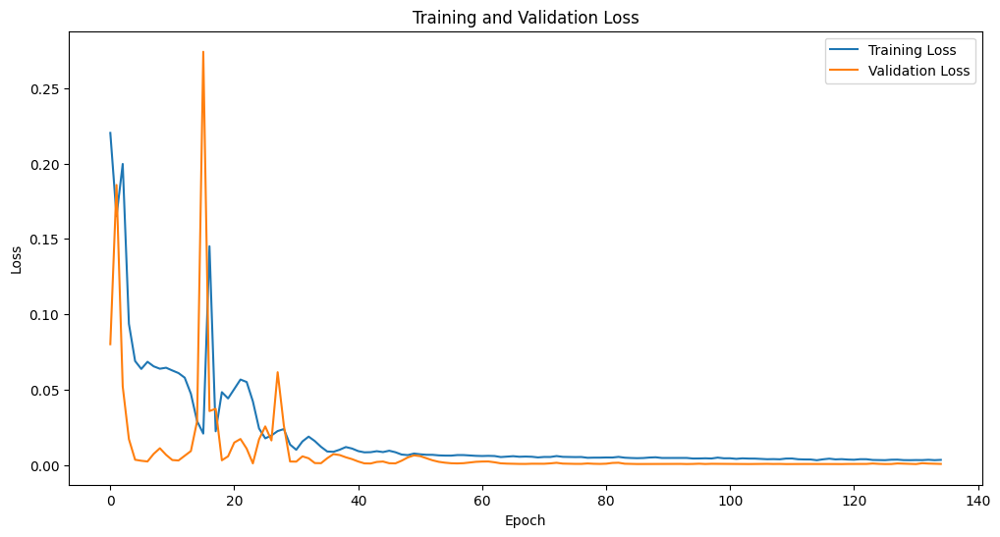

Epoch [1/2500], Train Loss: 0.1630, Val Loss: 0.4054
Epoch [2/2500], Train Loss: 0.5151, Val Loss: 0.0468
Epoch [3/2500], Train Loss: 0.0893, Val Loss: 0.0763
Epoch [4/2500], Train Loss: 0.1117, Val Loss: 0.0574
Epoch [5/2500], Train Loss: 0.0963, Val Loss: 0.0184
Epoch [6/2500], Train Loss: 0.0696, Val Loss: 0.0023
Epoch [7/2500], Train Loss: 0.0673, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0668, Val Loss: 0.0152
Epoch [9/2500], Train Loss: 0.0692, Val Loss: 0.0083
Epoch [10/2500], Train Loss: 0.0658, Val Loss: 0.0024
Epoch [11/2500], Train Loss: 0.0671, Val Loss: 0.0022
Epoch [12/2500], Train Loss: 0.0658, Val Loss: 0.0090
Epoch [13/2500], Train Loss: 0.0655, Val Loss: 0.0035
Epoch [14/2500], Train Loss: 0.0592, Val Loss: 0.0245
Epoch [15/2500], Train Loss: 0.0748, Val Loss: 0.0161
Epoch [16/2500], Train Loss: 0.0620, Val Loss: 0.0218
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0051
Epoch [18/2500], Train Loss: 0.0548, Val Loss: 0.0019
Epoch [19/2500], Train Loss: 0.0540, 

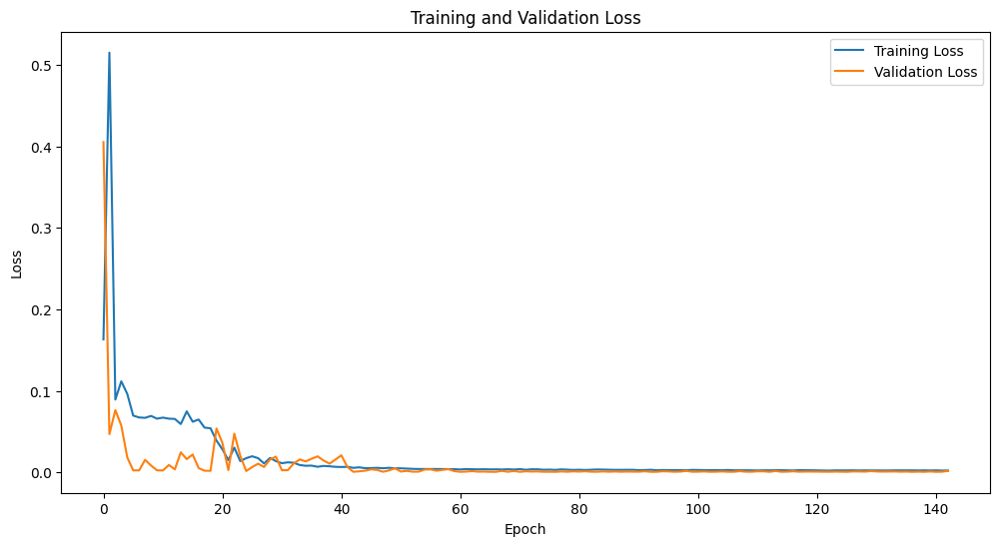

Epoch [1/2500], Train Loss: 0.1494, Val Loss: 0.3788
Epoch [2/2500], Train Loss: 0.5021, Val Loss: 0.0433
Epoch [3/2500], Train Loss: 0.0864, Val Loss: 0.0567
Epoch [4/2500], Train Loss: 0.0965, Val Loss: 0.0413
Epoch [5/2500], Train Loss: 0.0846, Val Loss: 0.0041
Epoch [6/2500], Train Loss: 0.0643, Val Loss: 0.0109
Epoch [7/2500], Train Loss: 0.0824, Val Loss: 0.0403
Epoch [8/2500], Train Loss: 0.0841, Val Loss: 0.0266
Epoch [9/2500], Train Loss: 0.0741, Val Loss: 0.0043
Epoch [10/2500], Train Loss: 0.0639, Val Loss: 0.0027
Epoch [11/2500], Train Loss: 0.0689, Val Loss: 0.0023
Epoch [12/2500], Train Loss: 0.0669, Val Loss: 0.0068
Epoch [13/2500], Train Loss: 0.0641, Val Loss: 0.0142
Epoch [14/2500], Train Loss: 0.0671, Val Loss: 0.0132
Epoch [15/2500], Train Loss: 0.0671, Val Loss: 0.0063
Epoch [16/2500], Train Loss: 0.0639, Val Loss: 0.0025
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0023
Epoch [18/2500], Train Loss: 0.0655, Val Loss: 0.0036
Epoch [19/2500], Train Loss: 0.0629, 

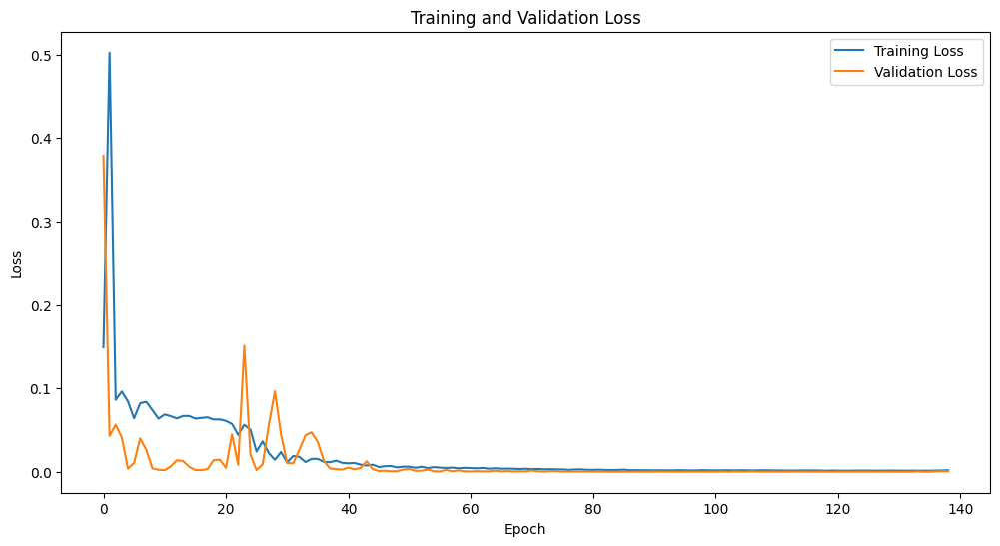

Epoch [1/2500], Train Loss: 0.1318, Val Loss: 0.2919
Epoch [2/2500], Train Loss: 0.3809, Val Loss: 0.0536
Epoch [3/2500], Train Loss: 0.0950, Val Loss: 0.0502
Epoch [4/2500], Train Loss: 0.0927, Val Loss: 0.0168
Epoch [5/2500], Train Loss: 0.0709, Val Loss: 0.0027
Epoch [6/2500], Train Loss: 0.0705, Val Loss: 0.0120
Epoch [7/2500], Train Loss: 0.0693, Val Loss: 0.0029
Epoch [8/2500], Train Loss: 0.0687, Val Loss: 0.0024
Epoch [9/2500], Train Loss: 0.0704, Val Loss: 0.0074
Epoch [10/2500], Train Loss: 0.0693, Val Loss: 0.0028
Epoch [11/2500], Train Loss: 0.0677, Val Loss: 0.0025
Epoch [12/2500], Train Loss: 0.0669, Val Loss: 0.0041
Epoch [13/2500], Train Loss: 0.0667, Val Loss: 0.0051
Epoch [14/2500], Train Loss: 0.0643, Val Loss: 0.0040
Epoch [15/2500], Train Loss: 0.0641, Val Loss: 0.0029
Epoch [16/2500], Train Loss: 0.0656, Val Loss: 0.0032
Epoch [17/2500], Train Loss: 0.0645, Val Loss: 0.0046
Epoch [18/2500], Train Loss: 0.0648, Val Loss: 0.0053
Epoch [19/2500], Train Loss: 0.0644, 

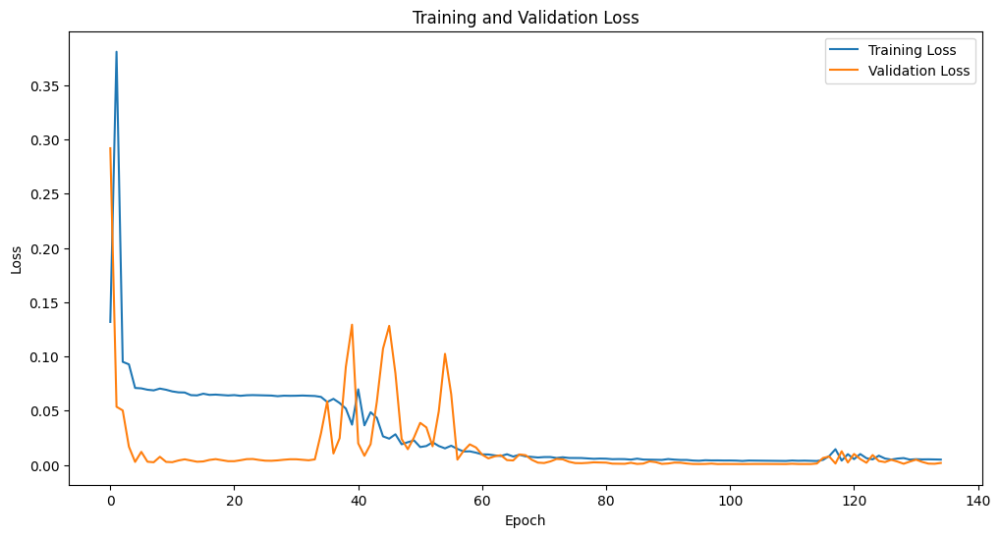

Epoch [1/2500], Train Loss: 0.3402, Val Loss: 0.0072
Epoch [2/2500], Train Loss: 0.0789, Val Loss: 0.0616
Epoch [3/2500], Train Loss: 0.1003, Val Loss: 0.0026
Epoch [4/2500], Train Loss: 0.0657, Val Loss: 0.0162
Epoch [5/2500], Train Loss: 0.0691, Val Loss: 0.0393
Epoch [6/2500], Train Loss: 0.1212, Val Loss: 0.0447
Epoch [7/2500], Train Loss: 0.0840, Val Loss: 0.0023
Epoch [8/2500], Train Loss: 0.0662, Val Loss: 0.0031
Epoch [9/2500], Train Loss: 0.0637, Val Loss: 0.0199
Epoch [10/2500], Train Loss: 0.0700, Val Loss: 0.0170
Epoch [11/2500], Train Loss: 0.0686, Val Loss: 0.0042
Epoch [12/2500], Train Loss: 0.0641, Val Loss: 0.0025
Epoch [13/2500], Train Loss: 0.0688, Val Loss: 0.0025
Epoch [14/2500], Train Loss: 0.0655, Val Loss: 0.0094
Epoch [15/2500], Train Loss: 0.0647, Val Loss: 0.0144
Epoch [16/2500], Train Loss: 0.0672, Val Loss: 0.0082
Epoch [17/2500], Train Loss: 0.0644, Val Loss: 0.0034
Epoch [18/2500], Train Loss: 0.0641, Val Loss: 0.0025
Epoch [19/2500], Train Loss: 0.0654, 

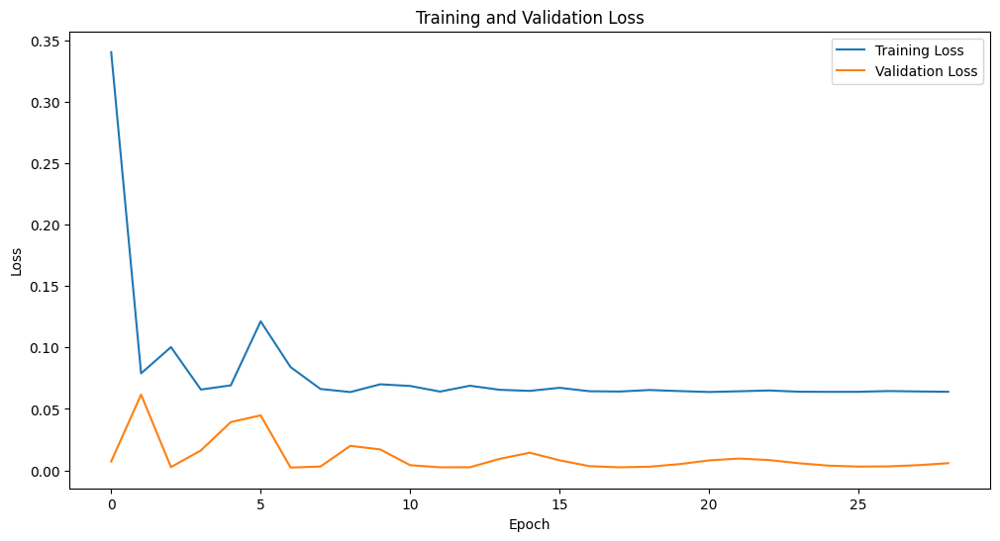

Epoch [1/2500], Train Loss: 0.1966, Val Loss: 0.1997
Epoch [2/2500], Train Loss: 0.3093, Val Loss: 0.0772
Epoch [3/2500], Train Loss: 0.1127, Val Loss: 0.0521
Epoch [4/2500], Train Loss: 0.0928, Val Loss: 0.0024
Epoch [5/2500], Train Loss: 0.0684, Val Loss: 0.0282
Epoch [6/2500], Train Loss: 0.0758, Val Loss: 0.0024
Epoch [7/2500], Train Loss: 0.0682, Val Loss: 0.0042
Epoch [8/2500], Train Loss: 0.0640, Val Loss: 0.0149
Epoch [9/2500], Train Loss: 0.0673, Val Loss: 0.0033
Epoch [10/2500], Train Loss: 0.0648, Val Loss: 0.0024
Epoch [11/2500], Train Loss: 0.0659, Val Loss: 0.0095
Epoch [12/2500], Train Loss: 0.0655, Val Loss: 0.0091
Epoch [13/2500], Train Loss: 0.0647, Val Loss: 0.0026
Epoch [14/2500], Train Loss: 0.0618, Val Loss: 0.0268
Epoch [15/2500], Train Loss: 0.0701, Val Loss: 0.0093
Epoch [16/2500], Train Loss: 0.0743, Val Loss: 0.0020
Epoch [17/2500], Train Loss: 0.0605, Val Loss: 0.0113
Epoch [18/2500], Train Loss: 0.0571, Val Loss: 0.0069
Epoch [19/2500], Train Loss: 0.0458, 

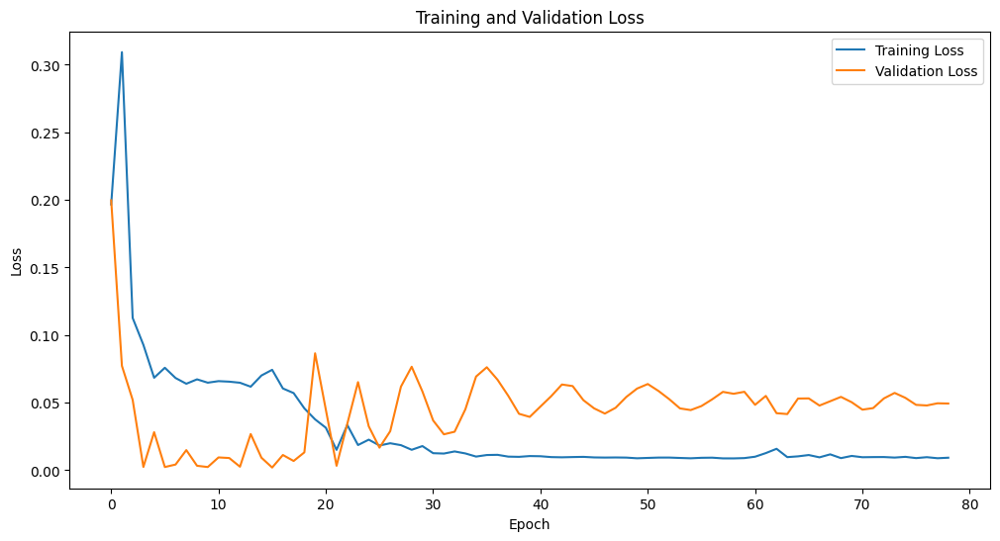

Epoch [1/2500], Train Loss: 0.1964, Val Loss: 0.2522
Epoch [2/2500], Train Loss: 0.3377, Val Loss: 0.0751
Epoch [3/2500], Train Loss: 0.1109, Val Loss: 0.0654
Epoch [4/2500], Train Loss: 0.1057, Val Loss: 0.0063
Epoch [5/2500], Train Loss: 0.0682, Val Loss: 0.0218
Epoch [6/2500], Train Loss: 0.0907, Val Loss: 0.0470
Epoch [7/2500], Train Loss: 0.0927, Val Loss: 0.0217
Epoch [8/2500], Train Loss: 0.0765, Val Loss: 0.0032
Epoch [9/2500], Train Loss: 0.0701, Val Loss: 0.0089
Epoch [10/2500], Train Loss: 0.0754, Val Loss: 0.0023
Epoch [11/2500], Train Loss: 0.0675, Val Loss: 0.0104
Epoch [12/2500], Train Loss: 0.0683, Val Loss: 0.0171
Epoch [13/2500], Train Loss: 0.0732, Val Loss: 0.0110
Epoch [14/2500], Train Loss: 0.0677, Val Loss: 0.0037
Epoch [15/2500], Train Loss: 0.0647, Val Loss: 0.0024
Epoch [16/2500], Train Loss: 0.0665, Val Loss: 0.0029
Epoch [17/2500], Train Loss: 0.0661, Val Loss: 0.0022
Epoch [18/2500], Train Loss: 0.0636, Val Loss: 0.0104
Epoch [19/2500], Train Loss: 0.0500, 

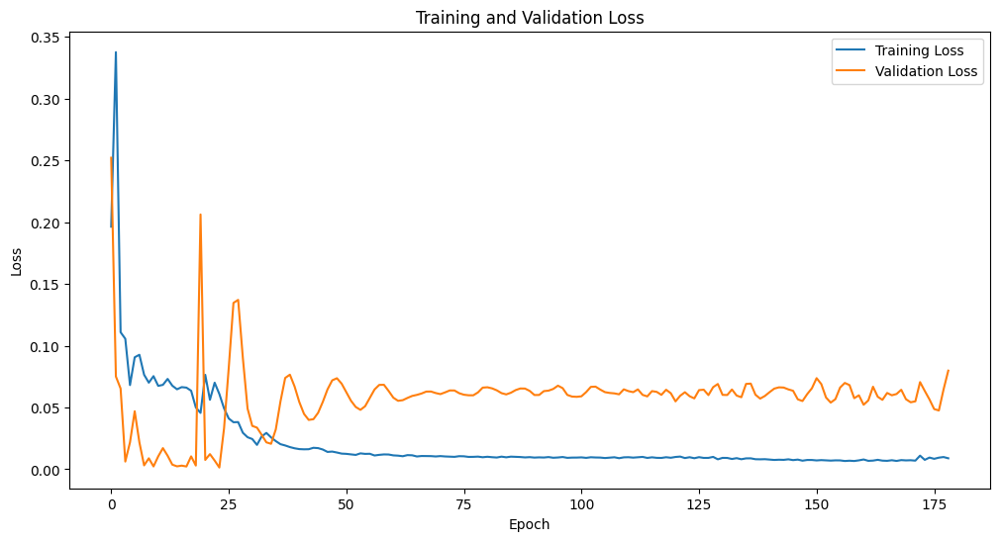

Epoch [1/2500], Train Loss: 0.1631, Val Loss: 0.1296
Epoch [2/2500], Train Loss: 0.1612, Val Loss: 0.1280
Epoch [3/2500], Train Loss: 0.1605, Val Loss: 0.1264
Epoch [4/2500], Train Loss: 0.1587, Val Loss: 0.1248
Epoch [5/2500], Train Loss: 0.1576, Val Loss: 0.1232
Epoch [6/2500], Train Loss: 0.1560, Val Loss: 0.1216
Epoch [7/2500], Train Loss: 0.1542, Val Loss: 0.1200
Epoch [8/2500], Train Loss: 0.1526, Val Loss: 0.1185
Epoch [9/2500], Train Loss: 0.1521, Val Loss: 0.1169
Epoch [10/2500], Train Loss: 0.1507, Val Loss: 0.1154
Epoch [11/2500], Train Loss: 0.1490, Val Loss: 0.1139
Epoch [12/2500], Train Loss: 0.1479, Val Loss: 0.1124
Epoch [13/2500], Train Loss: 0.1477, Val Loss: 0.1109
Epoch [14/2500], Train Loss: 0.1461, Val Loss: 0.1095
Epoch [15/2500], Train Loss: 0.1437, Val Loss: 0.1080
Epoch [16/2500], Train Loss: 0.1430, Val Loss: 0.1066
Epoch [17/2500], Train Loss: 0.1419, Val Loss: 0.1052
Epoch [18/2500], Train Loss: 0.1407, Val Loss: 0.1038
Epoch [19/2500], Train Loss: 0.1402, 

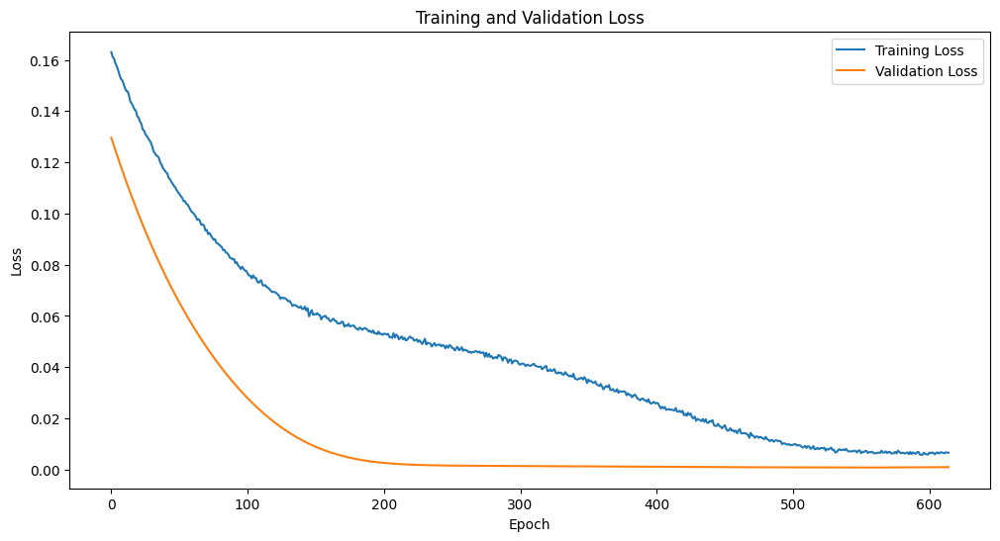

Epoch [1/2500], Train Loss: 0.3341, Val Loss: 0.3215
Epoch [2/2500], Train Loss: 0.3313, Val Loss: 0.3185
Epoch [3/2500], Train Loss: 0.3275, Val Loss: 0.3156
Epoch [4/2500], Train Loss: 0.3248, Val Loss: 0.3126
Epoch [5/2500], Train Loss: 0.3222, Val Loss: 0.3097
Epoch [6/2500], Train Loss: 0.3206, Val Loss: 0.3068
Epoch [7/2500], Train Loss: 0.3171, Val Loss: 0.3039
Epoch [8/2500], Train Loss: 0.3155, Val Loss: 0.3011
Epoch [9/2500], Train Loss: 0.3125, Val Loss: 0.2983
Epoch [10/2500], Train Loss: 0.3099, Val Loss: 0.2954
Epoch [11/2500], Train Loss: 0.3069, Val Loss: 0.2926
Epoch [12/2500], Train Loss: 0.3056, Val Loss: 0.2899
Epoch [13/2500], Train Loss: 0.3019, Val Loss: 0.2871
Epoch [14/2500], Train Loss: 0.3003, Val Loss: 0.2844
Epoch [15/2500], Train Loss: 0.2975, Val Loss: 0.2817
Epoch [16/2500], Train Loss: 0.2943, Val Loss: 0.2790
Epoch [17/2500], Train Loss: 0.2918, Val Loss: 0.2763
Epoch [18/2500], Train Loss: 0.2907, Val Loss: 0.2736
Epoch [19/2500], Train Loss: 0.2871, 

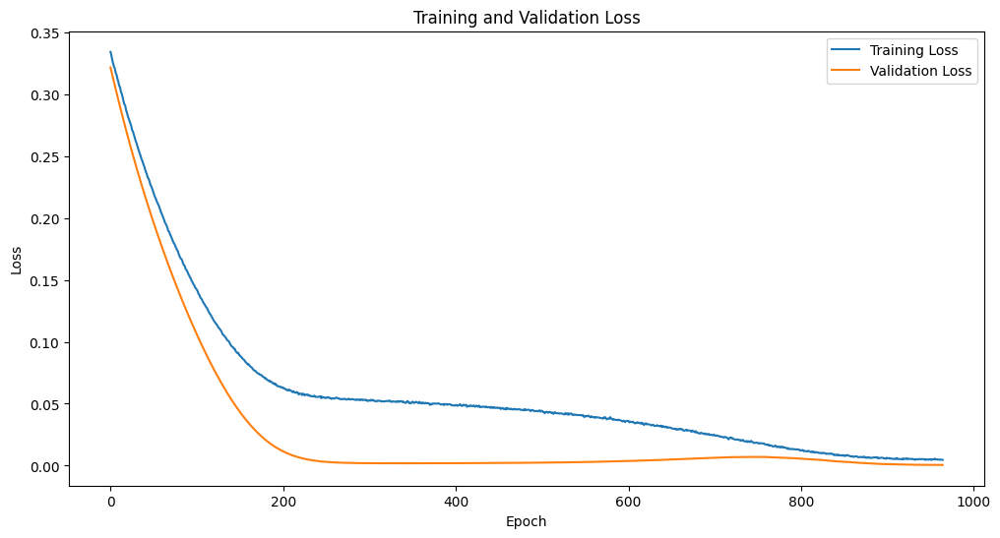

Epoch [1/2500], Train Loss: 0.2031, Val Loss: 0.2096
Epoch [2/2500], Train Loss: 0.2004, Val Loss: 0.2067
Epoch [3/2500], Train Loss: 0.1977, Val Loss: 0.2040
Epoch [4/2500], Train Loss: 0.1950, Val Loss: 0.2012
Epoch [5/2500], Train Loss: 0.1935, Val Loss: 0.1984
Epoch [6/2500], Train Loss: 0.1908, Val Loss: 0.1957
Epoch [7/2500], Train Loss: 0.1904, Val Loss: 0.1930
Epoch [8/2500], Train Loss: 0.1871, Val Loss: 0.1903
Epoch [9/2500], Train Loss: 0.1819, Val Loss: 0.1876
Epoch [10/2500], Train Loss: 0.1823, Val Loss: 0.1850
Epoch [11/2500], Train Loss: 0.1800, Val Loss: 0.1823
Epoch [12/2500], Train Loss: 0.1794, Val Loss: 0.1797
Epoch [13/2500], Train Loss: 0.1780, Val Loss: 0.1771
Epoch [14/2500], Train Loss: 0.1756, Val Loss: 0.1745
Epoch [15/2500], Train Loss: 0.1721, Val Loss: 0.1720
Epoch [16/2500], Train Loss: 0.1709, Val Loss: 0.1695
Epoch [17/2500], Train Loss: 0.1676, Val Loss: 0.1670
Epoch [18/2500], Train Loss: 0.1673, Val Loss: 0.1645
Epoch [19/2500], Train Loss: 0.1647, 

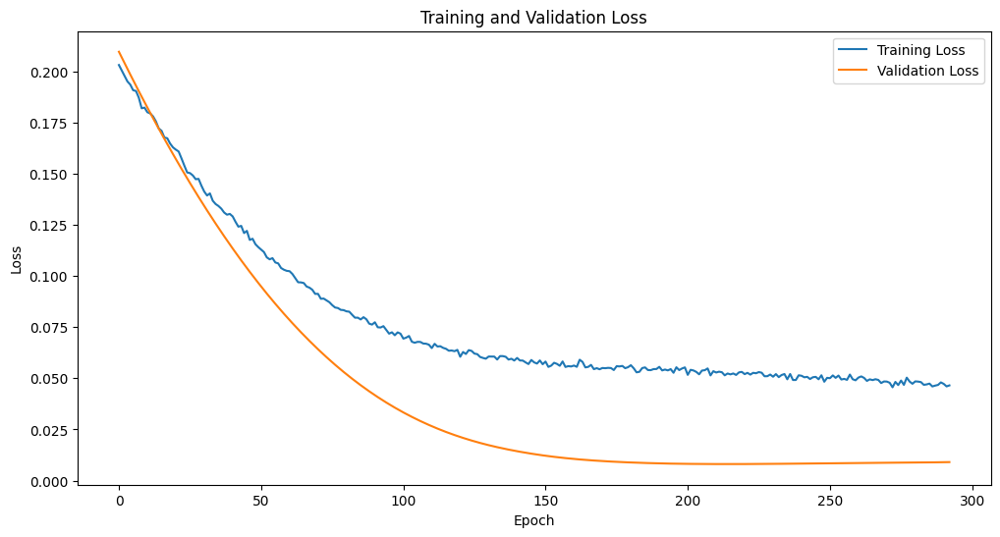

Epoch [1/2500], Train Loss: 0.0721, Val Loss: 0.0208
Epoch [2/2500], Train Loss: 0.0715, Val Loss: 0.0202
Epoch [3/2500], Train Loss: 0.0711, Val Loss: 0.0196
Epoch [4/2500], Train Loss: 0.0709, Val Loss: 0.0190
Epoch [5/2500], Train Loss: 0.0702, Val Loss: 0.0184
Epoch [6/2500], Train Loss: 0.0698, Val Loss: 0.0179
Epoch [7/2500], Train Loss: 0.0697, Val Loss: 0.0173
Epoch [8/2500], Train Loss: 0.0692, Val Loss: 0.0168
Epoch [9/2500], Train Loss: 0.0692, Val Loss: 0.0162
Epoch [10/2500], Train Loss: 0.0691, Val Loss: 0.0157
Epoch [11/2500], Train Loss: 0.0682, Val Loss: 0.0152
Epoch [12/2500], Train Loss: 0.0683, Val Loss: 0.0147
Epoch [13/2500], Train Loss: 0.0677, Val Loss: 0.0142
Epoch [14/2500], Train Loss: 0.0676, Val Loss: 0.0138
Epoch [15/2500], Train Loss: 0.0670, Val Loss: 0.0133
Epoch [16/2500], Train Loss: 0.0675, Val Loss: 0.0129
Epoch [17/2500], Train Loss: 0.0669, Val Loss: 0.0124
Epoch [18/2500], Train Loss: 0.0664, Val Loss: 0.0120
Epoch [19/2500], Train Loss: 0.0666, 

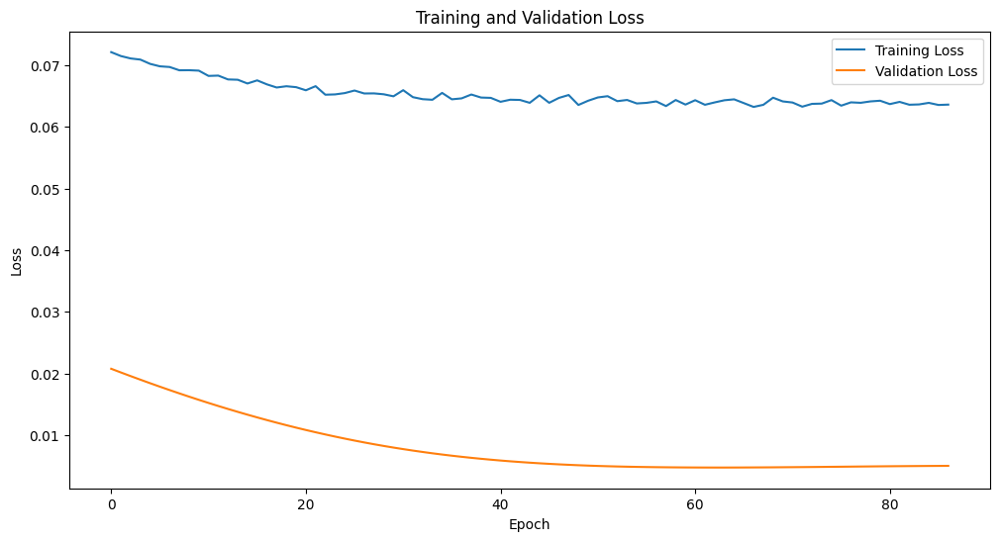

Epoch [1/2500], Train Loss: 0.1019, Val Loss: 0.0631
Epoch [2/2500], Train Loss: 0.1012, Val Loss: 0.0619
Epoch [3/2500], Train Loss: 0.1001, Val Loss: 0.0608
Epoch [4/2500], Train Loss: 0.0990, Val Loss: 0.0596
Epoch [5/2500], Train Loss: 0.0983, Val Loss: 0.0584
Epoch [6/2500], Train Loss: 0.0972, Val Loss: 0.0573
Epoch [7/2500], Train Loss: 0.0968, Val Loss: 0.0562
Epoch [8/2500], Train Loss: 0.0958, Val Loss: 0.0551
Epoch [9/2500], Train Loss: 0.0954, Val Loss: 0.0540
Epoch [10/2500], Train Loss: 0.0938, Val Loss: 0.0529
Epoch [11/2500], Train Loss: 0.0931, Val Loss: 0.0518
Epoch [12/2500], Train Loss: 0.0922, Val Loss: 0.0508
Epoch [13/2500], Train Loss: 0.0914, Val Loss: 0.0497
Epoch [14/2500], Train Loss: 0.0907, Val Loss: 0.0487
Epoch [15/2500], Train Loss: 0.0897, Val Loss: 0.0477
Epoch [16/2500], Train Loss: 0.0898, Val Loss: 0.0467
Epoch [17/2500], Train Loss: 0.0888, Val Loss: 0.0457
Epoch [18/2500], Train Loss: 0.0879, Val Loss: 0.0448
Epoch [19/2500], Train Loss: 0.0872, 

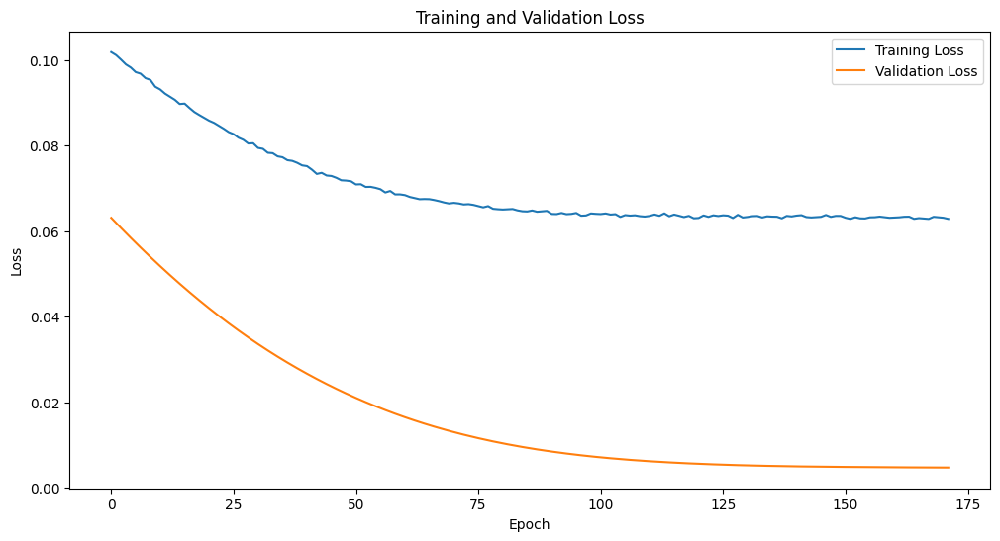

Epoch [1/2500], Train Loss: 0.2319, Val Loss: 0.2128
Epoch [2/2500], Train Loss: 0.2344, Val Loss: 0.2109
Epoch [3/2500], Train Loss: 0.2341, Val Loss: 0.2090
Epoch [4/2500], Train Loss: 0.2284, Val Loss: 0.2071
Epoch [5/2500], Train Loss: 0.2282, Val Loss: 0.2053
Epoch [6/2500], Train Loss: 0.2249, Val Loss: 0.2034
Epoch [7/2500], Train Loss: 0.2246, Val Loss: 0.2016
Epoch [8/2500], Train Loss: 0.2217, Val Loss: 0.1998
Epoch [9/2500], Train Loss: 0.2212, Val Loss: 0.1980
Epoch [10/2500], Train Loss: 0.2189, Val Loss: 0.1962
Epoch [11/2500], Train Loss: 0.2196, Val Loss: 0.1944
Epoch [12/2500], Train Loss: 0.2160, Val Loss: 0.1926
Epoch [13/2500], Train Loss: 0.2156, Val Loss: 0.1908
Epoch [14/2500], Train Loss: 0.2155, Val Loss: 0.1890
Epoch [15/2500], Train Loss: 0.2133, Val Loss: 0.1873
Epoch [16/2500], Train Loss: 0.2132, Val Loss: 0.1855
Epoch [17/2500], Train Loss: 0.2080, Val Loss: 0.1838
Epoch [18/2500], Train Loss: 0.2091, Val Loss: 0.1821
Epoch [19/2500], Train Loss: 0.2069, 

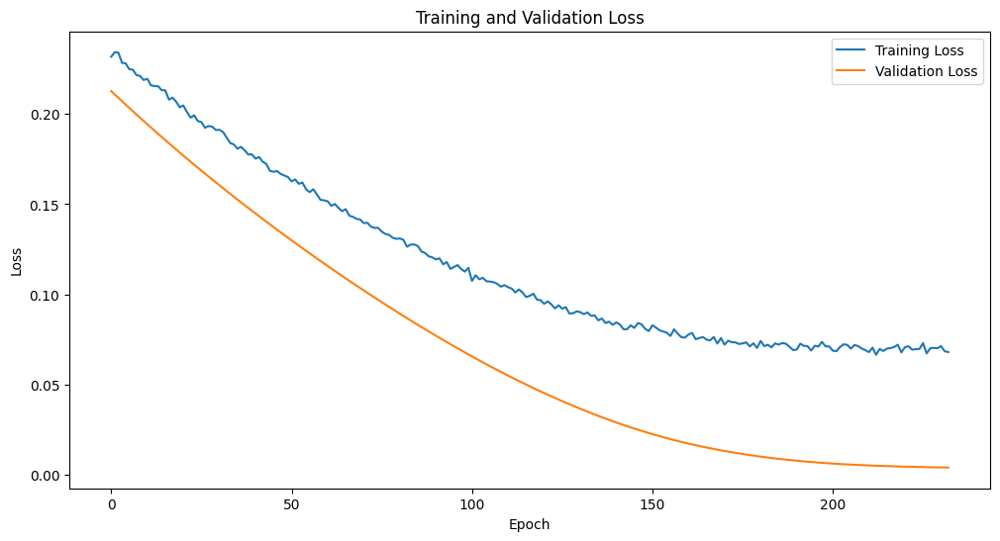

Epoch [1/2500], Train Loss: 0.1087, Val Loss: 0.0702
Epoch [2/2500], Train Loss: 0.1072, Val Loss: 0.0689
Epoch [3/2500], Train Loss: 0.1065, Val Loss: 0.0677
Epoch [4/2500], Train Loss: 0.1056, Val Loss: 0.0664
Epoch [5/2500], Train Loss: 0.1057, Val Loss: 0.0652
Epoch [6/2500], Train Loss: 0.1032, Val Loss: 0.0640
Epoch [7/2500], Train Loss: 0.1038, Val Loss: 0.0628
Epoch [8/2500], Train Loss: 0.1026, Val Loss: 0.0616
Epoch [9/2500], Train Loss: 0.0999, Val Loss: 0.0604
Epoch [10/2500], Train Loss: 0.1000, Val Loss: 0.0593
Epoch [11/2500], Train Loss: 0.0985, Val Loss: 0.0581
Epoch [12/2500], Train Loss: 0.0979, Val Loss: 0.0570
Epoch [13/2500], Train Loss: 0.0975, Val Loss: 0.0559
Epoch [14/2500], Train Loss: 0.0961, Val Loss: 0.0548
Epoch [15/2500], Train Loss: 0.0954, Val Loss: 0.0537
Epoch [16/2500], Train Loss: 0.0953, Val Loss: 0.0526
Epoch [17/2500], Train Loss: 0.0935, Val Loss: 0.0516
Epoch [18/2500], Train Loss: 0.0938, Val Loss: 0.0506
Epoch [19/2500], Train Loss: 0.0924, 

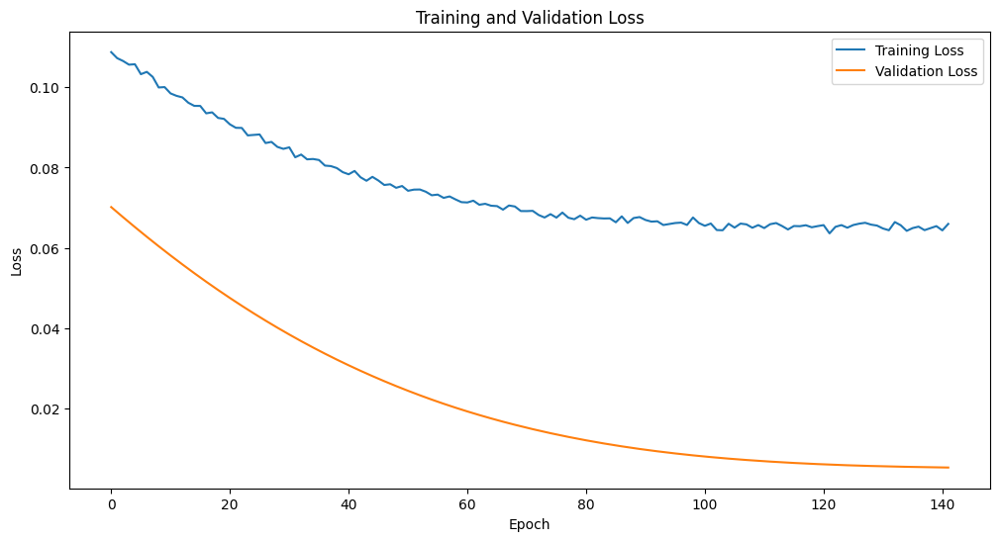

Epoch [1/2500], Train Loss: 0.1437, Val Loss: 0.1133
Epoch [2/2500], Train Loss: 0.1422, Val Loss: 0.1119
Epoch [3/2500], Train Loss: 0.1414, Val Loss: 0.1105
Epoch [4/2500], Train Loss: 0.1404, Val Loss: 0.1092
Epoch [5/2500], Train Loss: 0.1386, Val Loss: 0.1078
Epoch [6/2500], Train Loss: 0.1379, Val Loss: 0.1064
Epoch [7/2500], Train Loss: 0.1370, Val Loss: 0.1051
Epoch [8/2500], Train Loss: 0.1350, Val Loss: 0.1037
Epoch [9/2500], Train Loss: 0.1345, Val Loss: 0.1024
Epoch [10/2500], Train Loss: 0.1334, Val Loss: 0.1010
Epoch [11/2500], Train Loss: 0.1322, Val Loss: 0.0997
Epoch [12/2500], Train Loss: 0.1306, Val Loss: 0.0984
Epoch [13/2500], Train Loss: 0.1296, Val Loss: 0.0971
Epoch [14/2500], Train Loss: 0.1293, Val Loss: 0.0959
Epoch [15/2500], Train Loss: 0.1283, Val Loss: 0.0946
Epoch [16/2500], Train Loss: 0.1267, Val Loss: 0.0933
Epoch [17/2500], Train Loss: 0.1258, Val Loss: 0.0921
Epoch [18/2500], Train Loss: 0.1242, Val Loss: 0.0908
Epoch [19/2500], Train Loss: 0.1234, 

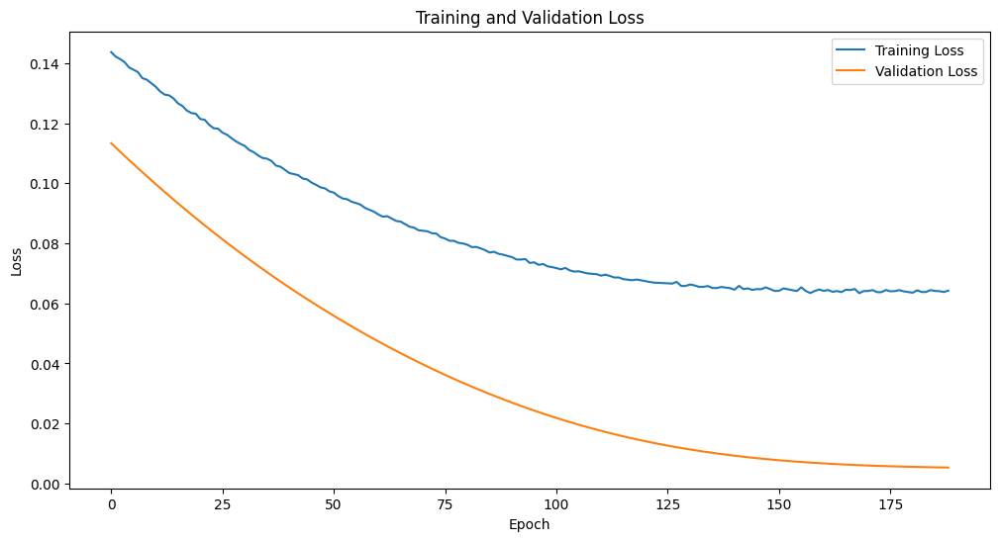

Epoch [1/2500], Train Loss: 0.1778, Val Loss: 0.1520
Epoch [2/2500], Train Loss: 0.1774, Val Loss: 0.1498
Epoch [3/2500], Train Loss: 0.1733, Val Loss: 0.1476
Epoch [4/2500], Train Loss: 0.1730, Val Loss: 0.1455
Epoch [5/2500], Train Loss: 0.1688, Val Loss: 0.1434
Epoch [6/2500], Train Loss: 0.1690, Val Loss: 0.1412
Epoch [7/2500], Train Loss: 0.1664, Val Loss: 0.1391
Epoch [8/2500], Train Loss: 0.1644, Val Loss: 0.1371
Epoch [9/2500], Train Loss: 0.1633, Val Loss: 0.1350
Epoch [10/2500], Train Loss: 0.1626, Val Loss: 0.1330
Epoch [11/2500], Train Loss: 0.1588, Val Loss: 0.1309
Epoch [12/2500], Train Loss: 0.1576, Val Loss: 0.1289
Epoch [13/2500], Train Loss: 0.1543, Val Loss: 0.1269
Epoch [14/2500], Train Loss: 0.1532, Val Loss: 0.1250
Epoch [15/2500], Train Loss: 0.1545, Val Loss: 0.1230
Epoch [16/2500], Train Loss: 0.1524, Val Loss: 0.1211
Epoch [17/2500], Train Loss: 0.1492, Val Loss: 0.1192
Epoch [18/2500], Train Loss: 0.1485, Val Loss: 0.1173
Epoch [19/2500], Train Loss: 0.1465, 

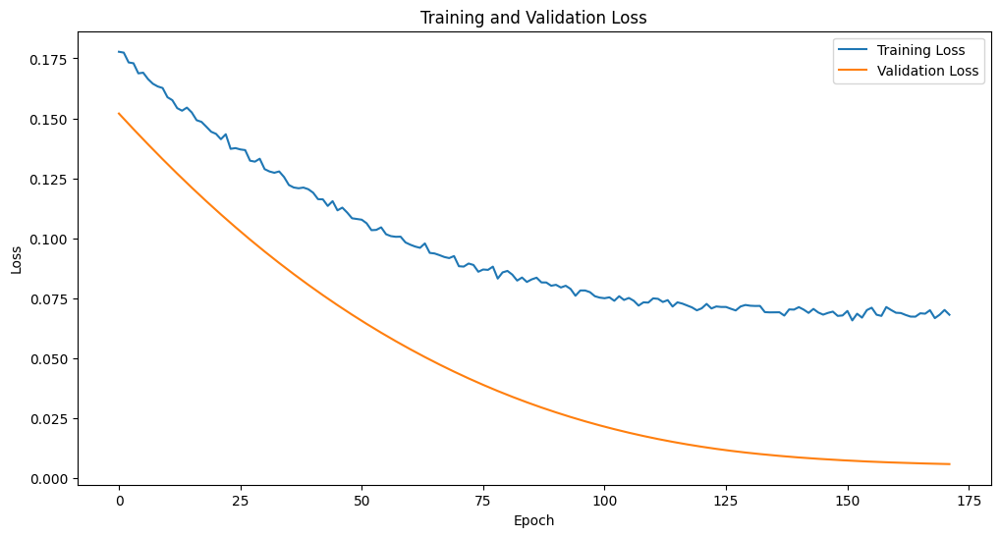

Epoch [1/2500], Train Loss: 0.0731, Val Loss: 0.0241
Epoch [2/2500], Train Loss: 0.0731, Val Loss: 0.0237
Epoch [3/2500], Train Loss: 0.0728, Val Loss: 0.0232
Epoch [4/2500], Train Loss: 0.0718, Val Loss: 0.0228
Epoch [5/2500], Train Loss: 0.0719, Val Loss: 0.0223
Epoch [6/2500], Train Loss: 0.0718, Val Loss: 0.0219
Epoch [7/2500], Train Loss: 0.0714, Val Loss: 0.0215
Epoch [8/2500], Train Loss: 0.0716, Val Loss: 0.0211
Epoch [9/2500], Train Loss: 0.0705, Val Loss: 0.0207
Epoch [10/2500], Train Loss: 0.0709, Val Loss: 0.0202
Epoch [11/2500], Train Loss: 0.0702, Val Loss: 0.0198
Epoch [12/2500], Train Loss: 0.0702, Val Loss: 0.0194
Epoch [13/2500], Train Loss: 0.0702, Val Loss: 0.0190
Epoch [14/2500], Train Loss: 0.0696, Val Loss: 0.0187
Epoch [15/2500], Train Loss: 0.0694, Val Loss: 0.0183
Epoch [16/2500], Train Loss: 0.0692, Val Loss: 0.0179
Epoch [17/2500], Train Loss: 0.0689, Val Loss: 0.0175
Epoch [18/2500], Train Loss: 0.0691, Val Loss: 0.0172
Epoch [19/2500], Train Loss: 0.0687, 

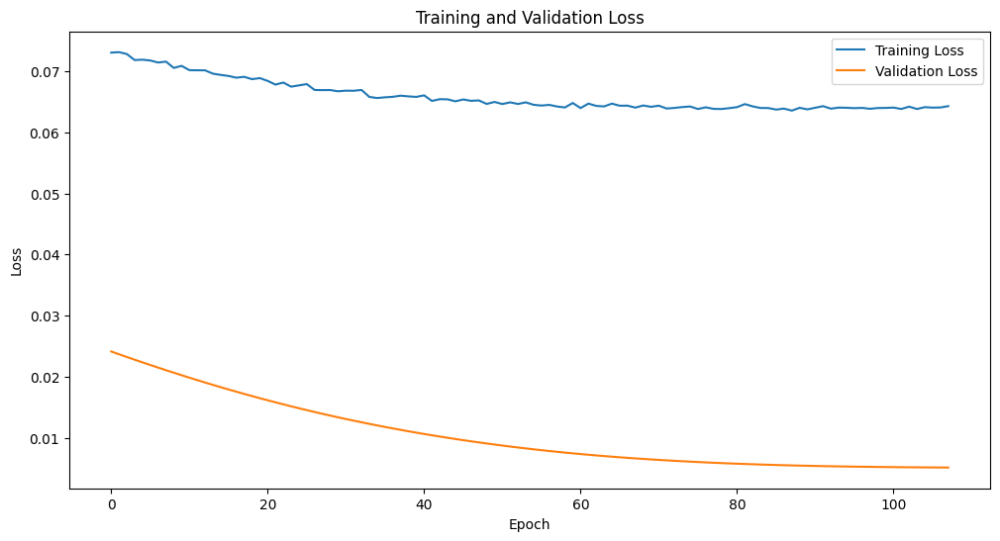

Epoch [1/2500], Train Loss: 0.0733, Val Loss: 0.0241
Epoch [2/2500], Train Loss: 0.0726, Val Loss: 0.0236
Epoch [3/2500], Train Loss: 0.0723, Val Loss: 0.0230
Epoch [4/2500], Train Loss: 0.0720, Val Loss: 0.0224
Epoch [5/2500], Train Loss: 0.0714, Val Loss: 0.0219
Epoch [6/2500], Train Loss: 0.0712, Val Loss: 0.0214
Epoch [7/2500], Train Loss: 0.0709, Val Loss: 0.0208
Epoch [8/2500], Train Loss: 0.0705, Val Loss: 0.0203
Epoch [9/2500], Train Loss: 0.0703, Val Loss: 0.0198
Epoch [10/2500], Train Loss: 0.0697, Val Loss: 0.0193
Epoch [11/2500], Train Loss: 0.0698, Val Loss: 0.0188
Epoch [12/2500], Train Loss: 0.0693, Val Loss: 0.0183
Epoch [13/2500], Train Loss: 0.0693, Val Loss: 0.0179
Epoch [14/2500], Train Loss: 0.0689, Val Loss: 0.0174
Epoch [15/2500], Train Loss: 0.0685, Val Loss: 0.0170
Epoch [16/2500], Train Loss: 0.0682, Val Loss: 0.0165
Epoch [17/2500], Train Loss: 0.0681, Val Loss: 0.0161
Epoch [18/2500], Train Loss: 0.0678, Val Loss: 0.0157
Epoch [19/2500], Train Loss: 0.0674, 

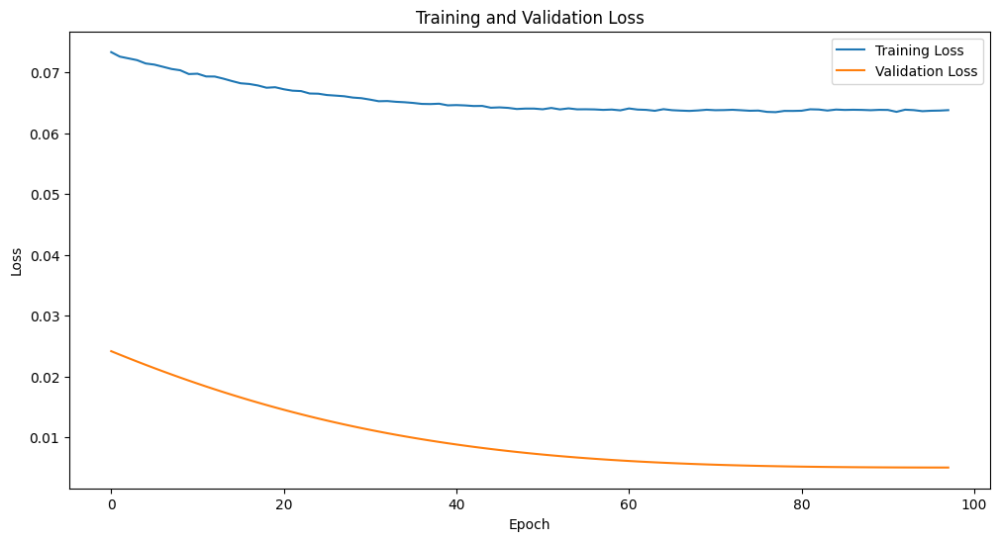

Epoch [1/2500], Train Loss: 0.3364, Val Loss: 0.3326
Epoch [2/2500], Train Loss: 0.3337, Val Loss: 0.3303
Epoch [3/2500], Train Loss: 0.3313, Val Loss: 0.3279
Epoch [4/2500], Train Loss: 0.3313, Val Loss: 0.3256
Epoch [5/2500], Train Loss: 0.3277, Val Loss: 0.3232
Epoch [6/2500], Train Loss: 0.3256, Val Loss: 0.3209
Epoch [7/2500], Train Loss: 0.3229, Val Loss: 0.3186
Epoch [8/2500], Train Loss: 0.3221, Val Loss: 0.3163
Epoch [9/2500], Train Loss: 0.3193, Val Loss: 0.3140
Epoch [10/2500], Train Loss: 0.3167, Val Loss: 0.3117
Epoch [11/2500], Train Loss: 0.3156, Val Loss: 0.3095
Epoch [12/2500], Train Loss: 0.3132, Val Loss: 0.3072
Epoch [13/2500], Train Loss: 0.3132, Val Loss: 0.3050
Epoch [14/2500], Train Loss: 0.3088, Val Loss: 0.3027
Epoch [15/2500], Train Loss: 0.3058, Val Loss: 0.3005
Epoch [16/2500], Train Loss: 0.3051, Val Loss: 0.2983
Epoch [17/2500], Train Loss: 0.3046, Val Loss: 0.2961
Epoch [18/2500], Train Loss: 0.3029, Val Loss: 0.2939
Epoch [19/2500], Train Loss: 0.3009, 

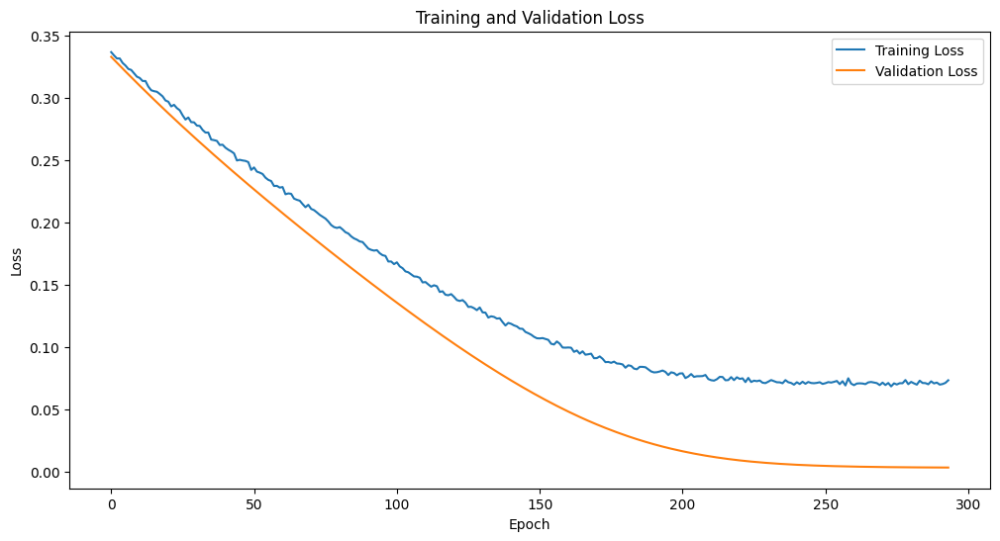

Epoch [1/2500], Train Loss: 0.1698, Val Loss: 0.1601
Epoch [2/2500], Train Loss: 0.1676, Val Loss: 0.1566
Epoch [3/2500], Train Loss: 0.1642, Val Loss: 0.1531
Epoch [4/2500], Train Loss: 0.1610, Val Loss: 0.1497
Epoch [5/2500], Train Loss: 0.1596, Val Loss: 0.1464
Epoch [6/2500], Train Loss: 0.1571, Val Loss: 0.1431
Epoch [7/2500], Train Loss: 0.1539, Val Loss: 0.1399
Epoch [8/2500], Train Loss: 0.1524, Val Loss: 0.1367
Epoch [9/2500], Train Loss: 0.1494, Val Loss: 0.1336
Epoch [10/2500], Train Loss: 0.1476, Val Loss: 0.1305
Epoch [11/2500], Train Loss: 0.1453, Val Loss: 0.1275
Epoch [12/2500], Train Loss: 0.1429, Val Loss: 0.1246
Epoch [13/2500], Train Loss: 0.1406, Val Loss: 0.1216
Epoch [14/2500], Train Loss: 0.1389, Val Loss: 0.1188
Epoch [15/2500], Train Loss: 0.1369, Val Loss: 0.1160
Epoch [16/2500], Train Loss: 0.1338, Val Loss: 0.1132
Epoch [17/2500], Train Loss: 0.1317, Val Loss: 0.1105
Epoch [18/2500], Train Loss: 0.1306, Val Loss: 0.1079
Epoch [19/2500], Train Loss: 0.1286, 

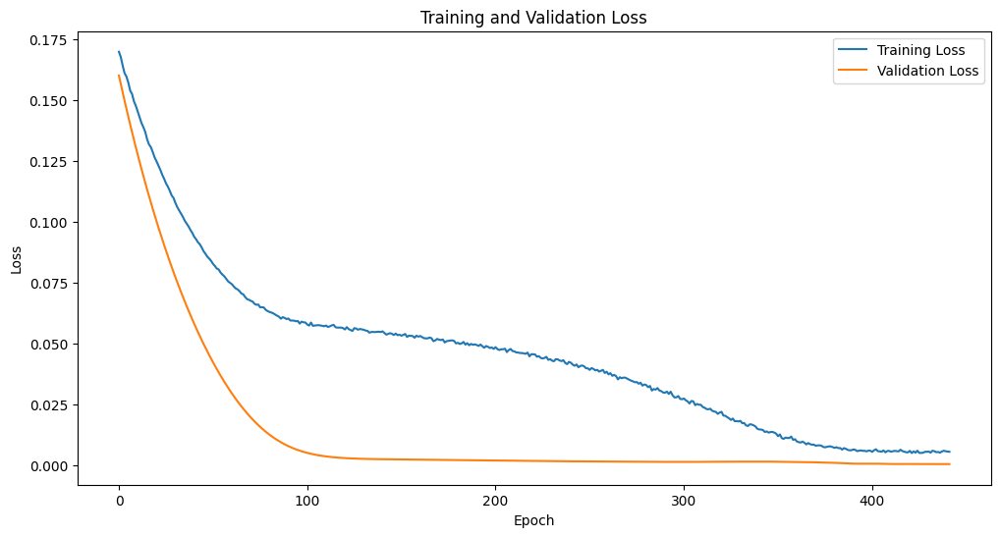

Epoch [1/2500], Train Loss: 0.1930, Val Loss: 0.1727
Epoch [2/2500], Train Loss: 0.1908, Val Loss: 0.1696
Epoch [3/2500], Train Loss: 0.1881, Val Loss: 0.1666
Epoch [4/2500], Train Loss: 0.1858, Val Loss: 0.1636
Epoch [5/2500], Train Loss: 0.1832, Val Loss: 0.1607
Epoch [6/2500], Train Loss: 0.1800, Val Loss: 0.1578
Epoch [7/2500], Train Loss: 0.1783, Val Loss: 0.1549
Epoch [8/2500], Train Loss: 0.1754, Val Loss: 0.1521
Epoch [9/2500], Train Loss: 0.1732, Val Loss: 0.1492
Epoch [10/2500], Train Loss: 0.1704, Val Loss: 0.1465
Epoch [11/2500], Train Loss: 0.1685, Val Loss: 0.1437
Epoch [12/2500], Train Loss: 0.1662, Val Loss: 0.1410
Epoch [13/2500], Train Loss: 0.1639, Val Loss: 0.1383
Epoch [14/2500], Train Loss: 0.1617, Val Loss: 0.1356
Epoch [15/2500], Train Loss: 0.1594, Val Loss: 0.1330
Epoch [16/2500], Train Loss: 0.1571, Val Loss: 0.1304
Epoch [17/2500], Train Loss: 0.1552, Val Loss: 0.1278
Epoch [18/2500], Train Loss: 0.1525, Val Loss: 0.1253
Epoch [19/2500], Train Loss: 0.1510, 

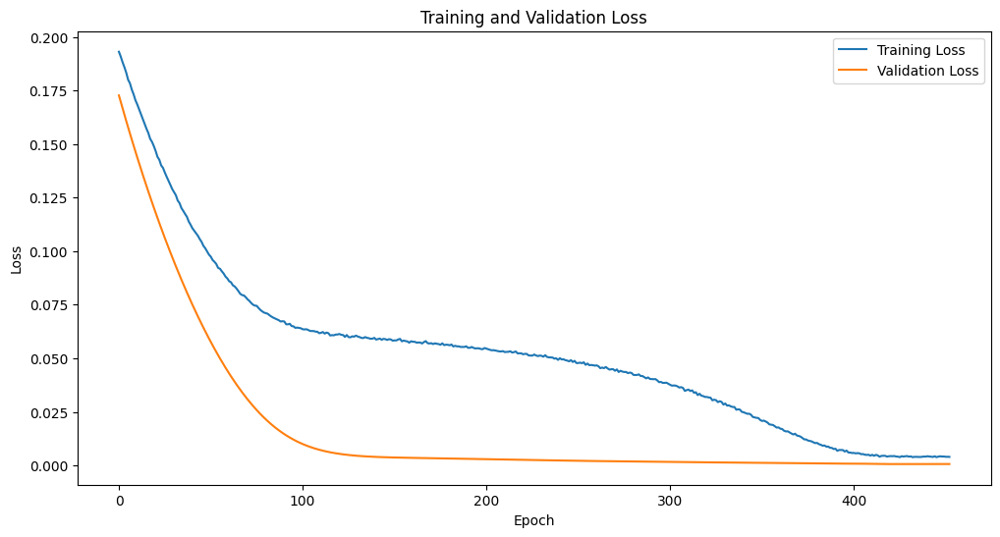

Epoch [1/2500], Train Loss: 0.1393, Val Loss: 0.1097
Epoch [2/2500], Train Loss: 0.1377, Val Loss: 0.1071
Epoch [3/2500], Train Loss: 0.1354, Val Loss: 0.1045
Epoch [4/2500], Train Loss: 0.1331, Val Loss: 0.1019
Epoch [5/2500], Train Loss: 0.1310, Val Loss: 0.0994
Epoch [6/2500], Train Loss: 0.1305, Val Loss: 0.0969
Epoch [7/2500], Train Loss: 0.1280, Val Loss: 0.0945
Epoch [8/2500], Train Loss: 0.1269, Val Loss: 0.0920
Epoch [9/2500], Train Loss: 0.1256, Val Loss: 0.0896
Epoch [10/2500], Train Loss: 0.1231, Val Loss: 0.0873
Epoch [11/2500], Train Loss: 0.1220, Val Loss: 0.0850
Epoch [12/2500], Train Loss: 0.1182, Val Loss: 0.0827
Epoch [13/2500], Train Loss: 0.1180, Val Loss: 0.0804
Epoch [14/2500], Train Loss: 0.1165, Val Loss: 0.0782
Epoch [15/2500], Train Loss: 0.1150, Val Loss: 0.0760
Epoch [16/2500], Train Loss: 0.1133, Val Loss: 0.0739
Epoch [17/2500], Train Loss: 0.1119, Val Loss: 0.0718
Epoch [18/2500], Train Loss: 0.1103, Val Loss: 0.0697
Epoch [19/2500], Train Loss: 0.1097, 

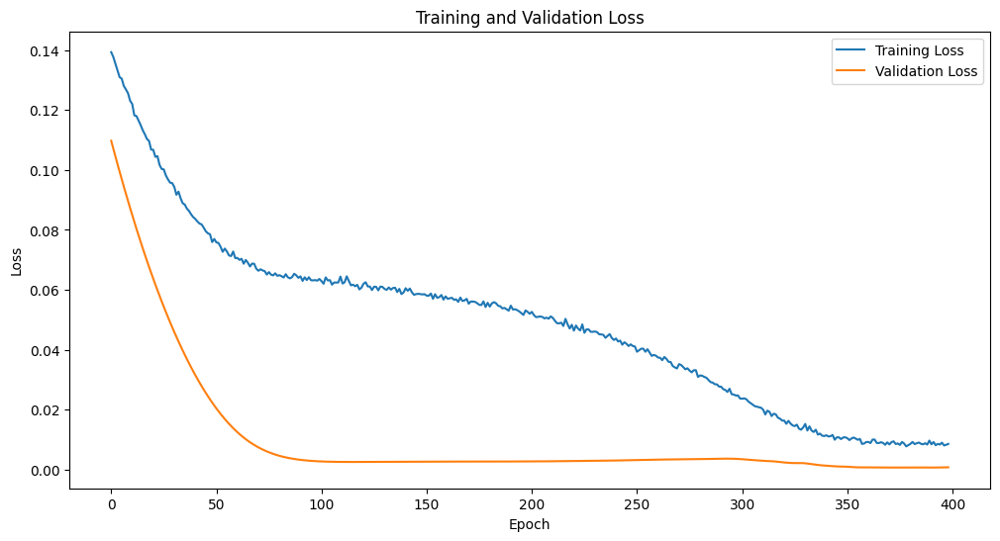

Epoch [1/2500], Train Loss: 0.1545, Val Loss: 0.1245
Epoch [2/2500], Train Loss: 0.1516, Val Loss: 0.1213
Epoch [3/2500], Train Loss: 0.1486, Val Loss: 0.1181
Epoch [4/2500], Train Loss: 0.1464, Val Loss: 0.1149
Epoch [5/2500], Train Loss: 0.1438, Val Loss: 0.1118
Epoch [6/2500], Train Loss: 0.1413, Val Loss: 0.1087
Epoch [7/2500], Train Loss: 0.1380, Val Loss: 0.1057
Epoch [8/2500], Train Loss: 0.1365, Val Loss: 0.1027
Epoch [9/2500], Train Loss: 0.1339, Val Loss: 0.0998
Epoch [10/2500], Train Loss: 0.1317, Val Loss: 0.0970
Epoch [11/2500], Train Loss: 0.1286, Val Loss: 0.0942
Epoch [12/2500], Train Loss: 0.1267, Val Loss: 0.0914
Epoch [13/2500], Train Loss: 0.1250, Val Loss: 0.0887
Epoch [14/2500], Train Loss: 0.1227, Val Loss: 0.0860
Epoch [15/2500], Train Loss: 0.1205, Val Loss: 0.0834
Epoch [16/2500], Train Loss: 0.1189, Val Loss: 0.0808
Epoch [17/2500], Train Loss: 0.1173, Val Loss: 0.0783
Epoch [18/2500], Train Loss: 0.1151, Val Loss: 0.0758
Epoch [19/2500], Train Loss: 0.1124, 

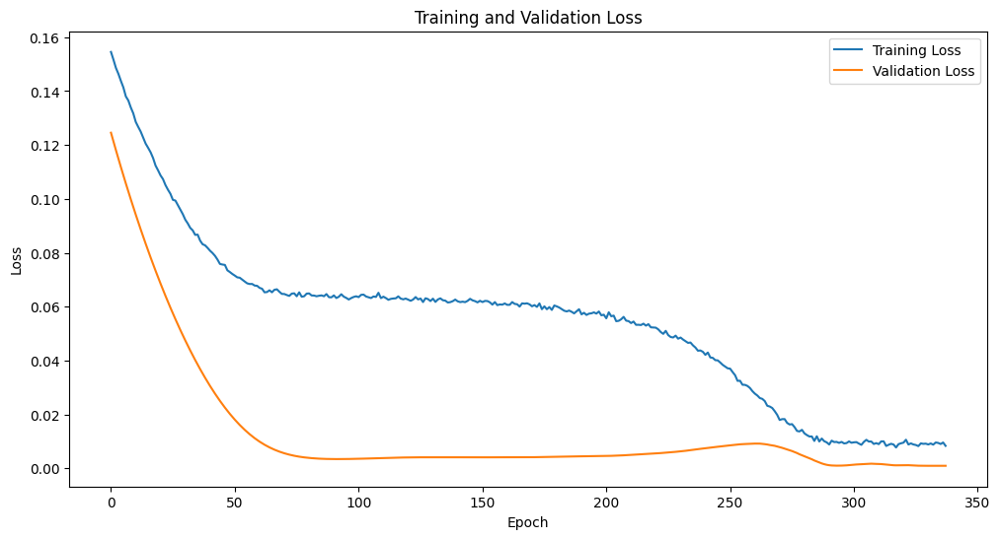

Epoch [1/2500], Train Loss: 0.1962, Val Loss: 0.1747
Epoch [2/2500], Train Loss: 0.1929, Val Loss: 0.1712
Epoch [3/2500], Train Loss: 0.1903, Val Loss: 0.1679
Epoch [4/2500], Train Loss: 0.1874, Val Loss: 0.1645
Epoch [5/2500], Train Loss: 0.1845, Val Loss: 0.1612
Epoch [6/2500], Train Loss: 0.1819, Val Loss: 0.1579
Epoch [7/2500], Train Loss: 0.1788, Val Loss: 0.1547
Epoch [8/2500], Train Loss: 0.1761, Val Loss: 0.1515
Epoch [9/2500], Train Loss: 0.1734, Val Loss: 0.1483
Epoch [10/2500], Train Loss: 0.1709, Val Loss: 0.1451
Epoch [11/2500], Train Loss: 0.1685, Val Loss: 0.1420
Epoch [12/2500], Train Loss: 0.1654, Val Loss: 0.1390
Epoch [13/2500], Train Loss: 0.1630, Val Loss: 0.1359
Epoch [14/2500], Train Loss: 0.1604, Val Loss: 0.1329
Epoch [15/2500], Train Loss: 0.1577, Val Loss: 0.1300
Epoch [16/2500], Train Loss: 0.1554, Val Loss: 0.1270
Epoch [17/2500], Train Loss: 0.1530, Val Loss: 0.1241
Epoch [18/2500], Train Loss: 0.1503, Val Loss: 0.1213
Epoch [19/2500], Train Loss: 0.1486, 

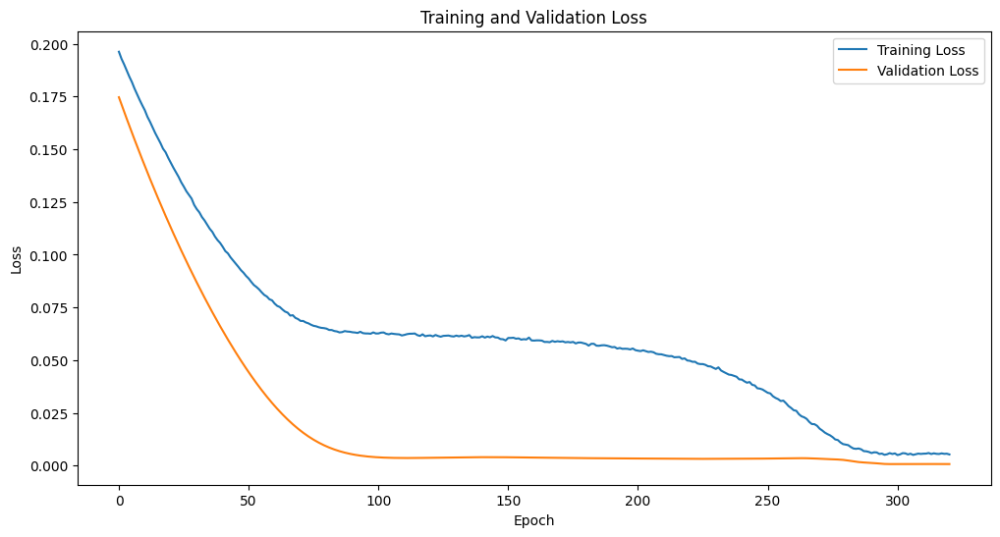

Epoch [1/2500], Train Loss: 0.1268, Val Loss: 0.0898
Epoch [2/2500], Train Loss: 0.1249, Val Loss: 0.0873
Epoch [3/2500], Train Loss: 0.1227, Val Loss: 0.0848
Epoch [4/2500], Train Loss: 0.1211, Val Loss: 0.0824
Epoch [5/2500], Train Loss: 0.1174, Val Loss: 0.0800
Epoch [6/2500], Train Loss: 0.1172, Val Loss: 0.0776
Epoch [7/2500], Train Loss: 0.1147, Val Loss: 0.0753
Epoch [8/2500], Train Loss: 0.1125, Val Loss: 0.0730
Epoch [9/2500], Train Loss: 0.1110, Val Loss: 0.0708
Epoch [10/2500], Train Loss: 0.1092, Val Loss: 0.0686
Epoch [11/2500], Train Loss: 0.1073, Val Loss: 0.0664
Epoch [12/2500], Train Loss: 0.1057, Val Loss: 0.0643
Epoch [13/2500], Train Loss: 0.1043, Val Loss: 0.0623
Epoch [14/2500], Train Loss: 0.1026, Val Loss: 0.0603
Epoch [15/2500], Train Loss: 0.1012, Val Loss: 0.0583
Epoch [16/2500], Train Loss: 0.0998, Val Loss: 0.0564
Epoch [17/2500], Train Loss: 0.0976, Val Loss: 0.0545
Epoch [18/2500], Train Loss: 0.0959, Val Loss: 0.0526
Epoch [19/2500], Train Loss: 0.0951, 

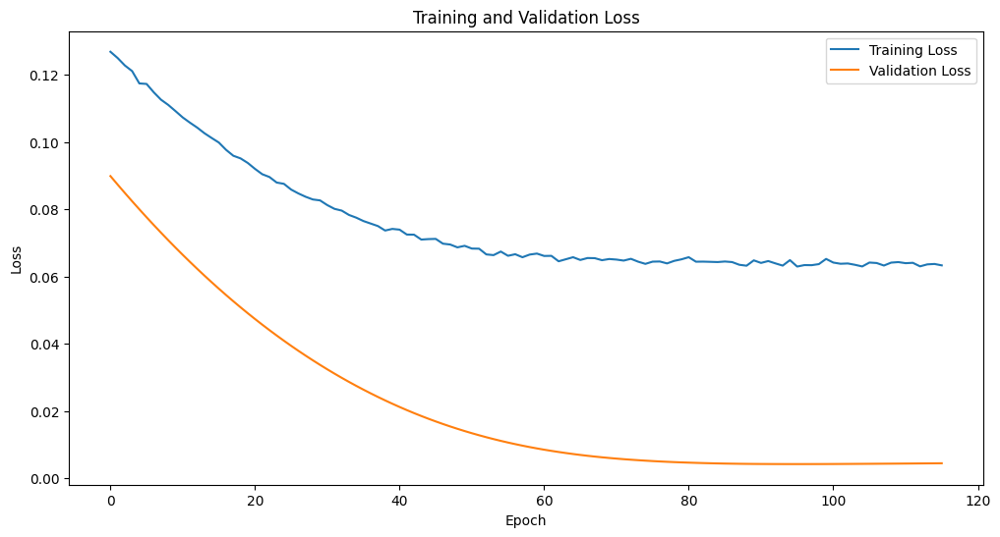

Epoch [1/2500], Train Loss: 0.1111, Val Loss: 0.0723
Epoch [2/2500], Train Loss: 0.1091, Val Loss: 0.0699
Epoch [3/2500], Train Loss: 0.1082, Val Loss: 0.0676
Epoch [4/2500], Train Loss: 0.1049, Val Loss: 0.0654
Epoch [5/2500], Train Loss: 0.1041, Val Loss: 0.0631
Epoch [6/2500], Train Loss: 0.1018, Val Loss: 0.0609
Epoch [7/2500], Train Loss: 0.1007, Val Loss: 0.0588
Epoch [8/2500], Train Loss: 0.0989, Val Loss: 0.0567
Epoch [9/2500], Train Loss: 0.0961, Val Loss: 0.0546
Epoch [10/2500], Train Loss: 0.0948, Val Loss: 0.0526
Epoch [11/2500], Train Loss: 0.0945, Val Loss: 0.0506
Epoch [12/2500], Train Loss: 0.0926, Val Loss: 0.0487
Epoch [13/2500], Train Loss: 0.0912, Val Loss: 0.0468
Epoch [14/2500], Train Loss: 0.0896, Val Loss: 0.0449
Epoch [15/2500], Train Loss: 0.0874, Val Loss: 0.0431
Epoch [16/2500], Train Loss: 0.0869, Val Loss: 0.0413
Epoch [17/2500], Train Loss: 0.0858, Val Loss: 0.0396
Epoch [18/2500], Train Loss: 0.0850, Val Loss: 0.0380
Epoch [19/2500], Train Loss: 0.0828, 

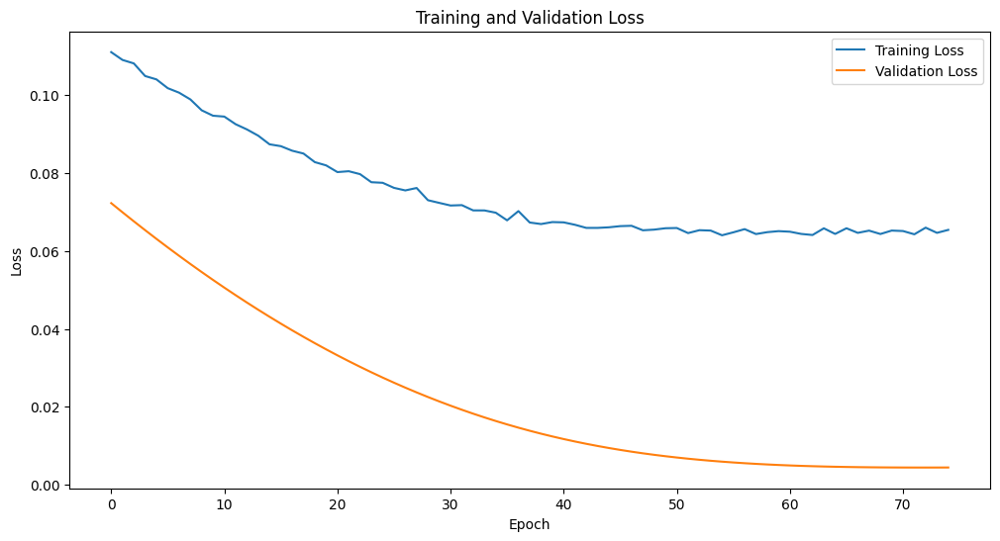

Epoch [1/2500], Train Loss: 0.2763, Val Loss: 0.2616
Epoch [2/2500], Train Loss: 0.2719, Val Loss: 0.2571
Epoch [3/2500], Train Loss: 0.2681, Val Loss: 0.2526
Epoch [4/2500], Train Loss: 0.2639, Val Loss: 0.2482
Epoch [5/2500], Train Loss: 0.2595, Val Loss: 0.2438
Epoch [6/2500], Train Loss: 0.2564, Val Loss: 0.2394
Epoch [7/2500], Train Loss: 0.2518, Val Loss: 0.2351
Epoch [8/2500], Train Loss: 0.2484, Val Loss: 0.2308
Epoch [9/2500], Train Loss: 0.2445, Val Loss: 0.2266
Epoch [10/2500], Train Loss: 0.2411, Val Loss: 0.2224
Epoch [11/2500], Train Loss: 0.2370, Val Loss: 0.2182
Epoch [12/2500], Train Loss: 0.2333, Val Loss: 0.2141
Epoch [13/2500], Train Loss: 0.2297, Val Loss: 0.2100
Epoch [14/2500], Train Loss: 0.2262, Val Loss: 0.2059
Epoch [15/2500], Train Loss: 0.2227, Val Loss: 0.2019
Epoch [16/2500], Train Loss: 0.2187, Val Loss: 0.1979
Epoch [17/2500], Train Loss: 0.2153, Val Loss: 0.1940
Epoch [18/2500], Train Loss: 0.2118, Val Loss: 0.1900
Epoch [19/2500], Train Loss: 0.2083, 

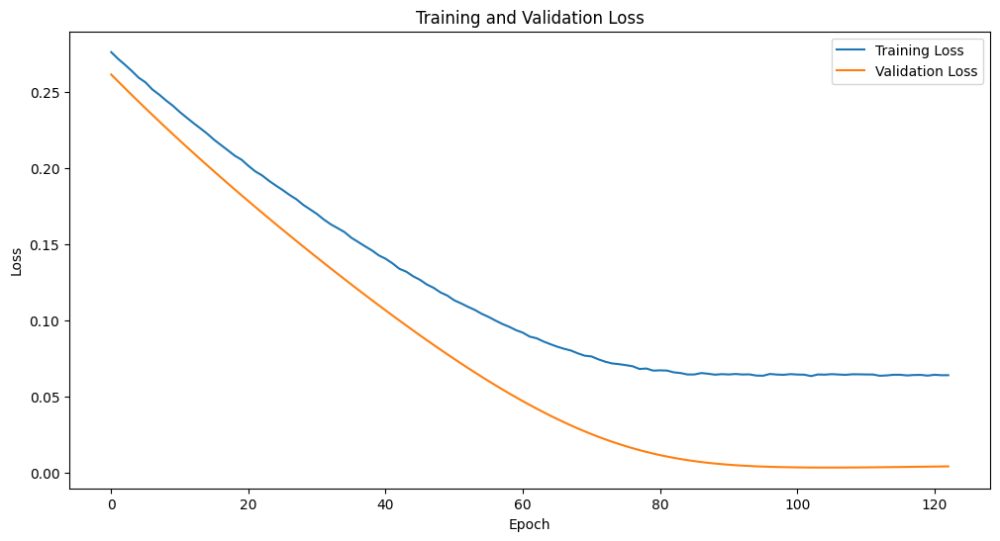

Epoch [1/2500], Train Loss: 0.2203, Val Loss: 0.1963
Epoch [2/2500], Train Loss: 0.2122, Val Loss: 0.1924
Epoch [3/2500], Train Loss: 0.2112, Val Loss: 0.1884
Epoch [4/2500], Train Loss: 0.2070, Val Loss: 0.1846
Epoch [5/2500], Train Loss: 0.2039, Val Loss: 0.1808
Epoch [6/2500], Train Loss: 0.1992, Val Loss: 0.1770
Epoch [7/2500], Train Loss: 0.1967, Val Loss: 0.1734
Epoch [8/2500], Train Loss: 0.1939, Val Loss: 0.1698
Epoch [9/2500], Train Loss: 0.1902, Val Loss: 0.1662
Epoch [10/2500], Train Loss: 0.1883, Val Loss: 0.1627
Epoch [11/2500], Train Loss: 0.1856, Val Loss: 0.1592
Epoch [12/2500], Train Loss: 0.1827, Val Loss: 0.1559
Epoch [13/2500], Train Loss: 0.1785, Val Loss: 0.1525
Epoch [14/2500], Train Loss: 0.1772, Val Loss: 0.1492
Epoch [15/2500], Train Loss: 0.1726, Val Loss: 0.1460
Epoch [16/2500], Train Loss: 0.1714, Val Loss: 0.1429
Epoch [17/2500], Train Loss: 0.1682, Val Loss: 0.1397
Epoch [18/2500], Train Loss: 0.1661, Val Loss: 0.1367
Epoch [19/2500], Train Loss: 0.1623, 

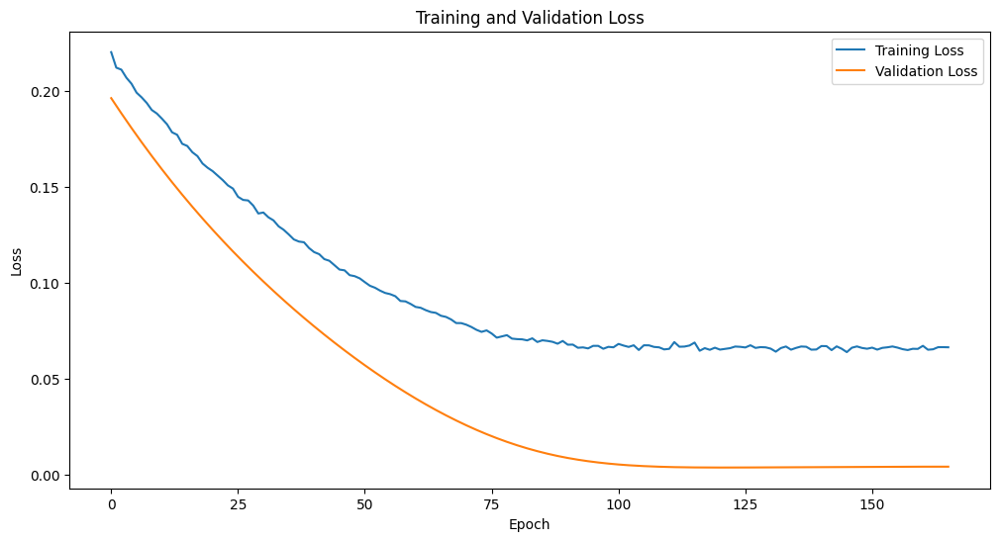

Epoch [1/2500], Train Loss: 0.2452, Val Loss: 0.2276
Epoch [2/2500], Train Loss: 0.2415, Val Loss: 0.2237
Epoch [3/2500], Train Loss: 0.2380, Val Loss: 0.2198
Epoch [4/2500], Train Loss: 0.2352, Val Loss: 0.2160
Epoch [5/2500], Train Loss: 0.2313, Val Loss: 0.2122
Epoch [6/2500], Train Loss: 0.2283, Val Loss: 0.2084
Epoch [7/2500], Train Loss: 0.2256, Val Loss: 0.2047
Epoch [8/2500], Train Loss: 0.2221, Val Loss: 0.2009
Epoch [9/2500], Train Loss: 0.2189, Val Loss: 0.1972
Epoch [10/2500], Train Loss: 0.2157, Val Loss: 0.1935
Epoch [11/2500], Train Loss: 0.2122, Val Loss: 0.1899
Epoch [12/2500], Train Loss: 0.2081, Val Loss: 0.1862
Epoch [13/2500], Train Loss: 0.2062, Val Loss: 0.1826
Epoch [14/2500], Train Loss: 0.2030, Val Loss: 0.1790
Epoch [15/2500], Train Loss: 0.2000, Val Loss: 0.1754
Epoch [16/2500], Train Loss: 0.1966, Val Loss: 0.1718
Epoch [17/2500], Train Loss: 0.1932, Val Loss: 0.1683
Epoch [18/2500], Train Loss: 0.1900, Val Loss: 0.1647
Epoch [19/2500], Train Loss: 0.1865, 

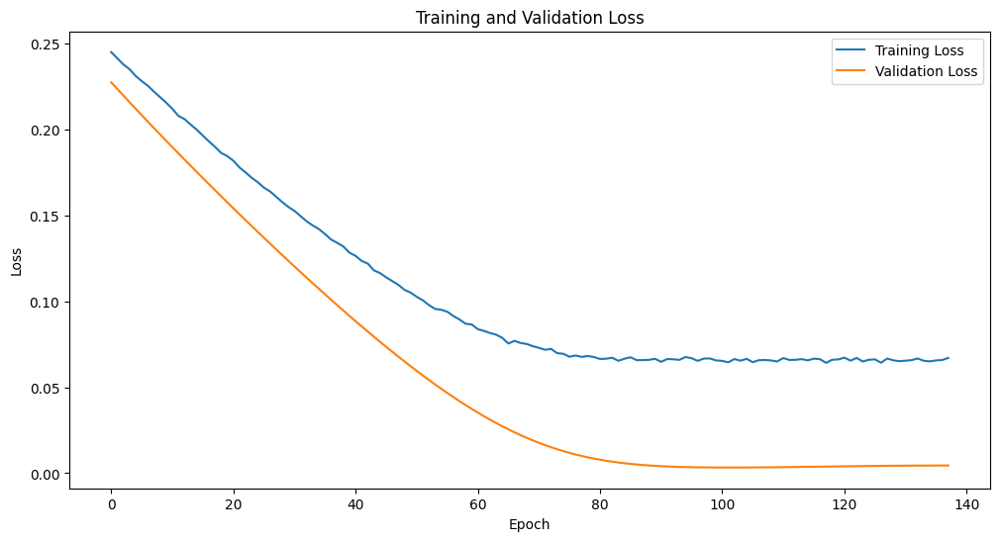

Epoch [1/2500], Train Loss: 0.0755, Val Loss: 0.0269
Epoch [2/2500], Train Loss: 0.0751, Val Loss: 0.0255
Epoch [3/2500], Train Loss: 0.0738, Val Loss: 0.0240
Epoch [4/2500], Train Loss: 0.0728, Val Loss: 0.0227
Epoch [5/2500], Train Loss: 0.0722, Val Loss: 0.0213
Epoch [6/2500], Train Loss: 0.0711, Val Loss: 0.0200
Epoch [7/2500], Train Loss: 0.0705, Val Loss: 0.0188
Epoch [8/2500], Train Loss: 0.0698, Val Loss: 0.0176
Epoch [9/2500], Train Loss: 0.0686, Val Loss: 0.0165
Epoch [10/2500], Train Loss: 0.0681, Val Loss: 0.0154
Epoch [11/2500], Train Loss: 0.0674, Val Loss: 0.0143
Epoch [12/2500], Train Loss: 0.0673, Val Loss: 0.0133
Epoch [13/2500], Train Loss: 0.0667, Val Loss: 0.0124
Epoch [14/2500], Train Loss: 0.0661, Val Loss: 0.0115
Epoch [15/2500], Train Loss: 0.0655, Val Loss: 0.0107
Epoch [16/2500], Train Loss: 0.0652, Val Loss: 0.0099
Epoch [17/2500], Train Loss: 0.0648, Val Loss: 0.0092
Epoch [18/2500], Train Loss: 0.0647, Val Loss: 0.0085
Epoch [19/2500], Train Loss: 0.0647, 

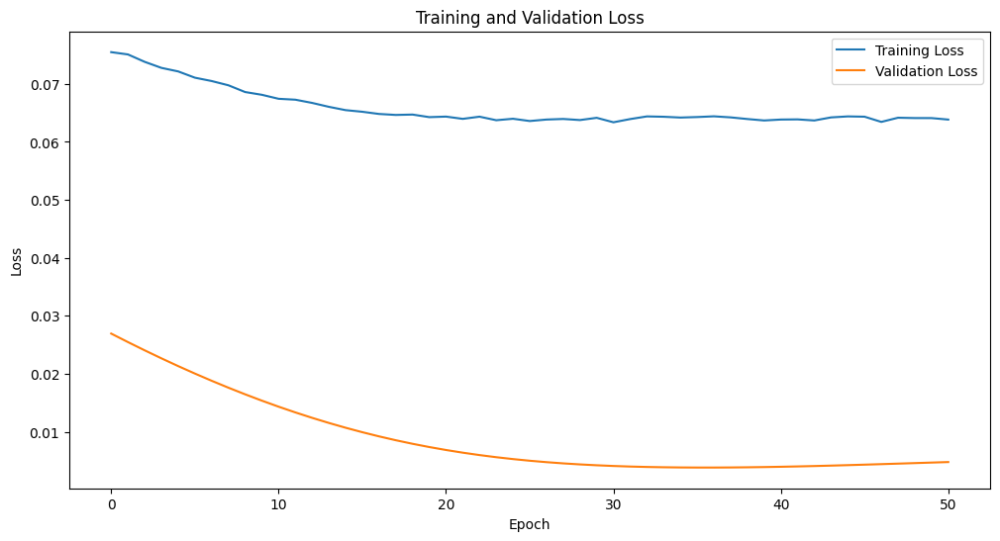

Epoch [1/2500], Train Loss: 0.1806, Val Loss: 0.1538
Epoch [2/2500], Train Loss: 0.1781, Val Loss: 0.1513
Epoch [3/2500], Train Loss: 0.1770, Val Loss: 0.1489
Epoch [4/2500], Train Loss: 0.1745, Val Loss: 0.1465
Epoch [5/2500], Train Loss: 0.1718, Val Loss: 0.1441
Epoch [6/2500], Train Loss: 0.1708, Val Loss: 0.1417
Epoch [7/2500], Train Loss: 0.1678, Val Loss: 0.1394
Epoch [8/2500], Train Loss: 0.1666, Val Loss: 0.1370
Epoch [9/2500], Train Loss: 0.1633, Val Loss: 0.1347
Epoch [10/2500], Train Loss: 0.1626, Val Loss: 0.1324
Epoch [11/2500], Train Loss: 0.1595, Val Loss: 0.1301
Epoch [12/2500], Train Loss: 0.1583, Val Loss: 0.1278
Epoch [13/2500], Train Loss: 0.1561, Val Loss: 0.1255
Epoch [14/2500], Train Loss: 0.1551, Val Loss: 0.1232
Epoch [15/2500], Train Loss: 0.1542, Val Loss: 0.1210
Epoch [16/2500], Train Loss: 0.1518, Val Loss: 0.1187
Epoch [17/2500], Train Loss: 0.1491, Val Loss: 0.1165
Epoch [18/2500], Train Loss: 0.1474, Val Loss: 0.1142
Epoch [19/2500], Train Loss: 0.1454, 

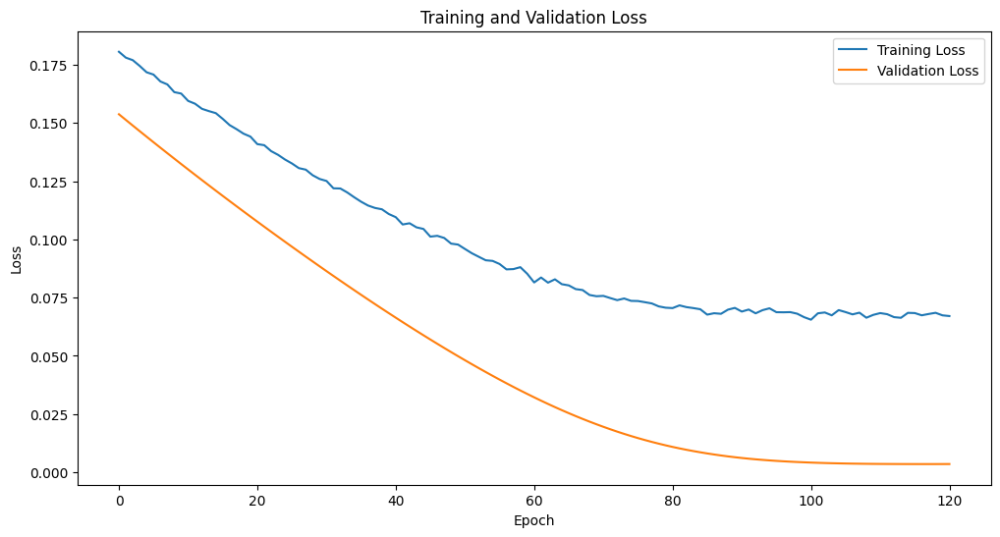

Epoch [1/2500], Train Loss: 0.1613, Val Loss: 0.1429
Epoch [2/2500], Train Loss: 0.1573, Val Loss: 0.1370
Epoch [3/2500], Train Loss: 0.1534, Val Loss: 0.1312
Epoch [4/2500], Train Loss: 0.1494, Val Loss: 0.1255
Epoch [5/2500], Train Loss: 0.1450, Val Loss: 0.1199
Epoch [6/2500], Train Loss: 0.1411, Val Loss: 0.1145
Epoch [7/2500], Train Loss: 0.1374, Val Loss: 0.1091
Epoch [8/2500], Train Loss: 0.1336, Val Loss: 0.1039
Epoch [9/2500], Train Loss: 0.1292, Val Loss: 0.0989
Epoch [10/2500], Train Loss: 0.1265, Val Loss: 0.0939
Epoch [11/2500], Train Loss: 0.1230, Val Loss: 0.0891
Epoch [12/2500], Train Loss: 0.1199, Val Loss: 0.0845
Epoch [13/2500], Train Loss: 0.1160, Val Loss: 0.0799
Epoch [14/2500], Train Loss: 0.1129, Val Loss: 0.0755
Epoch [15/2500], Train Loss: 0.1099, Val Loss: 0.0712
Epoch [16/2500], Train Loss: 0.1066, Val Loss: 0.0670
Epoch [17/2500], Train Loss: 0.1036, Val Loss: 0.0629
Epoch [18/2500], Train Loss: 0.1007, Val Loss: 0.0590
Epoch [19/2500], Train Loss: 0.0985, 

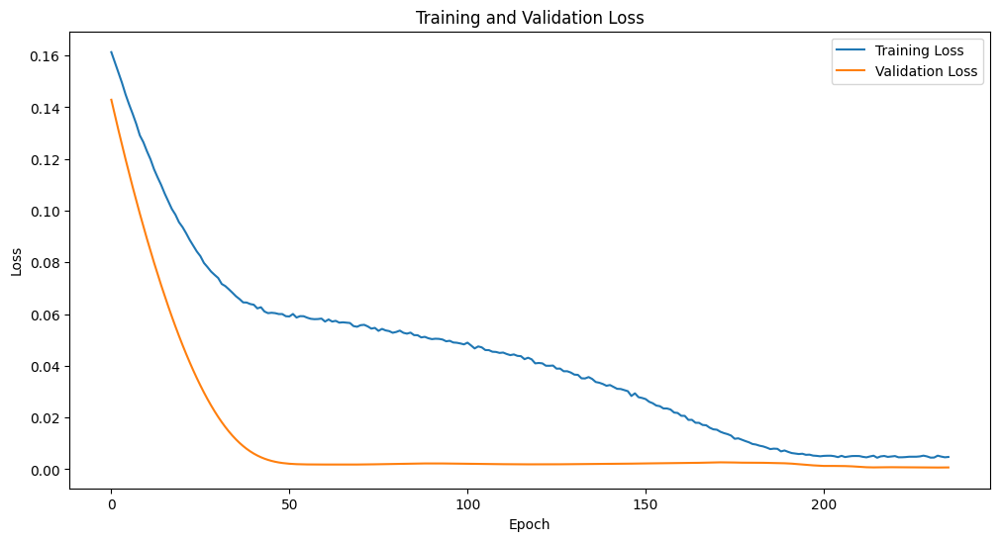

Epoch [1/2500], Train Loss: 0.1042, Val Loss: 0.0623
Epoch [2/2500], Train Loss: 0.1014, Val Loss: 0.0588
Epoch [3/2500], Train Loss: 0.0987, Val Loss: 0.0554
Epoch [4/2500], Train Loss: 0.0963, Val Loss: 0.0521
Epoch [5/2500], Train Loss: 0.0937, Val Loss: 0.0489
Epoch [6/2500], Train Loss: 0.0911, Val Loss: 0.0458
Epoch [7/2500], Train Loss: 0.0888, Val Loss: 0.0428
Epoch [8/2500], Train Loss: 0.0864, Val Loss: 0.0400
Epoch [9/2500], Train Loss: 0.0842, Val Loss: 0.0372
Epoch [10/2500], Train Loss: 0.0818, Val Loss: 0.0346
Epoch [11/2500], Train Loss: 0.0800, Val Loss: 0.0320
Epoch [12/2500], Train Loss: 0.0779, Val Loss: 0.0296
Epoch [13/2500], Train Loss: 0.0763, Val Loss: 0.0273
Epoch [14/2500], Train Loss: 0.0742, Val Loss: 0.0251
Epoch [15/2500], Train Loss: 0.0727, Val Loss: 0.0230
Epoch [16/2500], Train Loss: 0.0710, Val Loss: 0.0210
Epoch [17/2500], Train Loss: 0.0701, Val Loss: 0.0191
Epoch [18/2500], Train Loss: 0.0683, Val Loss: 0.0174
Epoch [19/2500], Train Loss: 0.0671, 

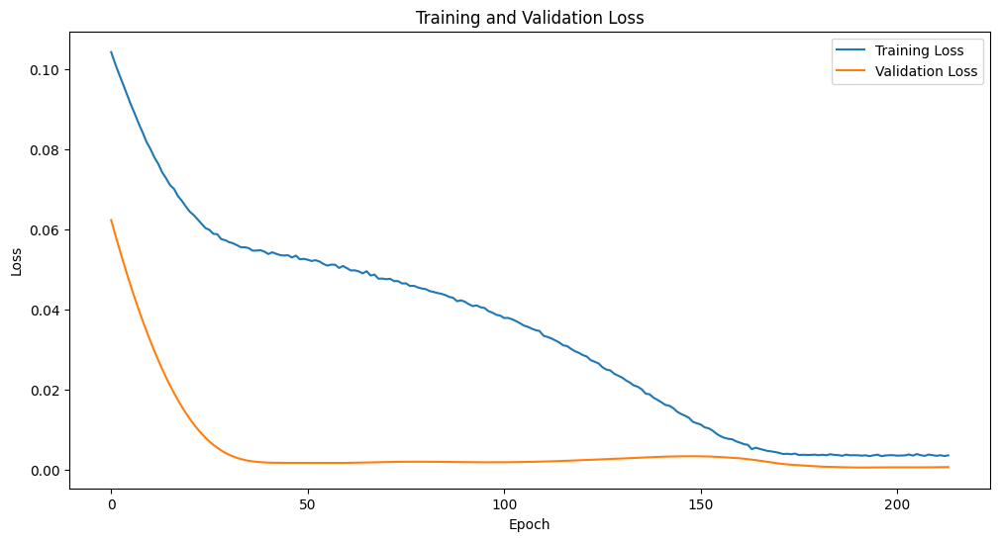

Epoch [1/2500], Train Loss: 0.0986, Val Loss: 0.0487
Epoch [2/2500], Train Loss: 0.0953, Val Loss: 0.0453
Epoch [3/2500], Train Loss: 0.0928, Val Loss: 0.0421
Epoch [4/2500], Train Loss: 0.0914, Val Loss: 0.0390
Epoch [5/2500], Train Loss: 0.0883, Val Loss: 0.0361
Epoch [6/2500], Train Loss: 0.0869, Val Loss: 0.0333
Epoch [7/2500], Train Loss: 0.0848, Val Loss: 0.0306
Epoch [8/2500], Train Loss: 0.0827, Val Loss: 0.0280
Epoch [9/2500], Train Loss: 0.0803, Val Loss: 0.0256
Epoch [10/2500], Train Loss: 0.0786, Val Loss: 0.0233
Epoch [11/2500], Train Loss: 0.0775, Val Loss: 0.0211
Epoch [12/2500], Train Loss: 0.0759, Val Loss: 0.0191
Epoch [13/2500], Train Loss: 0.0735, Val Loss: 0.0172
Epoch [14/2500], Train Loss: 0.0724, Val Loss: 0.0154
Epoch [15/2500], Train Loss: 0.0716, Val Loss: 0.0138
Epoch [16/2500], Train Loss: 0.0704, Val Loss: 0.0122
Epoch [17/2500], Train Loss: 0.0702, Val Loss: 0.0108
Epoch [18/2500], Train Loss: 0.0683, Val Loss: 0.0096
Epoch [19/2500], Train Loss: 0.0675, 

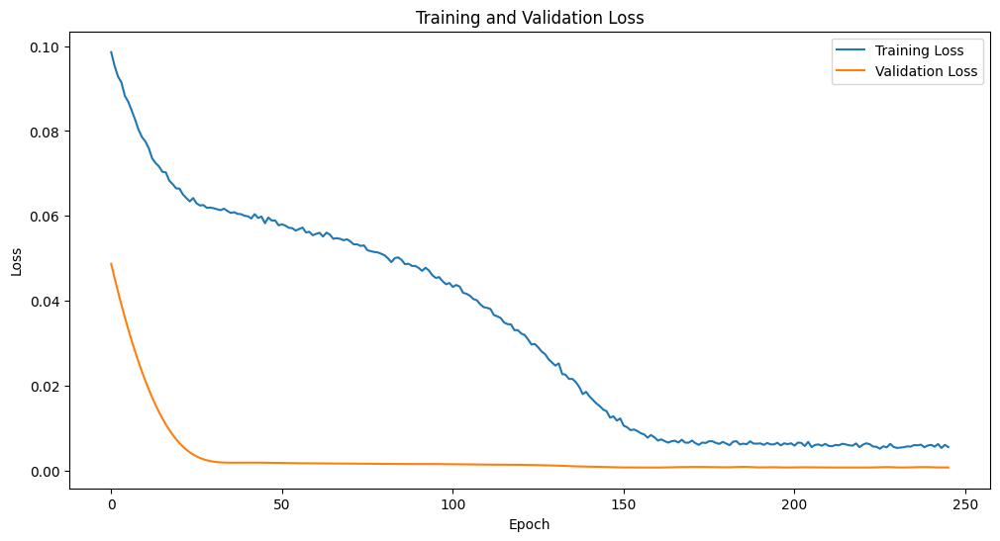

Epoch [1/2500], Train Loss: 0.1053, Val Loss: 0.0638
Epoch [2/2500], Train Loss: 0.1014, Val Loss: 0.0598
Epoch [3/2500], Train Loss: 0.0992, Val Loss: 0.0560
Epoch [4/2500], Train Loss: 0.0962, Val Loss: 0.0523
Epoch [5/2500], Train Loss: 0.0933, Val Loss: 0.0487
Epoch [6/2500], Train Loss: 0.0905, Val Loss: 0.0452
Epoch [7/2500], Train Loss: 0.0876, Val Loss: 0.0419
Epoch [8/2500], Train Loss: 0.0849, Val Loss: 0.0387
Epoch [9/2500], Train Loss: 0.0829, Val Loss: 0.0356
Epoch [10/2500], Train Loss: 0.0811, Val Loss: 0.0327
Epoch [11/2500], Train Loss: 0.0784, Val Loss: 0.0299
Epoch [12/2500], Train Loss: 0.0771, Val Loss: 0.0272
Epoch [13/2500], Train Loss: 0.0753, Val Loss: 0.0247
Epoch [14/2500], Train Loss: 0.0741, Val Loss: 0.0223
Epoch [15/2500], Train Loss: 0.0720, Val Loss: 0.0201
Epoch [16/2500], Train Loss: 0.0705, Val Loss: 0.0180
Epoch [17/2500], Train Loss: 0.0691, Val Loss: 0.0161
Epoch [18/2500], Train Loss: 0.0686, Val Loss: 0.0143
Epoch [19/2500], Train Loss: 0.0673, 

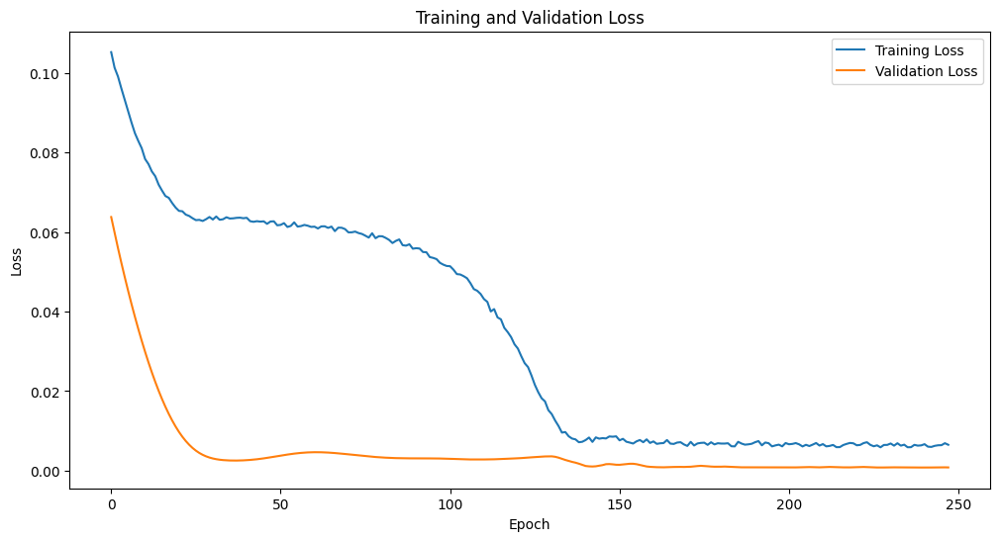

Epoch [1/2500], Train Loss: 0.0985, Val Loss: 0.0548
Epoch [2/2500], Train Loss: 0.0951, Val Loss: 0.0508
Epoch [3/2500], Train Loss: 0.0919, Val Loss: 0.0469
Epoch [4/2500], Train Loss: 0.0893, Val Loss: 0.0432
Epoch [5/2500], Train Loss: 0.0866, Val Loss: 0.0396
Epoch [6/2500], Train Loss: 0.0841, Val Loss: 0.0362
Epoch [7/2500], Train Loss: 0.0814, Val Loss: 0.0330
Epoch [8/2500], Train Loss: 0.0792, Val Loss: 0.0299
Epoch [9/2500], Train Loss: 0.0768, Val Loss: 0.0269
Epoch [10/2500], Train Loss: 0.0751, Val Loss: 0.0242
Epoch [11/2500], Train Loss: 0.0733, Val Loss: 0.0216
Epoch [12/2500], Train Loss: 0.0715, Val Loss: 0.0192
Epoch [13/2500], Train Loss: 0.0698, Val Loss: 0.0169
Epoch [14/2500], Train Loss: 0.0688, Val Loss: 0.0149
Epoch [15/2500], Train Loss: 0.0673, Val Loss: 0.0130
Epoch [16/2500], Train Loss: 0.0664, Val Loss: 0.0113
Epoch [17/2500], Train Loss: 0.0655, Val Loss: 0.0098
Epoch [18/2500], Train Loss: 0.0643, Val Loss: 0.0084
Epoch [19/2500], Train Loss: 0.0642, 

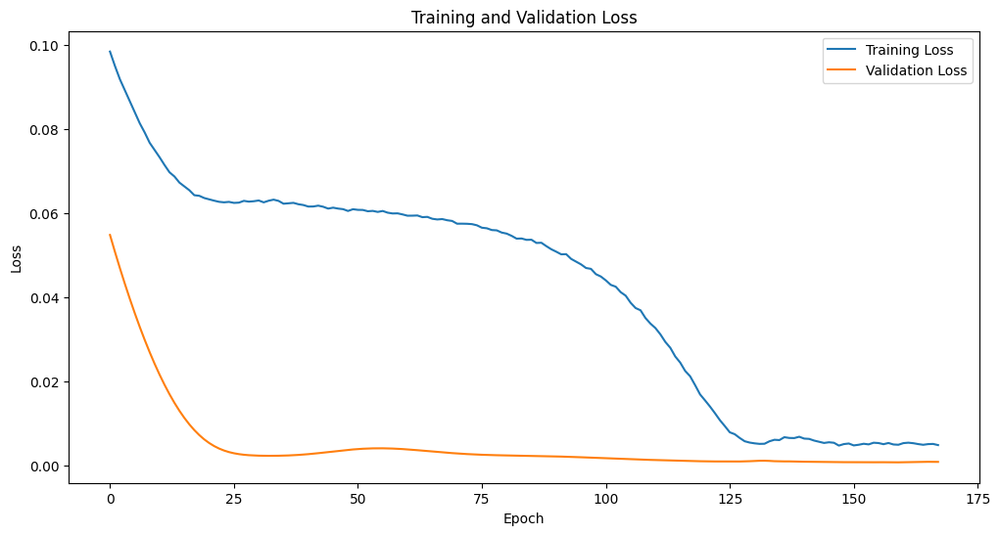

Epoch [1/2500], Train Loss: 0.2671, Val Loss: 0.2478
Epoch [2/2500], Train Loss: 0.2612, Val Loss: 0.2391
Epoch [3/2500], Train Loss: 0.2521, Val Loss: 0.2305
Epoch [4/2500], Train Loss: 0.2424, Val Loss: 0.2222
Epoch [5/2500], Train Loss: 0.2373, Val Loss: 0.2141
Epoch [6/2500], Train Loss: 0.2302, Val Loss: 0.2061
Epoch [7/2500], Train Loss: 0.2230, Val Loss: 0.1983
Epoch [8/2500], Train Loss: 0.2162, Val Loss: 0.1907
Epoch [9/2500], Train Loss: 0.2082, Val Loss: 0.1833
Epoch [10/2500], Train Loss: 0.2036, Val Loss: 0.1760
Epoch [11/2500], Train Loss: 0.1972, Val Loss: 0.1689
Epoch [12/2500], Train Loss: 0.1904, Val Loss: 0.1619
Epoch [13/2500], Train Loss: 0.1838, Val Loss: 0.1551
Epoch [14/2500], Train Loss: 0.1795, Val Loss: 0.1484
Epoch [15/2500], Train Loss: 0.1732, Val Loss: 0.1418
Epoch [16/2500], Train Loss: 0.1686, Val Loss: 0.1354
Epoch [17/2500], Train Loss: 0.1607, Val Loss: 0.1291
Epoch [18/2500], Train Loss: 0.1573, Val Loss: 0.1229
Epoch [19/2500], Train Loss: 0.1516, 

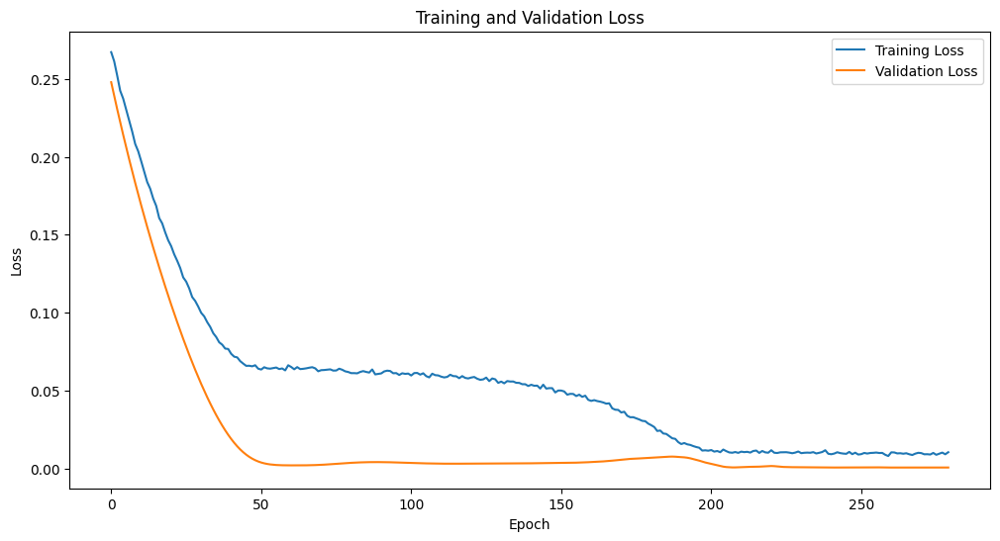

Epoch [1/2500], Train Loss: 0.1471, Val Loss: 0.1139
Epoch [2/2500], Train Loss: 0.1431, Val Loss: 0.1089
Epoch [3/2500], Train Loss: 0.1391, Val Loss: 0.1040
Epoch [4/2500], Train Loss: 0.1344, Val Loss: 0.0993
Epoch [5/2500], Train Loss: 0.1301, Val Loss: 0.0947
Epoch [6/2500], Train Loss: 0.1273, Val Loss: 0.0902
Epoch [7/2500], Train Loss: 0.1232, Val Loss: 0.0858
Epoch [8/2500], Train Loss: 0.1190, Val Loss: 0.0816
Epoch [9/2500], Train Loss: 0.1161, Val Loss: 0.0775
Epoch [10/2500], Train Loss: 0.1125, Val Loss: 0.0734
Epoch [11/2500], Train Loss: 0.1092, Val Loss: 0.0695
Epoch [12/2500], Train Loss: 0.1065, Val Loss: 0.0658
Epoch [13/2500], Train Loss: 0.1031, Val Loss: 0.0621
Epoch [14/2500], Train Loss: 0.1004, Val Loss: 0.0585
Epoch [15/2500], Train Loss: 0.0984, Val Loss: 0.0551
Epoch [16/2500], Train Loss: 0.0952, Val Loss: 0.0517
Epoch [17/2500], Train Loss: 0.0928, Val Loss: 0.0485
Epoch [18/2500], Train Loss: 0.0904, Val Loss: 0.0454
Epoch [19/2500], Train Loss: 0.0885, 

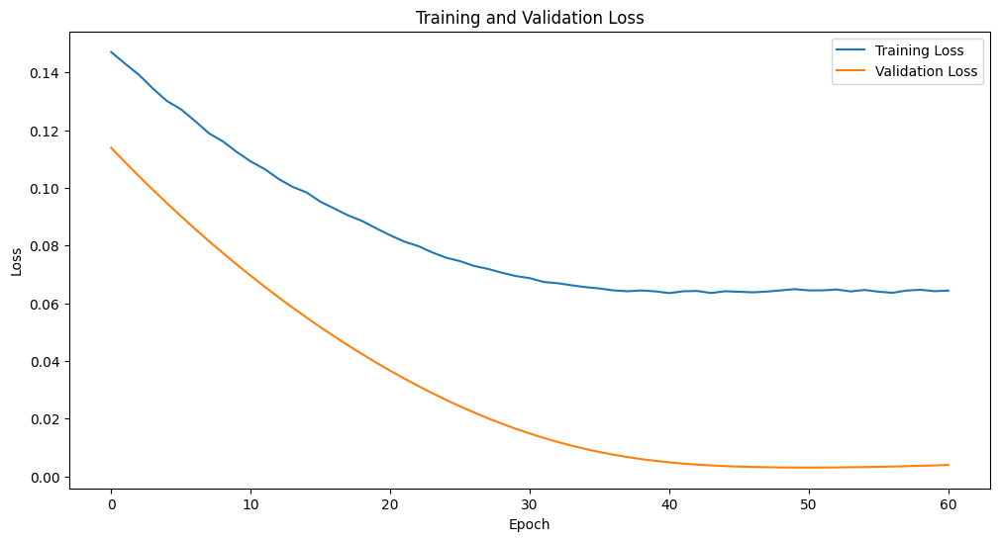

Epoch [1/2500], Train Loss: 0.2226, Val Loss: 0.1984
Epoch [2/2500], Train Loss: 0.2159, Val Loss: 0.1911
Epoch [3/2500], Train Loss: 0.2094, Val Loss: 0.1839
Epoch [4/2500], Train Loss: 0.2027, Val Loss: 0.1768
Epoch [5/2500], Train Loss: 0.1969, Val Loss: 0.1700
Epoch [6/2500], Train Loss: 0.1911, Val Loss: 0.1632
Epoch [7/2500], Train Loss: 0.1849, Val Loss: 0.1566
Epoch [8/2500], Train Loss: 0.1792, Val Loss: 0.1502
Epoch [9/2500], Train Loss: 0.1736, Val Loss: 0.1439
Epoch [10/2500], Train Loss: 0.1687, Val Loss: 0.1378
Epoch [11/2500], Train Loss: 0.1634, Val Loss: 0.1317
Epoch [12/2500], Train Loss: 0.1582, Val Loss: 0.1259
Epoch [13/2500], Train Loss: 0.1533, Val Loss: 0.1201
Epoch [14/2500], Train Loss: 0.1481, Val Loss: 0.1145
Epoch [15/2500], Train Loss: 0.1431, Val Loss: 0.1090
Epoch [16/2500], Train Loss: 0.1387, Val Loss: 0.1036
Epoch [17/2500], Train Loss: 0.1346, Val Loss: 0.0984
Epoch [18/2500], Train Loss: 0.1297, Val Loss: 0.0932
Epoch [19/2500], Train Loss: 0.1255, 

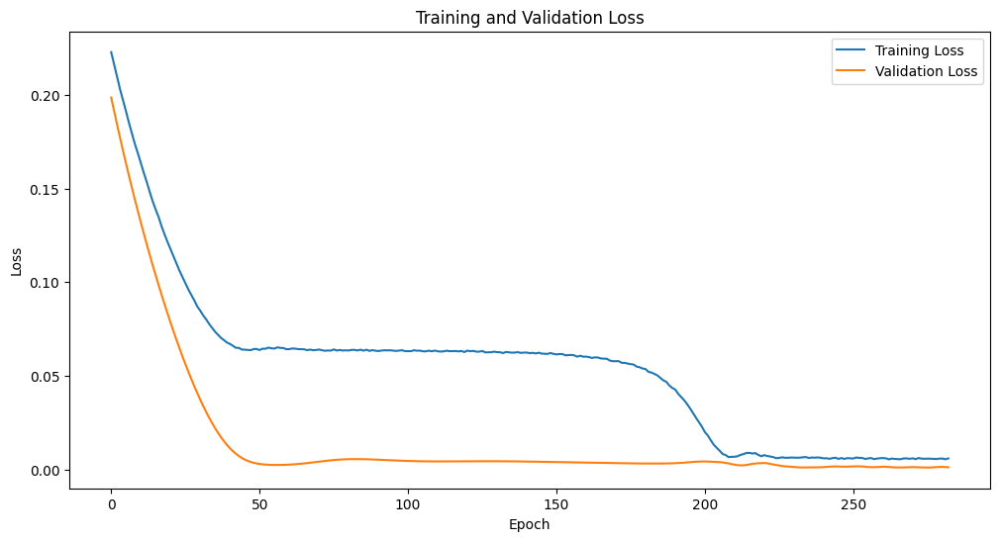

Epoch [1/2500], Train Loss: 0.0858, Val Loss: 0.0400
Epoch [2/2500], Train Loss: 0.0838, Val Loss: 0.0367
Epoch [3/2500], Train Loss: 0.0823, Val Loss: 0.0335
Epoch [4/2500], Train Loss: 0.0799, Val Loss: 0.0304
Epoch [5/2500], Train Loss: 0.0768, Val Loss: 0.0276
Epoch [6/2500], Train Loss: 0.0761, Val Loss: 0.0248
Epoch [7/2500], Train Loss: 0.0748, Val Loss: 0.0223
Epoch [8/2500], Train Loss: 0.0731, Val Loss: 0.0199
Epoch [9/2500], Train Loss: 0.0709, Val Loss: 0.0177
Epoch [10/2500], Train Loss: 0.0701, Val Loss: 0.0156
Epoch [11/2500], Train Loss: 0.0685, Val Loss: 0.0138
Epoch [12/2500], Train Loss: 0.0682, Val Loss: 0.0121
Epoch [13/2500], Train Loss: 0.0669, Val Loss: 0.0105
Epoch [14/2500], Train Loss: 0.0654, Val Loss: 0.0092
Epoch [15/2500], Train Loss: 0.0650, Val Loss: 0.0080
Epoch [16/2500], Train Loss: 0.0649, Val Loss: 0.0069
Epoch [17/2500], Train Loss: 0.0645, Val Loss: 0.0060
Epoch [18/2500], Train Loss: 0.0645, Val Loss: 0.0053
Epoch [19/2500], Train Loss: 0.0651, 

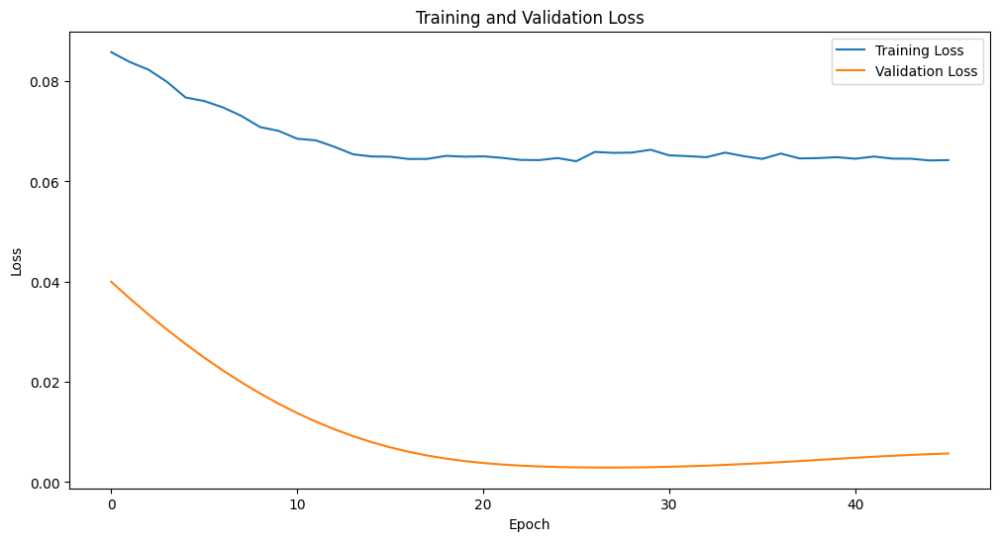

Epoch [1/2500], Train Loss: 0.1690, Val Loss: 0.1389
Epoch [2/2500], Train Loss: 0.1643, Val Loss: 0.1335
Epoch [3/2500], Train Loss: 0.1597, Val Loss: 0.1283
Epoch [4/2500], Train Loss: 0.1558, Val Loss: 0.1232
Epoch [5/2500], Train Loss: 0.1506, Val Loss: 0.1182
Epoch [6/2500], Train Loss: 0.1460, Val Loss: 0.1133
Epoch [7/2500], Train Loss: 0.1417, Val Loss: 0.1085
Epoch [8/2500], Train Loss: 0.1384, Val Loss: 0.1038
Epoch [9/2500], Train Loss: 0.1343, Val Loss: 0.0992
Epoch [10/2500], Train Loss: 0.1310, Val Loss: 0.0948
Epoch [11/2500], Train Loss: 0.1273, Val Loss: 0.0904
Epoch [12/2500], Train Loss: 0.1233, Val Loss: 0.0862
Epoch [13/2500], Train Loss: 0.1202, Val Loss: 0.0820
Epoch [14/2500], Train Loss: 0.1170, Val Loss: 0.0780
Epoch [15/2500], Train Loss: 0.1136, Val Loss: 0.0740
Epoch [16/2500], Train Loss: 0.1106, Val Loss: 0.0701
Epoch [17/2500], Train Loss: 0.1068, Val Loss: 0.0664
Epoch [18/2500], Train Loss: 0.1033, Val Loss: 0.0627
Epoch [19/2500], Train Loss: 0.1013, 

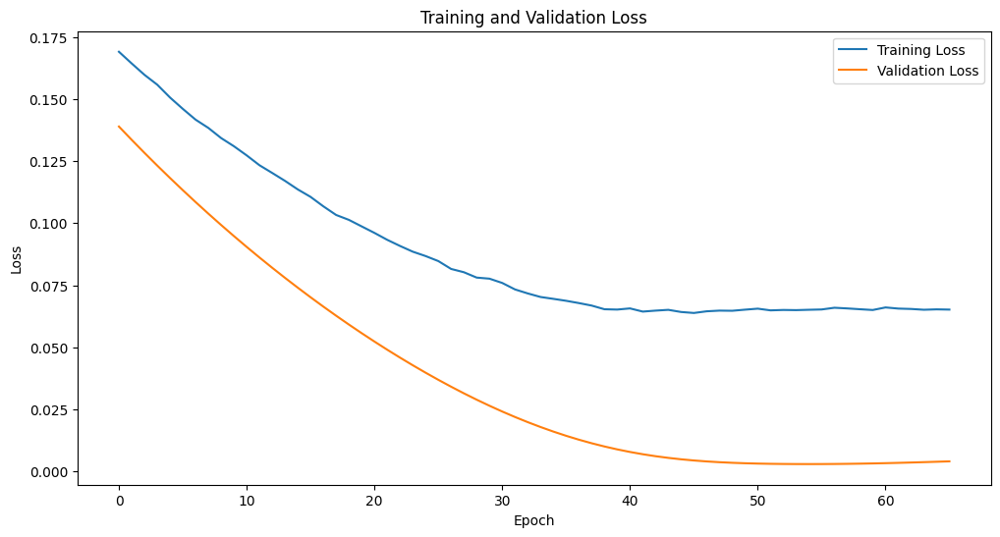

Epoch [1/2500], Train Loss: 0.0894, Val Loss: 0.0450
Epoch [2/2500], Train Loss: 0.0872, Val Loss: 0.0422
Epoch [3/2500], Train Loss: 0.0853, Val Loss: 0.0396
Epoch [4/2500], Train Loss: 0.0833, Val Loss: 0.0370
Epoch [5/2500], Train Loss: 0.0814, Val Loss: 0.0345
Epoch [6/2500], Train Loss: 0.0797, Val Loss: 0.0321
Epoch [7/2500], Train Loss: 0.0780, Val Loss: 0.0298
Epoch [8/2500], Train Loss: 0.0768, Val Loss: 0.0276
Epoch [9/2500], Train Loss: 0.0748, Val Loss: 0.0255
Epoch [10/2500], Train Loss: 0.0735, Val Loss: 0.0235
Epoch [11/2500], Train Loss: 0.0722, Val Loss: 0.0216
Epoch [12/2500], Train Loss: 0.0712, Val Loss: 0.0197
Epoch [13/2500], Train Loss: 0.0699, Val Loss: 0.0180
Epoch [14/2500], Train Loss: 0.0689, Val Loss: 0.0164
Epoch [15/2500], Train Loss: 0.0679, Val Loss: 0.0149
Epoch [16/2500], Train Loss: 0.0673, Val Loss: 0.0134
Epoch [17/2500], Train Loss: 0.0665, Val Loss: 0.0121
Epoch [18/2500], Train Loss: 0.0660, Val Loss: 0.0109
Epoch [19/2500], Train Loss: 0.0654, 

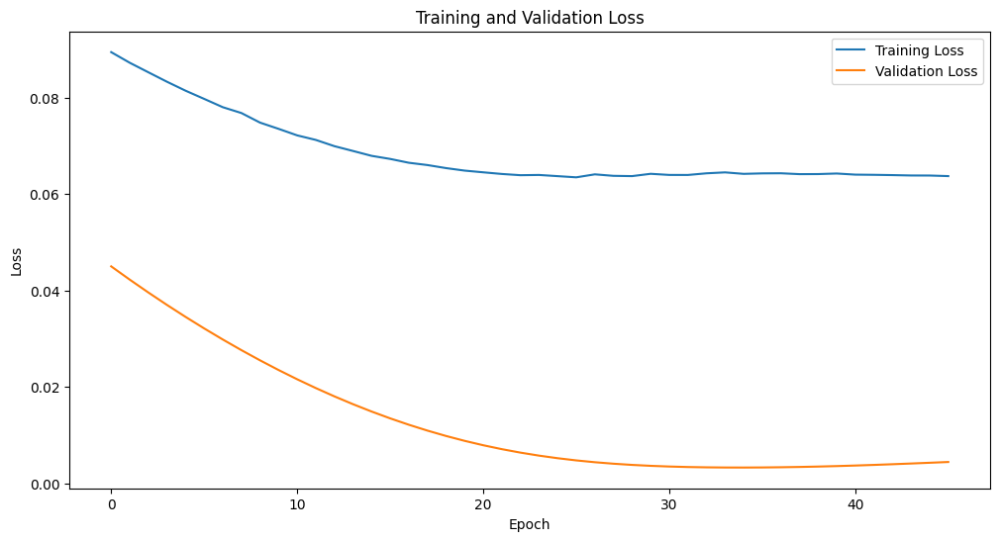

Epoch [1/2500], Train Loss: 0.1516, Val Loss: 0.1194
Epoch [2/2500], Train Loss: 0.1476, Val Loss: 0.1134
Epoch [3/2500], Train Loss: 0.1432, Val Loss: 0.1077
Epoch [4/2500], Train Loss: 0.1384, Val Loss: 0.1020
Epoch [5/2500], Train Loss: 0.1343, Val Loss: 0.0966
Epoch [6/2500], Train Loss: 0.1292, Val Loss: 0.0912
Epoch [7/2500], Train Loss: 0.1252, Val Loss: 0.0861
Epoch [8/2500], Train Loss: 0.1211, Val Loss: 0.0811
Epoch [9/2500], Train Loss: 0.1184, Val Loss: 0.0762
Epoch [10/2500], Train Loss: 0.1129, Val Loss: 0.0715
Epoch [11/2500], Train Loss: 0.1085, Val Loss: 0.0670
Epoch [12/2500], Train Loss: 0.1050, Val Loss: 0.0626
Epoch [13/2500], Train Loss: 0.1022, Val Loss: 0.0583
Epoch [14/2500], Train Loss: 0.0984, Val Loss: 0.0542
Epoch [15/2500], Train Loss: 0.0954, Val Loss: 0.0503
Epoch [16/2500], Train Loss: 0.0931, Val Loss: 0.0465
Epoch [17/2500], Train Loss: 0.0894, Val Loss: 0.0429
Epoch [18/2500], Train Loss: 0.0860, Val Loss: 0.0395
Epoch [19/2500], Train Loss: 0.0848, 

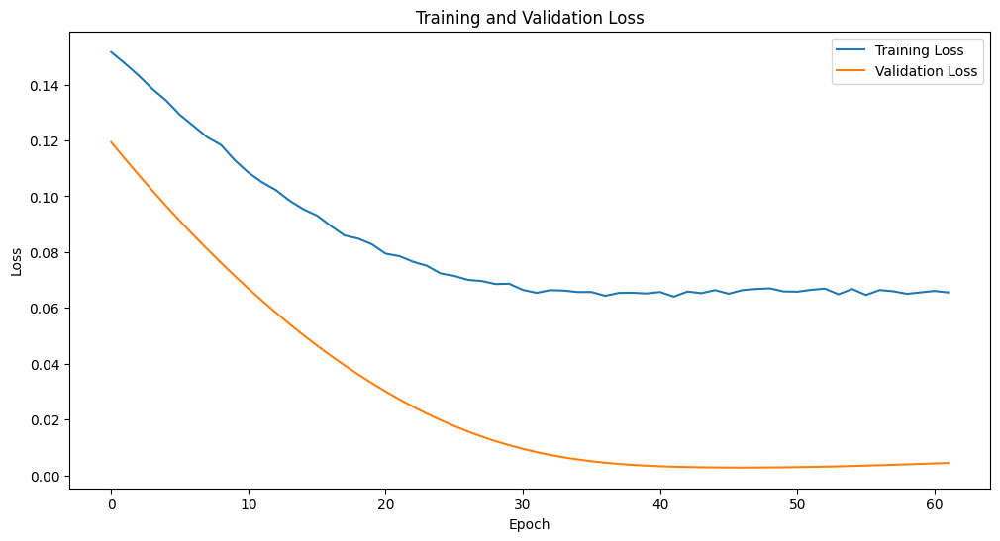

In [626]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_sizes = [16,32,64]  # Hidden units
output_size = 1  # Predicting 'Close'
num_layerss = [3,6,9,12]  # Number of LSTM layers
dropouts = [0.3,0.1,0.5]  # Dropout rate
learning_rates = [0.001,0.01,0.0001]
criterions = [nn.HuberLoss(),nn.MSELoss()]  # Use Mean Squared Error Loss


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None
best_lr = None

for criterion in criterions:
    for learning_rate in learning_rates:
        for hidden_size in hidden_sizes:
            for num_layers in num_layerss:
                for dropout in dropouts:
                    # Initialize the model, loss function, and optimizer
                    model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
                    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)

                    
                    # Train the model
                    model, train_losses, val_losses = train_model(
                        model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
                    )
        
                    if best_trainloss == None:
                        best_trainloss = train_losses[-1]
        
                    if best_trainloss > train_losses[-1]:
                        best_trainloss = train_losses[-1]
                        best_hidden_size = hidden_size
                        best_num_layers = num_layers
                        best_dropout = dropout
                        best_model = model
                        best_criterion = criterion
                        best_lr = learning_rate

#importing required modules
from pygame import mixer
mixer.init()
plays=mixer.Sound("house_lo.wav")
plays.play()

In [627]:
print(f"best_hidden_size = {best_hidden_size}")
print(f"best_num_layers = {best_num_layers}")
print(f"best_dropout = {best_dropout}")
print(f"best_criterion = {best_criterion}")
print(f"best_model = {best_model}")
print(f"best_hidden_size = {best_hidden_size}")
print(f"best_lr = {best_lr}")




best_hidden_size = 64
best_num_layers = 3
best_dropout = 0.1
best_criterion = HuberLoss()
best_model = StockPriceGRU(
  (gru): GRU(5, 64, num_layers=3, batch_first=True, dropout=0.1)
  (fc): Linear(in_features=64, out_features=1, bias=True)
)
best_hidden_size = 64
best_lr = 0.01


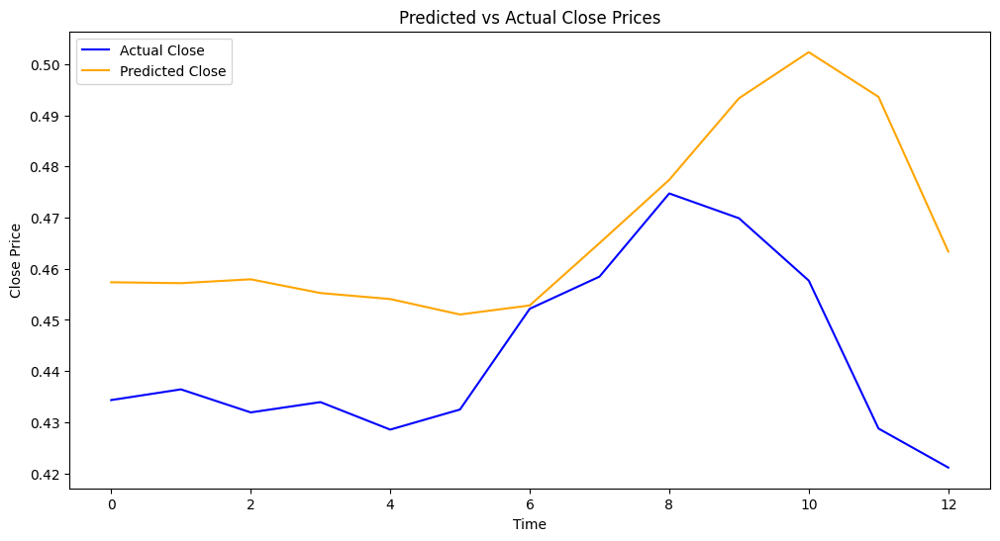

Mean Squared Error (MSE): 0.0009
Mean Absolute Error (MAE): 0.0246


In [630]:
mse, mae = evaluate_model(best_model, X_test, y_test, scaler, device)

Epoch [1/2500], Train Loss: 0.0832, Val Loss: 0.1501
Epoch [2/2500], Train Loss: 0.1452, Val Loss: 0.0190
Epoch [3/2500], Train Loss: 0.0390, Val Loss: 0.0495
Epoch [4/2500], Train Loss: 0.0582, Val Loss: 0.0294
Epoch [5/2500], Train Loss: 0.0465, Val Loss: 0.0097
Epoch [6/2500], Train Loss: 0.0337, Val Loss: 0.0011
Epoch [7/2500], Train Loss: 0.0278, Val Loss: 0.0035
Epoch [8/2500], Train Loss: 0.0293, Val Loss: 0.0050
Epoch [9/2500], Train Loss: 0.0290, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0250, Val Loss: 0.0025
Epoch [11/2500], Train Loss: 0.0227, Val Loss: 0.0076
Epoch [12/2500], Train Loss: 0.0229, Val Loss: 0.0079
Epoch [13/2500], Train Loss: 0.0186, Val Loss: 0.0023
Epoch [14/2500], Train Loss: 0.0121, Val Loss: 0.0011
Epoch [15/2500], Train Loss: 0.0093, Val Loss: 0.0003
Epoch [16/2500], Train Loss: 0.0058, Val Loss: 0.0220
Epoch [17/2500], Train Loss: 0.0069, Val Loss: 0.0181
Epoch [18/2500], Train Loss: 0.0079, Val Loss: 0.0005
Epoch [19/2500], Train Loss: 0.0067, 

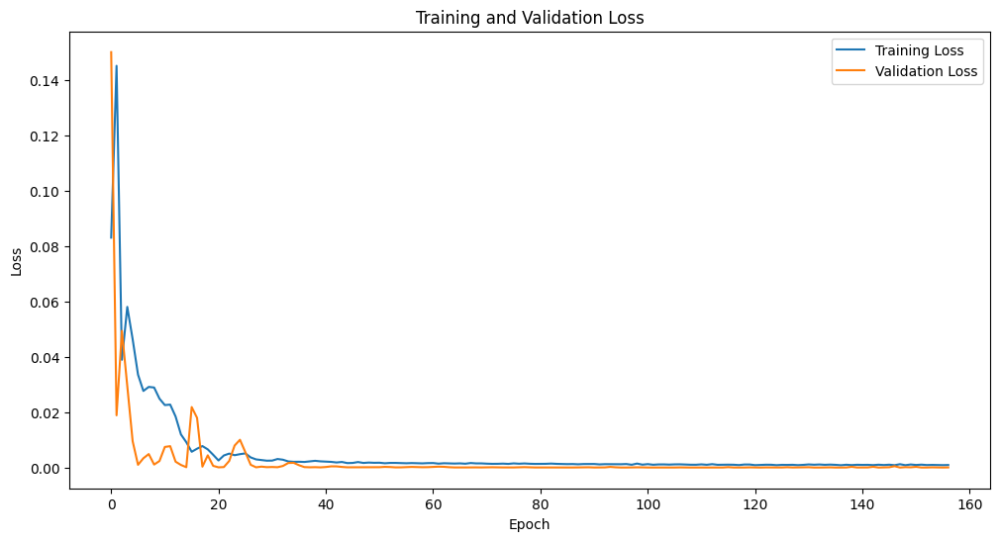

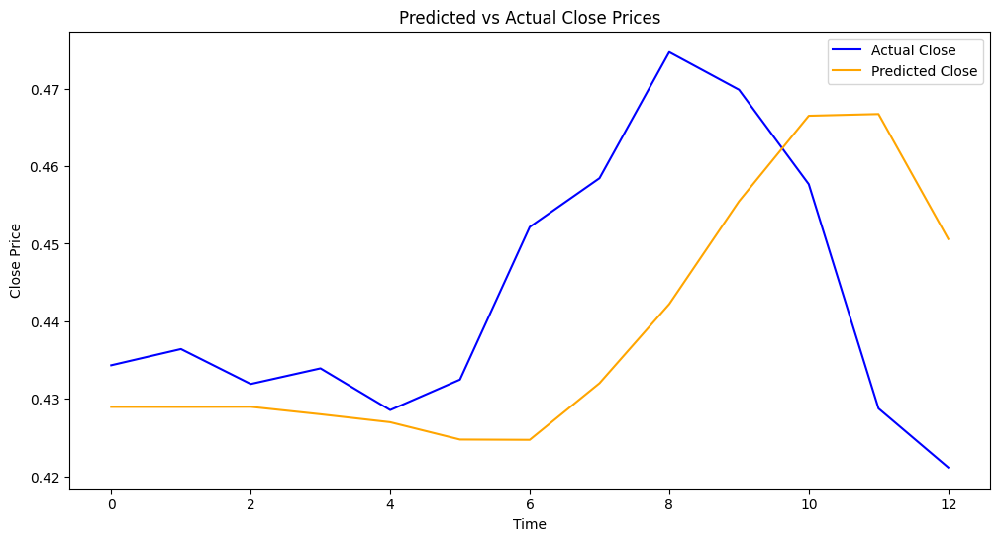

Mean Squared Error (MSE): 0.0004
Mean Absolute Error (MAE): 0.0160


In [634]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Close', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropouts = 0.1  # Dropout rate
learning_rate = 0.01
criterion = nn.HuberLoss()


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None


# Initialize the model, loss function, and optimizer
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)


# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/2500], Train Loss: 0.0985, Val Loss: 0.0162
Epoch [2/2500], Train Loss: 0.0508, Val Loss: 0.1611
Epoch [3/2500], Train Loss: 0.0284, Val Loss: 0.1661
Epoch [4/2500], Train Loss: 0.0296, Val Loss: 0.0913
Epoch [5/2500], Train Loss: 0.0176, Val Loss: 0.0298
Epoch [6/2500], Train Loss: 0.0162, Val Loss: 0.0114
Epoch [7/2500], Train Loss: 0.0134, Val Loss: 0.0154
Epoch [8/2500], Train Loss: 0.0049, Val Loss: 0.0166
Epoch [9/2500], Train Loss: 0.0051, Val Loss: 0.0004
Epoch [10/2500], Train Loss: 0.0040, Val Loss: 0.0245
Epoch [11/2500], Train Loss: 0.0094, Val Loss: 0.0023
Epoch [12/2500], Train Loss: 0.0031, Val Loss: 0.0090
Epoch [13/2500], Train Loss: 0.0035, Val Loss: 0.0202
Epoch [14/2500], Train Loss: 0.0043, Val Loss: 0.0139
Epoch [15/2500], Train Loss: 0.0030, Val Loss: 0.0045
Epoch [16/2500], Train Loss: 0.0033, Val Loss: 0.0016
Epoch [17/2500], Train Loss: 0.0047, Val Loss: 0.0029
Epoch [18/2500], Train Loss: 0.0036, Val Loss: 0.0085
Epoch [19/2500], Train Loss: 0.0025, 

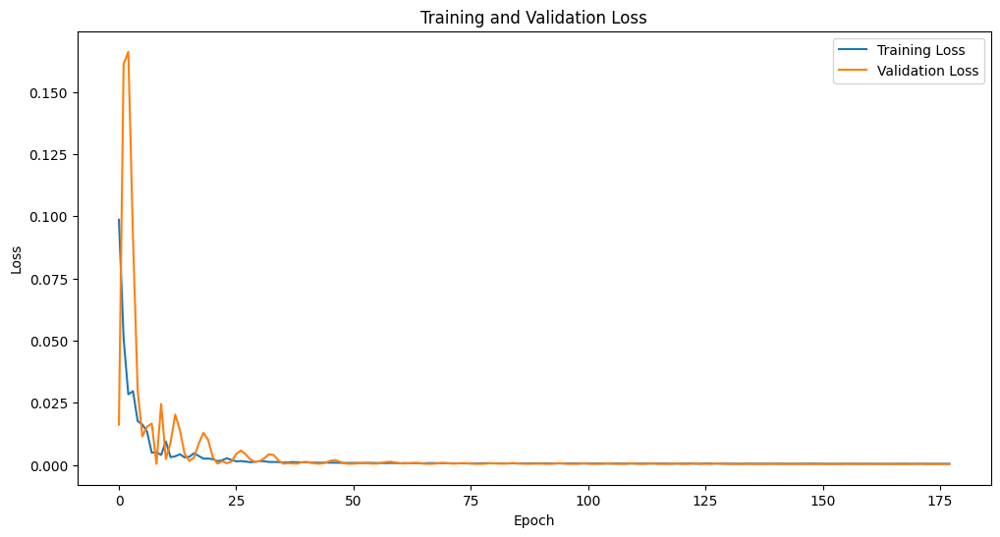

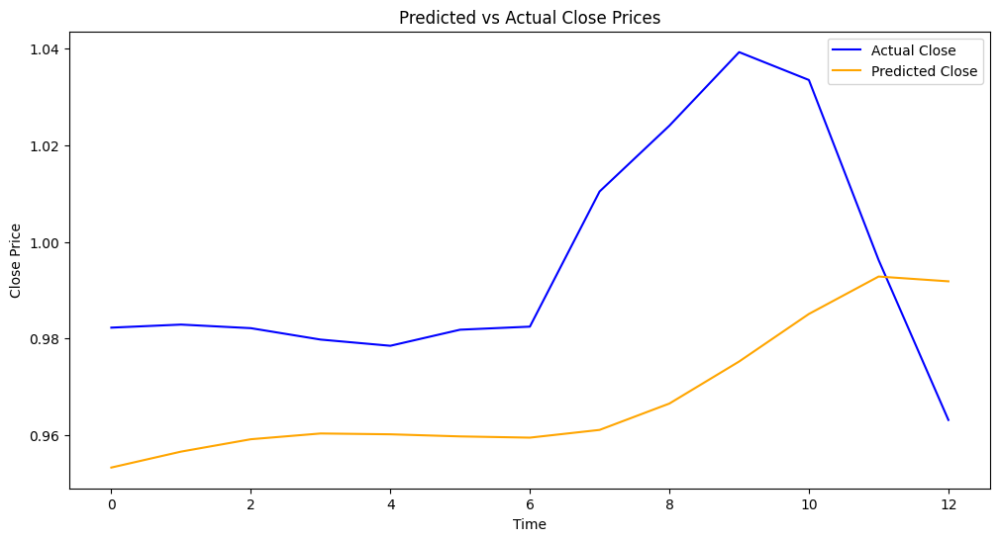

Mean Squared Error (MSE): 0.0013
Mean Absolute Error (MAE): 0.0317


In [636]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Open', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropouts = 0.1  # Dropout rate
learning_rate = 0.01
criterion = nn.HuberLoss()


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None


# Initialize the model, loss function, and optimizer
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)


# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/2500], Train Loss: 0.1036, Val Loss: 0.0101
Epoch [2/2500], Train Loss: 0.0356, Val Loss: 0.1436
Epoch [3/2500], Train Loss: 0.0260, Val Loss: 0.1184
Epoch [4/2500], Train Loss: 0.0216, Val Loss: 0.0357
Epoch [5/2500], Train Loss: 0.0091, Val Loss: 0.0007
Epoch [6/2500], Train Loss: 0.0125, Val Loss: 0.0006
Epoch [7/2500], Train Loss: 0.0048, Val Loss: 0.0086
Epoch [8/2500], Train Loss: 0.0050, Val Loss: 0.0101
Epoch [9/2500], Train Loss: 0.0088, Val Loss: 0.0021
Epoch [10/2500], Train Loss: 0.0032, Val Loss: 0.0007
Epoch [11/2500], Train Loss: 0.0031, Val Loss: 0.0006
Epoch [12/2500], Train Loss: 0.0036, Val Loss: 0.0078
Epoch [13/2500], Train Loss: 0.0033, Val Loss: 0.0217
Epoch [14/2500], Train Loss: 0.0039, Val Loss: 0.0239
Epoch [15/2500], Train Loss: 0.0043, Val Loss: 0.0120
Epoch [16/2500], Train Loss: 0.0023, Val Loss: 0.0019
Epoch [17/2500], Train Loss: 0.0016, Val Loss: 0.0006
Epoch [18/2500], Train Loss: 0.0024, Val Loss: 0.0005
Epoch [19/2500], Train Loss: 0.0021, 

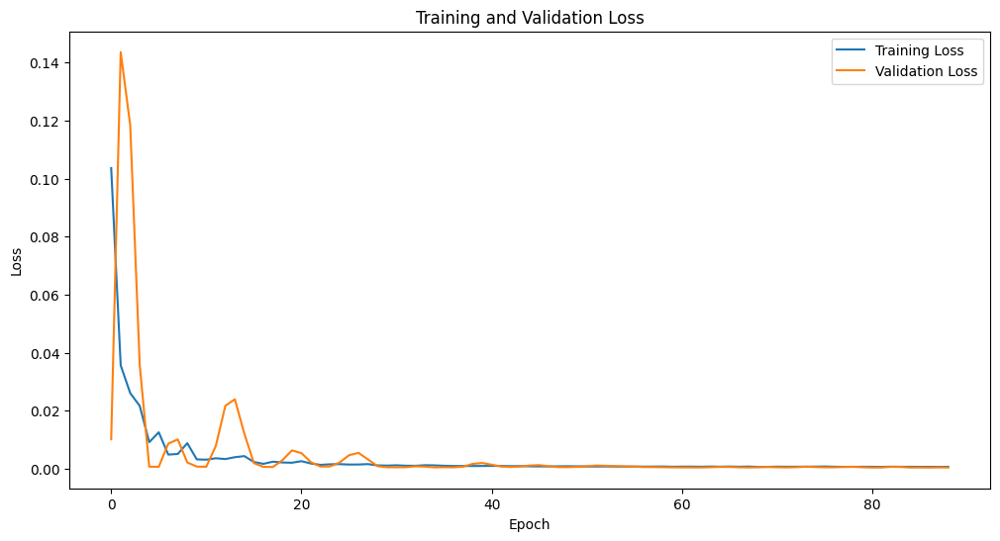

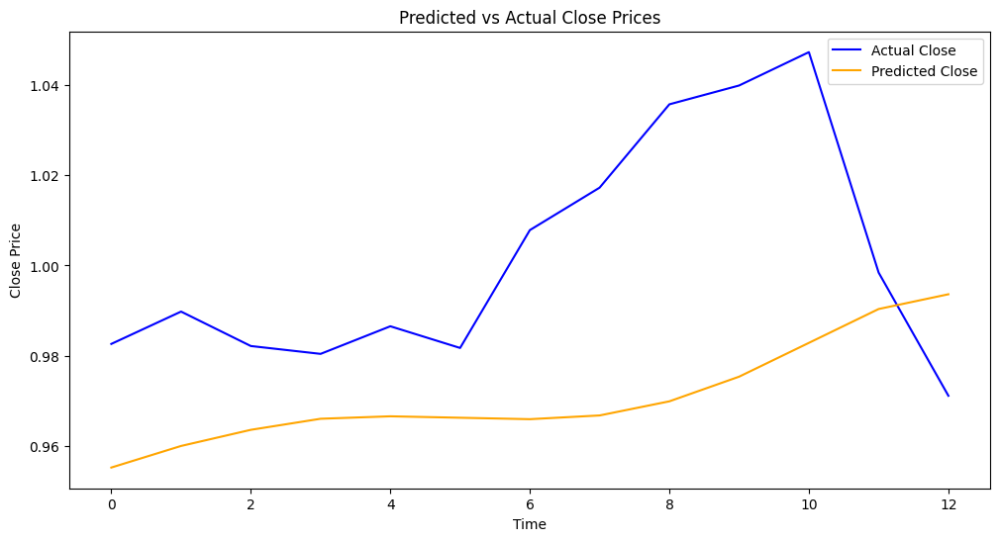

Mean Squared Error (MSE): 0.0016
Mean Absolute Error (MAE): 0.0340


In [638]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='High', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='High', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='High', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropouts = 0.1  # Dropout rate
learning_rate = 0.01
criterion = nn.HuberLoss()


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None


# Initialize the model, loss function, and optimizer
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)


# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/2500], Train Loss: 0.1324, Val Loss: 0.0909
Epoch [2/2500], Train Loss: 0.0234, Val Loss: 0.0534
Epoch [3/2500], Train Loss: 0.0237, Val Loss: 0.2135
Epoch [4/2500], Train Loss: 0.0427, Val Loss: 0.0142
Epoch [5/2500], Train Loss: 0.0199, Val Loss: 0.0065
Epoch [6/2500], Train Loss: 0.0178, Val Loss: 0.0473
Epoch [7/2500], Train Loss: 0.0089, Val Loss: 0.0673
Epoch [8/2500], Train Loss: 0.0151, Val Loss: 0.0258
Epoch [9/2500], Train Loss: 0.0061, Val Loss: 0.0009
Epoch [10/2500], Train Loss: 0.0043, Val Loss: 0.0079
Epoch [11/2500], Train Loss: 0.0097, Val Loss: 0.0008
Epoch [12/2500], Train Loss: 0.0023, Val Loss: 0.0148
Epoch [13/2500], Train Loss: 0.0041, Val Loss: 0.0281
Epoch [14/2500], Train Loss: 0.0065, Val Loss: 0.0252
Epoch [15/2500], Train Loss: 0.0046, Val Loss: 0.0133
Epoch [16/2500], Train Loss: 0.0023, Val Loss: 0.0039
Epoch [17/2500], Train Loss: 0.0031, Val Loss: 0.0015
Epoch [18/2500], Train Loss: 0.0049, Val Loss: 0.0025
Epoch [19/2500], Train Loss: 0.0036, 

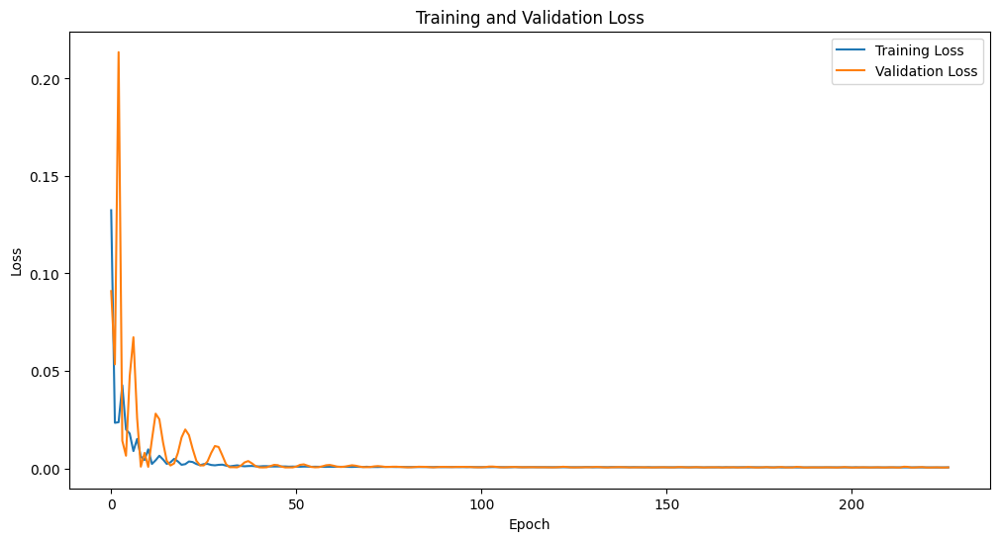

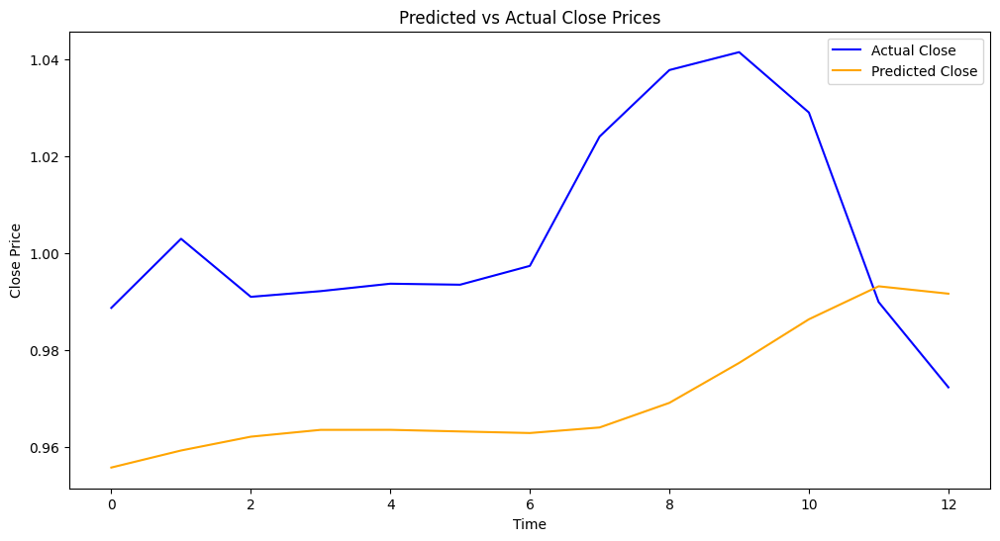

Mean Squared Error (MSE): 0.0017
Mean Absolute Error (MAE): 0.0374


In [640]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Low', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropouts = 0.1  # Dropout rate
learning_rate = 0.01
criterion = nn.HuberLoss()


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None


# Initialize the model, loss function, and optimizer
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)


# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

Epoch [1/2500], Train Loss: 0.0047, Val Loss: 0.0269
Epoch [2/2500], Train Loss: 0.0549, Val Loss: 0.0323
Epoch [3/2500], Train Loss: 0.0170, Val Loss: 0.0008
Epoch [4/2500], Train Loss: 0.0062, Val Loss: 0.0224
Epoch [5/2500], Train Loss: 0.0093, Val Loss: 0.0157
Epoch [6/2500], Train Loss: 0.0075, Val Loss: 0.0029
Epoch [7/2500], Train Loss: 0.0047, Val Loss: 0.0009
Epoch [8/2500], Train Loss: 0.0055, Val Loss: 0.0019
Epoch [9/2500], Train Loss: 0.0065, Val Loss: 0.0012
Epoch [10/2500], Train Loss: 0.0055, Val Loss: 0.0007
Epoch [11/2500], Train Loss: 0.0044, Val Loss: 0.0017
Epoch [12/2500], Train Loss: 0.0040, Val Loss: 0.0037
Epoch [13/2500], Train Loss: 0.0046, Val Loss: 0.0048
Epoch [14/2500], Train Loss: 0.0050, Val Loss: 0.0041
Epoch [15/2500], Train Loss: 0.0047, Val Loss: 0.0026
Epoch [16/2500], Train Loss: 0.0042, Val Loss: 0.0013
Epoch [17/2500], Train Loss: 0.0038, Val Loss: 0.0007
Epoch [18/2500], Train Loss: 0.0037, Val Loss: 0.0008
Epoch [19/2500], Train Loss: 0.0039, 

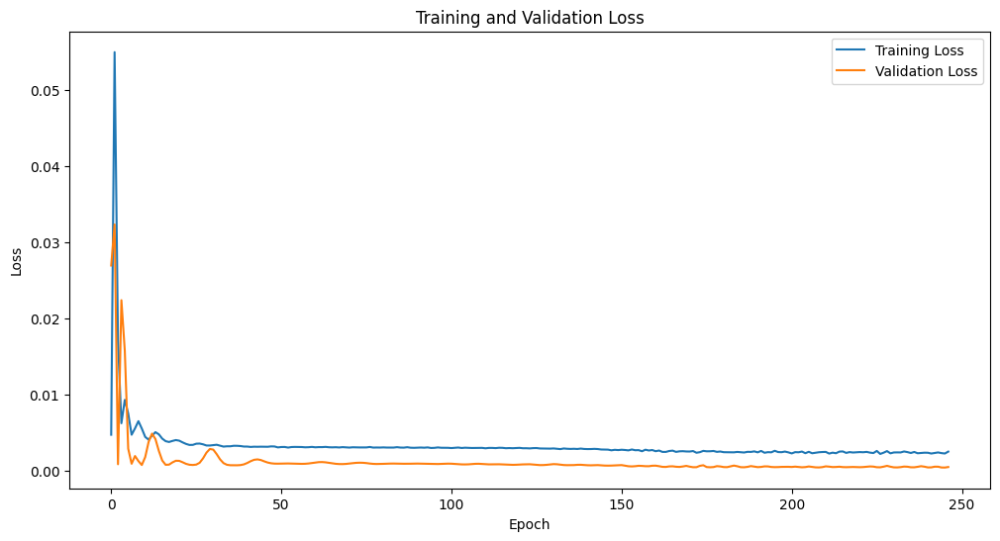

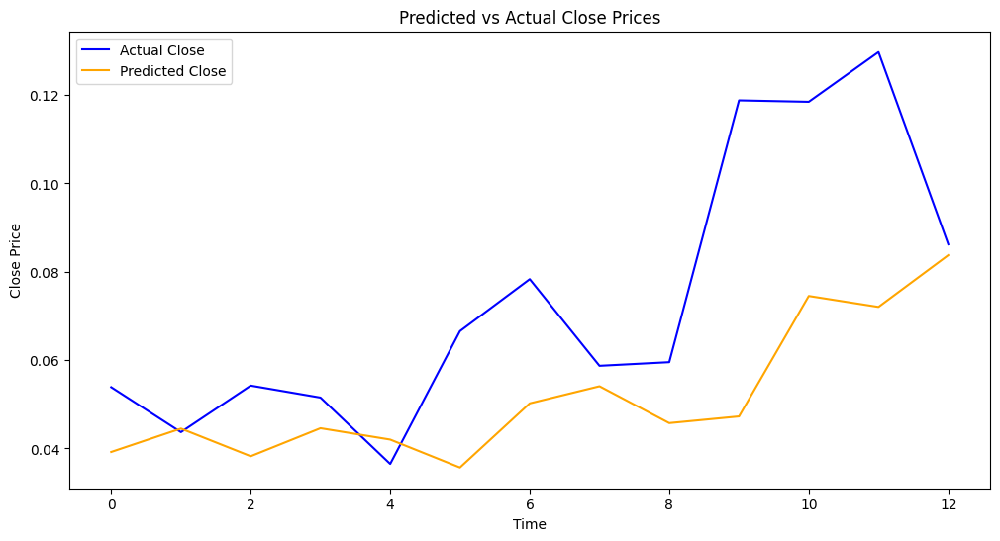

Mean Squared Error (MSE): 0.0010
Mean Absolute Error (MAE): 0.0228


In [642]:
# Sequence lengths
N = 7  # Input sequence length (past 7 days)
M = 1  # Prediction length (next 1 day)

# Prepare input-output sequences for training, validation, and testing sets
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']
X_train, y_train = create_sequences(train_set[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)
X_val, y_val = create_sequences(validation_set[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)
X_test, y_test = create_sequences(test_data[scale_columns], target_column='Volume', sequence_length=N, prediction_length=M)

# Hyperparameters
input_size = 5  # Number of features
hidden_size = 64  # Hidden units
output_size = 1  # Predicting 'Close'
num_layers = 3  # Number of LSTM layers
dropouts = 0.1  # Dropout rate
learning_rate = 0.01
criterion = nn.HuberLoss()


num_epochs = 2500
patience = 20
device = 'cpu'

best_trainloss = None
best_hidden_size = 0
best_num_layers = 0
best_dropout = 0
best_model = None
best_criterion = None


# Initialize the model, loss function, and optimizer
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-5)


# Train the model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

mse, mae = evaluate_model(model, X_test, y_test, scaler, device)

In [649]:
# Include all features as input and target
scale_columns = ['Open', 'High', 'Low', 'Close', 'Volume']

# Recreate sequences for training, validation, and testing
X_train, y_train = create_sequences_all_features(train_set[scale_columns], N, M)
X_val, y_val = create_sequences_all_features(validation_set[scale_columns], N, M)
X_test, y_test = create_sequences_all_features(test_data[scale_columns], N, M)

# Verify shapes
print(f"X_train shape: {X_train.shape}, y_train shape: {y_train.shape}")
print(f"X_val shape: {X_val.shape}, y_val shape: {y_val.shape}")
print(f"X_test shape: {X_test.shape}, y_test shape: {y_test.shape}")


X_train shape: (999, 7, 5), y_train shape: (999, 1, 5)
X_val shape: (245, 7, 5), y_val shape: (245, 1, 5)
X_test shape: (13, 7, 5), y_test shape: (13, 1, 5)


/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([999, 1, 5])) that is different to the input size (torch.Size([999, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)
/Users/sreehari/tf-gpu-env/lib/python3.10/site-packages/torch/nn/modules/loss.py:1100: UserWarning: Using a target size (torch.Size([245, 1, 5])) that is different to the input size (torch.Size([245, 5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.huber_loss(input, target, reduction=self.reduction, delta=self.delta)


Epoch [1/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [2/2500], Train Loss: 0.0809, Val Loss: 0.2440
Epoch [3/2500], Train Loss: 0.0808, Val Loss: 0.2440
Epoch [4/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [5/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [6/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [7/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [8/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [9/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [10/2500], Train Loss: 0.0808, Val Loss: 0.2440
Epoch [11/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [12/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [13/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [14/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [15/2500], Train Loss: 0.0807, Val Loss: 0.2440
Epoch [16/2500], Train Loss: 0.0808, Val Loss: 0.2440
Epoch [17/2500], Train Loss: 0.0806, Val Loss: 0.2440
Epoch [18/2500], Train Loss: 0.0805, Val Loss: 0.2440
Epoch [19/2500], Train Loss: 0.0808, 

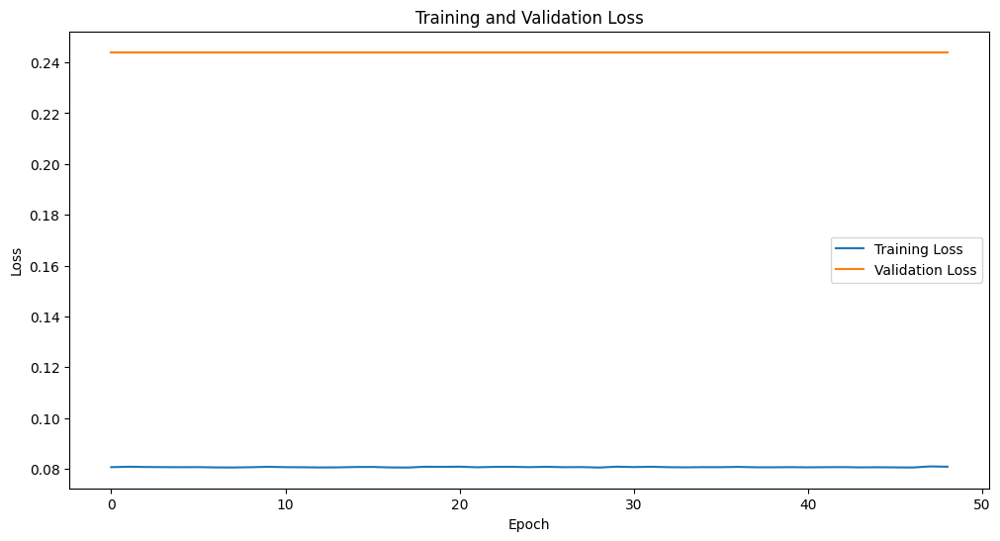

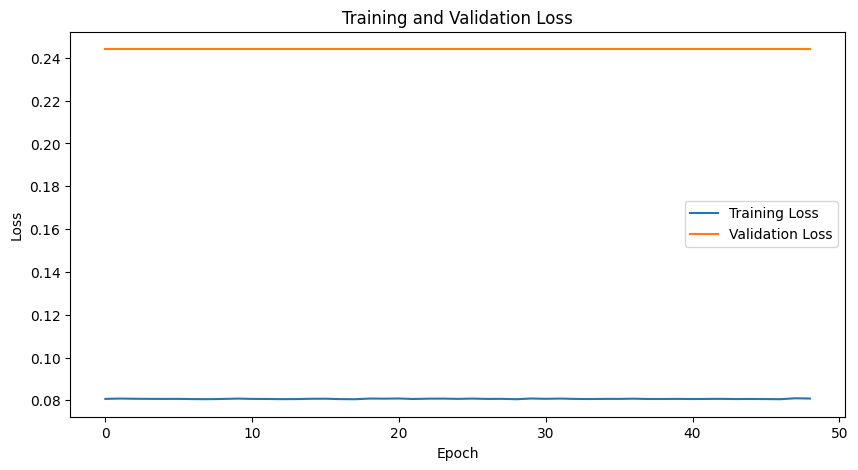

In [651]:
# Update output size to match all features
output_size = len(scale_columns)  # Predicting 5 features

# Reinitialize the GRU model
model = StockPriceGRU(input_size, hidden_size, output_size, num_layers, dropout).to(device)

# Train the GRU model
model, train_losses, val_losses = train_model(
    model, device, criterion, optimizer, num_epochs, patience, X_train, y_train, X_val, y_val
)

# Plot the loss curves
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()
